In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005a.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,...,SFHH006y.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts
sequence,,,,,,,,,,,,,,,,,,,,,
A1BG,0,0,0,0,0,0,0,0,0,0,...,21,21,21,21,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,24,24,24,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,50,125,125,0,...,0,0,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,177,177,177,6,...,0,0,0,0,0,0,0,0,0,0


# Keep less than 5000 columns

In [34]:
len(element_counts)

34074

In [35]:
#element_counts=element_counts[0:5000]
element_counts=element_counts[5000:10000]
#element_counts=element_counts[10000:15000]
#element_counts=element_counts[15000:20000]
#element_counts=element_counts[20000:25000]
#element_counts=element_counts[25000:30000]
#element_counts=element_counts[30000:35000]

In [36]:
len(element_counts)

5000

In [37]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,DMAC2L,DMAP1,DMBT1,DMBT1P1,DMBX1,DMC1,DMD,DMGDH,DMKN,DMP1,...,LDLRAD2,LDLRAD3,LDLRAD4,LDLRAD4-AS1,LDLRAP1,LDOC1,LEAP2,LECT2,sample,trimmer
0,2928,0,32,0,0,0,49,0,0,0,...,1,2,320,0,304,0,0,0,SFHH005aa,bbduk1
1,2928,0,32,0,0,0,49,0,0,0,...,1,0,1004,0,304,0,0,0,SFHH005aa,bbduk2
2,2928,0,32,0,0,0,49,0,0,0,...,1,0,1004,0,304,0,0,0,SFHH005aa,bbduk3
3,2934,0,0,0,0,0,24,0,0,0,...,1,0,1016,0,304,0,0,0,SFHH005aa,cutadapt1
4,2934,0,0,0,0,0,24,0,0,0,...,1,0,1016,0,304,0,0,0,SFHH005aa,cutadapt2


In [38]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 5044)

In [39]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,LDLR-AS1,LDLRAD1,LDLRAD2,LDLRAD3,LDLRAD4,LDLRAD4-AS1,LDLRAP1,LDOC1,LEAP2,LECT2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,1,0,1,2,320,0,304,0,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,1,0,1,0,1004,0,304,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,1,0,1,0,1004,0,304,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,1,0,1,0,1016,0,304,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,1,0,1,0,1016,0,304,0,0,0


In [40]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'LDLR-AS1', 'LDLRAD1', 'LDLRAD2', 'LDLRAD3', 'LDLRAD4', 'LDLRAD4-AS1',
       'LDLRAP1', 'LDOC1', 'LEAP2', 'LECT2'],
      dtype='object', length=5044)

In [41]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['DMAC2L', 'DMAP1', 'DMBT1', 'DMBT1P1', 'DMBX1', 'DMC1', 'DMD', 'DMGDH',
       'DMKN', 'DMP1',
       ...
       'LDLR-AS1', 'LDLRAD1', 'LDLRAD2', 'LDLRAD3', 'LDLRAD4', 'LDLRAD4-AS1',
       'LDLRAP1', 'LDOC1', 'LEAP2', 'LECT2'],
      dtype='object', name='sequence', length=5000)

In [42]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [43]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [44]:
pd.set_option('display.max_rows',None)

In [45]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [46]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [47]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [48]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [49]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [50]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [51]:
type(diags)

numpy.ndarray

In [52]:
diags=diags.tolist()

In [53]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [54]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [55]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [56]:
dfn=df.copy()

In [57]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,LDLR-AS1,LDLRAD1,LDLRAD2,LDLRAD3,LDLRAD4,LDLRAD4-AS1,LDLRAP1,LDOC1,LEAP2,LECT2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,1,0,1,2,320,0,304,0,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,1,0,1,0,1004,0,304,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,1,0,1,0,1004,0,304,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,1,0,1,0,1016,0,304,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,1,0,1,0,1016,0,304,0,0,0


In [58]:
datetime.now().strftime("%H:%M:%S")

'10:48:41'

In [59]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [60]:
datetime.now().strftime("%H:%M:%S")

'10:49:24'

In [61]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,LDLR-AS1,LDLRAD1,LDLRAD2,LDLRAD3,LDLRAD4,LDLRAD4-AS1,LDLRAP1,LDOC1,LEAP2,LECT2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,786.92,0.0,786.92,1573.83,251813.05,0.0,239222.40,0.0,0.0,0.0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,728.35,0.0,728.35,0.00,731259.83,0.0,221417.32,0.0,0.0,0.0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,728.33,0.0,728.33,0.00,731247.05,0.0,221413.45,0.0,0.0,0.0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,716.39,0.0,716.39,0.00,727850.53,0.0,217782.05,0.0,0.0,0.0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,716.39,0.0,716.39,0.00,727849.48,0.0,217781.74,0.0,0.0,0.0


In [62]:
datetime.now().strftime("%H:%M:%S")

'10:49:24'

In [63]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing CDKN2A
Missing CDKN2A-DT
Missing CDKN2AIP
Missing CDKN2AIPNL
Missing CDKN2B
Missing CDKN2B-AS1
Missing NF1
Missing NOTCH1
Missing RB1
Missing RB1CC1
Missing RB1-DT
Missing TERT
Missing TP53


In [64]:
datetime.now().strftime("%H:%M:%S")

'10:49:24'

# Select Genes (if using Genes)

 p : 0.04536327784074556  ( t : 2.15037522407249 ) :  Lexogen  :  bbduk2  :  EGFR
Control and blanks
79     0.0
343    0.0
Name: EGFR, dtype: float64
211    0.0
Name: EGFR, dtype: float64
475    0.0
Name: EGFR, dtype: float64


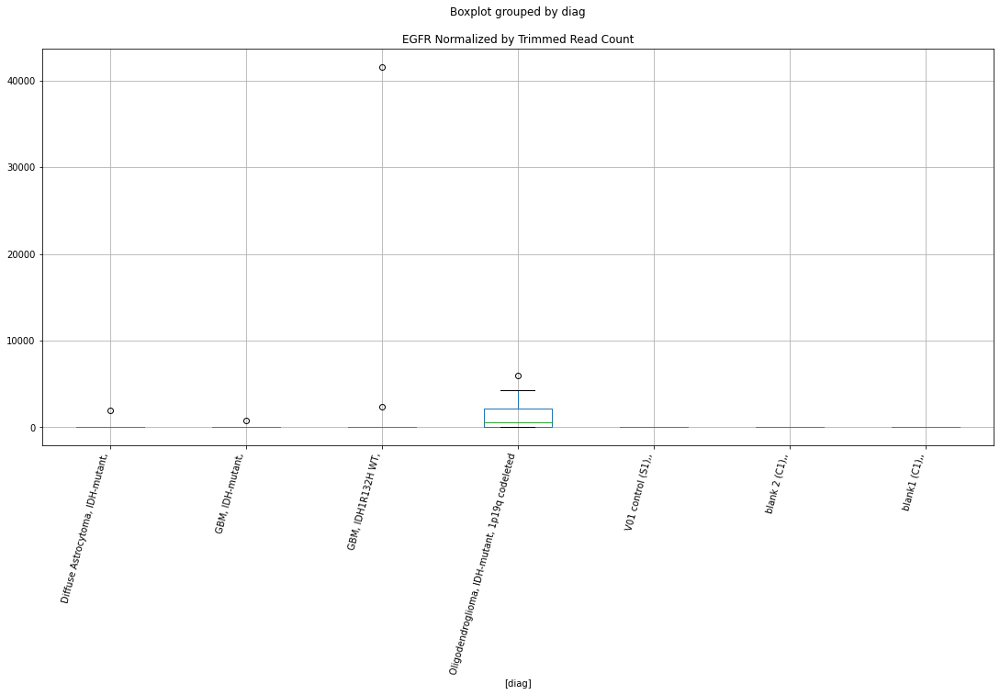

 p : 0.06726034214901823  ( t : 1.9473913018343938 ) :  D-plex  :  bbduk2  :  IDH1
Control and blanks
73     0.0
337    0.0
Name: IDH1, dtype: float64
205    179.09
Name: IDH1, dtype: float64
469    0.0
Name: IDH1, dtype: float64


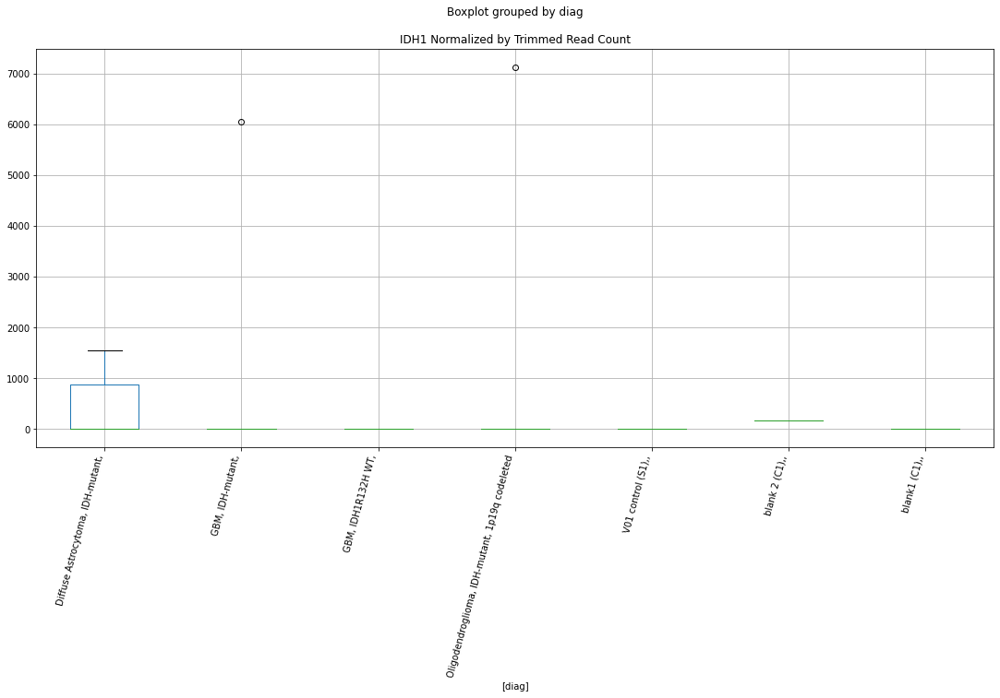

 p : 0.07098875237655615  ( t : 1.9189522234450682 ) :  Lexogen  :  bbduk2  :  EGFR
Control and blanks
79     0.0
343    0.0
Name: EGFR, dtype: float64
211    0.0
Name: EGFR, dtype: float64
475    0.0
Name: EGFR, dtype: float64


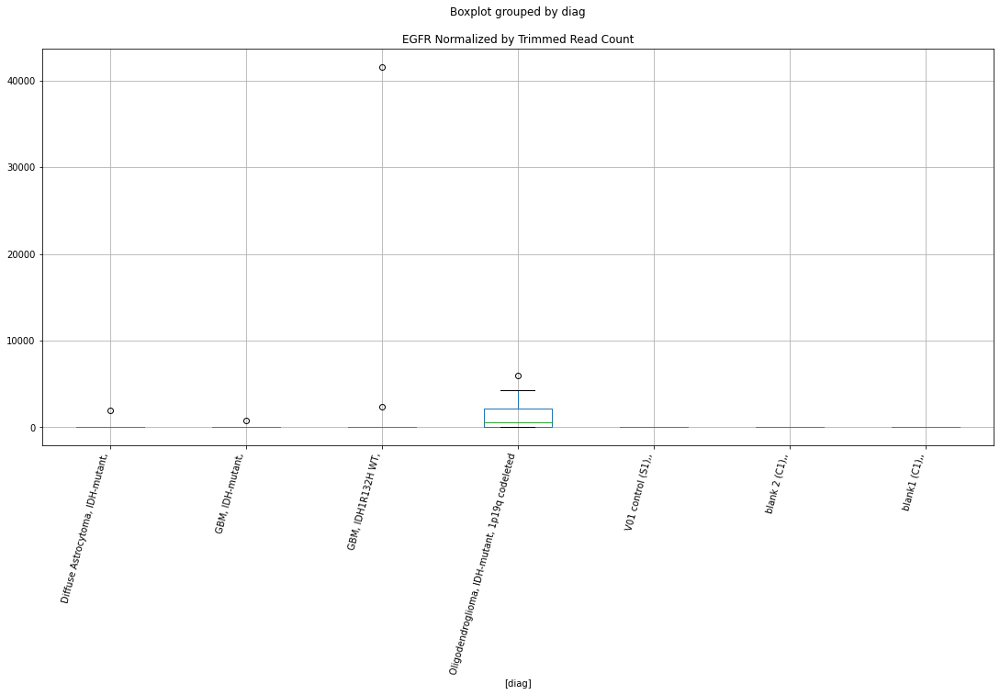

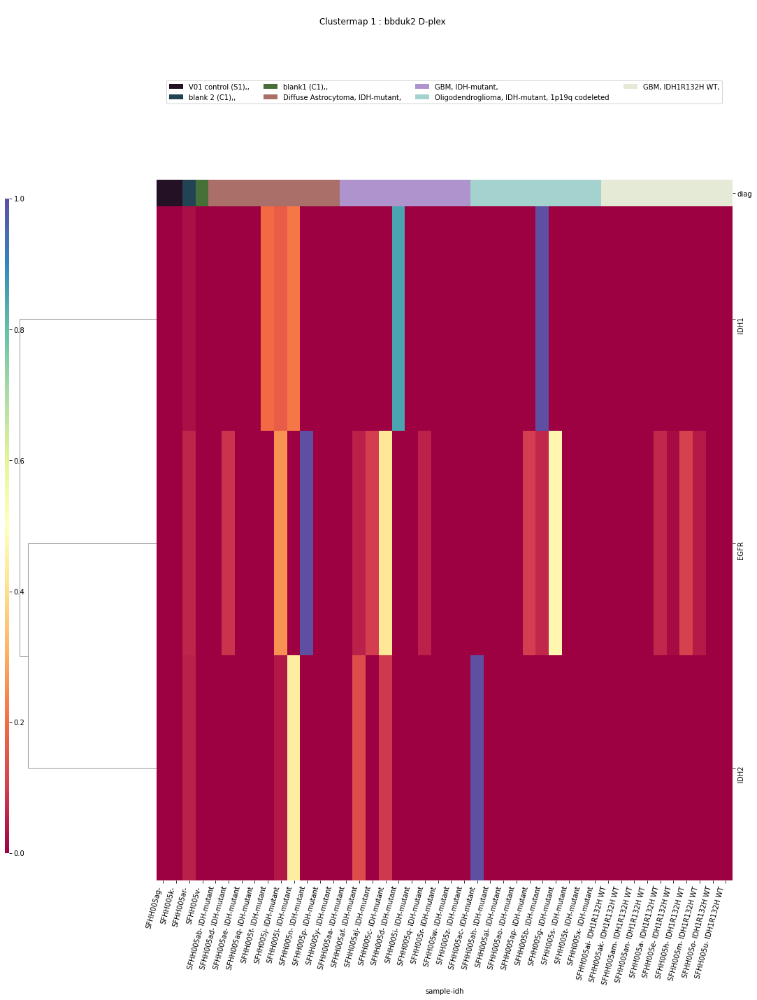

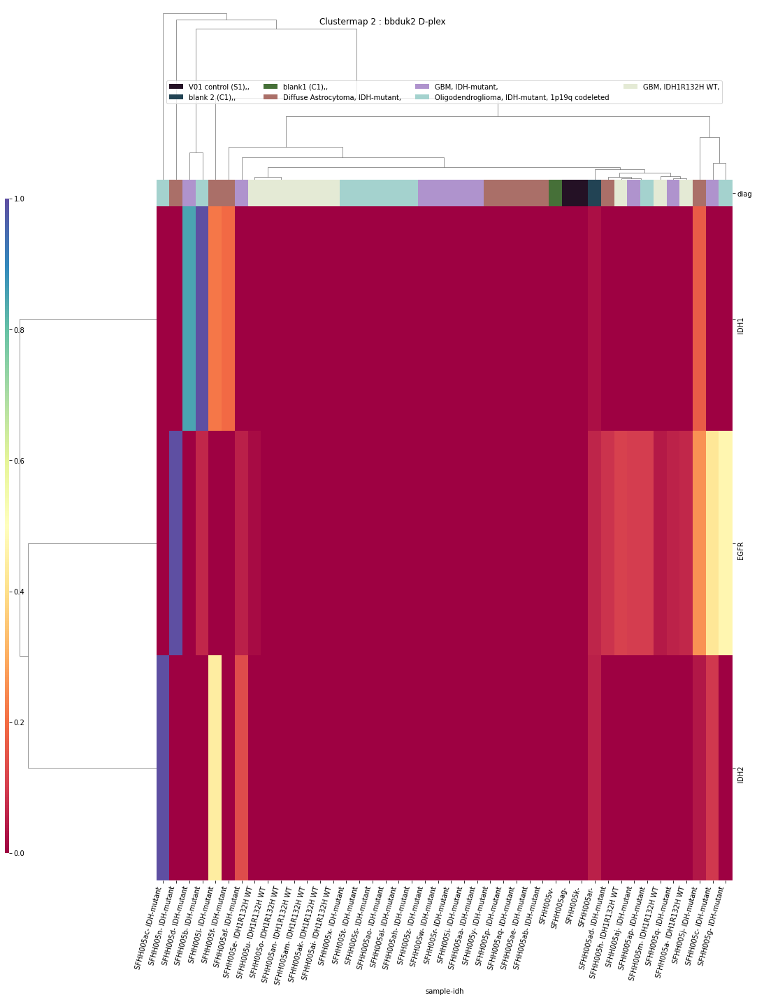

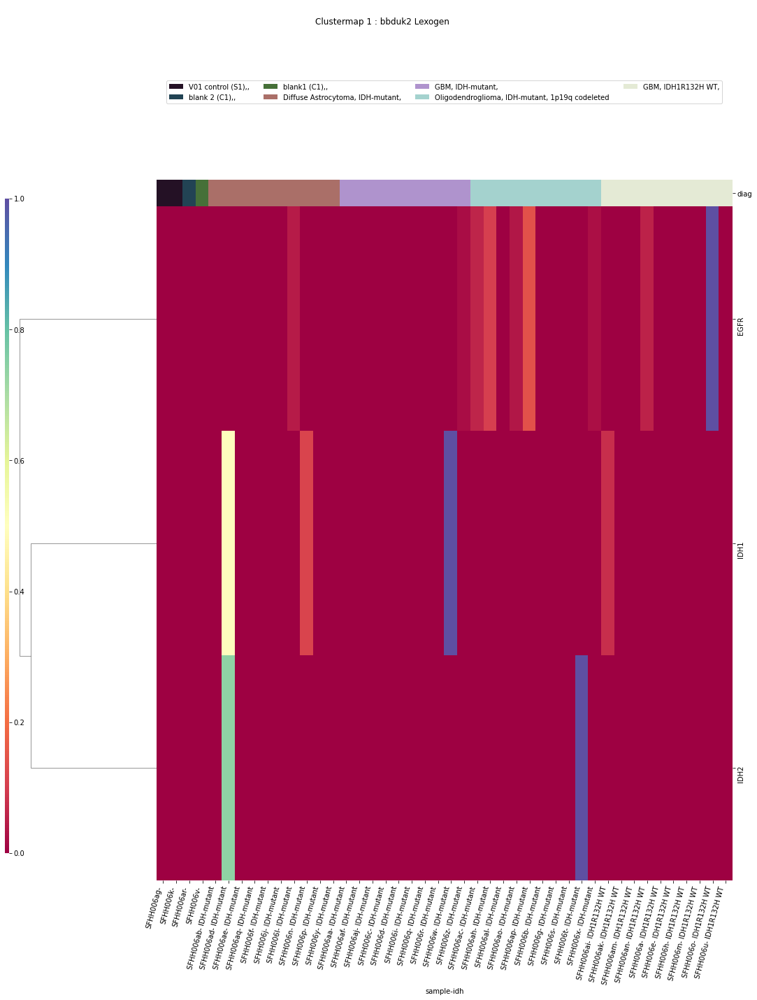

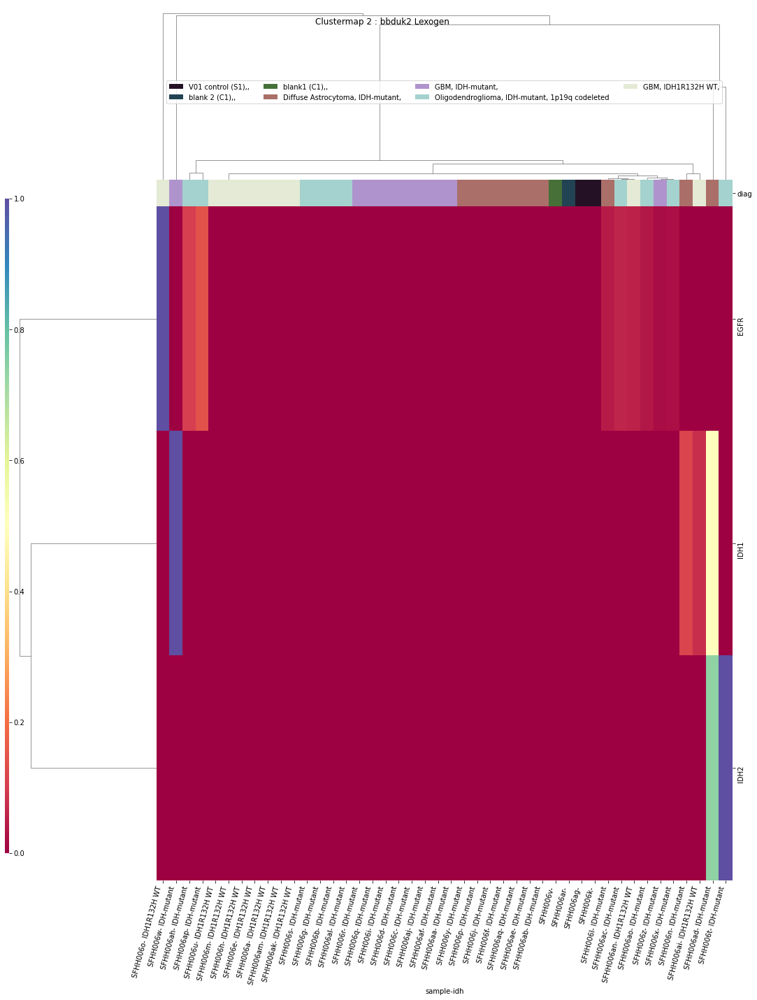

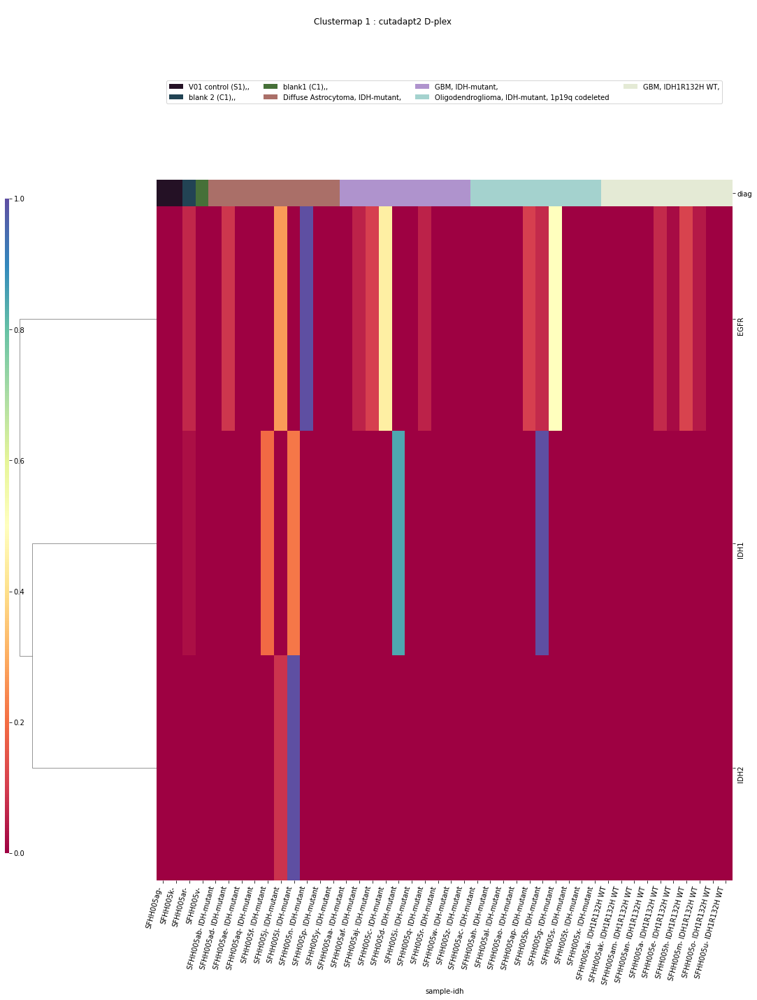

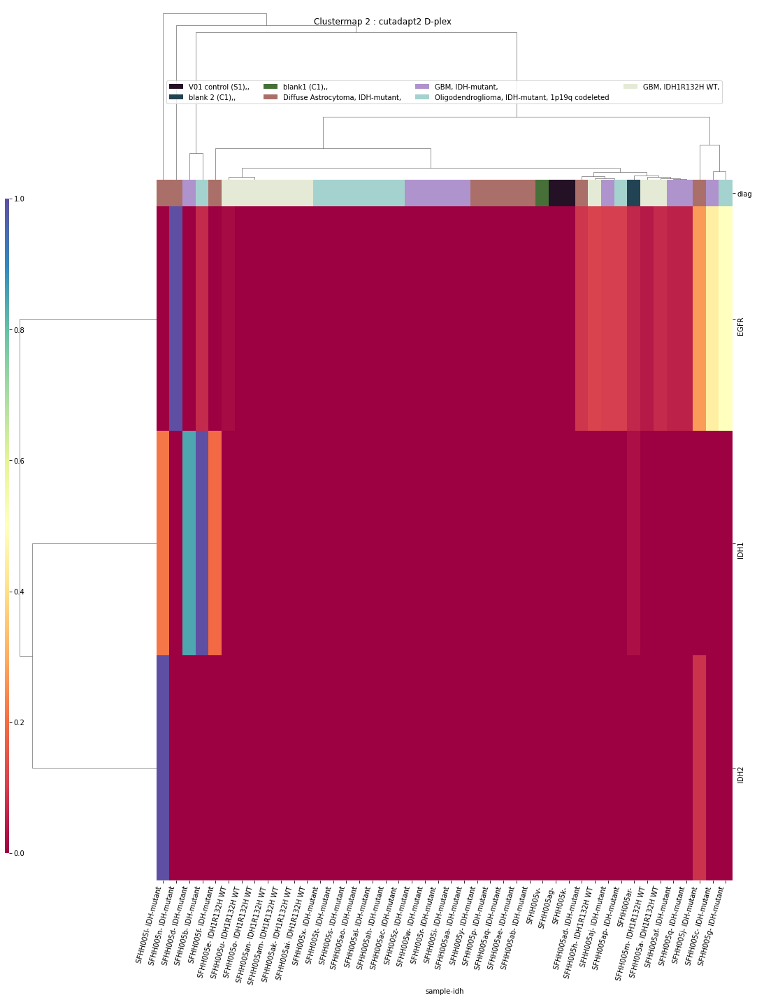

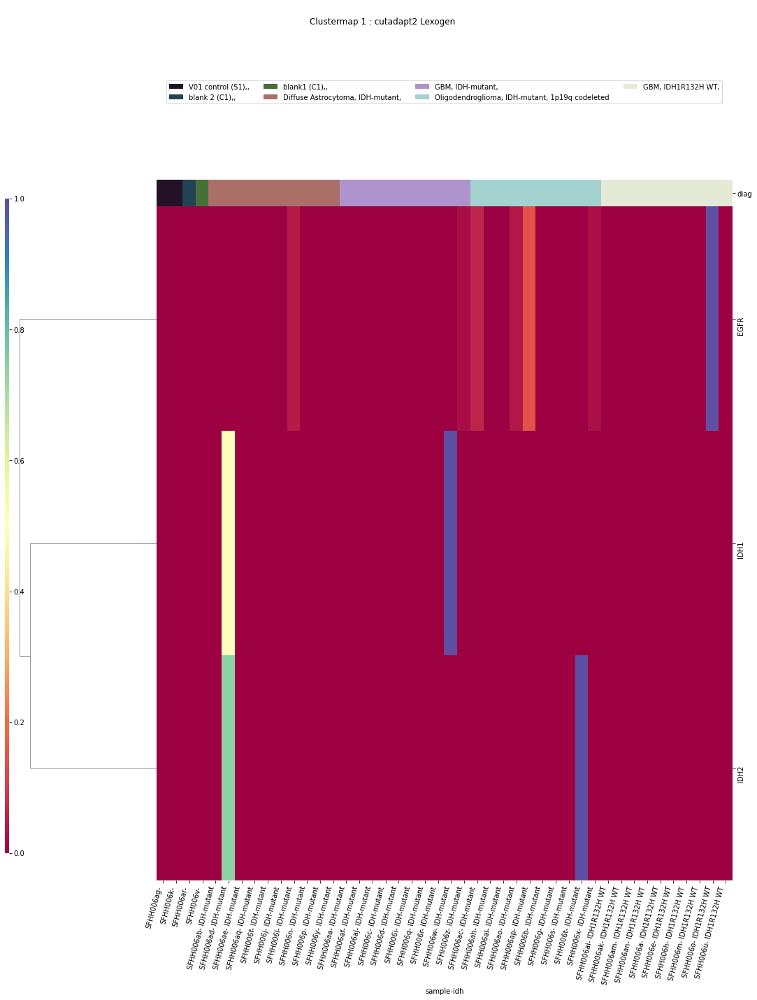

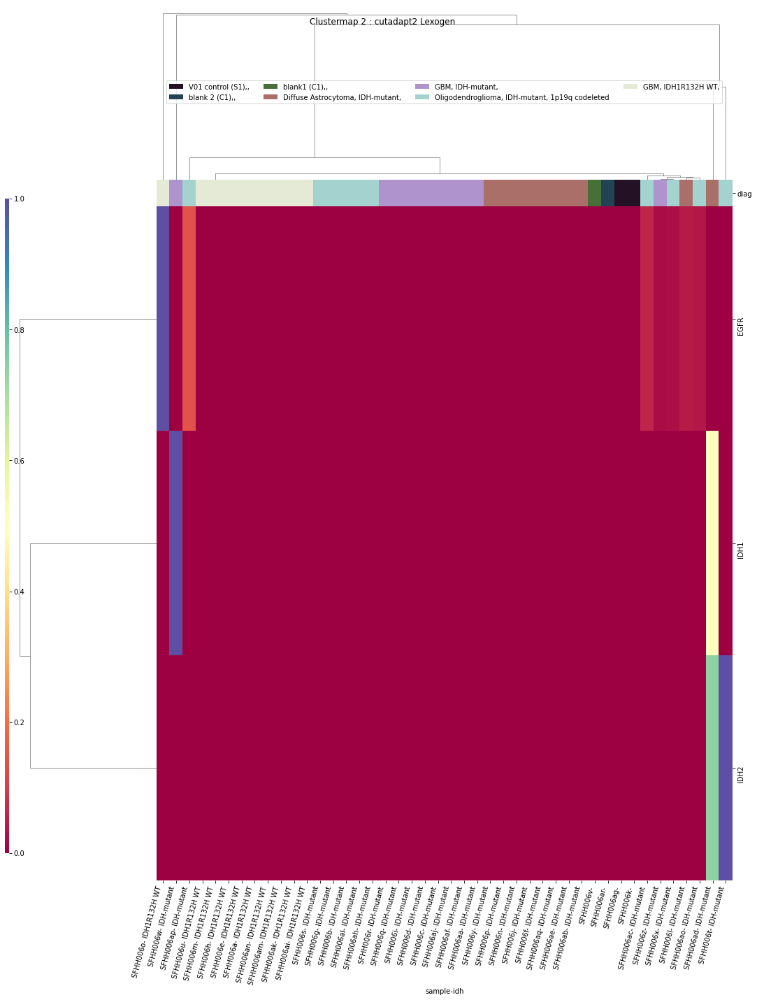

In [65]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

In [66]:
datetime.now().strftime("%H:%M:%S")

'10:50:00'

# Elements

 p : 0.001418734925371321  ( t : 3.7646915604871727 ) :  D-plex  :  bbduk2  :  KIF15
Control and blanks
73     0.0
337    0.0
Name: KIF15, dtype: float64
205    3581.82
Name: KIF15, dtype: float64
469    21294.98
Name: KIF15, dtype: float64


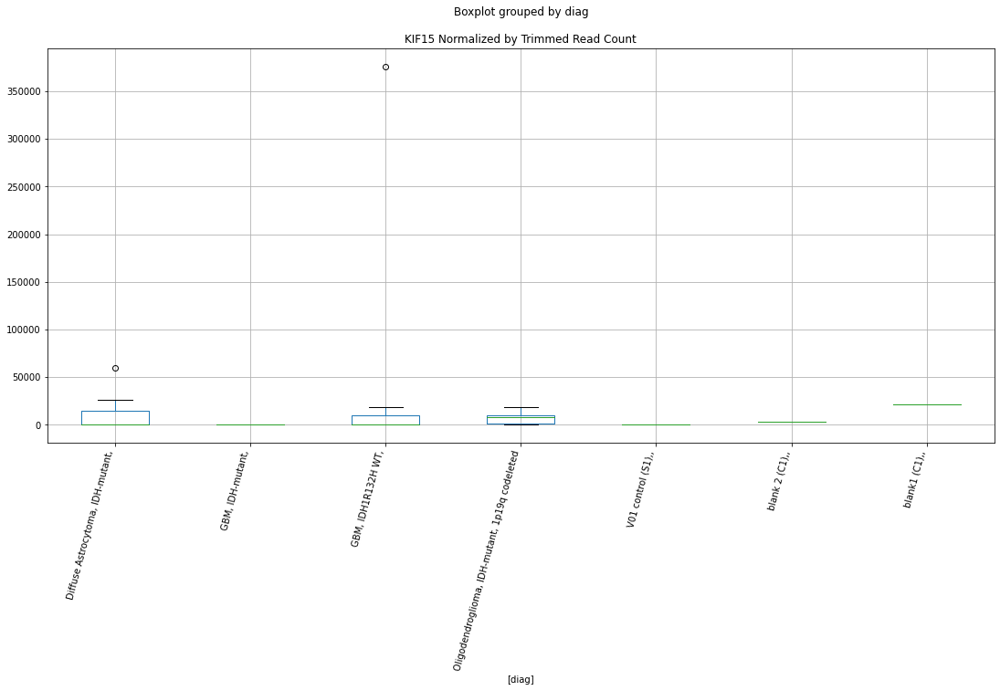

 p : 0.0014532292831060134  ( t : 3.7539097847605514 ) :  D-plex  :  cutadapt2  :  KIF15
Control and blanks
76     0.0
340    0.0
Name: KIF15, dtype: float64
208    3527.2
Name: KIF15, dtype: float64
472    20806.41
Name: KIF15, dtype: float64


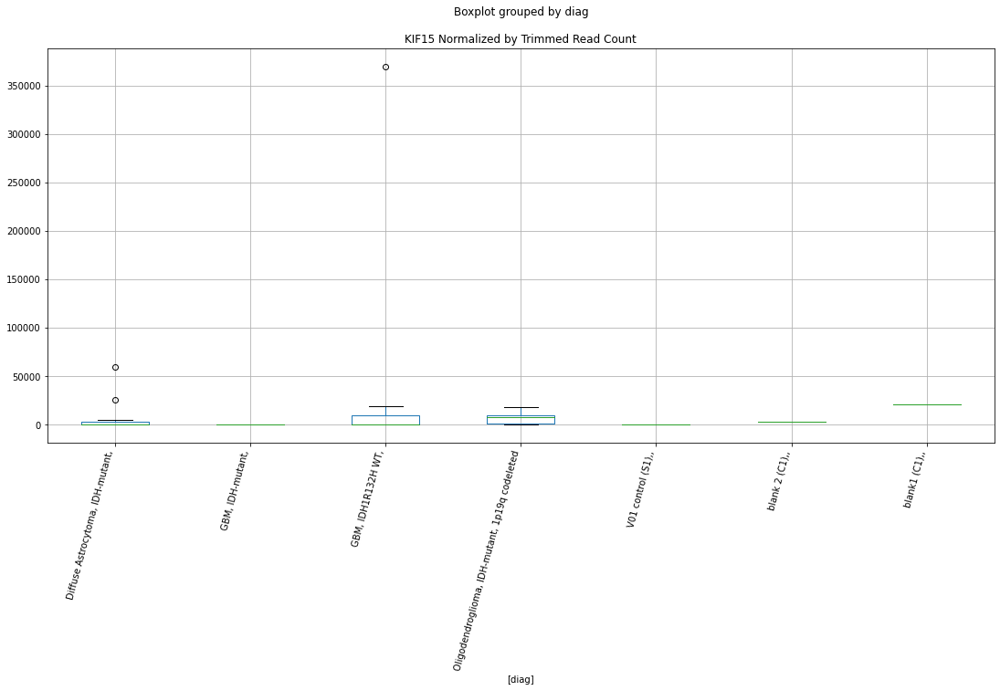

 p : 0.0016741707399748498  ( t : 3.6903731457809887 ) :  D-plex  :  bbduk2  :  FBXO28
Control and blanks
73     2319.03
337       0.00
Name: FBXO28, dtype: float64
205    3223.64
Name: FBXO28, dtype: float64
469    7098.33
Name: FBXO28, dtype: float64


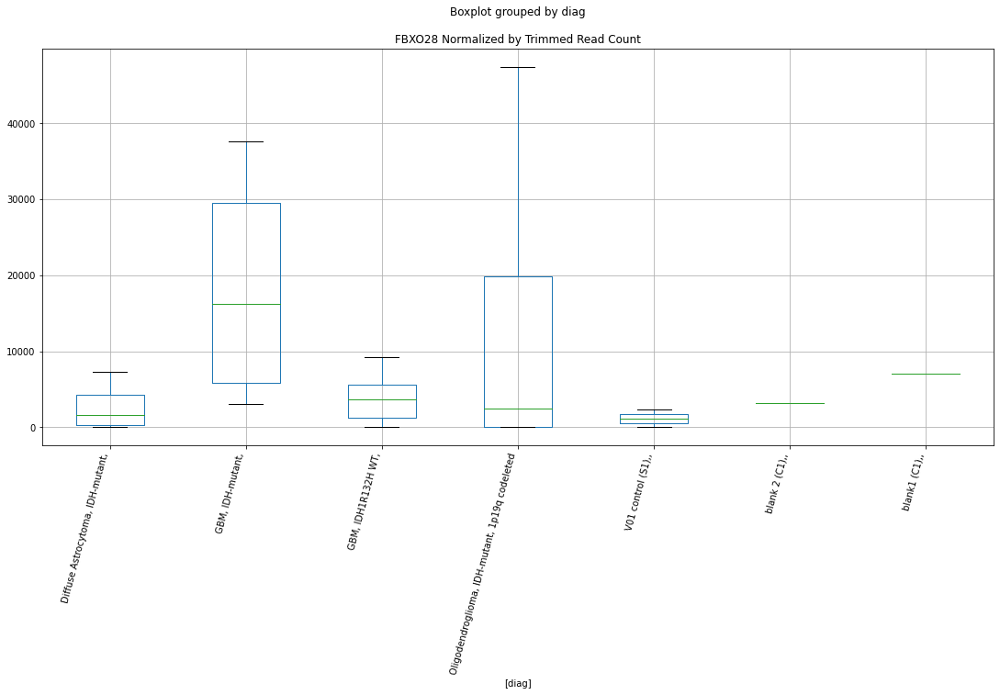

 p : 0.0017191900446345122  ( t : 3.678456967241574 ) :  D-plex  :  cutadapt2  :  FBXO28
Control and blanks
76     2272.84
340       0.00
Name: FBXO28, dtype: float64
208    2645.4
Name: FBXO28, dtype: float64
472    6935.47
Name: FBXO28, dtype: float64


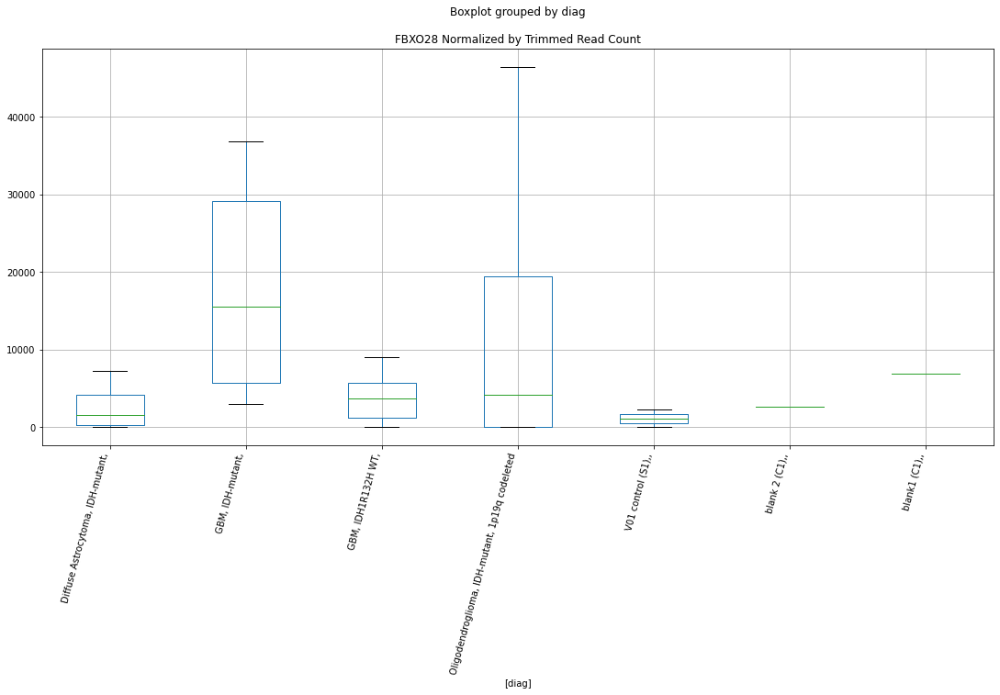

 p : 0.0018115740595171334  ( t : 3.6549471167934255 ) :  D-plex  :  bbduk2  :  EVC
Control and blanks
73     3092.03
337       0.00
Name: EVC, dtype: float64
205    19341.82
Name: EVC, dtype: float64
469    15971.24
Name: EVC, dtype: float64


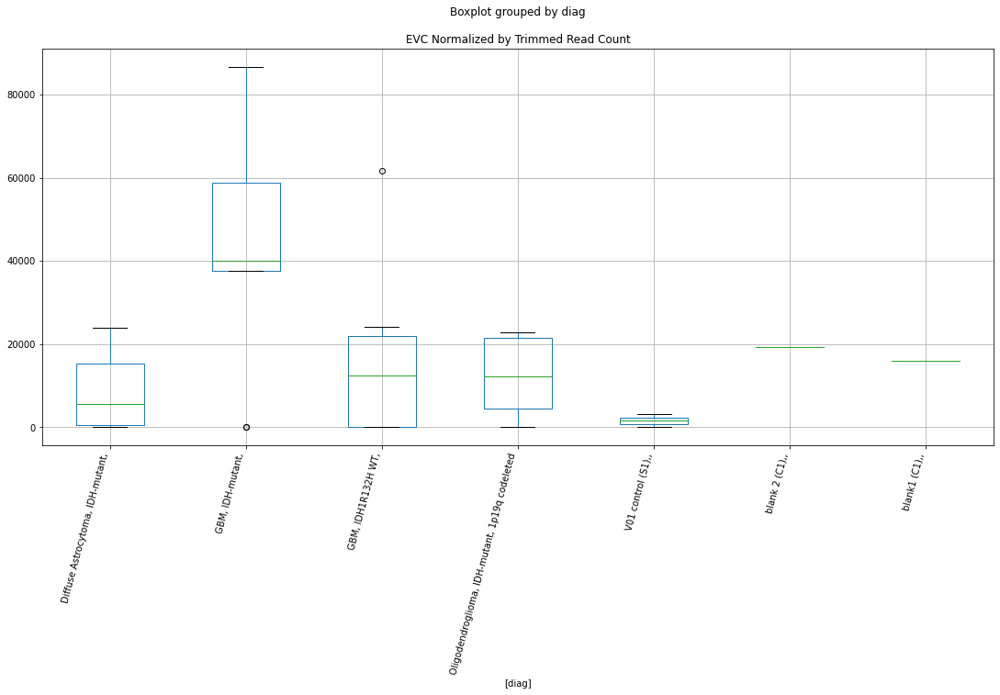

 p : 0.0019480480941637646  ( t : 3.6223136382527366 ) :  Lexogen  :  cutadapt2  :  HTATSF1P2
Control and blanks
82       0.00
346    420.87
Name: HTATSF1P2, dtype: float64
214    0.0
Name: HTATSF1P2, dtype: float64
478    0.0
Name: HTATSF1P2, dtype: float64


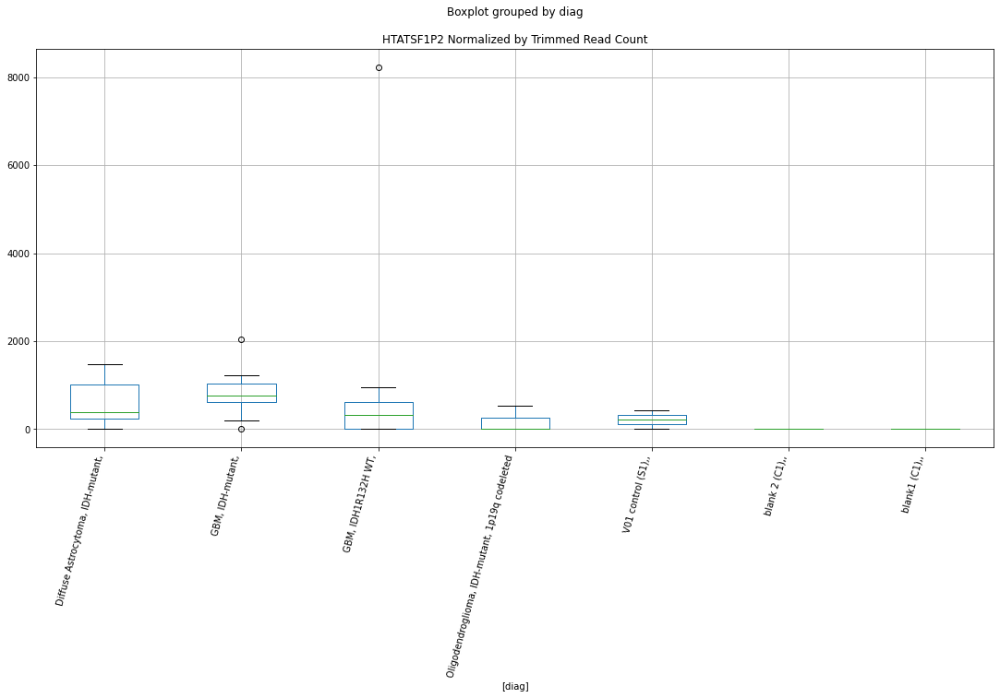

 p : 0.0024147729851546076  ( t : 3.5257196593540203 ) :  D-plex  :  cutadapt2  :  IL11
Control and blanks
76     0.0
340    0.0
Name: IL11, dtype: float64
208    1058.16
Name: IL11, dtype: float64
472    2311.82
Name: IL11, dtype: float64


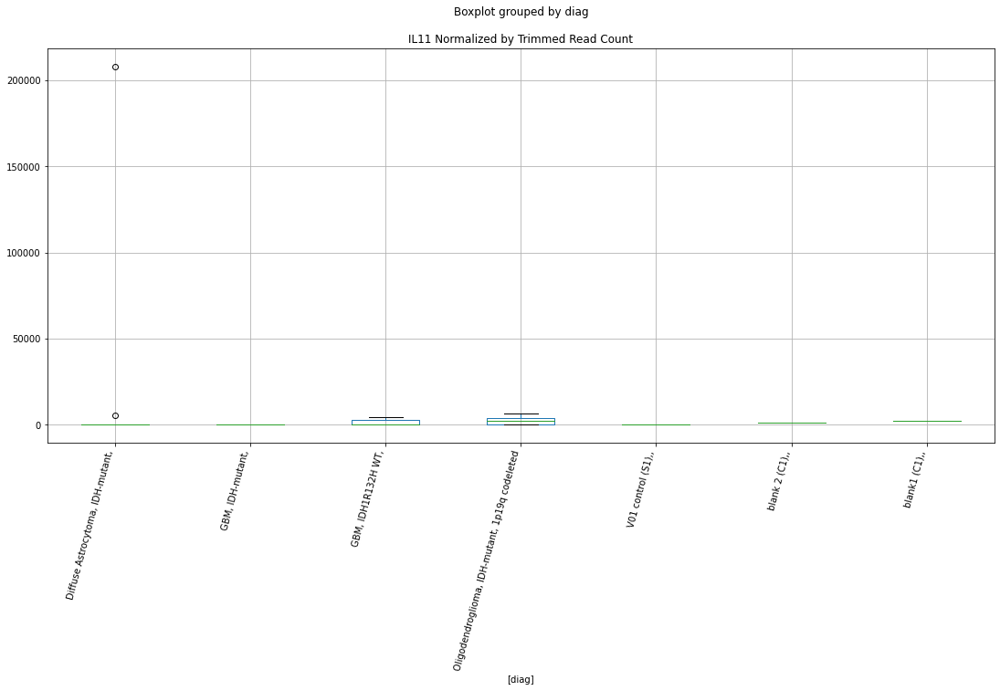

 p : 0.002600870724070525  ( t : 3.492289703663537 ) :  Lexogen  :  cutadapt2  :  IGDCC4
Control and blanks
82     0.0
346    0.0
Name: IGDCC4, dtype: float64
214    0.0
Name: IGDCC4, dtype: float64
478    0.0
Name: IGDCC4, dtype: float64


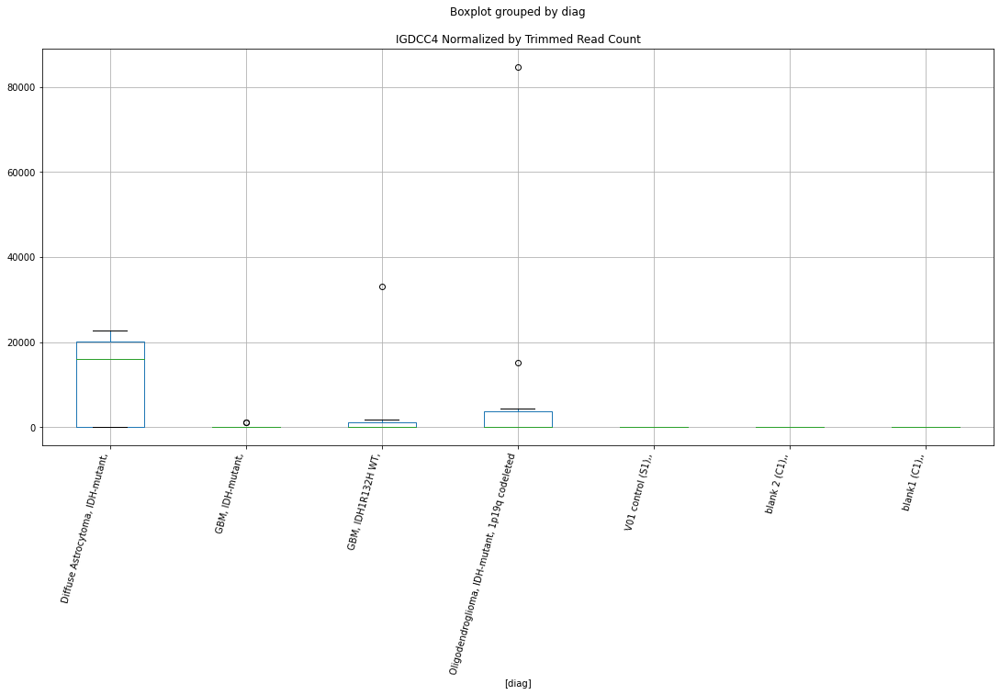

 p : 0.0030363021998289883  ( t : 3.422503167244863 ) :  D-plex  :  bbduk2  :  FBXO28
Control and blanks
73     2319.03
337       0.00
Name: FBXO28, dtype: float64
205    3223.64
Name: FBXO28, dtype: float64
469    7098.33
Name: FBXO28, dtype: float64


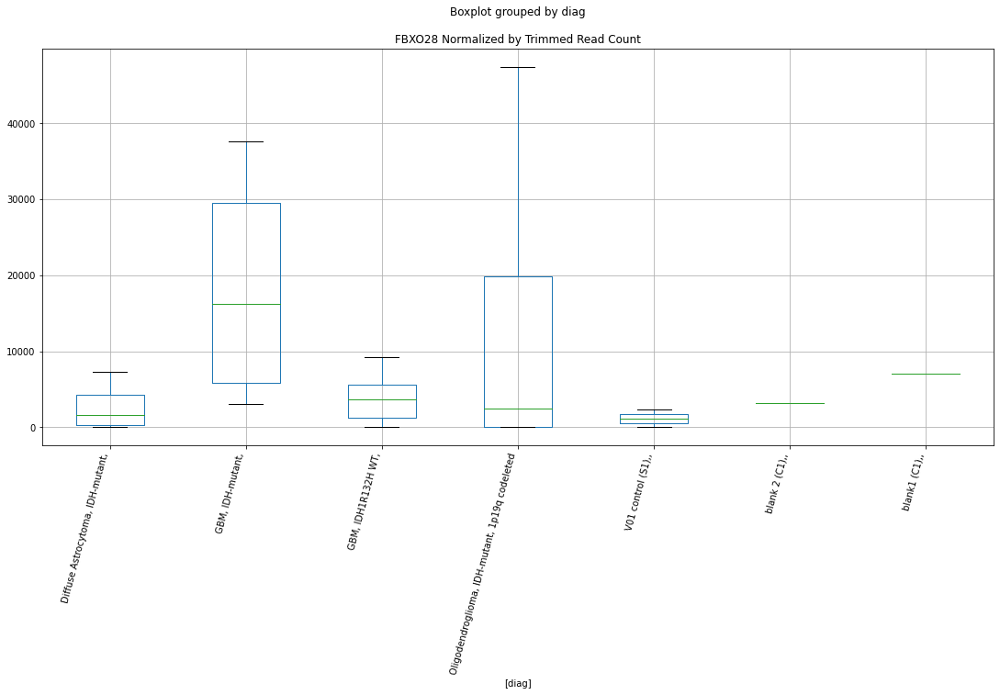

 p : 0.00313073540492772  ( t : 3.4086800497435408 ) :  Lexogen  :  bbduk2  :  IGDCC4
Control and blanks
79     0.0
343    0.0
Name: IGDCC4, dtype: float64
211    0.0
Name: IGDCC4, dtype: float64
475    0.0
Name: IGDCC4, dtype: float64


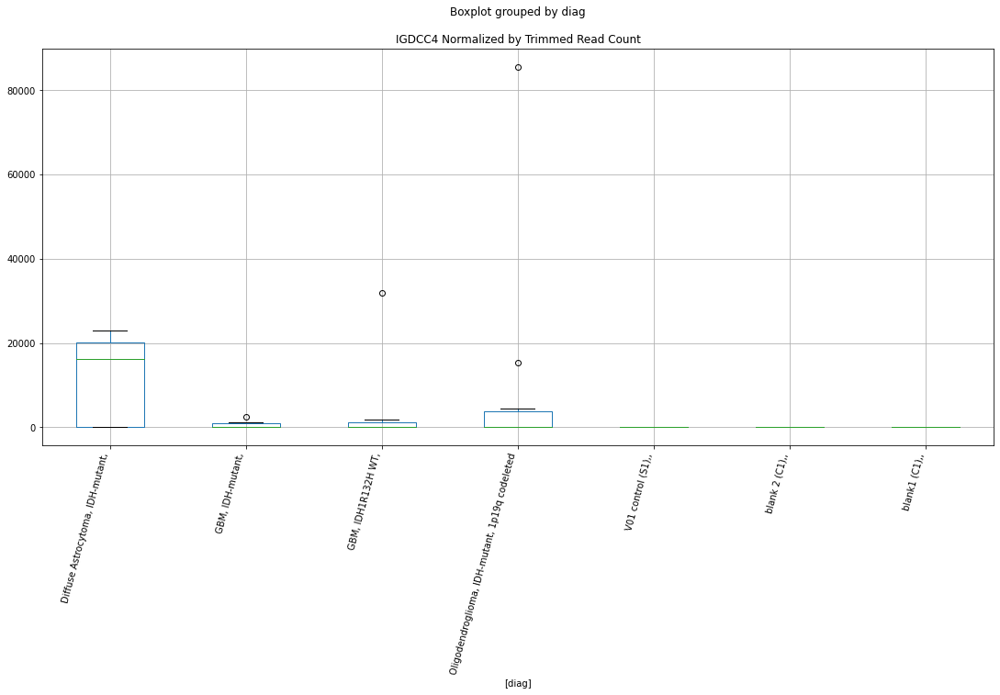

 p : 0.0033163232840556257  ( t : 3.3826735250588715 ) :  D-plex  :  cutadapt2  :  IL2
Control and blanks
76     3030.46
340    5284.39
Name: IL2, dtype: float64
208    11639.77
Name: IL2, dtype: float64
472    528251.64
Name: IL2, dtype: float64


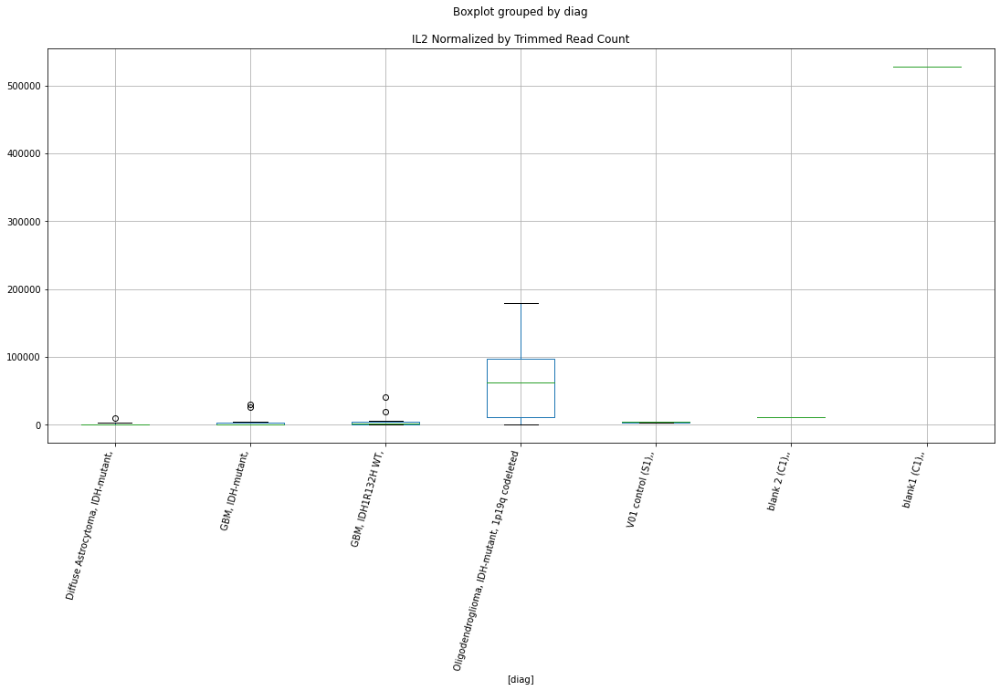

 p : 0.0033651815069025326  ( t : 3.3760656964310023 ) :  D-plex  :  cutadapt2  :  FBXO28
Control and blanks
76     2272.84
340       0.00
Name: FBXO28, dtype: float64
208    2645.4
Name: FBXO28, dtype: float64
472    6935.47
Name: FBXO28, dtype: float64


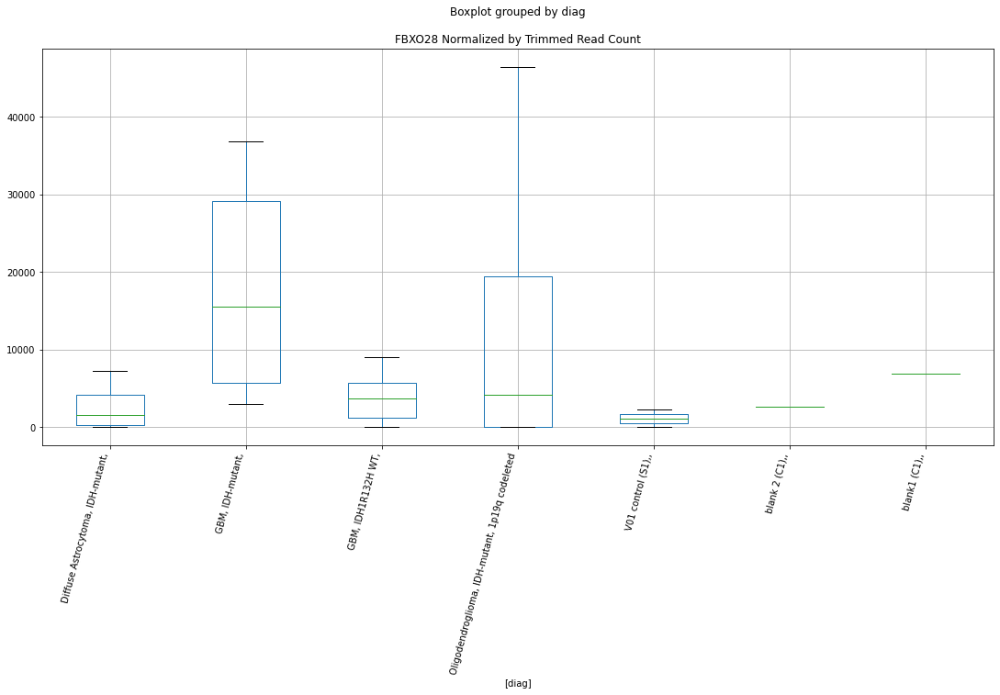

 p : 0.003423607335378015  ( t : 3.3682869747207493 ) :  D-plex  :  bbduk2  :  IL2
Control and blanks
73     3092.03
337    5340.94
Name: IL2, dtype: float64
205    11461.82
Name: IL2, dtype: float64
469    538289.86
Name: IL2, dtype: float64


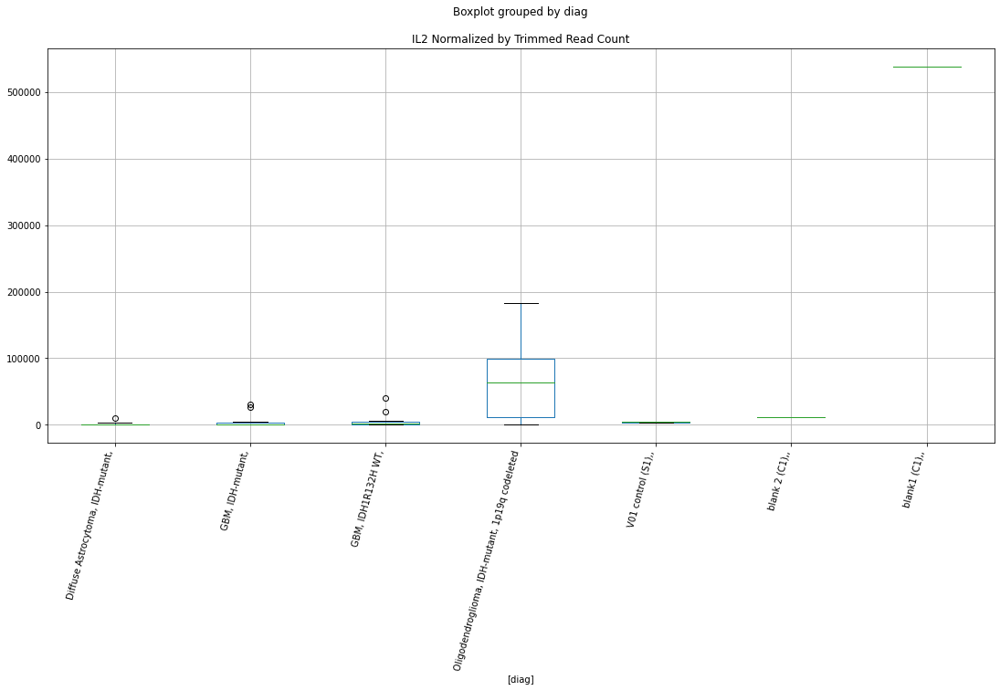

 p : 0.003716949047734678  ( t : 3.331108799133445 ) :  Lexogen  :  bbduk2  :  FRK
Control and blanks
79     0.0
343    0.0
Name: FRK, dtype: float64
211    0.0
Name: FRK, dtype: float64
475    0.0
Name: FRK, dtype: float64


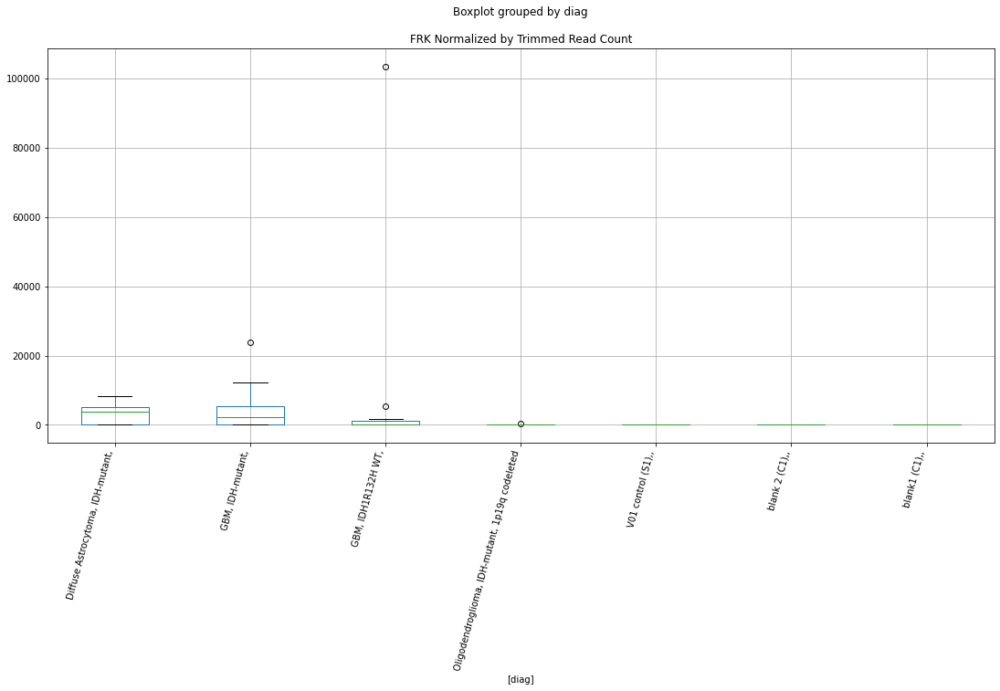

 p : 0.003806778543570393  ( t : 3.3203003926056516 ) :  D-plex  :  cutadapt2  :  GPRC6A
Control and blanks
76       0.00
340    880.73
Name: GPRC6A, dtype: float64
208    4409.01
Name: GPRC6A, dtype: float64
472    4045.69
Name: GPRC6A, dtype: float64


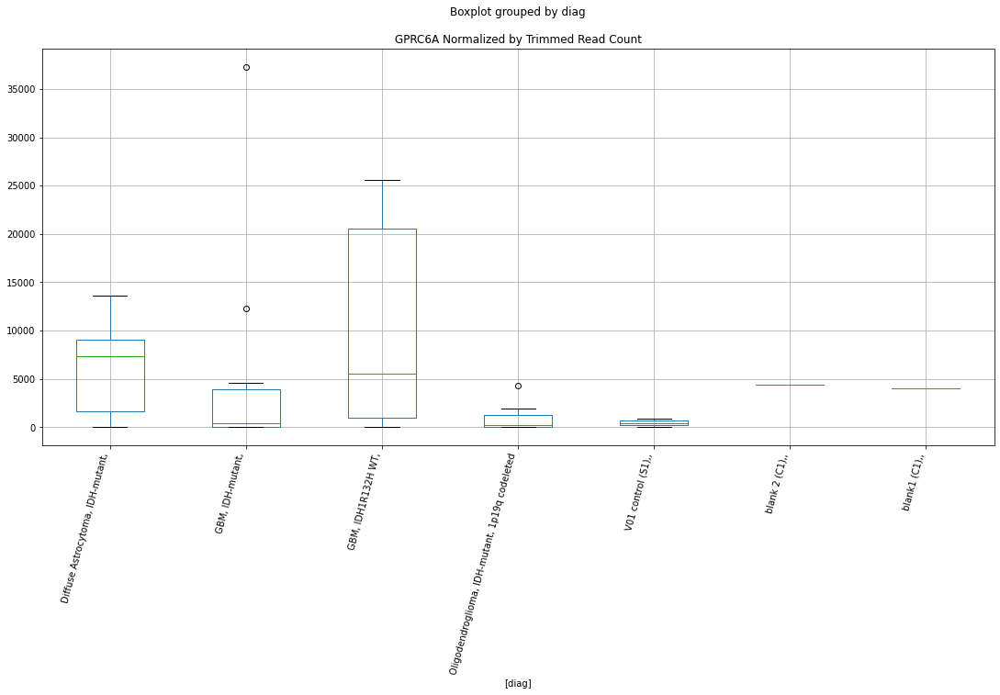

 p : 0.003848141767921065  ( t : 3.315407638585019 ) :  Lexogen  :  cutadapt2  :  FRK
Control and blanks
82     0.0
346    0.0
Name: FRK, dtype: float64
214    0.0
Name: FRK, dtype: float64
478    0.0
Name: FRK, dtype: float64


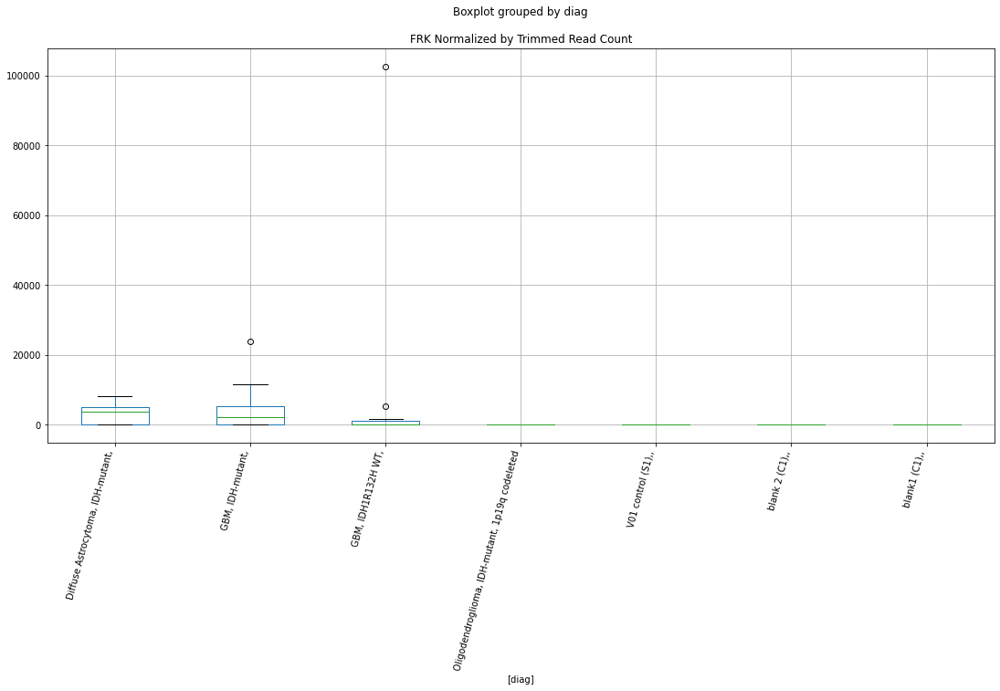

 p : 0.0039549354843494595  ( t : 3.303010609569249 ) :  Lexogen  :  bbduk2  :  IL17RB
Control and blanks
79         0.00
343    10191.09
Name: IL17RB, dtype: float64
211    9839.03
Name: IL17RB, dtype: float64
475    5748.38
Name: IL17RB, dtype: float64


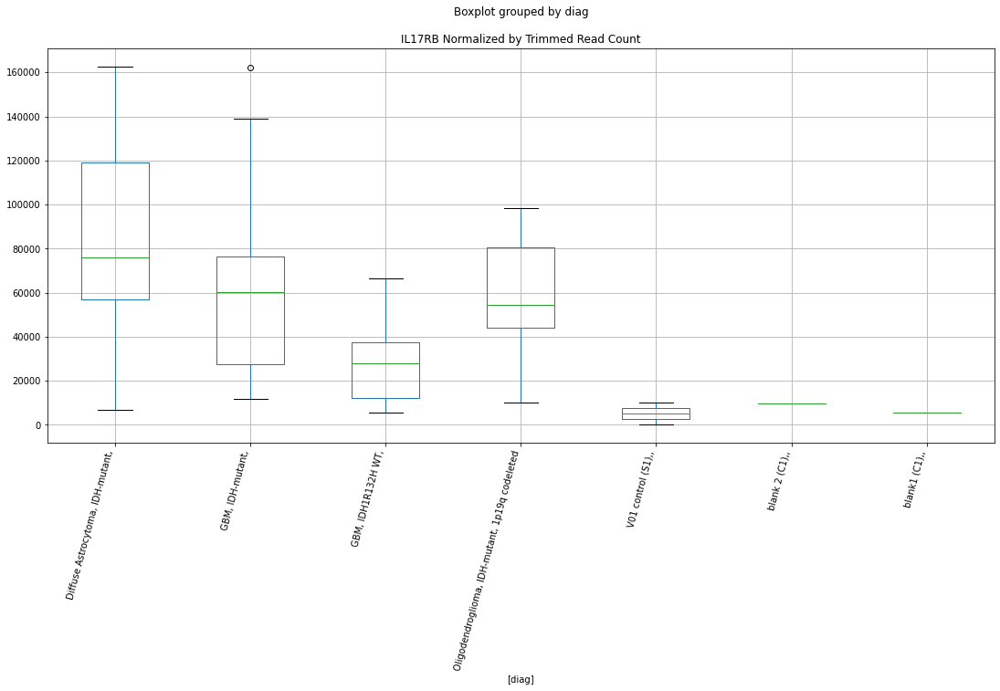

 p : 0.0042192732441658515  ( t : 3.2736872809165716 ) :  D-plex  :  bbduk2  :  EVC
Control and blanks
73     3092.03
337       0.00
Name: EVC, dtype: float64
205    19341.82
Name: EVC, dtype: float64
469    15971.24
Name: EVC, dtype: float64


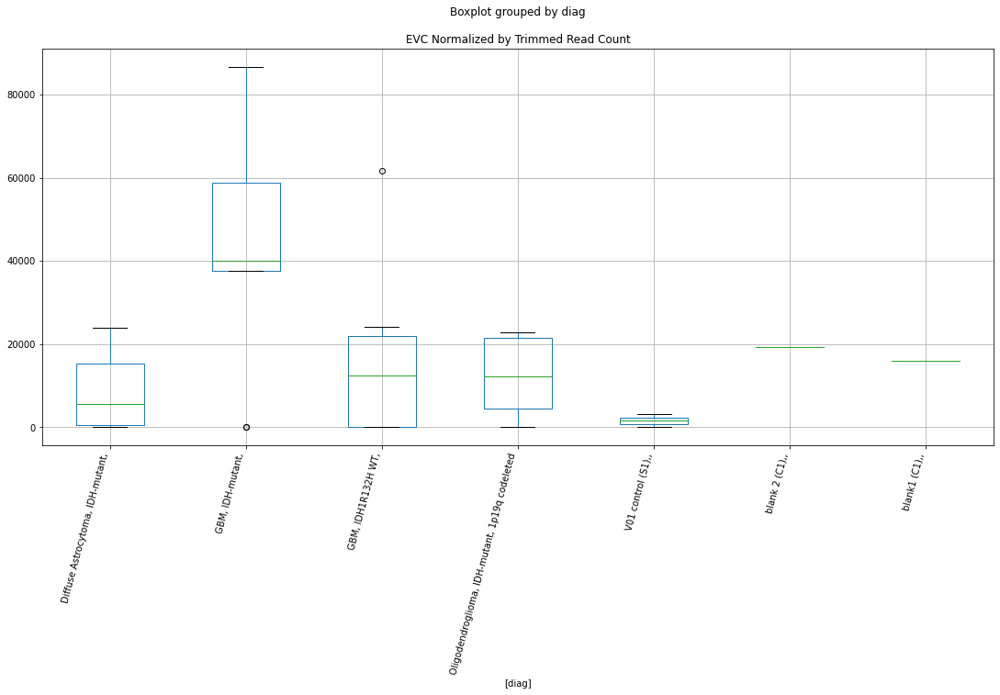

 p : 0.004224479219765717  ( t : 3.2731280846757302 ) :  D-plex  :  bbduk2  :  GPRC6A
Control and blanks
73       0.00
337    890.16
Name: GPRC6A, dtype: float64
205    4298.18
Name: GPRC6A, dtype: float64
469    4140.69
Name: GPRC6A, dtype: float64


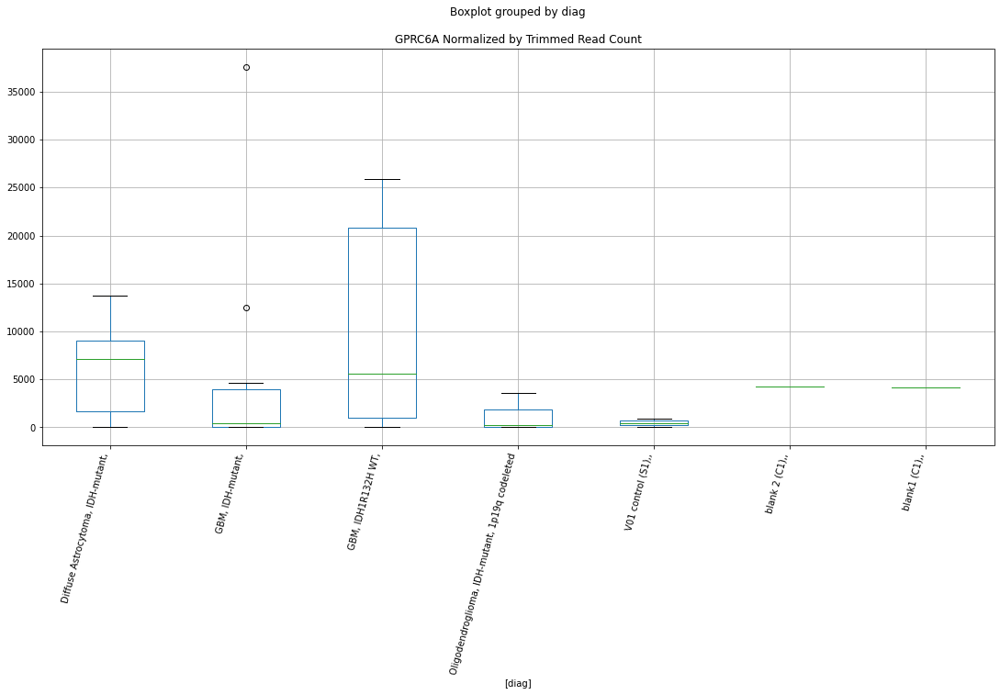

 p : 0.004440656406899215  ( t : 3.2504856657738217 ) :  D-plex  :  cutadapt2  :  IL6R
Control and blanks
76     7576.14
340       0.00
Name: IL6R, dtype: float64
208    5290.81
Name: IL6R, dtype: float64
472    3467.74
Name: IL6R, dtype: float64


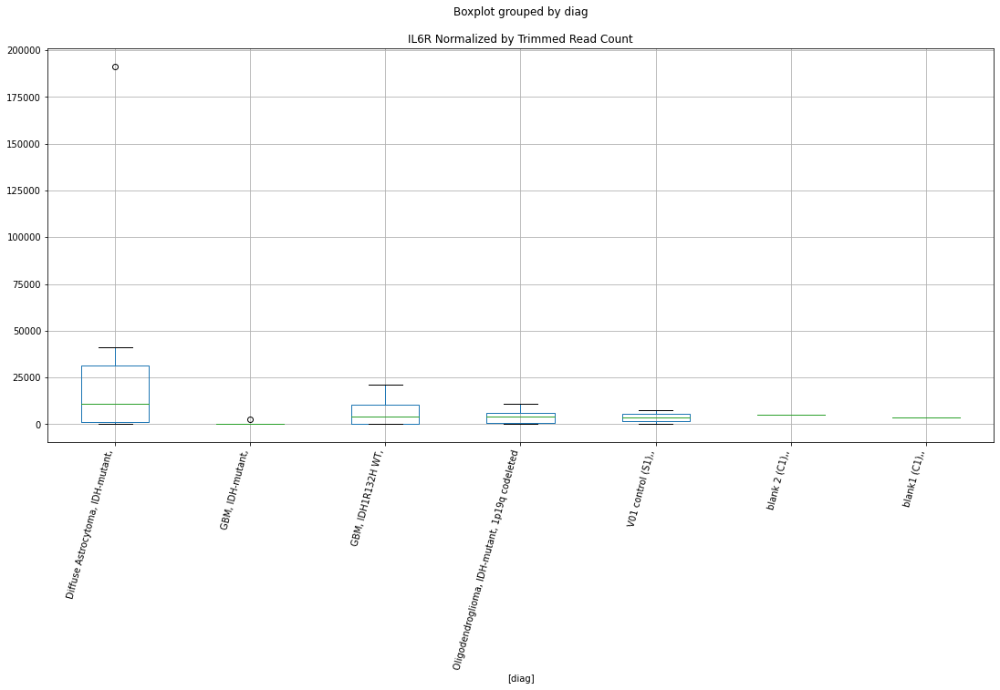

 p : 0.004509333840222108  ( t : 3.2435184442715874 ) :  D-plex  :  bbduk2  :  ERICH1
Control and blanks
73     7730.08
337     890.16
Name: ERICH1, dtype: float64
205    59816.38
Name: ERICH1, dtype: float64
469    53237.46
Name: ERICH1, dtype: float64


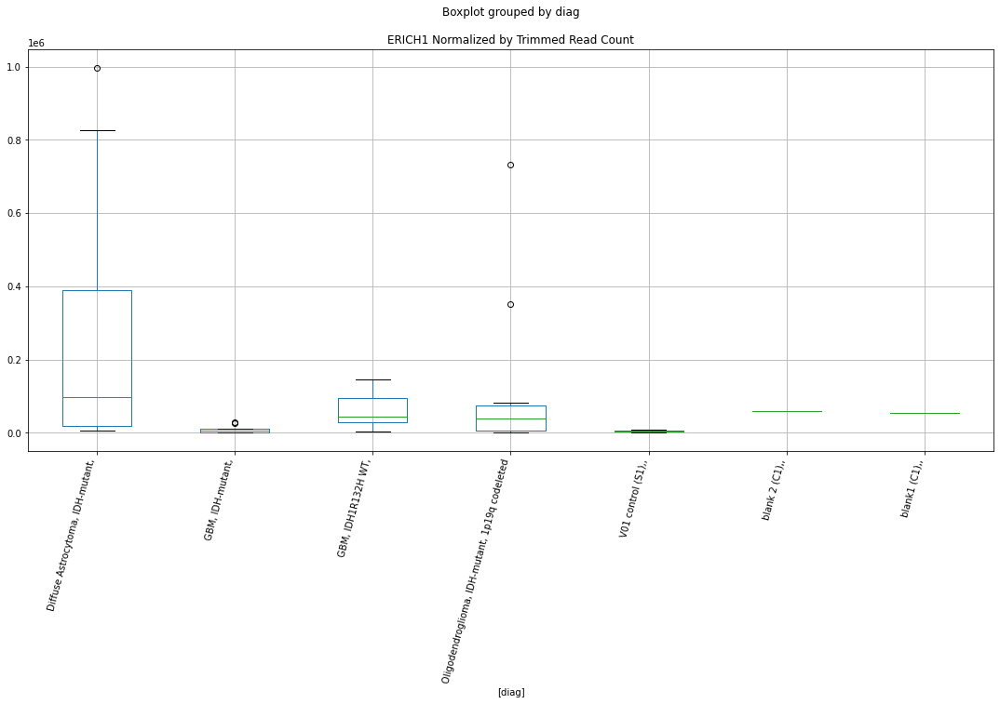

 p : 0.004678227883977361  ( t : 3.2268176132471815 ) :  D-plex  :  bbduk2  :  IL11
Control and blanks
73     0.0
337    0.0
Name: IL11, dtype: float64
205    1074.55
Name: IL11, dtype: float64
469    2366.11
Name: IL11, dtype: float64


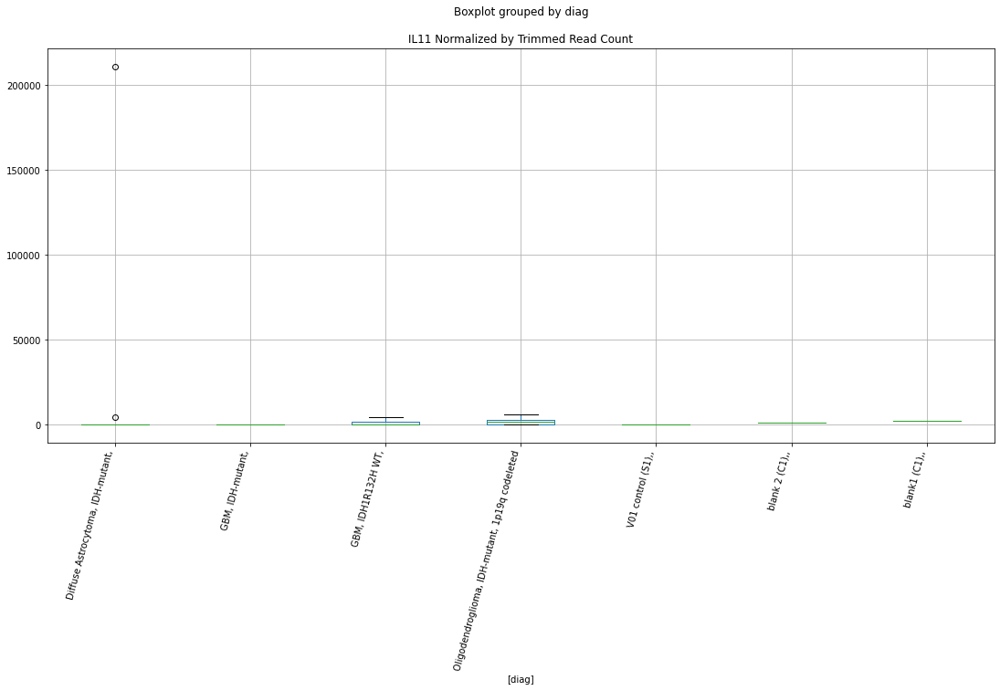

 p : 0.004943746199355224  ( t : 3.2017213794557895 ) :  D-plex  :  cutadapt2  :  ERICH1
Control and blanks
76     10606.60
340      880.73
Name: ERICH1, dtype: float64
208    56611.63
Name: ERICH1, dtype: float64
472    52016.03
Name: ERICH1, dtype: float64


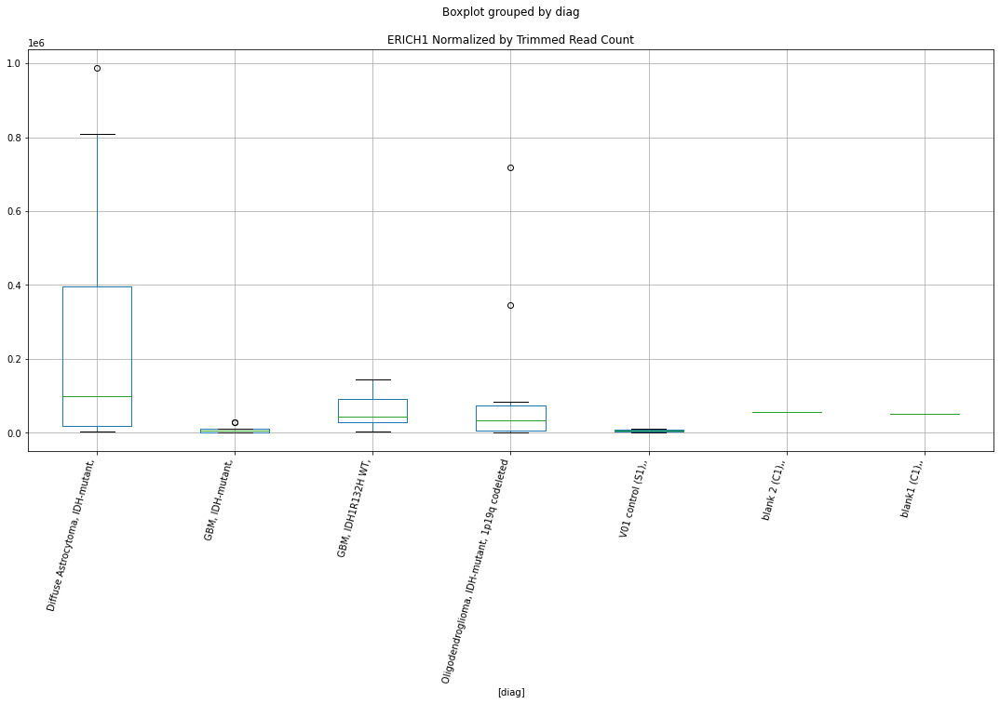

 p : 0.0051930138357907  ( t : 3.1793348240010566 ) :  D-plex  :  bbduk2  :  GJA8
Control and blanks
73     0.0
337    0.0
Name: GJA8, dtype: float64
205    895.45
Name: GJA8, dtype: float64
469    591.53
Name: GJA8, dtype: float64


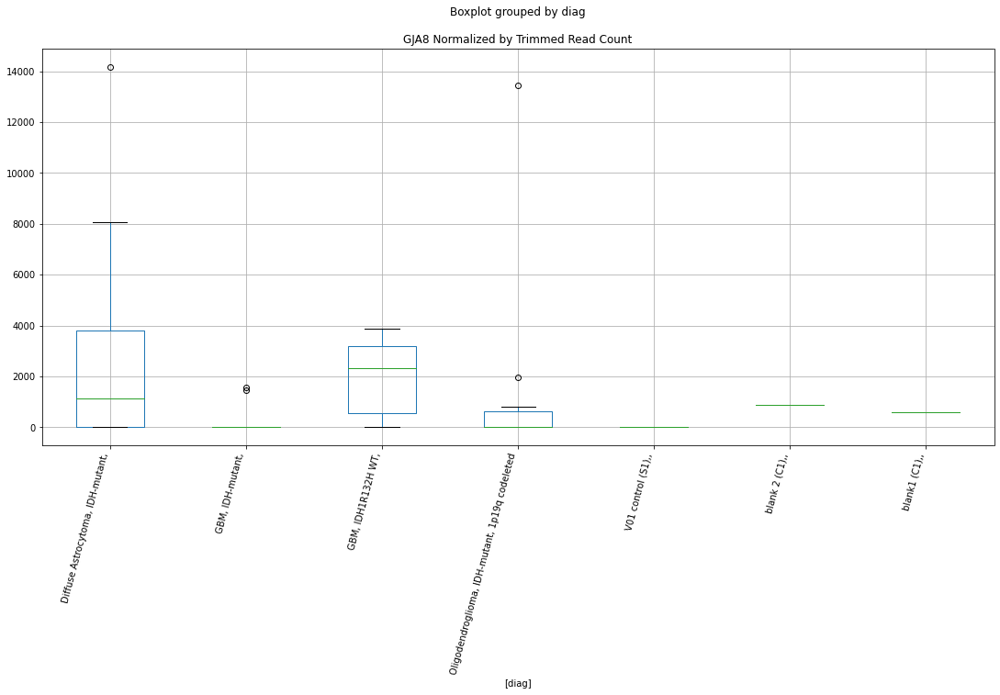

 p : 0.005429416400926915  ( t : 3.159054785696568 ) :  Lexogen  :  bbduk2  :  HOXB7
Control and blanks
79         0.00
343    10191.09
Name: HOXB7, dtype: float64
211    0.0
Name: HOXB7, dtype: float64
475    0.0
Name: HOXB7, dtype: float64


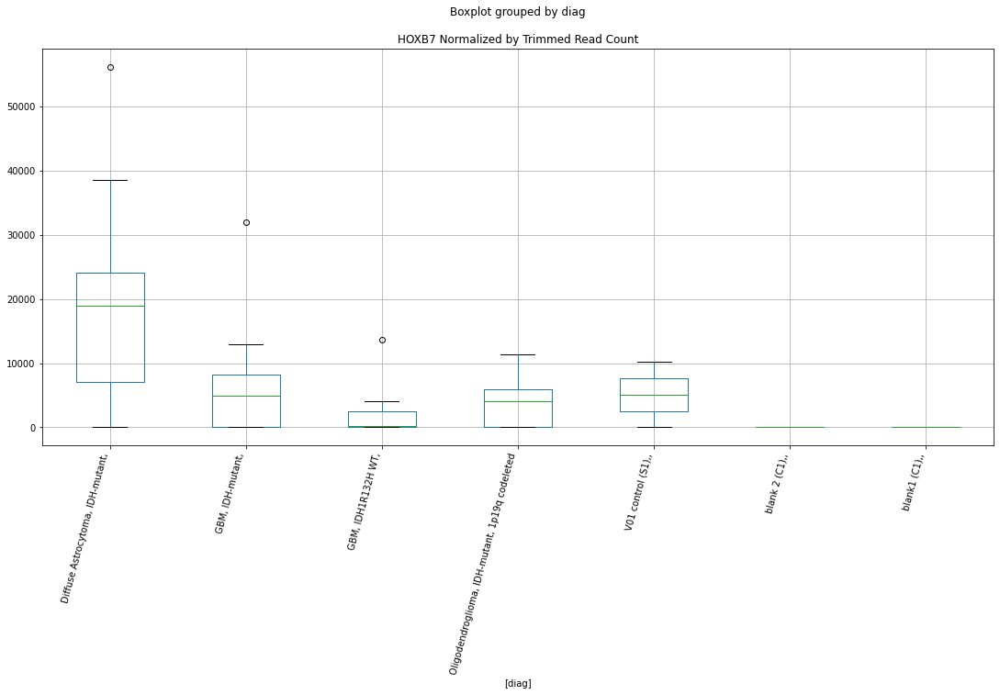

 p : 0.005500590141143207  ( t : 3.1531180182371883 ) :  Lexogen  :  cutadapt2  :  HOXB7
Control and blanks
82         0.00
346    10100.86
Name: HOXB7, dtype: float64
214    0.0
Name: HOXB7, dtype: float64
478    0.0
Name: HOXB7, dtype: float64


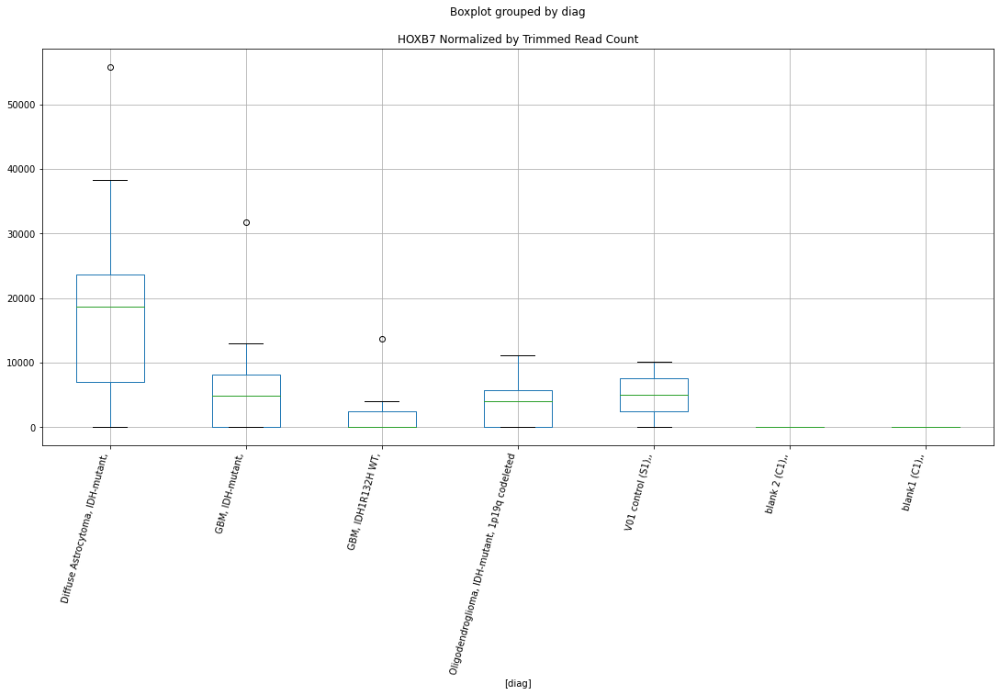

 p : 0.005605520395230268  ( t : 3.144501089970877 ) :  D-plex  :  cutadapt2  :  DNA2
Control and blanks
76        0.0
340    2642.2
Name: DNA2, dtype: float64
208    263482.17
Name: DNA2, dtype: float64
472    3467.74
Name: DNA2, dtype: float64


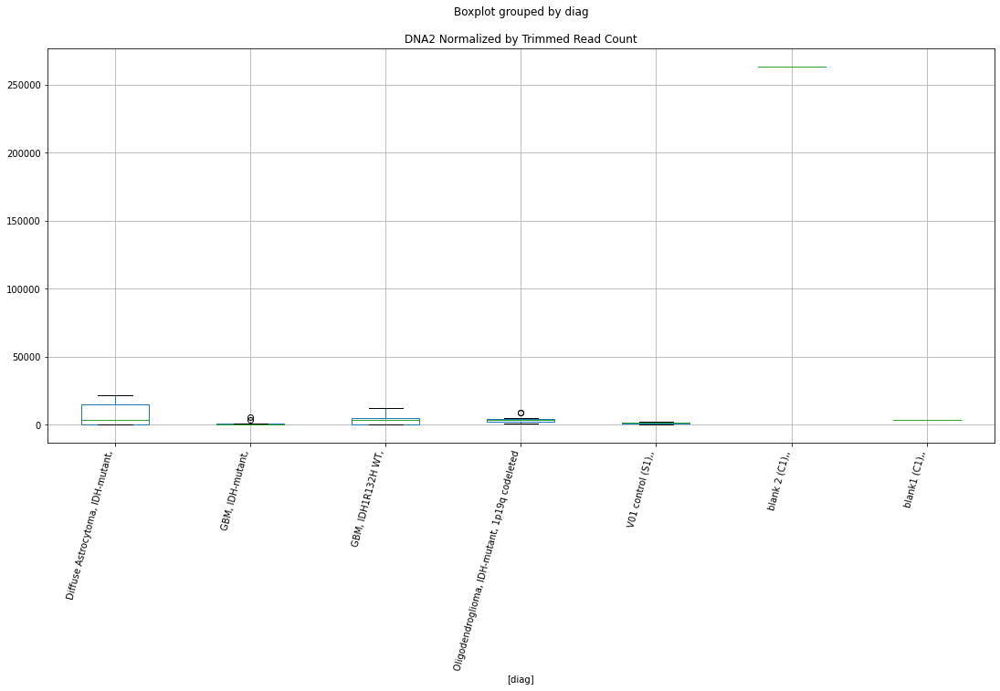

 p : 0.005681865275553582  ( t : 3.1383301011518836 ) :  D-plex  :  bbduk2  :  HRH3
Control and blanks
73     0.0
337    0.0
Name: HRH3, dtype: float64
205    358.18
Name: HRH3, dtype: float64
469    4140.69
Name: HRH3, dtype: float64


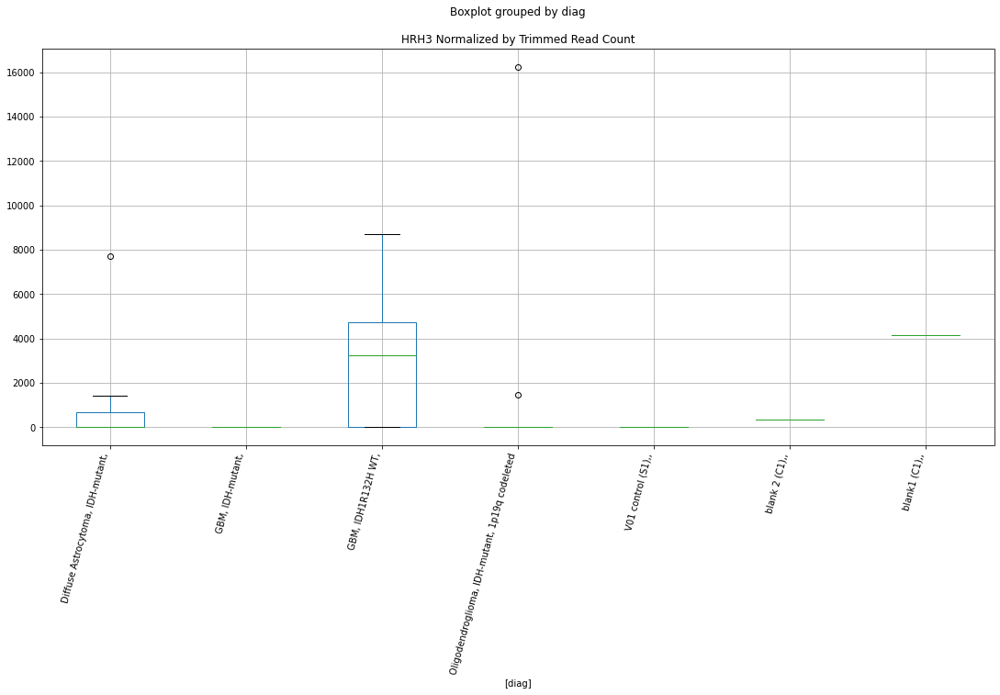

 p : 0.005838298129543949  ( t : 3.1259346405458484 ) :  D-plex  :  cutadapt2  :  DOCK2
Control and blanks
76     4545.69
340    2642.20
Name: DOCK2, dtype: float64
208    7759.85
Name: DOCK2, dtype: float64
472    10403.21
Name: DOCK2, dtype: float64


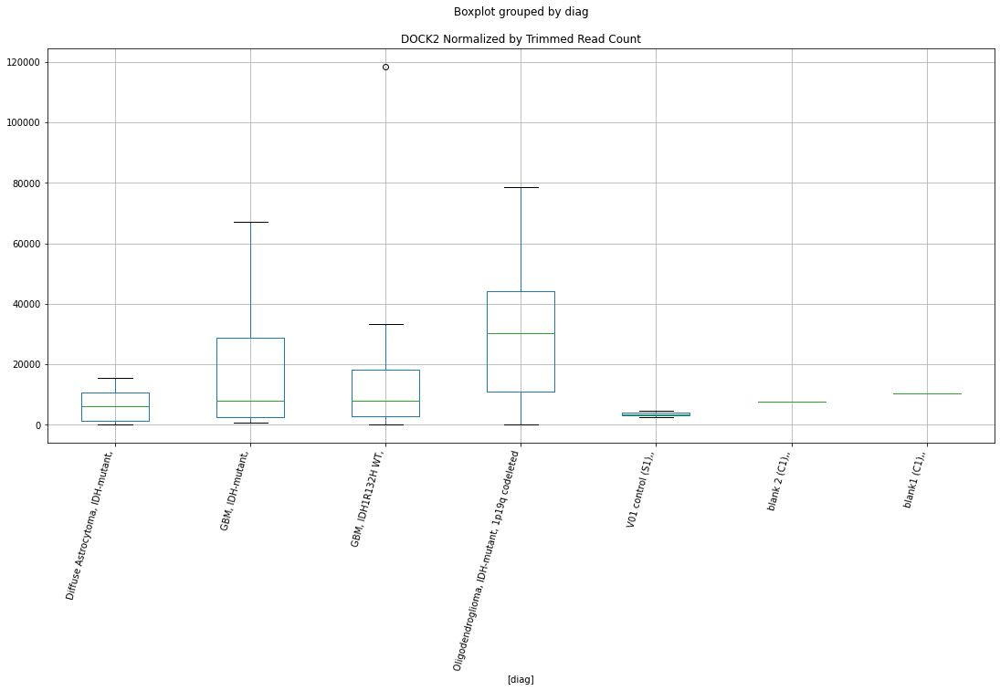

 p : 0.006150026875046898  ( t : 3.1021721408326592 ) :  Lexogen  :  bbduk2  :  FAM210A
Control and blanks
79     0.0
343    0.0
Name: FAM210A, dtype: float64
211    0.0
Name: FAM210A, dtype: float64
475    0.0
Name: FAM210A, dtype: float64


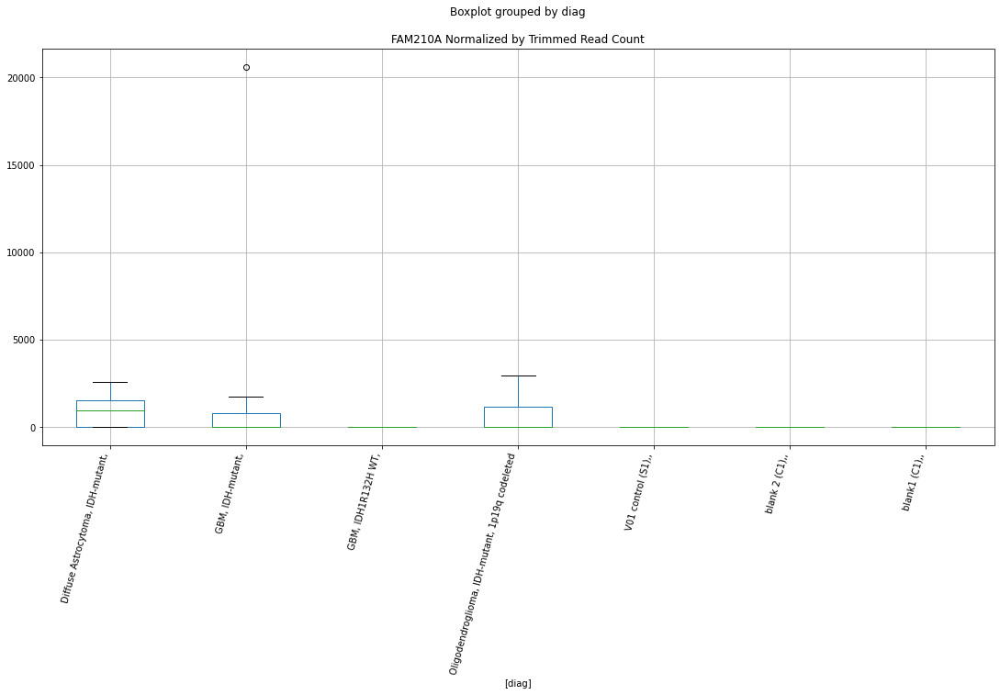

 p : 0.006232368262030093  ( t : 3.0960916058567602 ) :  D-plex  :  bbduk2  :  GABRB3
Control and blanks
73     0.0
337    0.0
Name: GABRB3, dtype: float64
205    11820.0
Name: GABRB3, dtype: float64
469    8281.38
Name: GABRB3, dtype: float64


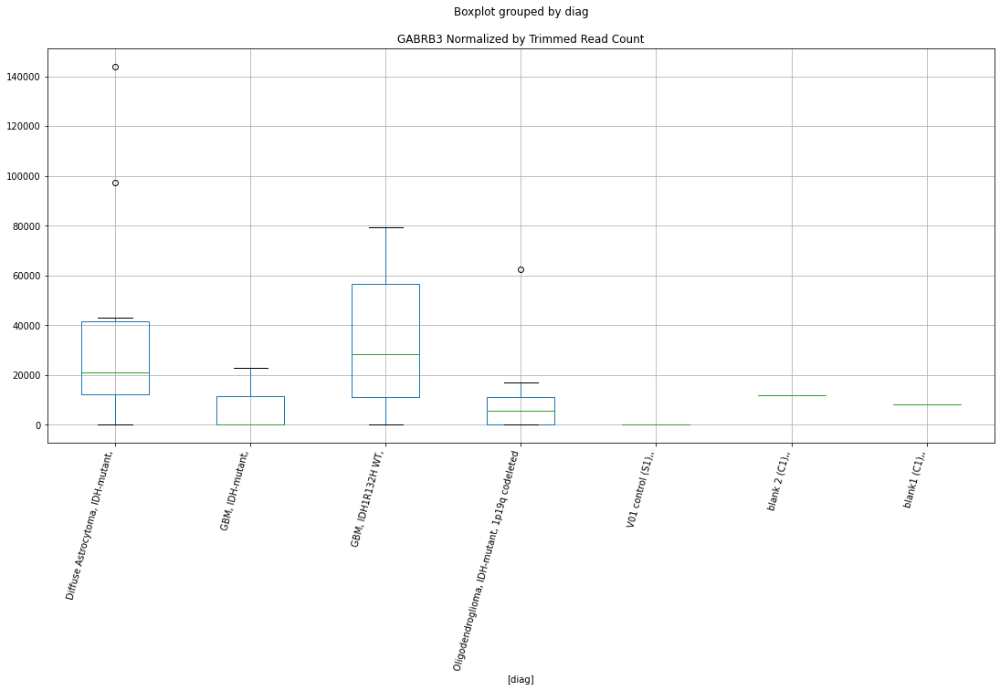

 p : 0.006325826819626959  ( t : 3.0892843160359225 ) :  D-plex  :  cutadapt2  :  IL2
Control and blanks
76     3030.46
340    5284.39
Name: IL2, dtype: float64
208    11639.77
Name: IL2, dtype: float64
472    528251.64
Name: IL2, dtype: float64


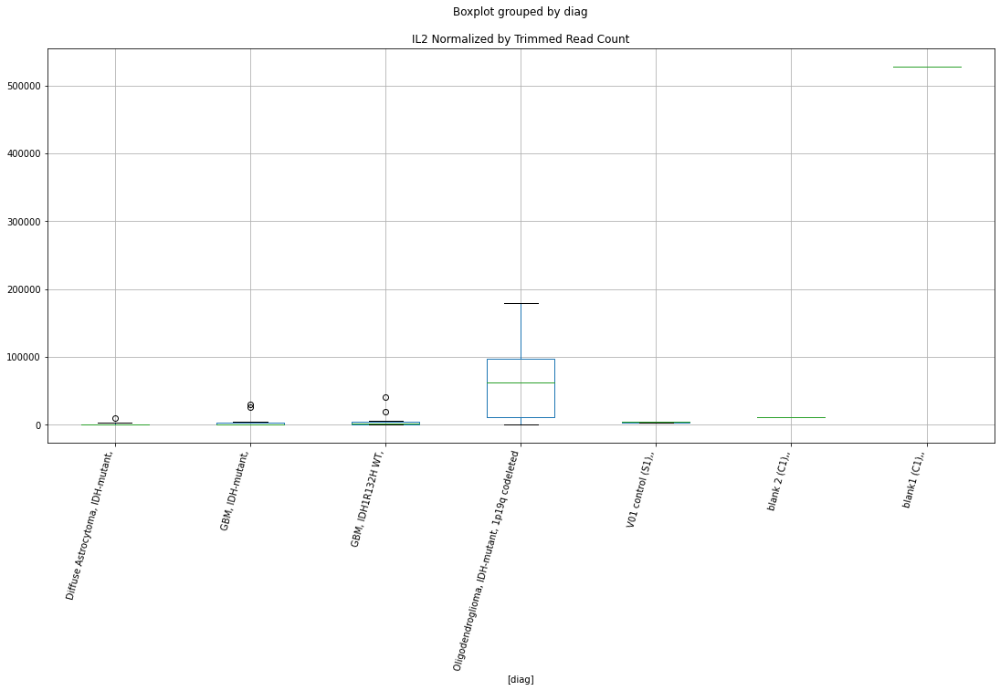

 p : 0.006409494157041358  ( t : 3.083272856021729 ) :  D-plex  :  cutadapt2  :  GABRB3
Control and blanks
76     0.0
340    0.0
Name: GABRB3, dtype: float64
208    11639.77
Name: GABRB3, dtype: float64
472    7513.43
Name: GABRB3, dtype: float64


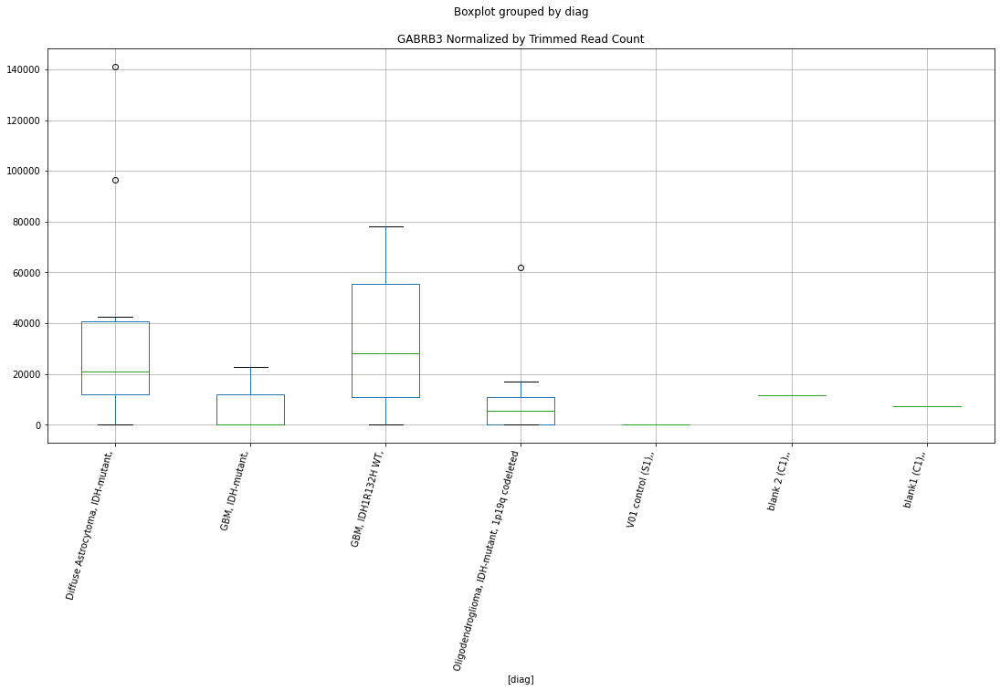

 p : 0.006432813599949634  ( t : 3.0816109910614737 ) :  D-plex  :  bbduk2  :  IL2
Control and blanks
73     3092.03
337    5340.94
Name: IL2, dtype: float64
205    11461.82
Name: IL2, dtype: float64
469    538289.86
Name: IL2, dtype: float64


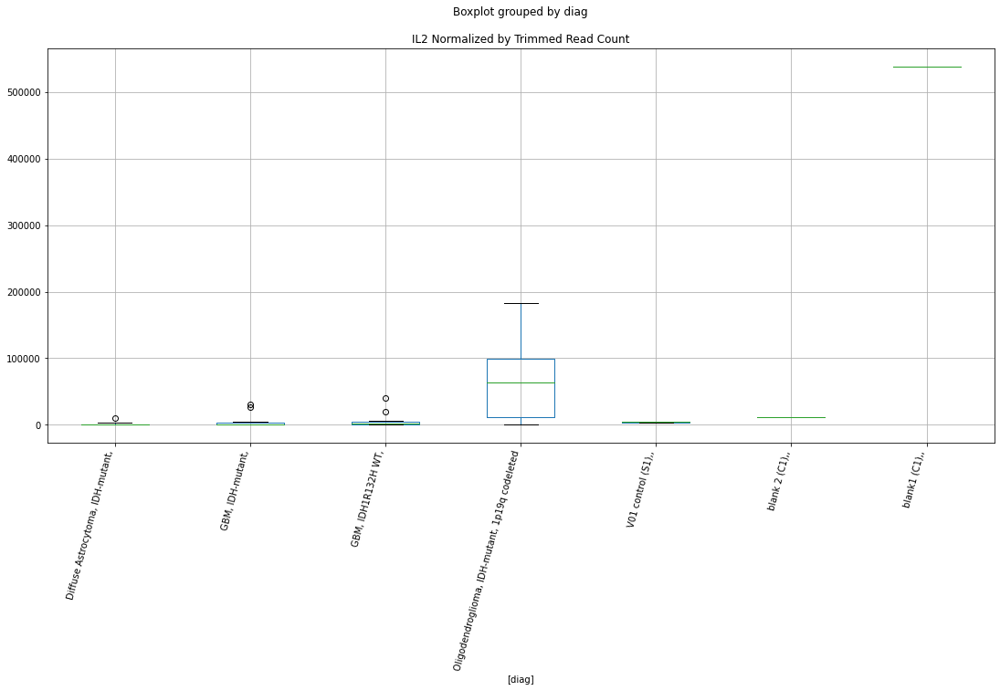

 p : 0.006547326075241541  ( t : 3.073534489906478 ) :  D-plex  :  cutadapt2  :  GGCX
Control and blanks
76        0.00
340    6165.12
Name: GGCX, dtype: float64
208    881.8
Name: GGCX, dtype: float64
472    0.0
Name: GGCX, dtype: float64


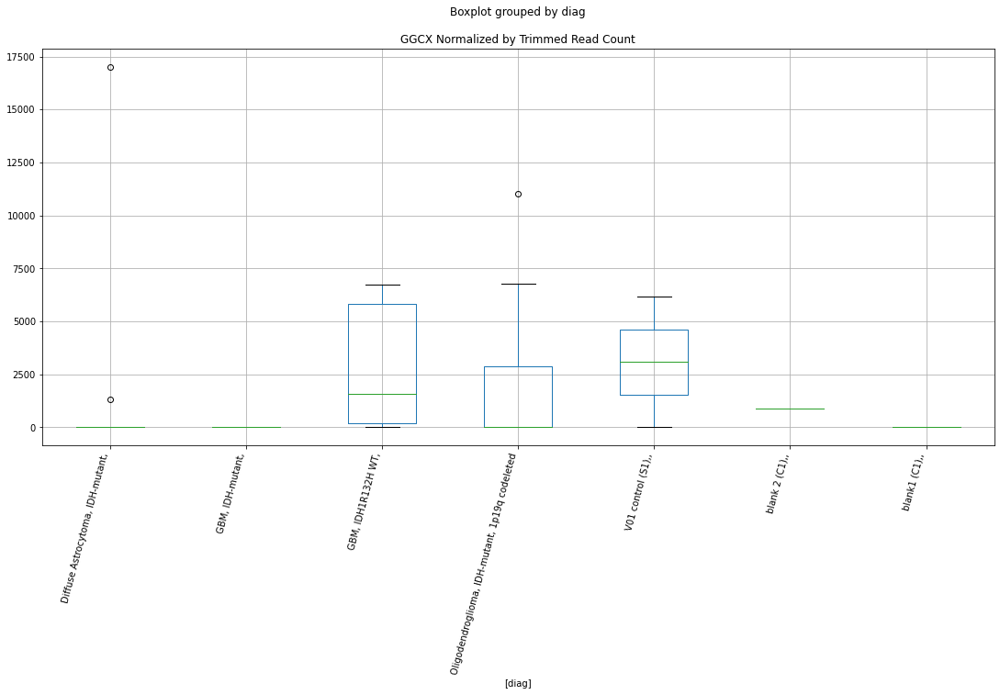

 p : 0.006567703479083845  ( t : 3.0721117199380257 ) :  D-plex  :  cutadapt2  :  KIF21A
Control and blanks
76     0.0
340    0.0
Name: KIF21A, dtype: float64
208    6348.97
Name: KIF21A, dtype: float64
472    18494.59
Name: KIF21A, dtype: float64


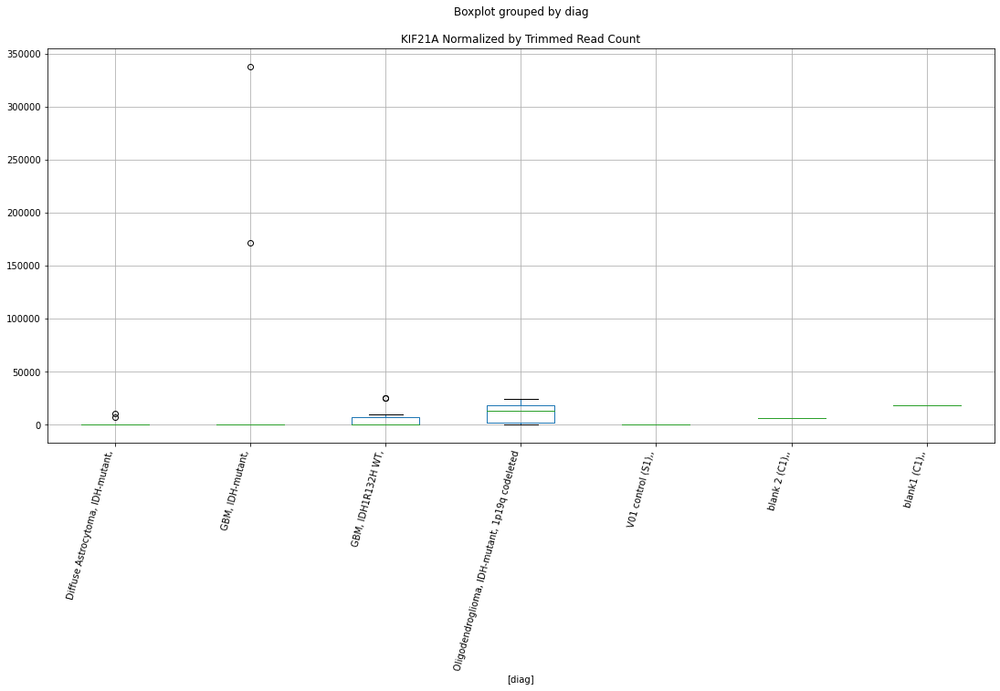

 p : 0.006601442501955663  ( t : 3.0697654552538793 ) :  D-plex  :  bbduk2  :  DOCK2
Control and blanks
73     4638.05
337    1780.31
Name: DOCK2, dtype: float64
205    7880.0
Name: DOCK2, dtype: float64
469    9464.44
Name: DOCK2, dtype: float64


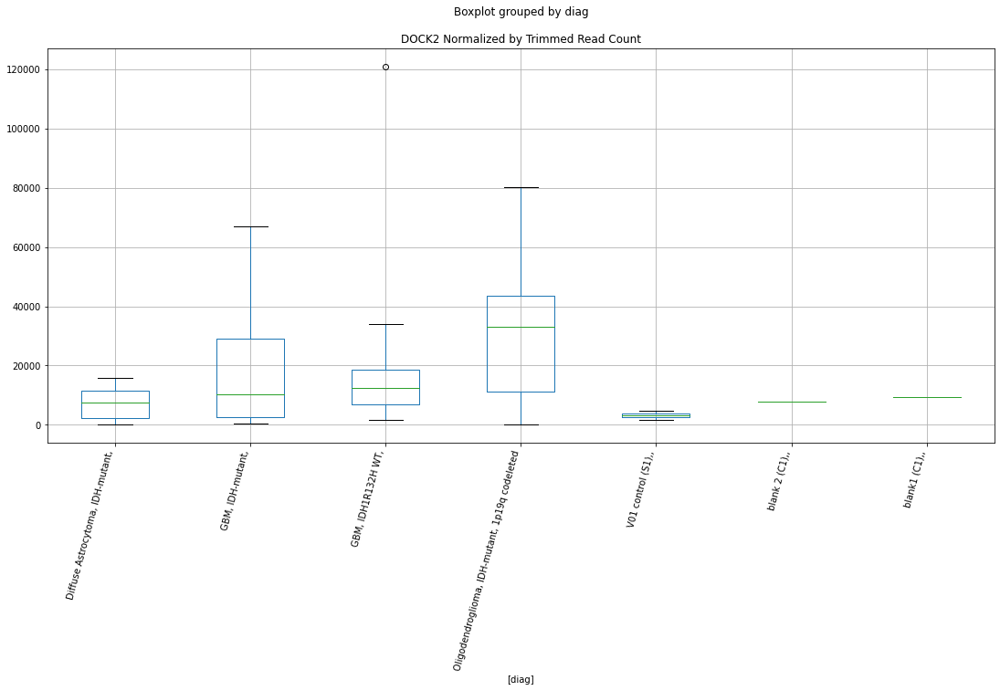

 p : 0.007297234969805112  ( t : 3.0238159058173153 ) :  D-plex  :  cutadapt2  :  HRH3
Control and blanks
76     0.0
340    0.0
Name: HRH3, dtype: float64
208    352.72
Name: HRH3, dtype: float64
472    4045.69
Name: HRH3, dtype: float64


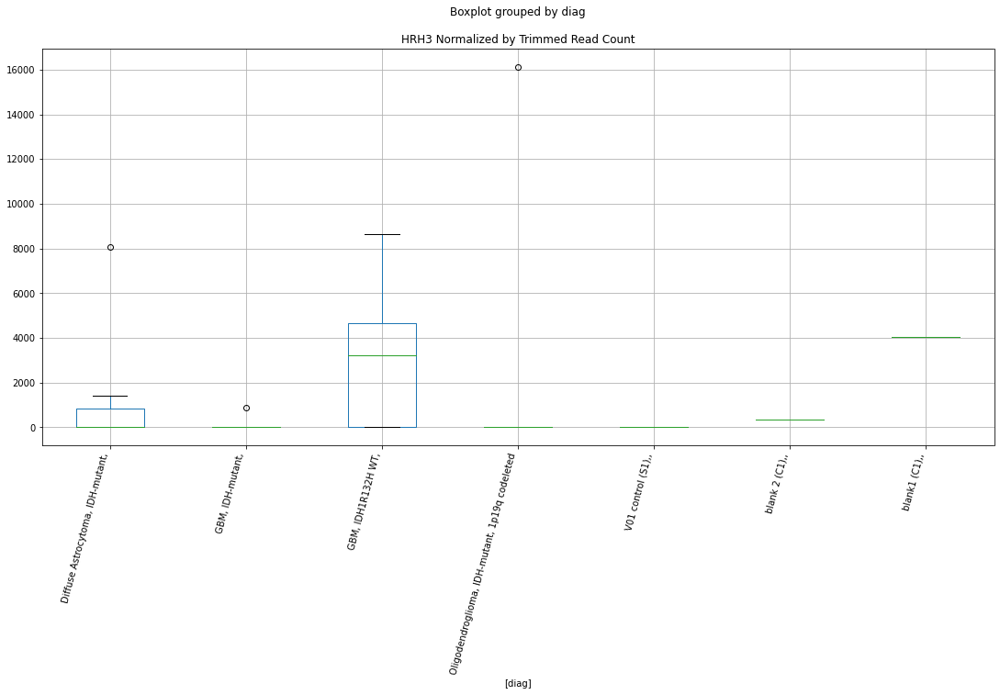

 p : 0.007463548344718934  ( t : 3.013464900349663 ) :  D-plex  :  cutadapt2  :  IL2
Control and blanks
76     3030.46
340    5284.39
Name: IL2, dtype: float64
208    11639.77
Name: IL2, dtype: float64
472    528251.64
Name: IL2, dtype: float64


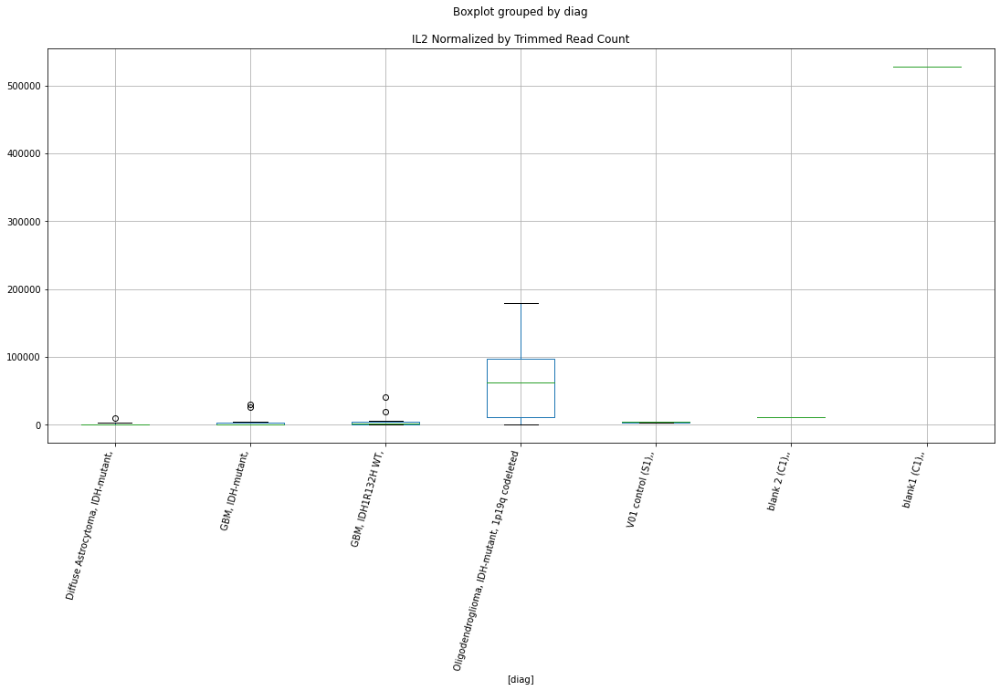

 p : 0.007565590163116123  ( t : 3.0072243810418713 ) :  D-plex  :  cutadapt2  :  GEMIN4
Control and blanks
76      6060.91
340    14091.71
Name: GEMIN4, dtype: float64
208    321151.96
Name: GEMIN4, dtype: float64
472    73978.35
Name: GEMIN4, dtype: float64


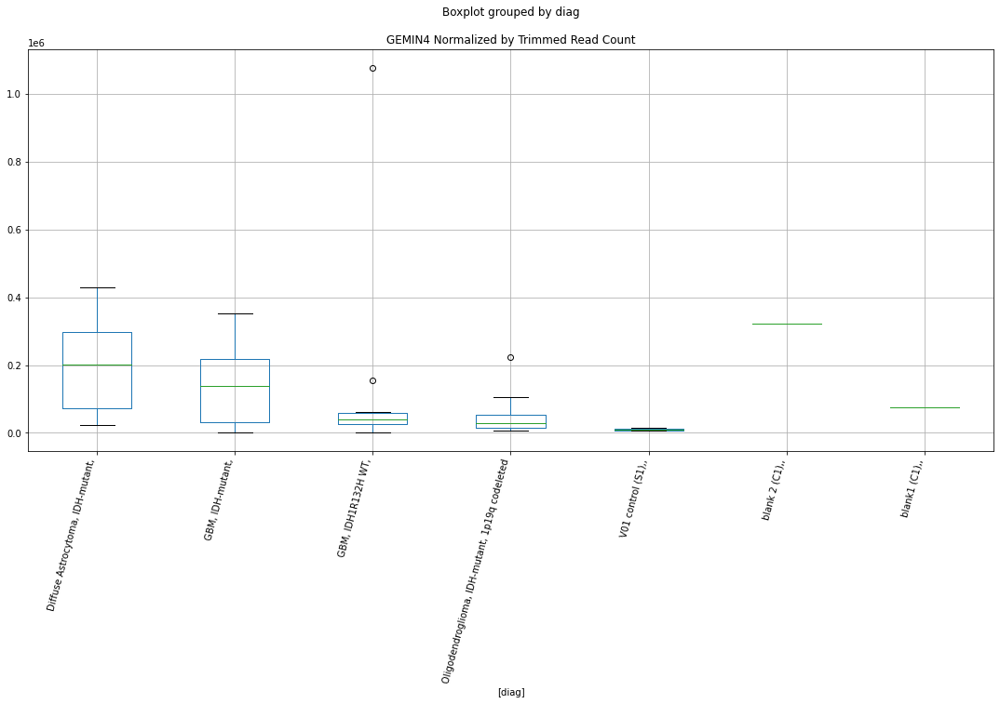

 p : 0.00761409555433088  ( t : 3.004286571857205 ) :  D-plex  :  cutadapt2  :  IL34
Control and blanks
76     2272.84
340       0.00
Name: IL34, dtype: float64
208    91707.31
Name: IL34, dtype: float64
472    924151.39
Name: IL34, dtype: float64


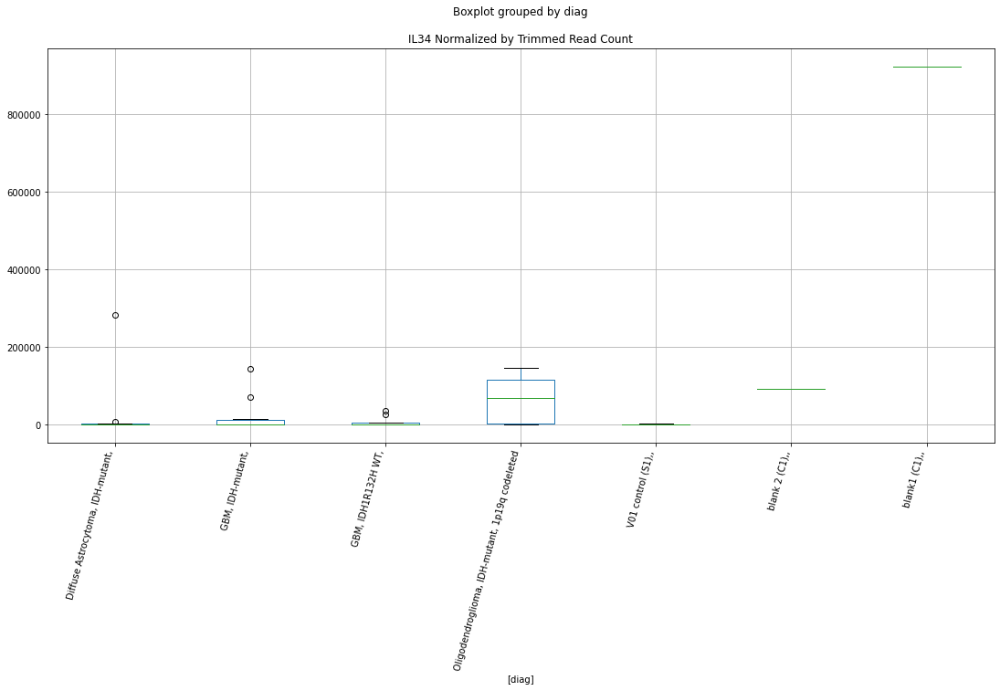

 p : 0.007634942153469109  ( t : 3.003029542794728 ) :  D-plex  :  bbduk2  :  IL34
Control and blanks
73     2319.03
337       0.00
Name: IL34, dtype: float64
205    92590.02
Name: IL34, dtype: float64
469    942303.02
Name: IL34, dtype: float64


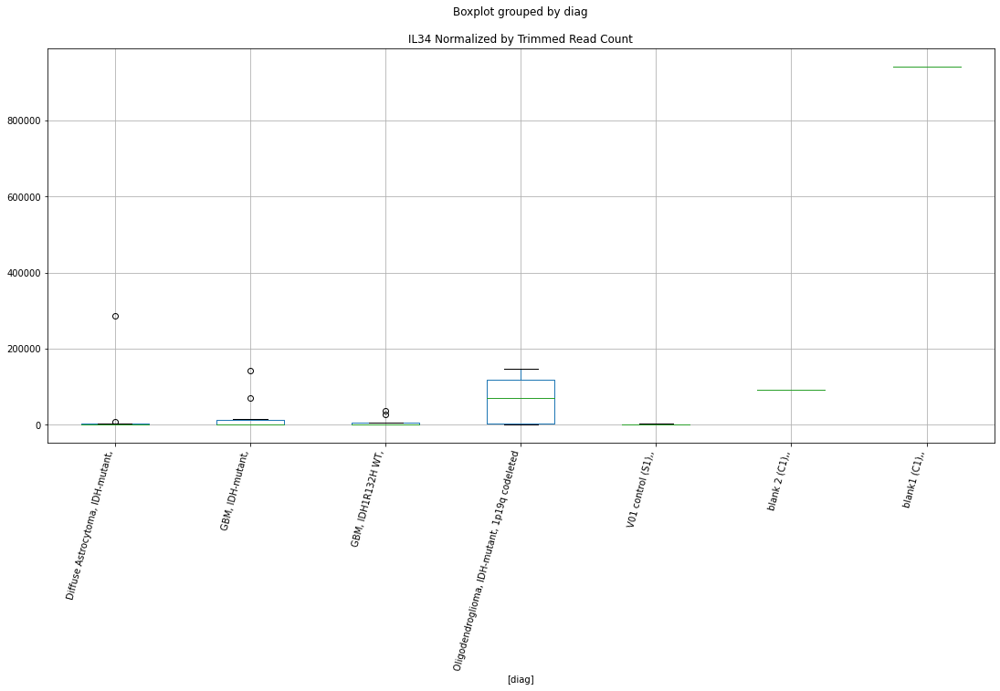

 p : 0.007681276021055589  ( t : 3.0002475495873204 ) :  D-plex  :  bbduk2  :  IL2
Control and blanks
73     3092.03
337    5340.94
Name: IL2, dtype: float64
205    11461.82
Name: IL2, dtype: float64
469    538289.86
Name: IL2, dtype: float64


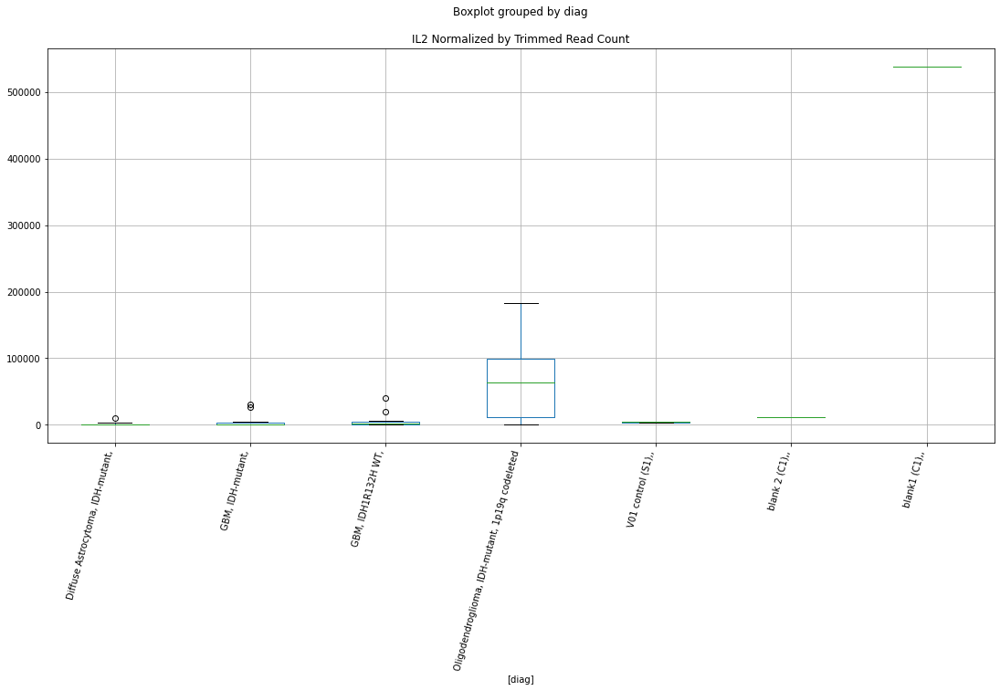

 p : 0.0077875505902624135  ( t : 2.9939276208270917 ) :  D-plex  :  cutadapt2  :  HSPH1
Control and blanks
76     102277.92
340     13210.98
Name: HSPH1, dtype: float64
208    38975.61
Name: HSPH1, dtype: float64
472    67042.88
Name: HSPH1, dtype: float64


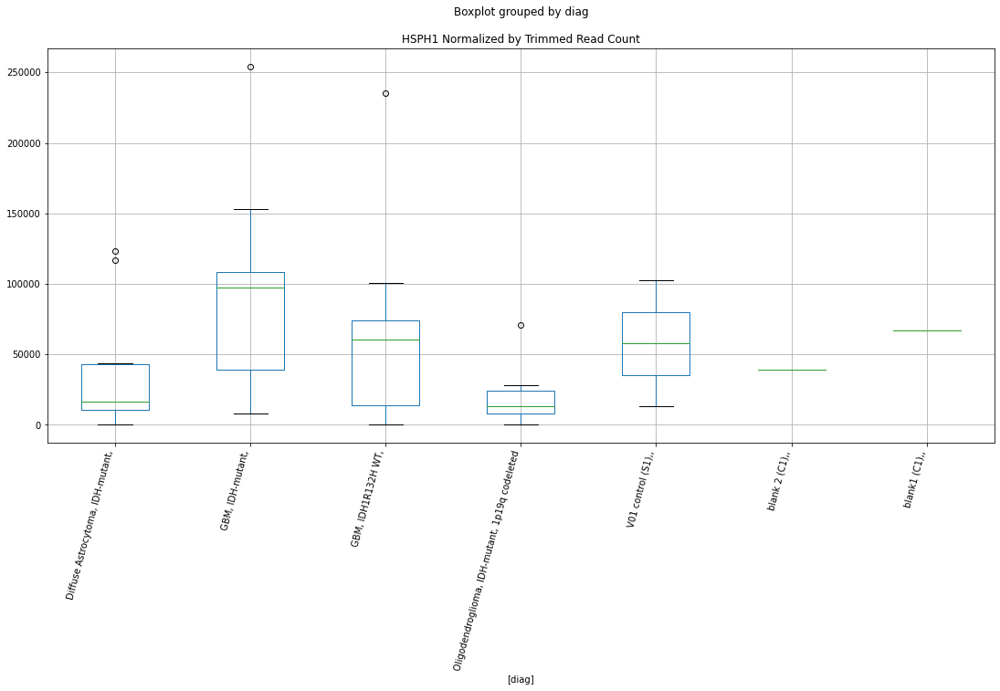

 p : 0.00820723278430788  ( t : 2.969761711637172 ) :  D-plex  :  bbduk2  :  DYNC2H1
Control and blanks
73     4638.05
337    4450.79
Name: DYNC2H1, dtype: float64
205    12357.28
Name: DYNC2H1, dtype: float64
469    13605.13
Name: DYNC2H1, dtype: float64


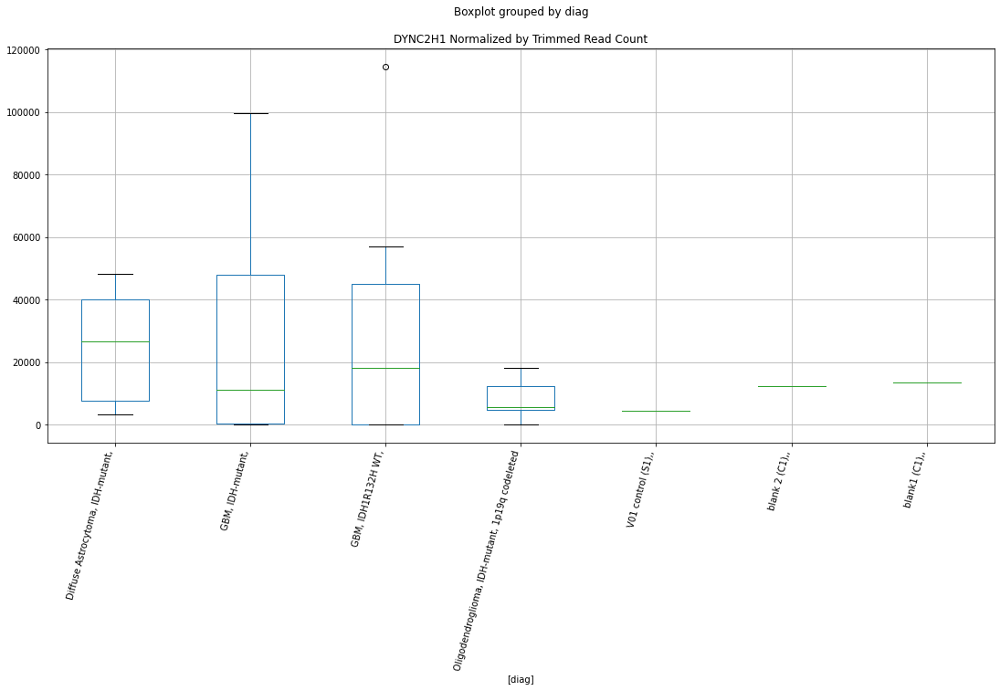

 p : 0.008311338987268841  ( t : 2.963952735170636 ) :  Lexogen  :  bbduk2  :  HTATSF1P2
Control and blanks
79       0.00
343    424.63
Name: HTATSF1P2, dtype: float64
211    0.0
Name: HTATSF1P2, dtype: float64
475    0.0
Name: HTATSF1P2, dtype: float64


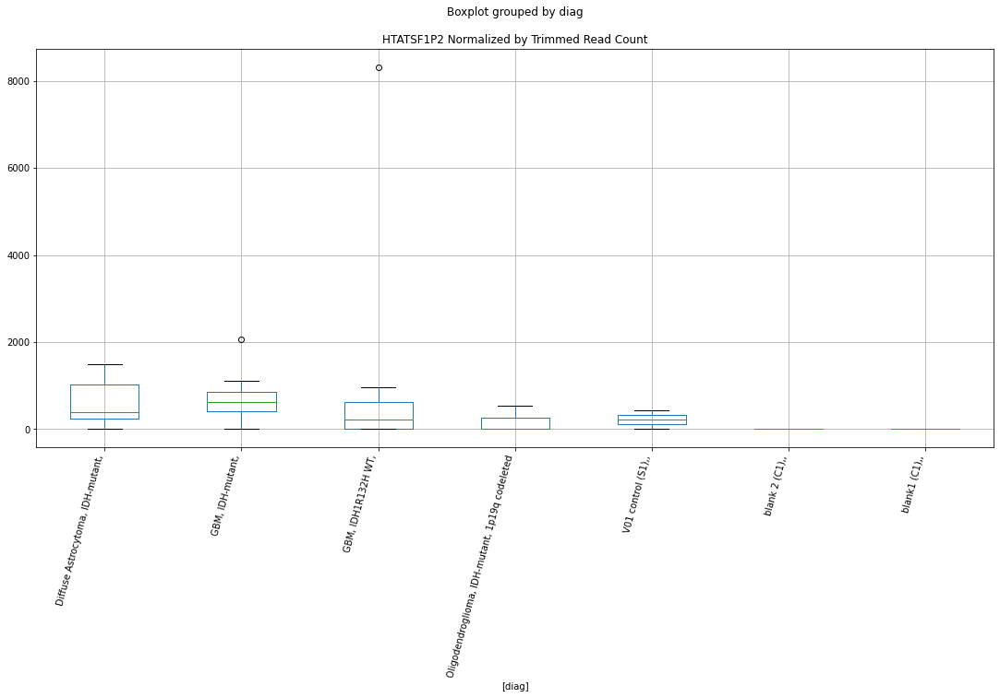

 p : 0.008406133511328294  ( t : 2.958724350053944 ) :  D-plex  :  bbduk2  :  GEMIN4
Control and blanks
73      6184.07
337    14242.52
Name: GEMIN4, dtype: float64
205    327557.35
Name: GEMIN4, dtype: float64
469    70983.28
Name: GEMIN4, dtype: float64


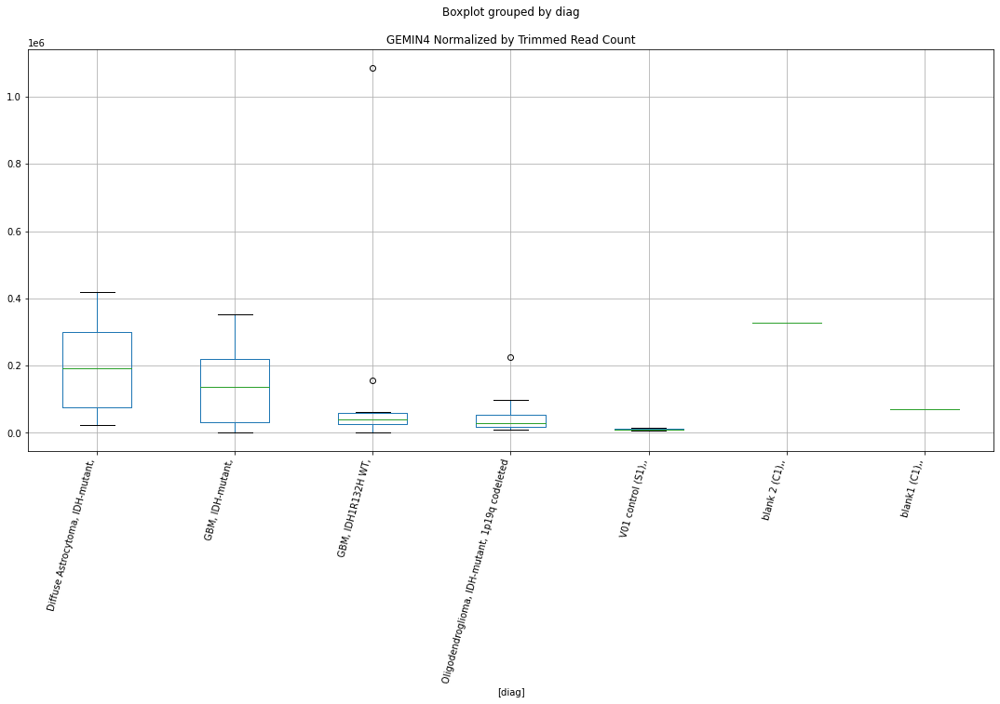

 p : 0.008528735751515387  ( t : 2.95204630874099 ) :  Lexogen  :  cutadapt2  :  GOLGA2P6
Control and blanks
82     0.0
346    0.0
Name: GOLGA2P6, dtype: float64
214    0.0
Name: GOLGA2P6, dtype: float64
478    0.0
Name: GOLGA2P6, dtype: float64


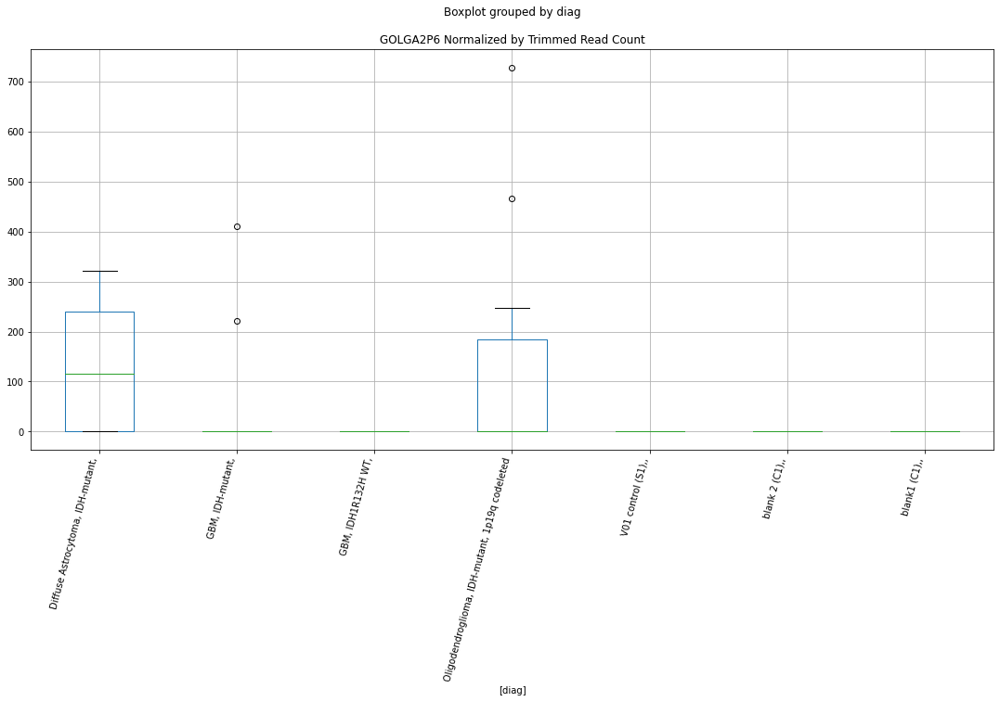

 p : 0.00852897842598346  ( t : 2.9520331829057054 ) :  Lexogen  :  bbduk2  :  GOLGA2P6
Control and blanks
79     0.0
343    0.0
Name: GOLGA2P6, dtype: float64
211    0.0
Name: GOLGA2P6, dtype: float64
475    0.0
Name: GOLGA2P6, dtype: float64


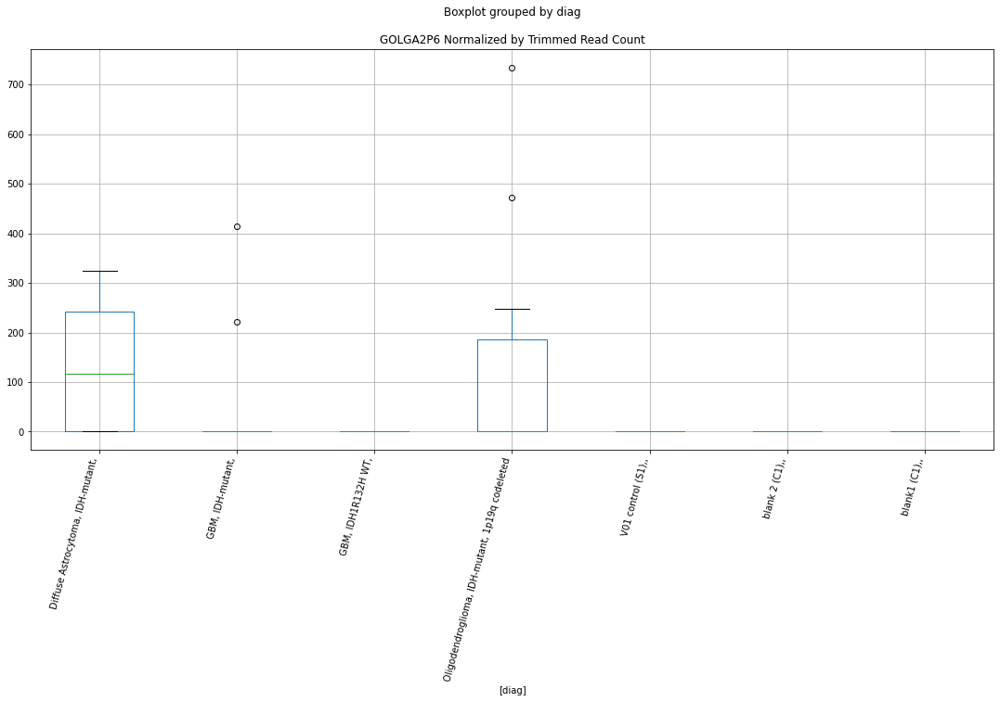

 p : 0.008714870665321226  ( t : 2.9420833504481347 ) :  D-plex  :  cutadapt2  :  DYNC2H1
Control and blanks
76     4545.69
340    4403.66
Name: DYNC2H1, dtype: float64
208    12168.86
Name: DYNC2H1, dtype: float64
472    13292.98
Name: DYNC2H1, dtype: float64


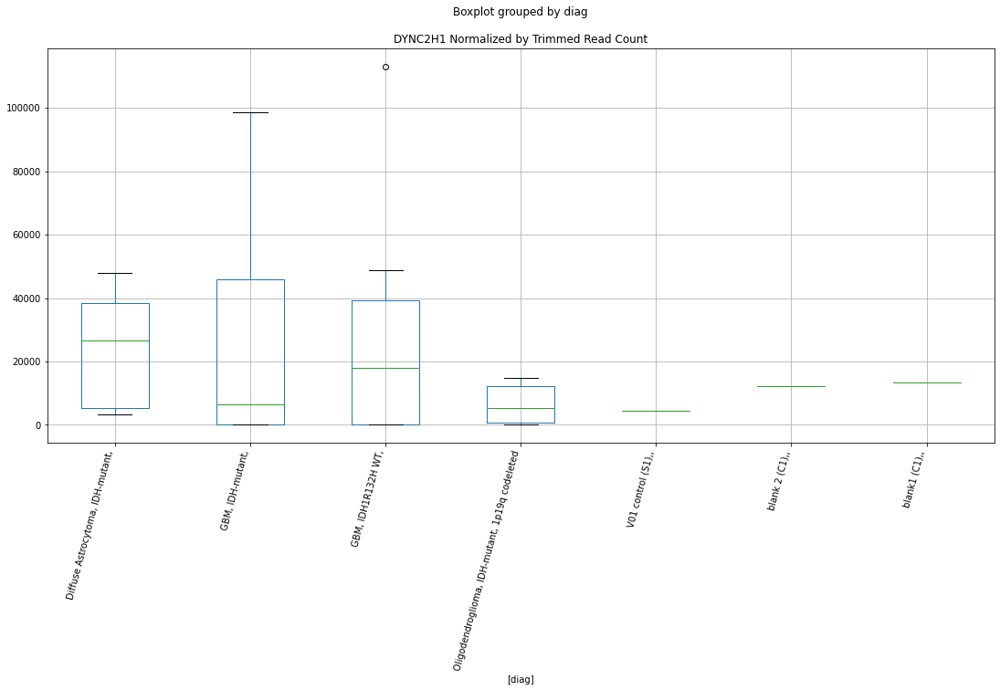

 p : 0.00918922917981236  ( t : 2.917595616266513 ) :  Lexogen  :  bbduk2  :  GNAS
Control and blanks
79         0.00
343    62845.04
Name: GNAS, dtype: float64
211    83631.74
Name: GNAS, dtype: float64
475    0.0
Name: GNAS, dtype: float64


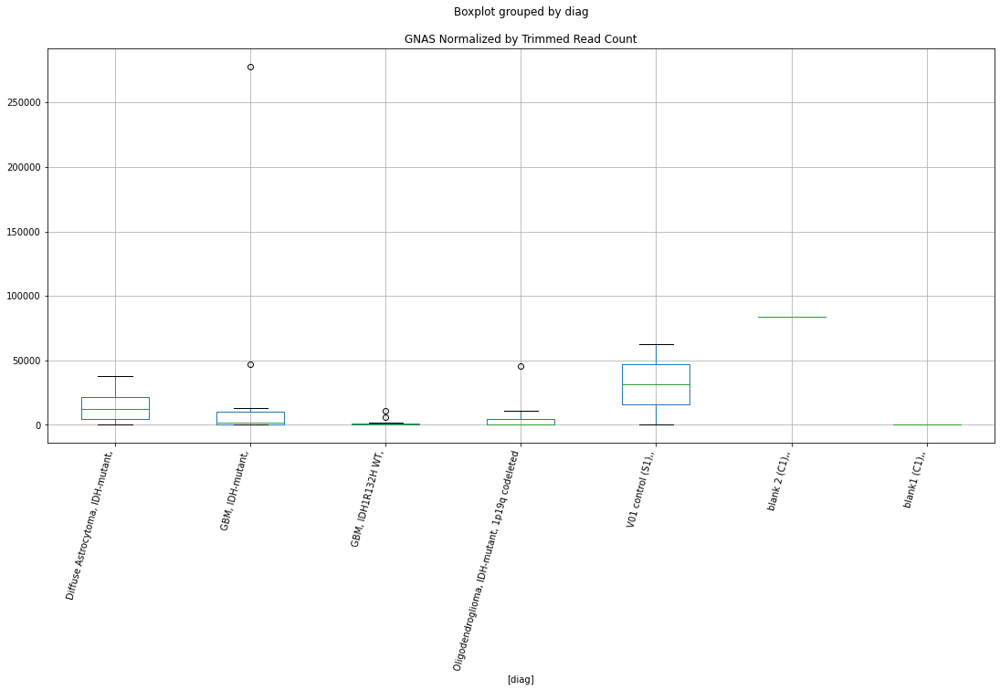

 p : 0.009265219567103695  ( t : 2.913786811397814 ) :  Lexogen  :  cutadapt2  :  KMT2A
Control and blanks
82        0.00
346    5892.17
Name: KMT2A, dtype: float64
214    17087.27
Name: KMT2A, dtype: float64
478    1662.22
Name: KMT2A, dtype: float64


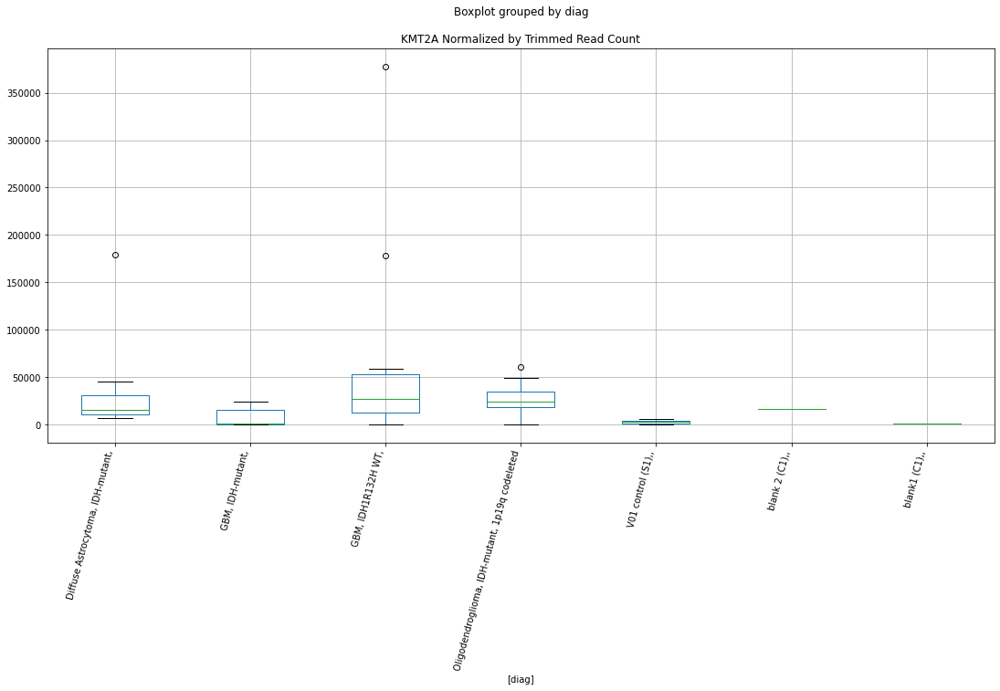

 p : 0.009343281369940736  ( t : 2.9099054980950423 ) :  Lexogen  :  bbduk2  :  KIF19
Control and blanks
79     0.0
343    0.0
Name: KIF19, dtype: float64
211    0.0
Name: KIF19, dtype: float64
475    0.0
Name: KIF19, dtype: float64


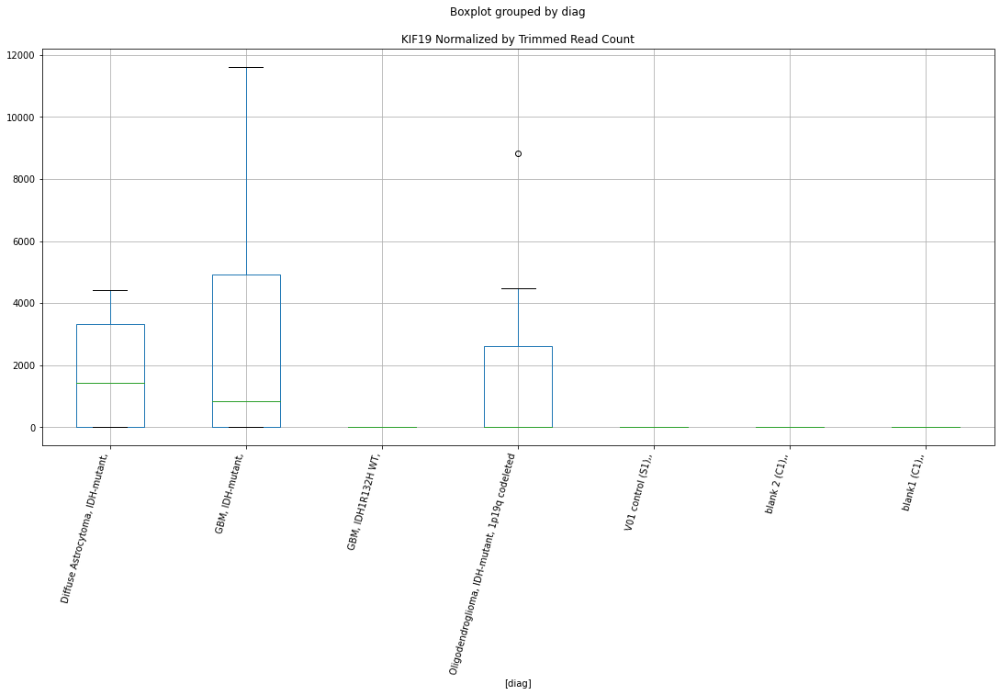

 p : 0.009354589263301202  ( t : 2.9093458586706418 ) :  D-plex  :  bbduk2  :  EYA1
Control and blanks
73     0.0
337    0.0
Name: EYA1, dtype: float64
205    3760.91
Name: EYA1, dtype: float64
469    591.53
Name: EYA1, dtype: float64


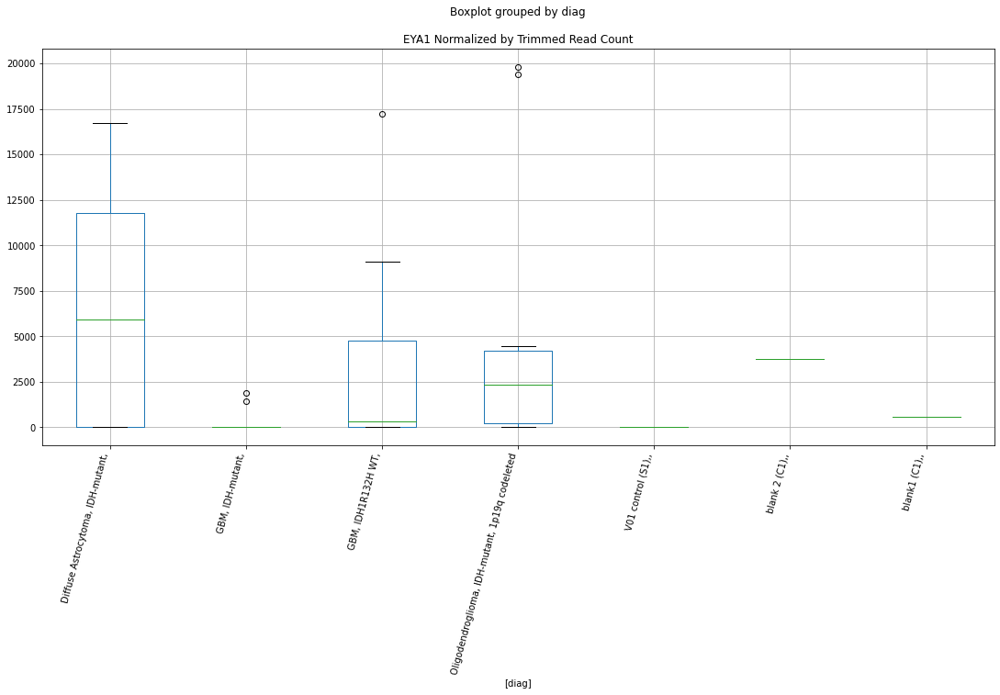

 p : 0.00944517742277203  ( t : 2.904886009484316 ) :  D-plex  :  cutadapt2  :  GBE1
Control and blanks
76     0.0
340    0.0
Name: GBE1, dtype: float64
208    881.8
Name: GBE1, dtype: float64
472    0.0
Name: GBE1, dtype: float64


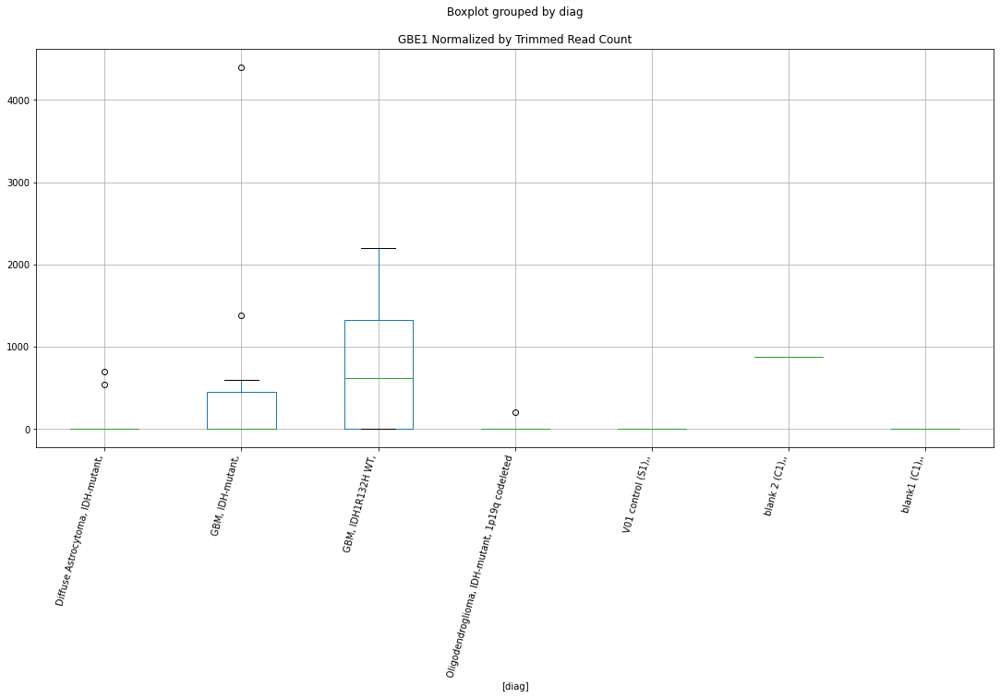

 p : 0.009468013730465805  ( t : 2.90376825269248 ) :  Lexogen  :  bbduk2  :  KMT2A
Control and blanks
79        0.0
343    5944.8
Name: KMT2A, dtype: float64
211    17218.3
Name: KMT2A, dtype: float64
475    1676.61
Name: KMT2A, dtype: float64


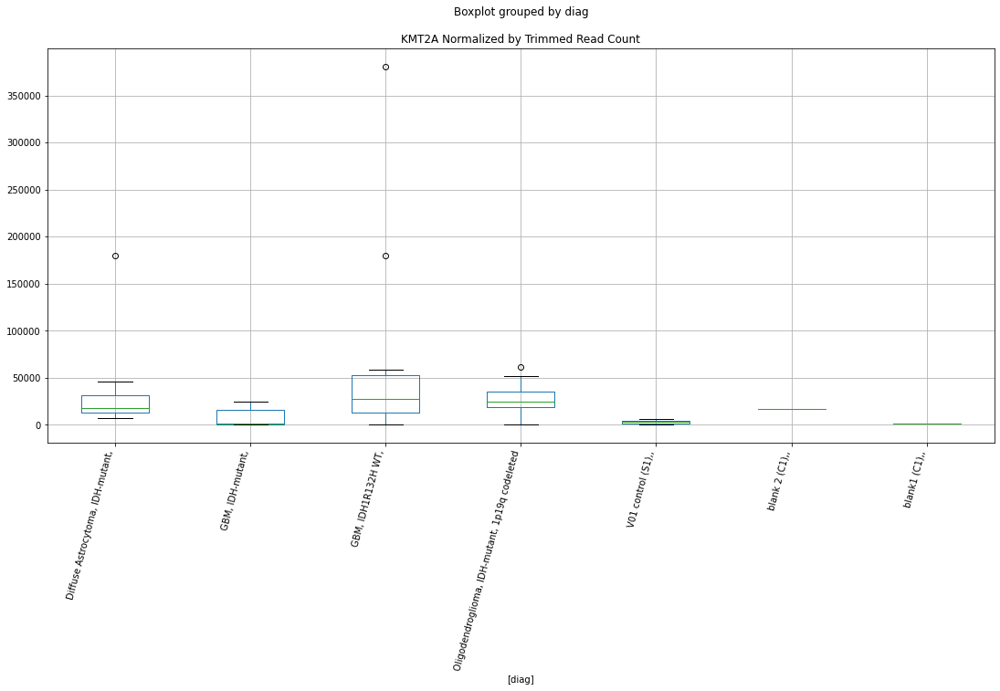

 p : 0.00954786690458309  ( t : 2.89988009534706 ) :  D-plex  :  cutadapt2  :  DOK1
Control and blanks
76     36365.48
340        0.00
Name: DOK1, dtype: float64
208    10581.61
Name: DOK1, dtype: float64
472    1155.91
Name: DOK1, dtype: float64


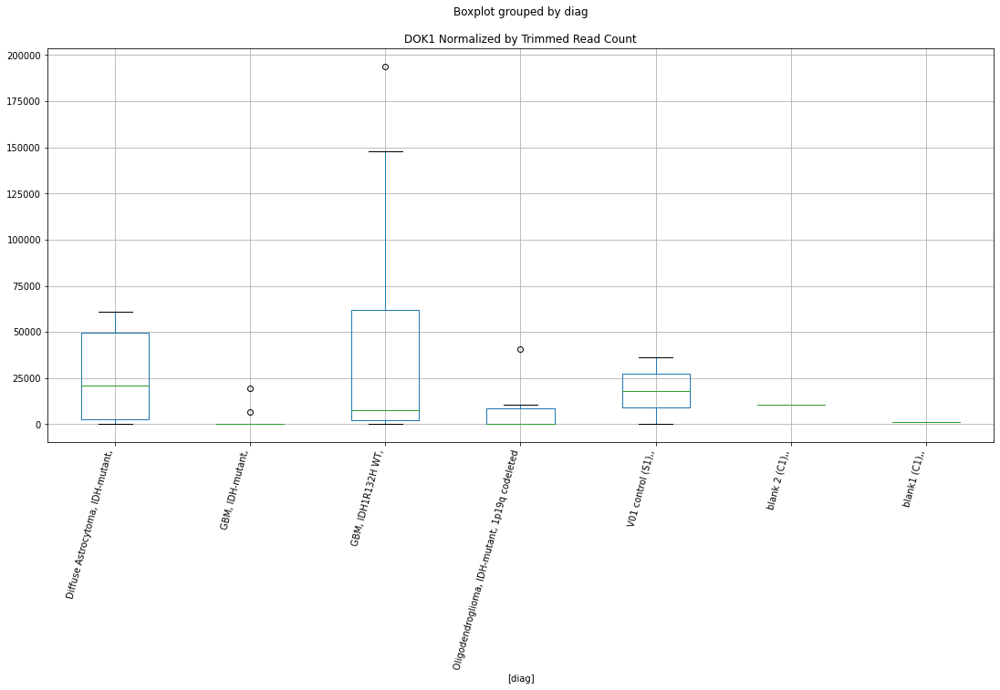

 p : 0.009702342656204729  ( t : 2.892446814007122 ) :  Lexogen  :  cutadapt2  :  GNAS
Control and blanks
82         0.00
346    62288.62
Name: GNAS, dtype: float64
214    82995.29
Name: GNAS, dtype: float64
478    0.0
Name: GNAS, dtype: float64


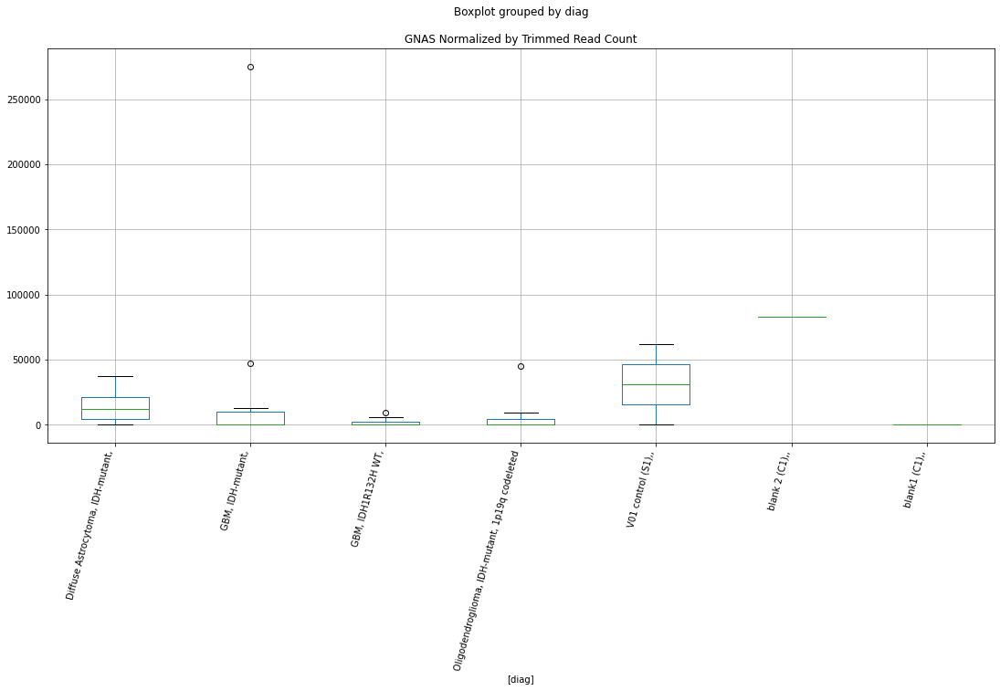

 p : 0.009795065449882597  ( t : 2.8880397451886646 ) :  Lexogen  :  bbduk2  :  HUWE1
Control and blanks
79        0.00
343    4246.29
Name: HUWE1, dtype: float64
211    4919.51
Name: HUWE1, dtype: float64
475    4790.31
Name: HUWE1, dtype: float64


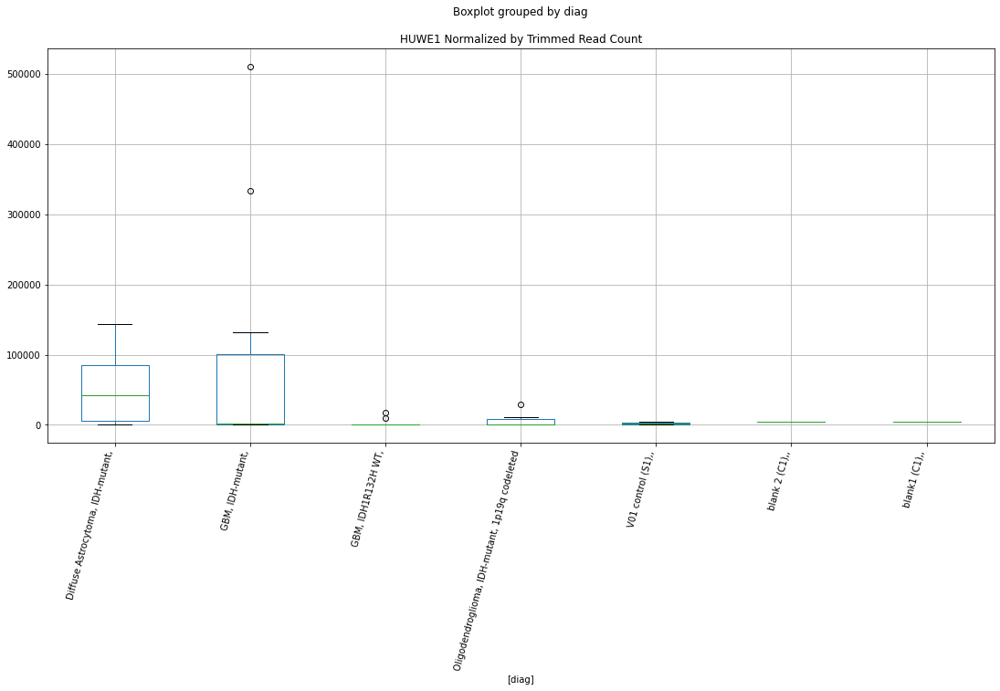

 p : 0.010539264239735243  ( t : 2.8540599428620808 ) :  D-plex  :  bbduk2  :  DOK1
Control and blanks
73     36331.39
337        0.00
Name: DOK1, dtype: float64
205    10745.46
Name: DOK1, dtype: float64
469    1183.05
Name: DOK1, dtype: float64


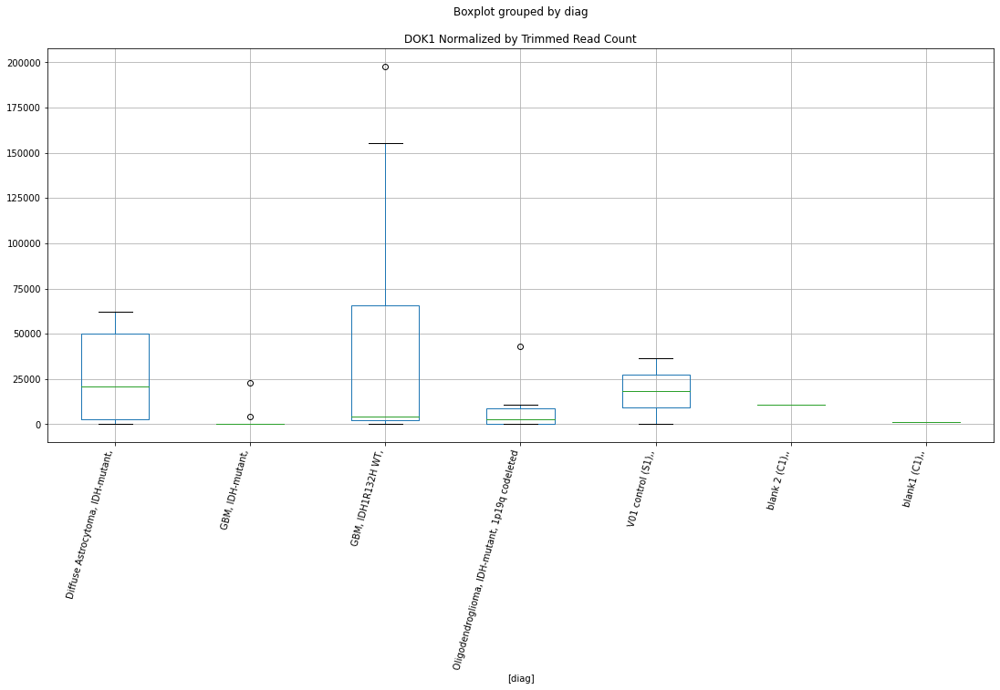

 p : 0.010559983206261721  ( t : 2.853147400633684 ) :  D-plex  :  bbduk2  :  GTF2A1L
Control and blanks
73     0.0
337    0.0
Name: GTF2A1L, dtype: float64
205    716.36
Name: GTF2A1L, dtype: float64
469    0.0
Name: GTF2A1L, dtype: float64


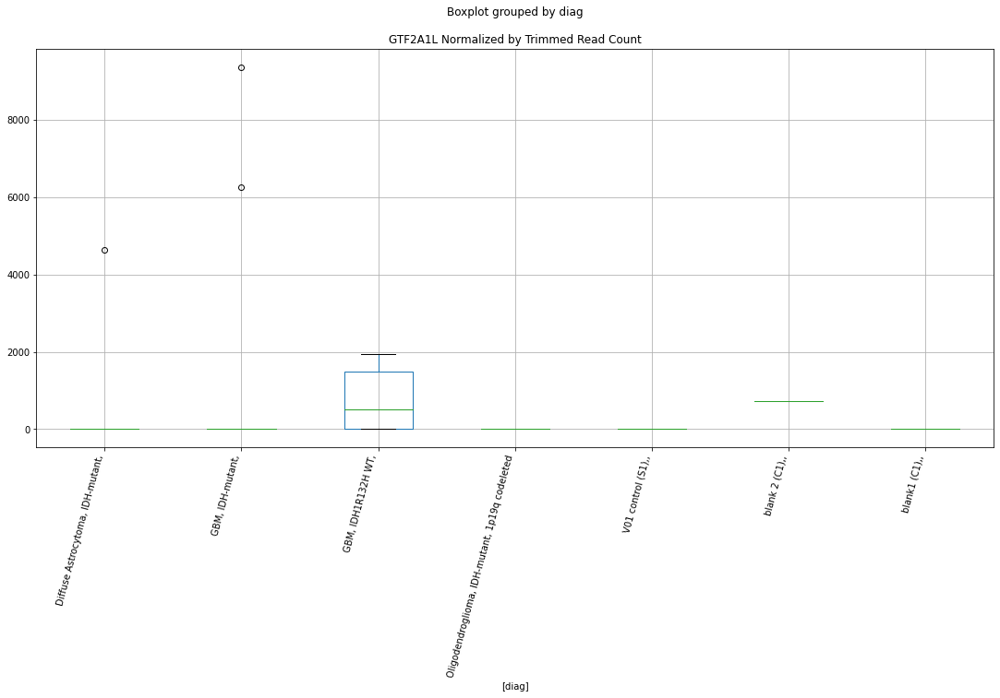

 p : 0.0107505758177472  ( t : 2.844832981239256 ) :  D-plex  :  cutadapt2  :  GLUL
Control and blanks
76     0.0
340    0.0
Name: GLUL, dtype: float64
208    3350.84
Name: GLUL, dtype: float64
472    2311.82
Name: GLUL, dtype: float64


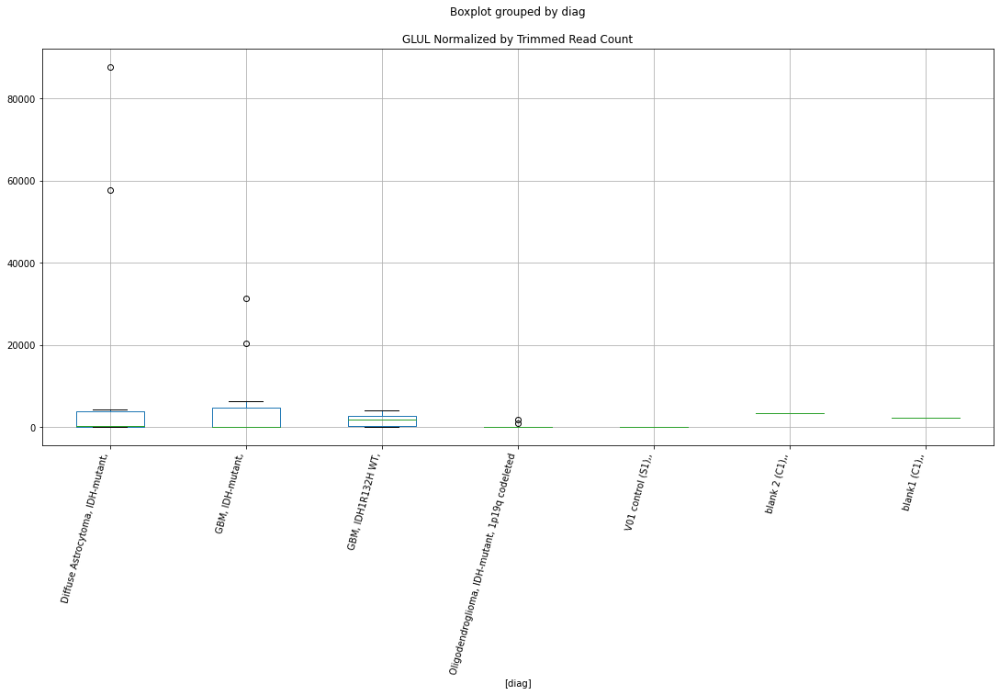

 p : 0.010779056967974468  ( t : 2.8436027297291937 ) :  Lexogen  :  cutadapt2  :  HUWE1
Control and blanks
82     0.0
346    0.0
Name: HUWE1, dtype: float64
214    0.0
Name: HUWE1, dtype: float64
478    0.0
Name: HUWE1, dtype: float64


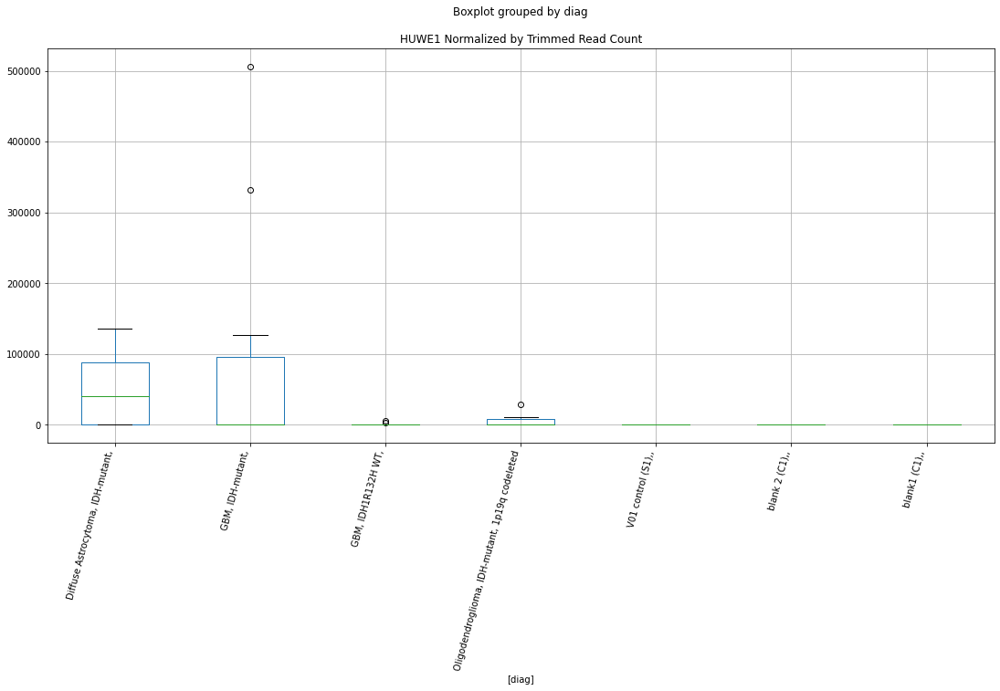

 p : 0.010800076402164812  ( t : 2.8426967954337967 ) :  Lexogen  :  cutadapt2  :  GALNT5
Control and blanks
82     0.0
346    0.0
Name: GALNT5, dtype: float64
214    0.0
Name: GALNT5, dtype: float64
478    949.84
Name: GALNT5, dtype: float64


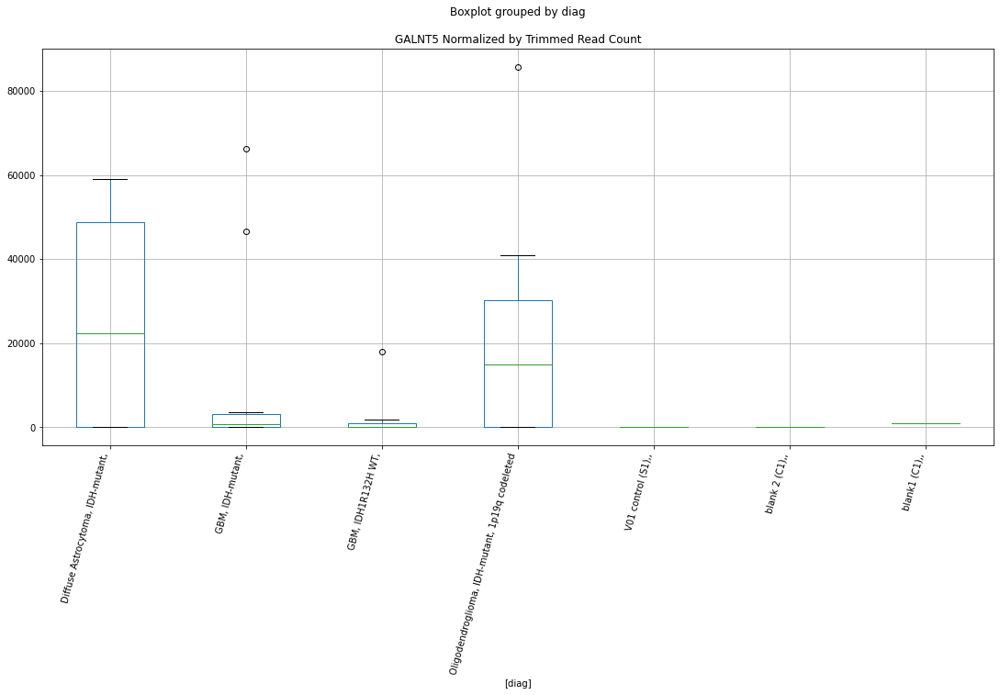

 p : 0.010856434379265112  ( t : 2.8402761296055568 ) :  Lexogen  :  bbduk2  :  GALNT5
Control and blanks
79     0.0
343    0.0
Name: GALNT5, dtype: float64
211    0.0
Name: GALNT5, dtype: float64
475    958.06
Name: GALNT5, dtype: float64


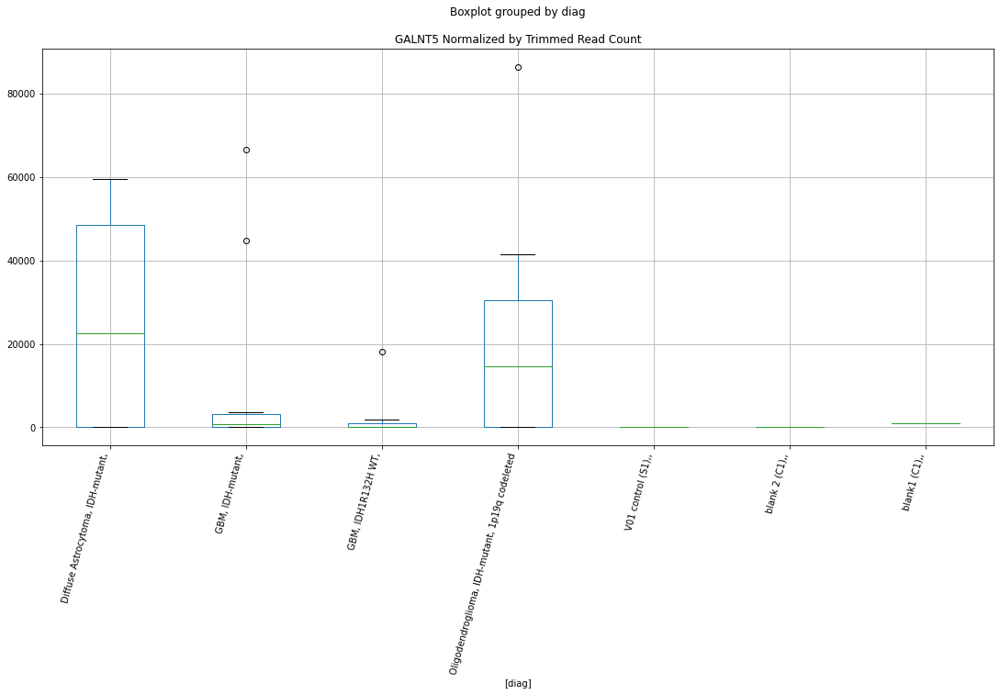

 p : 0.010876886696739068  ( t : 2.8394006611631424 ) :  Lexogen  :  bbduk2  :  HMGCS1
Control and blanks
79          0.00
343    181741.05
Name: HMGCS1, dtype: float64
211    0.0
Name: HMGCS1, dtype: float64
475    2155.64
Name: HMGCS1, dtype: float64


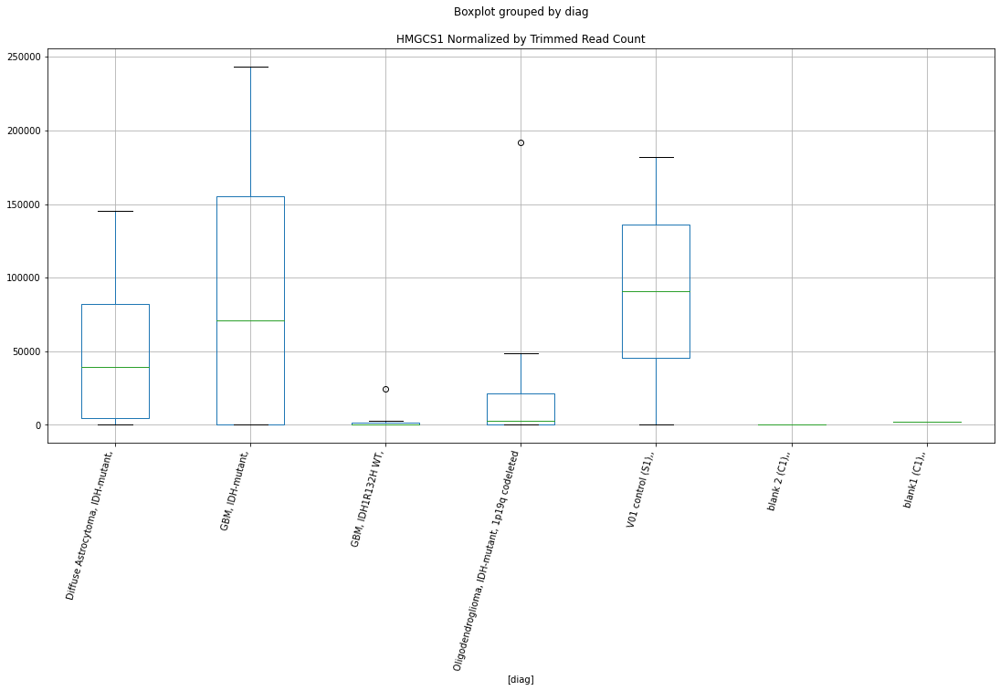

 p : 0.01090363652034559  ( t : 2.8382580150877876 ) :  D-plex  :  bbduk2  :  HSPH1
Control and blanks
73     104356.13
337     13352.36
Name: HSPH1, dtype: float64
205    46563.65
Name: HSPH1, dtype: float64
469    68617.17
Name: HSPH1, dtype: float64


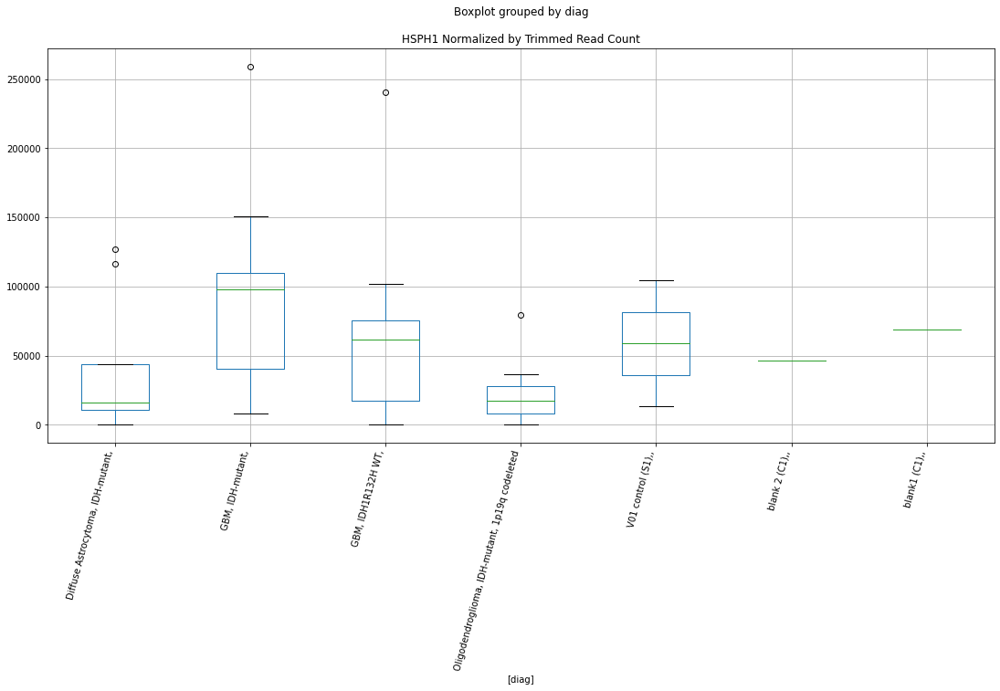

 p : 0.011865981036934767  ( t : 2.798847881913531 ) :  Lexogen  :  bbduk2  :  HOXB7
Control and blanks
79         0.00
343    10191.09
Name: HOXB7, dtype: float64
211    0.0
Name: HOXB7, dtype: float64
475    0.0
Name: HOXB7, dtype: float64


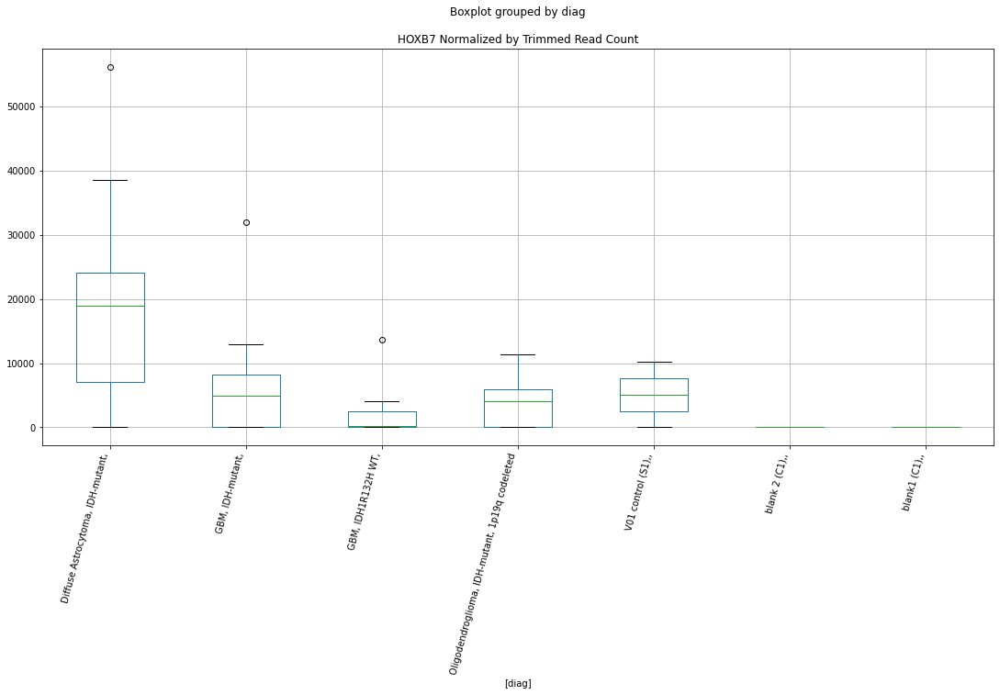

 p : 0.011975632466018574  ( t : 2.794554073668684 ) :  Lexogen  :  cutadapt2  :  HOXB7
Control and blanks
82         0.00
346    10100.86
Name: HOXB7, dtype: float64
214    0.0
Name: HOXB7, dtype: float64
478    0.0
Name: HOXB7, dtype: float64


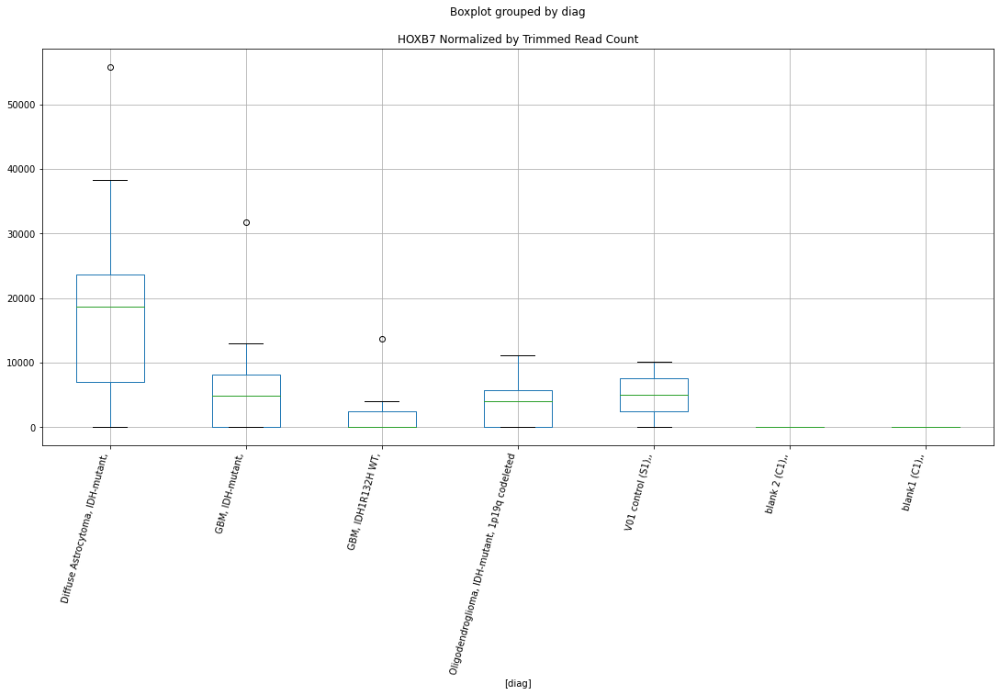

 p : 0.01200928337230486  ( t : 2.793243918863716 ) :  D-plex  :  bbduk2  :  KCNQ3
Control and blanks
73     773.01
337      0.00
Name: KCNQ3, dtype: float64
205    6805.46
Name: KCNQ3, dtype: float64
469    10647.49
Name: KCNQ3, dtype: float64


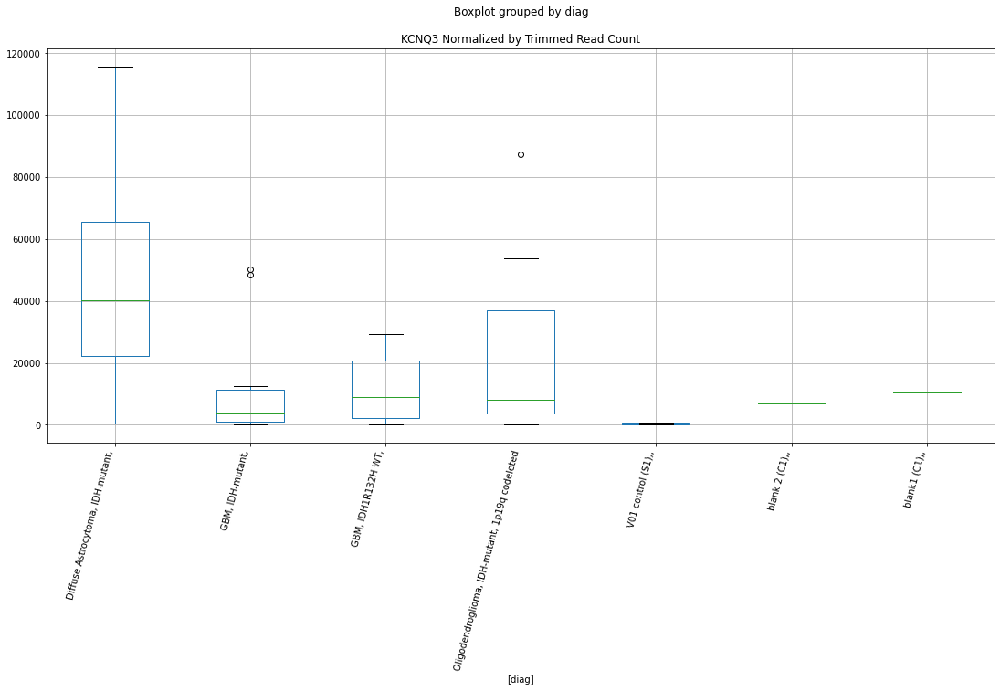

 p : 0.012018928776807561  ( t : 2.7928690375670406 ) :  Lexogen  :  cutadapt2  :  HMGCS1
Control and blanks
82          0.00
346    178238.04
Name: HMGCS1, dtype: float64
214    0.0
Name: HMGCS1, dtype: float64
478    0.0
Name: HMGCS1, dtype: float64


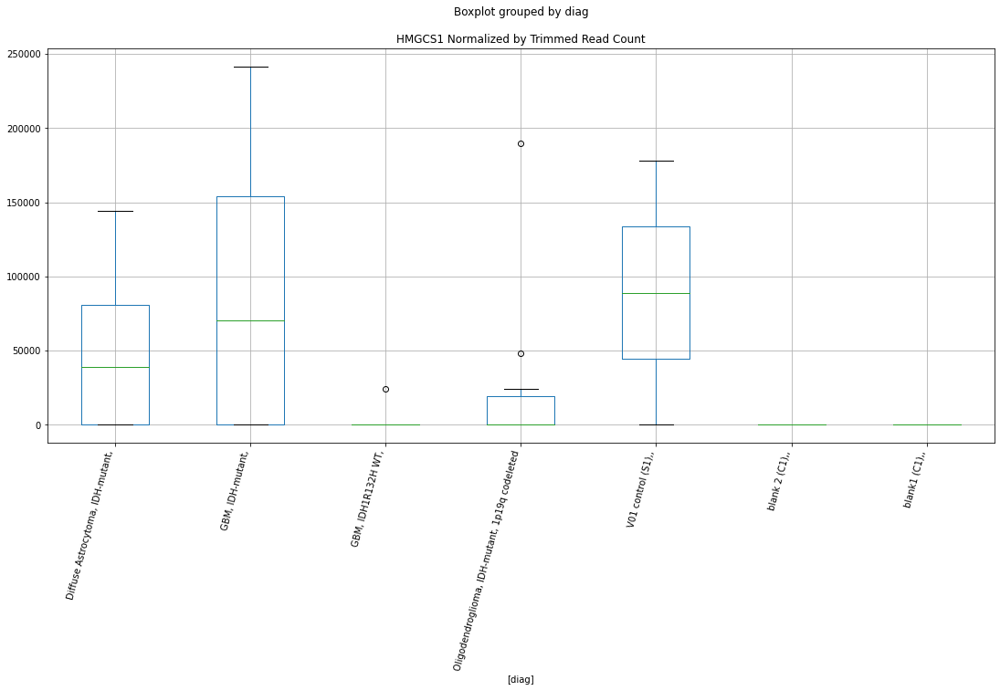

 p : 0.012179744141968171  ( t : 2.7866609381788883 ) :  Lexogen  :  cutadapt2  :  ELFN1
Control and blanks
82     0.0
346    0.0
Name: ELFN1, dtype: float64
214    0.0
Name: ELFN1, dtype: float64
478    0.0
Name: ELFN1, dtype: float64


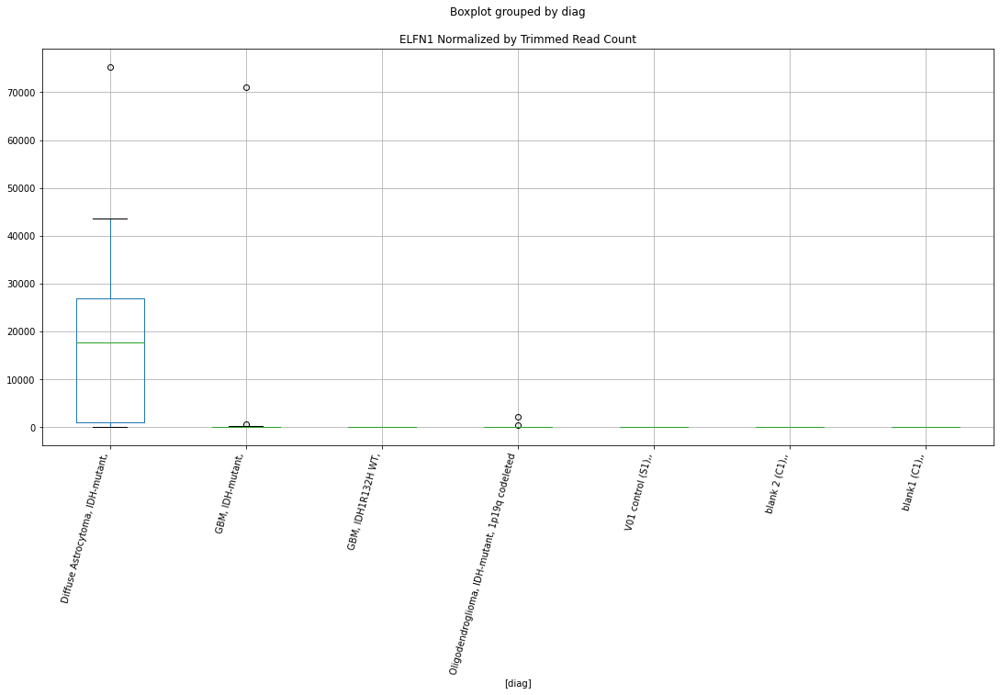

 p : 0.012331601178744437  ( t : 2.78087048874845 ) :  D-plex  :  bbduk2  :  DNAJC27
Control and blanks
73     0.0
337    0.0
Name: DNAJC27, dtype: float64
205    1790.91
Name: DNAJC27, dtype: float64
469    1774.58
Name: DNAJC27, dtype: float64


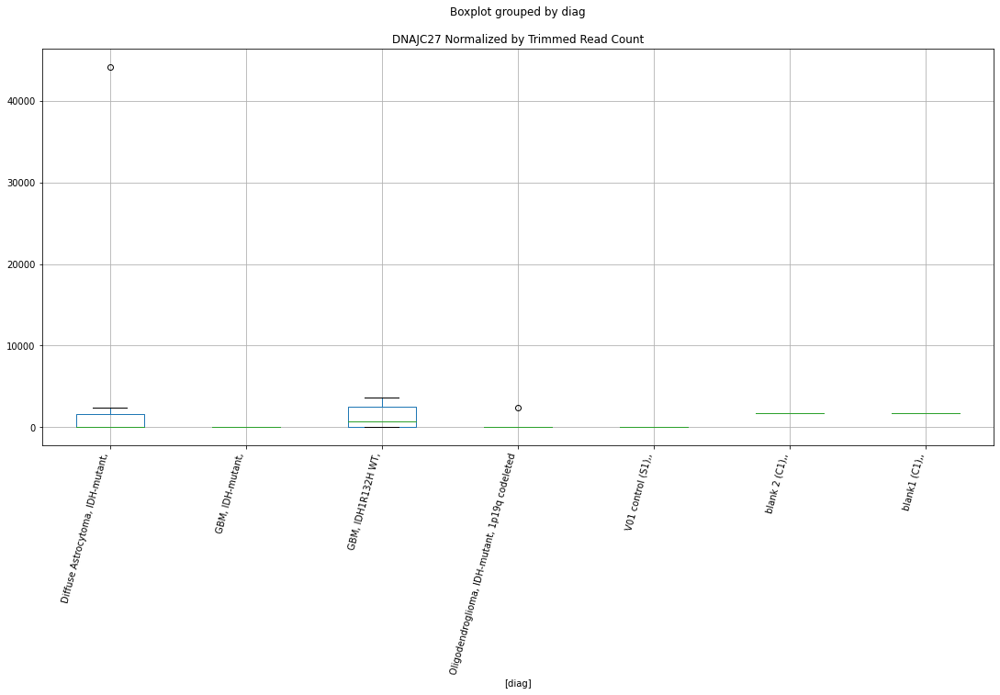

 p : 0.012416505018340606  ( t : 2.7776627862114904 ) :  Lexogen  :  bbduk2  :  HMGCS1
Control and blanks
79          0.00
343    181741.05
Name: HMGCS1, dtype: float64
211    0.0
Name: HMGCS1, dtype: float64
475    2155.64
Name: HMGCS1, dtype: float64


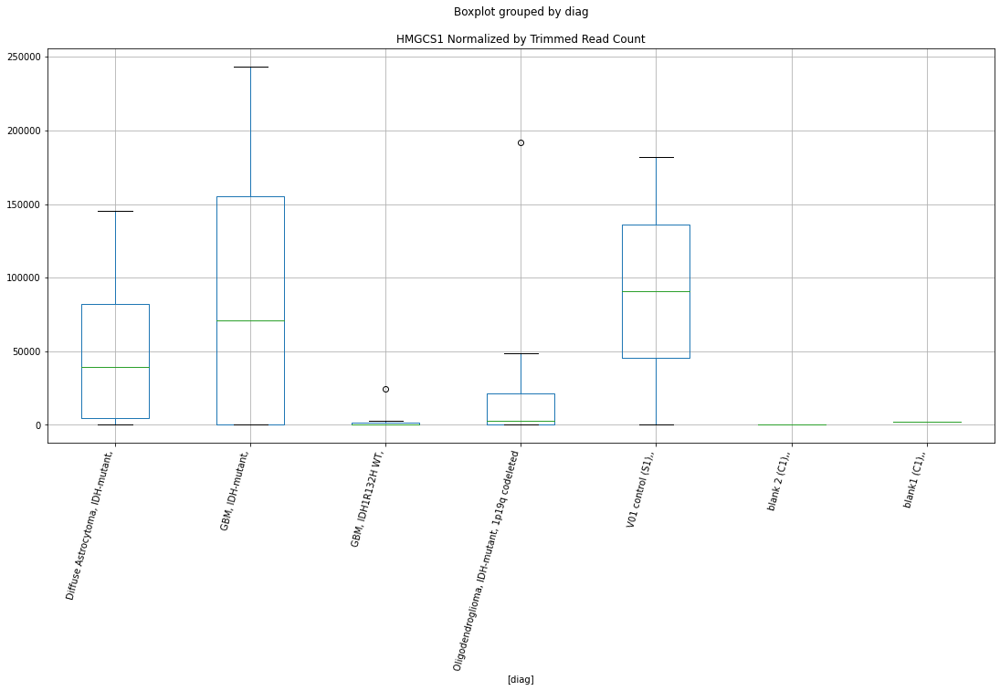

 p : 0.01259022331312112  ( t : 2.77116470424722 ) :  D-plex  :  bbduk2  :  IRAIN
Control and blanks
73     0.0
337    0.0
Name: IRAIN, dtype: float64
205    2328.18
Name: IRAIN, dtype: float64
469    4732.22
Name: IRAIN, dtype: float64


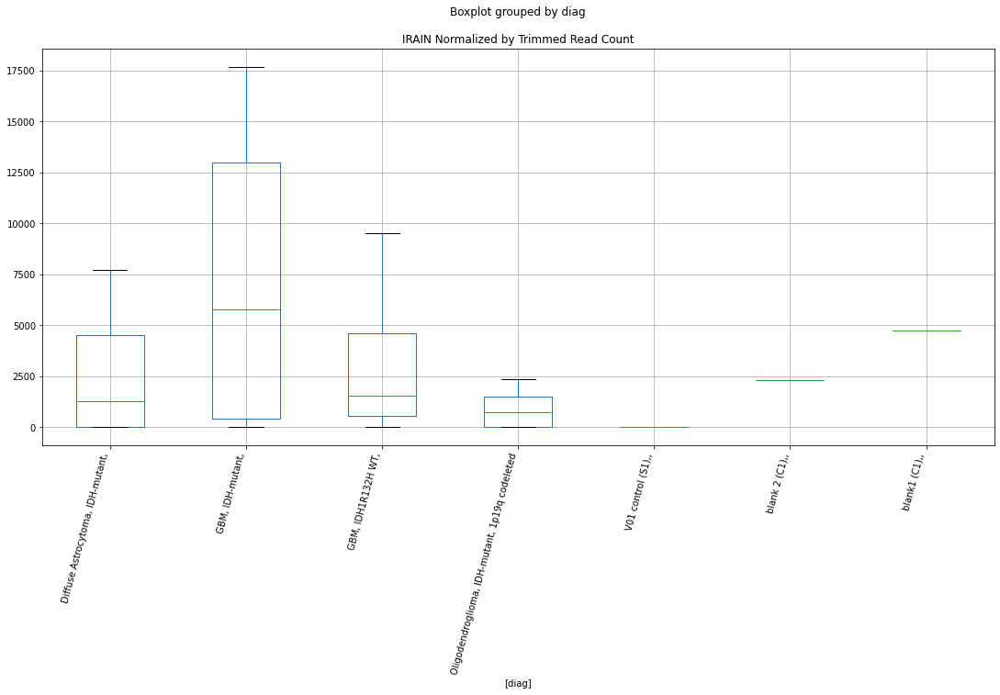

 p : 0.012869197073816284  ( t : 2.760907252701065 ) :  D-plex  :  bbduk2  :  DSG3
Control and blanks
73        0.00
337    1780.31
Name: DSG3, dtype: float64
205    0.0
Name: DSG3, dtype: float64
469    0.0
Name: DSG3, dtype: float64


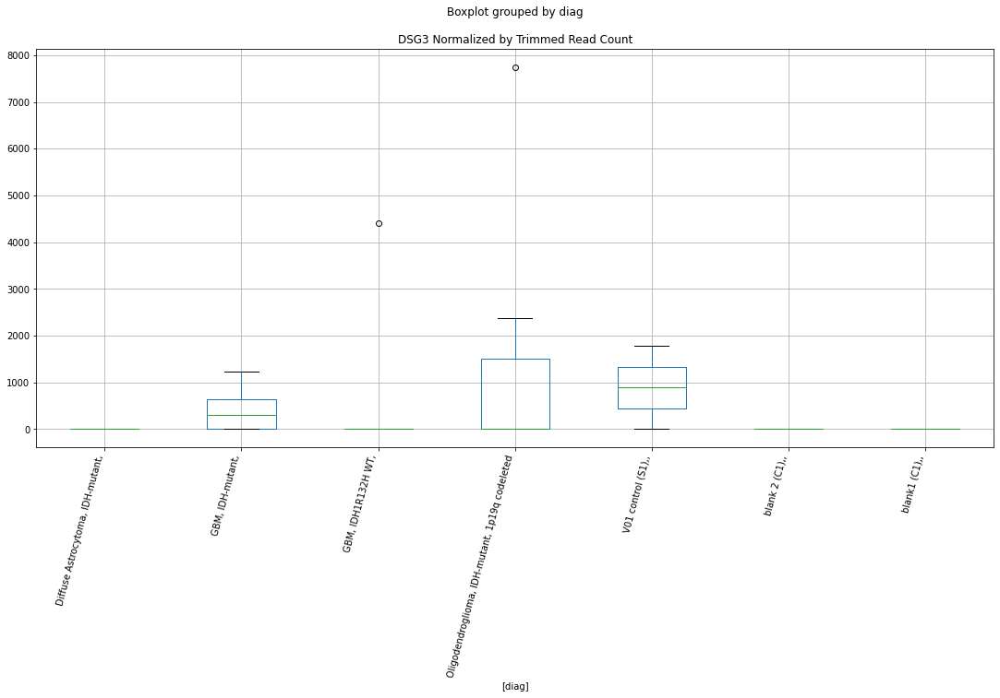

 p : 0.012872123568931746  ( t : 2.760800783944346 ) :  D-plex  :  cutadapt2  :  ELF2
Control and blanks
76     0.0
340    0.0
Name: ELF2, dtype: float64
208    21163.23
Name: ELF2, dtype: float64
472    23696.19
Name: ELF2, dtype: float64


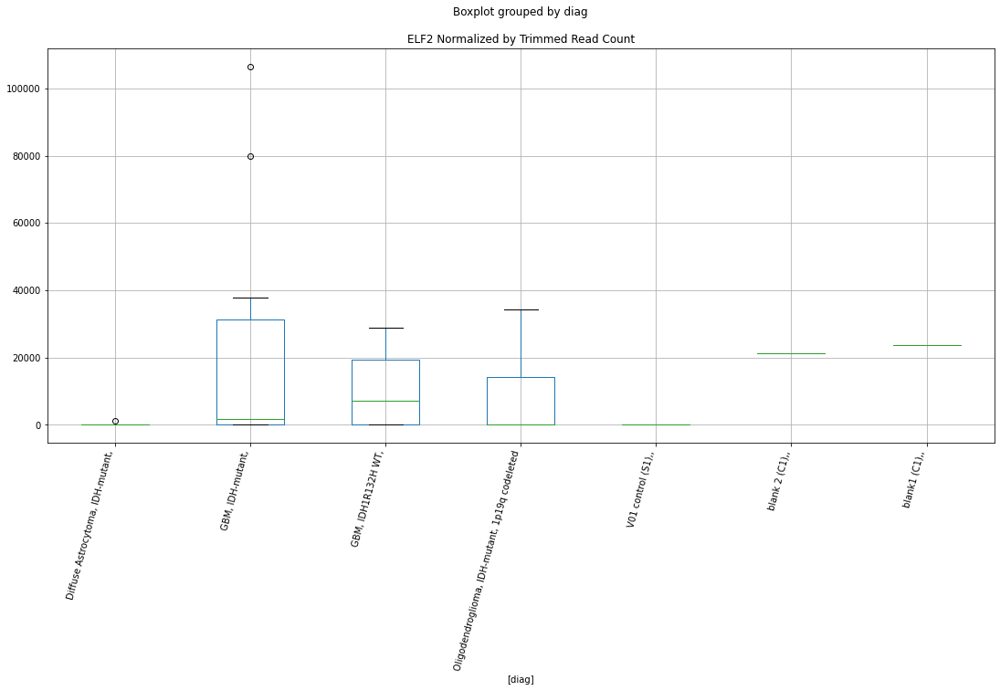

 p : 0.013027674640383772  ( t : 2.7551748157905016 ) :  Lexogen  :  bbduk2  :  GATA3
Control and blanks
79       0.00
343    849.26
Name: GATA3, dtype: float64
211    0.0
Name: GATA3, dtype: float64
475    958.06
Name: GATA3, dtype: float64


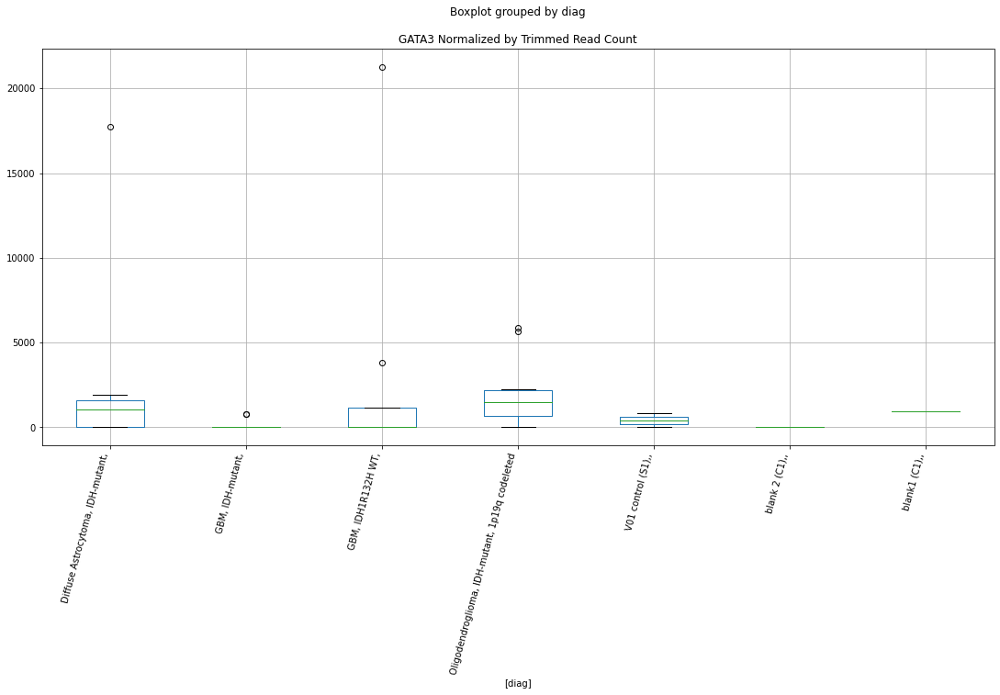

 p : 0.013114626807899031  ( t : 2.75205791947316 ) :  Lexogen  :  bbduk2  :  ELFN1
Control and blanks
79     0.0
343    0.0
Name: ELFN1, dtype: float64
211    0.0
Name: ELFN1, dtype: float64
475    0.0
Name: ELFN1, dtype: float64


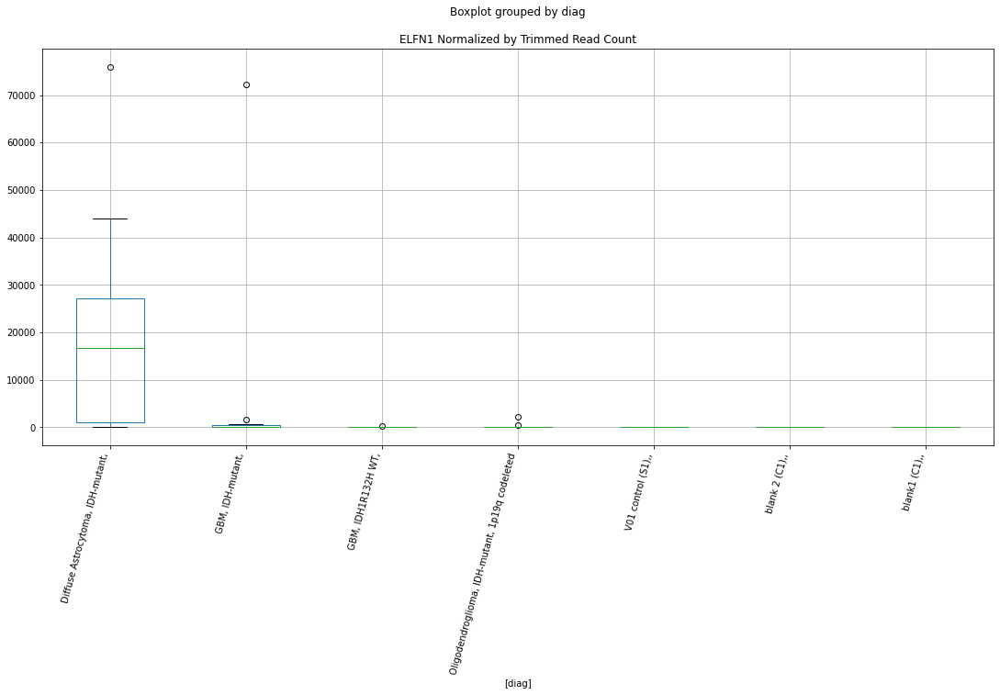

 p : 0.013165497141724916  ( t : 2.750243584482862 ) :  Lexogen  :  cutadapt2  :  ELFN1
Control and blanks
82     0.0
346    0.0
Name: ELFN1, dtype: float64
214    0.0
Name: ELFN1, dtype: float64
478    0.0
Name: ELFN1, dtype: float64


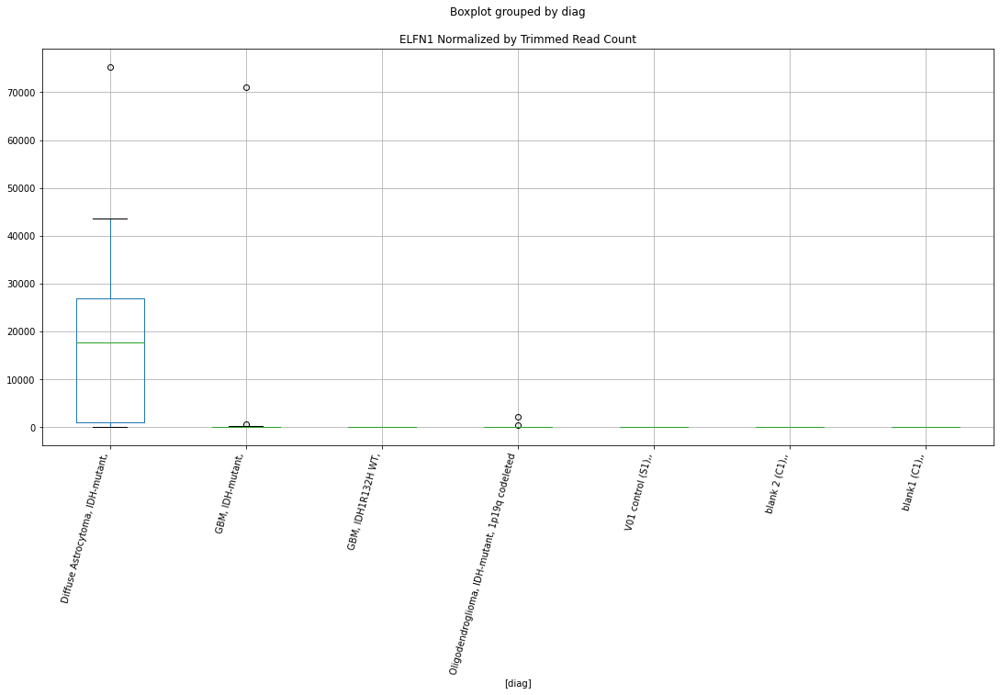

 p : 0.013261405703127196  ( t : 2.746841114883237 ) :  D-plex  :  bbduk2  :  FZD2
Control and blanks
73     0.0
337    0.0
Name: FZD2, dtype: float64
205    179.09
Name: FZD2, dtype: float64
469    0.0
Name: FZD2, dtype: float64


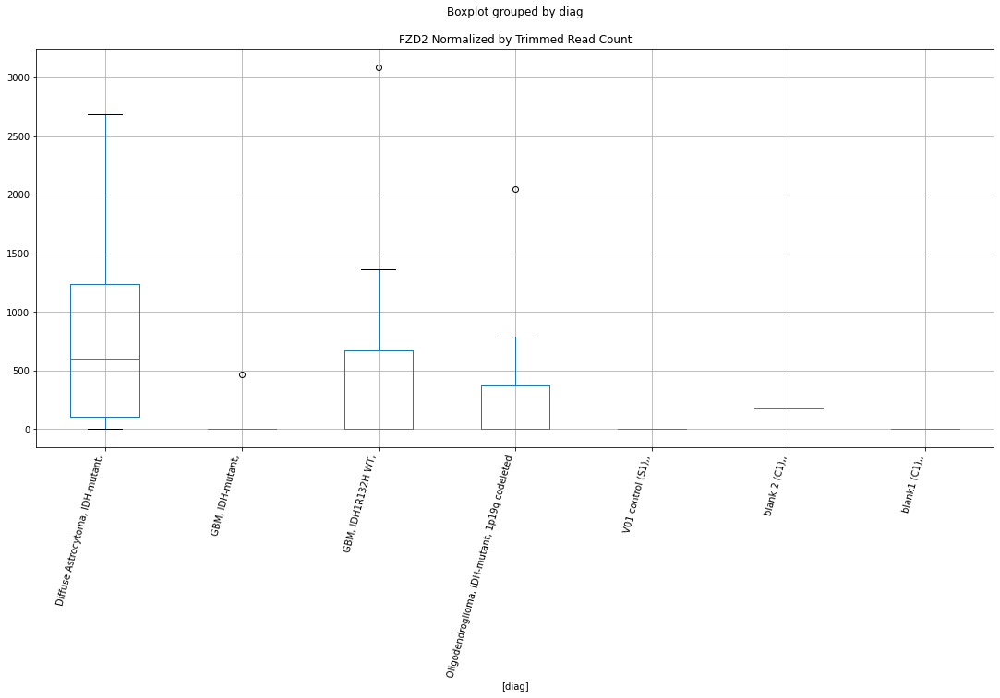

 p : 0.013612116491775761  ( t : 2.734596728638753 ) :  D-plex  :  cutadapt2  :  HDLBP
Control and blanks
76     0.0
340    0.0
Name: HDLBP, dtype: float64
208    15696.06
Name: HDLBP, dtype: float64
472    8669.34
Name: HDLBP, dtype: float64


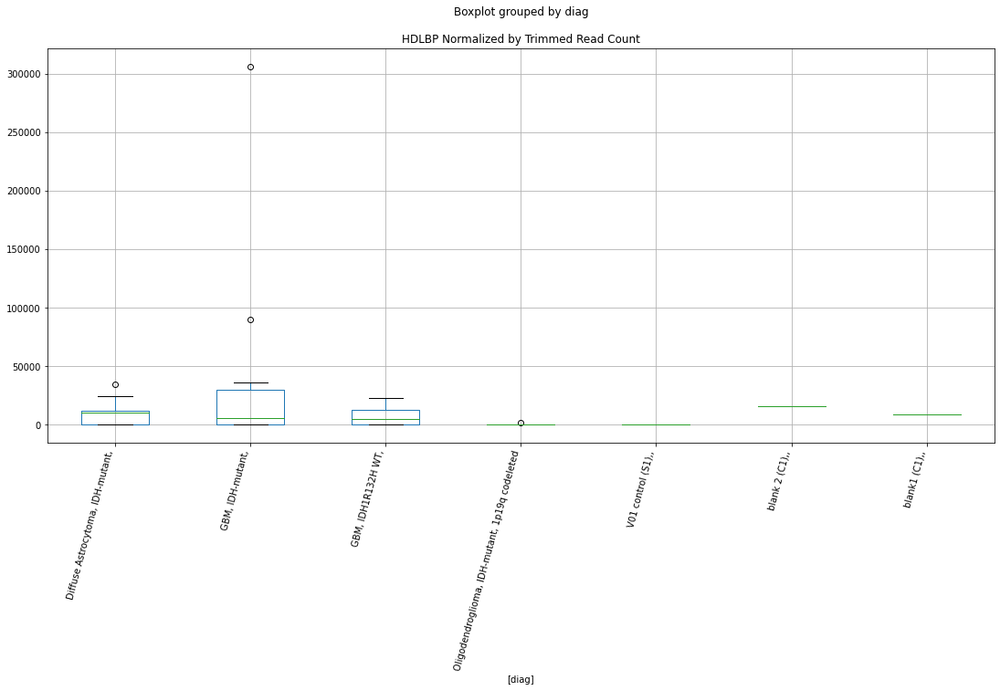

 p : 0.013901901174768107  ( t : 2.7247051932344446 ) :  D-plex  :  cutadapt2  :  FAM155A
Control and blanks
76     0.0
340    0.0
Name: FAM155A, dtype: float64
208    881.8
Name: FAM155A, dtype: float64
472    4623.65
Name: FAM155A, dtype: float64


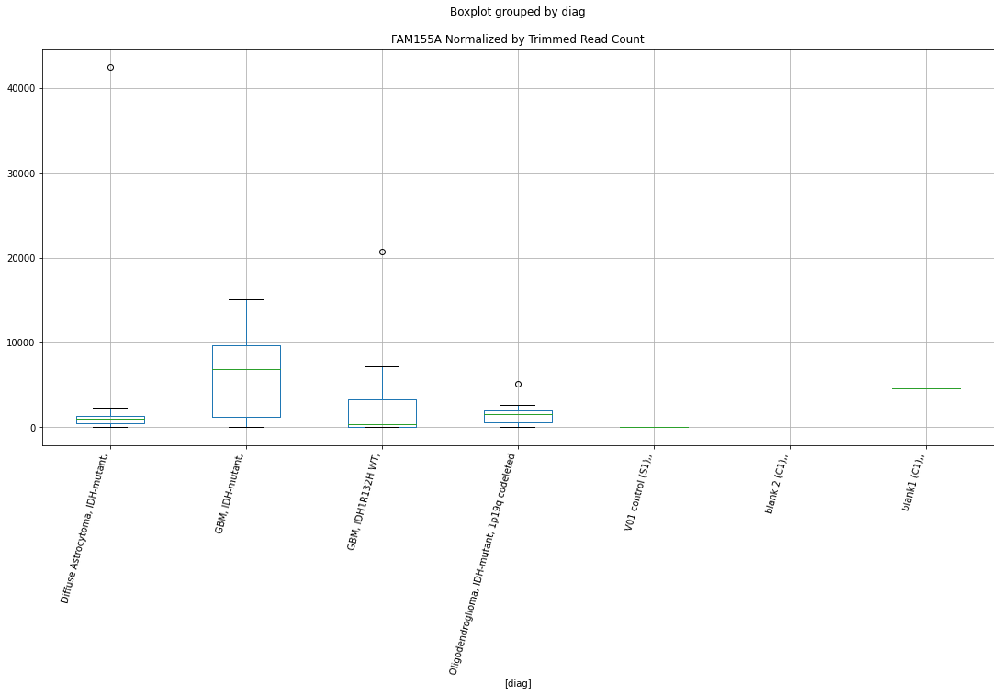

 p : 0.014049244819289361  ( t : 2.719751154665808 ) :  Lexogen  :  bbduk2  :  ELFN1
Control and blanks
79     0.0
343    0.0
Name: ELFN1, dtype: float64
211    0.0
Name: ELFN1, dtype: float64
475    0.0
Name: ELFN1, dtype: float64


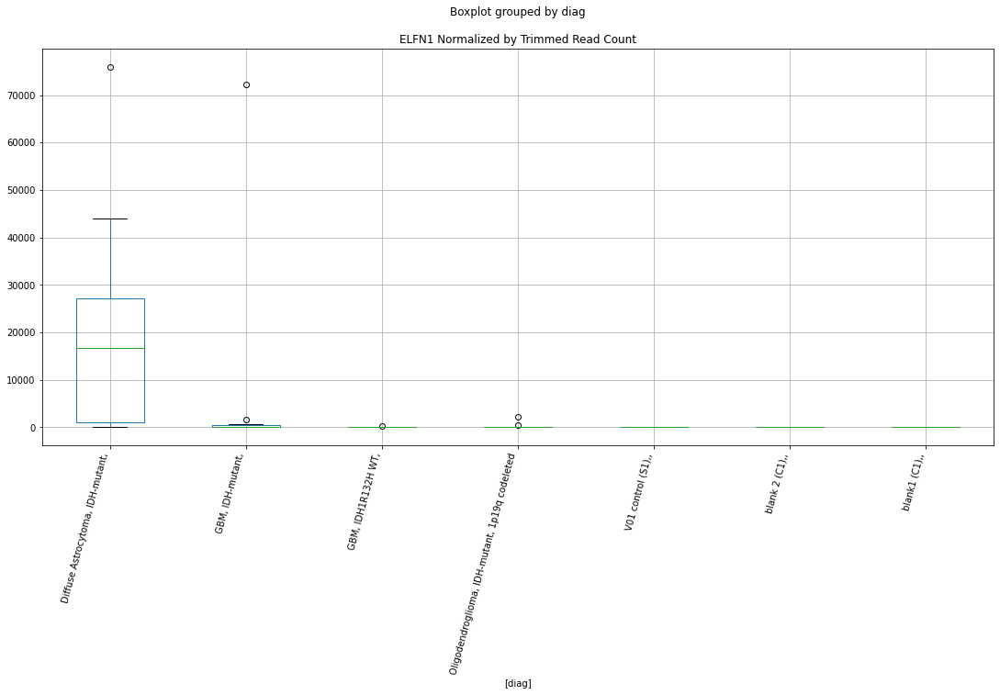

 p : 0.014497224005969693  ( t : 2.7049885036105494 ) :  D-plex  :  bbduk2  :  FBXO10
Control and blanks
73     0.0
337    0.0
Name: FBXO10, dtype: float64
205    3581.82
Name: FBXO10, dtype: float64
469    0.0
Name: FBXO10, dtype: float64


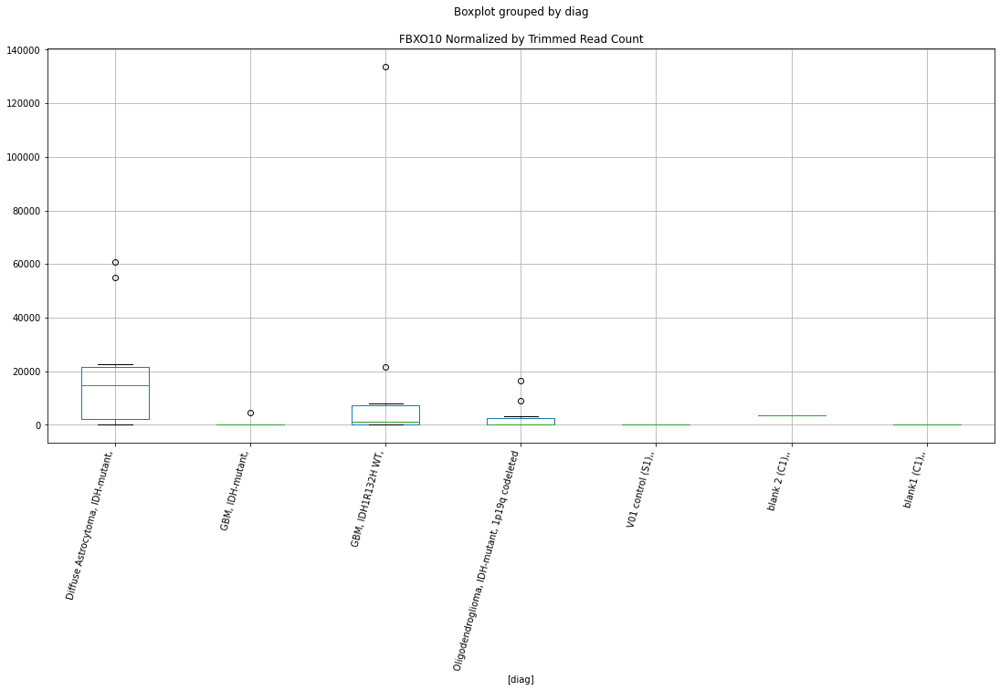

 p : 0.014538505492745444  ( t : 2.703650136030127 ) :  Lexogen  :  cutadapt2  :  HMGCS1
Control and blanks
82          0.00
346    178238.04
Name: HMGCS1, dtype: float64
214    0.0
Name: HMGCS1, dtype: float64
478    0.0
Name: HMGCS1, dtype: float64


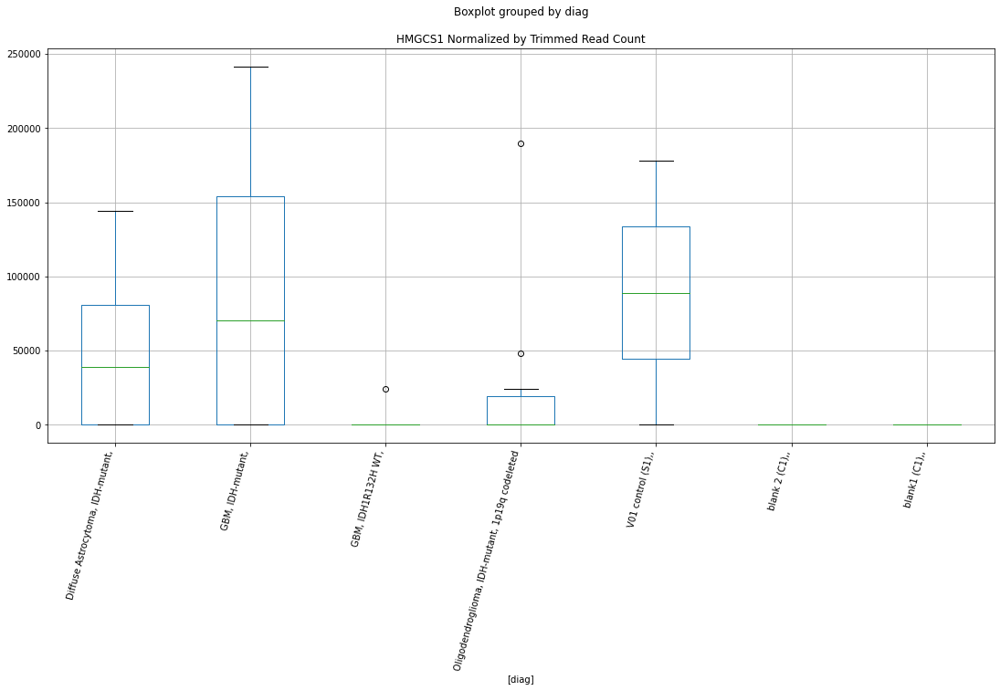

 p : 0.014559397299413872  ( t : 2.7029741956644893 ) :  D-plex  :  cutadapt2  :  FLJ32255
Control and blanks
76     0.0
340    0.0
Name: FLJ32255, dtype: float64
208    1763.6
Name: FLJ32255, dtype: float64
472    3467.74
Name: FLJ32255, dtype: float64


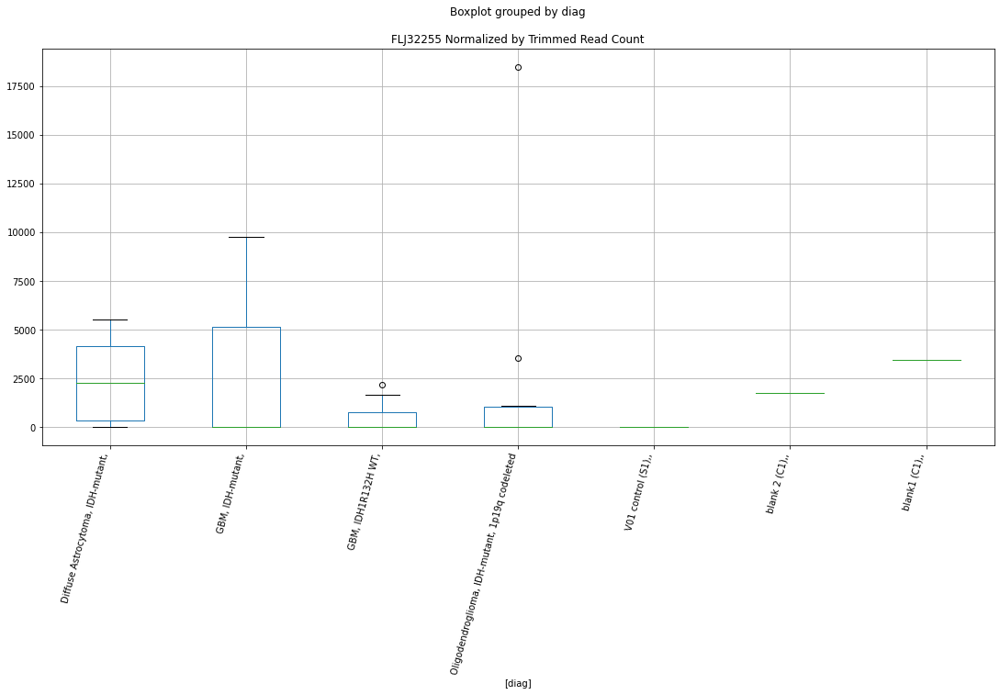

 p : 0.014616498432115732  ( t : 2.7011314431442215 ) :  D-plex  :  cutadapt2  :  HIF1AN
Control and blanks
76     0.0
340    0.0
Name: HIF1AN, dtype: float64
208    7054.41
Name: HIF1AN, dtype: float64
472    6357.51
Name: HIF1AN, dtype: float64


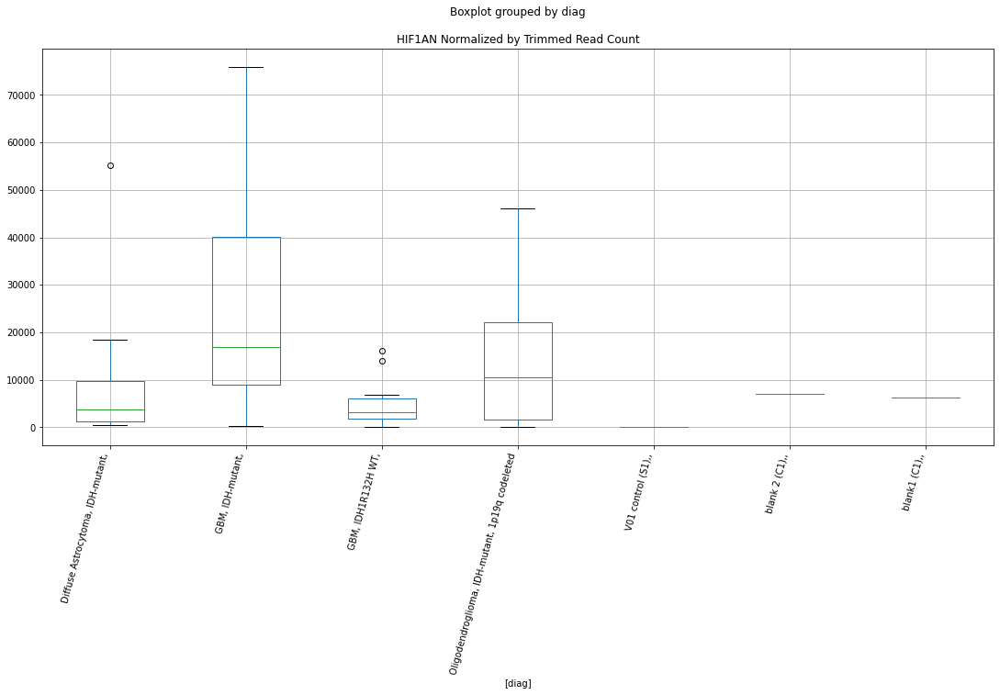

 p : 0.014628088394792035  ( t : 2.7007582546441653 ) :  D-plex  :  bbduk2  :  FLJ32255
Control and blanks
73     0.0
337    0.0
Name: FLJ32255, dtype: float64
205    1790.91
Name: FLJ32255, dtype: float64
469    3549.16
Name: FLJ32255, dtype: float64


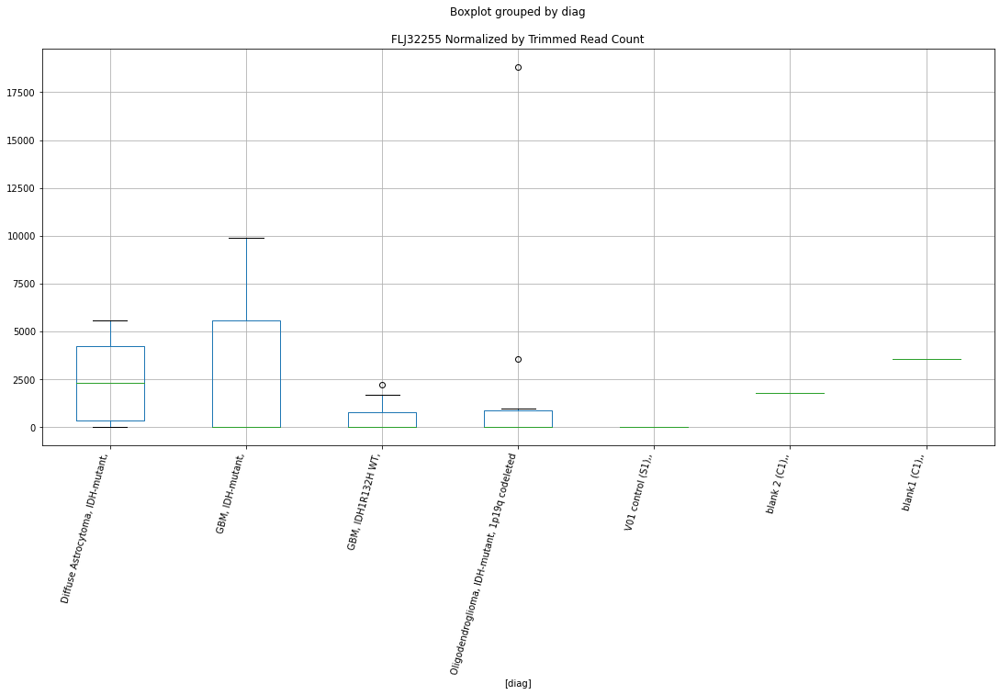

 p : 0.014867920875569995  ( t : 2.693098541875067 ) :  Lexogen  :  bbduk2  :  HUWE1
Control and blanks
79        0.00
343    4246.29
Name: HUWE1, dtype: float64
211    4919.51
Name: HUWE1, dtype: float64
475    4790.31
Name: HUWE1, dtype: float64


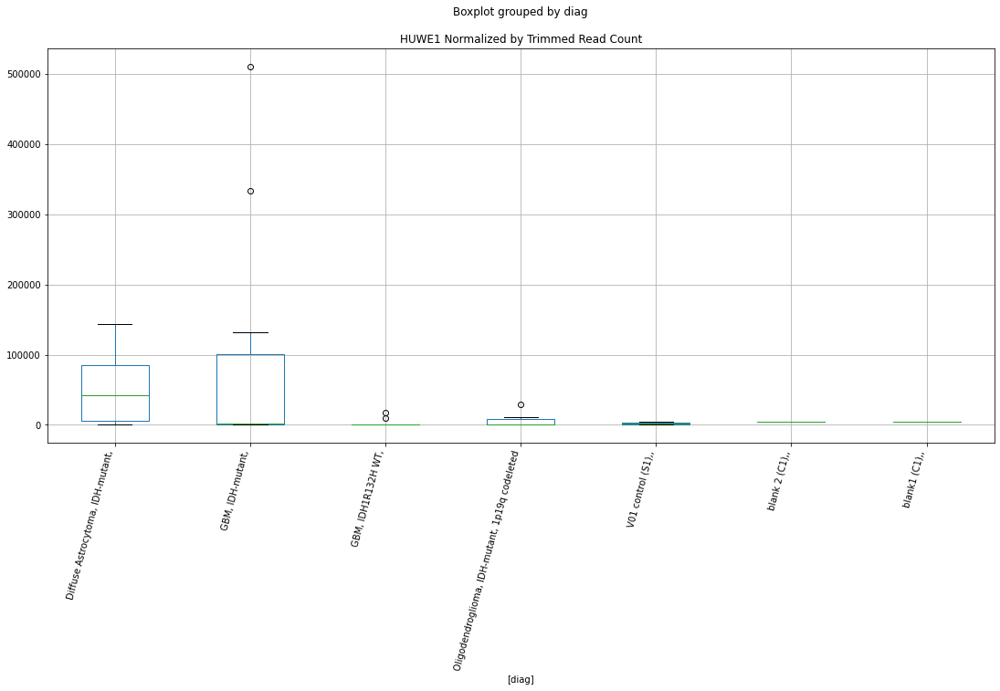

 p : 0.015069924174857722  ( t : 2.686737987098016 ) :  Lexogen  :  bbduk2  :  ILRUN
Control and blanks
79       0.00
343    849.26
Name: ILRUN, dtype: float64
211    1093.23
Name: ILRUN, dtype: float64
475    0.0
Name: ILRUN, dtype: float64


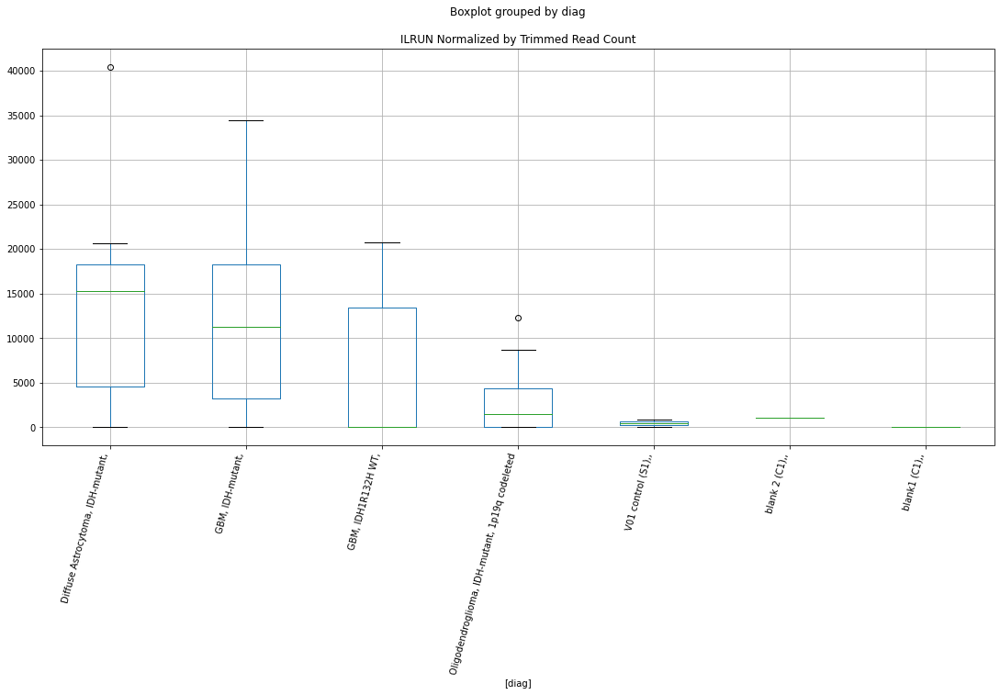

 p : 0.015172925073495732  ( t : 2.6835260174180564 ) :  Lexogen  :  cutadapt2  :  FAM199X
Control and blanks
82     0.0
346    0.0
Name: FAM199X, dtype: float64
214    0.0
Name: FAM199X, dtype: float64
478    0.0
Name: FAM199X, dtype: float64


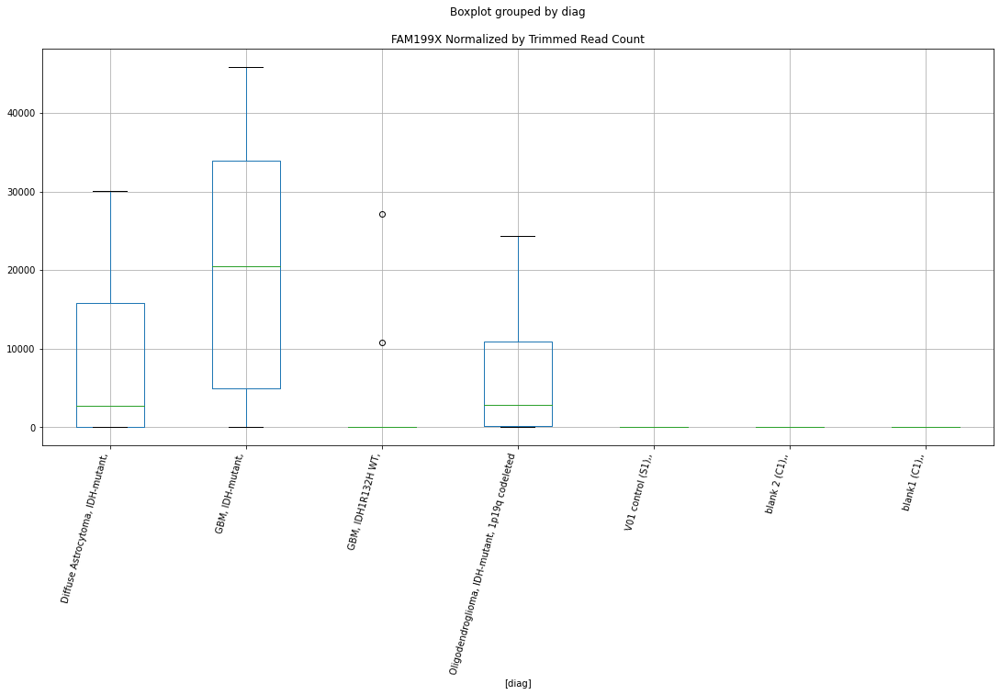

 p : 0.015173547623886865  ( t : 2.6835066672009456 ) :  Lexogen  :  bbduk2  :  FAM199X
Control and blanks
79     0.0
343    0.0
Name: FAM199X, dtype: float64
211    0.0
Name: FAM199X, dtype: float64
475    0.0
Name: FAM199X, dtype: float64


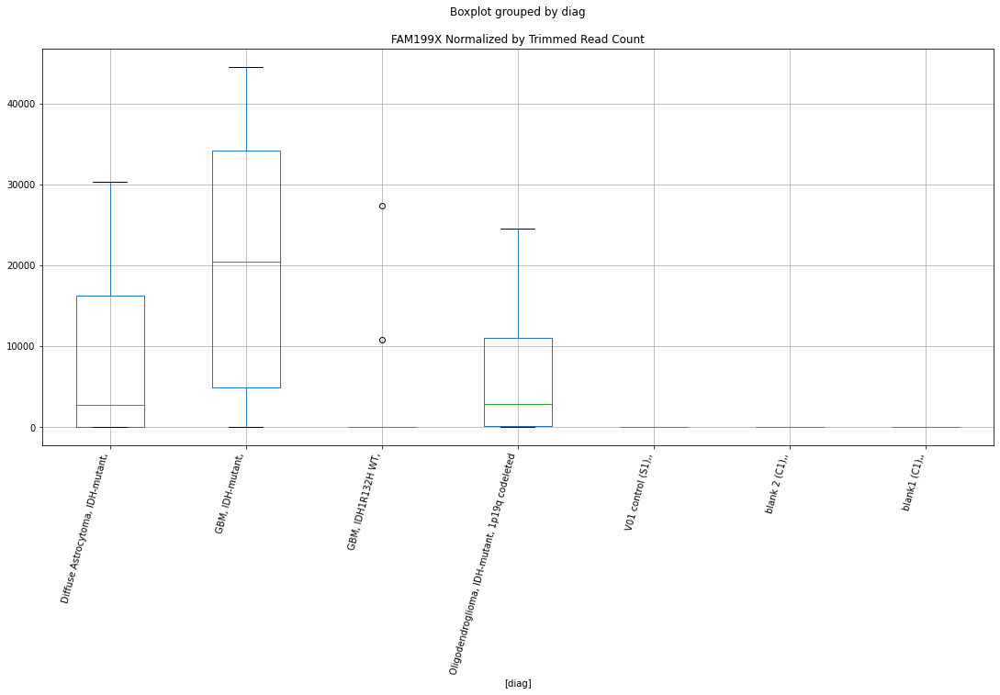

 p : 0.015187734228135142  ( t : 2.6830659219485913 ) :  D-plex  :  bbduk2  :  HDLBP
Control and blanks
73     0.0
337    0.0
Name: HDLBP, dtype: float64
205    21849.1
Name: HDLBP, dtype: float64
469    12422.07
Name: HDLBP, dtype: float64


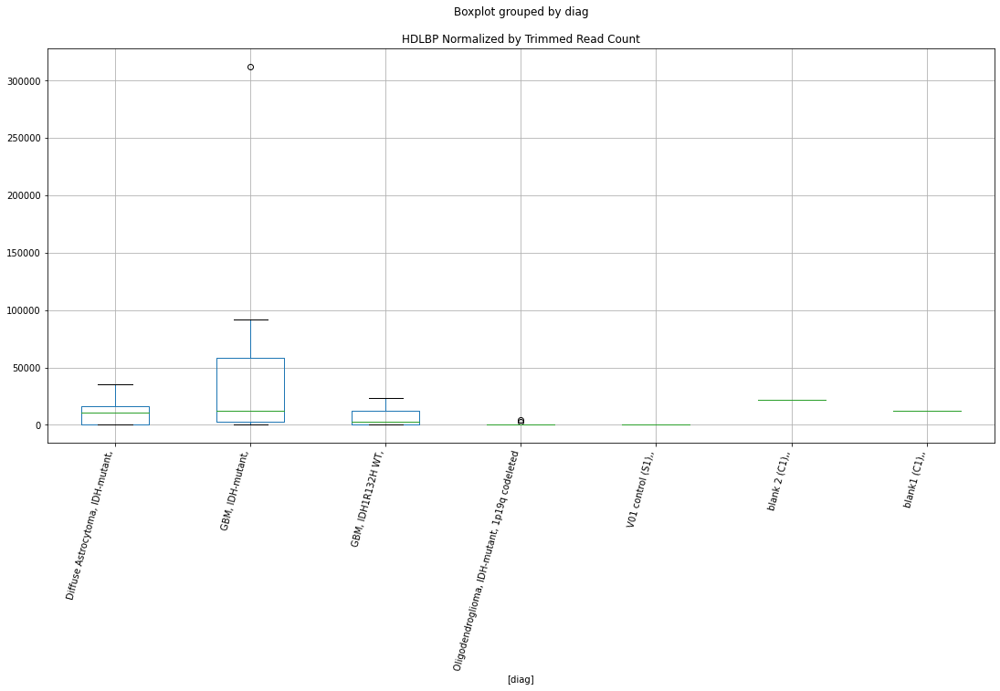

 p : 0.015189239731141325  ( t : 2.683019172480846 ) :  D-plex  :  cutadapt2  :  EVC
Control and blanks
76     0.0
340    0.0
Name: EVC, dtype: float64
208    15166.98
Name: EVC, dtype: float64
472    13292.98
Name: EVC, dtype: float64


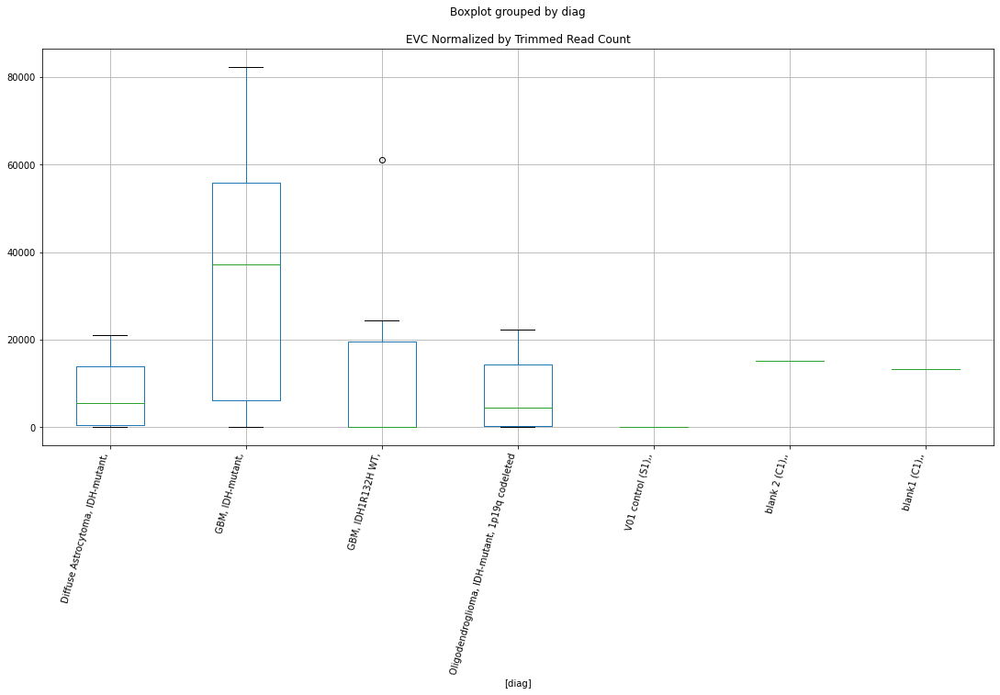

 p : 0.015231159766125199  ( t : 2.6817192274161052 ) :  D-plex  :  cutadapt2  :  IFNK
Control and blanks
76     3788.07
340       0.00
Name: IFNK, dtype: float64
208    881.8
Name: IFNK, dtype: float64
472    1155.91
Name: IFNK, dtype: float64


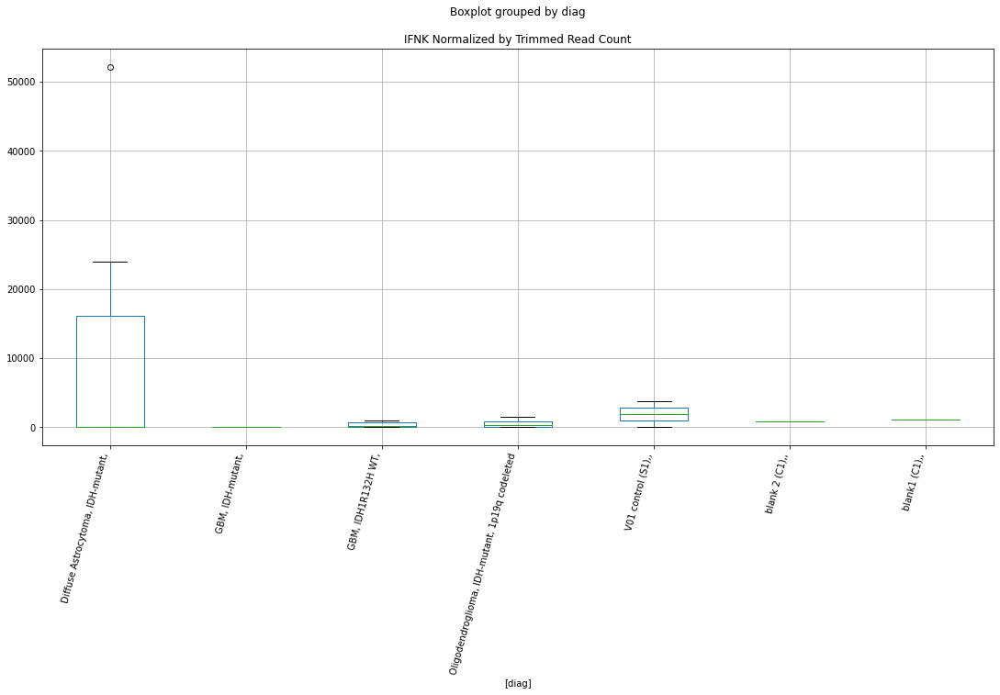

 p : 0.015295047788854384  ( t : 2.679744603018842 ) :  D-plex  :  bbduk2  :  IFNK
Control and blanks
73     3865.04
337       0.00
Name: IFNK, dtype: float64
205    895.45
Name: IFNK, dtype: float64
469    1183.05
Name: IFNK, dtype: float64


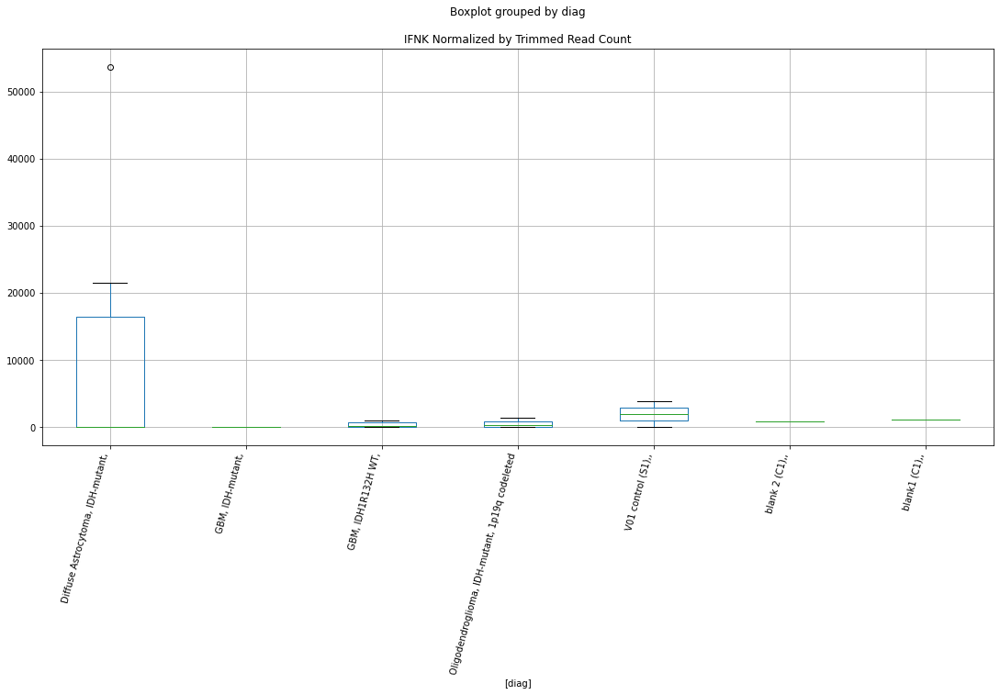

 p : 0.015891774601918963  ( t : 2.6616719313599626 ) :  D-plex  :  cutadapt2  :  IFNK
Control and blanks
76     3788.07
340       0.00
Name: IFNK, dtype: float64
208    881.8
Name: IFNK, dtype: float64
472    1155.91
Name: IFNK, dtype: float64


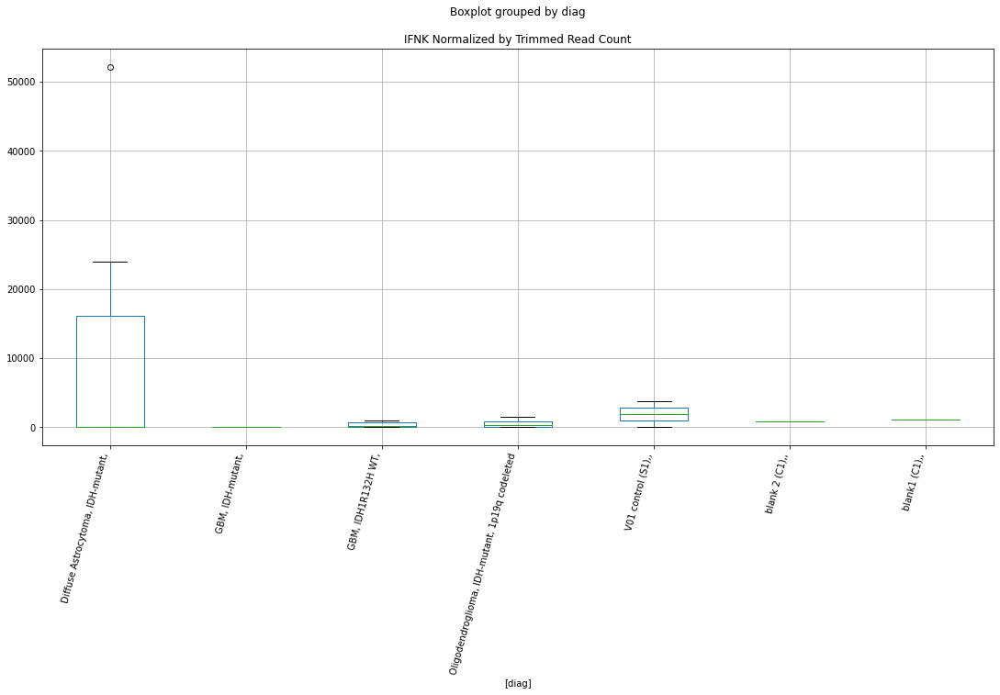

 p : 0.0158967232851022  ( t : 2.661524775862187 ) :  D-plex  :  cutadapt2  :  IRAIN
Control and blanks
76     0.0
340    0.0
Name: IRAIN, dtype: float64
208    2116.32
Name: IRAIN, dtype: float64
472    4623.65
Name: IRAIN, dtype: float64


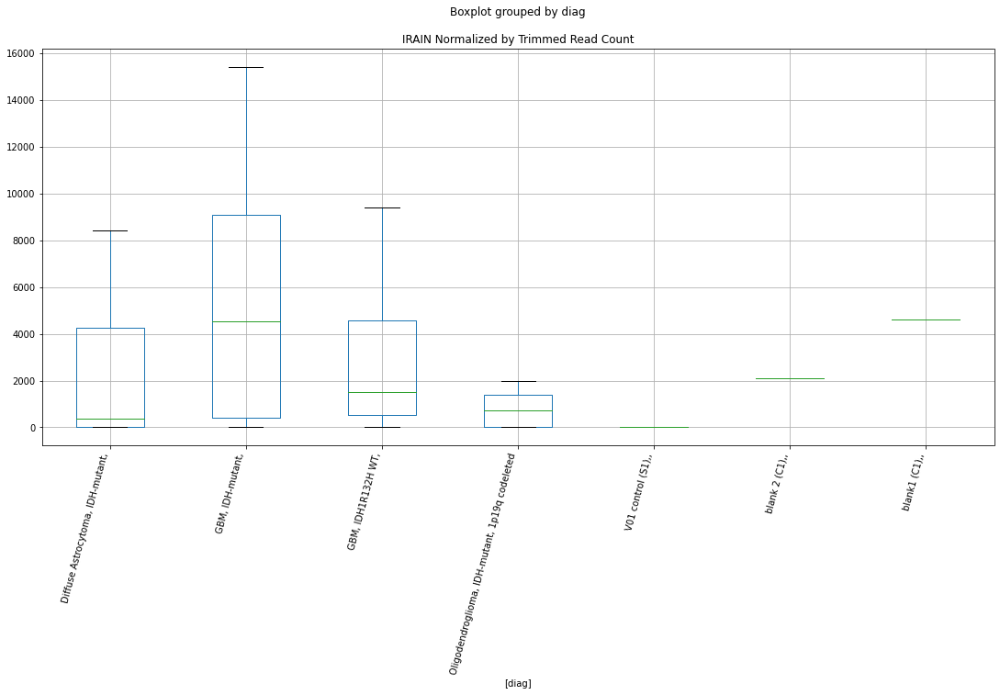

 p : 0.015978048999338596  ( t : 2.6591126827102114 ) :  D-plex  :  bbduk2  :  IFNK
Control and blanks
73     3865.04
337       0.00
Name: IFNK, dtype: float64
205    895.45
Name: IFNK, dtype: float64
469    1183.05
Name: IFNK, dtype: float64


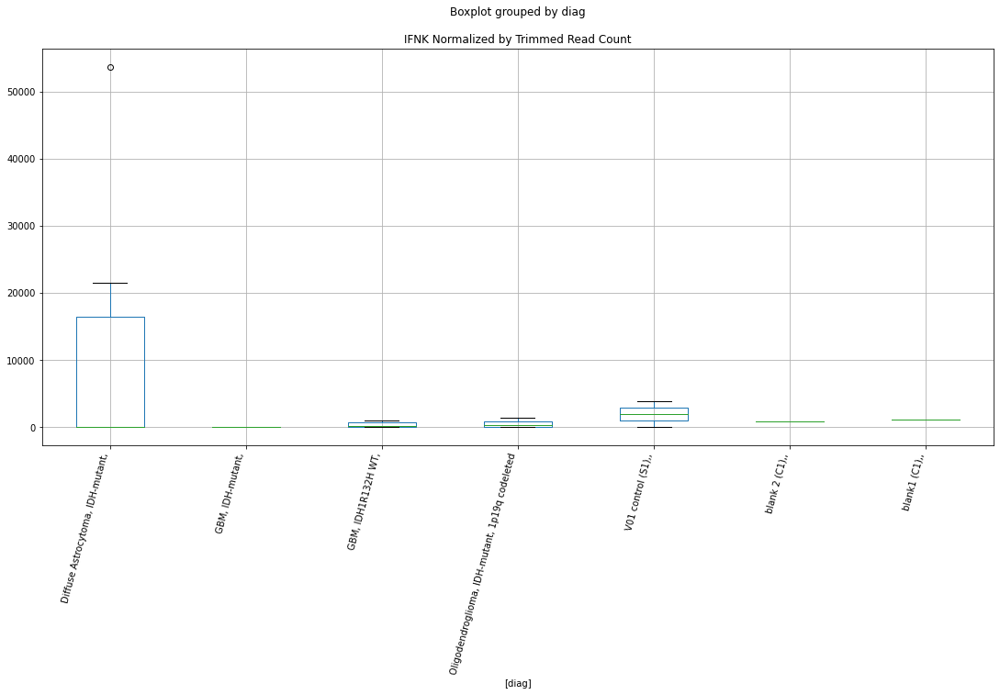

 p : 0.01610741199336254  ( t : 2.655299814556327 ) :  D-plex  :  bbduk2  :  GLYAT
Control and blanks
73     2319.03
337       0.00
Name: GLYAT, dtype: float64
205    3760.91
Name: GLYAT, dtype: float64
469    285116.17
Name: GLYAT, dtype: float64


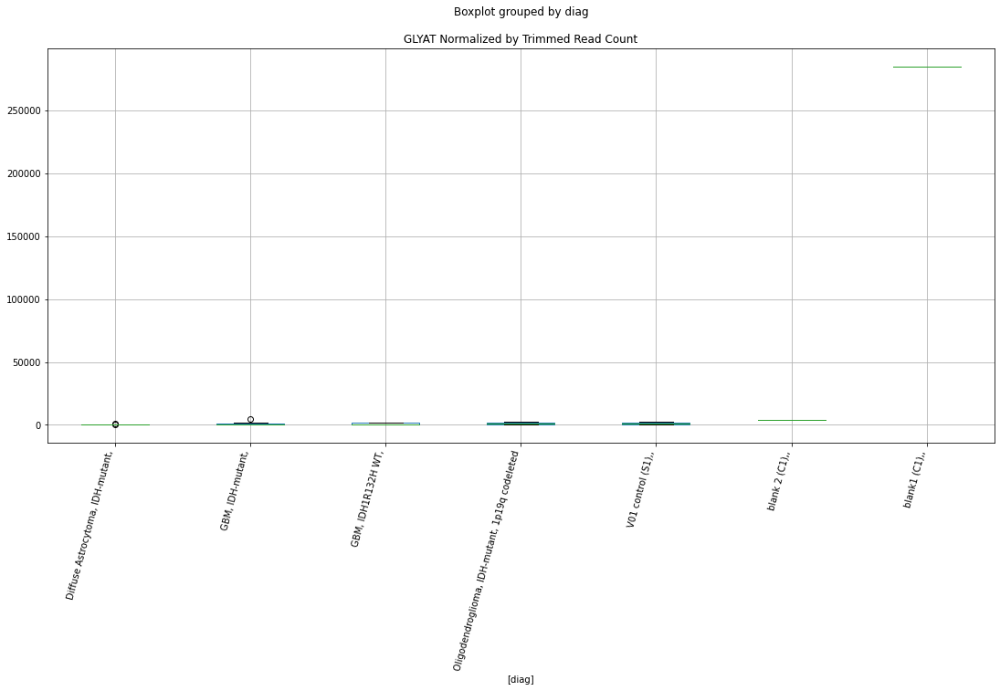

 p : 0.016279651446663112  ( t : 2.6502682164675075 ) :  D-plex  :  cutadapt2  :  GLYAT
Control and blanks
76     2272.84
340       0.00
Name: GLYAT, dtype: float64
208    3703.56
Name: GLYAT, dtype: float64
472    278574.71
Name: GLYAT, dtype: float64


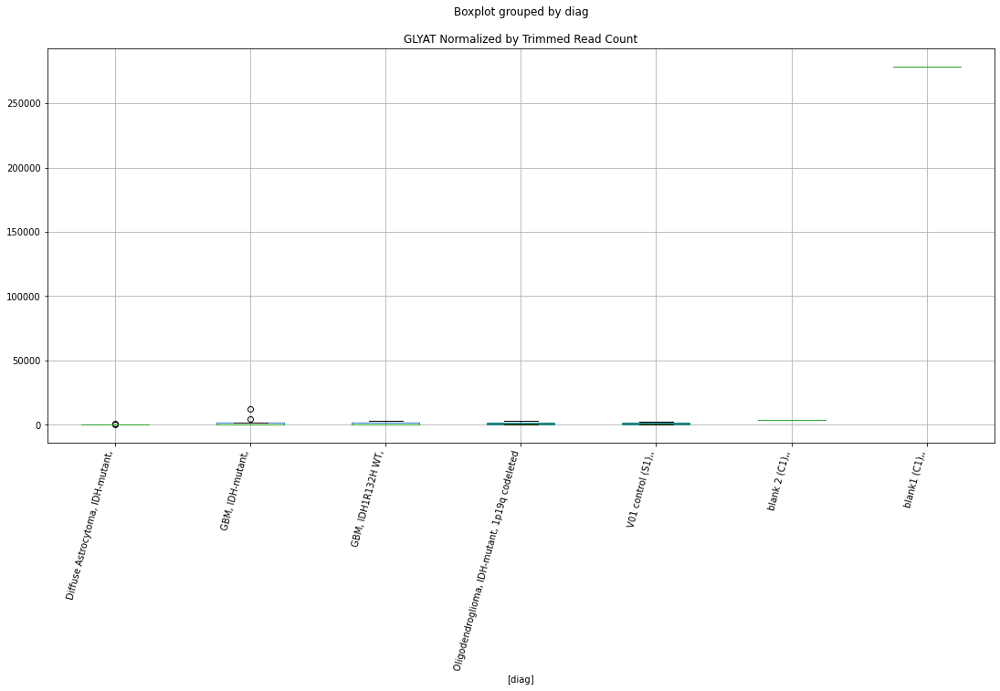

 p : 0.016333205748956532  ( t : 2.648714073065545 ) :  D-plex  :  bbduk2  :  IRX1
Control and blanks
73         0.0
337    24924.4
Name: IRX1, dtype: float64
205    358.18
Name: IRX1, dtype: float64
469    1183.05
Name: IRX1, dtype: float64


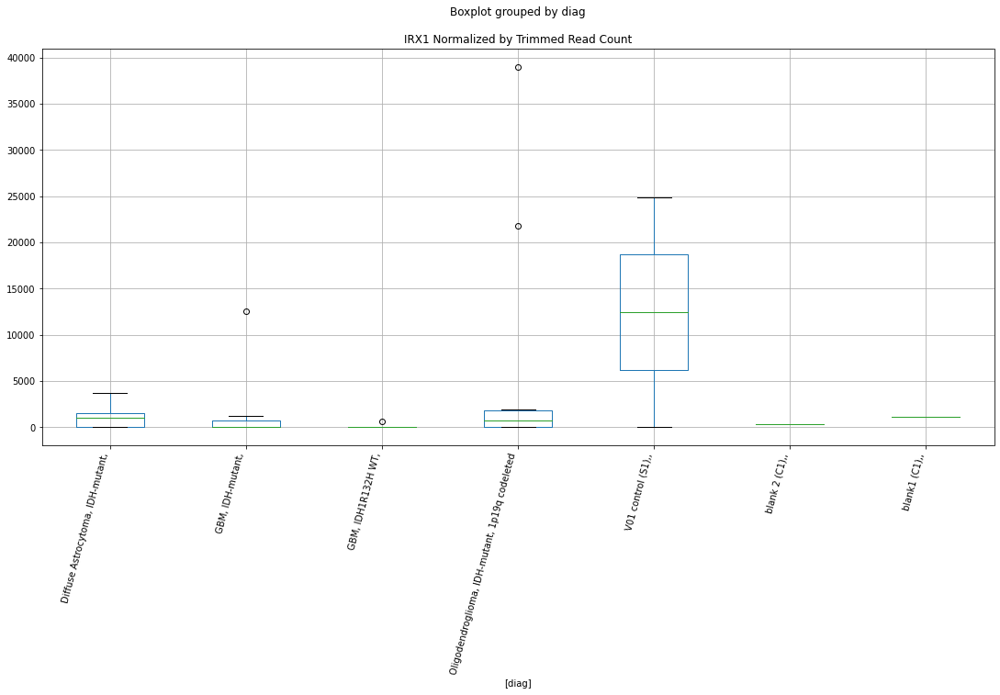

 p : 0.01636284273780808  ( t : 2.6478560930922597 ) :  D-plex  :  cutadapt2  :  HCLS1
Control and blanks
76     0.0
340    0.0
Name: HCLS1, dtype: float64
208    1058.16
Name: HCLS1, dtype: float64
472    228870.51
Name: HCLS1, dtype: float64


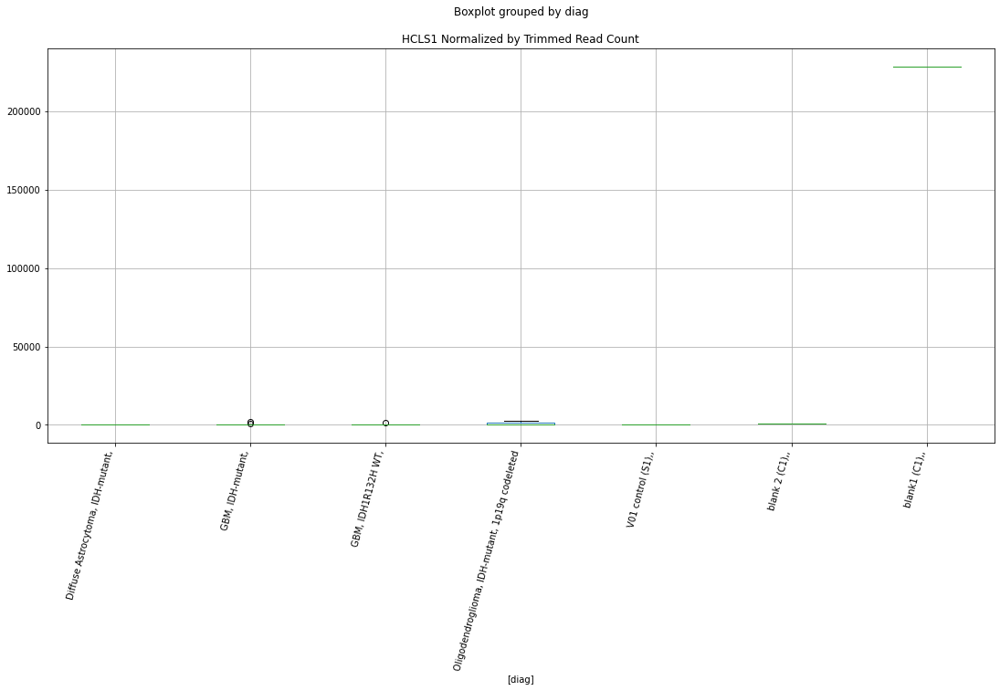

 p : 0.01636365026213924  ( t : 2.6478327362691747 ) :  D-plex  :  cutadapt2  :  DPP4
Control and blanks
76      13637.06
340    160293.25
Name: DPP4, dtype: float64
208    31744.84
Name: DPP4, dtype: float64
472    13870.94
Name: DPP4, dtype: float64


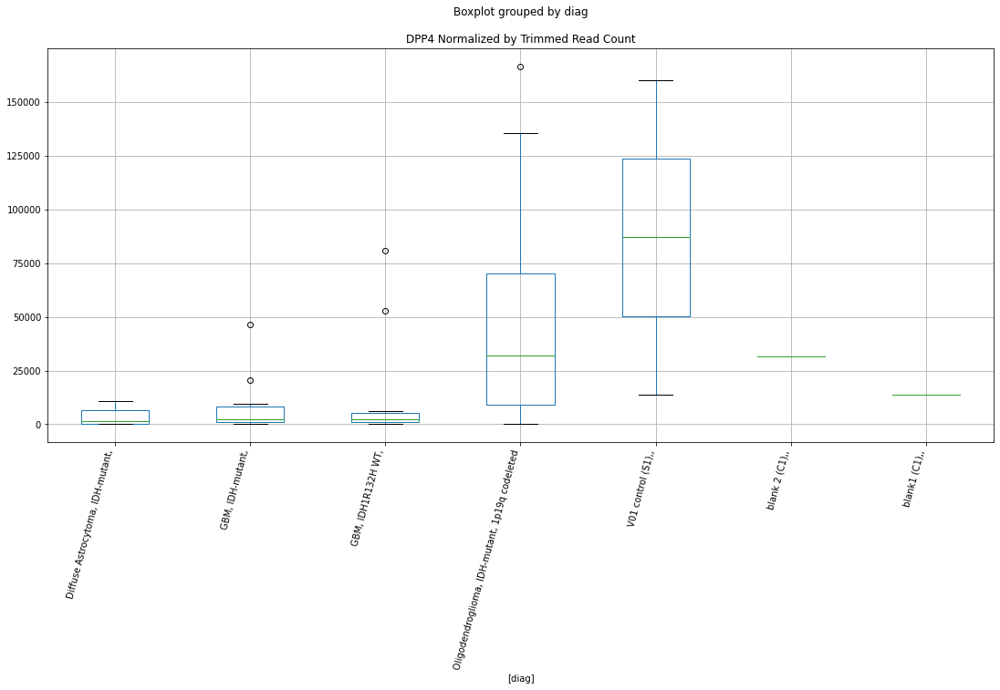

 p : 0.016383891520029222  ( t : 2.647247636574359 ) :  D-plex  :  bbduk2  :  ENOPH1
Control and blanks
73     0.0
337    0.0
Name: ENOPH1, dtype: float64
205    1611.82
Name: ENOPH1, dtype: float64
469    3549.16
Name: ENOPH1, dtype: float64


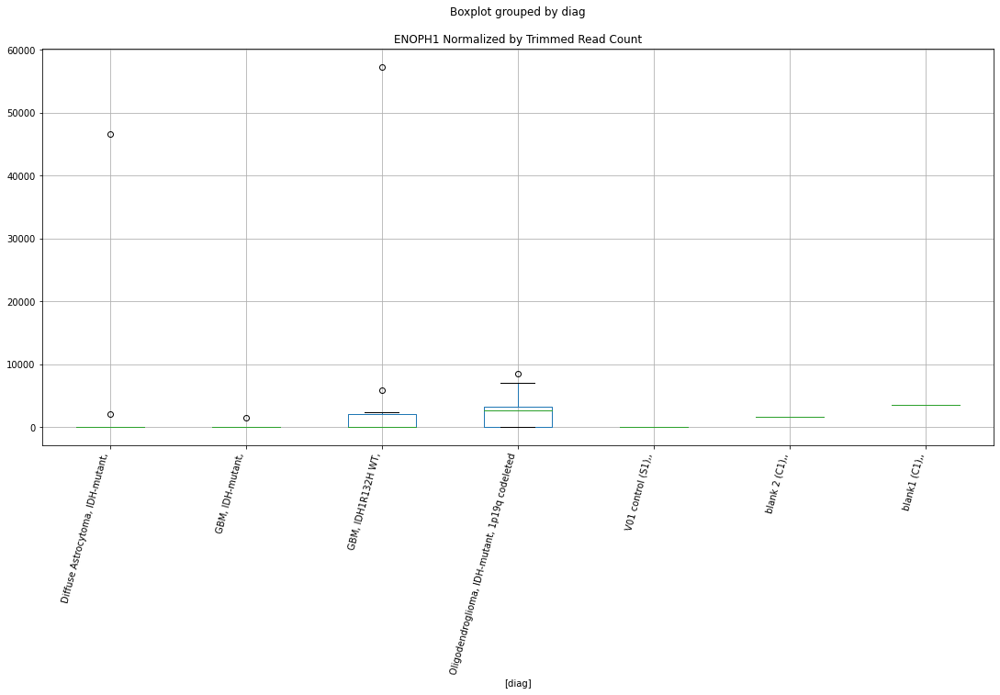

 p : 0.01649049130107207  ( t : 2.644177541221895 ) :  D-plex  :  bbduk2  :  DPP4
Control and blanks
73      13914.15
337    160228.31
Name: DPP4, dtype: float64
205    31878.19
Name: DPP4, dtype: float64
469    14196.66
Name: DPP4, dtype: float64


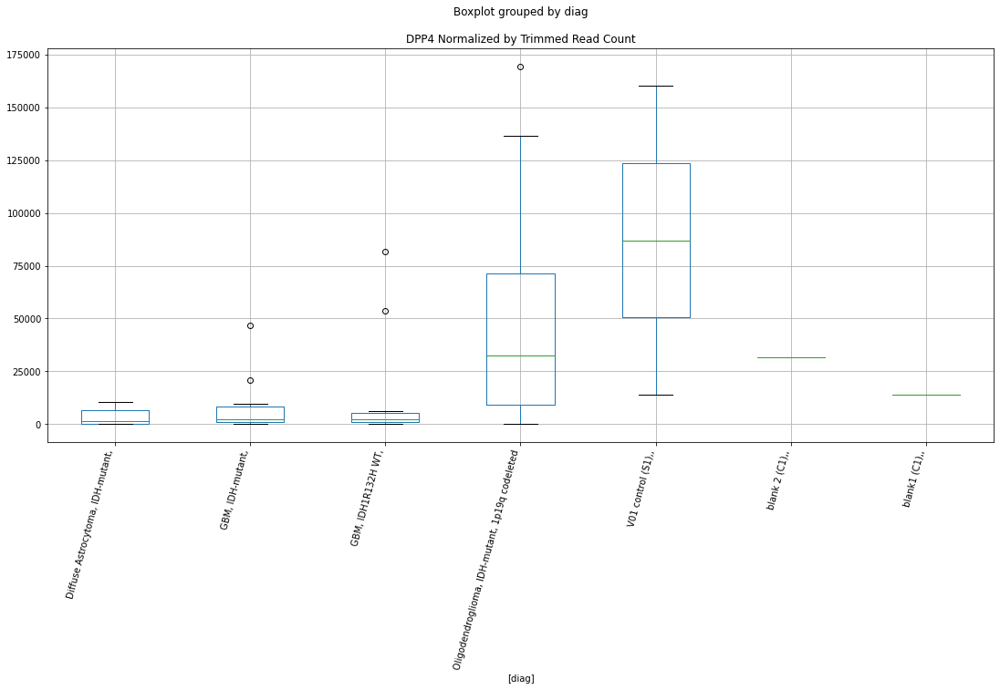

 p : 0.016607101038302464  ( t : 2.640840715359003 ) :  D-plex  :  bbduk2  :  HIF1AN
Control and blanks
73     0.0
337    0.0
Name: HIF1AN, dtype: float64
205    7163.64
Name: HIF1AN, dtype: float64
469    6506.8
Name: HIF1AN, dtype: float64


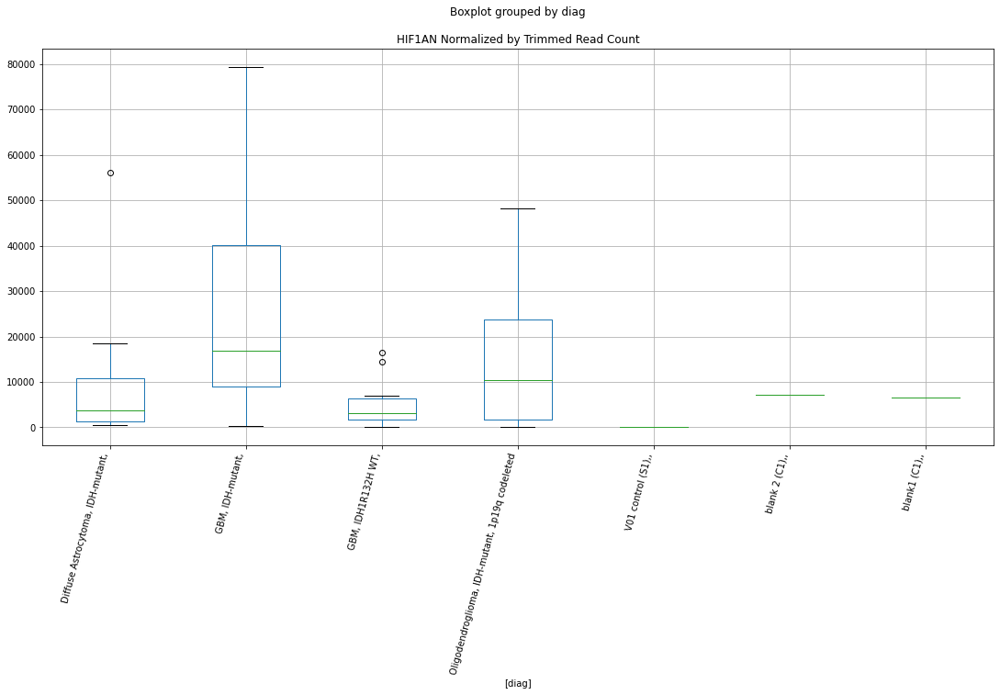

 p : 0.01665760125531405  ( t : 2.639402548758818 ) :  D-plex  :  cutadapt2  :  GSPT1
Control and blanks
76     2272.84
340       0.00
Name: GSPT1, dtype: float64
208    1587.24
Name: GSPT1, dtype: float64
472    1733.87
Name: GSPT1, dtype: float64


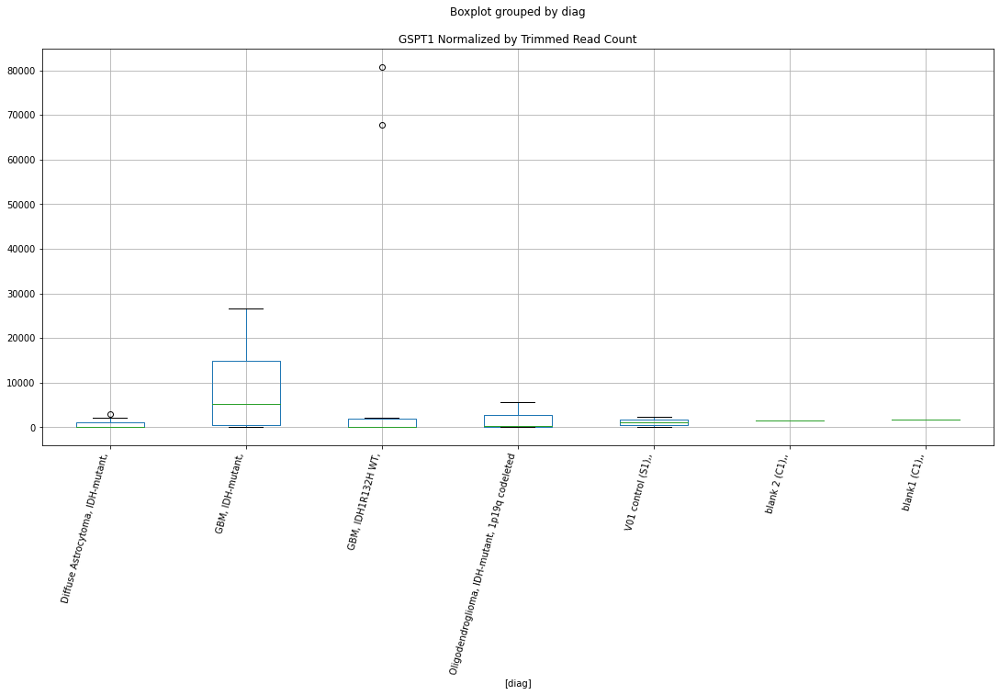

 p : 0.016773027539201717  ( t : 2.6361309053208077 ) :  Lexogen  :  cutadapt2  :  LAMA2
Control and blanks
82       9940.36
346    118053.77
Name: LAMA2, dtype: float64
214    3797.17
Name: LAMA2, dtype: float64
478    41555.58
Name: LAMA2, dtype: float64


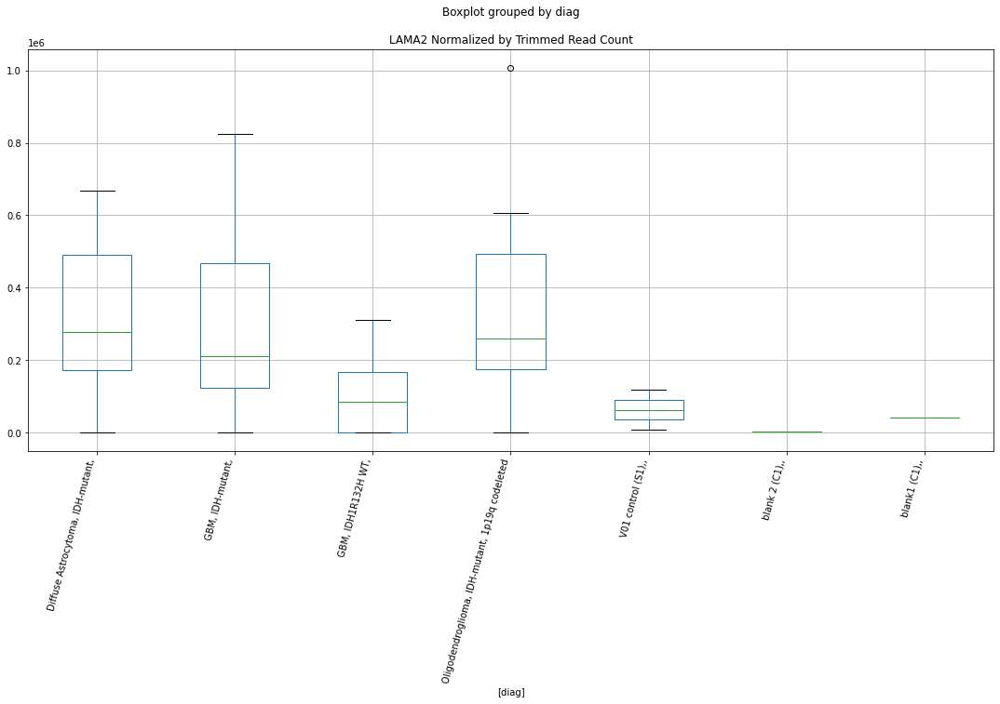

 p : 0.016855213172253643  ( t : 2.6338144635238785 ) :  D-plex  :  cutadapt2  :  EVC
Control and blanks
76     0.0
340    0.0
Name: EVC, dtype: float64
208    15166.98
Name: EVC, dtype: float64
472    13292.98
Name: EVC, dtype: float64


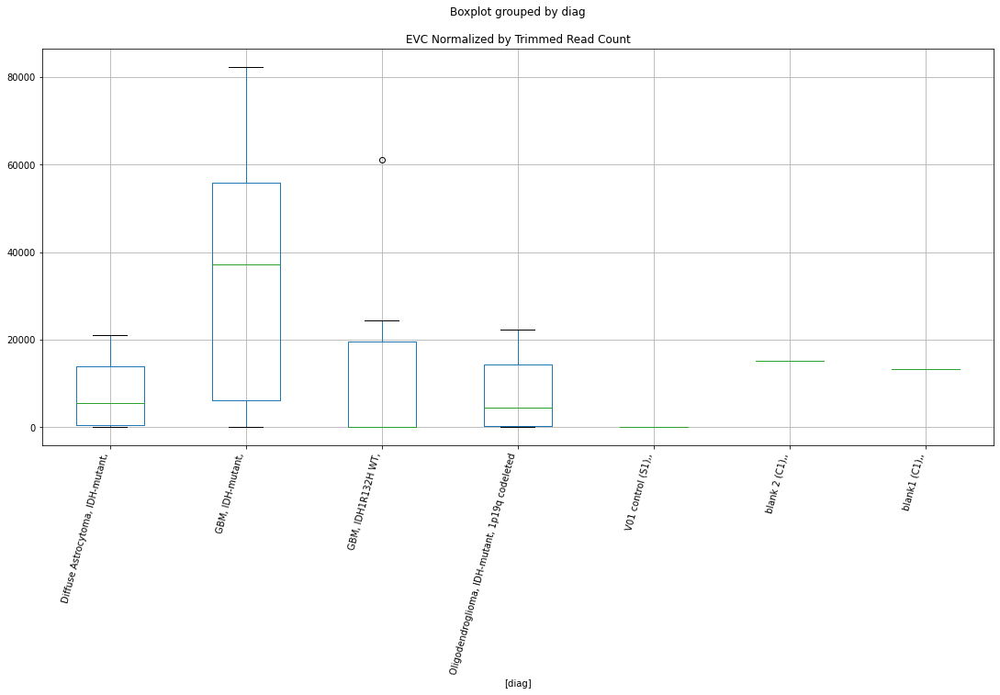

 p : 0.016933821259010214  ( t : 2.631608886570395 ) :  D-plex  :  cutadapt2  :  INTS5
Control and blanks
76     0.0
340    0.0
Name: INTS5, dtype: float64
208    529.08
Name: INTS5, dtype: float64
472    1733.87
Name: INTS5, dtype: float64


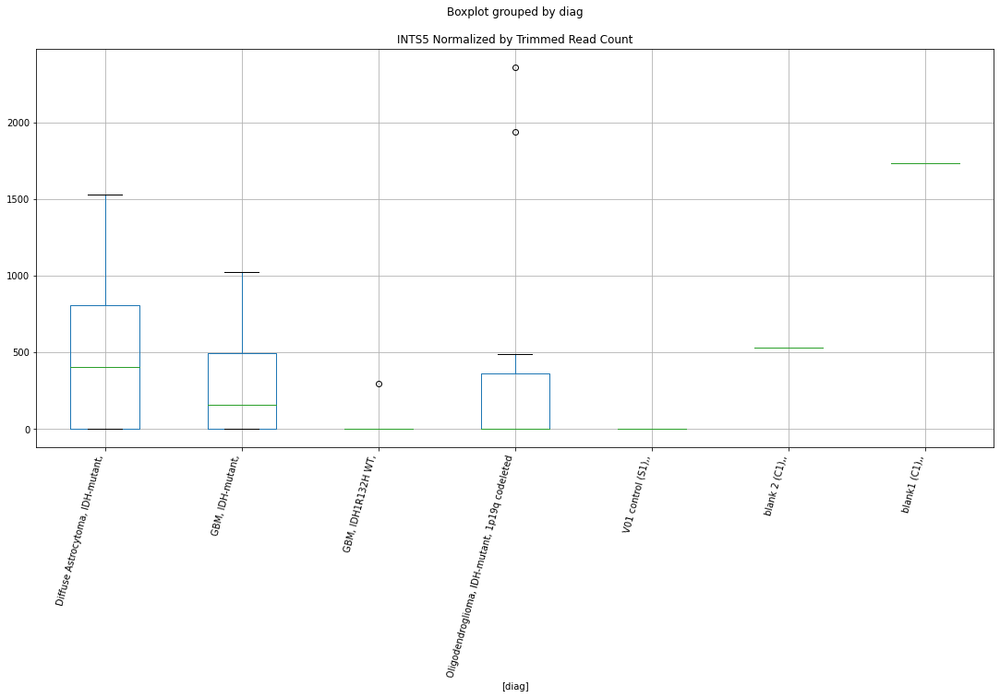

 p : 0.017065825906318846  ( t : 2.6279269255996254 ) :  Lexogen  :  cutadapt2  :  EDIL3-DT
Control and blanks
82     0.0
346    0.0
Name: EDIL3-DT, dtype: float64
214    0.0
Name: EDIL3-DT, dtype: float64
478    0.0
Name: EDIL3-DT, dtype: float64


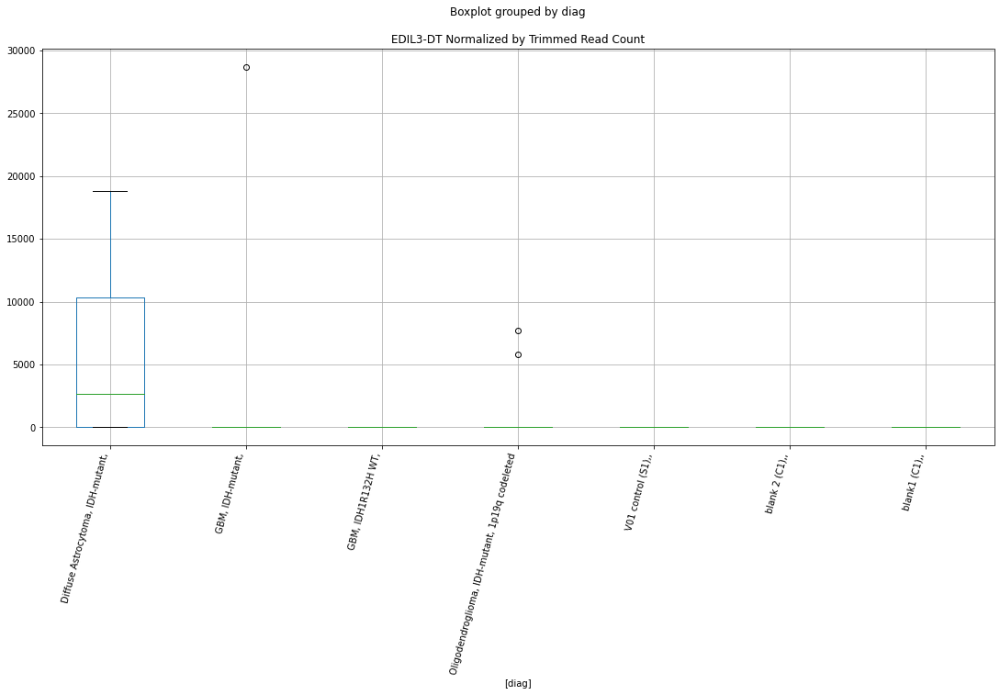

 p : 0.017082554964023795  ( t : 2.6274622424451404 ) :  Lexogen  :  bbduk2  :  EDIL3-DT
Control and blanks
79     0.0
343    0.0
Name: EDIL3-DT, dtype: float64
211    0.0
Name: EDIL3-DT, dtype: float64
475    0.0
Name: EDIL3-DT, dtype: float64


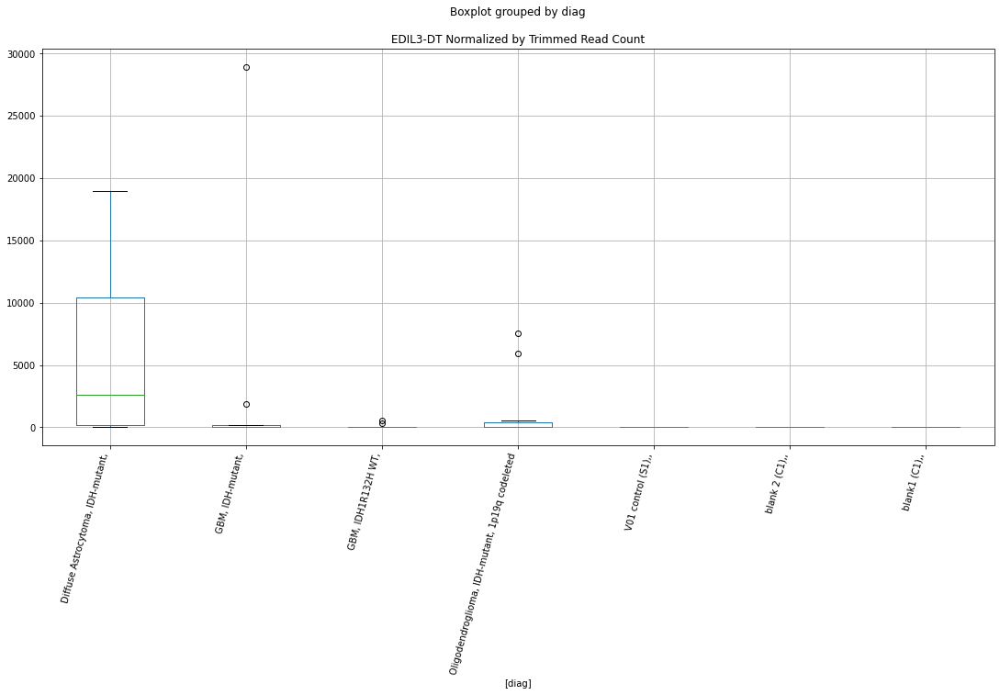

 p : 0.017320398270701465  ( t : 2.6209020520919086 ) :  D-plex  :  bbduk2  :  INTS5
Control and blanks
73     0.0
337    0.0
Name: INTS5, dtype: float64
205    537.27
Name: INTS5, dtype: float64
469    1774.58
Name: INTS5, dtype: float64


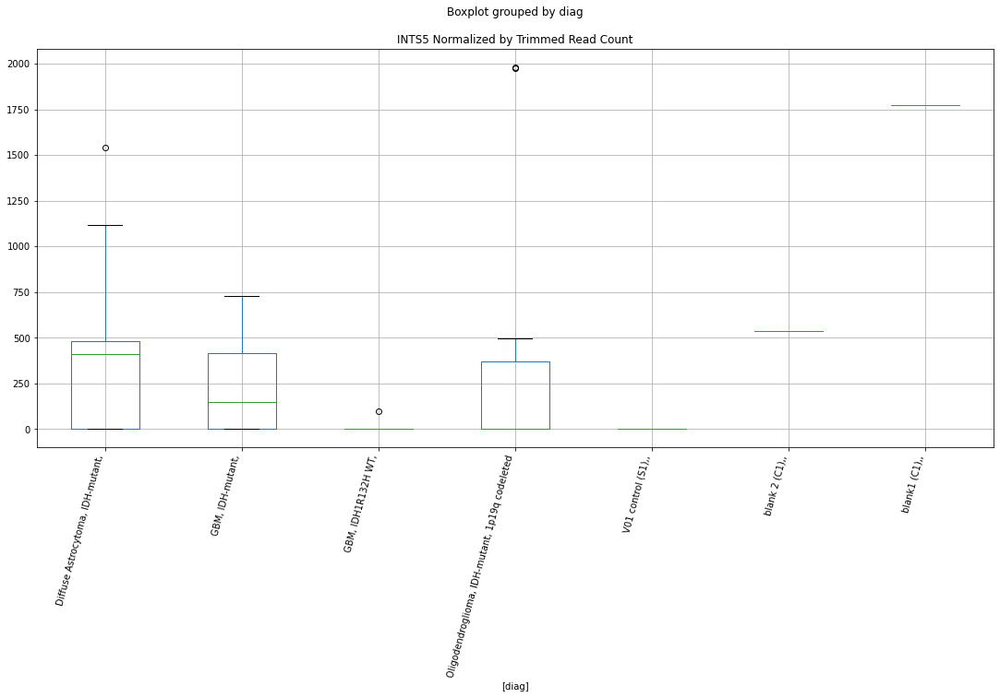

 p : 0.017337098249703045  ( t : 2.6204446562866344 ) :  Lexogen  :  bbduk2  :  LAMA2
Control and blanks
79      10014.19
343    119108.33
Name: LAMA2, dtype: float64
211    3826.29
Name: LAMA2, dtype: float64
475    43831.38
Name: LAMA2, dtype: float64


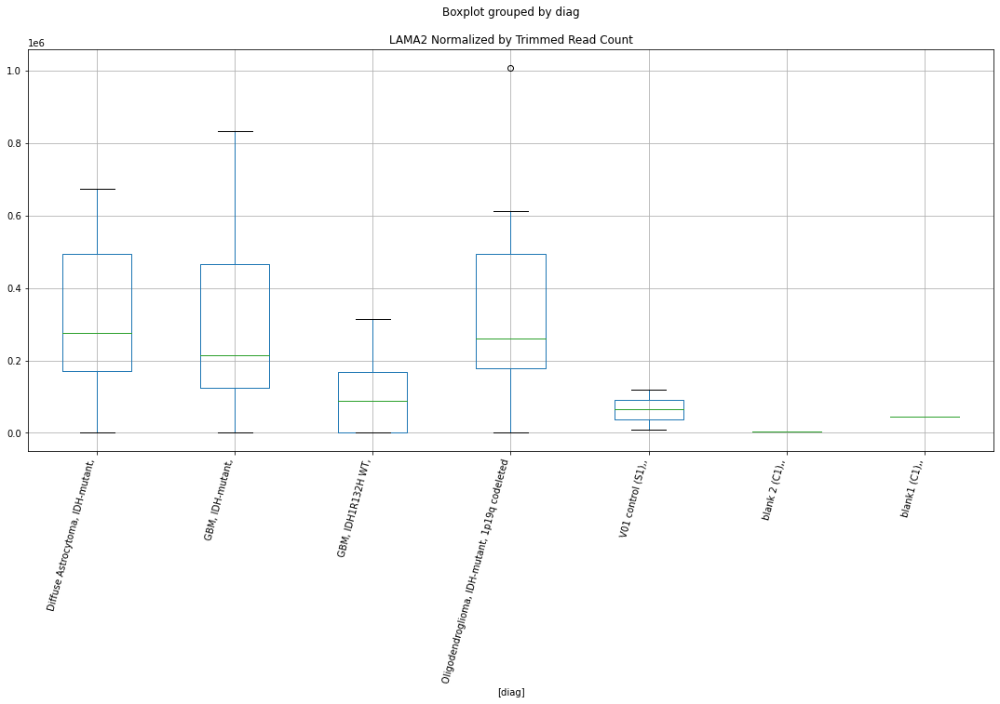

 p : 0.0174449262747448  ( t : 2.6175013939048197 ) :  D-plex  :  bbduk2  :  GHITM
Control and blanks
73     0.0
337    0.0
Name: GHITM, dtype: float64
205    537.27
Name: GHITM, dtype: float64
469    1183.05
Name: GHITM, dtype: float64


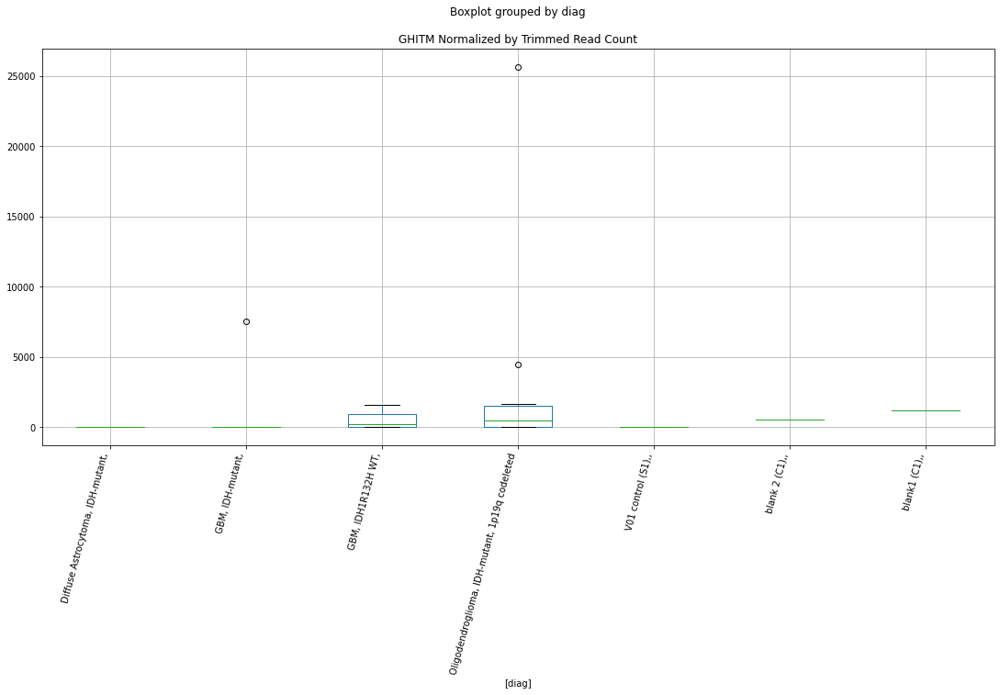

 p : 0.017551022231593445  ( t : 2.6146222324878226 ) :  D-plex  :  cutadapt2  :  HDLBP
Control and blanks
76     0.0
340    0.0
Name: HDLBP, dtype: float64
208    15696.06
Name: HDLBP, dtype: float64
472    8669.34
Name: HDLBP, dtype: float64


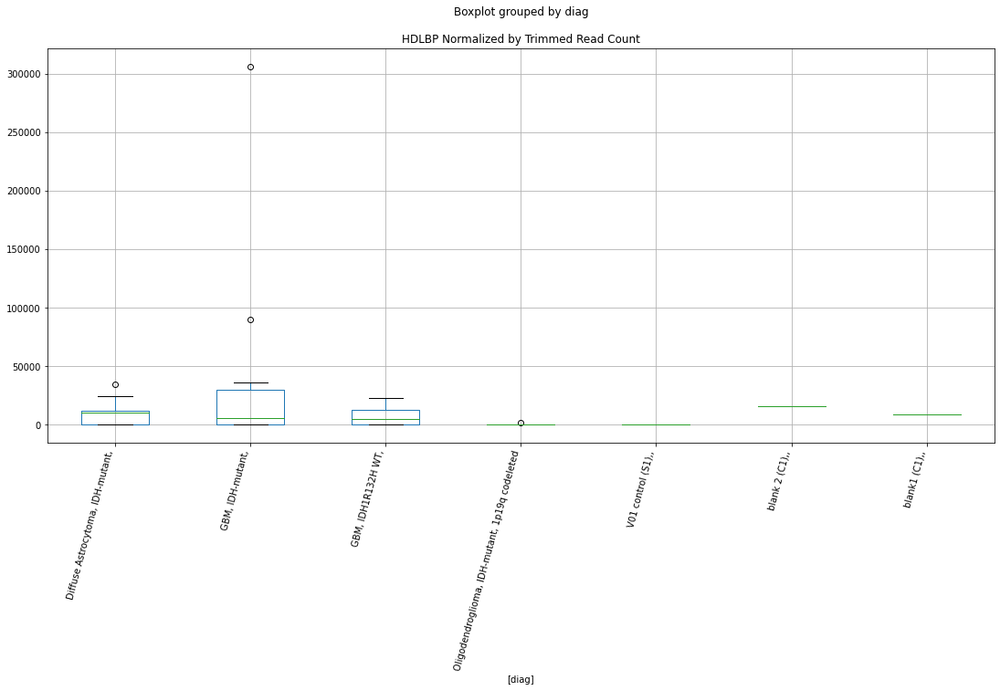

 p : 0.01767408283611271  ( t : 2.6113033335833213 ) :  Lexogen  :  bbduk2  :  FRS2
Control and blanks
79     0.0
343    0.0
Name: FRS2, dtype: float64
211    0.0
Name: FRS2, dtype: float64
475    0.0
Name: FRS2, dtype: float64


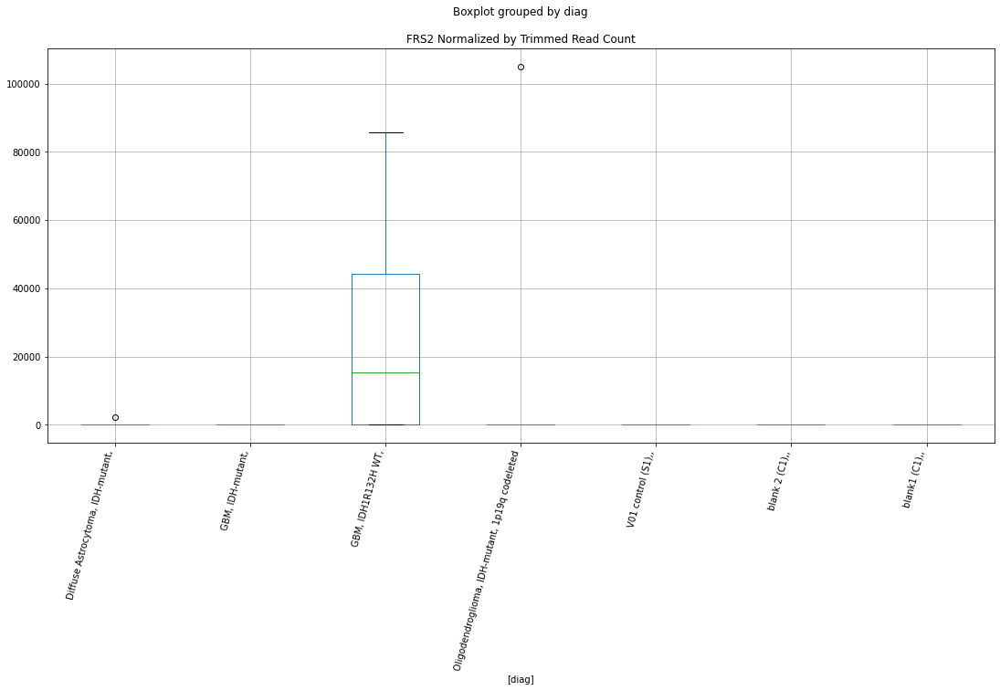

 p : 0.017731648450715  ( t : 2.6097583383173864 ) :  Lexogen  :  cutadapt2  :  EPS8L1
Control and blanks
82         0.00
346    69022.52
Name: EPS8L1, dtype: float64
214    0.0
Name: EPS8L1, dtype: float64
478    0.0
Name: EPS8L1, dtype: float64


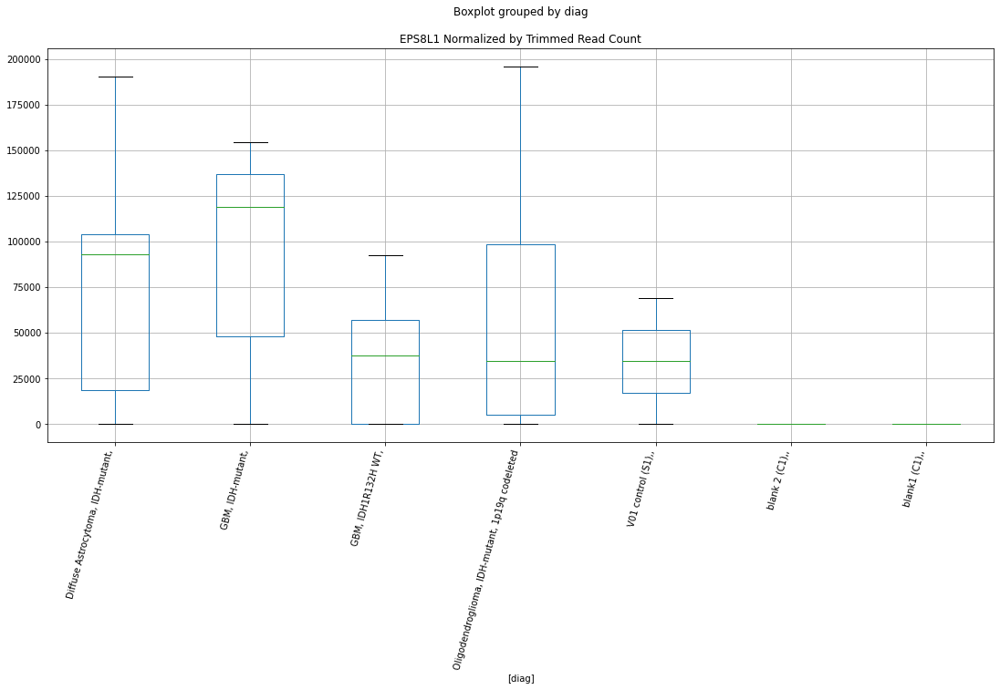

 p : 0.017940604446474454  ( t : 2.6041899380695623 ) :  Lexogen  :  bbduk2  :  EPS8L1
Control and blanks
79      40056.77
343    101061.61
Name: EPS8L1, dtype: float64
211    80898.67
Name: EPS8L1, dtype: float64
475    87183.73
Name: EPS8L1, dtype: float64


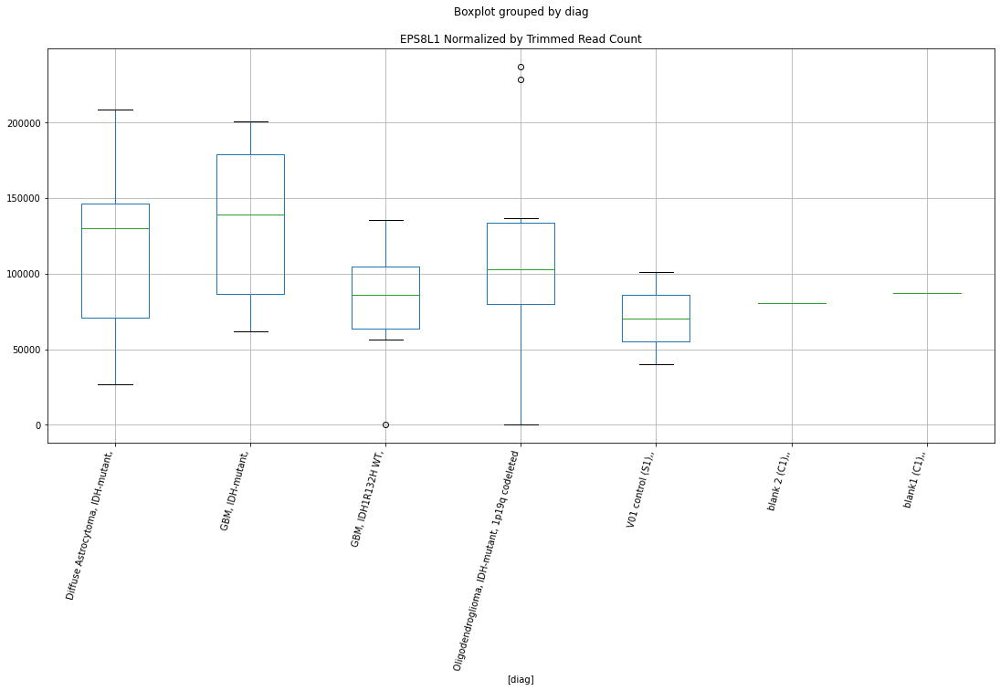

 p : 0.01804956936058366  ( t : 2.6013105463731305 ) :  D-plex  :  cutadapt2  :  FGF7P3
Control and blanks
76     1515.23
340     880.73
Name: FGF7P3, dtype: float64
208    0.0
Name: FGF7P3, dtype: float64
472    577.96
Name: FGF7P3, dtype: float64


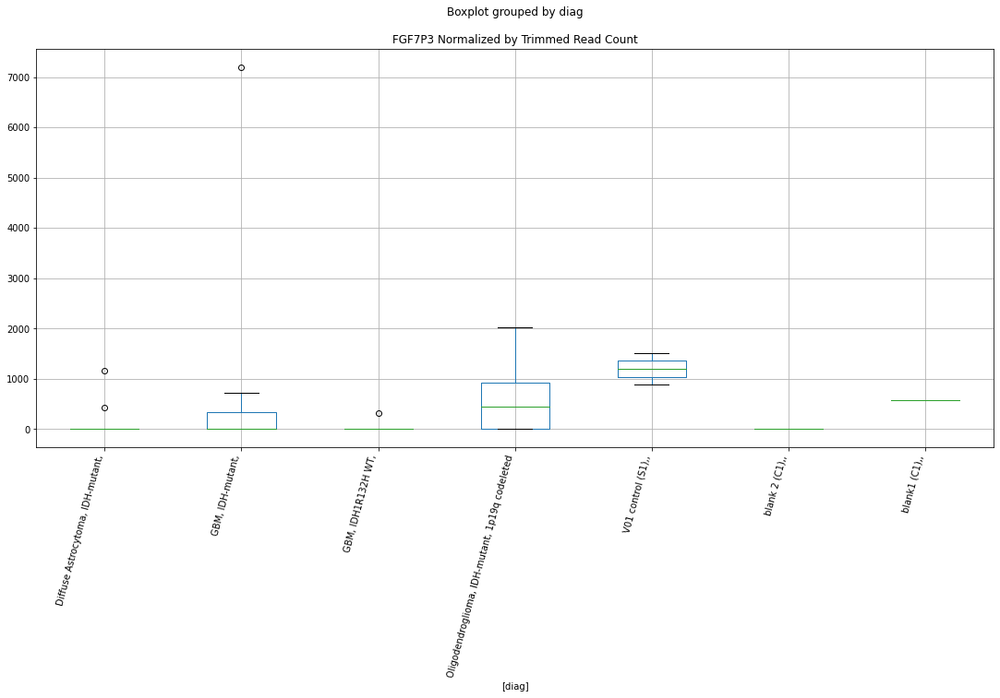

 p : 0.018570673390368365  ( t : 2.587764501395555 ) :  Lexogen  :  bbduk2  :  FRS2
Control and blanks
79     0.0
343    0.0
Name: FRS2, dtype: float64
211    0.0
Name: FRS2, dtype: float64
475    0.0
Name: FRS2, dtype: float64


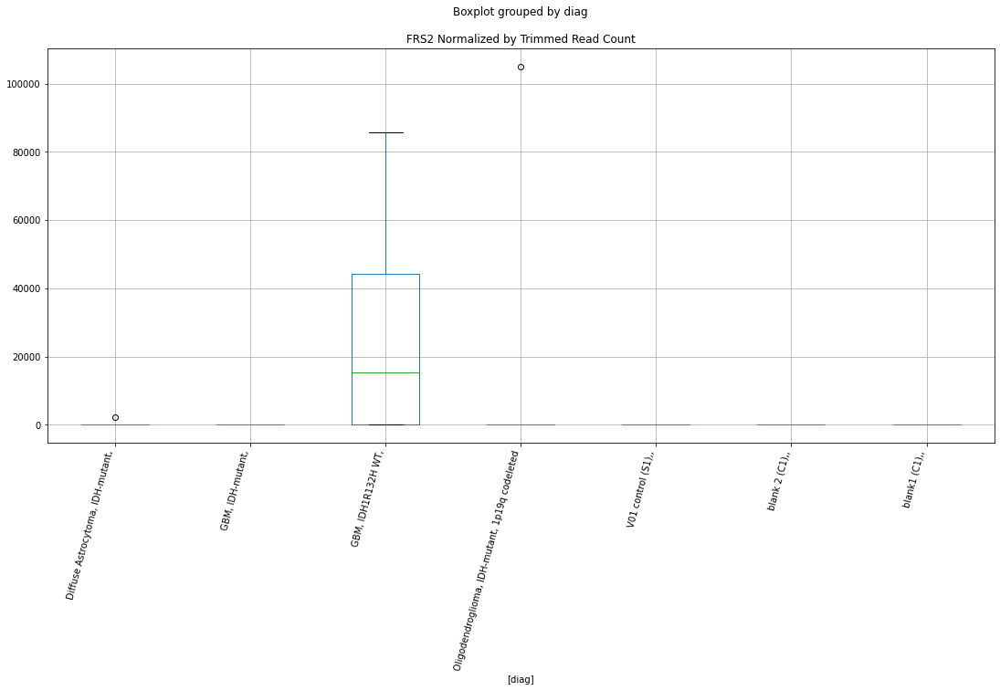

 p : 0.01858348156172697  ( t : 2.587436114620749 ) :  Lexogen  :  cutadapt2  :  ILRUN
Control and blanks
82       0.00
346    841.74
Name: ILRUN, dtype: float64
214    1084.91
Name: ILRUN, dtype: float64
478    0.0
Name: ILRUN, dtype: float64


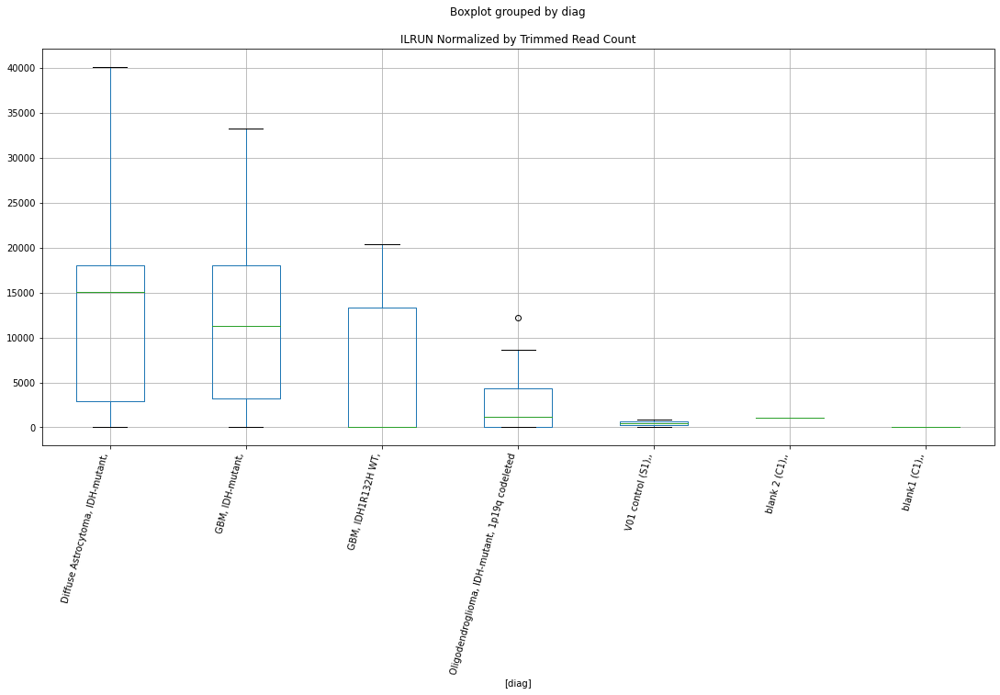

 p : 0.018598444019580797  ( t : 2.587052766098161 ) :  D-plex  :  cutadapt2  :  KLHL36
Control and blanks
76     3788.07
340       0.00
Name: KLHL36, dtype: float64
208    6172.61
Name: KLHL36, dtype: float64
472    14448.9
Name: KLHL36, dtype: float64


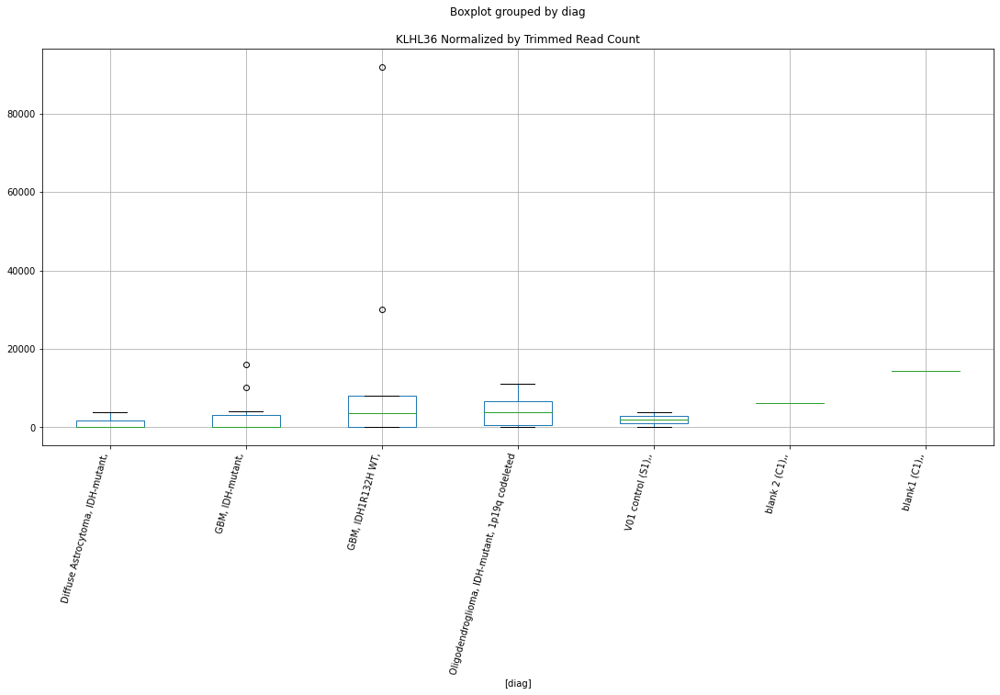

 p : 0.01860020207667331  ( t : 2.5870077426587663 ) :  D-plex  :  bbduk2  :  KAT8
Control and blanks
73     0.0
337    0.0
Name: KAT8, dtype: float64
205    0.0
Name: KAT8, dtype: float64
469    1183.05
Name: KAT8, dtype: float64


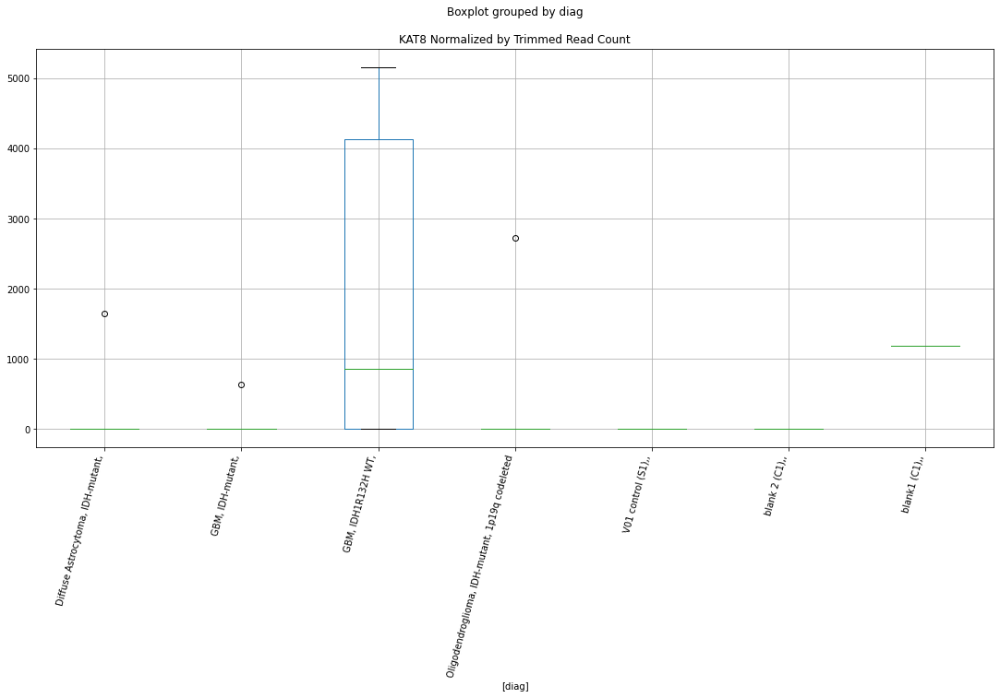

 p : 0.018863620210654065  ( t : 2.5803068394878945 ) :  D-plex  :  cutadapt2  :  LARS2
Control and blanks
76     116672.59
340         0.00
Name: LARS2, dtype: float64
208    8818.01
Name: LARS2, dtype: float64
472    19650.5
Name: LARS2, dtype: float64


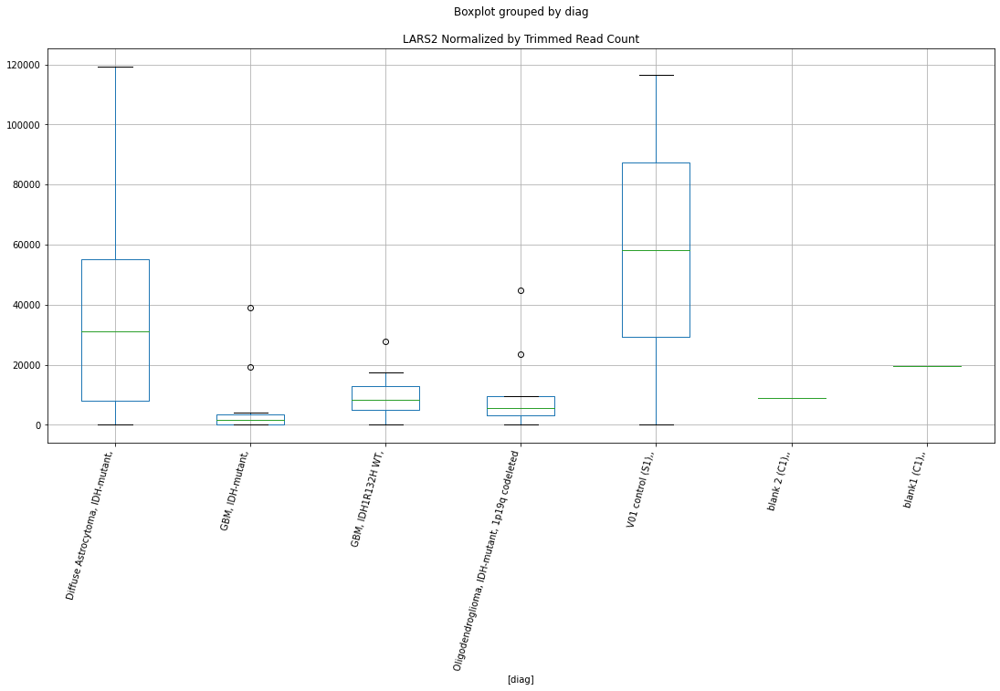

 p : 0.01890560343050496  ( t : 2.579247061636889 ) :  D-plex  :  bbduk2  :  GALNT18
Control and blanks
73       773.01
337    20473.62
Name: GALNT18, dtype: float64
205    3940.0
Name: GALNT18, dtype: float64
469    591.53
Name: GALNT18, dtype: float64


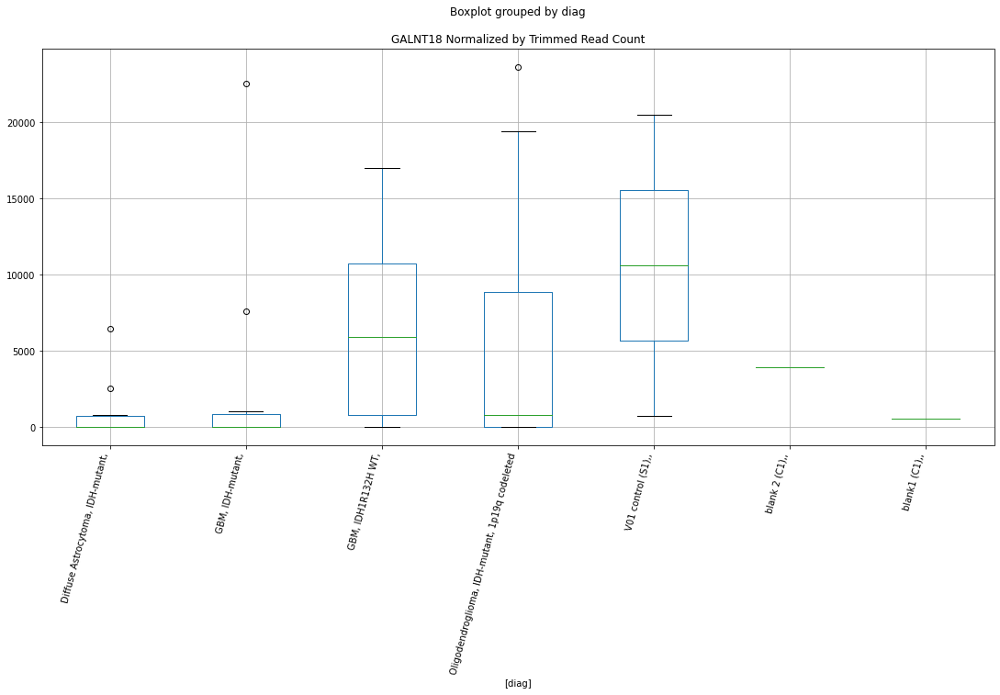

 p : 0.019035993201979816  ( t : 2.575969807910637 ) :  Lexogen  :  bbduk2  :  FAM160B1
Control and blanks
79       0.00
343    849.26
Name: FAM160B1, dtype: float64
211    0.0
Name: FAM160B1, dtype: float64
475    1437.09
Name: FAM160B1, dtype: float64


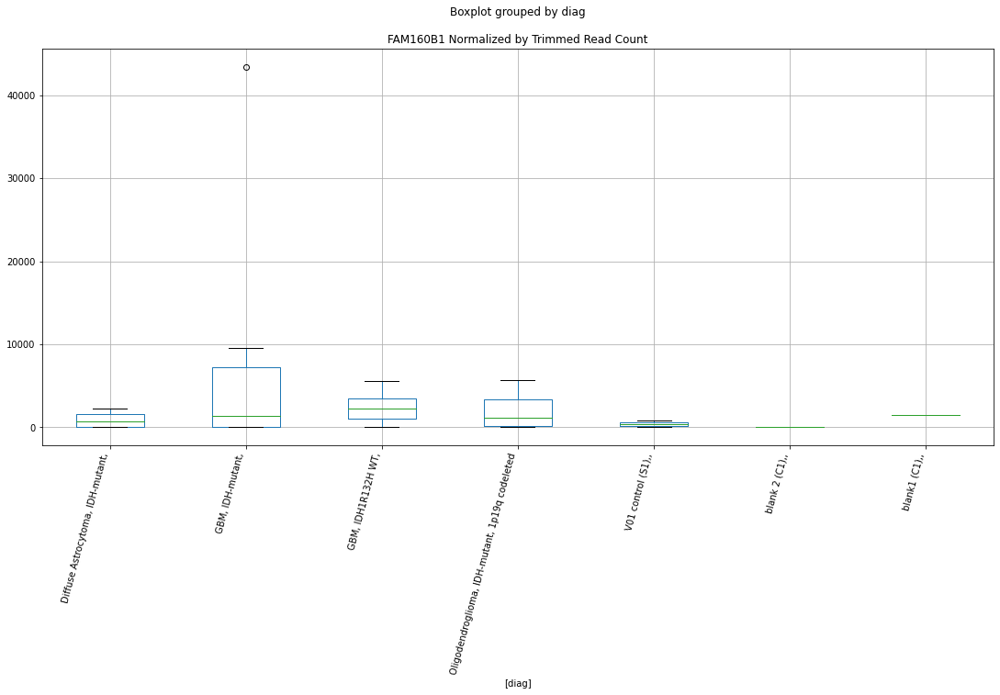

 p : 0.019114144937312318  ( t : 2.5740156995237893 ) :  D-plex  :  bbduk2  :  HAS3
Control and blanks
73     0.0
337    0.0
Name: HAS3, dtype: float64
205    2686.36
Name: HAS3, dtype: float64
469    14788.18
Name: HAS3, dtype: float64


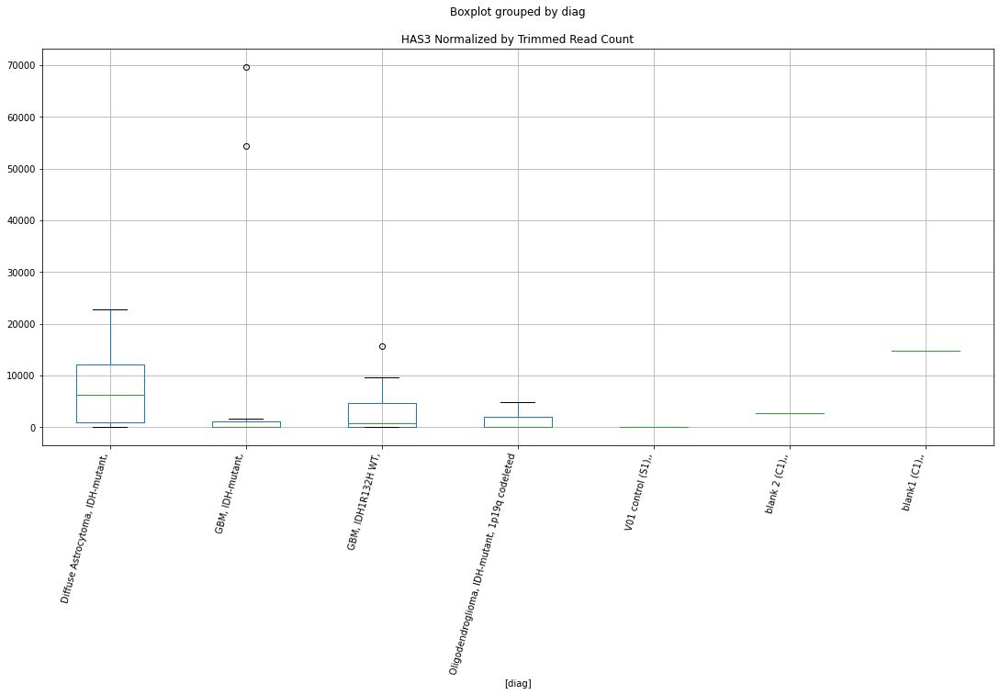

 p : 0.019139273901130602  ( t : 2.573388982100062 ) :  Lexogen  :  bbduk2  :  GLT1D1
Control and blanks
79          0.00
343    781528.99
Name: GLT1D1, dtype: float64
211    0.0
Name: GLT1D1, dtype: float64
475    111135.3
Name: GLT1D1, dtype: float64


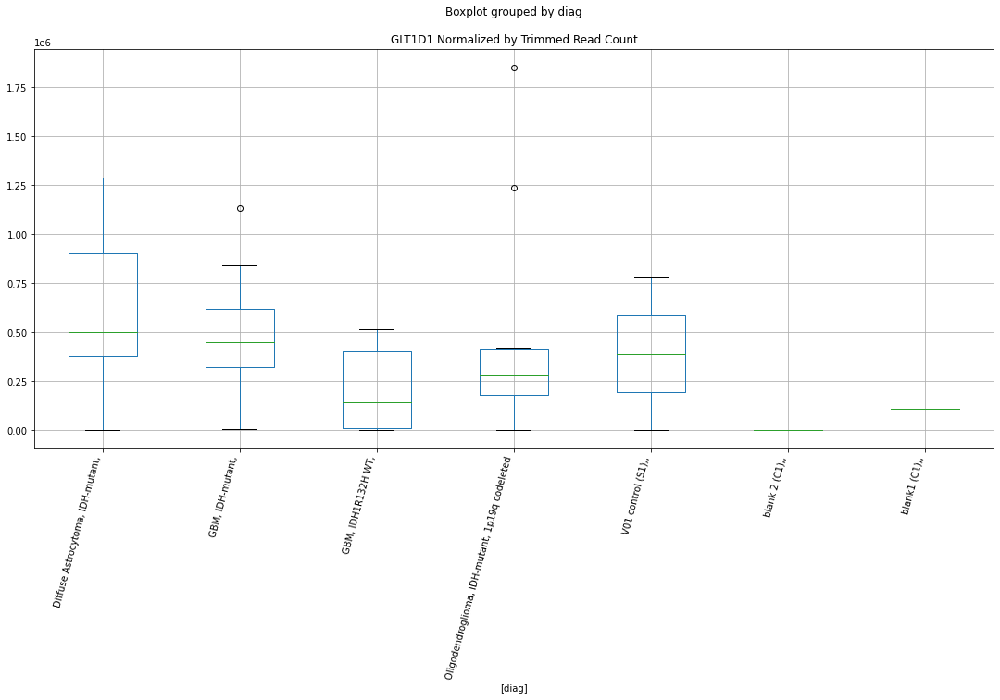

 p : 0.019213460768762725  ( t : 2.57154329544909 ) :  D-plex  :  bbduk2  :  INTS5
Control and blanks
73     0.0
337    0.0
Name: INTS5, dtype: float64
205    537.27
Name: INTS5, dtype: float64
469    1774.58
Name: INTS5, dtype: float64


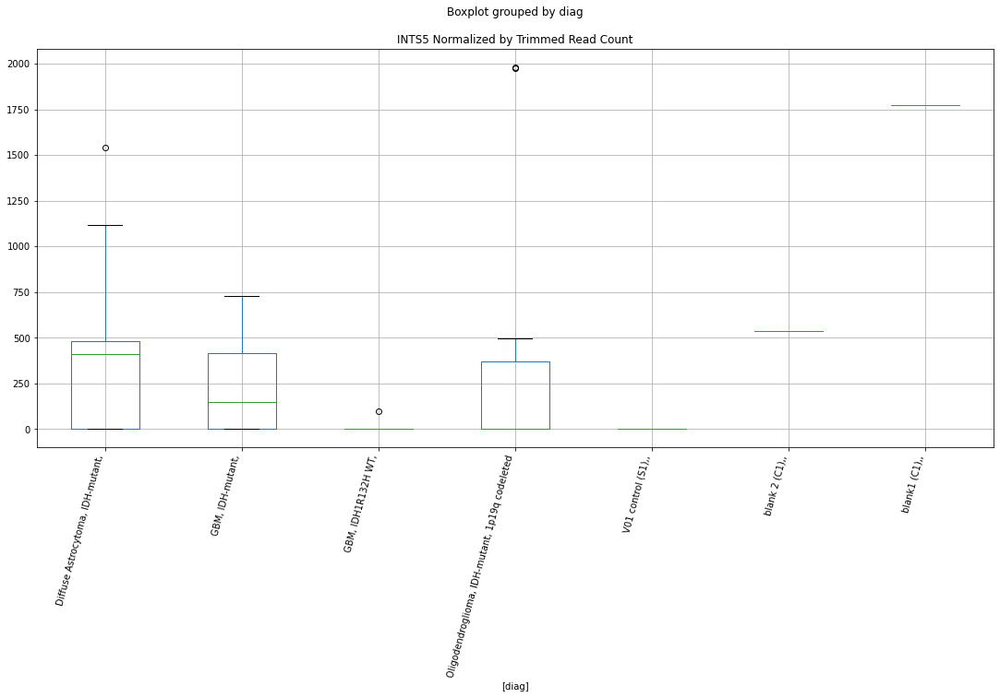

 p : 0.01923939120580627  ( t : 2.570899766775446 ) :  D-plex  :  bbduk2  :  IPO13
Control and blanks
73     216442.35
337     16022.83
Name: IPO13, dtype: float64
205    151152.76
Name: IPO13, dtype: float64
469    102925.75
Name: IPO13, dtype: float64


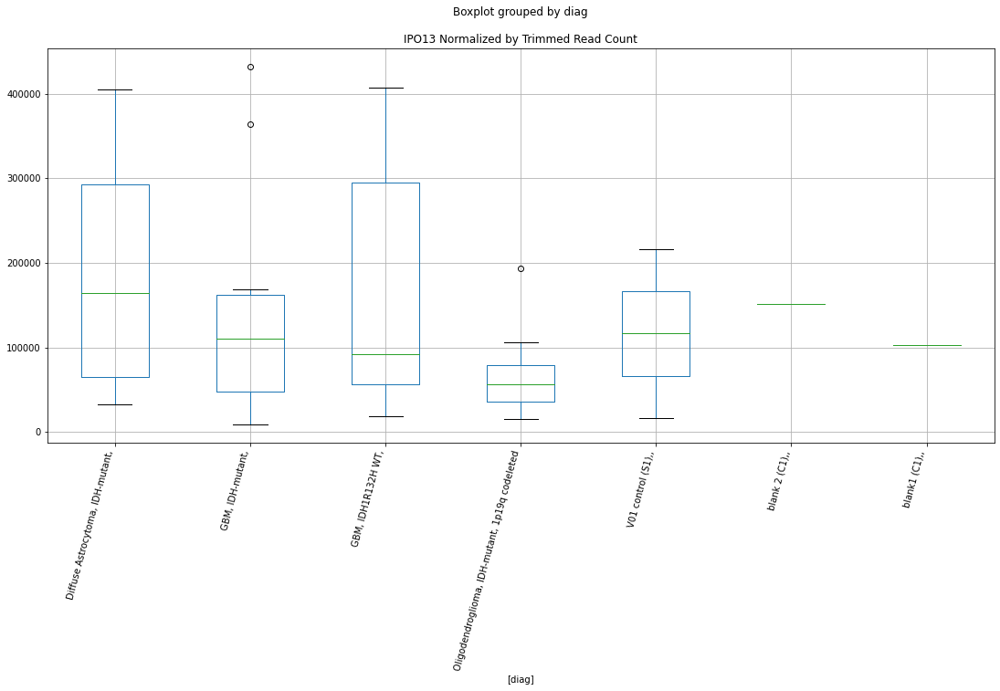

 p : 0.019435688128598385  ( t : 2.566054643464704 ) :  Lexogen  :  cutadapt2  :  GLT1D1
Control and blanks
82          0.00
346    777976.43
Name: GLT1D1, dtype: float64
214    0.0
Name: GLT1D1, dtype: float64
478    110181.66
Name: GLT1D1, dtype: float64


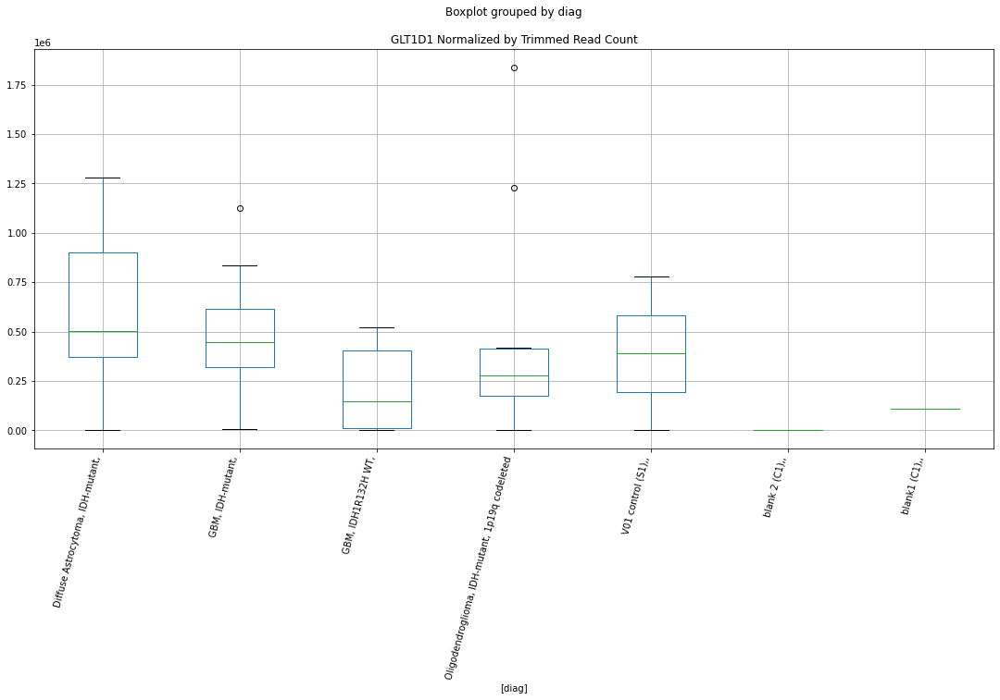

 p : 0.019671327691322873  ( t : 2.5602992613260693 ) :  D-plex  :  bbduk2  :  DNAH2
Control and blanks
73     0.0
337    0.0
Name: DNAH2, dtype: float64
205    14148.19
Name: DNAH2, dtype: float64
469    43773.02
Name: DNAH2, dtype: float64


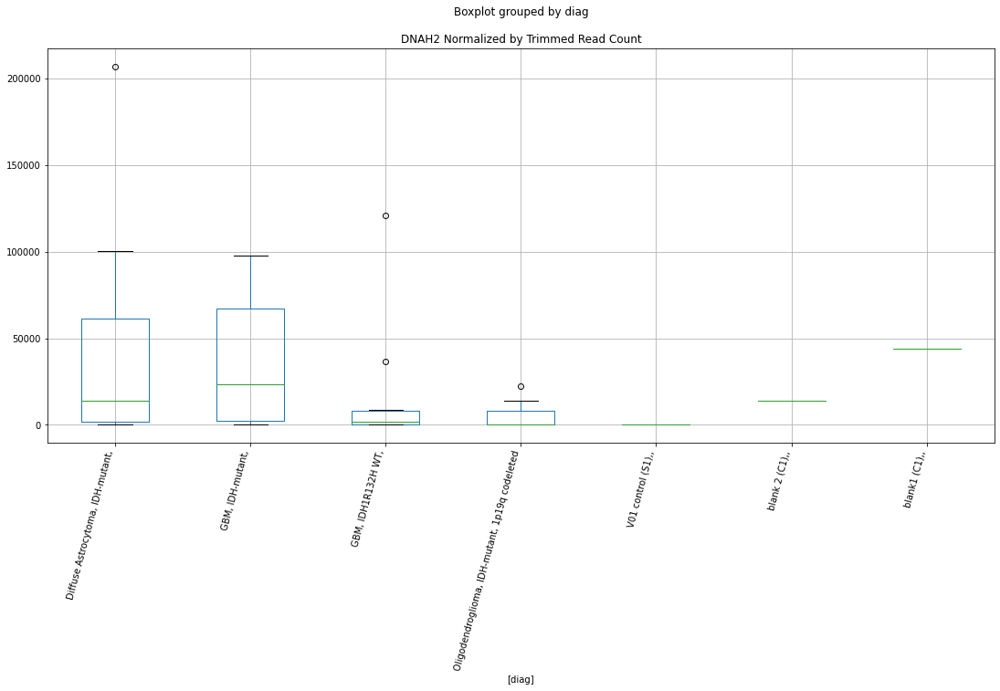

 p : 0.019759770032785177  ( t : 2.5581559287921283 ) :  D-plex  :  bbduk2  :  LCN15
Control and blanks
73     0.0
337    0.0
Name: LCN15, dtype: float64
205    716.36
Name: LCN15, dtype: float64
469    5915.27
Name: LCN15, dtype: float64


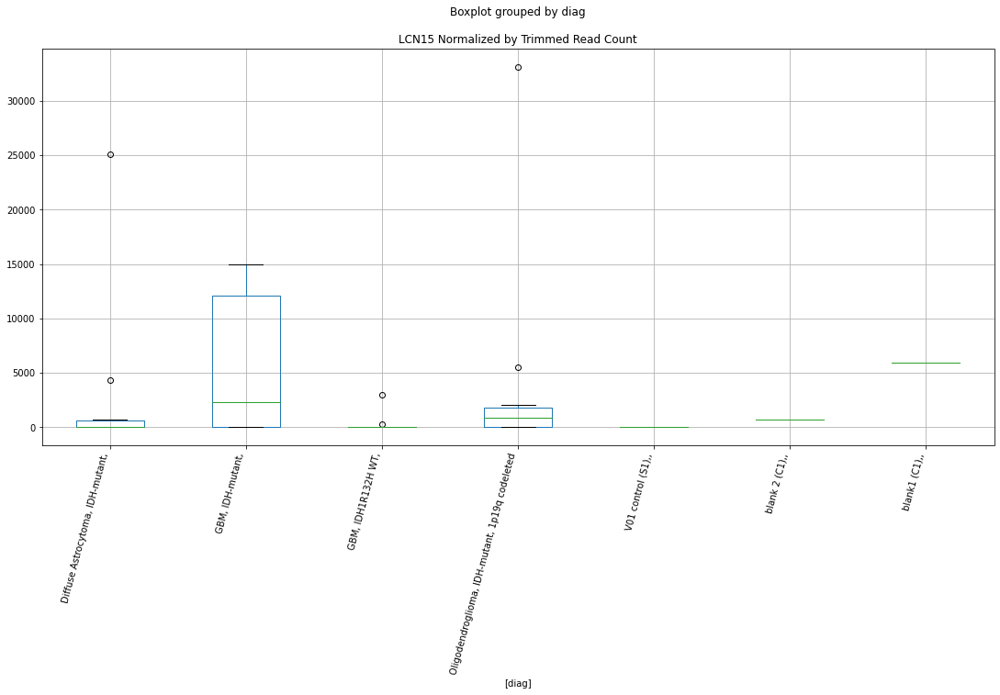

 p : 0.019950897933717016  ( t : 2.5535549260963455 ) :  Lexogen  :  cutadapt2  :  HUWE1
Control and blanks
82     0.0
346    0.0
Name: HUWE1, dtype: float64
214    0.0
Name: HUWE1, dtype: float64
478    0.0
Name: HUWE1, dtype: float64


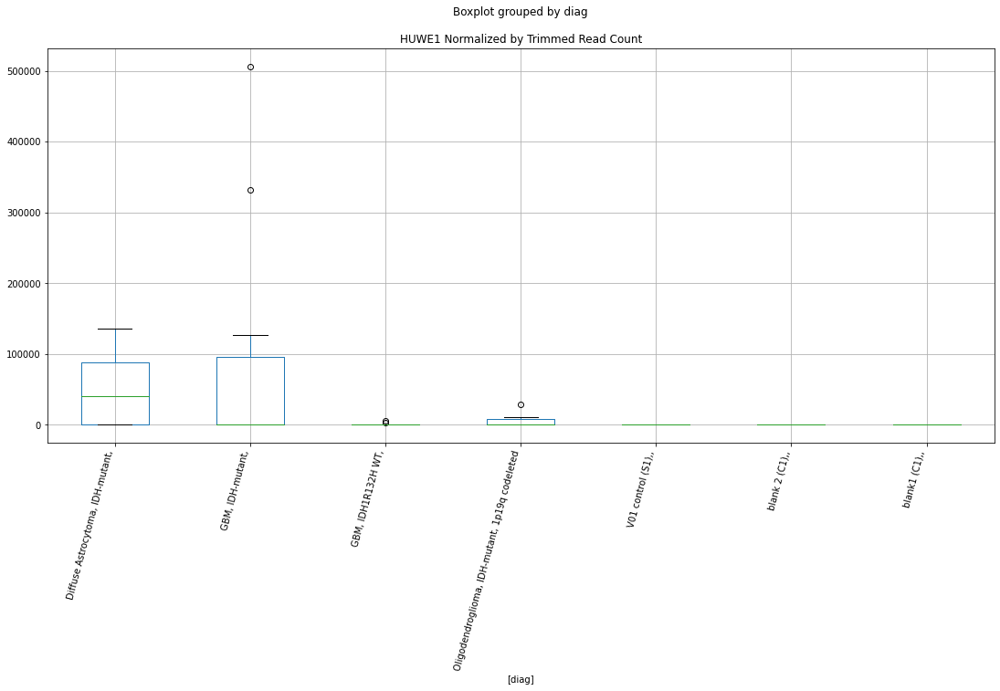

 p : 0.019985439335196916  ( t : 2.552727866004047 ) :  D-plex  :  cutadapt2  :  IPO13
Control and blanks
76     248497.46
340     12330.25
Name: IPO13, dtype: float64
208    147789.86
Name: IPO13, dtype: float64
472    100564.32
Name: IPO13, dtype: float64


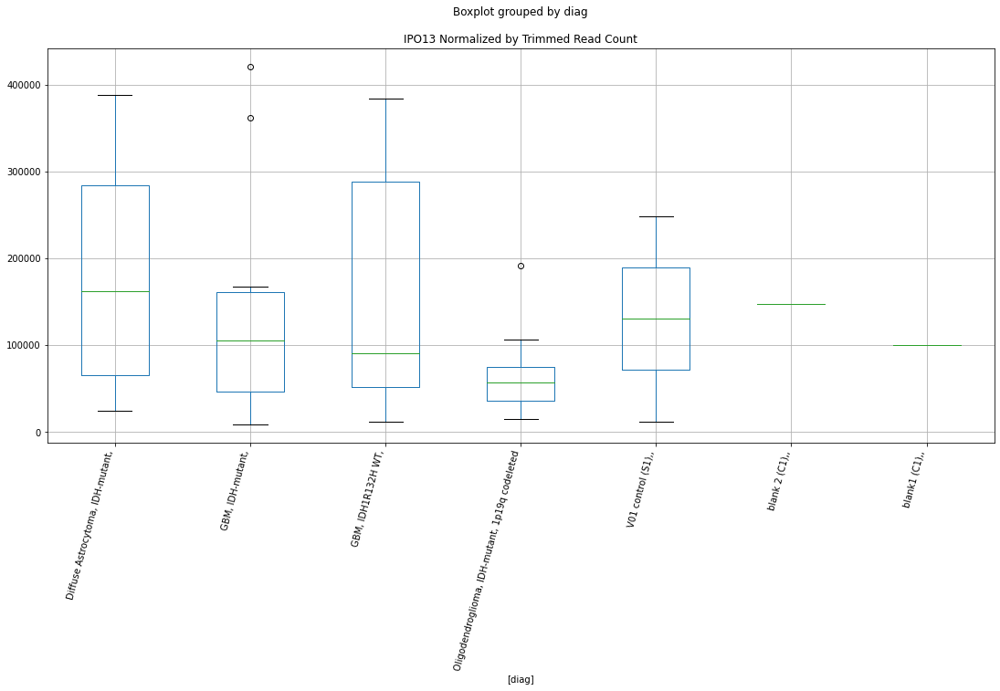

 p : 0.020010050373520515  ( t : 2.55213940326824 ) :  D-plex  :  bbduk2  :  GALNT11
Control and blanks
73     0.0
337    0.0
Name: GALNT11, dtype: float64
205    78979.11
Name: GALNT11, dtype: float64
469    54420.51
Name: GALNT11, dtype: float64


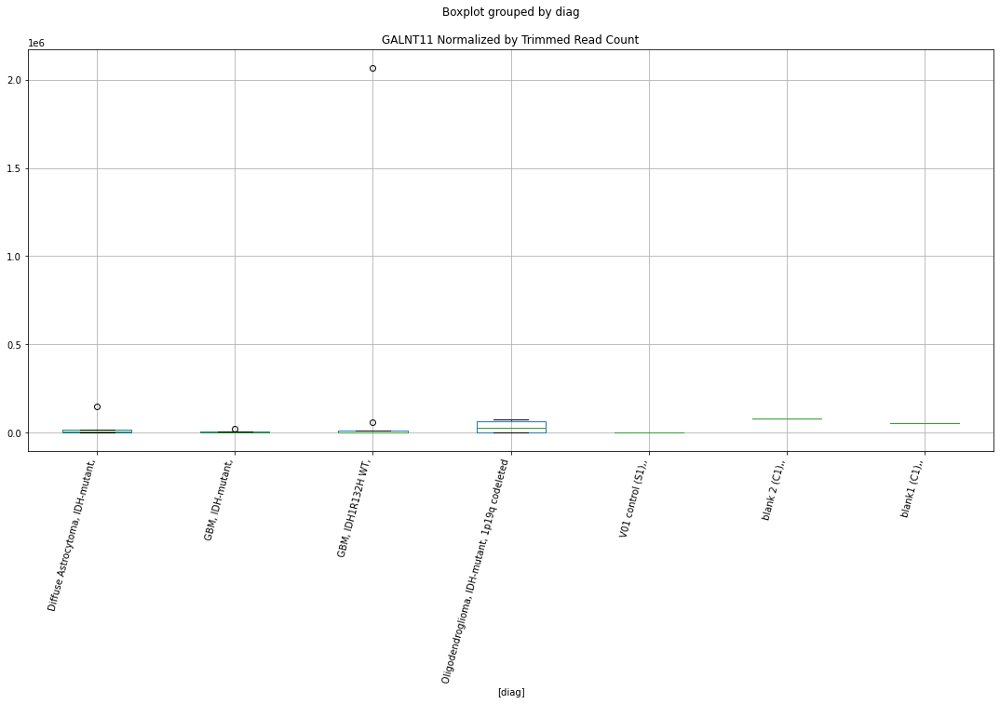

 p : 0.020057575908868173  ( t : 2.5510049778524224 ) :  D-plex  :  cutadapt2  :  LCN15
Control and blanks
76     0.0
340    0.0
Name: LCN15, dtype: float64
208    705.44
Name: LCN15, dtype: float64
472    5779.56
Name: LCN15, dtype: float64


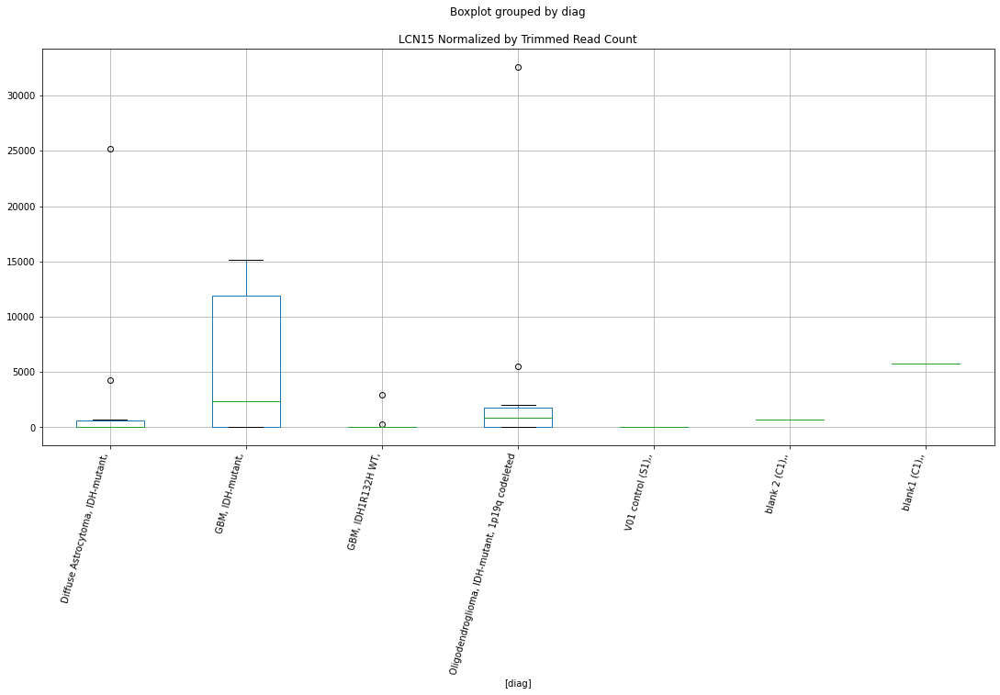

 p : 0.02006334819796417  ( t : 2.5508673676042237 ) :  D-plex  :  cutadapt2  :  GXYLT1
Control and blanks
76     0.0
340    0.0
Name: GXYLT1, dtype: float64
208    6348.97
Name: GXYLT1, dtype: float64
472    1155.91
Name: GXYLT1, dtype: float64


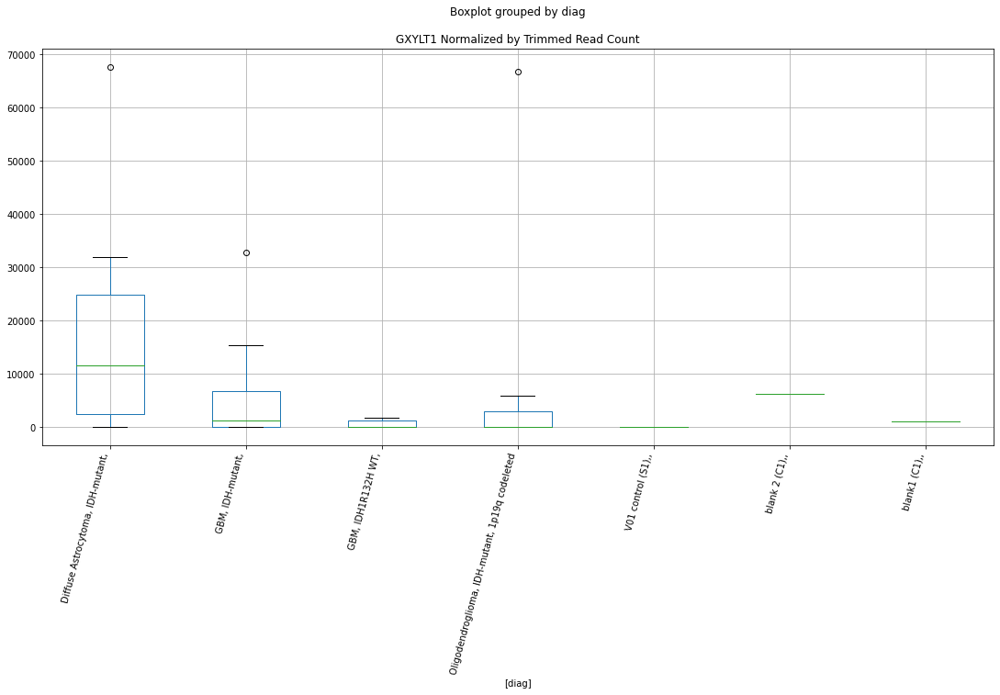

 p : 0.020092043399425216  ( t : 2.550183834855026 ) :  D-plex  :  bbduk2  :  KIF21A
Control and blanks
73     0.0
337    0.0
Name: KIF21A, dtype: float64
205    17192.73
Name: KIF21A, dtype: float64
469    18928.87
Name: KIF21A, dtype: float64


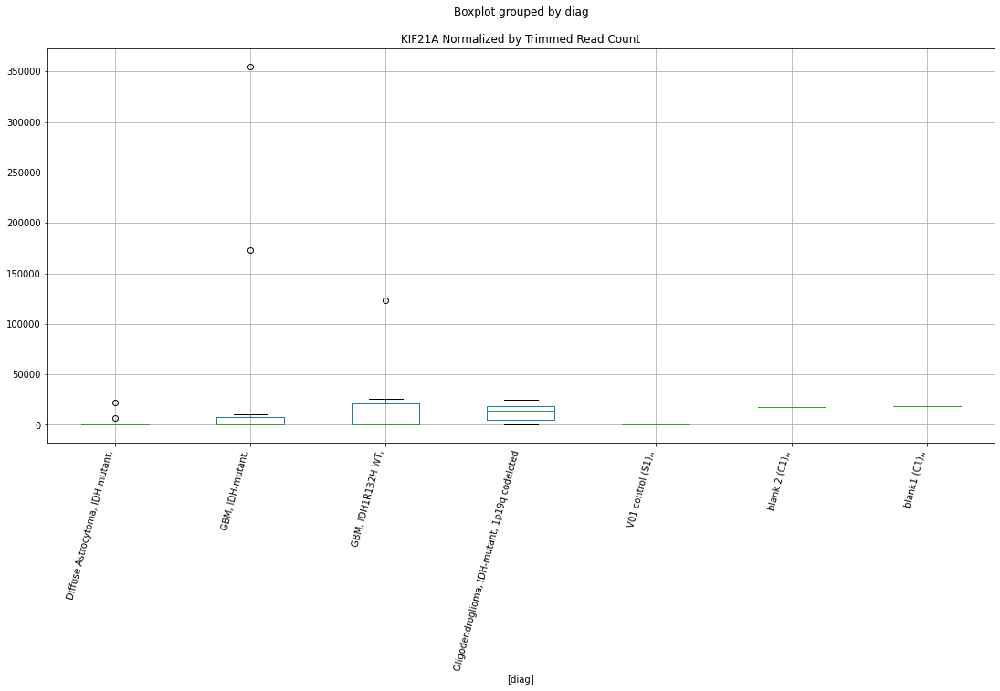

 p : 0.020103121841235024  ( t : 2.549920188338304 ) :  D-plex  :  cutadapt2  :  KCNQ3
Control and blanks
76     0.0
340    0.0
Name: KCNQ3, dtype: float64
208    6878.05
Name: KCNQ3, dtype: float64
472    6935.47
Name: KCNQ3, dtype: float64


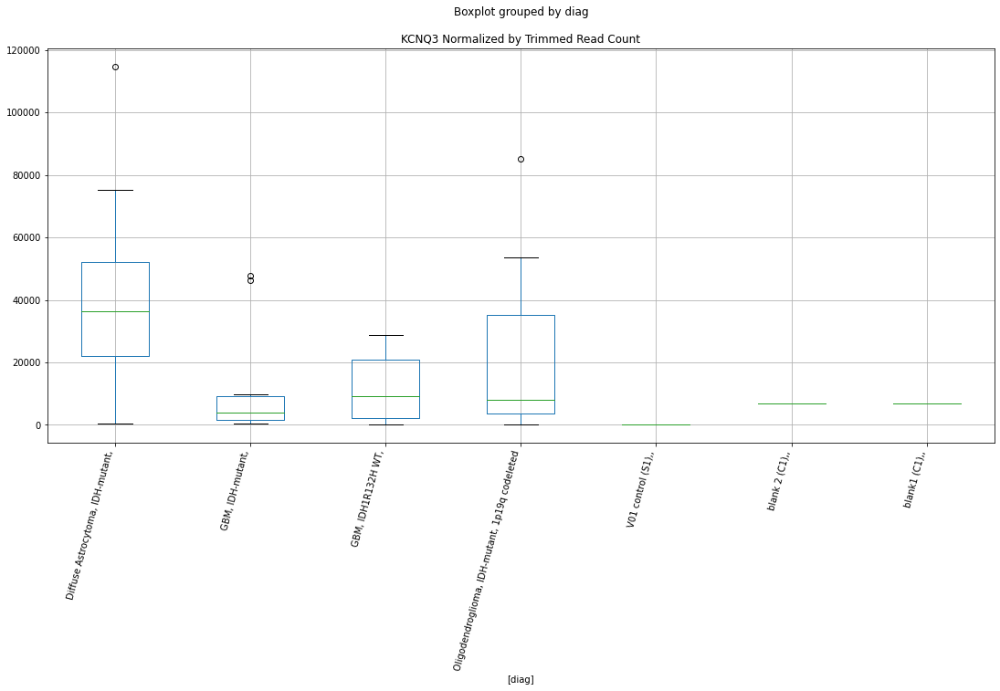

 p : 0.02013439920919237  ( t : 2.549176585476478 ) :  D-plex  :  cutadapt2  :  GALNT11
Control and blanks
76     0.0
340    0.0
Name: GALNT11, dtype: float64
208    78127.58
Name: GALNT11, dtype: float64
472    52016.03
Name: GALNT11, dtype: float64


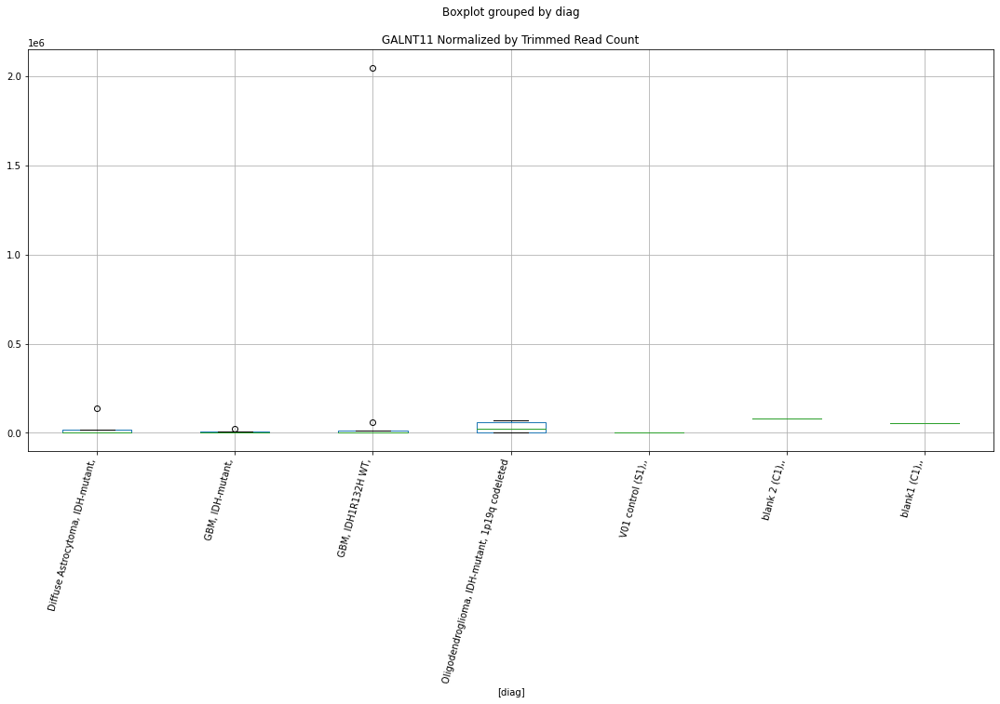

 p : 0.02015369564337286  ( t : 2.548718367654998 ) :  Lexogen  :  cutadapt2  :  JOSD2
Control and blanks
82     0.0
346    0.0
Name: JOSD2, dtype: float64
214    15459.91
Name: JOSD2, dtype: float64
478    0.0
Name: JOSD2, dtype: float64


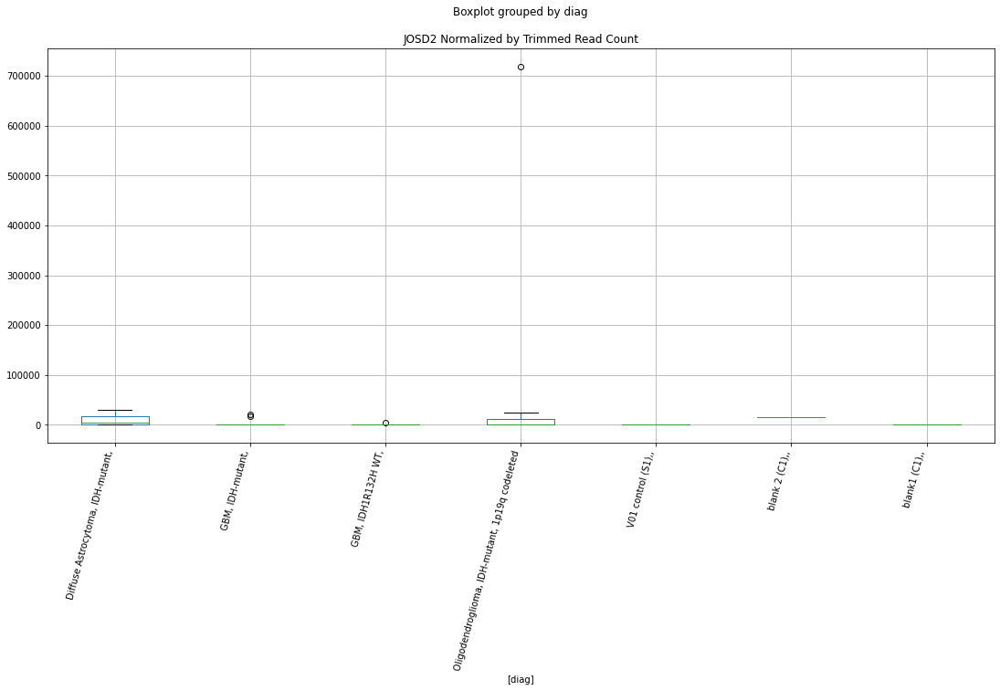

 p : 0.020154654428052147  ( t : 2.5486956109416714 ) :  Lexogen  :  bbduk2  :  JOSD2
Control and blanks
79     0.0
343    0.0
Name: JOSD2, dtype: float64
211    15578.46
Name: JOSD2, dtype: float64
475    0.0
Name: JOSD2, dtype: float64


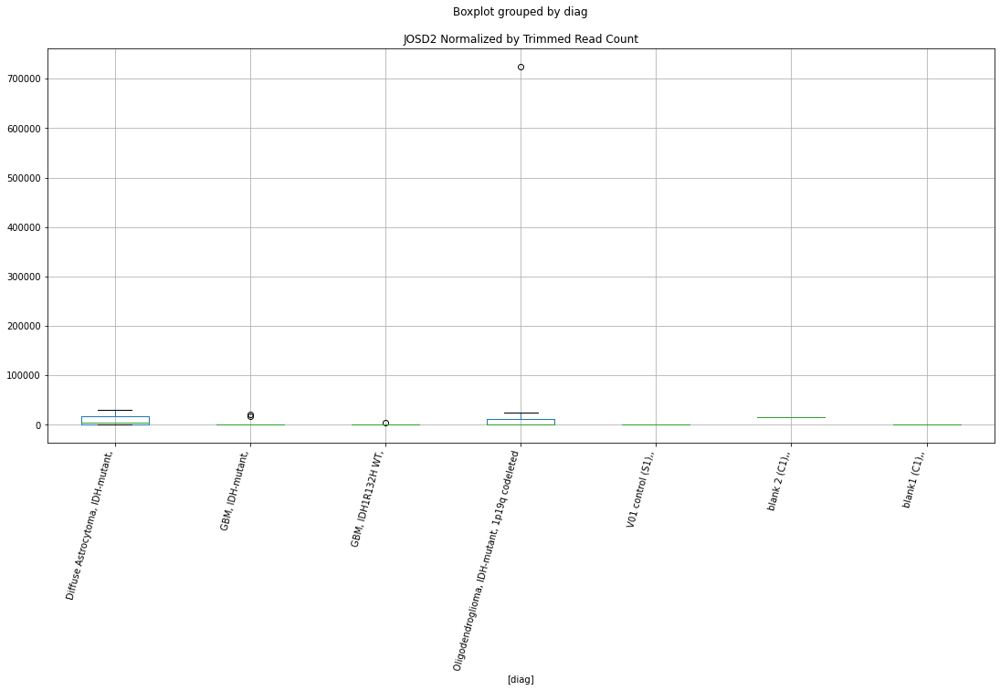

 p : 0.02028087233410211  ( t : 2.5457087357511785 ) :  Lexogen  :  cutadapt2  :  HTATSF1P2
Control and blanks
82       0.00
346    420.87
Name: HTATSF1P2, dtype: float64
214    0.0
Name: HTATSF1P2, dtype: float64
478    0.0
Name: HTATSF1P2, dtype: float64


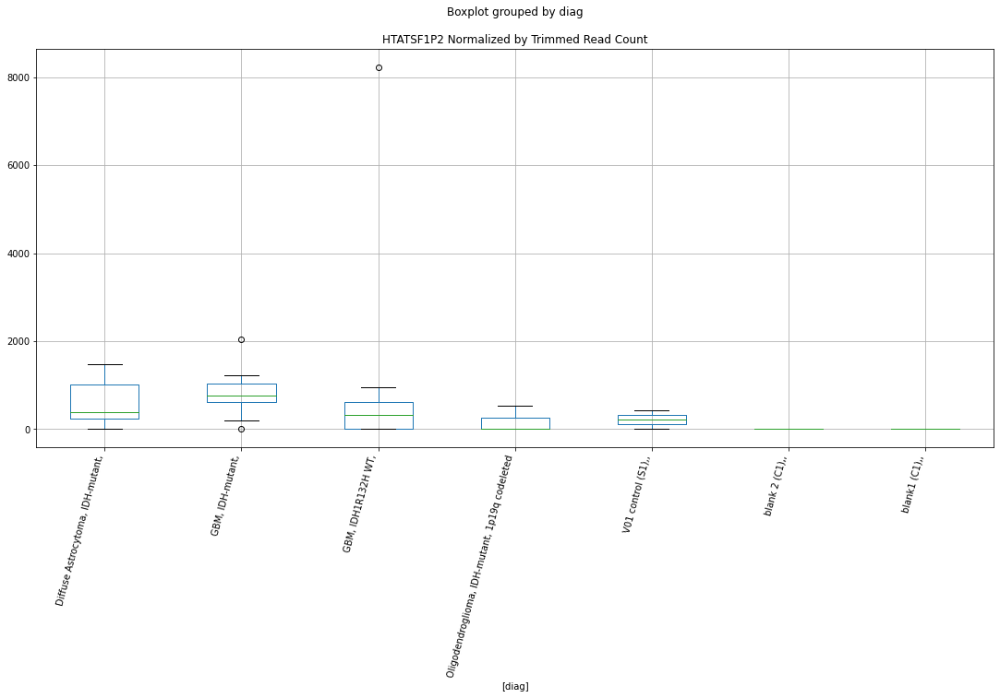

 p : 0.020285553404647837  ( t : 2.545598299202416 ) :  Lexogen  :  bbduk2  :  HTATSF1P2
Control and blanks
79       0.00
343    424.63
Name: HTATSF1P2, dtype: float64
211    0.0
Name: HTATSF1P2, dtype: float64
475    0.0
Name: HTATSF1P2, dtype: float64


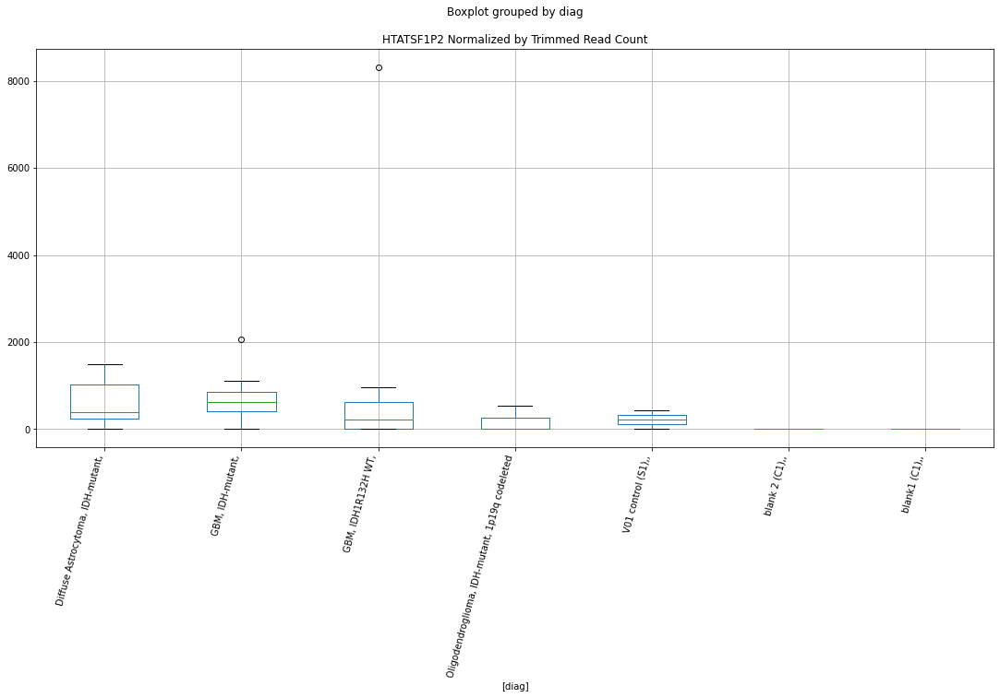

 p : 0.020530604603632544  ( t : 2.539850393619439 ) :  D-plex  :  cutadapt2  :  GPRC6A
Control and blanks
76       0.00
340    880.73
Name: GPRC6A, dtype: float64
208    4409.01
Name: GPRC6A, dtype: float64
472    4045.69
Name: GPRC6A, dtype: float64


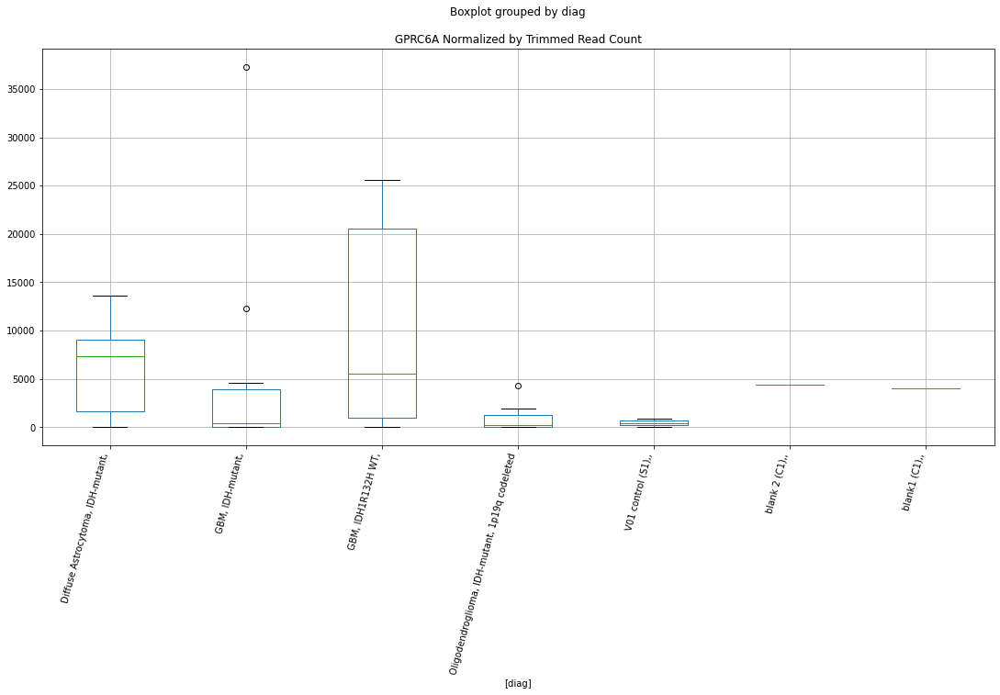

 p : 0.020552900286467425  ( t : 2.539330650336886 ) :  D-plex  :  bbduk2  :  HAUS6
Control and blanks
73     115951.26
337         0.00
Name: HAUS6, dtype: float64
205    3402.73
Name: HAUS6, dtype: float64
469    3549.16
Name: HAUS6, dtype: float64


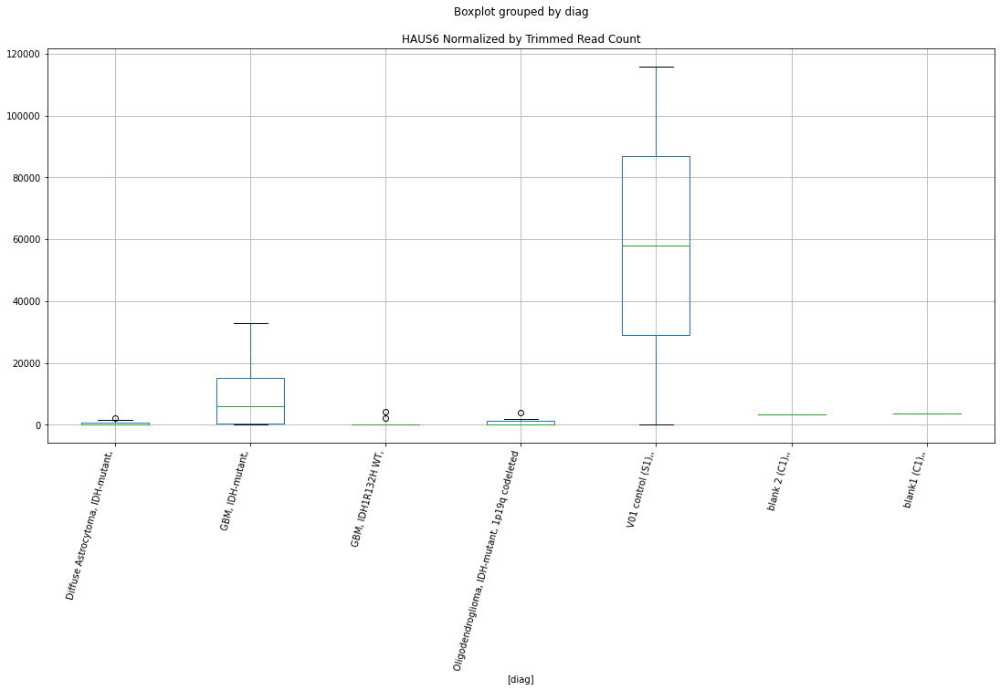

 p : 0.020687262910598716  ( t : 2.5362097059579822 ) :  D-plex  :  cutadapt2  :  ISL2
Control and blanks
76       0.00
340    880.73
Name: ISL2, dtype: float64
208    176.36
Name: ISL2, dtype: float64
472    0.0
Name: ISL2, dtype: float64


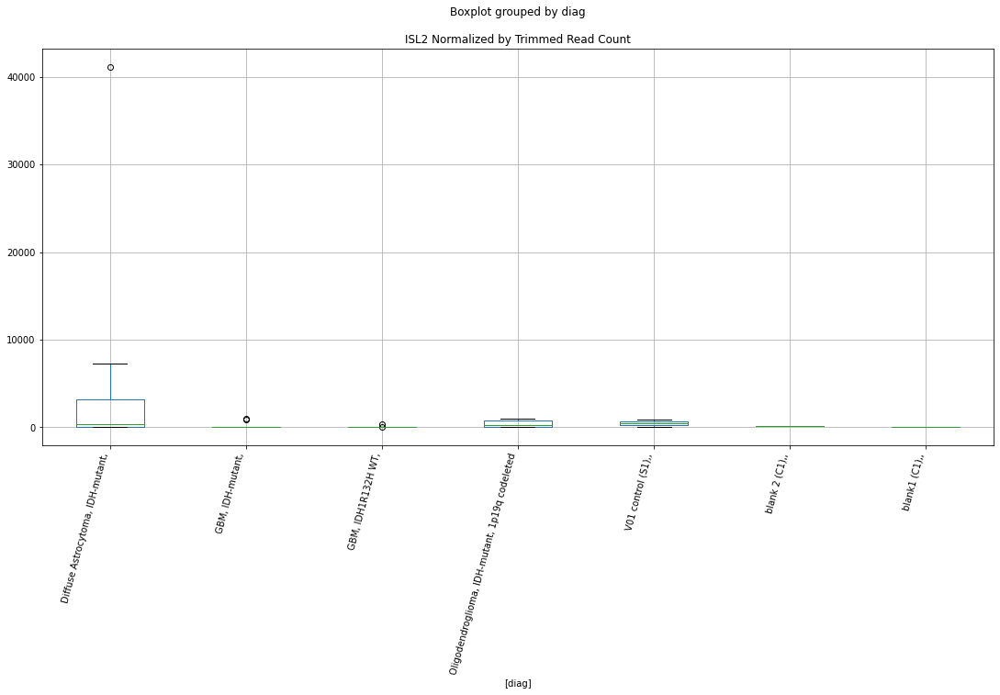

 p : 0.020736723136962832  ( t : 2.535065675945067 ) :  D-plex  :  bbduk2  :  GPRC6A
Control and blanks
73       0.00
337    890.16
Name: GPRC6A, dtype: float64
205    4298.18
Name: GPRC6A, dtype: float64
469    4140.69
Name: GPRC6A, dtype: float64


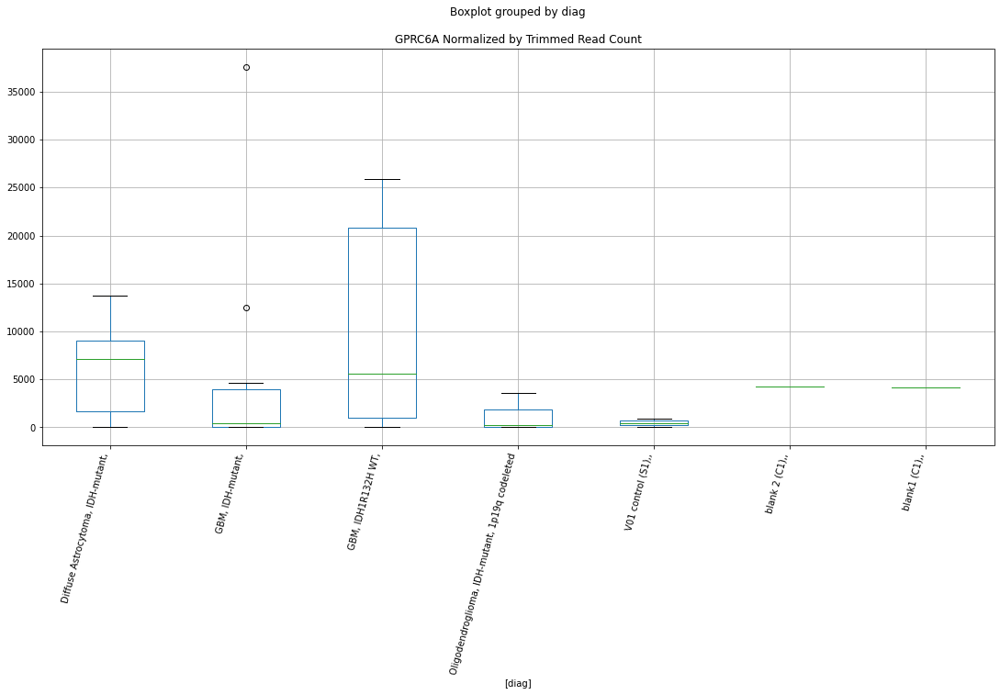

 p : 0.02085855945340103  ( t : 2.5322585238636703 ) :  D-plex  :  cutadapt2  :  KCND3
Control and blanks
76     0.0
340    0.0
Name: KCND3, dtype: float64
208    10581.61
Name: KCND3, dtype: float64
472    19650.5
Name: KCND3, dtype: float64


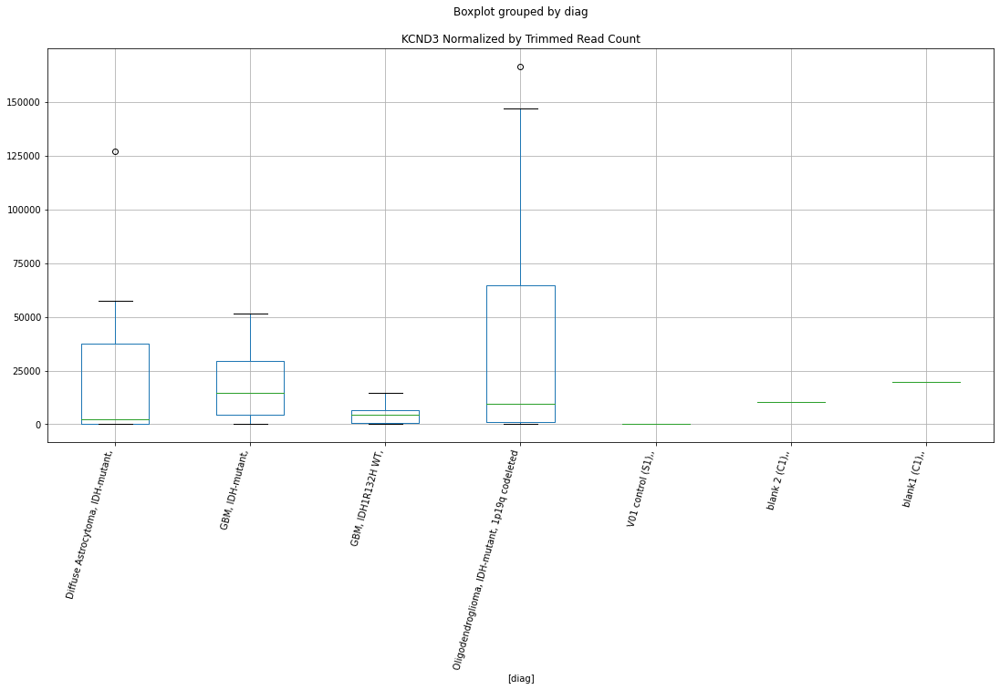

 p : 0.020864176174260656  ( t : 2.5321294864102843 ) :  D-plex  :  cutadapt2  :  GJA8
Control and blanks
76     0.0
340    0.0
Name: GJA8, dtype: float64
208    881.8
Name: GJA8, dtype: float64
472    577.96
Name: GJA8, dtype: float64


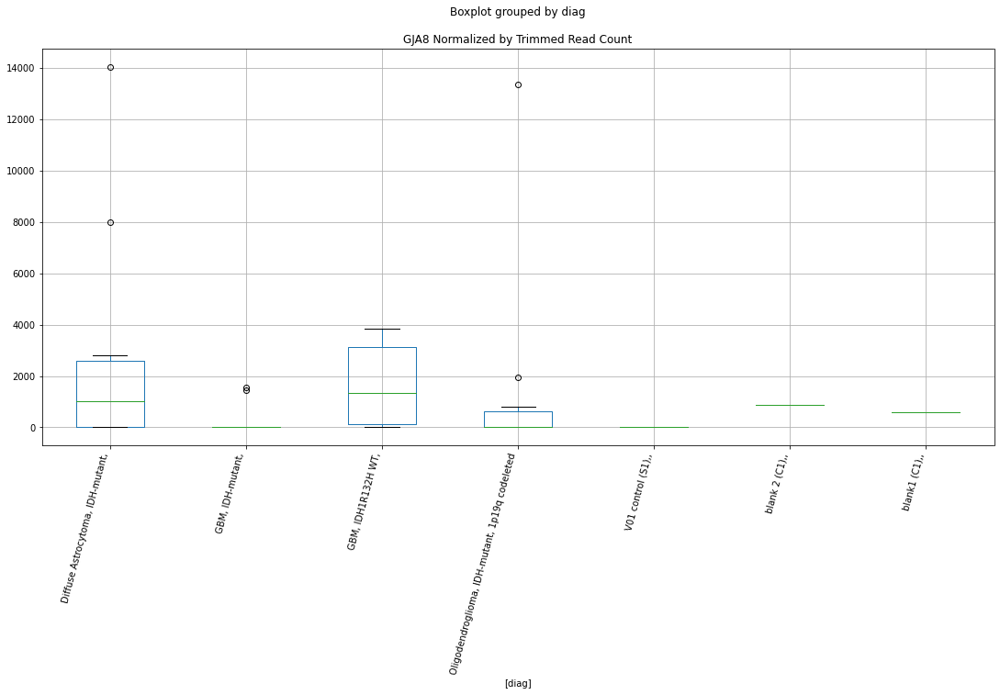

 p : 0.020974219956048108  ( t : 2.5296079580563005 ) :  D-plex  :  bbduk2  :  EVI5
Control and blanks
73     0.0
337    0.0
Name: EVI5, dtype: float64
205    32057.28
Name: EVI5, dtype: float64
469    7098.33
Name: EVI5, dtype: float64


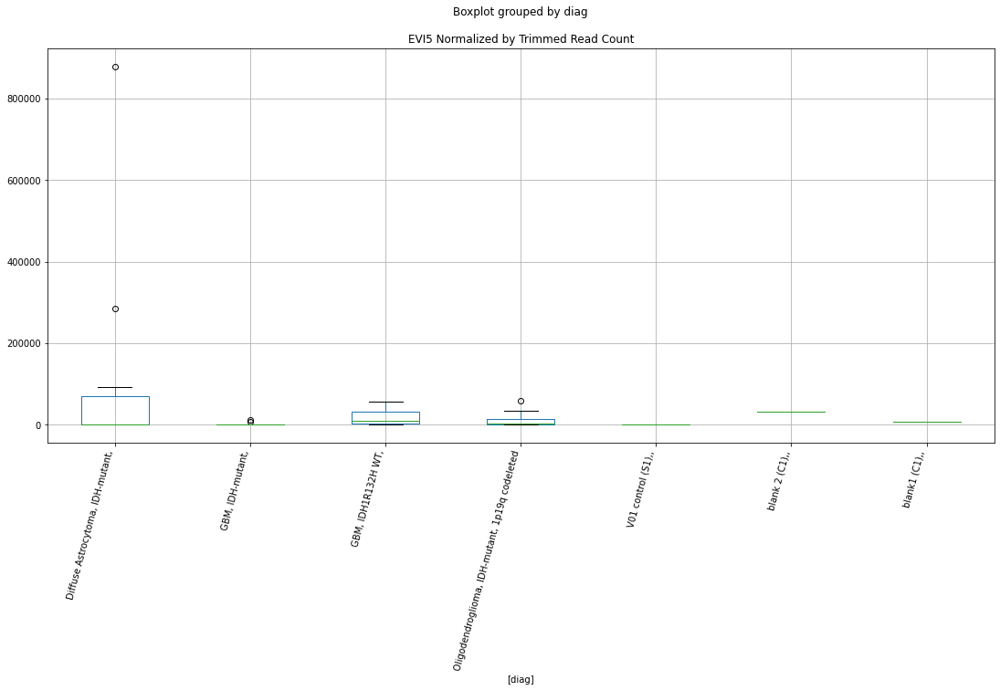

 p : 0.021166167958331625  ( t : 2.5252394396141233 ) :  D-plex  :  bbduk2  :  EVC
Control and blanks
73     3092.03
337       0.00
Name: EVC, dtype: float64
205    19341.82
Name: EVC, dtype: float64
469    15971.24
Name: EVC, dtype: float64


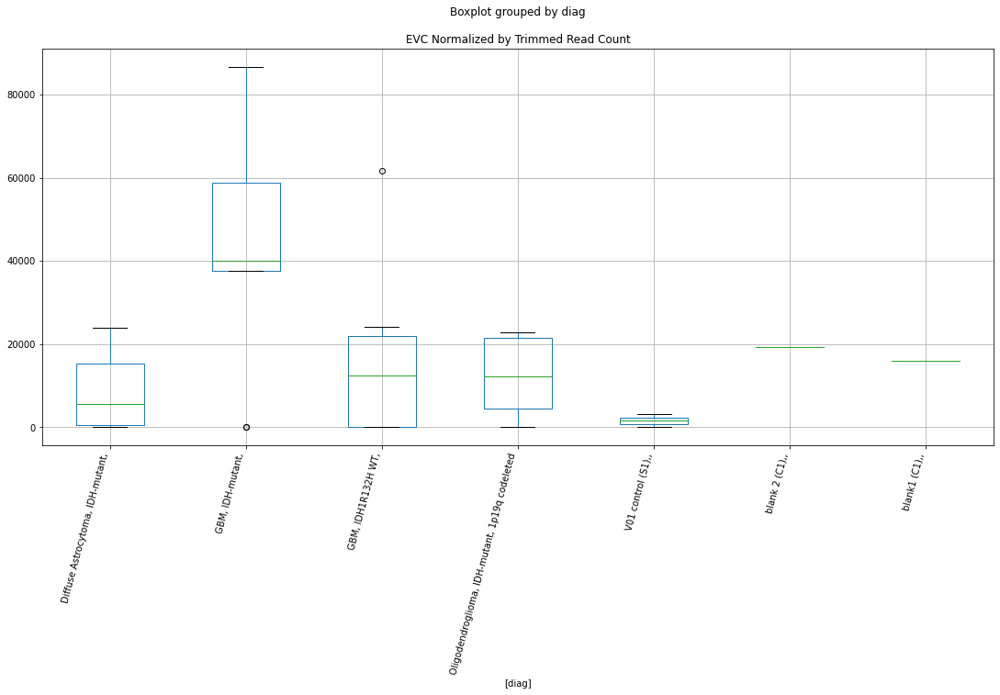

 p : 0.021168025213325125  ( t : 2.5251973535947196 ) :  D-plex  :  cutadapt2  :  IL6R
Control and blanks
76     7576.14
340       0.00
Name: IL6R, dtype: float64
208    5290.81
Name: IL6R, dtype: float64
472    3467.74
Name: IL6R, dtype: float64


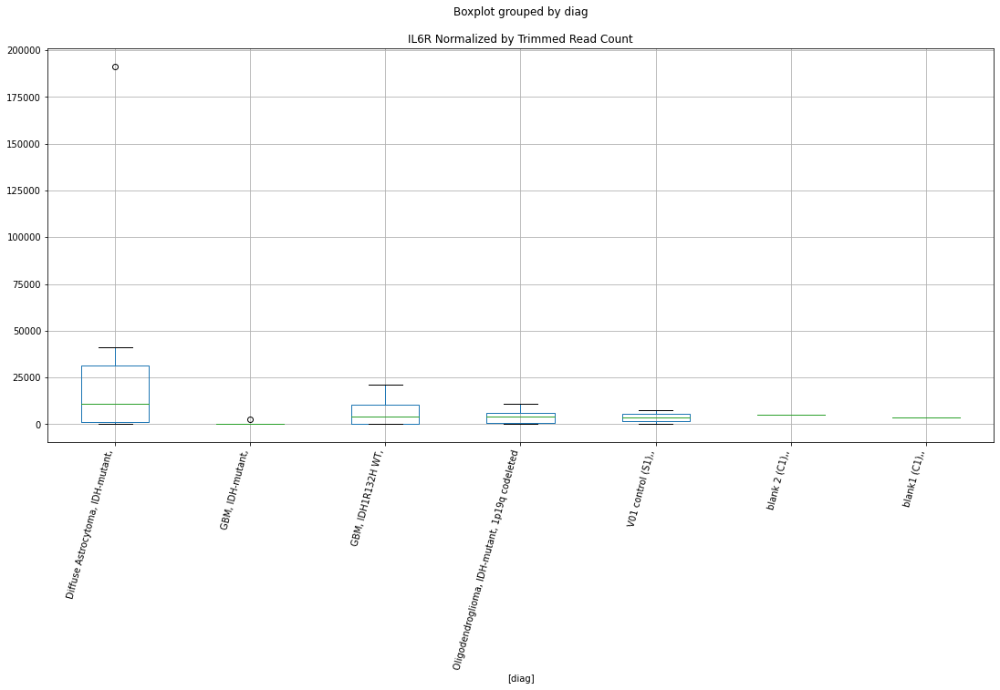

 p : 0.021169503950260526  ( t : 2.5251638474137867 ) :  D-plex  :  bbduk2  :  GXYLT1
Control and blanks
73     0.0
337    0.0
Name: GXYLT1, dtype: float64
205    6447.27
Name: GXYLT1, dtype: float64
469    1183.05
Name: GXYLT1, dtype: float64


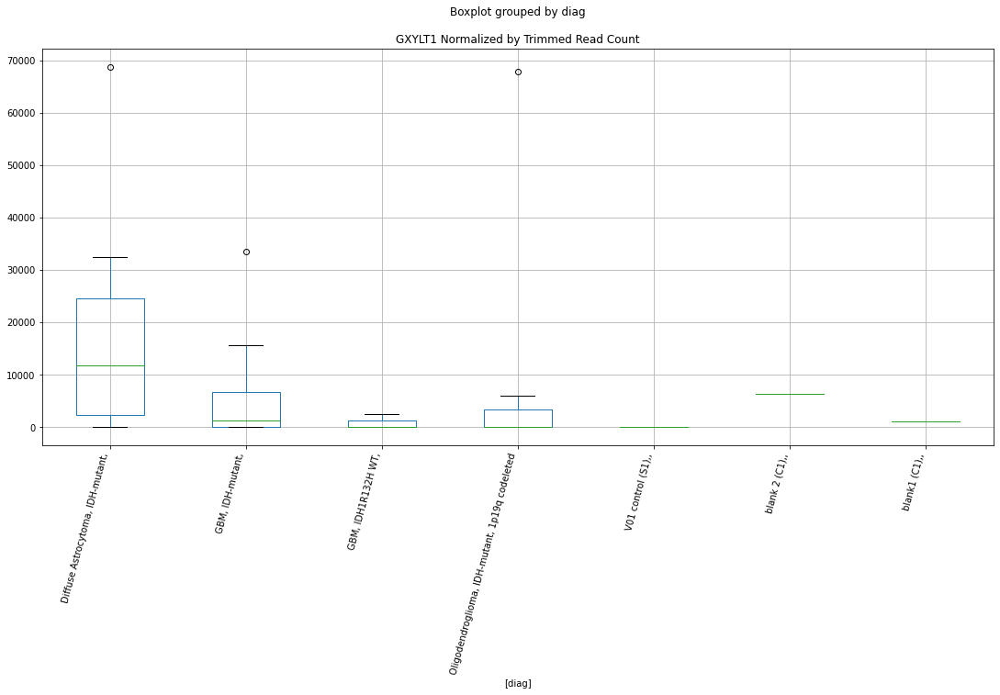

 p : 0.021287752096136106  ( t : 2.52249163095498 ) :  D-plex  :  bbduk2  :  DMAP1
Control and blanks
73     0.0
337    0.0
Name: DMAP1, dtype: float64
205    2149.09
Name: DMAP1, dtype: float64
469    0.0
Name: DMAP1, dtype: float64


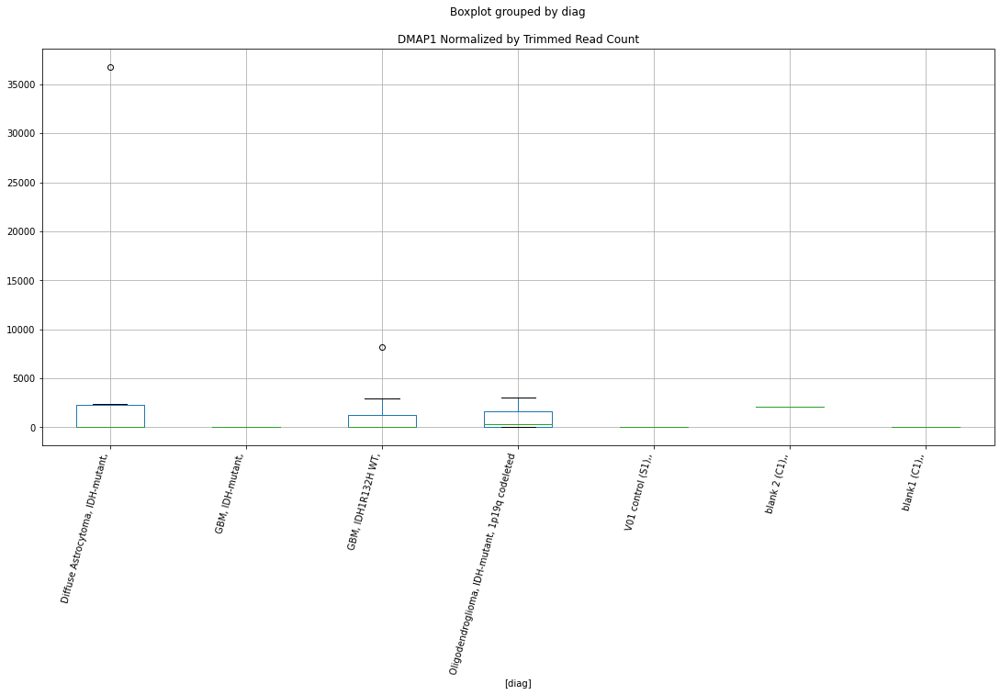

 p : 0.021388129861748834  ( t : 2.5202342279998975 ) :  D-plex  :  cutadapt2  :  GRAP2
Control and blanks
76     0.0
340    0.0
Name: GRAP2, dtype: float64
208    6348.97
Name: GRAP2, dtype: float64
472    6935.47
Name: GRAP2, dtype: float64


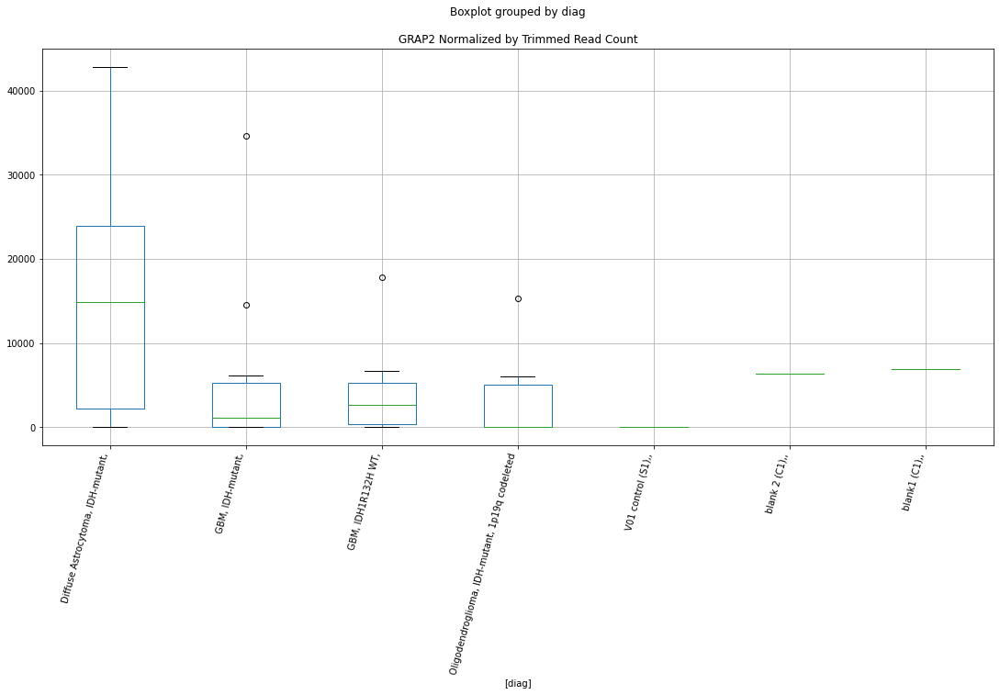

 p : 0.021403032422732175  ( t : 2.5198999359494074 ) :  Lexogen  :  cutadapt2  :  LARGE2
Control and blanks
82     0.0
346    0.0
Name: LARGE2, dtype: float64
214    0.0
Name: LARGE2, dtype: float64
478    0.0
Name: LARGE2, dtype: float64


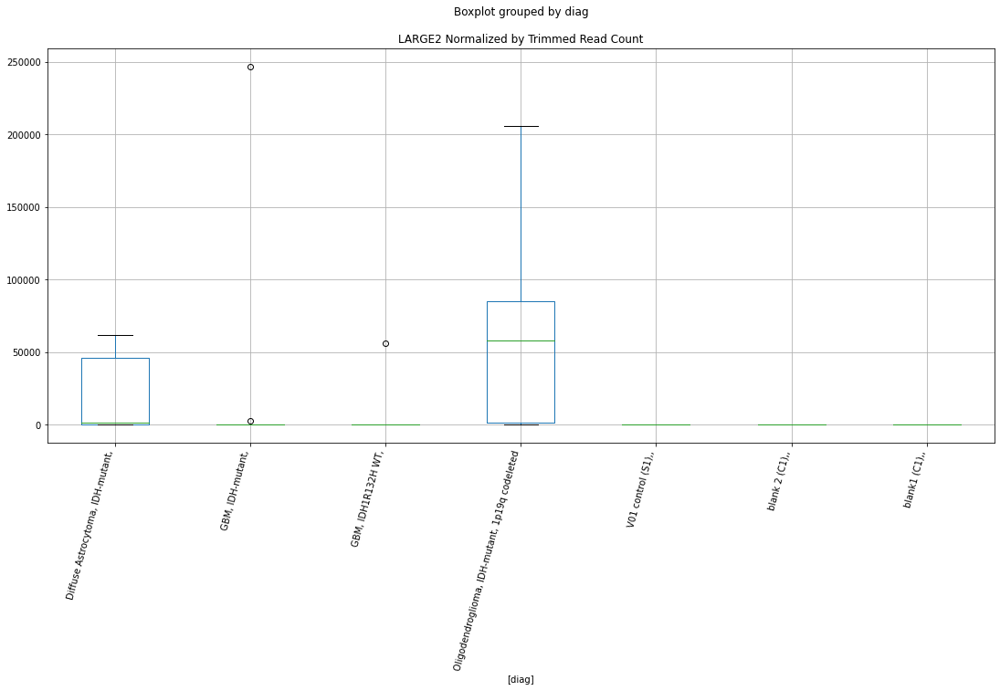

 p : 0.021417976377189965  ( t : 2.5195649358690146 ) :  Lexogen  :  cutadapt2  :  FBXL19
Control and blanks
82     0.0
346    0.0
Name: FBXL19, dtype: float64
214    0.0
Name: FBXL19, dtype: float64
478    0.0
Name: FBXL19, dtype: float64


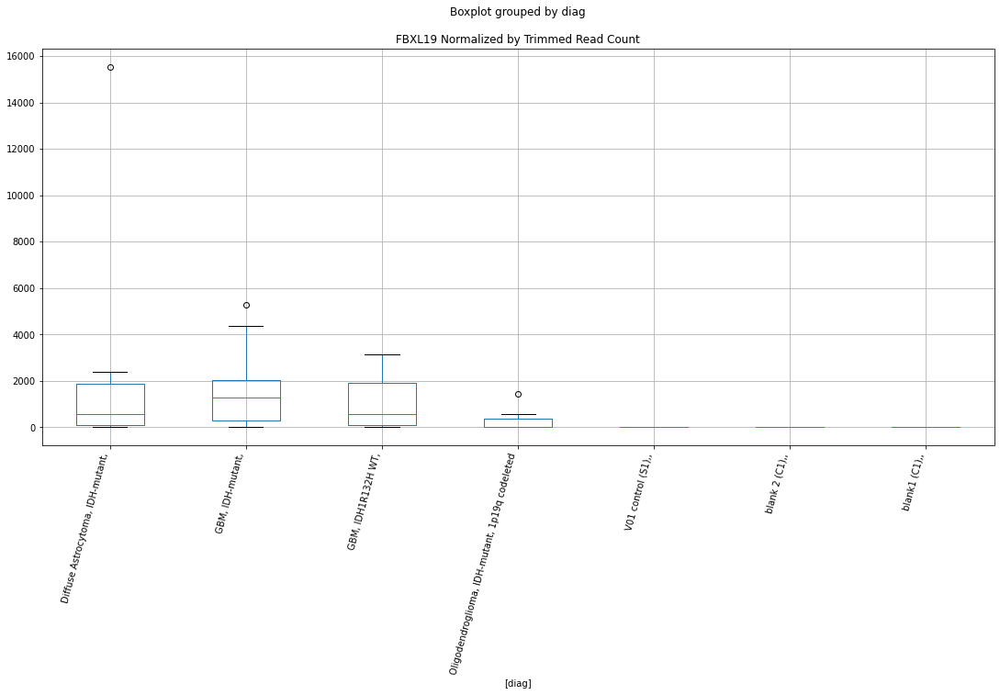

 p : 0.02156072708301265  ( t : 2.5163759493777693 ) :  D-plex  :  bbduk2  :  EIF2B5
Control and blanks
73         0.00
337    66761.79
Name: EIF2B5, dtype: float64
205    2149.09
Name: EIF2B5, dtype: float64
469    0.0
Name: EIF2B5, dtype: float64


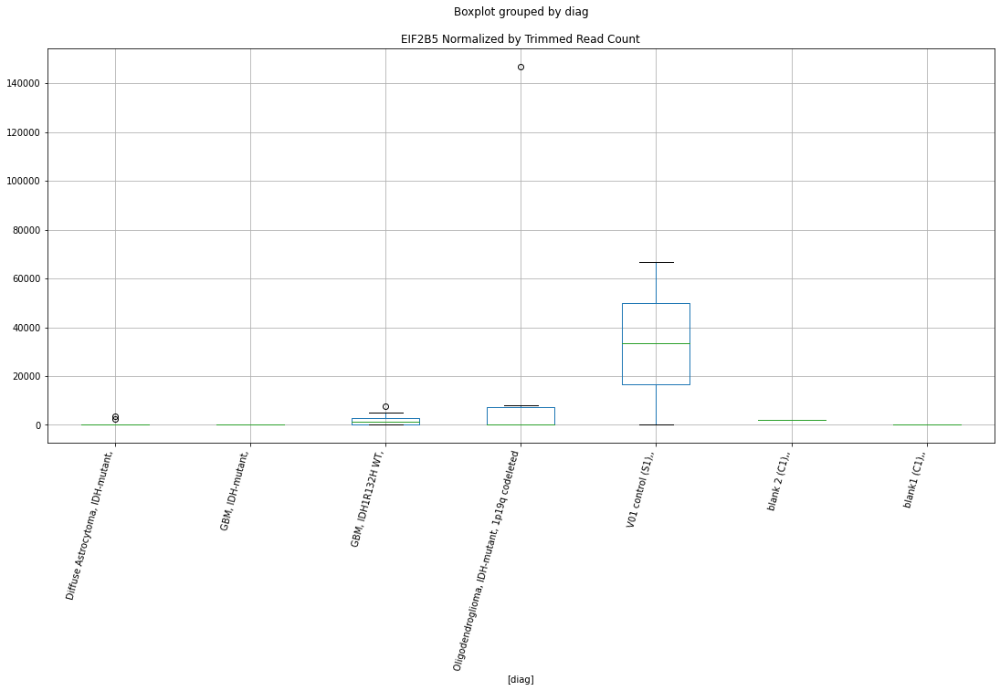

 p : 0.02158652303301374  ( t : 2.5158018055397604 ) :  Lexogen  :  cutadapt2  :  GOLGA2P2Y
Control and blanks
82      11360.41
346    328909.16
Name: GOLGA2P2Y, dtype: float64
214    48549.54
Name: GOLGA2P2Y, dtype: float64
478    55328.29
Name: GOLGA2P2Y, dtype: float64


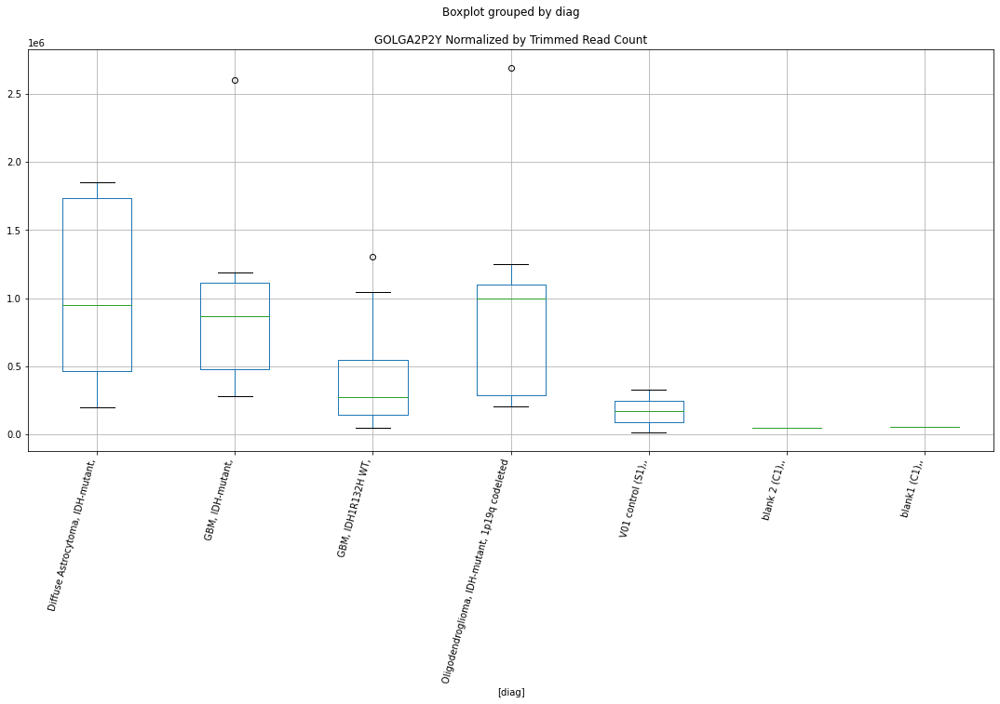

 p : 0.02158652303301374  ( t : 2.5158018055397604 ) :  Lexogen  :  cutadapt2  :  GOLGA2P3Y
Control and blanks
82      11360.41
346    328909.16
Name: GOLGA2P3Y, dtype: float64
214    48549.54
Name: GOLGA2P3Y, dtype: float64
478    55328.29
Name: GOLGA2P3Y, dtype: float64


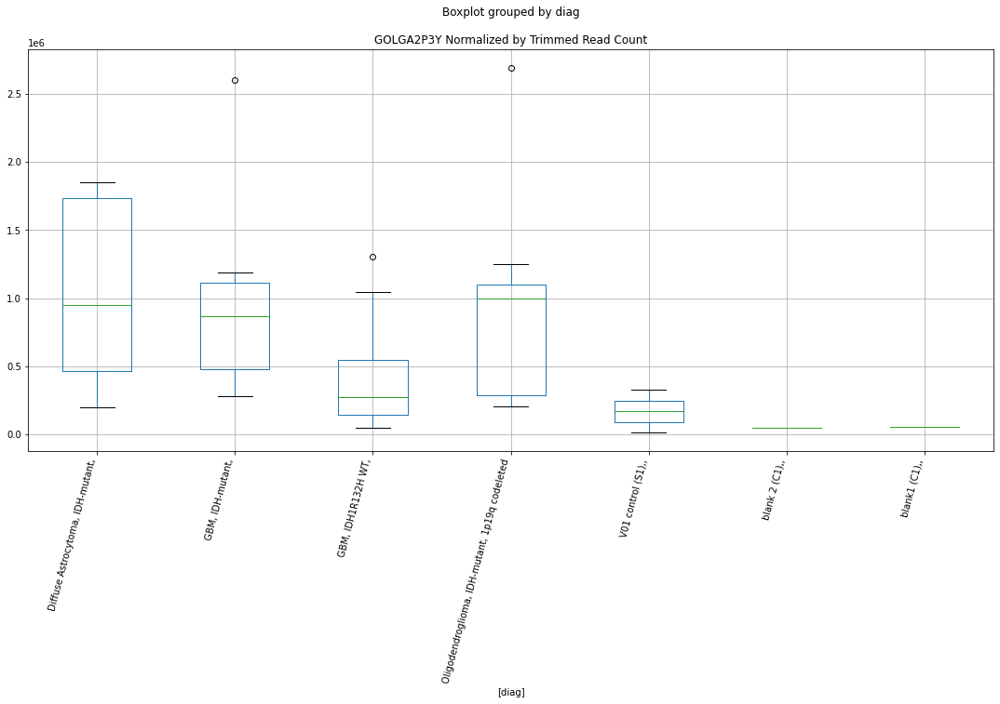

 p : 0.021638611527476898  ( t : 2.5146444355399202 ) :  Lexogen  :  bbduk2  :  GOLGA2P2Y
Control and blanks
79      10014.19
343    330361.07
Name: GOLGA2P2Y, dtype: float64
211    48648.53
Name: GOLGA2P2Y, dtype: float64
475    55807.17
Name: GOLGA2P2Y, dtype: float64


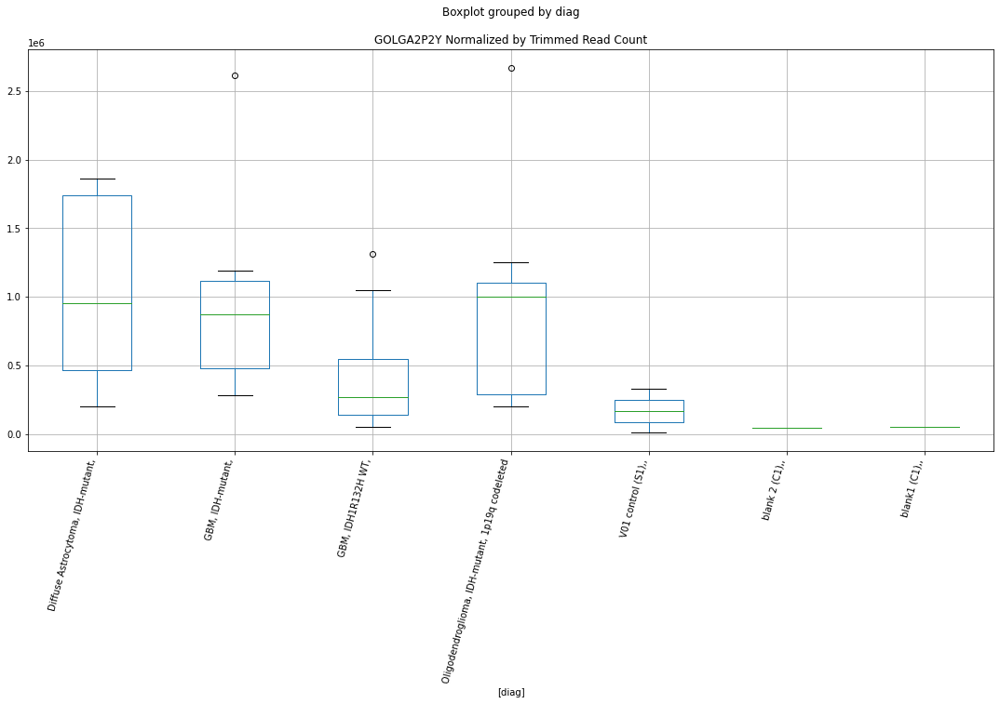

 p : 0.021638611527476898  ( t : 2.5146444355399202 ) :  Lexogen  :  bbduk2  :  GOLGA2P3Y
Control and blanks
79      10014.19
343    330361.07
Name: GOLGA2P3Y, dtype: float64
211    48648.53
Name: GOLGA2P3Y, dtype: float64
475    55807.17
Name: GOLGA2P3Y, dtype: float64


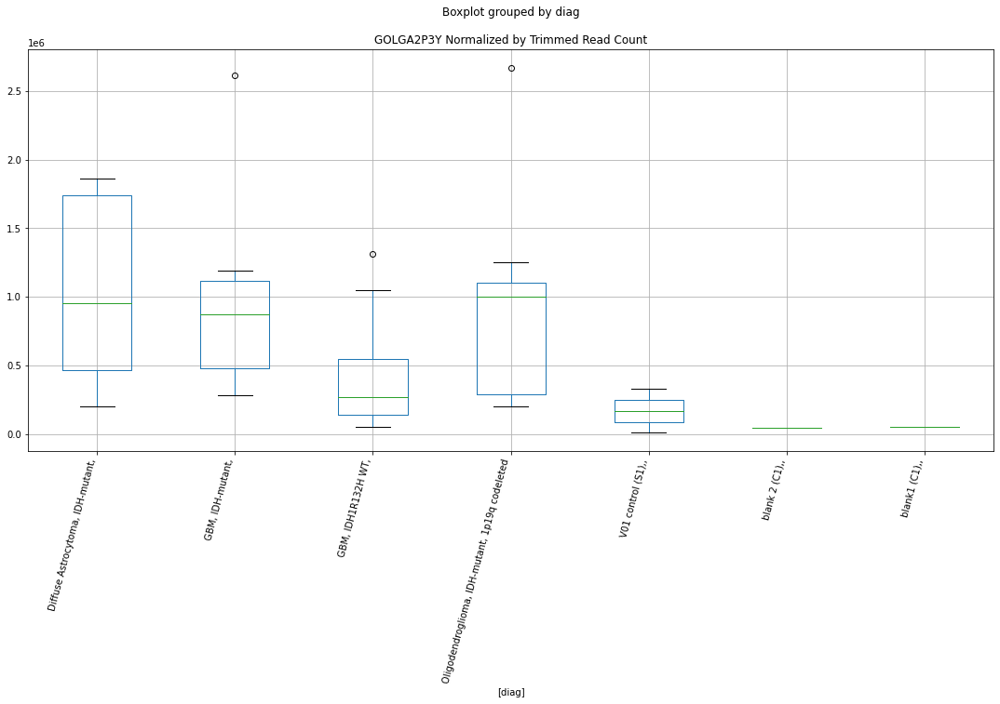

 p : 0.02166034655130022  ( t : 2.514162275450714 ) :  Lexogen  :  cutadapt2  :  GOLGA2P7
Control and blanks
82      11360.41
346    328909.16
Name: GOLGA2P7, dtype: float64
214    48549.54
Name: GOLGA2P7, dtype: float64
478    55328.29
Name: GOLGA2P7, dtype: float64


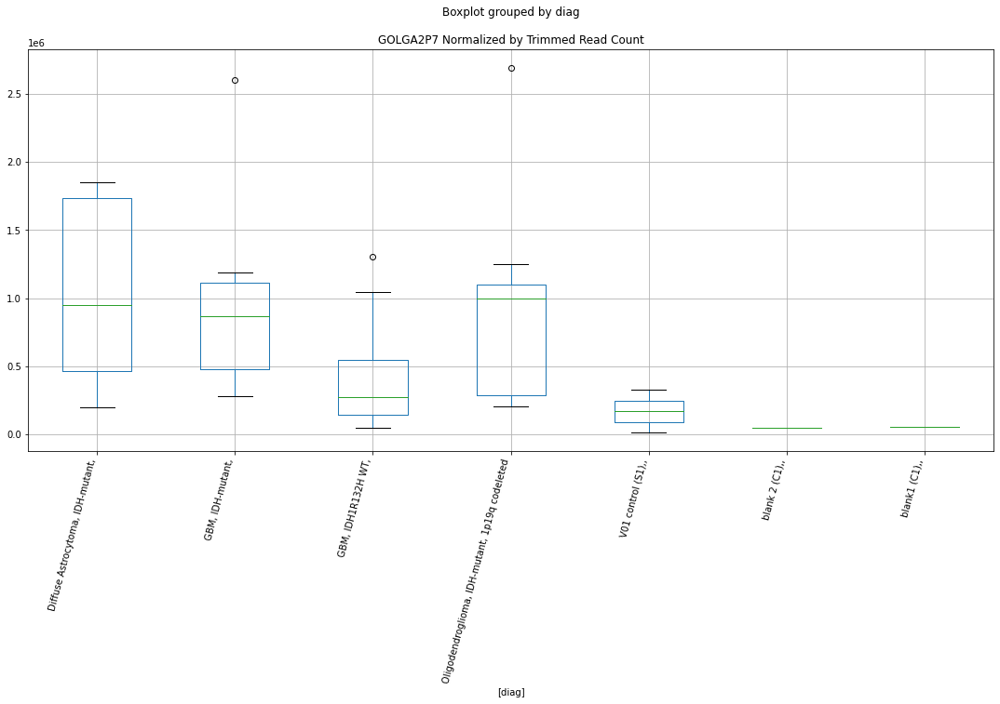

 p : 0.02166034655130026  ( t : 2.5141622754507136 ) :  Lexogen  :  cutadapt2  :  GOLGA2P10
Control and blanks
82     6.82e+04
346    1.97e+06
Name: GOLGA2P10, dtype: float64
214    291297.21
Name: GOLGA2P10, dtype: float64
478    331969.76
Name: GOLGA2P10, dtype: float64


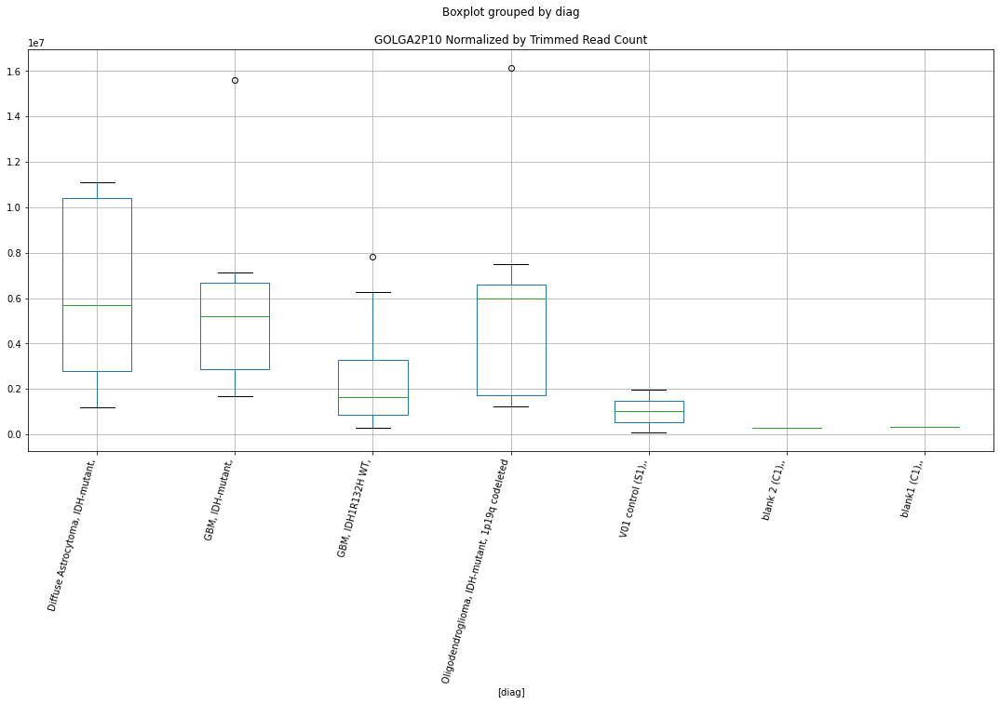

 p : 0.021712901708709893  ( t : 2.512998298572641 ) :  Lexogen  :  bbduk2  :  GOLGA2P7
Control and blanks
79      10014.19
343    330361.07
Name: GOLGA2P7, dtype: float64
211    48648.53
Name: GOLGA2P7, dtype: float64
475    55807.17
Name: GOLGA2P7, dtype: float64


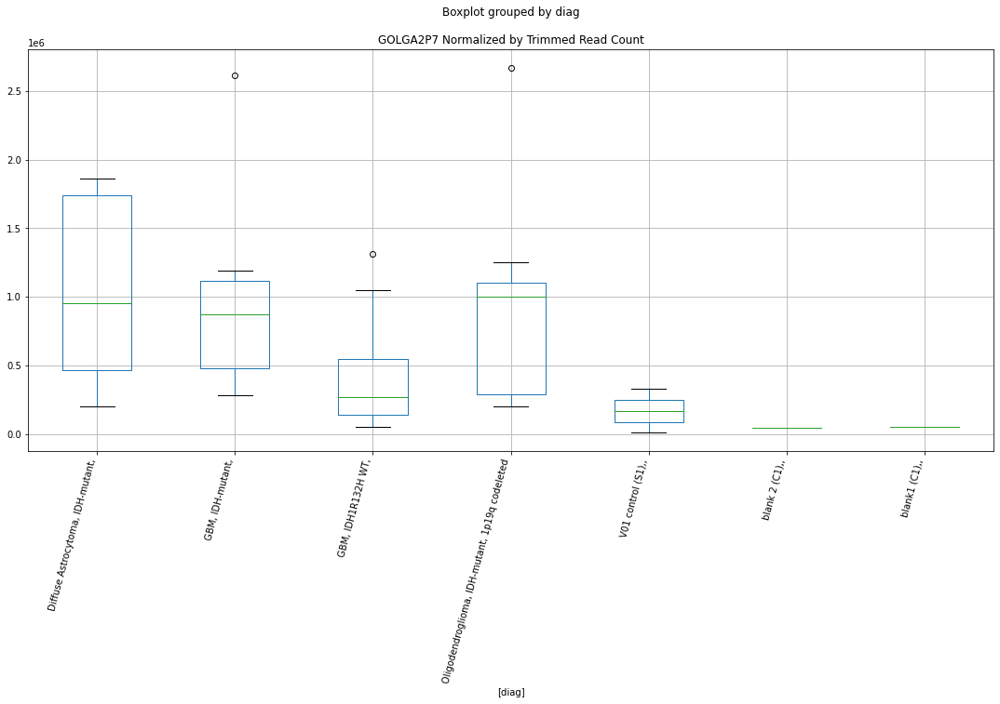

 p : 0.021716759184731323  ( t : 2.512912968995527 ) :  Lexogen  :  bbduk2  :  GOLGA2P10
Control and blanks
79     6.01e+04
343    1.98e+06
Name: GOLGA2P10, dtype: float64
211    291891.17
Name: GOLGA2P10, dtype: float64
475    334843.0
Name: GOLGA2P10, dtype: float64


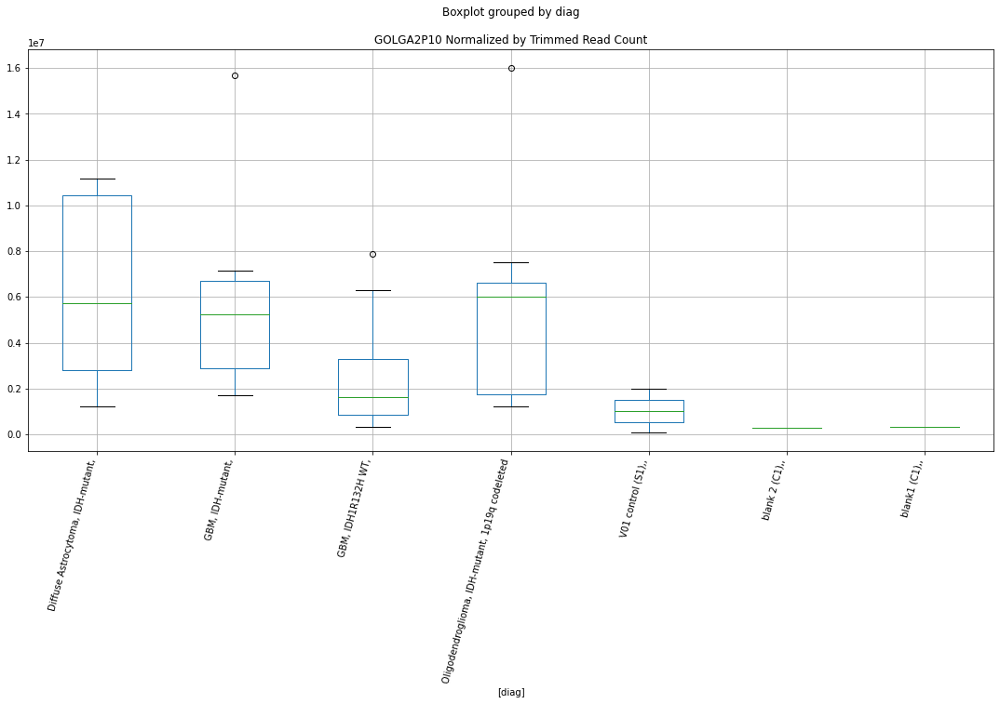

 p : 0.021819942016545395  ( t : 2.5106357950185707 ) :  Lexogen  :  bbduk2  :  FAIM2
Control and blanks
79       0.00
343    424.63
Name: FAIM2, dtype: float64
211    2186.45
Name: FAIM2, dtype: float64
475    0.0
Name: FAIM2, dtype: float64


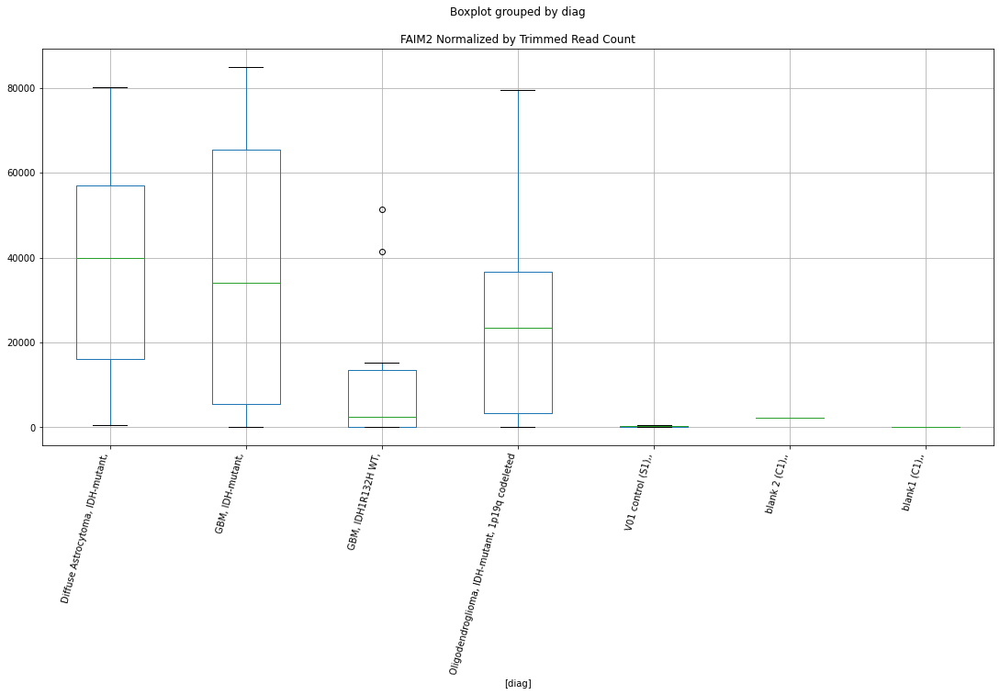

 p : 0.021829350008263297  ( t : 2.510428672615853 ) :  Lexogen  :  cutadapt2  :  ILRUN
Control and blanks
82       0.00
346    841.74
Name: ILRUN, dtype: float64
214    1084.91
Name: ILRUN, dtype: float64
478    0.0
Name: ILRUN, dtype: float64


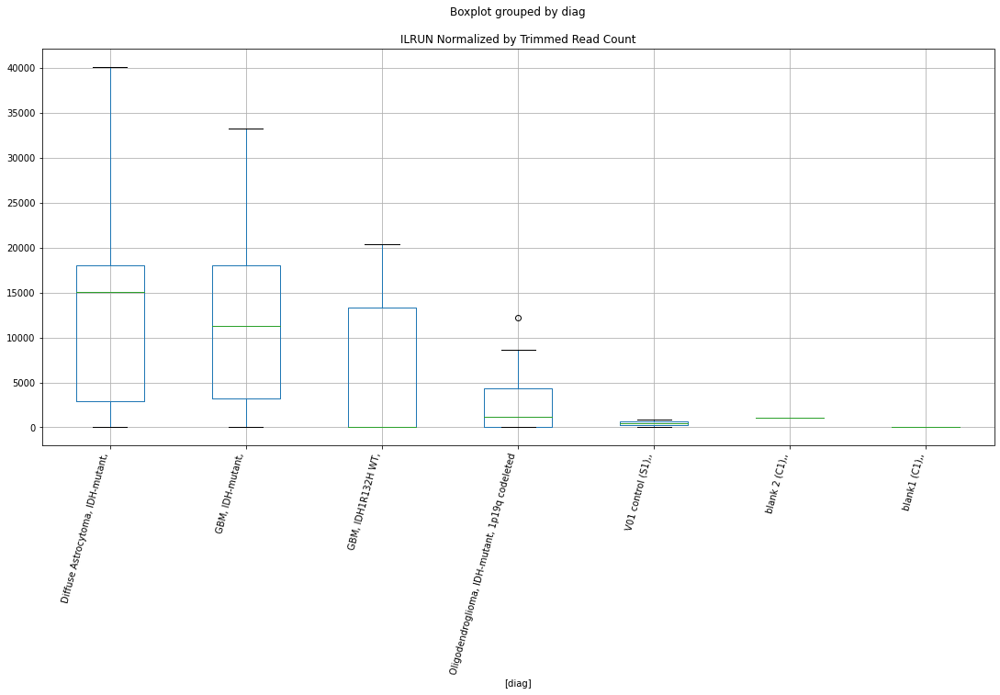

 p : 0.02185665654049765  ( t : 2.509827979853971 ) :  D-plex  :  cutadapt2  :  GHITM
Control and blanks
76     0.0
340    0.0
Name: GHITM, dtype: float64
208    529.08
Name: GHITM, dtype: float64
472    1155.91
Name: GHITM, dtype: float64


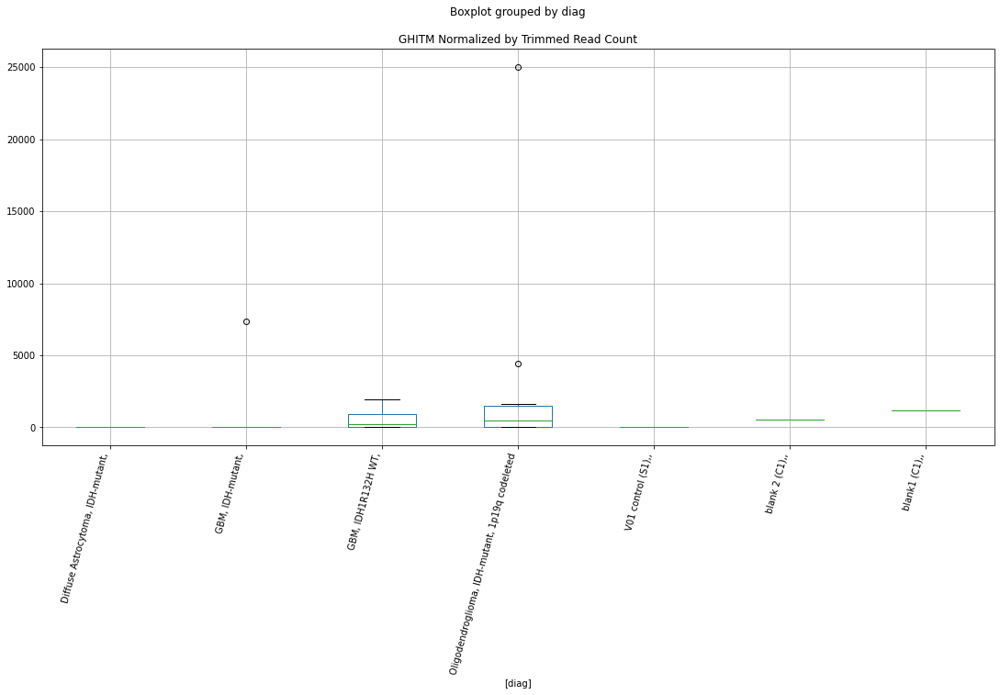

 p : 0.02187298033339123  ( t : 2.509469224766619 ) :  D-plex  :  bbduk2  :  GRAP2
Control and blanks
73     0.0
337    0.0
Name: GRAP2, dtype: float64
205    6447.27
Name: GRAP2, dtype: float64
469    7098.33
Name: GRAP2, dtype: float64


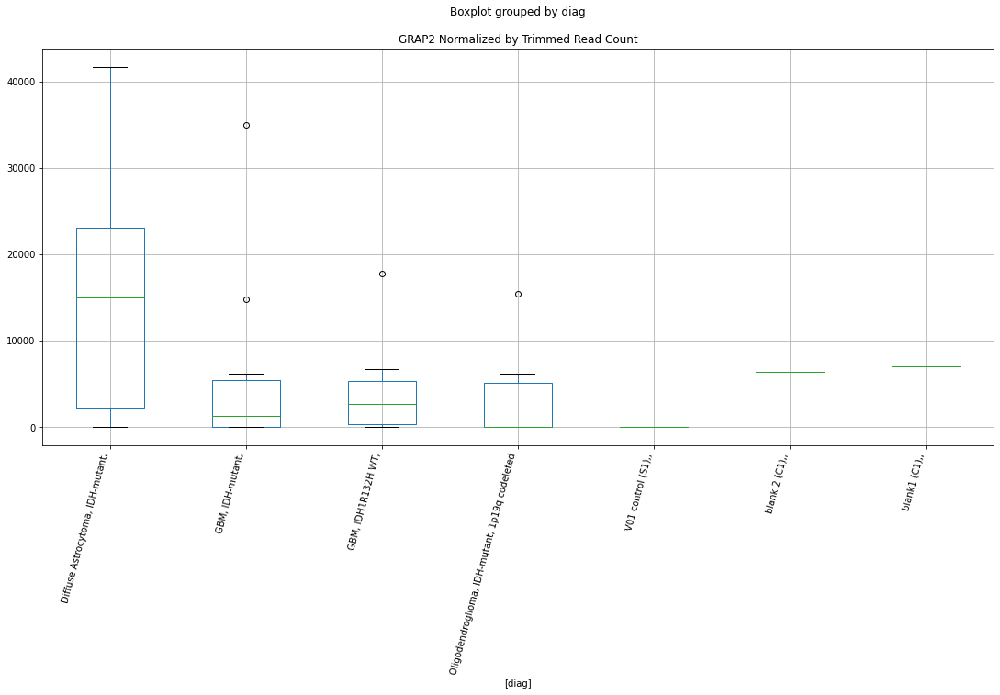

 p : 0.022083804068809765  ( t : 2.5048584067681308 ) :  Lexogen  :  cutadapt2  :  FAIM2
Control and blanks
82       0.00
346    420.87
Name: FAIM2, dtype: float64
214    2169.81
Name: FAIM2, dtype: float64
478    0.0
Name: FAIM2, dtype: float64


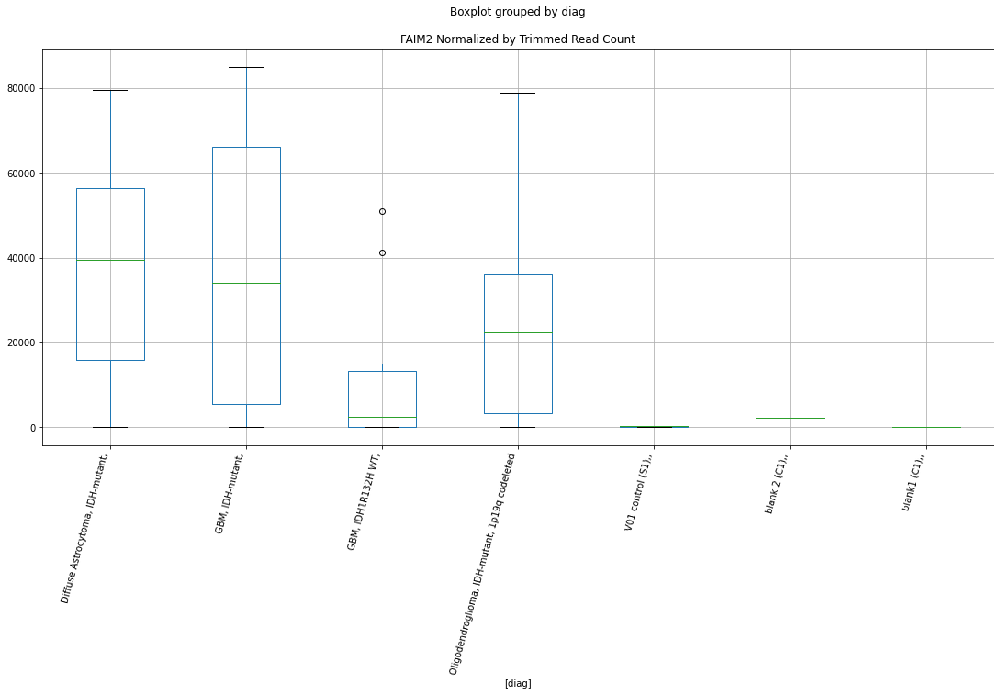

 p : 0.022237824321569847  ( t : 2.501516065735702 ) :  D-plex  :  cutadapt2  :  IGDCC3
Control and blanks
76     3030.46
340    1761.46
Name: IGDCC3, dtype: float64
208    4232.65
Name: IGDCC3, dtype: float64
472    6357.51
Name: IGDCC3, dtype: float64


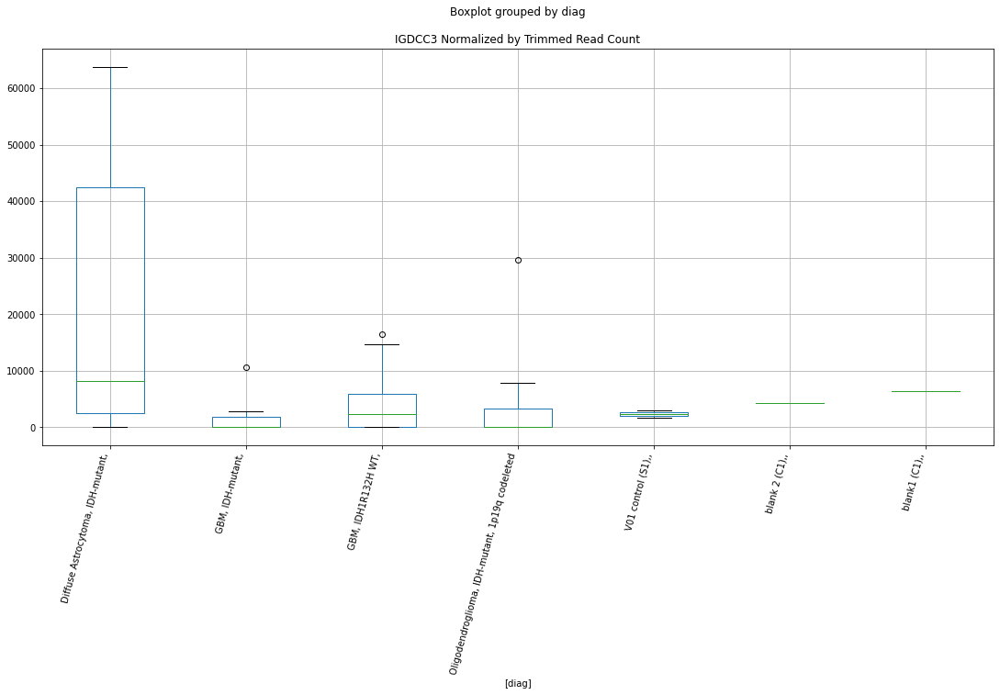

 p : 0.022272895139568462  ( t : 2.500758056119171 ) :  Lexogen  :  bbduk2  :  LARGE2
Control and blanks
79     0.0
343    0.0
Name: LARGE2, dtype: float64
211    0.0
Name: LARGE2, dtype: float64
475    0.0
Name: LARGE2, dtype: float64


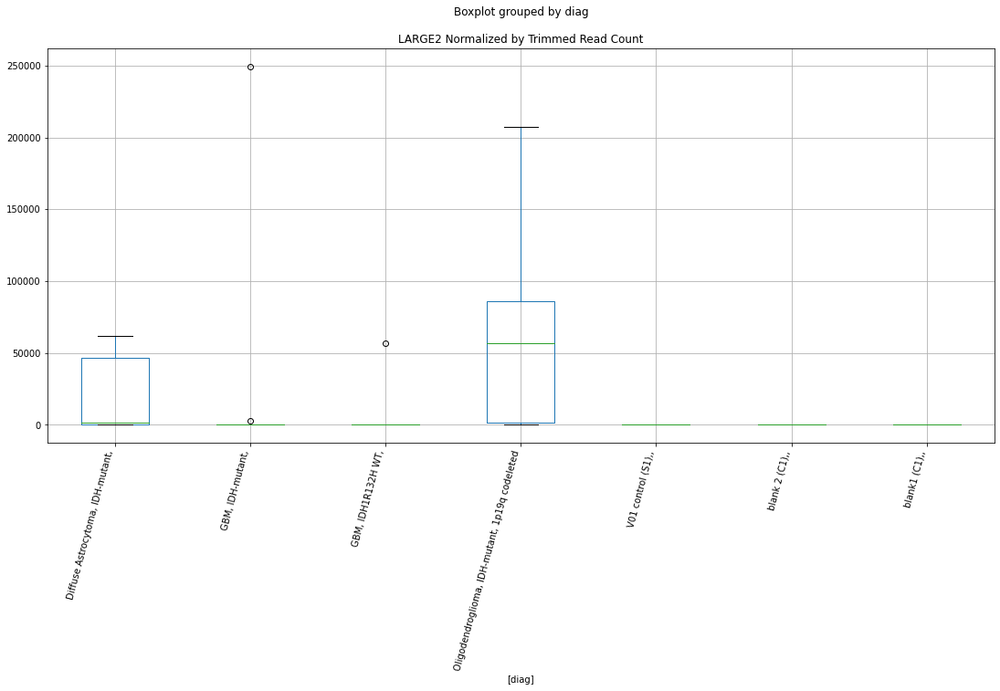

 p : 0.02231279829787898  ( t : 2.49989696855711 ) :  D-plex  :  bbduk2  :  GIPC1
Control and blanks
73     313841.41
337         0.00
Name: GIPC1, dtype: float64
205    30266.37
Name: GIPC1, dtype: float64
469    14788.18
Name: GIPC1, dtype: float64


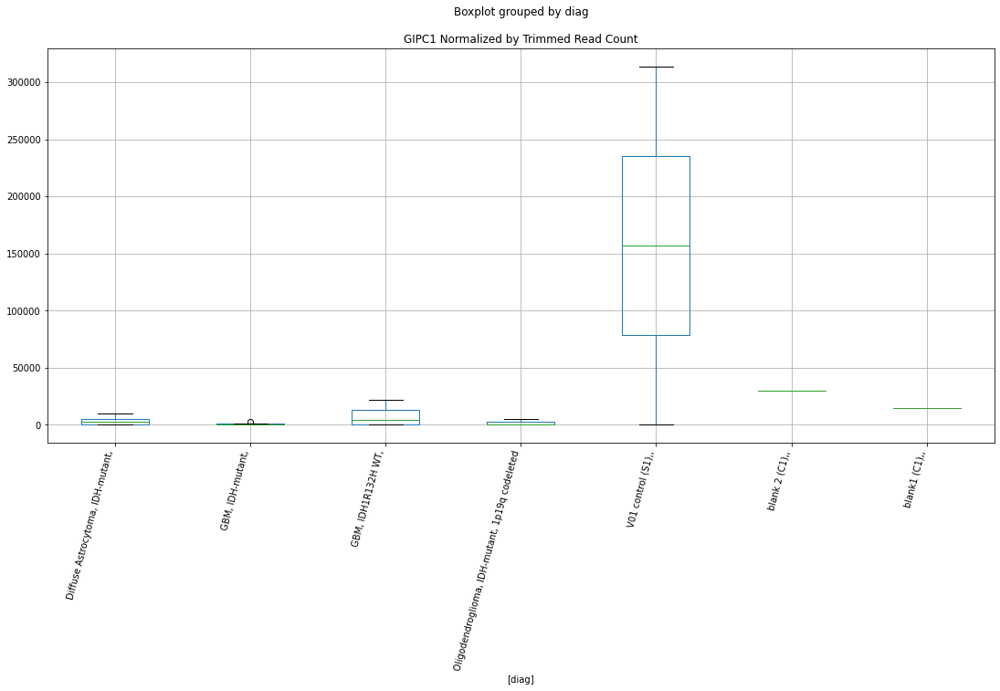

 p : 0.022392306366314996  ( t : 2.4981855470431897 ) :  D-plex  :  bbduk2  :  ENO4
Control and blanks
73     773.01
337      0.00
Name: ENO4, dtype: float64
205    3044.55
Name: ENO4, dtype: float64
469    2957.64
Name: ENO4, dtype: float64


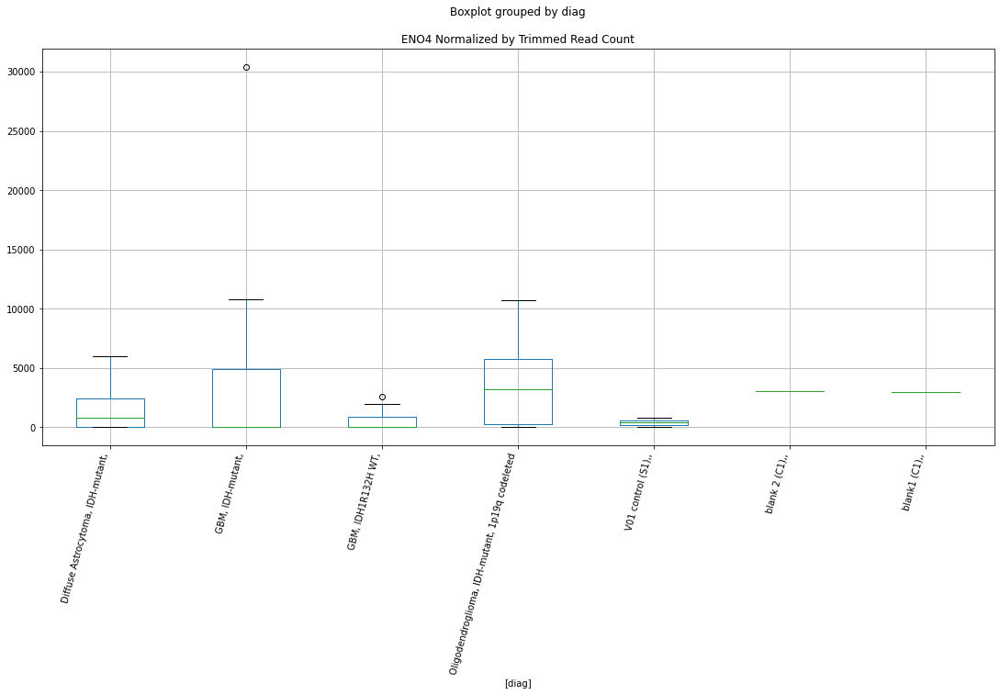

 p : 0.02257442154289812  ( t : 2.494286970239071 ) :  Lexogen  :  cutadapt2  :  ISLR2
Control and blanks
82     59642.15
346     2525.21
Name: ISLR2, dtype: float64
214    0.0
Name: ISLR2, dtype: float64
478    0.0
Name: ISLR2, dtype: float64


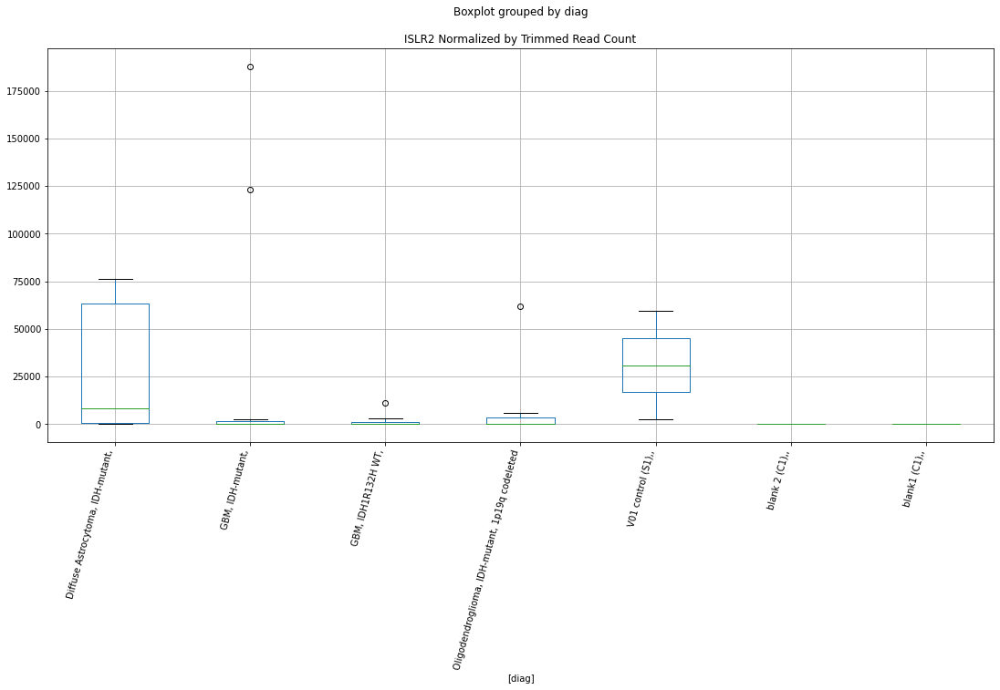

 p : 0.022663580222028117  ( t : 2.492389122568954 ) :  Lexogen  :  cutadapt2  :  FTSJ1
Control and blanks
82       0.00
346    841.74
Name: FTSJ1, dtype: float64
214    10849.06
Name: FTSJ1, dtype: float64
478    0.0
Name: FTSJ1, dtype: float64


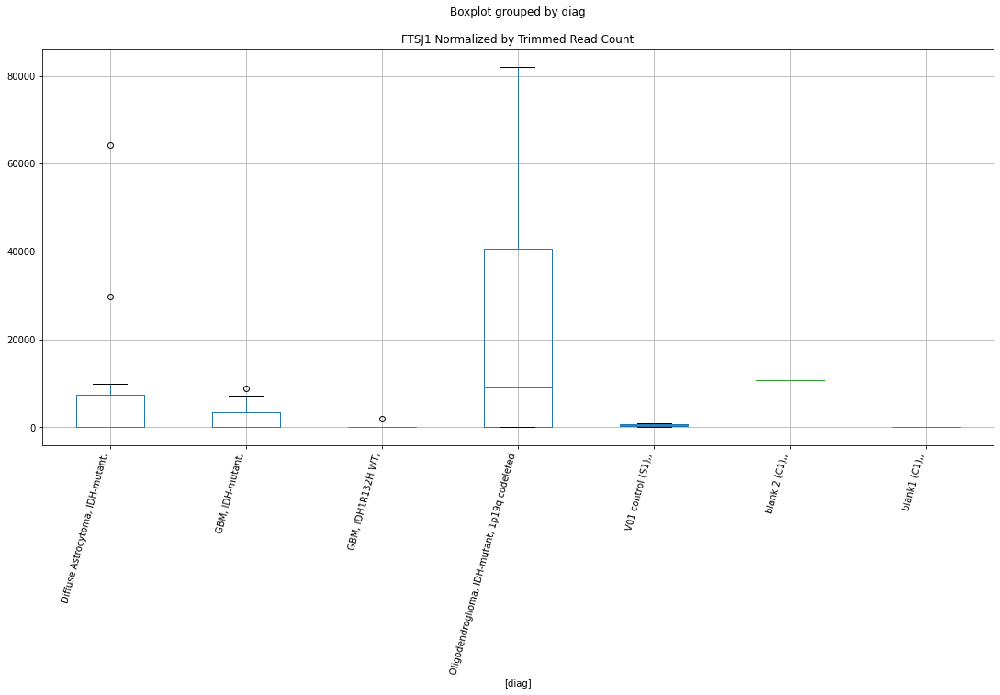

 p : 0.022703062494429053  ( t : 2.4915509412715995 ) :  D-plex  :  bbduk2  :  KCNQ3
Control and blanks
73     773.01
337      0.00
Name: KCNQ3, dtype: float64
205    6805.46
Name: KCNQ3, dtype: float64
469    10647.49
Name: KCNQ3, dtype: float64


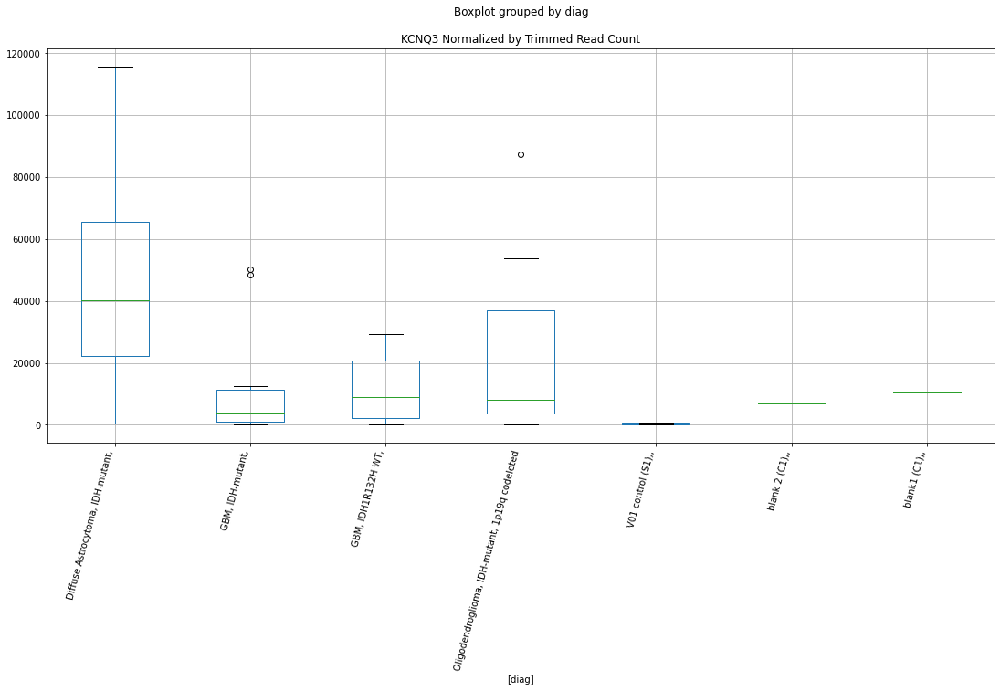

 p : 0.02275675250585352  ( t : 2.4904133393974415 ) :  D-plex  :  bbduk2  :  ELF2
Control and blanks
73         0.0
337    18693.3
Name: ELF2, dtype: float64
205    21490.91
Name: ELF2, dtype: float64
469    24252.62
Name: ELF2, dtype: float64


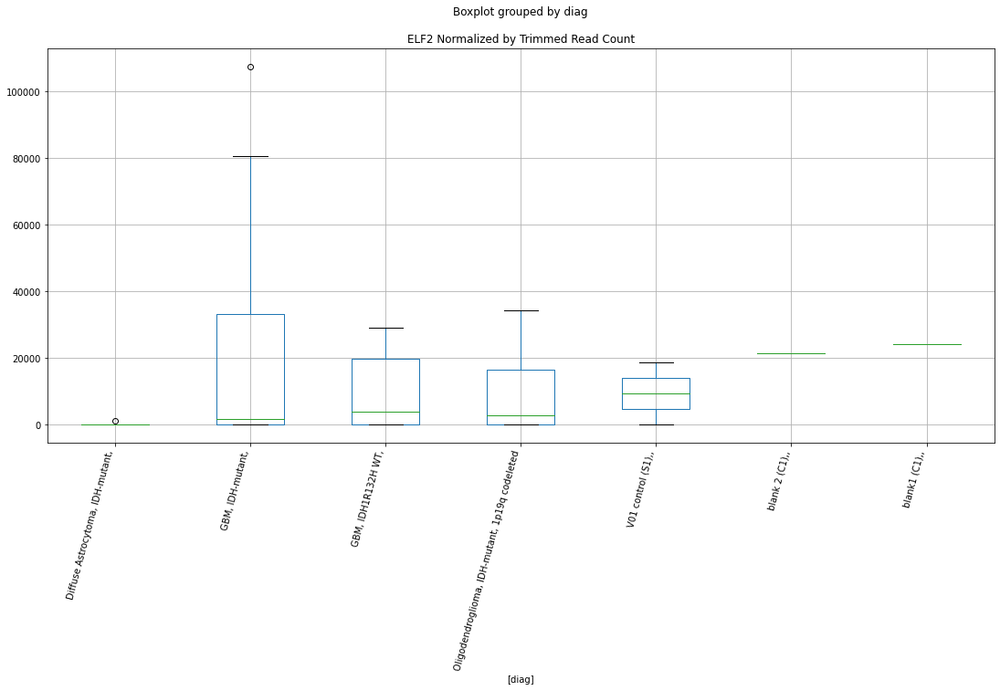

 p : 0.022795934917385137  ( t : 2.489584723543153 ) :  D-plex  :  bbduk2  :  LARS2
Control and blanks
73     119043.29
337         0.00
Name: LARS2, dtype: float64
205    8238.18
Name: LARS2, dtype: float64
469    20111.93
Name: LARS2, dtype: float64


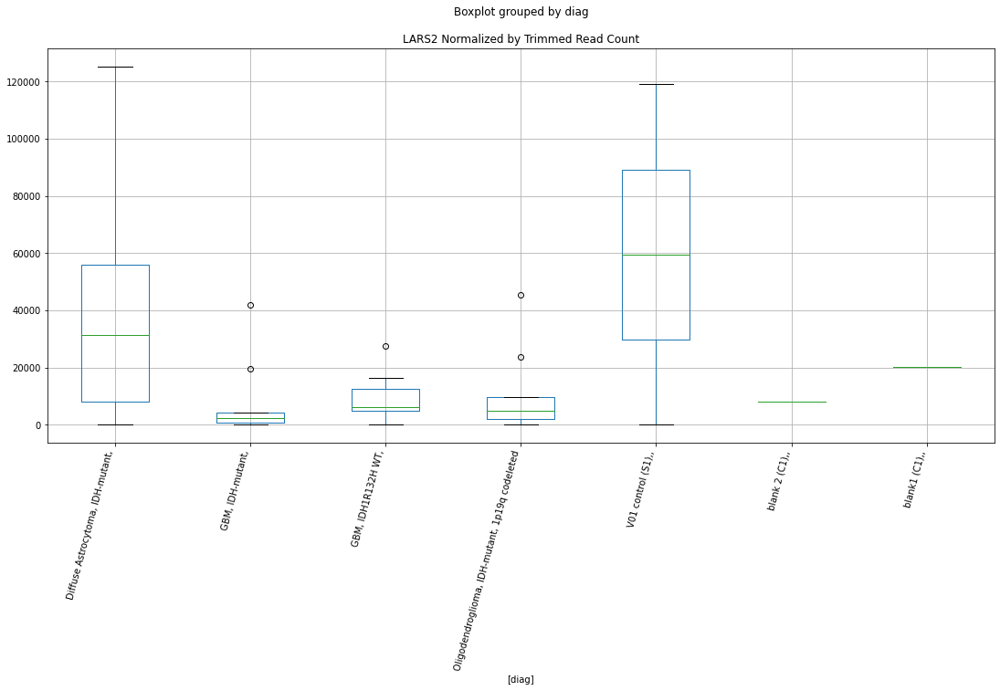

 p : 0.022948868772397542  ( t : 2.486363312328385 ) :  D-plex  :  bbduk2  :  IREB2
Control and blanks
73     0.0
337    0.0
Name: IREB2, dtype: float64
205    9491.82
Name: IREB2, dtype: float64
469    11239.02
Name: IREB2, dtype: float64


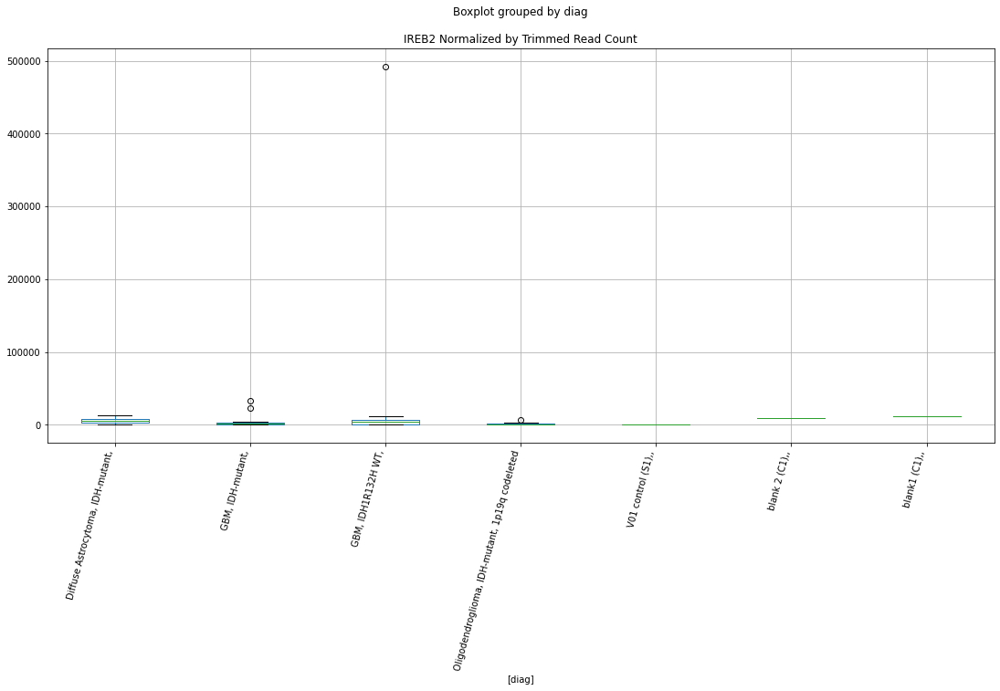

 p : 0.022995136527776537  ( t : 2.485392706135208 ) :  D-plex  :  bbduk2  :  FAH
Control and blanks
73     0.0
337    0.0
Name: FAH, dtype: float64
205    1611.82
Name: FAH, dtype: float64
469    141966.56
Name: FAH, dtype: float64


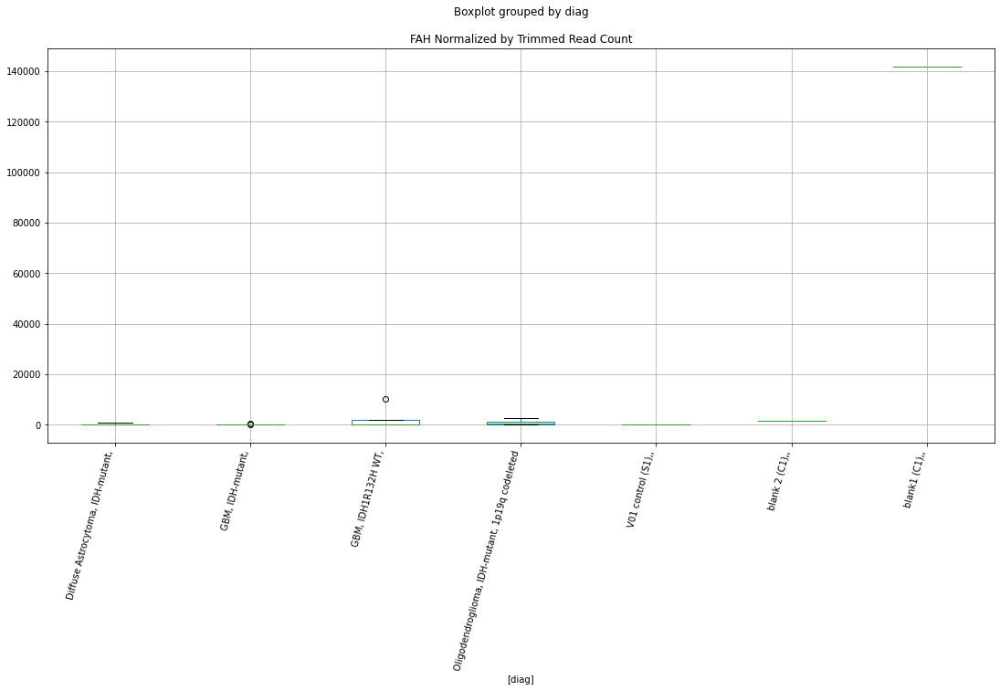

 p : 0.023036900237699453  ( t : 2.4845181632213684 ) :  Lexogen  :  bbduk2  :  EFNA2
Control and blanks
79     0.0
343    0.0
Name: EFNA2, dtype: float64
211    0.0
Name: EFNA2, dtype: float64
475    0.0
Name: EFNA2, dtype: float64


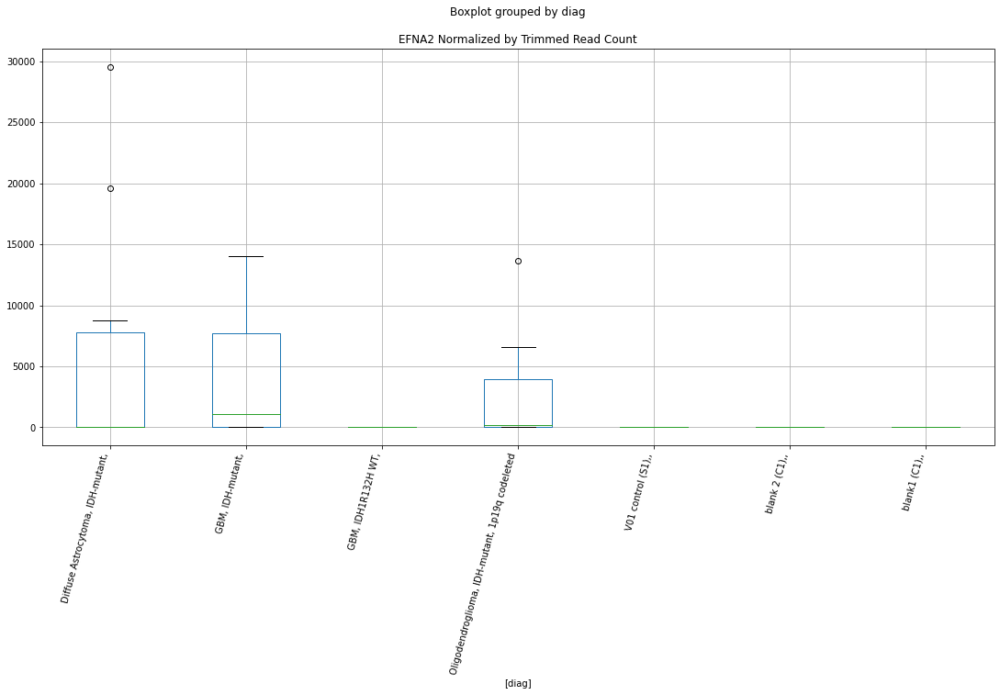

 p : 0.02310986163363799  ( t : 2.4829939072627667 ) :  Lexogen  :  cutadapt2  :  EFNA2
Control and blanks
82     0.0
346    0.0
Name: EFNA2, dtype: float64
214    0.0
Name: EFNA2, dtype: float64
478    0.0
Name: EFNA2, dtype: float64


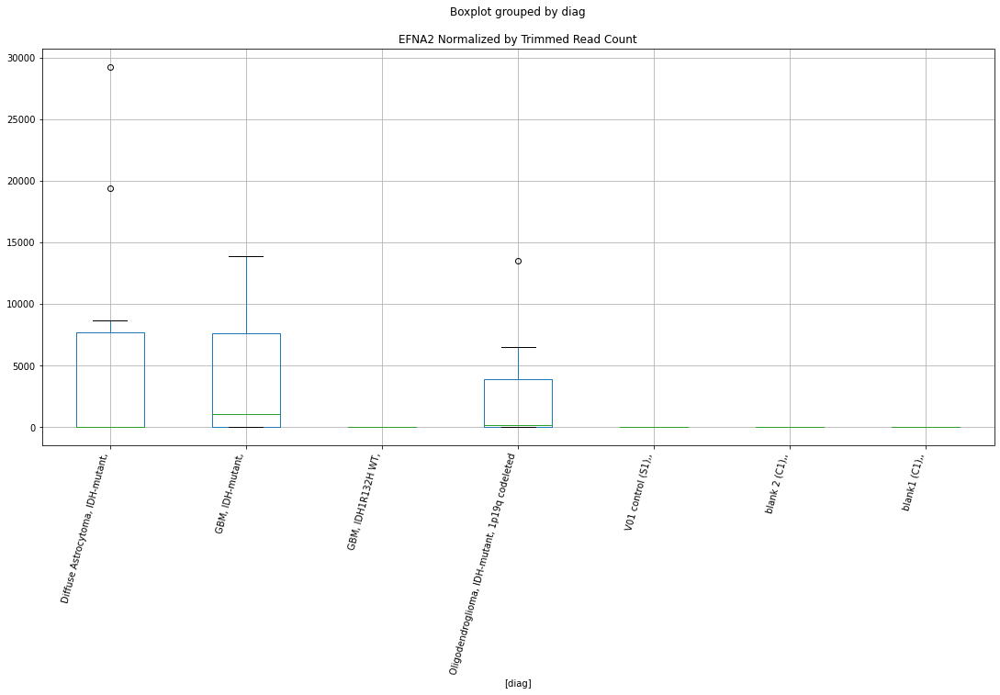

 p : 0.02311052401944904  ( t : 2.482980089941645 ) :  D-plex  :  cutadapt2  :  FAH
Control and blanks
76     0.0
340    0.0
Name: FAH, dtype: float64
208    1587.24
Name: FAH, dtype: float64
472    139865.31
Name: FAH, dtype: float64


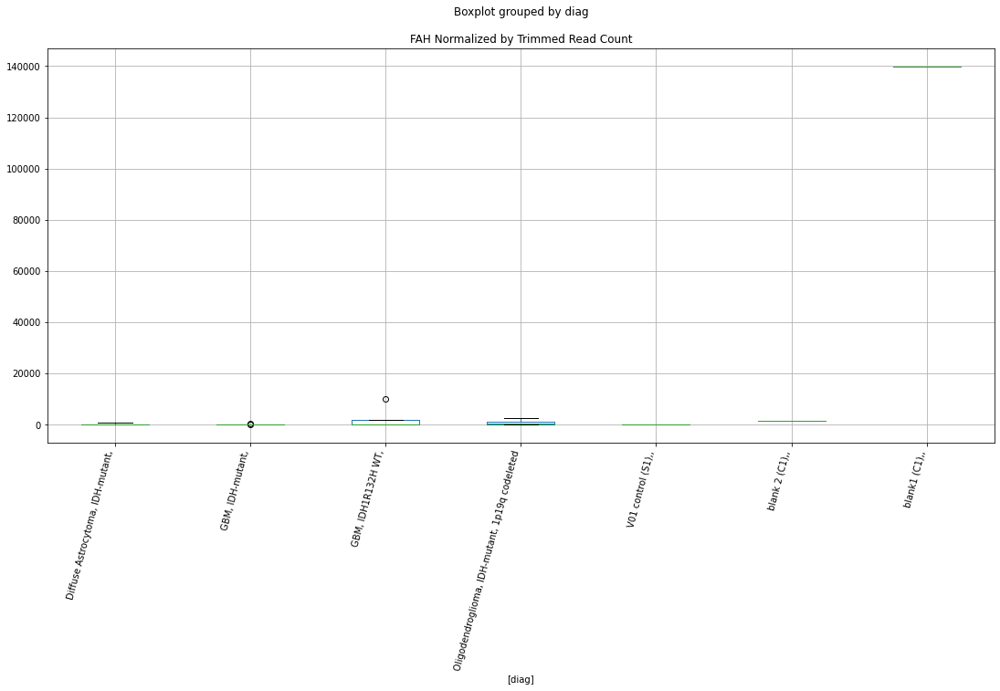

 p : 0.023153993385110677  ( t : 2.4820741358657608 ) :  D-plex  :  bbduk2  :  IGDCC3
Control and blanks
73     3092.03
337    1780.31
Name: IGDCC3, dtype: float64
205    5014.55
Name: IGDCC3, dtype: float64
469    6506.8
Name: IGDCC3, dtype: float64


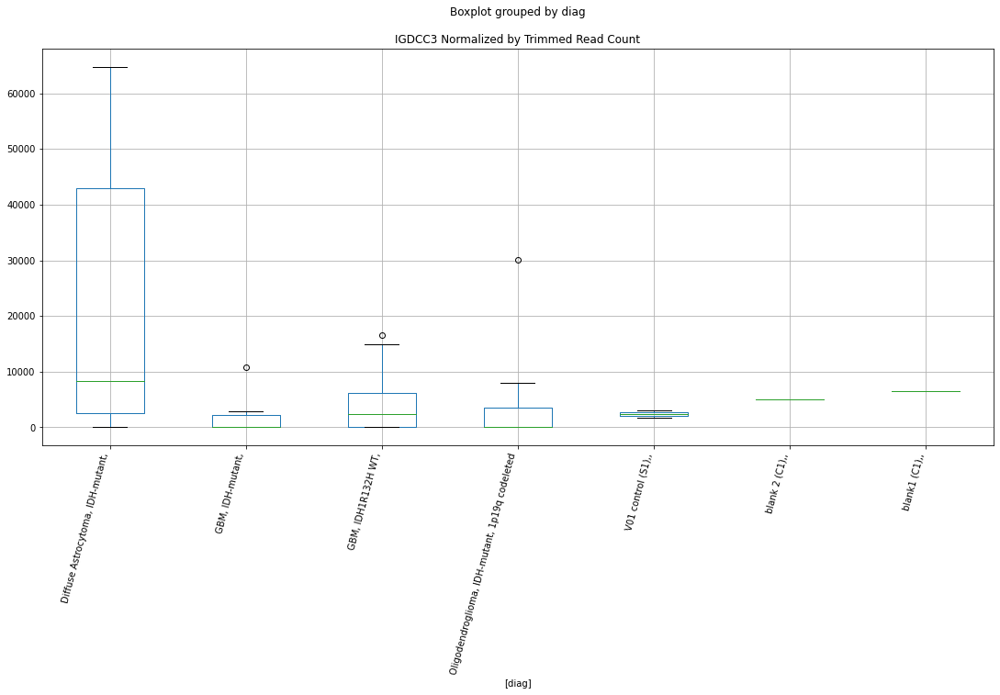

 p : 0.023166925080871745  ( t : 2.4818049326160816 ) :  D-plex  :  cutadapt2  :  GRAMD1C
Control and blanks
76     0.0
340    0.0
Name: GRAMD1C, dtype: float64
208    3527.2
Name: GRAMD1C, dtype: float64
472    0.0
Name: GRAMD1C, dtype: float64


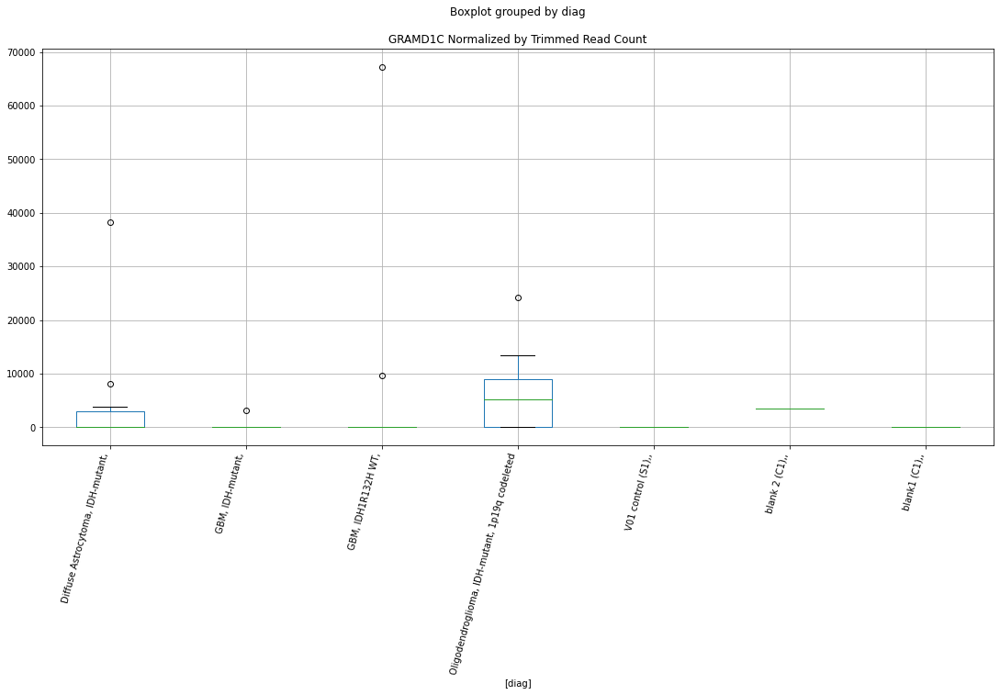

 p : 0.02324131851902961  ( t : 2.480259001817702 ) :  Lexogen  :  bbduk2  :  FTSJ1
Control and blanks
79       0.00
343    849.26
Name: FTSJ1, dtype: float64
211    10932.25
Name: FTSJ1, dtype: float64
475    0.0
Name: FTSJ1, dtype: float64


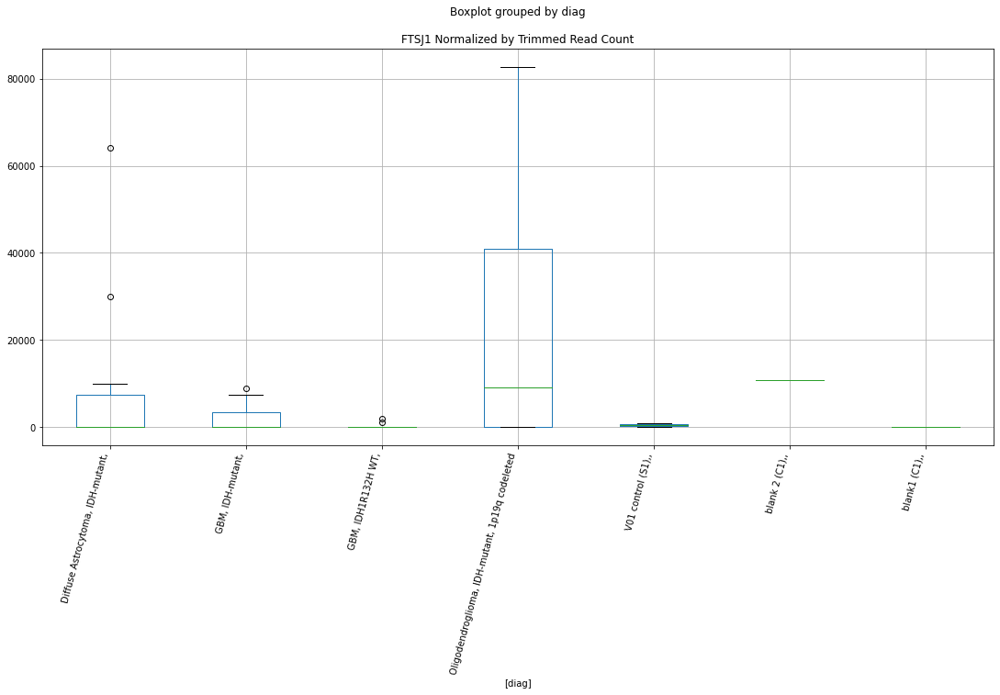

 p : 0.023268614056496797  ( t : 2.4796929550548428 ) :  Lexogen  :  bbduk2  :  ILRUN
Control and blanks
79       0.00
343    849.26
Name: ILRUN, dtype: float64
211    1093.23
Name: ILRUN, dtype: float64
475    0.0
Name: ILRUN, dtype: float64


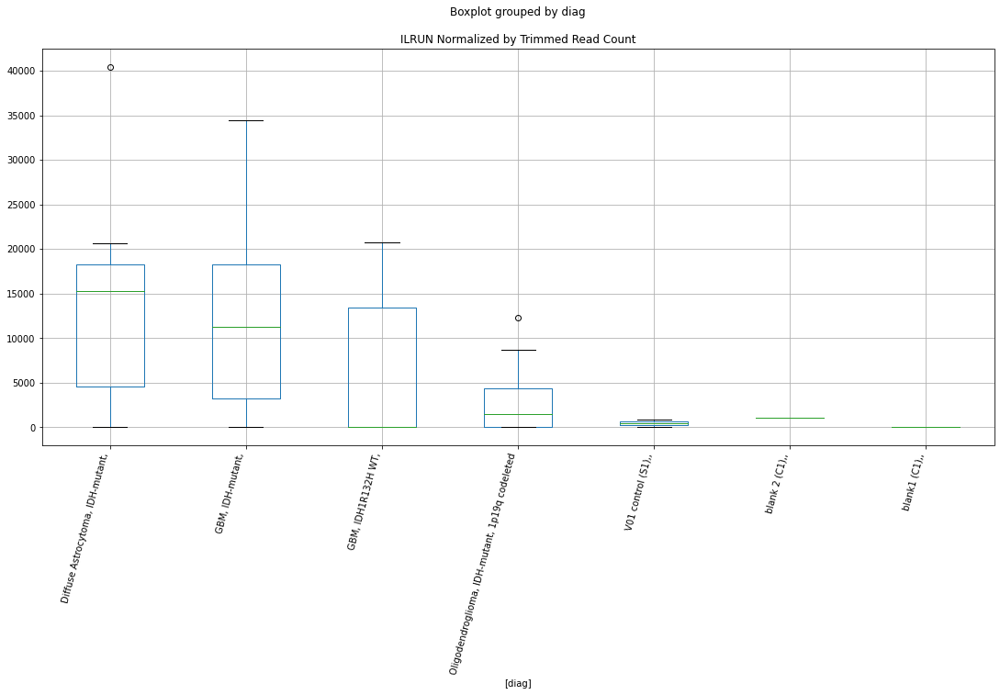

 p : 0.023280448867020697  ( t : 2.479447722410675 ) :  D-plex  :  bbduk2  :  HDAC2
Control and blanks
73     3092.03
337       0.00
Name: HDAC2, dtype: float64
205    4477.27
Name: HDAC2, dtype: float64
469    5915.27
Name: HDAC2, dtype: float64


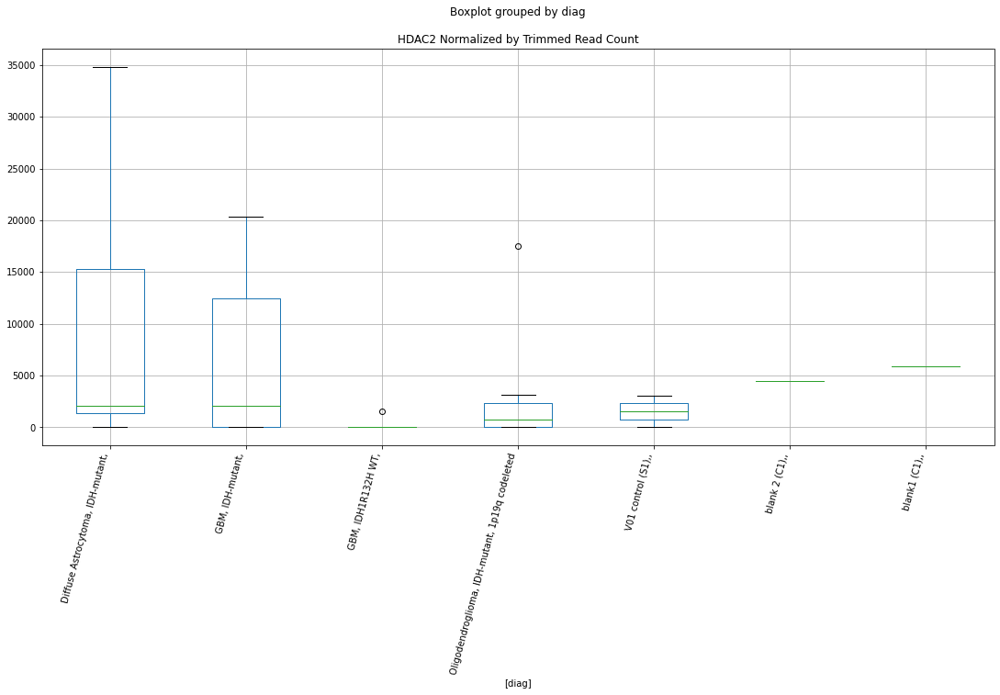

 p : 0.023283392902350507  ( t : 2.4793867363940785 ) :  D-plex  :  bbduk2  :  ELAVL3
Control and blanks
73     16233.18
337        0.00
Name: ELAVL3, dtype: float64
205    275262.79
Name: ELAVL3, dtype: float64
469    12422.07
Name: ELAVL3, dtype: float64


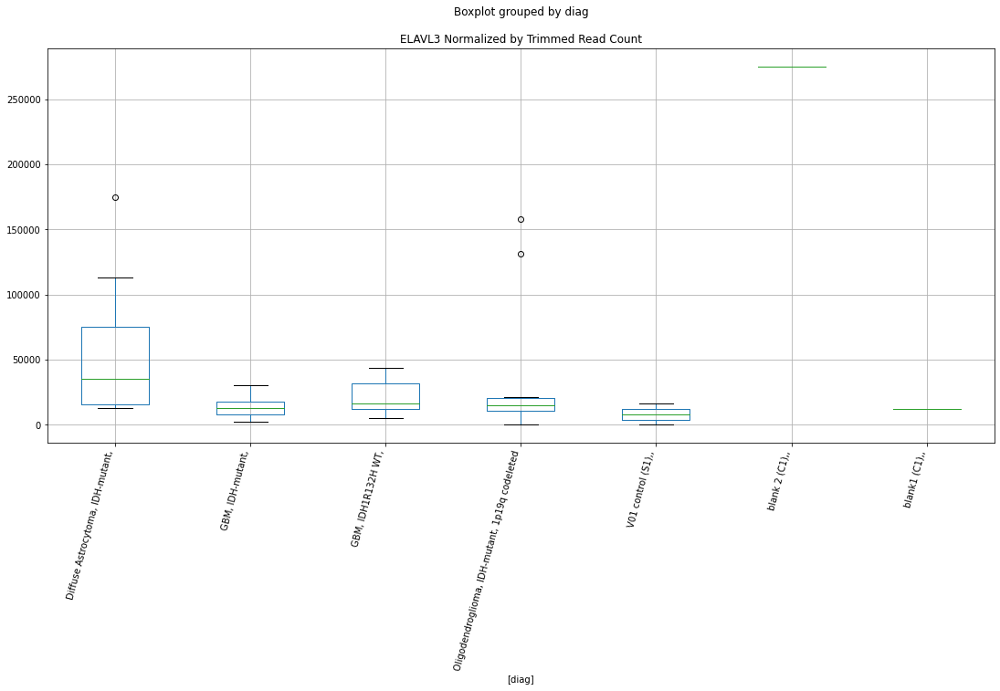

 p : 0.023405740942488932  ( t : 2.476858677312389 ) :  Lexogen  :  cutadapt2  :  GEMIN7
Control and blanks
82     31241.12
346        0.00
Name: GEMIN7, dtype: float64
214    0.0
Name: GEMIN7, dtype: float64
478    0.0
Name: GEMIN7, dtype: float64


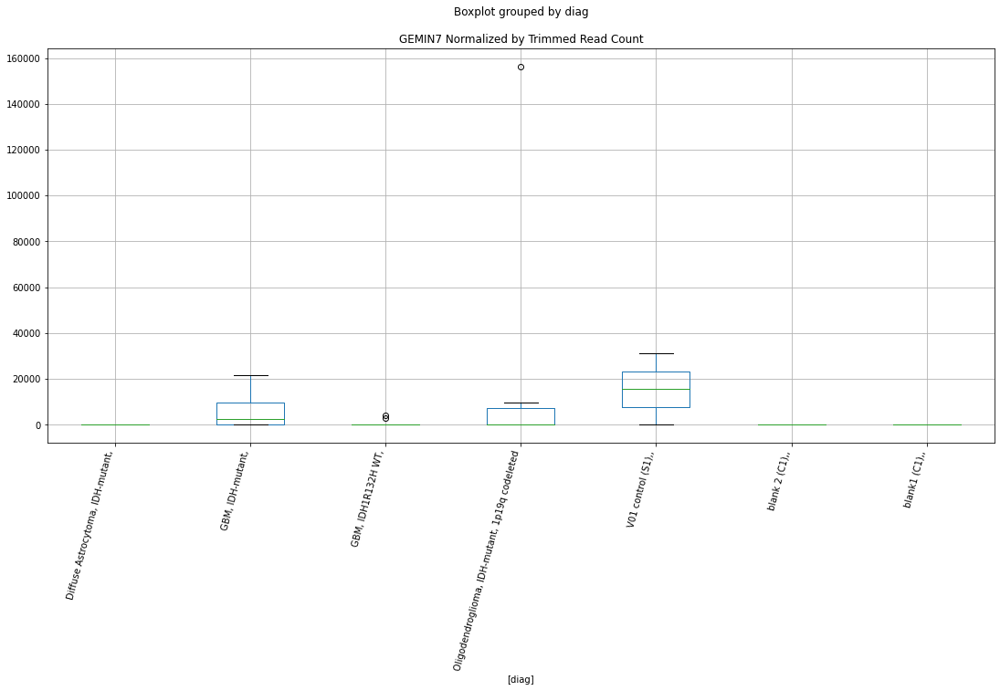

 p : 0.02342545621645279  ( t : 2.4764524670760397 ) :  Lexogen  :  bbduk2  :  GEMIN7
Control and blanks
79     31473.17
343        0.00
Name: GEMIN7, dtype: float64
211    0.0
Name: GEMIN7, dtype: float64
475    0.0
Name: GEMIN7, dtype: float64


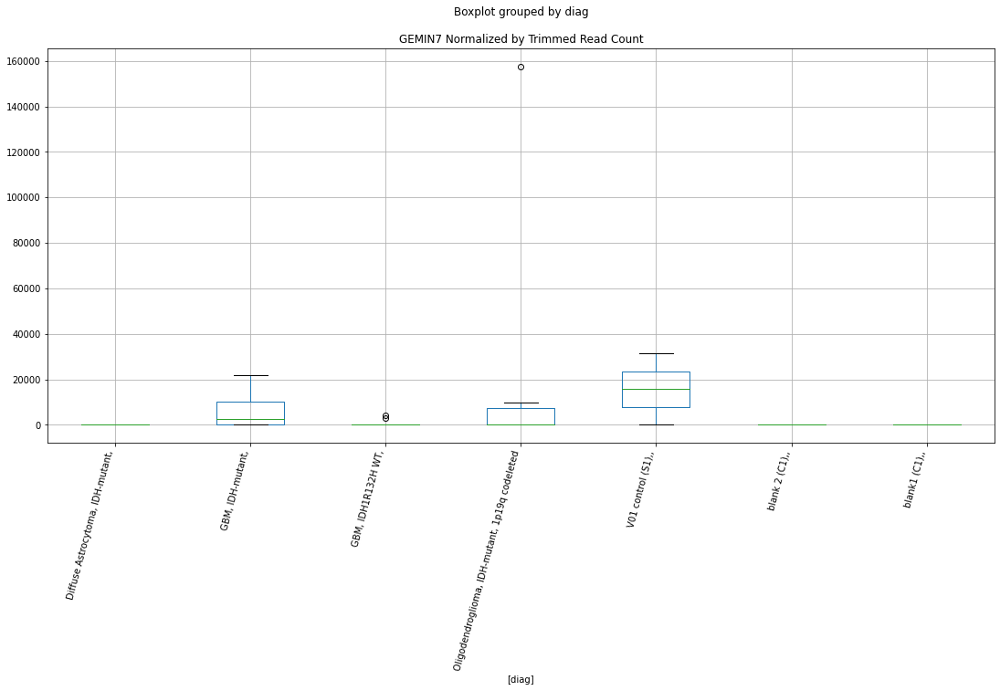

 p : 0.023675804890888965  ( t : 2.4713221027522527 ) :  Lexogen  :  bbduk2  :  FA2H
Control and blanks
79       0.00
343    424.63
Name: FA2H, dtype: float64
211    0.0
Name: FA2H, dtype: float64
475    479.03
Name: FA2H, dtype: float64


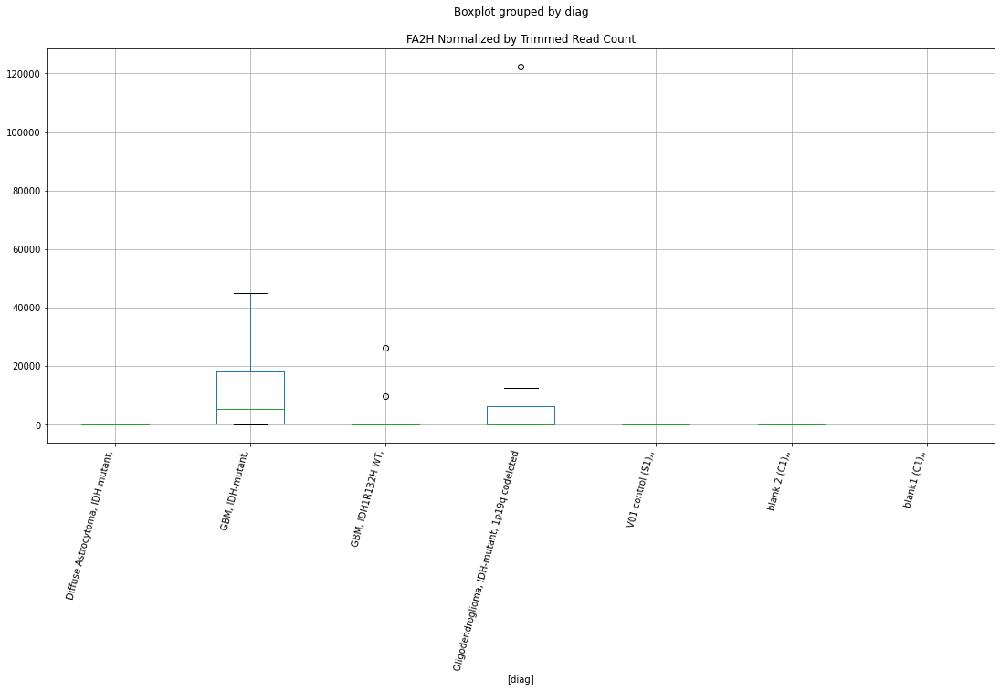

 p : 0.0237117872495153  ( t : 2.470588917682198 ) :  D-plex  :  bbduk2  :  HAUS6
Control and blanks
73     115951.26
337         0.00
Name: HAUS6, dtype: float64
205    3402.73
Name: HAUS6, dtype: float64
469    3549.16
Name: HAUS6, dtype: float64


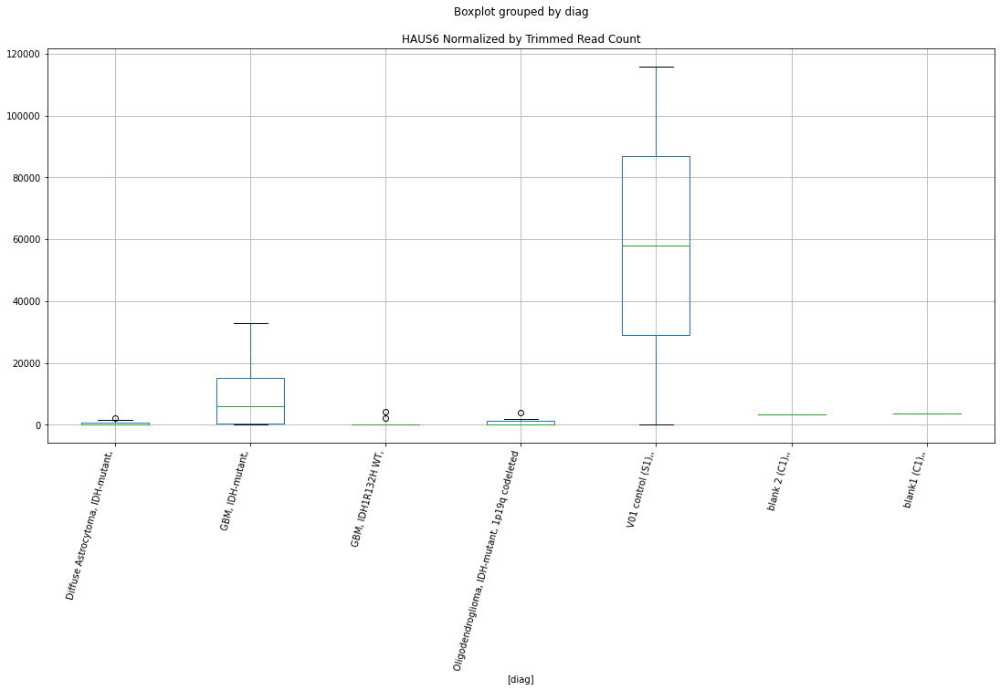

 p : 0.023877195787826794  ( t : 2.467231914180874 ) :  D-plex  :  bbduk2  :  HOOK2
Control and blanks
73     0.0
337    0.0
Name: HOOK2, dtype: float64
205    2328.18
Name: HOOK2, dtype: float64
469    7689.86
Name: HOOK2, dtype: float64


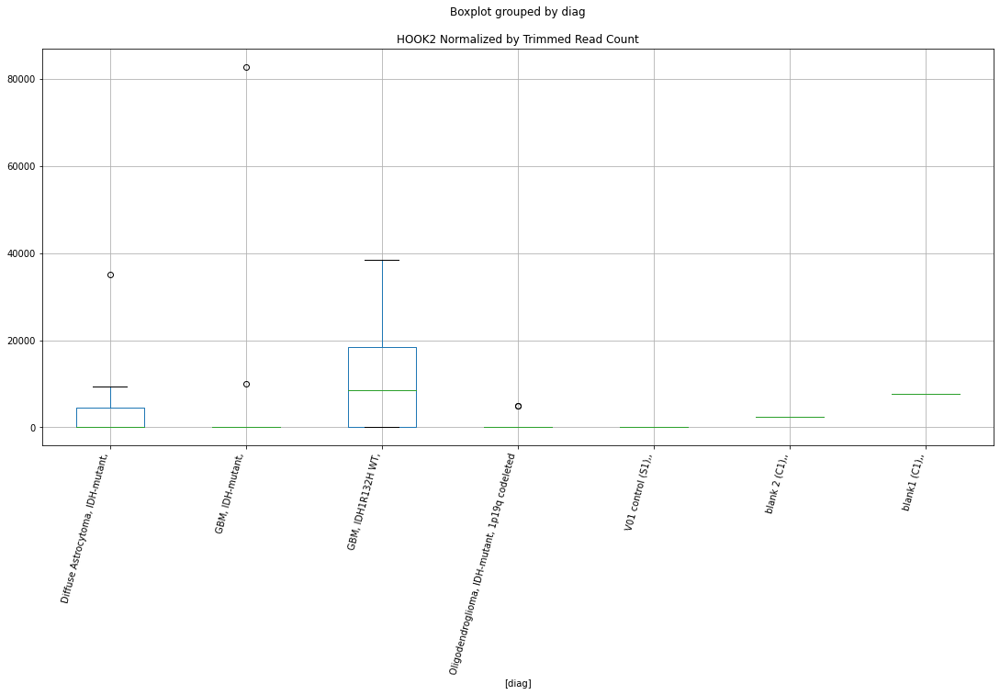

 p : 0.023890290603469703  ( t : 2.466967086656983 ) :  D-plex  :  bbduk2  :  FBXL5
Control and blanks
73     0.0
337    0.0
Name: FBXL5, dtype: float64
205    3223.64
Name: FBXL5, dtype: float64
469    1774.58
Name: FBXL5, dtype: float64


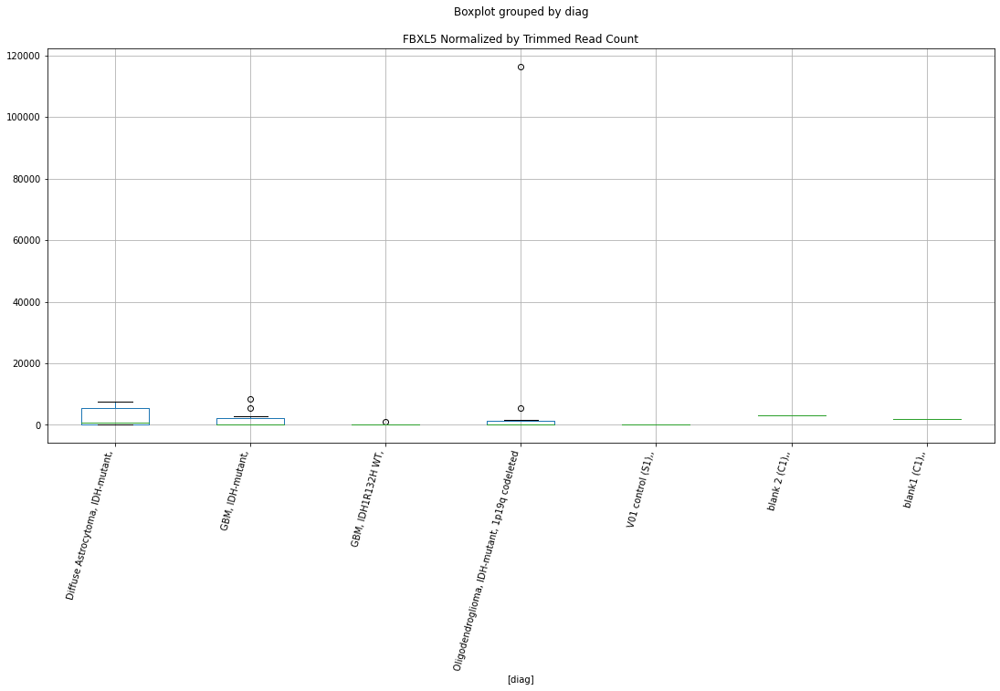

 p : 0.02391882397897688  ( t : 2.4663905043511956 ) :  D-plex  :  cutadapt2  :  HCCS
Control and blanks
76     0.0
340    0.0
Name: HCCS, dtype: float64
208    705.44
Name: HCCS, dtype: float64
472    4045.69
Name: HCCS, dtype: float64


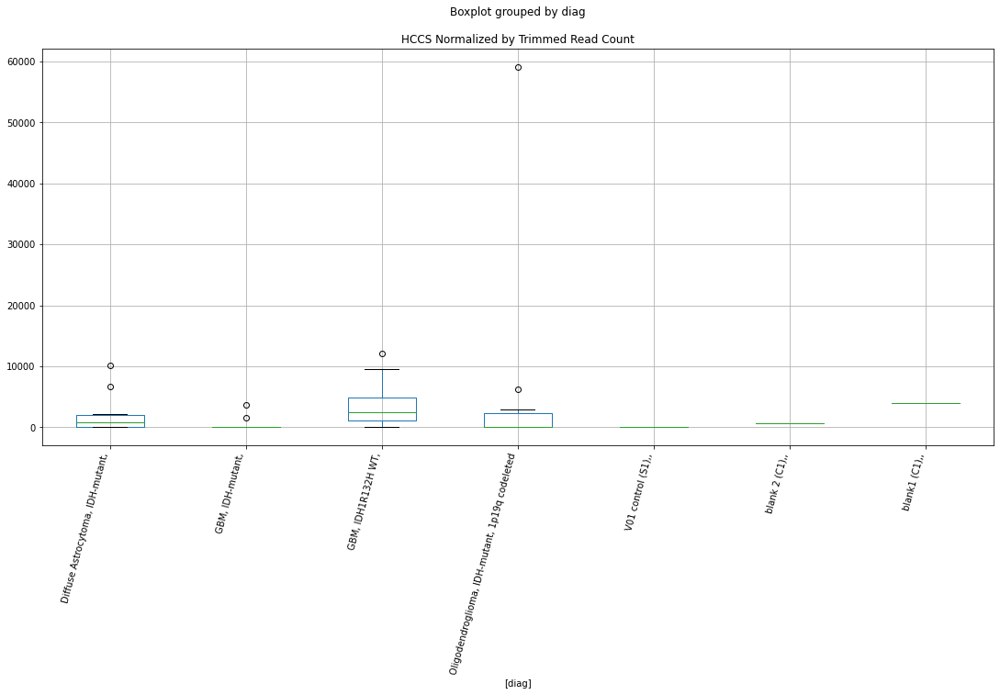

 p : 0.02401688135731124  ( t : 2.4644139465727113 ) :  Lexogen  :  cutadapt2  :  GPI
Control and blanks
82         0.00
346    16203.46
Name: GPI, dtype: float64
214    4339.62
Name: GPI, dtype: float64
478    474.92
Name: GPI, dtype: float64


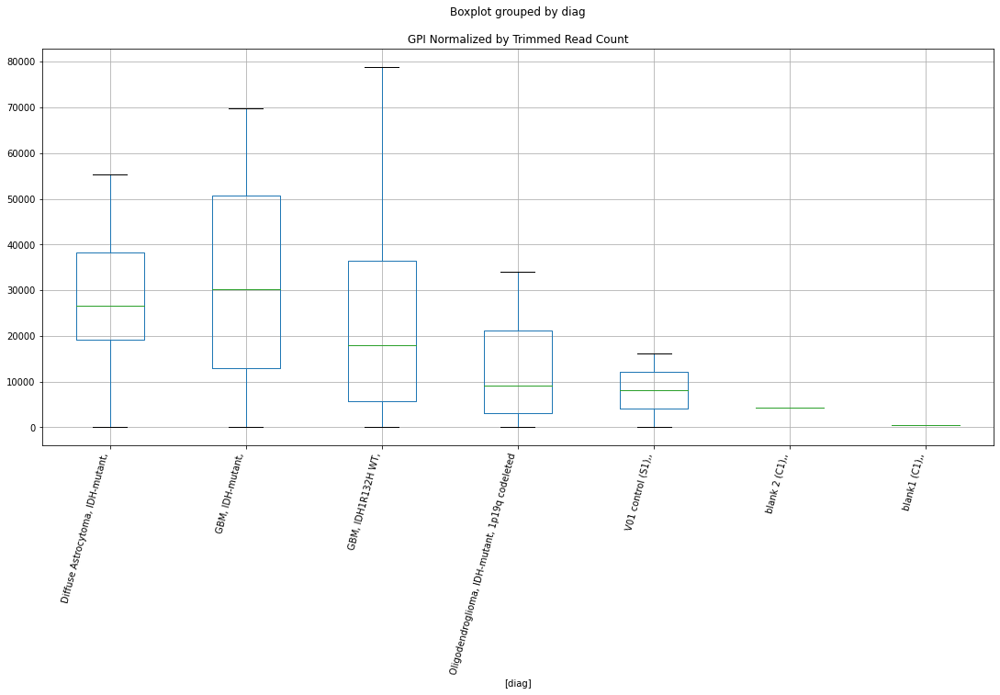

 p : 0.024053360670139926  ( t : 2.4636805625522955 ) :  D-plex  :  bbduk2  :  LARS2
Control and blanks
73     119043.29
337         0.00
Name: LARS2, dtype: float64
205    8238.18
Name: LARS2, dtype: float64
469    20111.93
Name: LARS2, dtype: float64


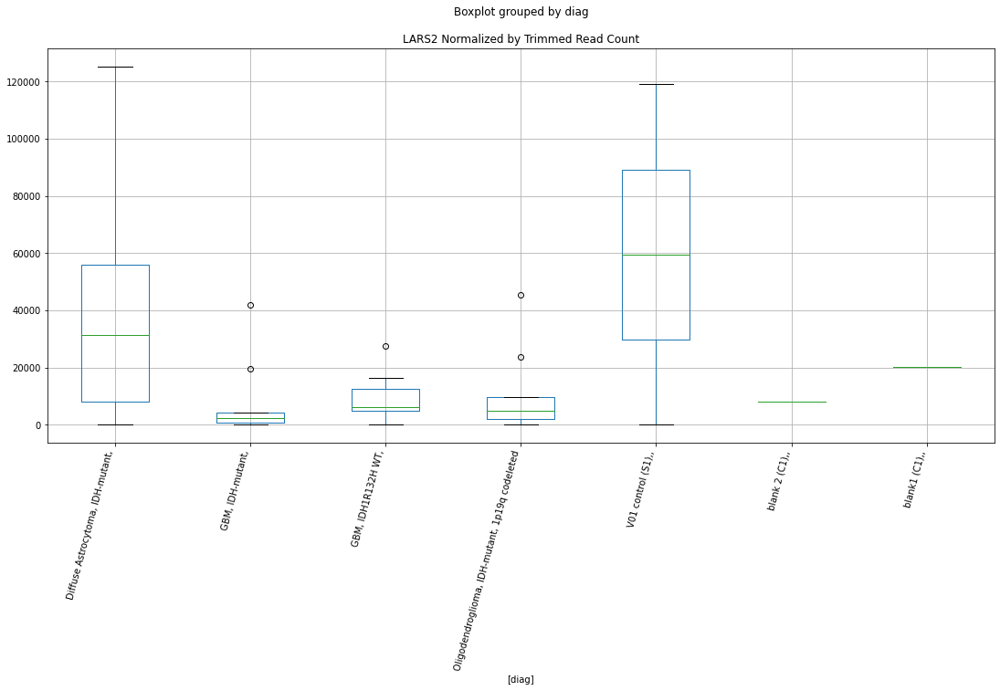

 p : 0.024094327758871117  ( t : 2.462858200807202 ) :  Lexogen  :  bbduk2  :  KCNMB4
Control and blanks
79       0.00
343    212.31
Name: KCNMB4, dtype: float64
211    273.31
Name: KCNMB4, dtype: float64
475    0.0
Name: KCNMB4, dtype: float64


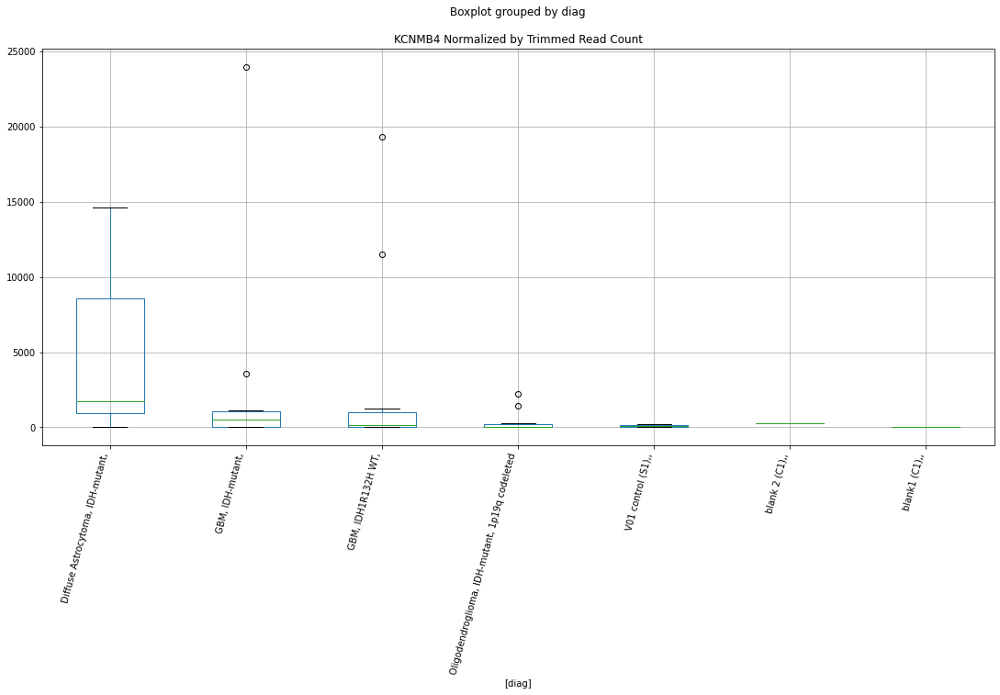

 p : 0.024144713918971796  ( t : 2.461848563197568 ) :  Lexogen  :  cutadapt2  :  GBF1
Control and blanks
82     0.0
346    0.0
Name: GBF1, dtype: float64
214    0.0
Name: GBF1, dtype: float64
478    3799.37
Name: GBF1, dtype: float64


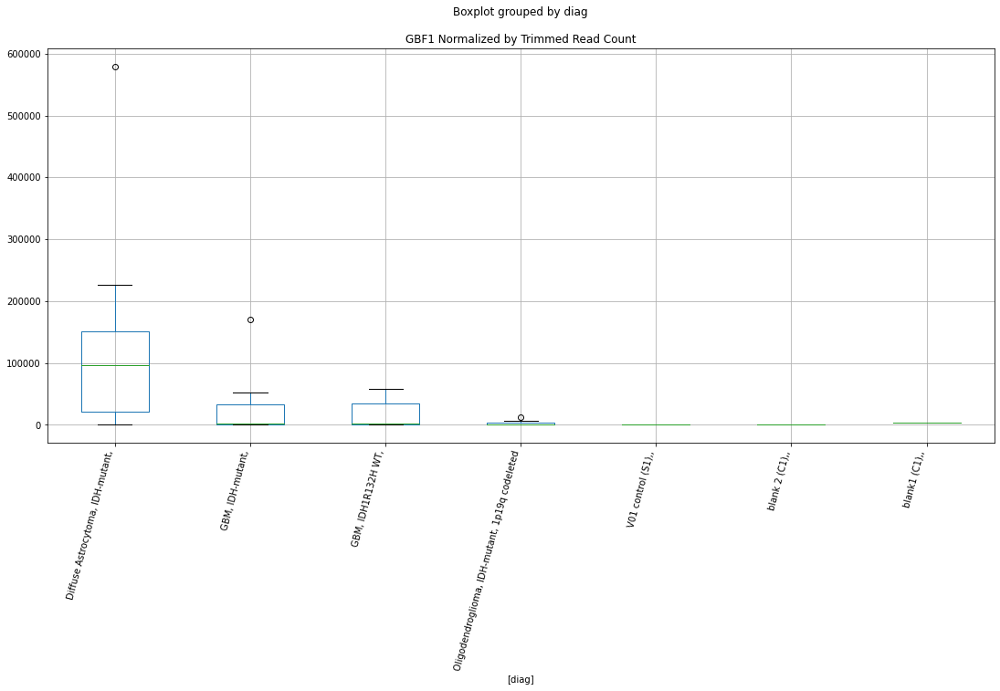

 p : 0.024237337425269245  ( t : 2.459997727590152 ) :  Lexogen  :  bbduk2  :  ITPA
Control and blanks
79       0.00
343    636.94
Name: ITPA, dtype: float64
211    0.0
Name: ITPA, dtype: float64
475    718.55
Name: ITPA, dtype: float64


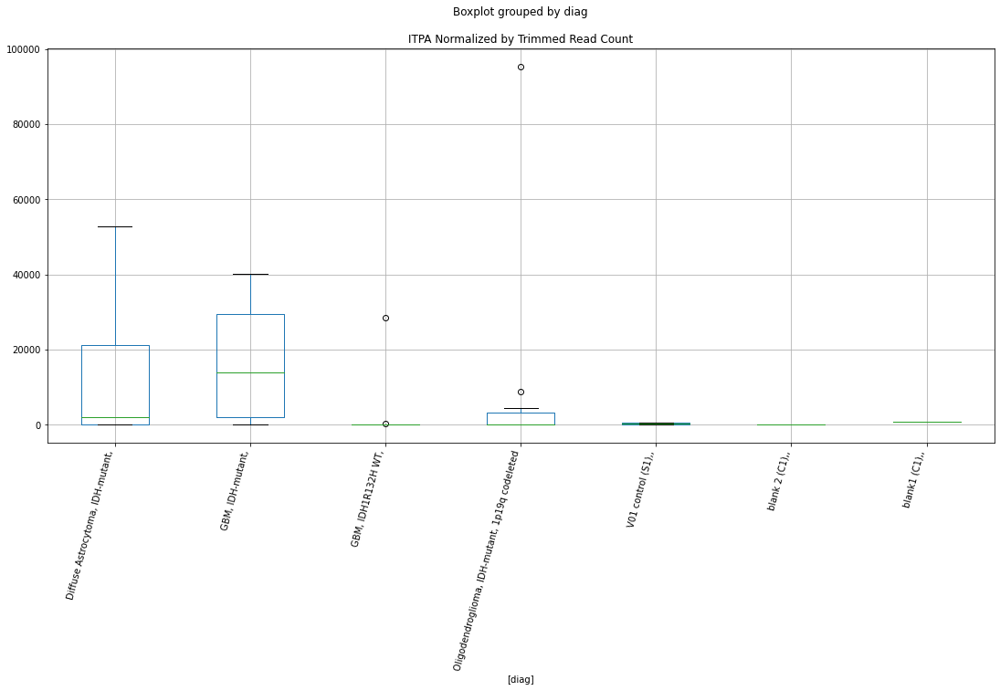

 p : 0.024357142622864324  ( t : 2.4576135692925494 ) :  Lexogen  :  cutadapt2  :  ITPA
Control and blanks
82       0.0
346    631.3
Name: ITPA, dtype: float64
214    0.0
Name: ITPA, dtype: float64
478    712.38
Name: ITPA, dtype: float64


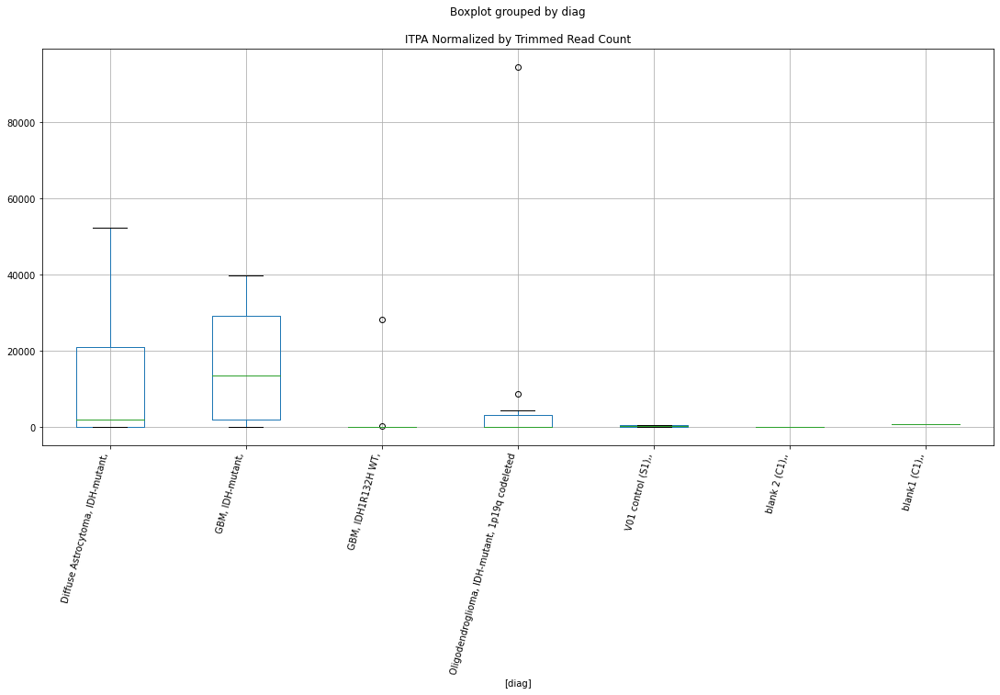

 p : 0.024432127342528497  ( t : 2.4561269501915204 ) :  D-plex  :  bbduk2  :  GGT2
Control and blanks
73         0.00
337    17803.15
Name: GGT2, dtype: float64
205    5730.91
Name: GGT2, dtype: float64
469    4732.22
Name: GGT2, dtype: float64


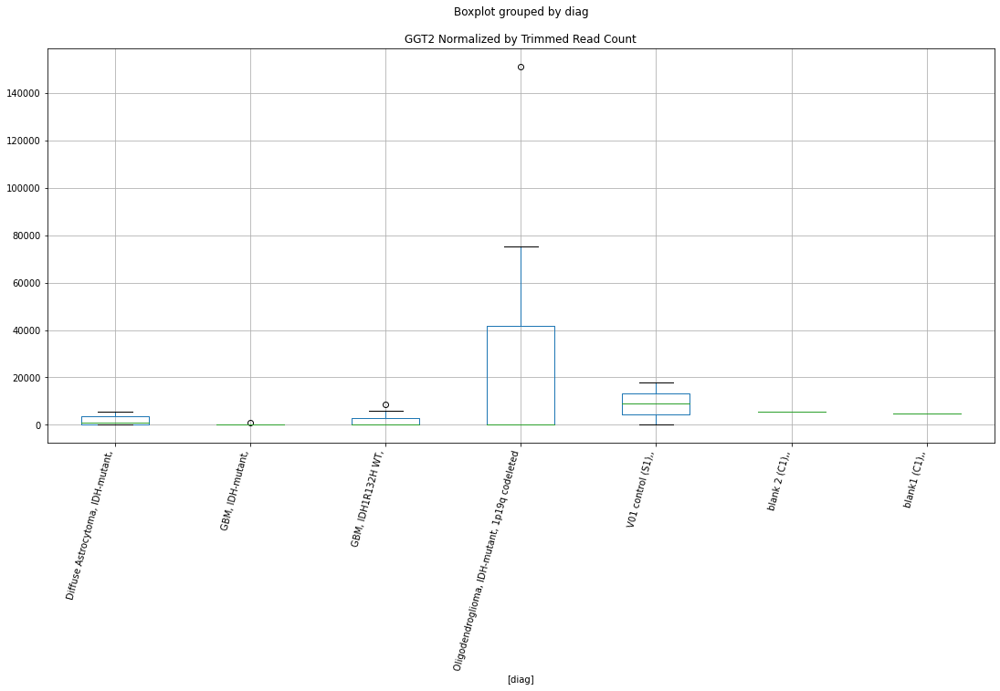

 p : 0.024445607900385344  ( t : 2.4558601442213908 ) :  D-plex  :  cutadapt2  :  IL11
Control and blanks
76     0.0
340    0.0
Name: IL11, dtype: float64
208    1058.16
Name: IL11, dtype: float64
472    2311.82
Name: IL11, dtype: float64


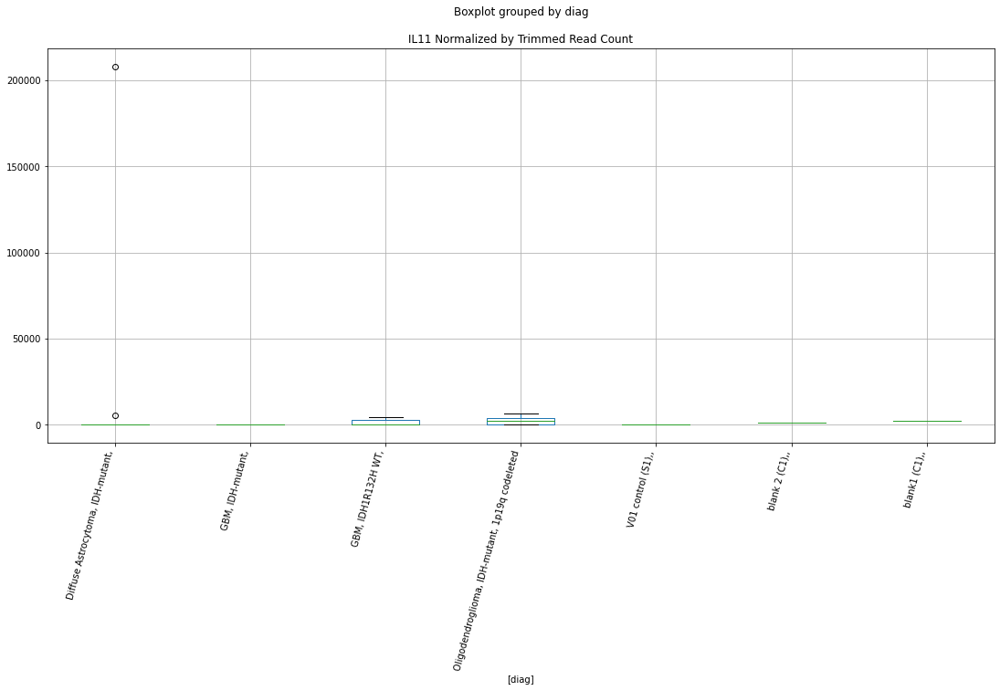

 p : 0.024498462446879442  ( t : 2.4548153831353967 ) :  Lexogen  :  bbduk2  :  ISLR2
Control and blanks
79     60085.15
343     2547.77
Name: ISLR2, dtype: float64
211    0.0
Name: ISLR2, dtype: float64
475    0.0
Name: ISLR2, dtype: float64


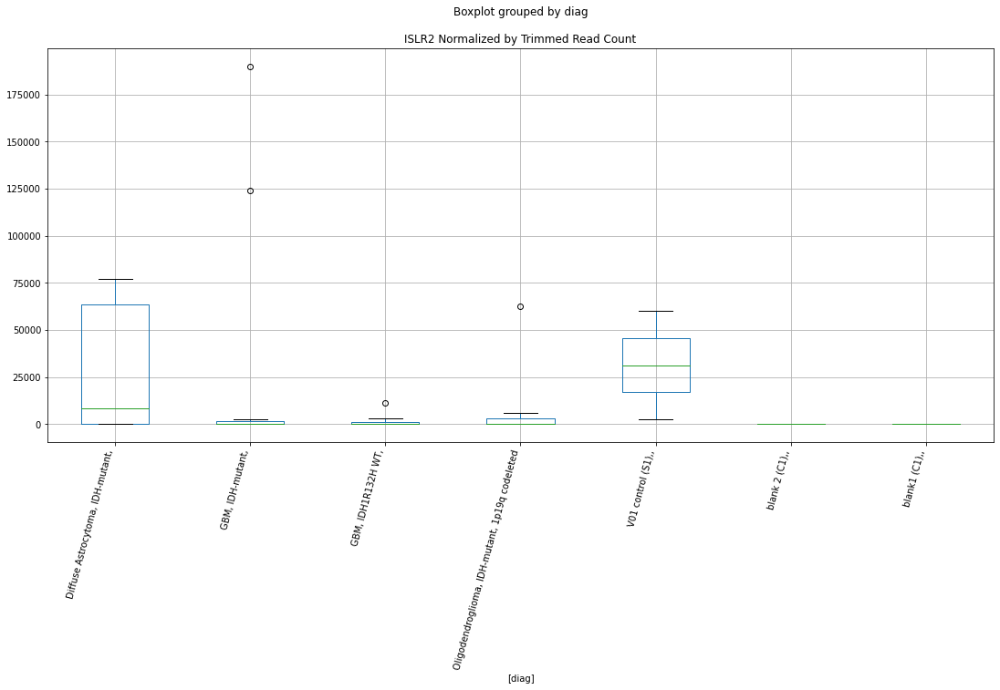

 p : 0.024502659096403357  ( t : 2.4547325198710204 ) :  D-plex  :  cutadapt2  :  GPC3
Control and blanks
76         0.0
340    98642.0
Name: GPC3, dtype: float64
208    11287.05
Name: GPC3, dtype: float64
472    1.16e+06
Name: GPC3, dtype: float64


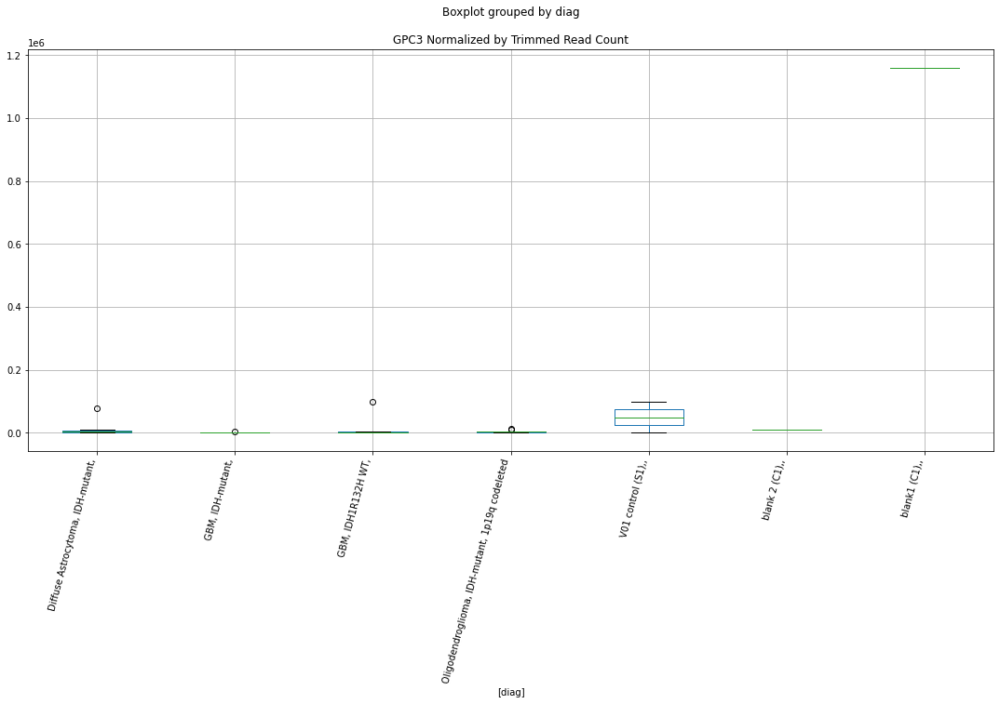

 p : 0.02453800081575504  ( t : 2.4540352223440487 ) :  D-plex  :  bbduk2  :  GPC3
Control and blanks
73         0.00
337    99697.61
Name: GPC3, dtype: float64
205    10745.46
Name: GPC3, dtype: float64
469    1.18e+06
Name: GPC3, dtype: float64


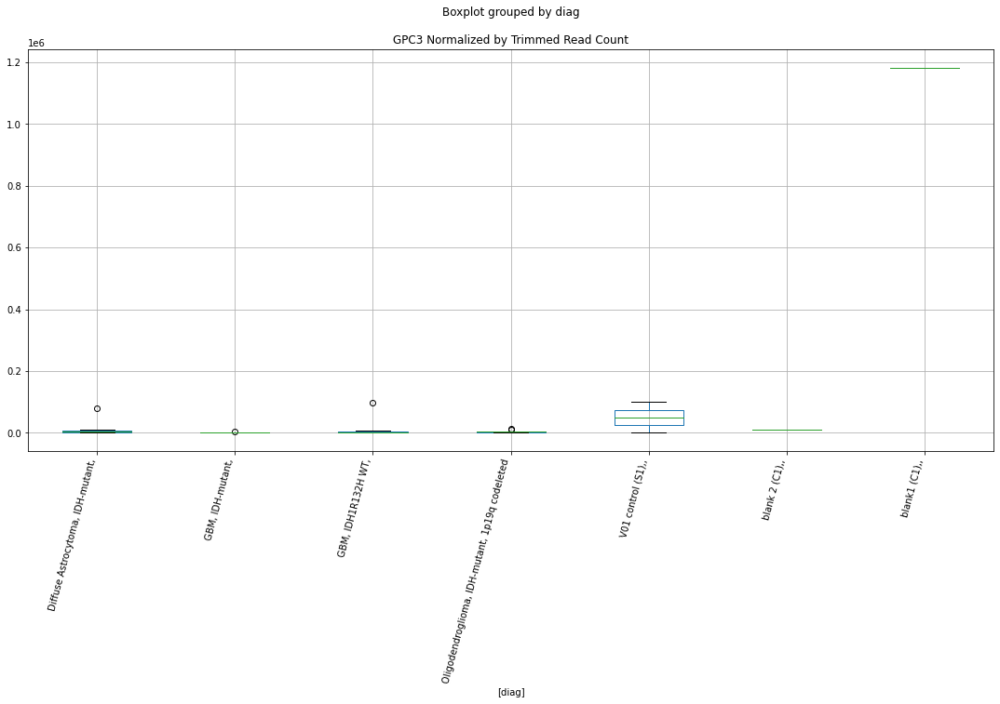

 p : 0.024639608164863  ( t : 2.4520357343587764 ) :  D-plex  :  bbduk2  :  HDHD5
Control and blanks
73     0.0
337    0.0
Name: HDHD5, dtype: float64
205    7342.73
Name: HDHD5, dtype: float64
469    1774.58
Name: HDHD5, dtype: float64


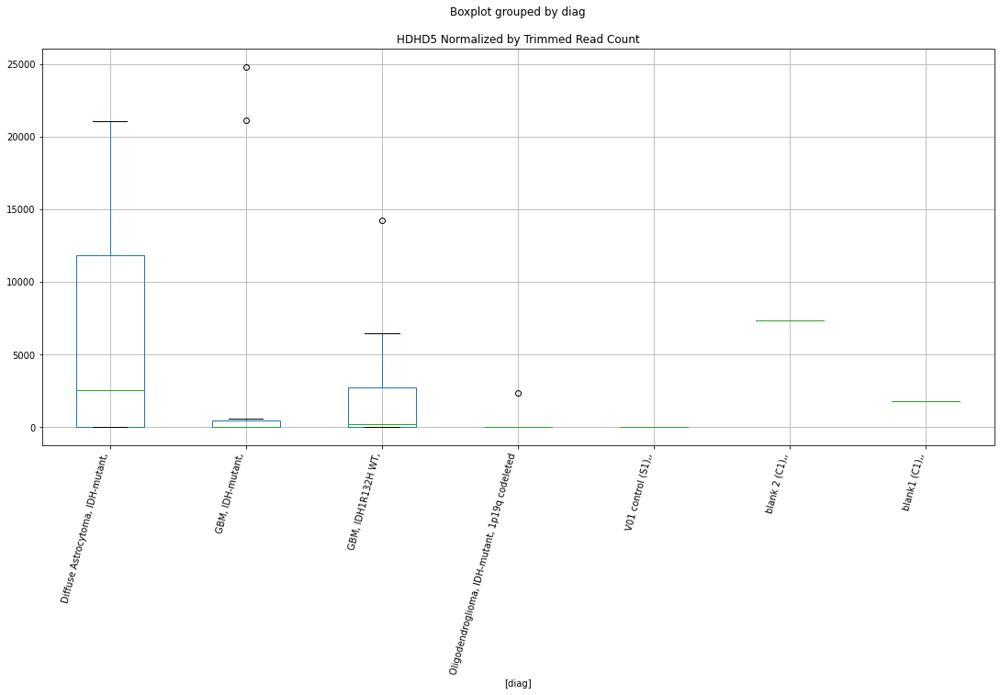

 p : 0.024644073475401627  ( t : 2.4519480411097785 ) :  Lexogen  :  bbduk2  :  GBF1
Control and blanks
79     0.0
343    0.0
Name: GBF1, dtype: float64
211    0.0
Name: GBF1, dtype: float64
475    3832.25
Name: GBF1, dtype: float64


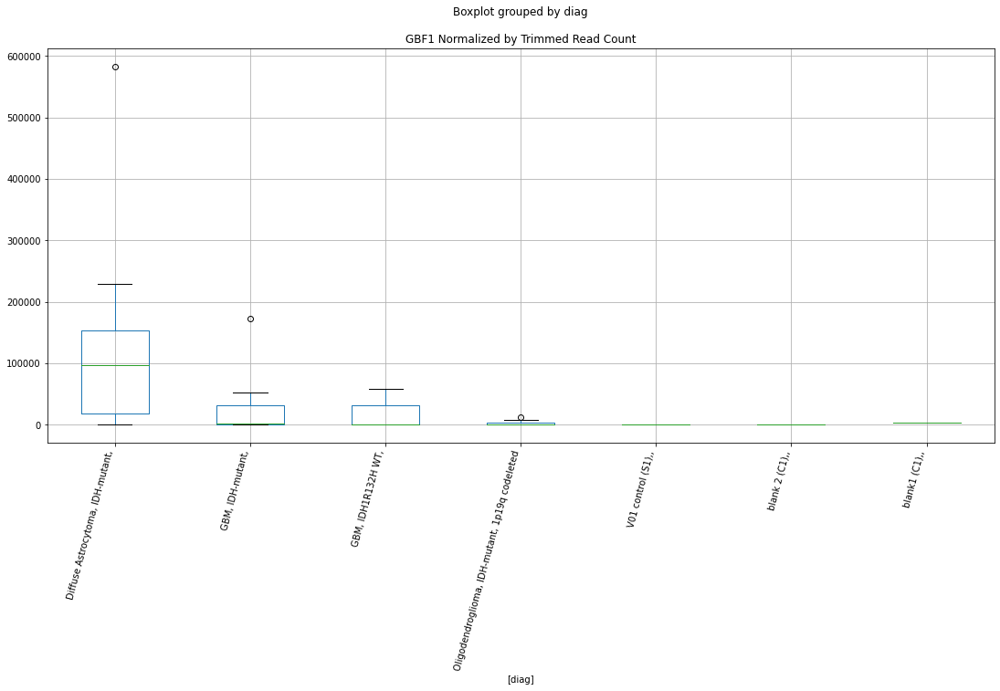

 p : 0.024775781707810862  ( t : 2.449368138579965 ) :  D-plex  :  bbduk2  :  IFT80
Control and blanks
73      6957.08
337    42727.55
Name: IFT80, dtype: float64
205    40295.46
Name: IFT80, dtype: float64
469    40815.38
Name: IFT80, dtype: float64


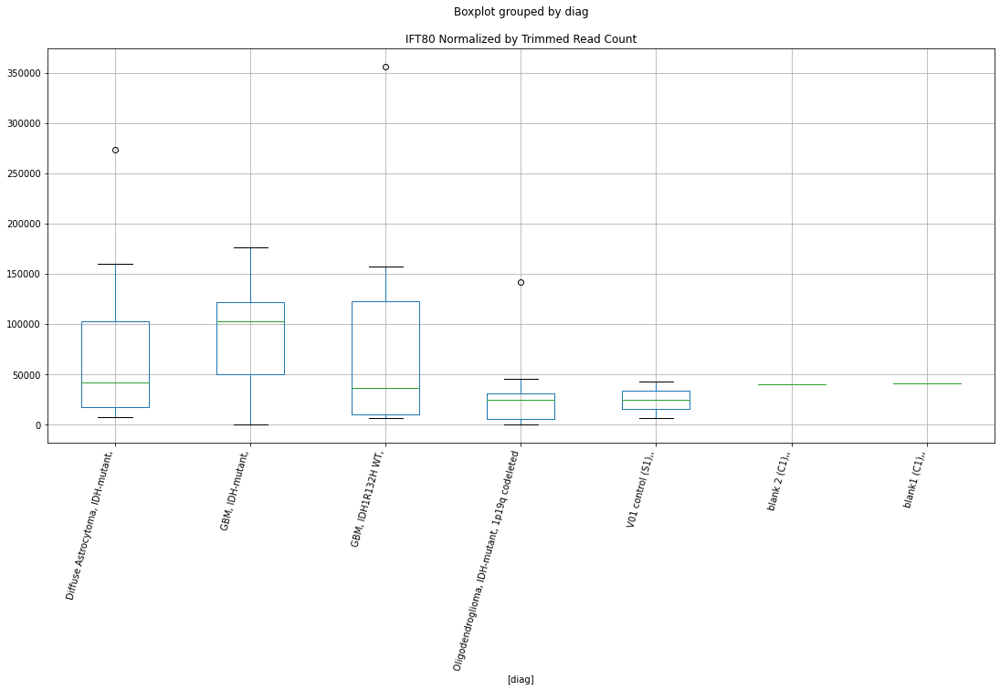

 p : 0.024805831671240446  ( t : 2.4487813236673954 ) :  D-plex  :  cutadapt2  :  KHDC3L
Control and blanks
76     0.0
340    0.0
Name: KHDC3L, dtype: float64
208    881.8
Name: KHDC3L, dtype: float64
472    4623.65
Name: KHDC3L, dtype: float64


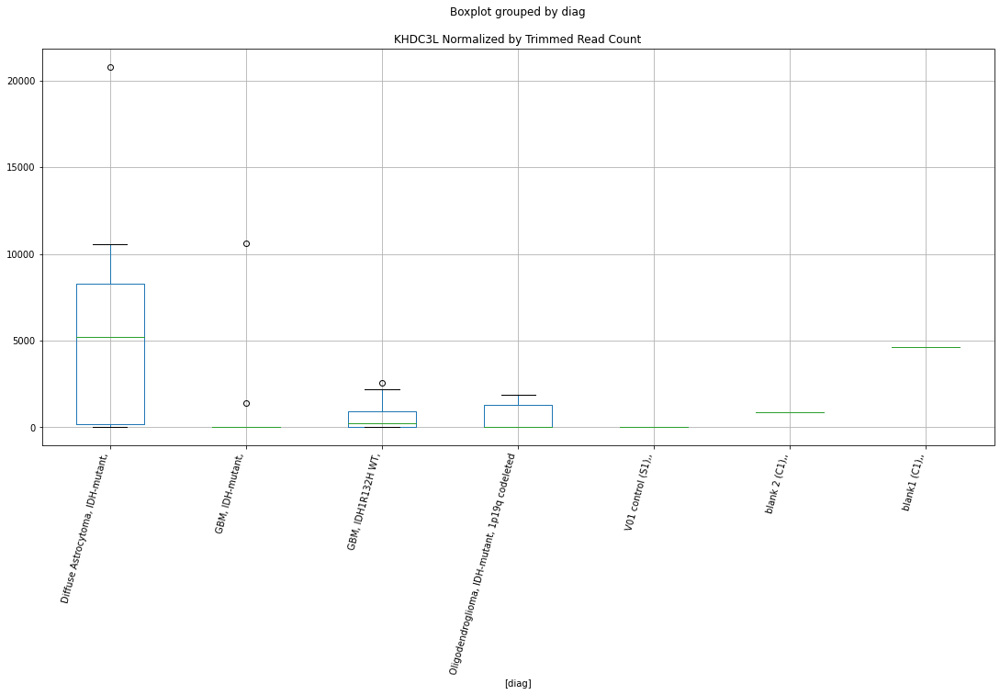

 p : 0.024810918755122164  ( t : 2.4486820492734793 ) :  D-plex  :  bbduk2  :  GOLGA6L4
Control and blanks
73     0.0
337    0.0
Name: GOLGA6L4, dtype: float64
205    716.36
Name: GOLGA6L4, dtype: float64
469    1183.05
Name: GOLGA6L4, dtype: float64


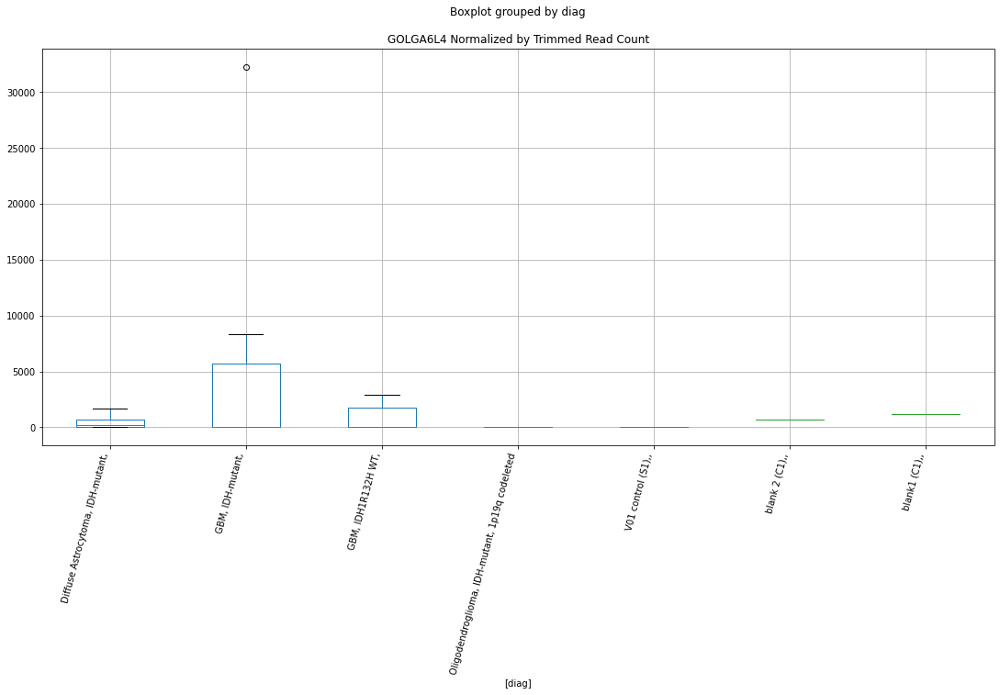

 p : 0.02495148585889973  ( t : 2.445946413964775 ) :  D-plex  :  bbduk2  :  GATA1
Control and blanks
73     0.0
337    0.0
Name: GATA1, dtype: float64
205    6447.27
Name: GATA1, dtype: float64
469    7098.33
Name: GATA1, dtype: float64


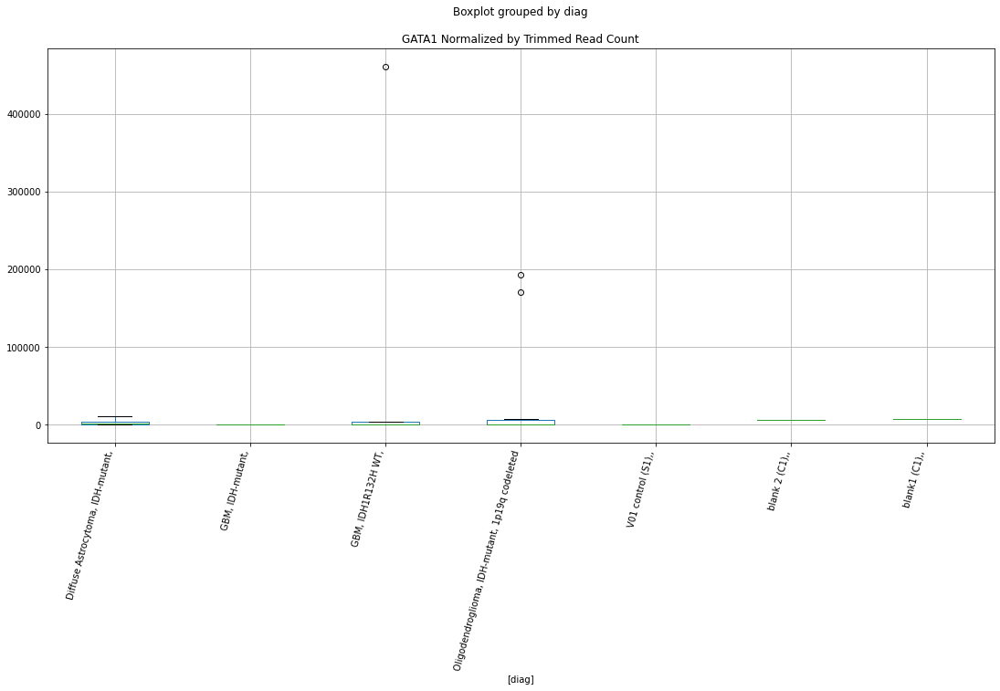

 p : 0.024965653427926317  ( t : 2.4456714958583867 ) :  Lexogen  :  cutadapt2  :  FA2H
Control and blanks
82       0.00
346    420.87
Name: FA2H, dtype: float64
214    0.0
Name: FA2H, dtype: float64
478    474.92
Name: FA2H, dtype: float64


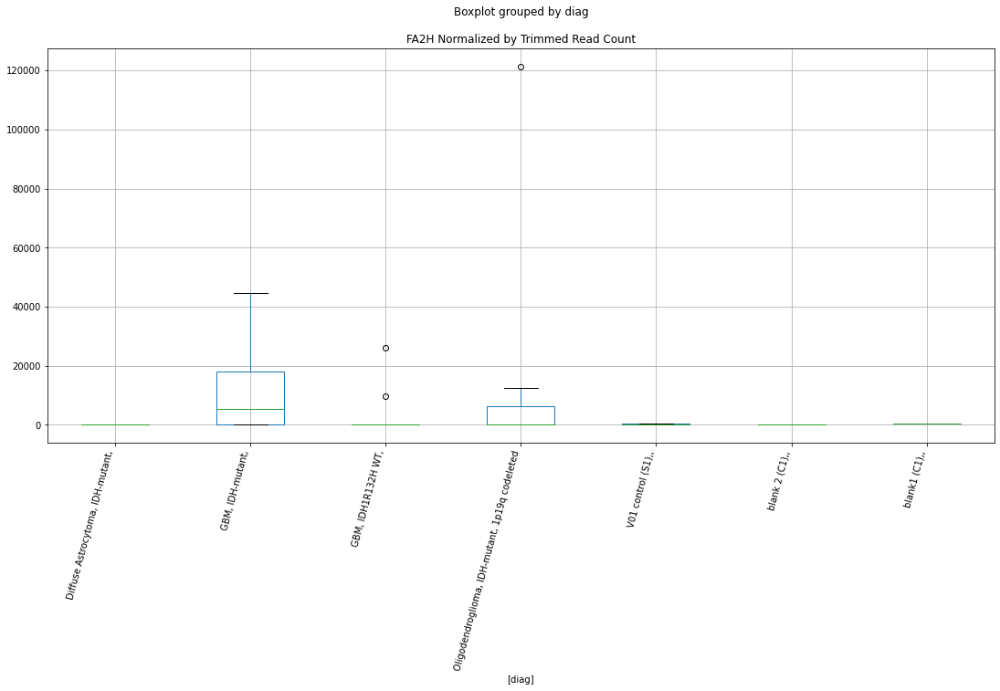

 p : 0.024994598257313767  ( t : 2.445110283556817 ) :  D-plex  :  cutadapt2  :  GATA1
Control and blanks
76     0.0
340    0.0
Name: GATA1, dtype: float64
208    6348.97
Name: GATA1, dtype: float64
472    6935.47
Name: GATA1, dtype: float64


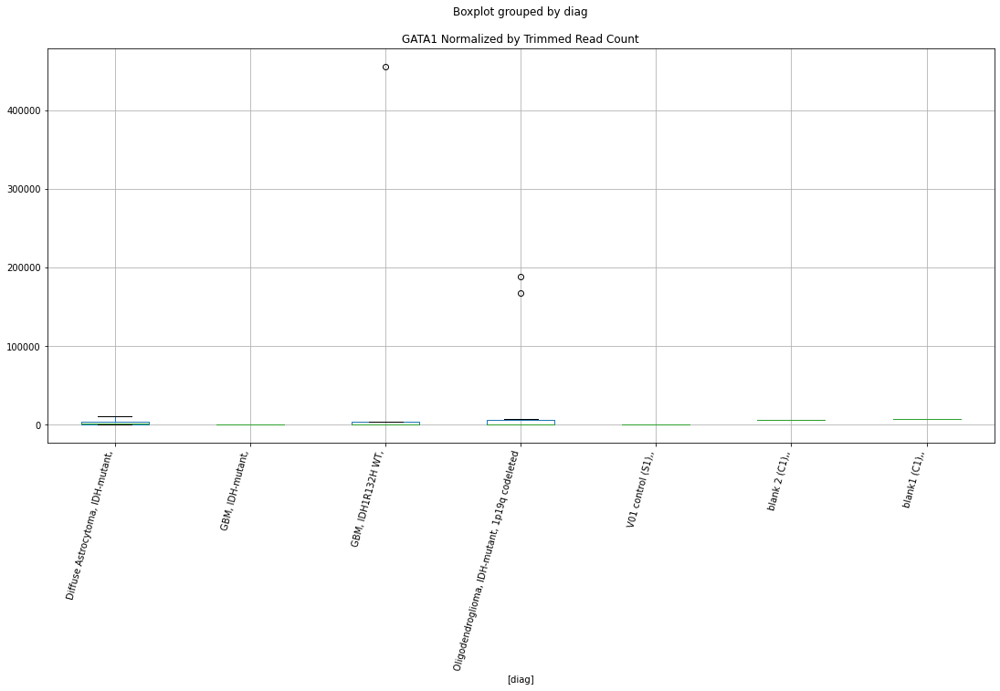

 p : 0.025004263190708573  ( t : 2.4449230256453403 ) :  D-plex  :  cutadapt2  :  FOCAD
Control and blanks
76     0.0
340    0.0
Name: FOCAD, dtype: float64
208    352.72
Name: FOCAD, dtype: float64
472    1155.91
Name: FOCAD, dtype: float64


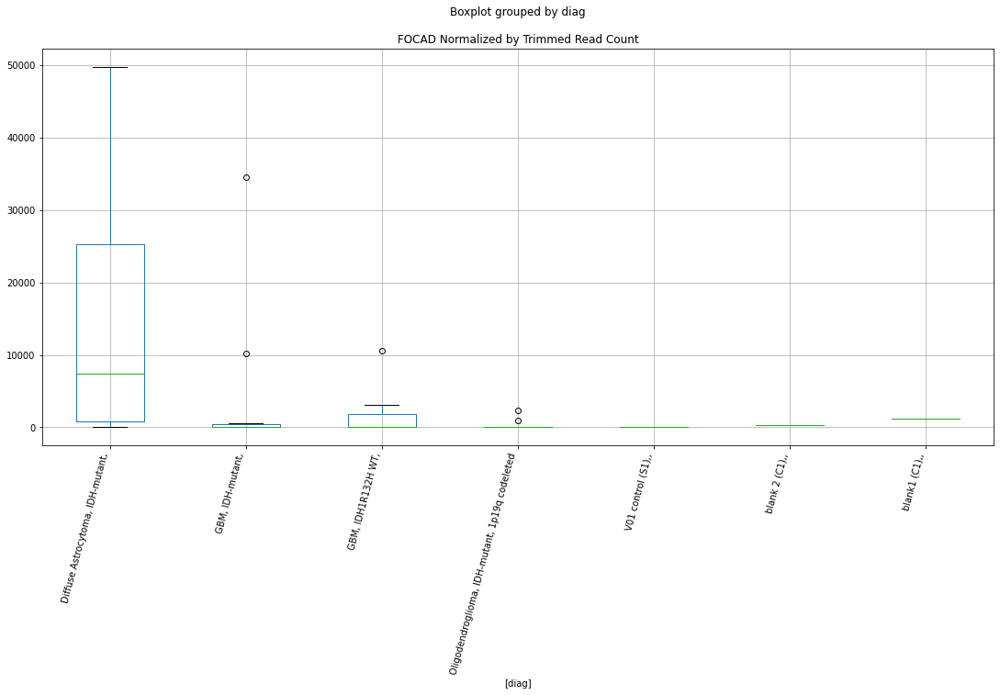

 p : 0.025107872061164604  ( t : 2.4429198612362844 ) :  Lexogen  :  cutadapt2  :  HNRNPM
Control and blanks
82        0.00
346    1052.17
Name: HNRNPM, dtype: float64
214    18985.85
Name: HNRNPM, dtype: float64
478    2374.6
Name: HNRNPM, dtype: float64


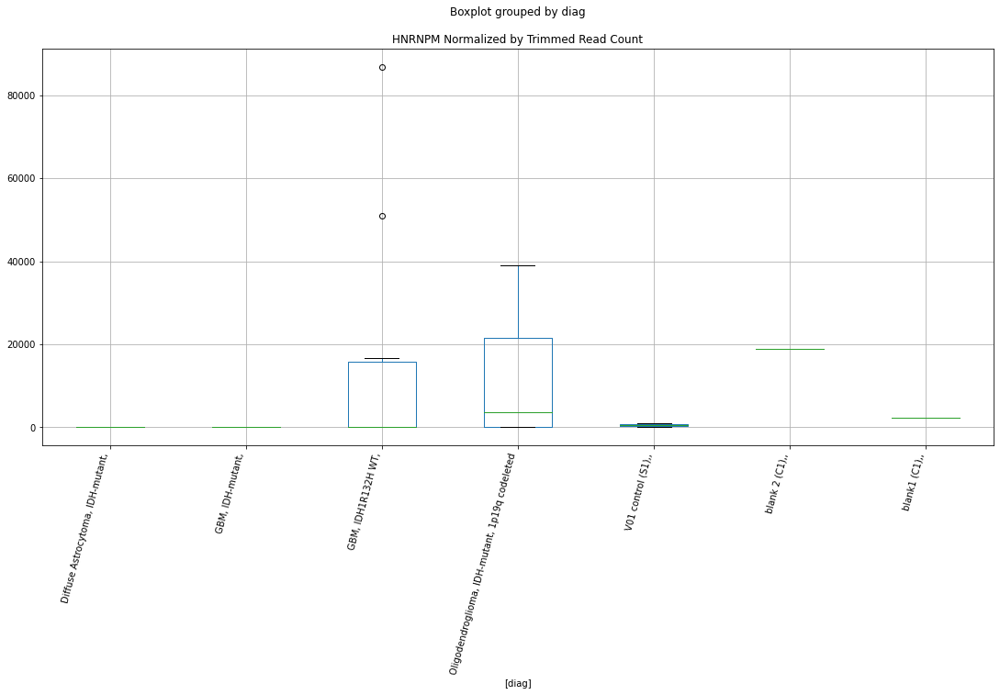

 p : 0.025123143631801886  ( t : 2.4426252581752017 ) :  Lexogen  :  bbduk2  :  GDPD5
Control and blanks
79     0.0
343    0.0
Name: GDPD5, dtype: float64
211    0.0
Name: GDPD5, dtype: float64
475    0.0
Name: GDPD5, dtype: float64


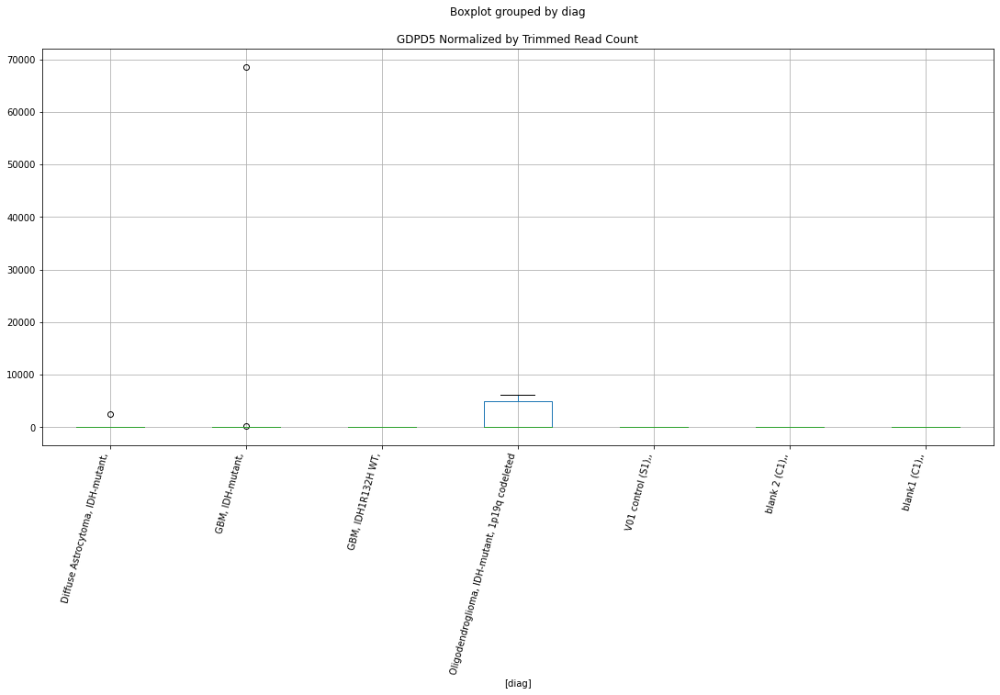

 p : 0.025141482476105783  ( t : 2.4422717064462973 ) :  D-plex  :  bbduk2  :  HAUS8
Control and blanks
73     0.0
337    0.0
Name: HAUS8, dtype: float64
205    3223.64
Name: HAUS8, dtype: float64
469    1774.58
Name: HAUS8, dtype: float64


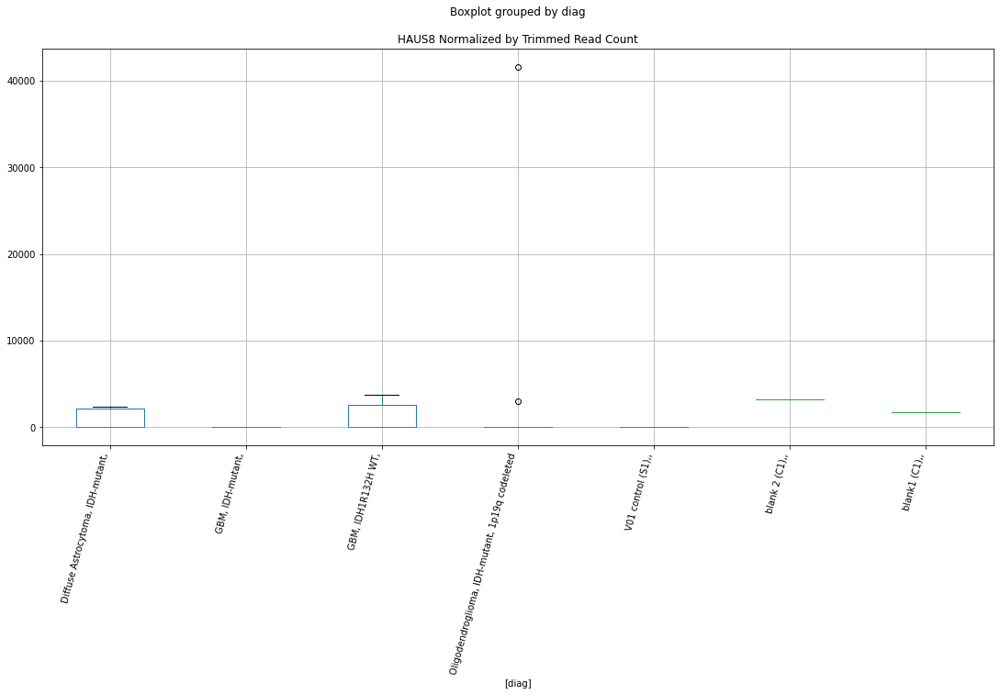

 p : 0.02515308427736505  ( t : 2.4420481620551246 ) :  Lexogen  :  cutadapt2  :  GDPD5
Control and blanks
82     0.0
346    0.0
Name: GDPD5, dtype: float64
214    0.0
Name: GDPD5, dtype: float64
478    0.0
Name: GDPD5, dtype: float64


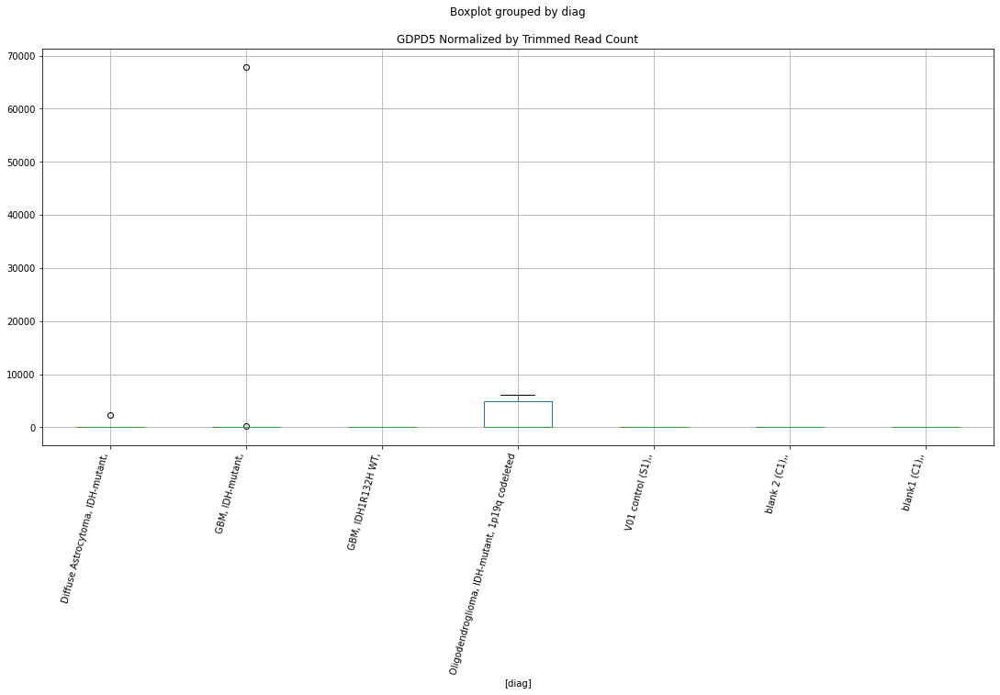

 p : 0.025177543084347852  ( t : 2.4415772046621425 ) :  Lexogen  :  bbduk2  :  HNRNPM
Control and blanks
79        0.00
343    1061.57
Name: HNRNPM, dtype: float64
211    19131.44
Name: HNRNPM, dtype: float64
475    2395.16
Name: HNRNPM, dtype: float64


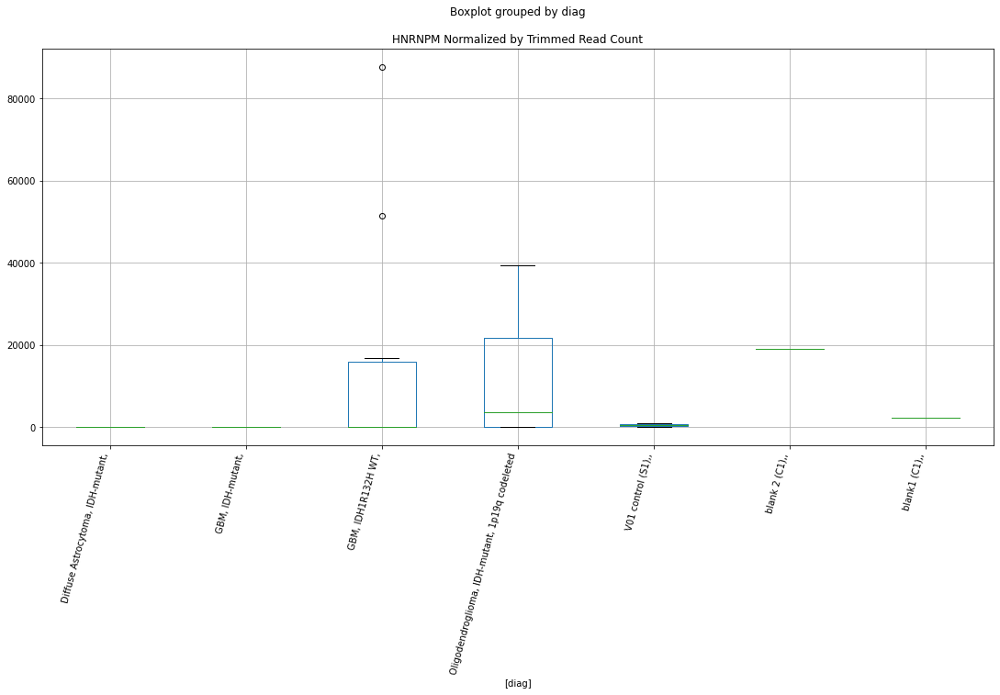

 p : 0.02518477274309524  ( t : 2.4414380788626535 ) :  D-plex  :  cutadapt2  :  HAUS8
Control and blanks
76     0.0
340    0.0
Name: HAUS8, dtype: float64
208    3174.48
Name: HAUS8, dtype: float64
472    1733.87
Name: HAUS8, dtype: float64


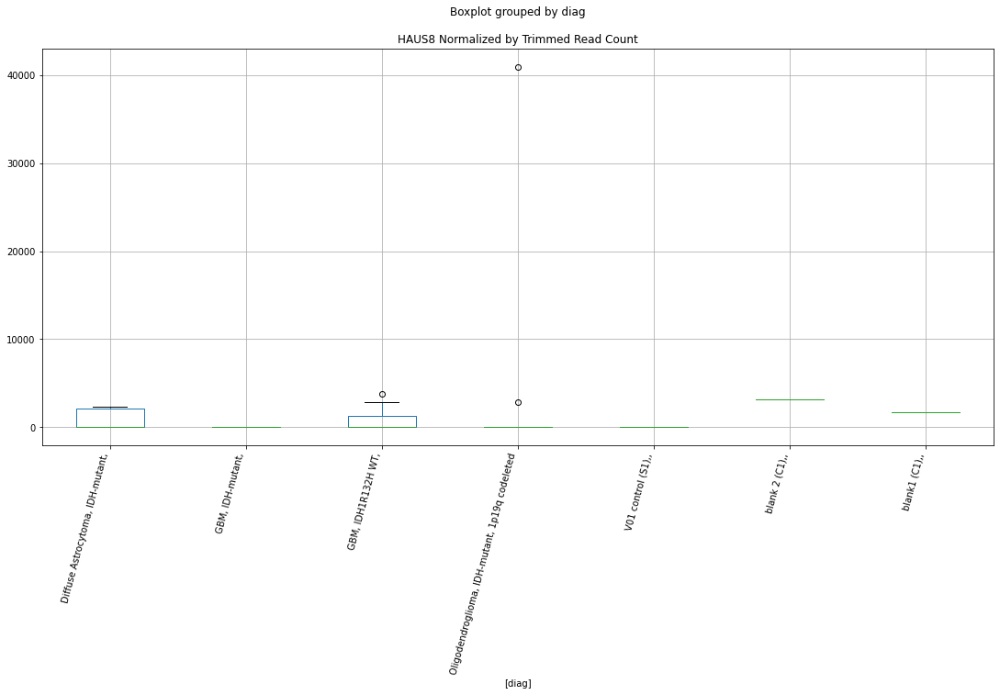

 p : 0.025199583670617448  ( t : 2.441153177929899 ) :  D-plex  :  bbduk2  :  FOCAD
Control and blanks
73     0.0
337    0.0
Name: FOCAD, dtype: float64
205    358.18
Name: FOCAD, dtype: float64
469    1183.05
Name: FOCAD, dtype: float64


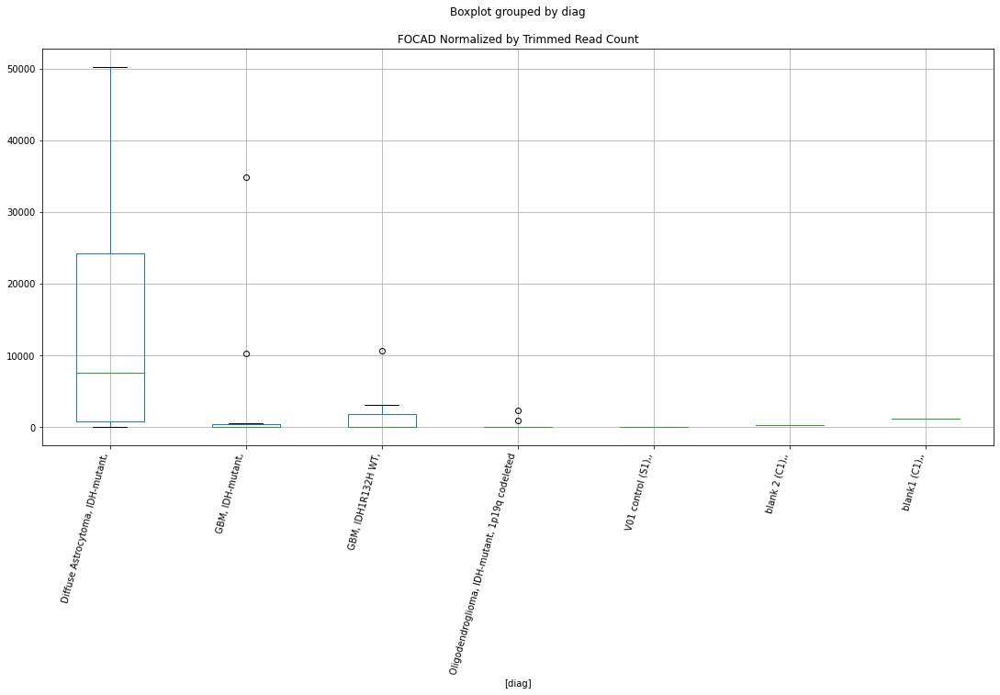

 p : 0.02524494249972825  ( t : 2.4402816379946777 ) :  D-plex  :  cutadapt2  :  HOXC5
Control and blanks
76     23486.04
340        0.00
Name: HOXC5, dtype: float64
208    176.36
Name: HOXC5, dtype: float64
472    1155.91
Name: HOXC5, dtype: float64


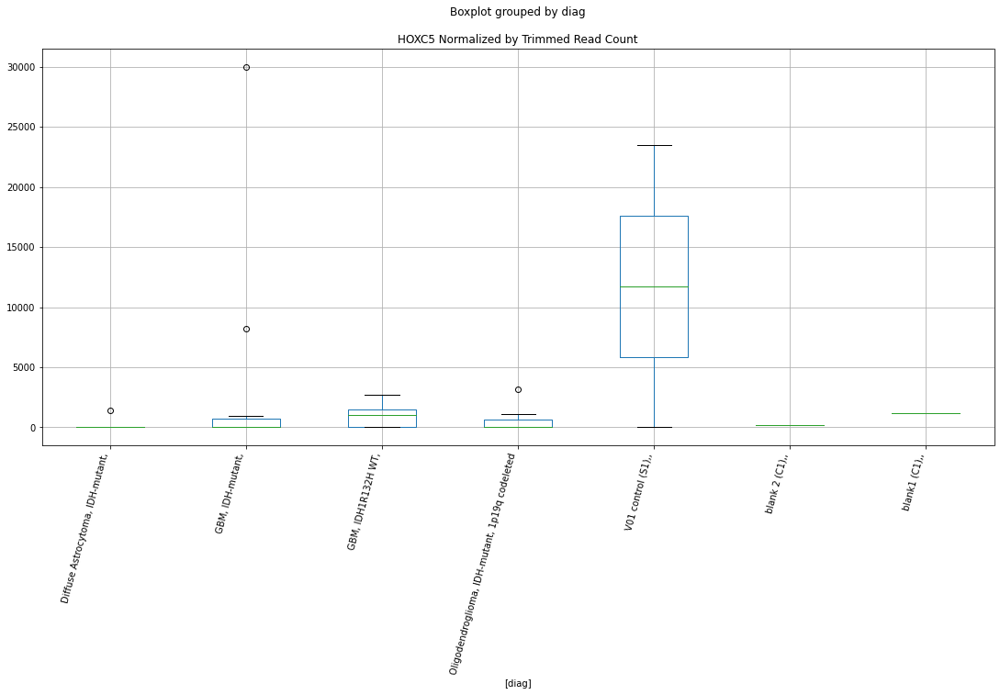

 p : 0.0253394770383458  ( t : 2.438469930347746 ) :  D-plex  :  bbduk2  :  FRMPD4
Control and blanks
73     13141.14
337        0.00
Name: FRMPD4, dtype: float64
205    20774.55
Name: FRMPD4, dtype: float64
469    21886.51
Name: FRMPD4, dtype: float64


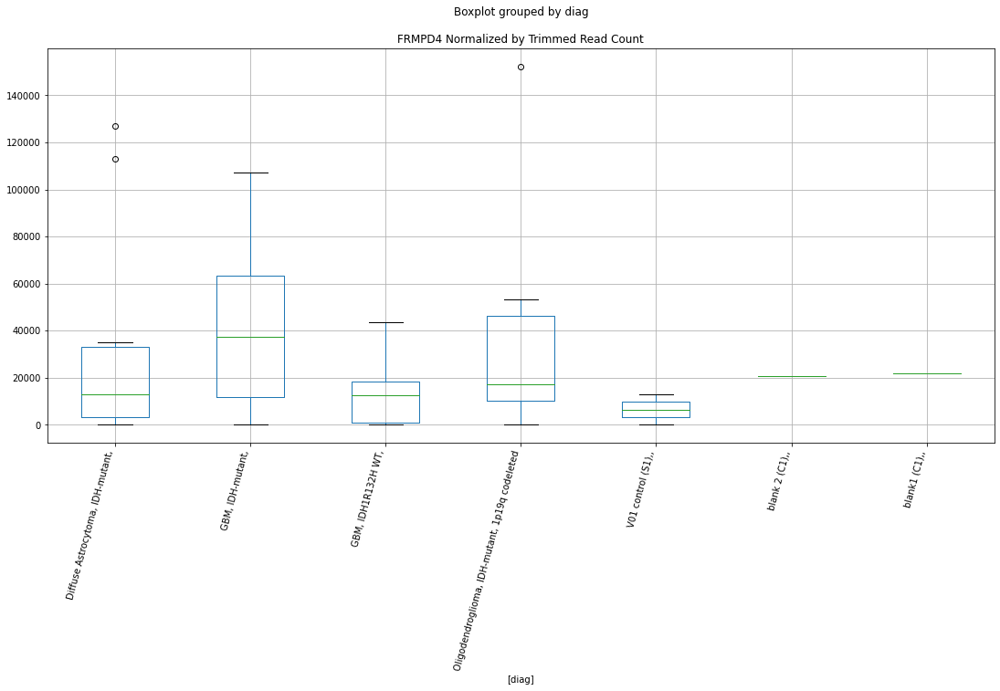

 p : 0.025363530952918833  ( t : 2.4380099608015344 ) :  Lexogen  :  cutadapt2  :  KCNV1
Control and blanks
82     17040.61
346      210.43
Name: KCNV1, dtype: float64
214    8408.02
Name: KCNV1, dtype: float64
478    0.0
Name: KCNV1, dtype: float64


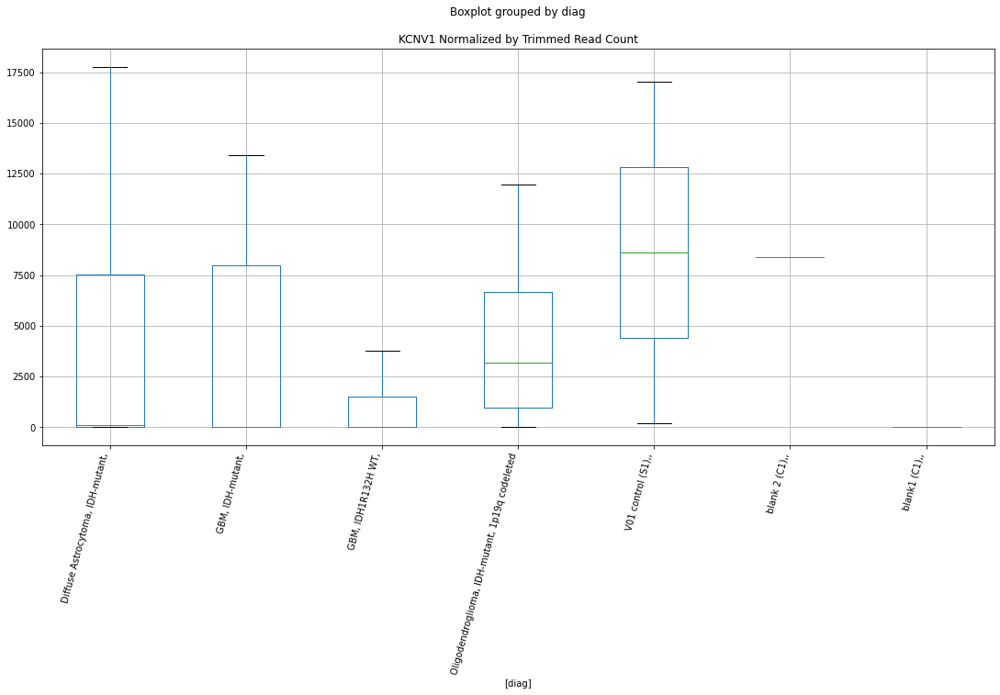

 p : 0.025388782878381373  ( t : 2.4375275223548396 ) :  D-plex  :  bbduk2  :  KHDC3L
Control and blanks
73     0.0
337    0.0
Name: KHDC3L, dtype: float64
205    895.45
Name: KHDC3L, dtype: float64
469    4140.69
Name: KHDC3L, dtype: float64


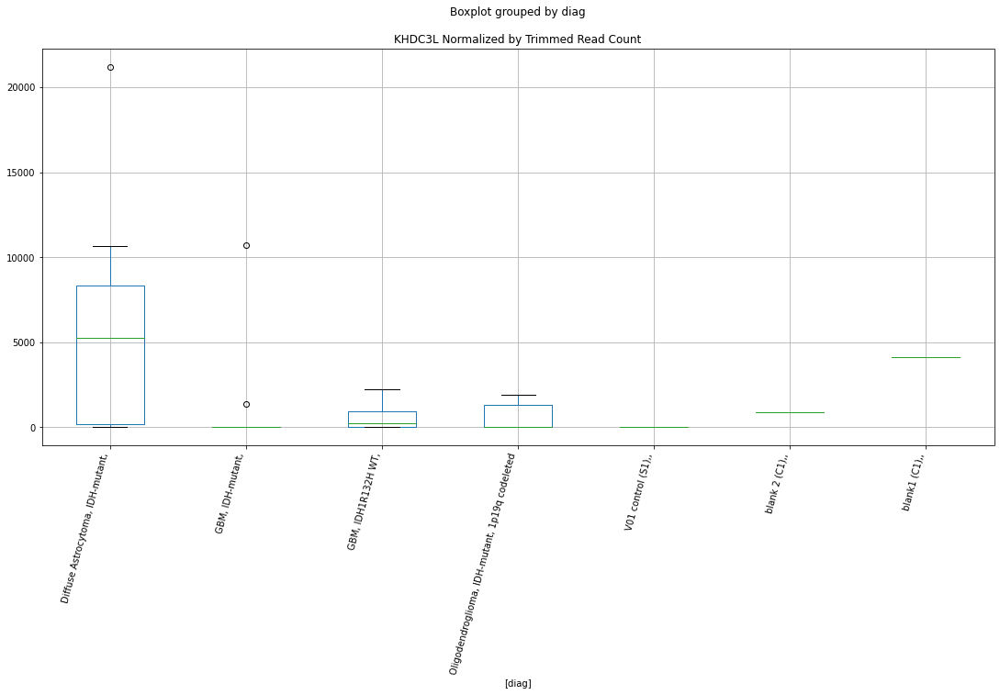

 p : 0.02542432034653071  ( t : 2.436849340192294 ) :  D-plex  :  cutadapt2  :  IFT80
Control and blanks
76      9091.37
340    42275.14
Name: IFT80, dtype: float64
208    40210.13
Name: IFT80, dtype: float64
472    41612.82
Name: IFT80, dtype: float64


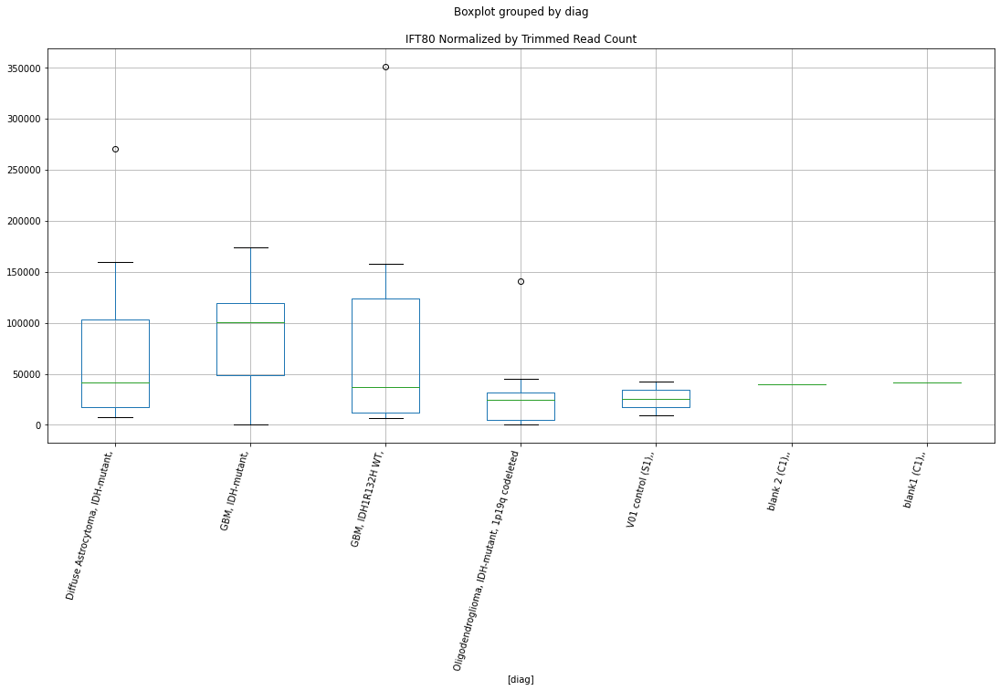

 p : 0.025425037530823896  ( t : 2.4368356629012315 ) :  D-plex  :  cutadapt2  :  DRG2
Control and blanks
76     0.0
340    0.0
Name: DRG2, dtype: float64
208    10581.61
Name: DRG2, dtype: float64
472    11559.12
Name: DRG2, dtype: float64


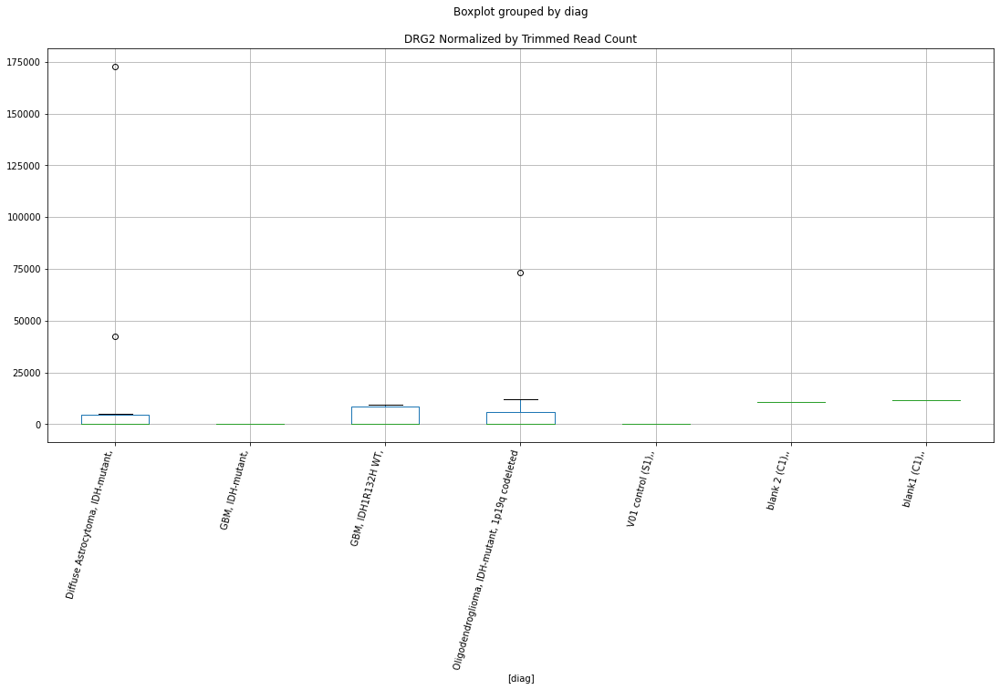

 p : 0.02543358807128187  ( t : 2.436672624966499 ) :  D-plex  :  cutadapt2  :  FOXD1
Control and blanks
76     0.0
340    0.0
Name: FOXD1, dtype: float64
208    705.44
Name: FOXD1, dtype: float64
472    1155.91
Name: FOXD1, dtype: float64


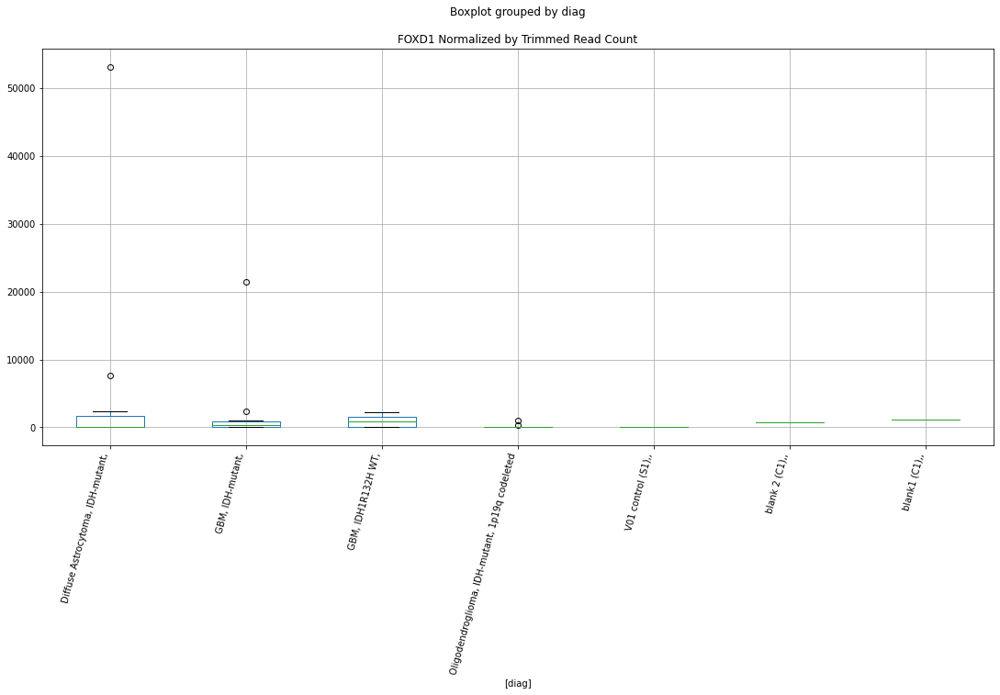

 p : 0.025472588282671516  ( t : 2.435929637432479 ) :  D-plex  :  bbduk2  :  DRG2
Control and blanks
73     0.0
337    0.0
Name: DRG2, dtype: float64
205    10745.46
Name: DRG2, dtype: float64
469    11830.55
Name: DRG2, dtype: float64


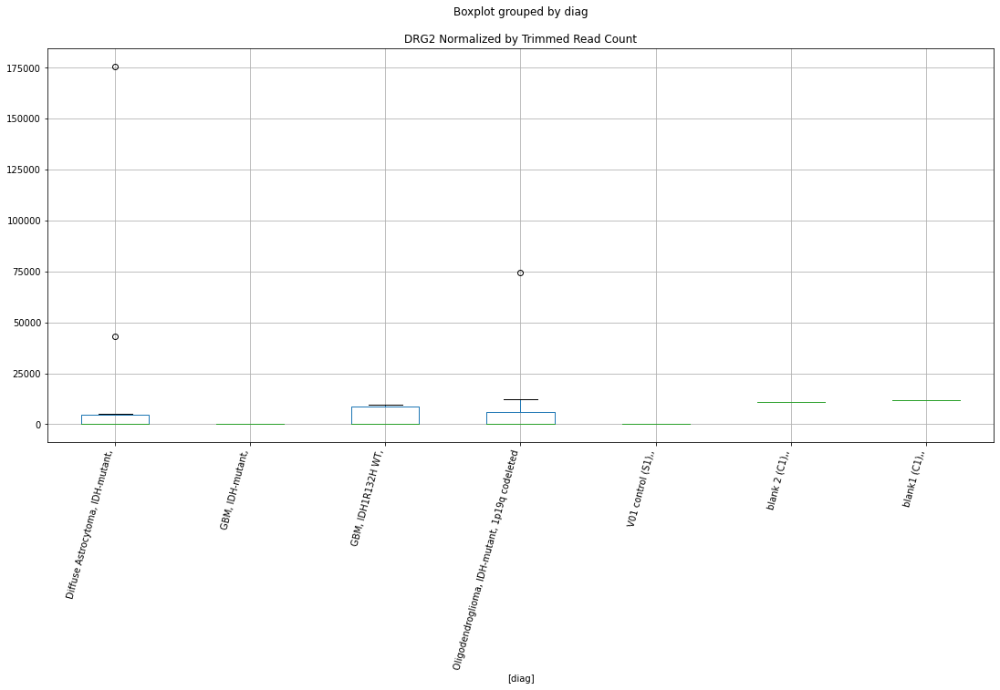

 p : 0.02550787073281126  ( t : 2.4352583949273843 ) :  D-plex  :  cutadapt2  :  HCFC1R1
Control and blanks
76     252285.53
340         0.00
Name: HCFC1R1, dtype: float64
208    2645.4
Name: HCFC1R1, dtype: float64
472    8669.34
Name: HCFC1R1, dtype: float64


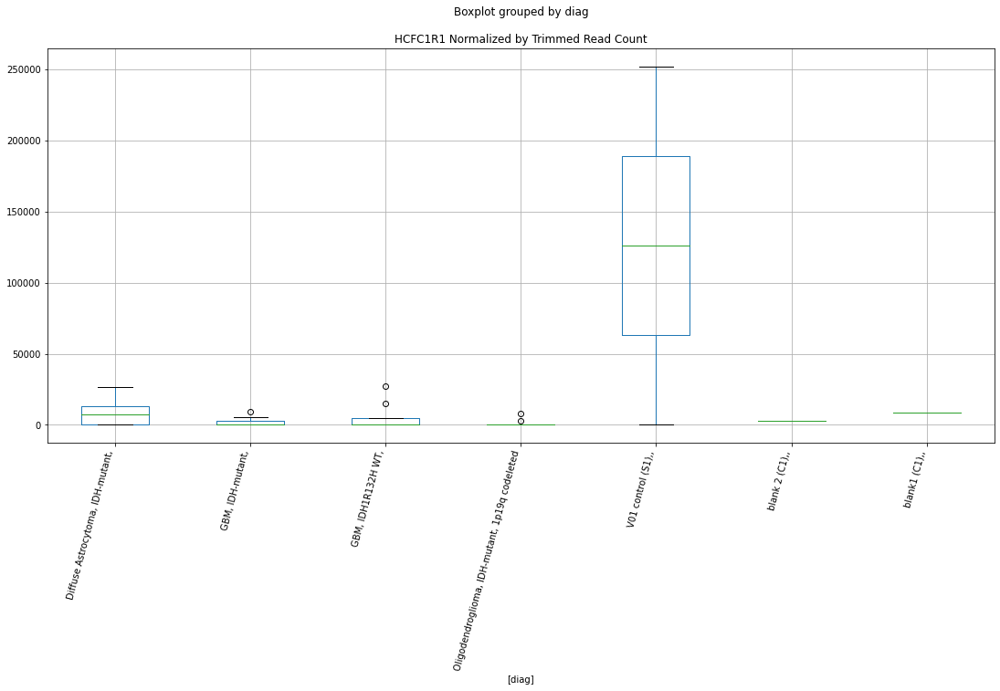

 p : 0.025510892207790698  ( t : 2.435200952367059 ) :  D-plex  :  bbduk2  :  GTSE1
Control and blanks
73     0.0
337    0.0
Name: GTSE1, dtype: float64
205    1074.55
Name: GTSE1, dtype: float64
469    1774.58
Name: GTSE1, dtype: float64


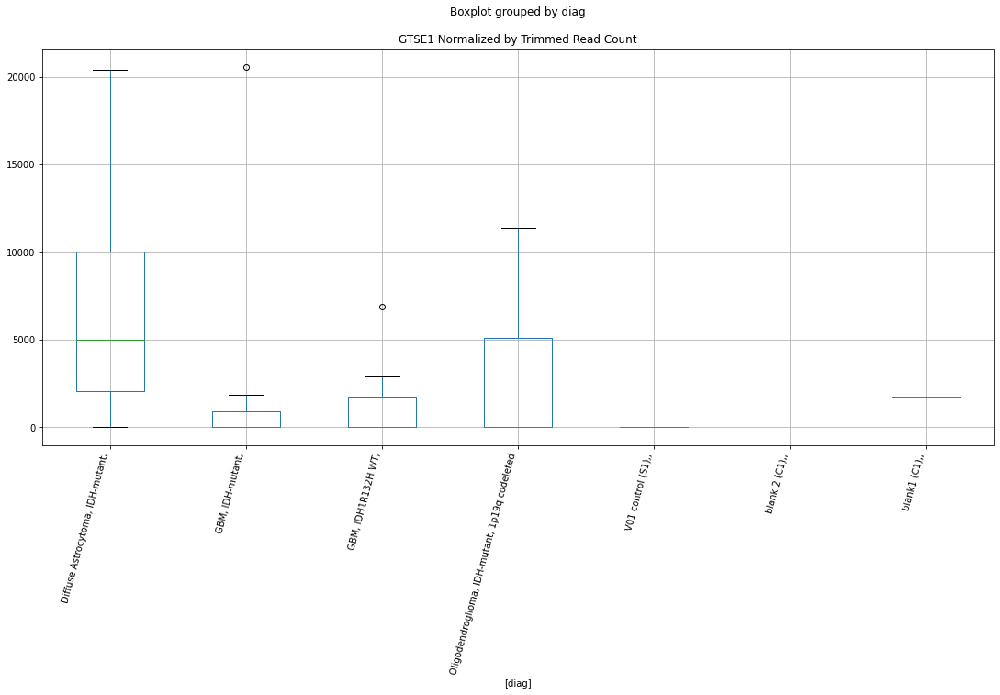

 p : 0.025596758595976203  ( t : 2.4335711704494236 ) :  Lexogen  :  bbduk2  :  LAMA2
Control and blanks
79      10014.19
343    119108.33
Name: LAMA2, dtype: float64
211    3826.29
Name: LAMA2, dtype: float64
475    43831.38
Name: LAMA2, dtype: float64


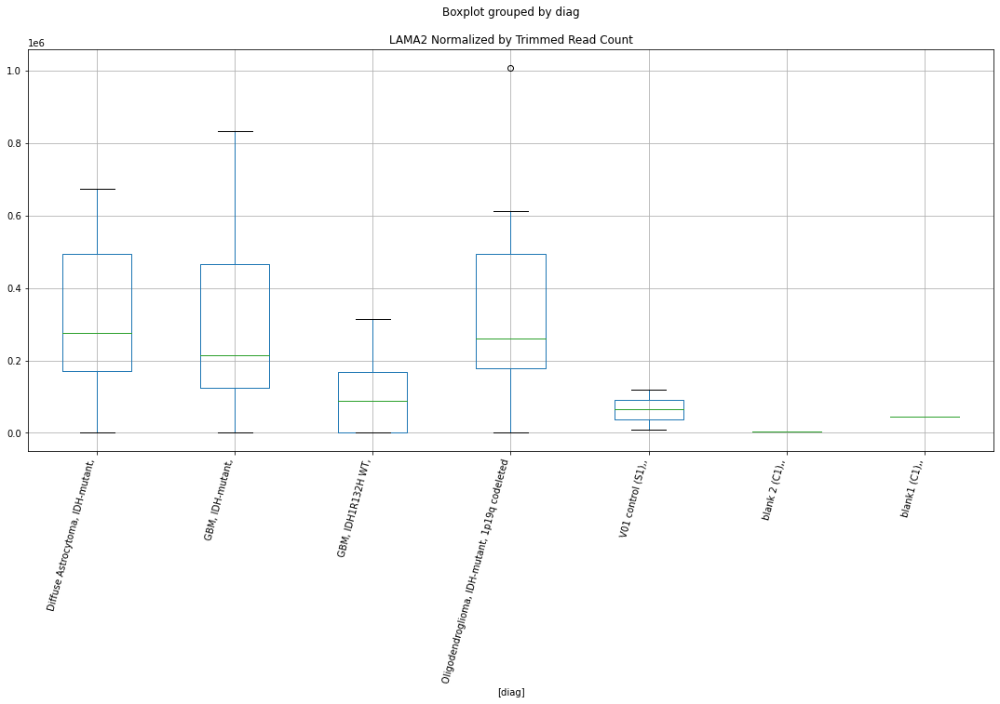

 p : 0.025635987135082063  ( t : 2.4328283006728673 ) :  D-plex  :  cutadapt2  :  LARS2
Control and blanks
76     116672.59
340         0.00
Name: LARS2, dtype: float64
208    8818.01
Name: LARS2, dtype: float64
472    19650.5
Name: LARS2, dtype: float64


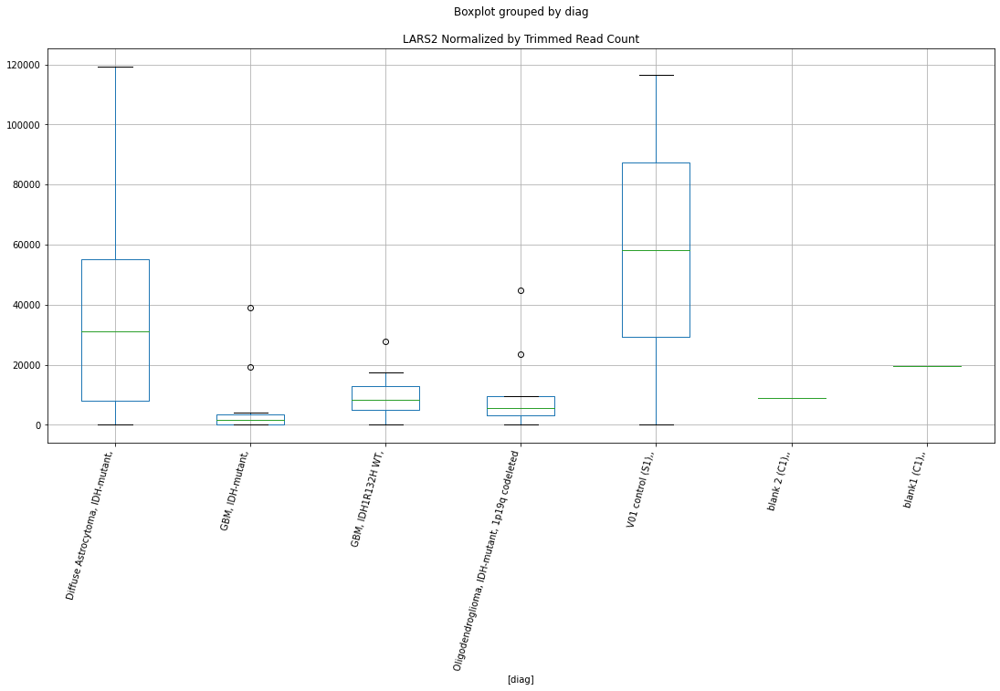

 p : 0.02578097750417712  ( t : 2.4300918390802417 ) :  D-plex  :  cutadapt2  :  ELAVL3
Control and blanks
76     15909.9
340        0.0
Name: ELAVL3, dtype: float64
208    274769.22
Name: ELAVL3, dtype: float64
472    12137.07
Name: ELAVL3, dtype: float64


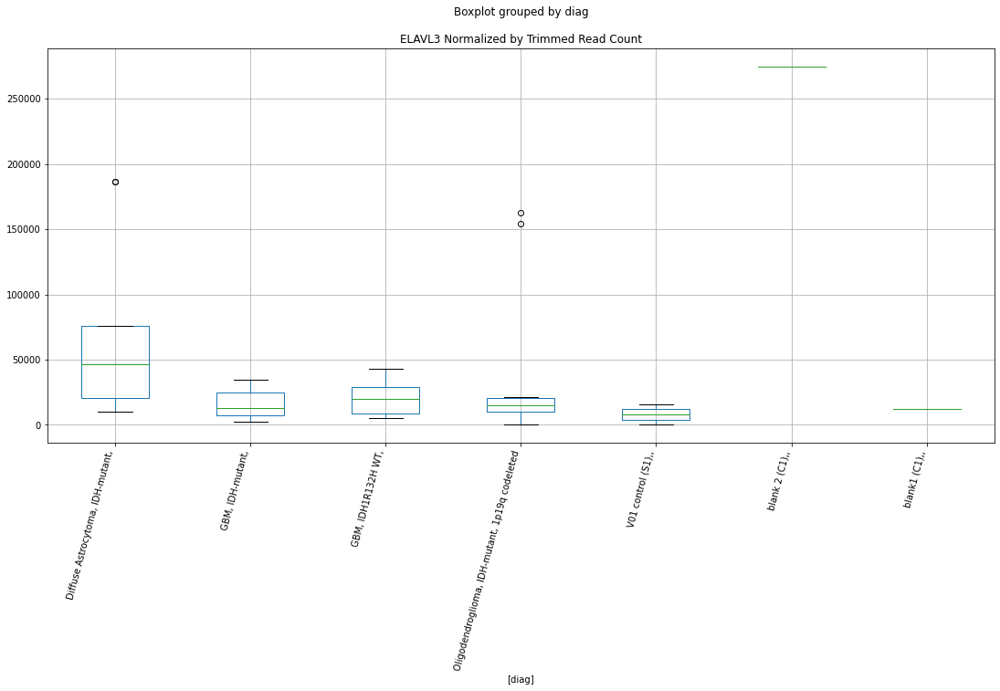

 p : 0.025783359312817895  ( t : 2.4300470067965136 ) :  D-plex  :  bbduk2  :  KCND3
Control and blanks
73     0.0
337    0.0
Name: KCND3, dtype: float64
205    10745.46
Name: KCND3, dtype: float64
469    20111.93
Name: KCND3, dtype: float64


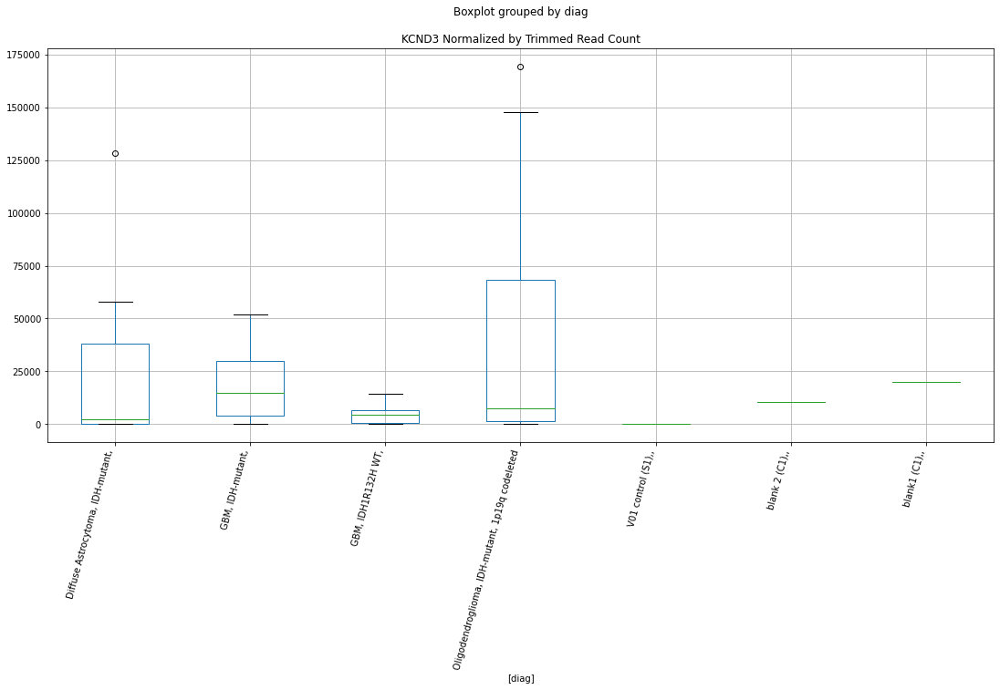

 p : 0.025800123722464933  ( t : 2.4297315636066648 ) :  Lexogen  :  bbduk2  :  JUP
Control and blanks
79     0.0
343    0.0
Name: JUP, dtype: float64
211    0.0
Name: JUP, dtype: float64
475    0.0
Name: JUP, dtype: float64


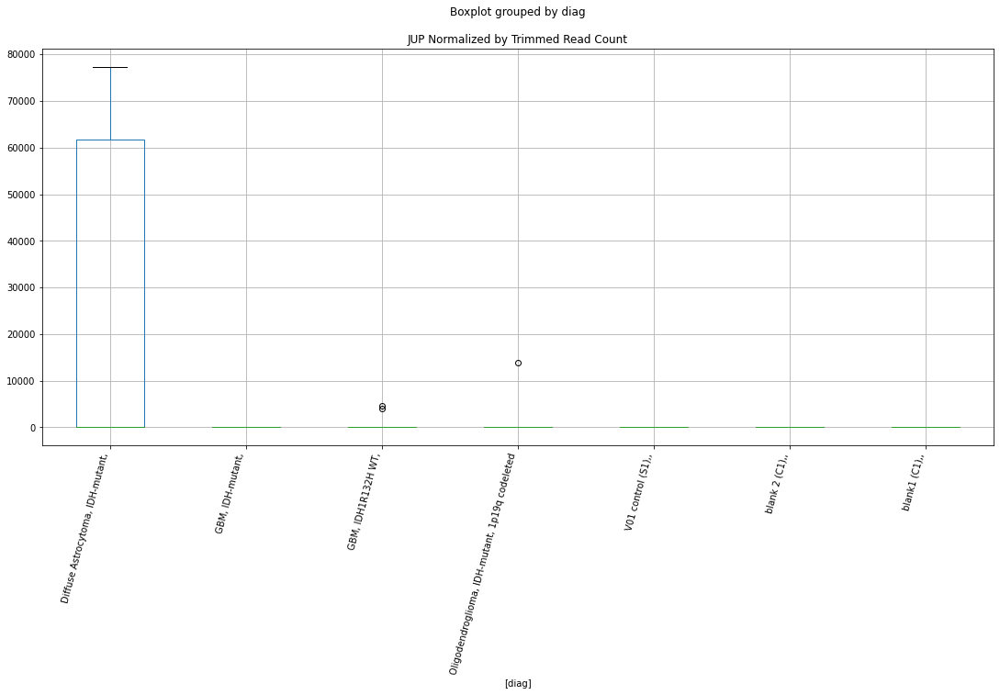

 p : 0.025803915790947648  ( t : 2.4296602377715373 ) :  D-plex  :  cutadapt2  :  DMBT1
Control and blanks
76     0.0
340    0.0
Name: DMBT1, dtype: float64
208    27159.47
Name: DMBT1, dtype: float64
472    16760.72
Name: DMBT1, dtype: float64


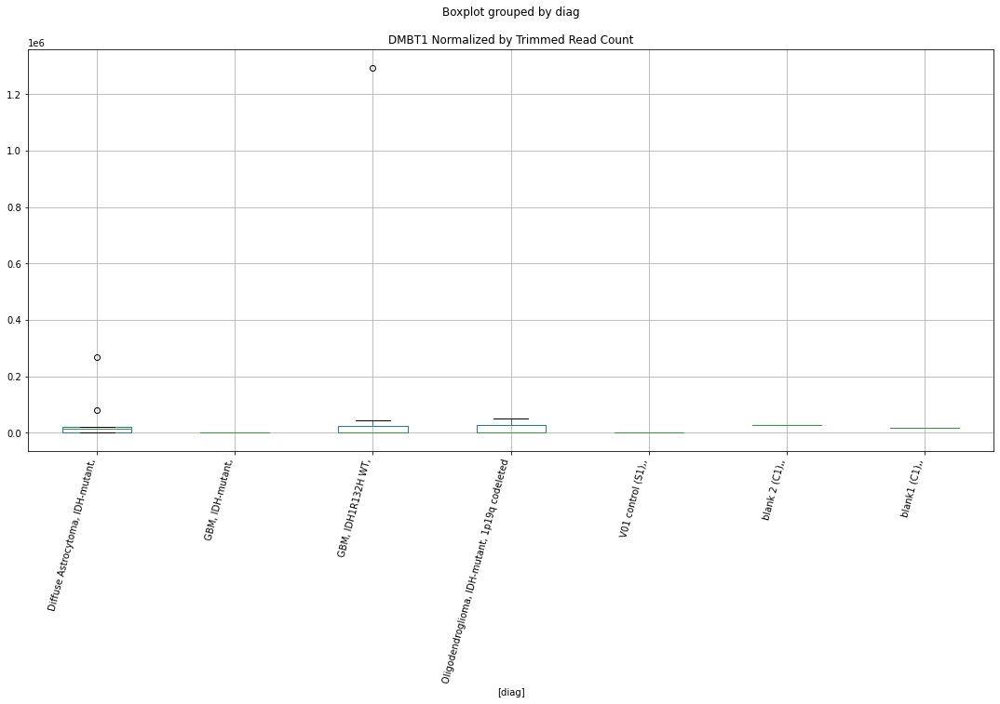

 p : 0.025812031684769077  ( t : 2.4295076171797607 ) :  Lexogen  :  cutadapt2  :  JUP
Control and blanks
82     0.0
346    0.0
Name: JUP, dtype: float64
214    0.0
Name: JUP, dtype: float64
478    0.0
Name: JUP, dtype: float64


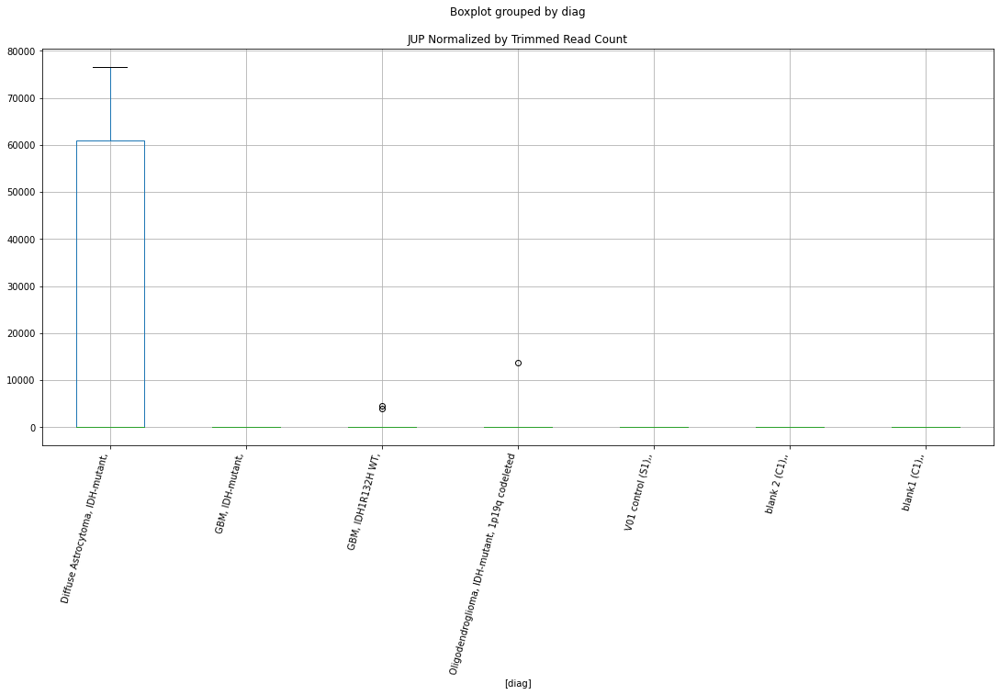

 p : 0.026068621607956425  ( t : 2.4247054456301735 ) :  D-plex  :  bbduk2  :  HOXA9
Control and blanks
73     0.0
337    0.0
Name: HOXA9, dtype: float64
205    179.09
Name: HOXA9, dtype: float64
469    1183.05
Name: HOXA9, dtype: float64


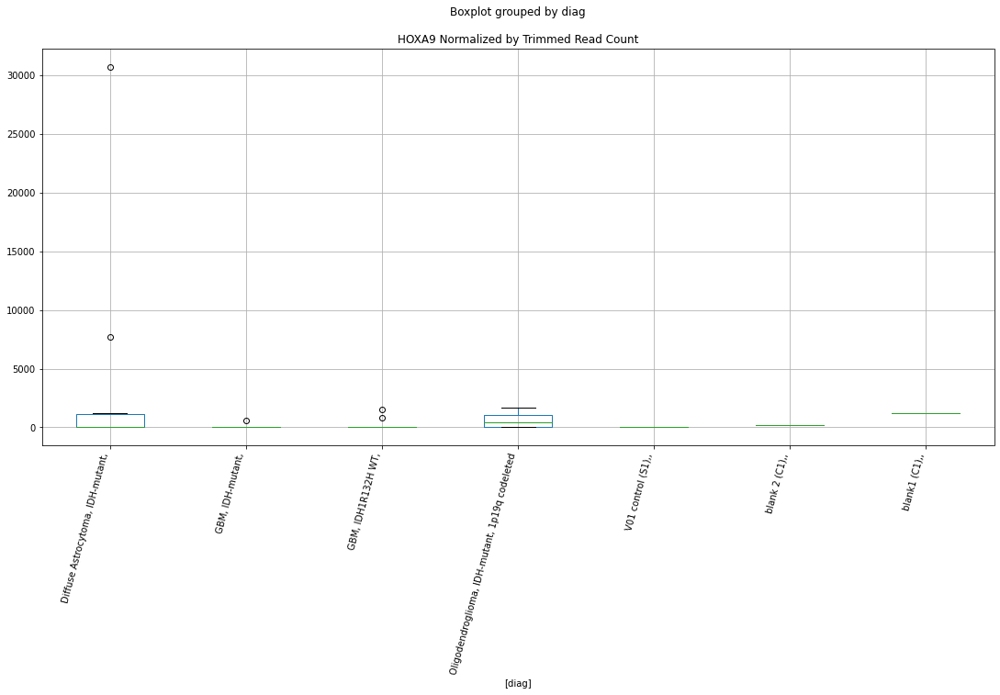

 p : 0.026164735733029285  ( t : 2.422918030465493 ) :  D-plex  :  cutadapt2  :  JARID2
Control and blanks
76     6060.91
340       0.00
Name: JARID2, dtype: float64
208    41797.37
Name: JARID2, dtype: float64
472    43346.69
Name: JARID2, dtype: float64


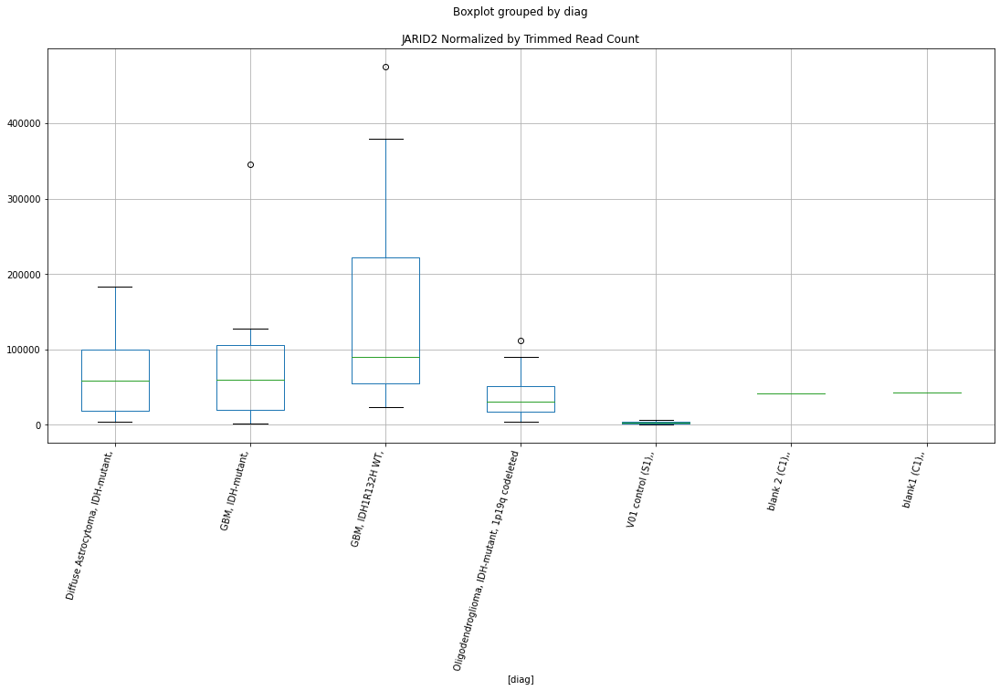

 p : 0.02623980456626603  ( t : 2.421526263379897 ) :  D-plex  :  bbduk2  :  HAUS6
Control and blanks
73     115951.26
337         0.00
Name: HAUS6, dtype: float64
205    3402.73
Name: HAUS6, dtype: float64
469    3549.16
Name: HAUS6, dtype: float64


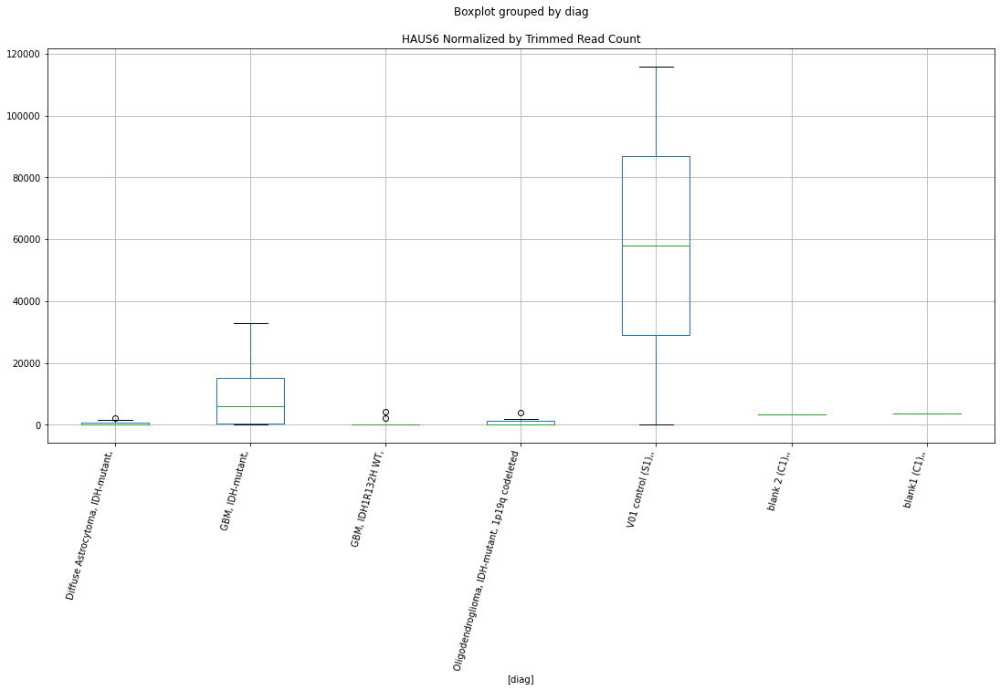

 p : 0.02632240957630005  ( t : 2.419999079849648 ) :  Lexogen  :  cutadapt2  :  EXOG
Control and blanks
82       0.0
346    631.3
Name: EXOG, dtype: float64
214    0.0
Name: EXOG, dtype: float64
478    0.0
Name: EXOG, dtype: float64


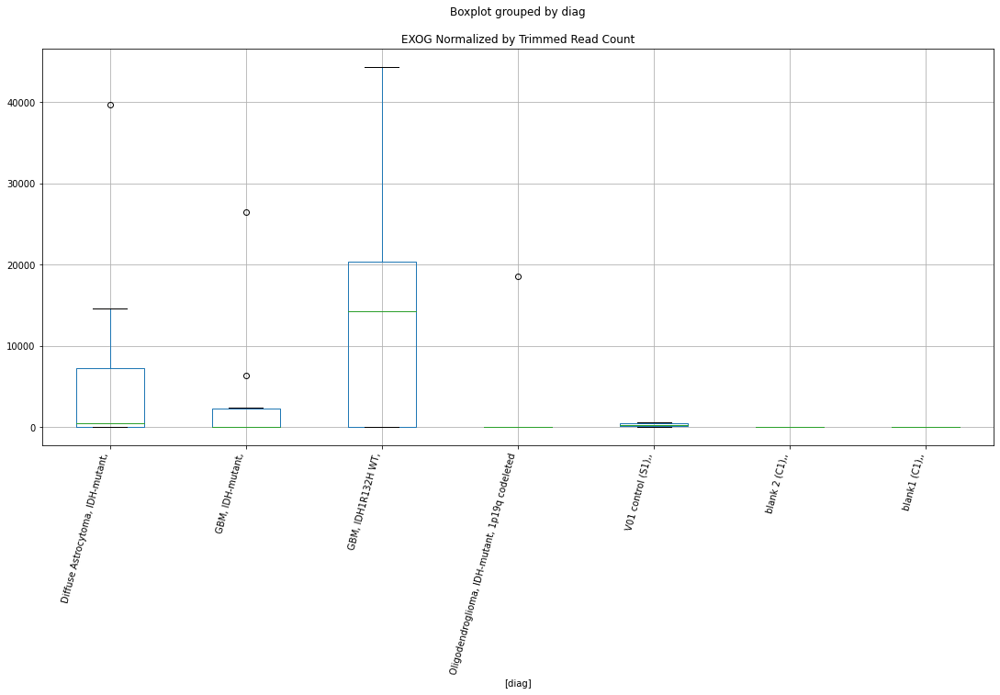

 p : 0.026353901498337166  ( t : 2.4194180455757093 ) :  Lexogen  :  cutadapt2  :  LAMA2
Control and blanks
82       9940.36
346    118053.77
Name: LAMA2, dtype: float64
214    3797.17
Name: LAMA2, dtype: float64
478    41555.58
Name: LAMA2, dtype: float64


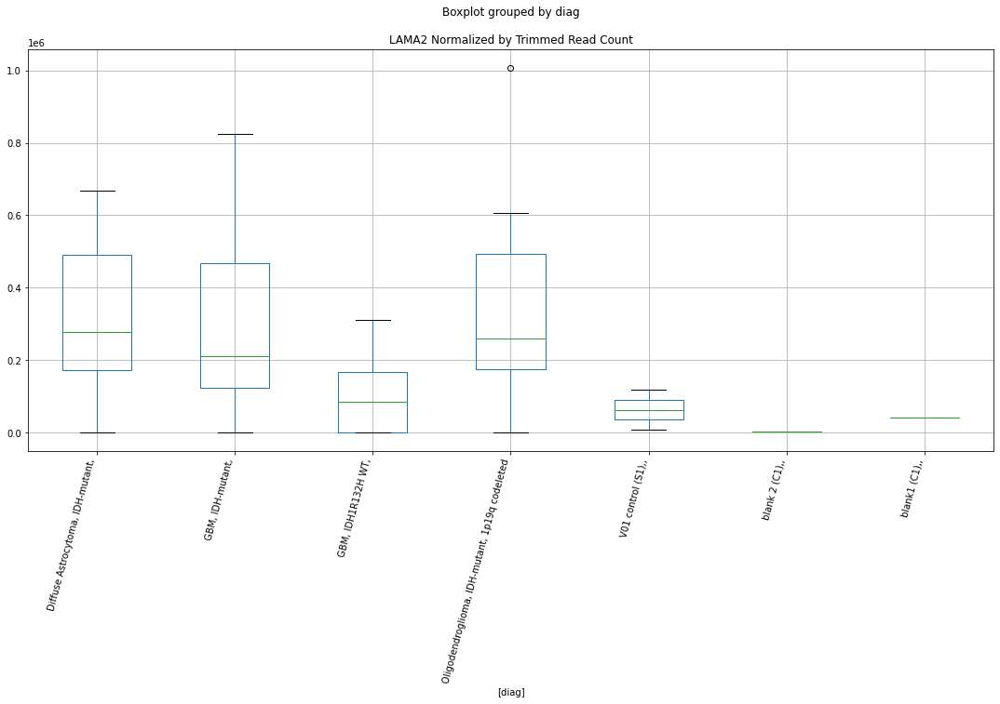

 p : 0.026399051064335207  ( t : 2.4185861575301377 ) :  D-plex  :  cutadapt2  :  HOXA9
Control and blanks
76     0.0
340    0.0
Name: HOXA9, dtype: float64
208    176.36
Name: HOXA9, dtype: float64
472    1155.91
Name: HOXA9, dtype: float64


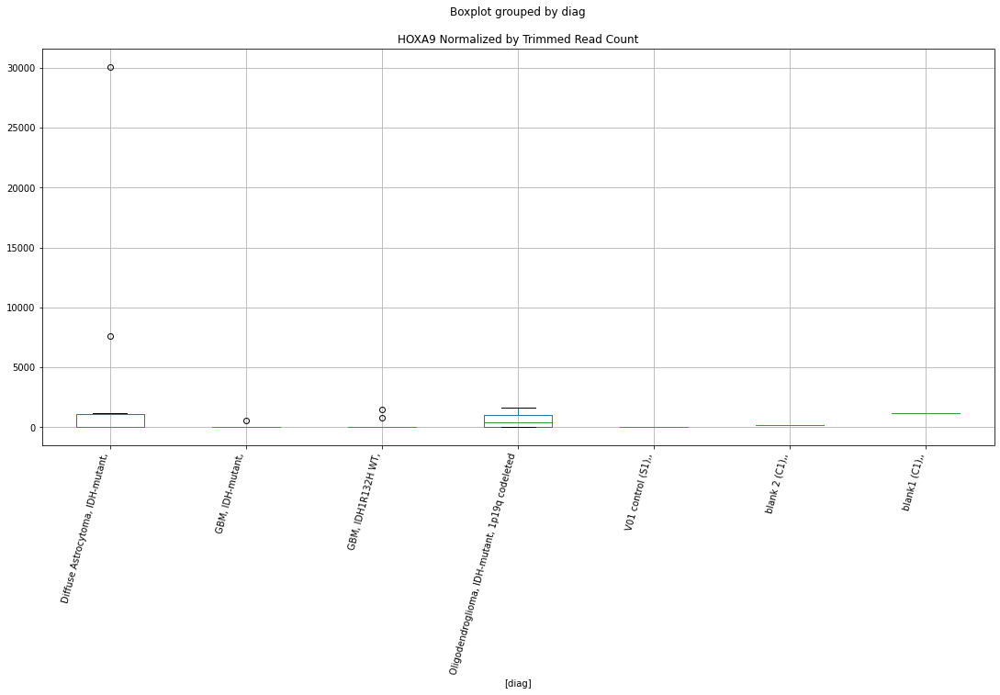

 p : 0.026413166683254052  ( t : 2.418326348352201 ) :  D-plex  :  bbduk2  :  KCNH4
Control and blanks
73     93534.02
337        0.00
Name: KCNH4, dtype: float64
205    15043.64
Name: KCNH4, dtype: float64
469    40815.38
Name: KCNH4, dtype: float64


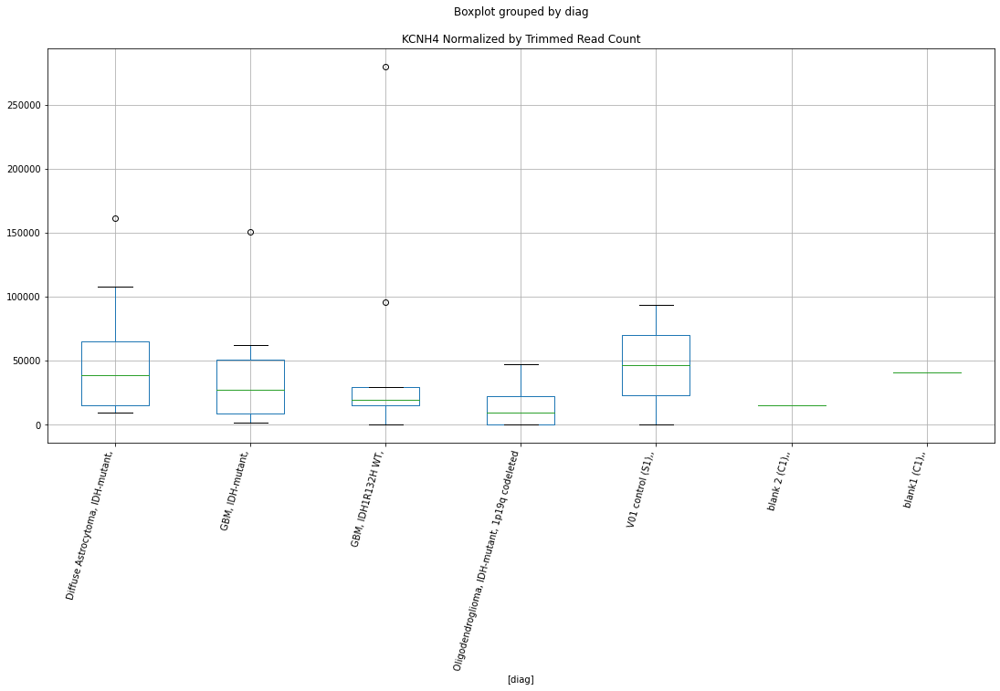

 p : 0.026421169268417838  ( t : 2.418179112161614 ) :  D-plex  :  bbduk2  :  EXO5
Control and blanks
73         0.0
337    12462.2
Name: EXO5, dtype: float64
205    12536.37
Name: EXO5, dtype: float64
469    8872.91
Name: EXO5, dtype: float64


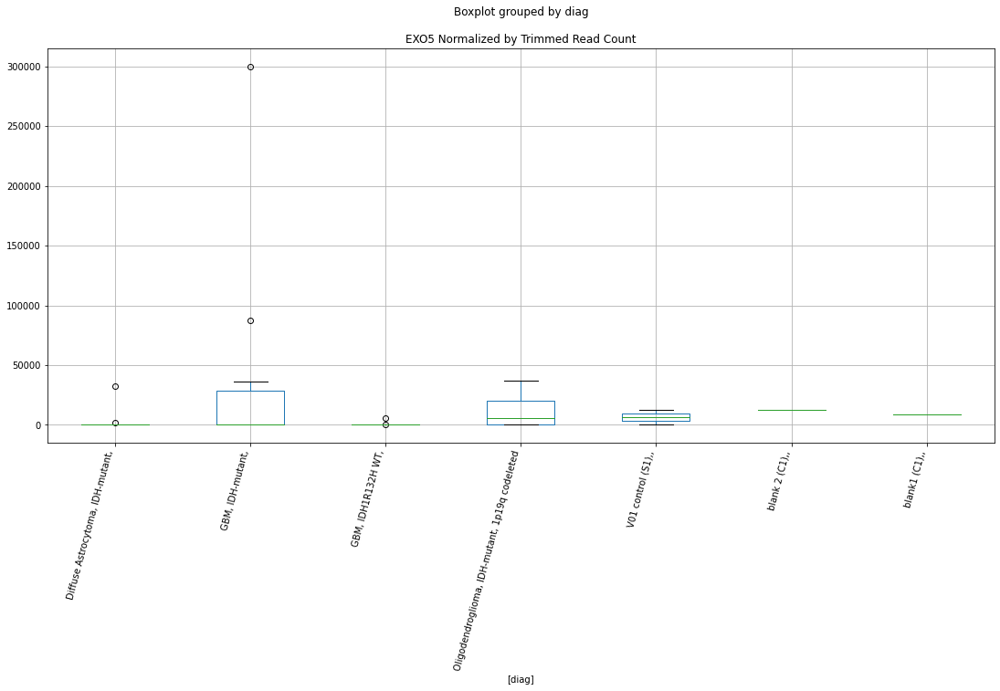

 p : 0.0264315504337008  ( t : 2.4179881756892434 ) :  D-plex  :  cutadapt2  :  LARP1
Control and blanks
76        0.00
340    7926.59
Name: LARP1, dtype: float64
208    11463.41
Name: LARP1, dtype: float64
472    22540.28
Name: LARP1, dtype: float64


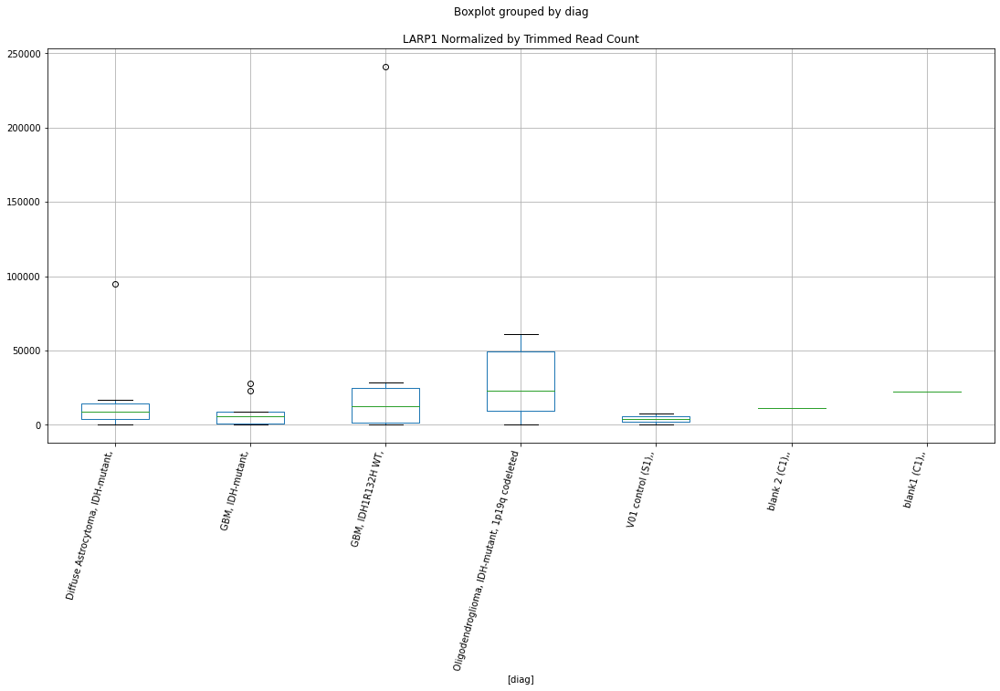

 p : 0.026436492629584557  ( t : 2.4178973006000426 ) :  D-plex  :  bbduk2  :  HDAC2
Control and blanks
73     3092.03
337       0.00
Name: HDAC2, dtype: float64
205    4477.27
Name: HDAC2, dtype: float64
469    5915.27
Name: HDAC2, dtype: float64


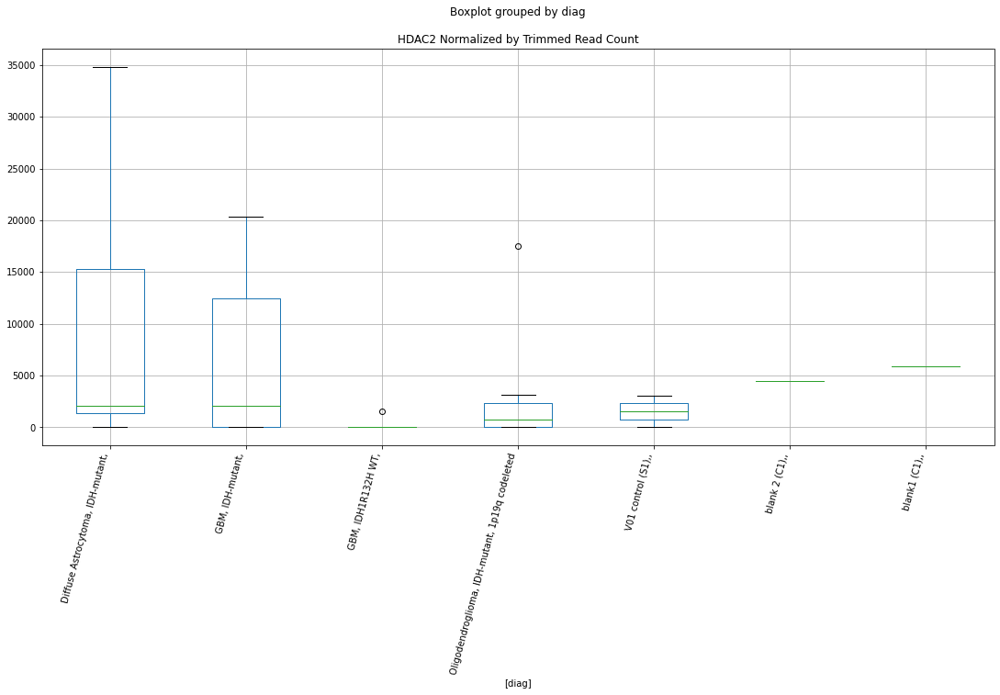

 p : 0.026450132529273192  ( t : 2.417646578182326 ) :  Lexogen  :  bbduk2  :  ECI1
Control and blanks
79     0.0
343    0.0
Name: ECI1, dtype: float64
211    0.0
Name: ECI1, dtype: float64
475    0.0
Name: ECI1, dtype: float64


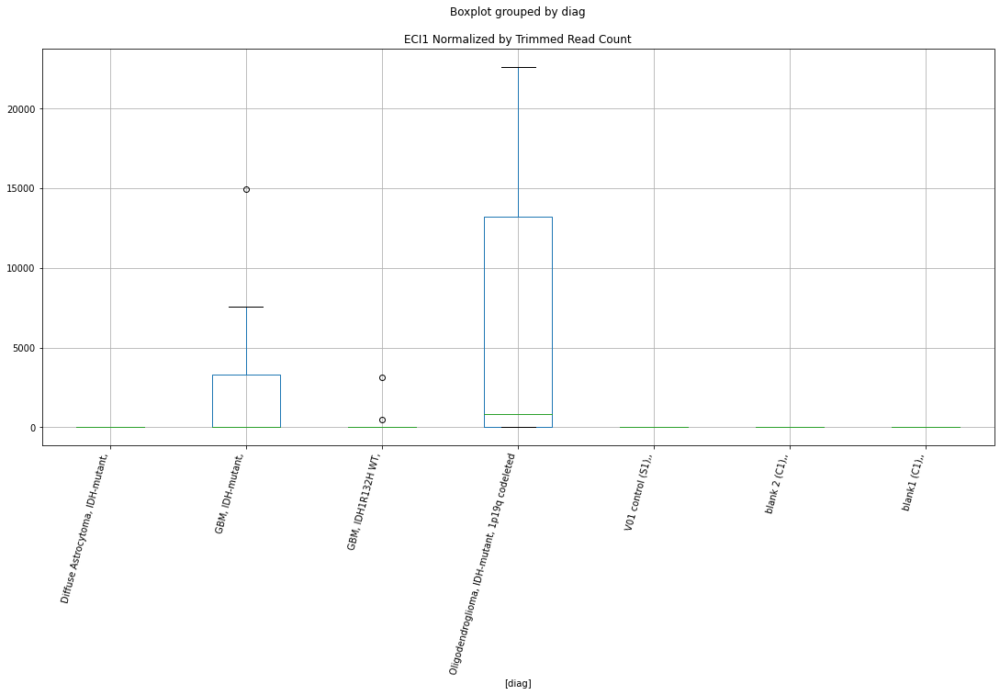

 p : 0.026537418755285935  ( t : 2.416044982973712 ) :  D-plex  :  bbduk2  :  HYAL4
Control and blanks
73     0.0
337    0.0
Name: HYAL4, dtype: float64
205    0.0
Name: HYAL4, dtype: float64
469    0.0
Name: HYAL4, dtype: float64


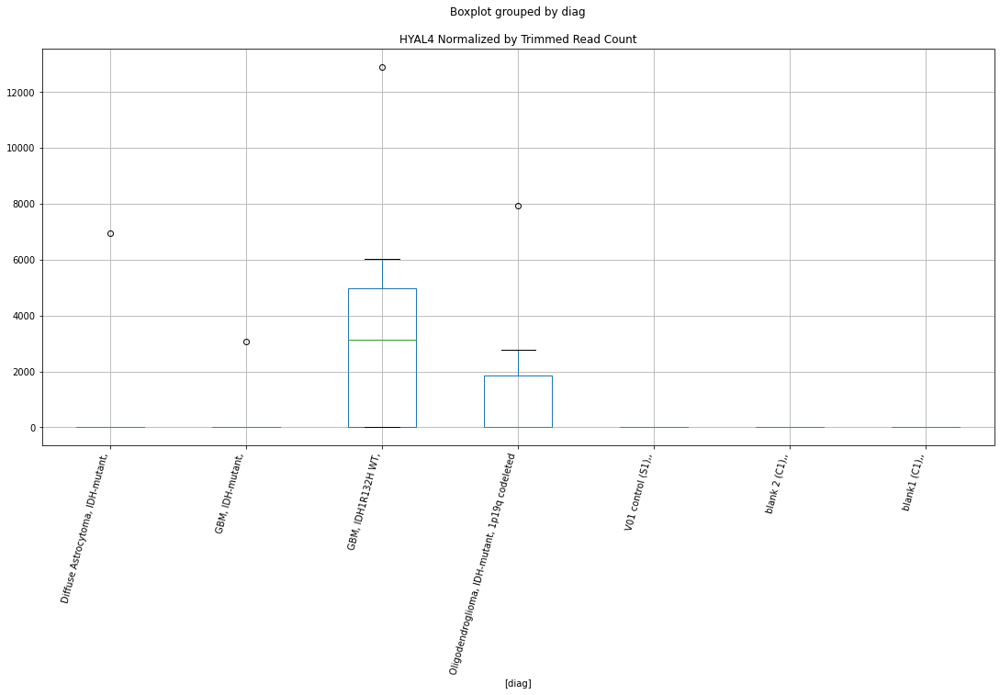

 p : 0.026669756212228425  ( t : 2.4136261356101016 ) :  D-plex  :  bbduk2  :  LAMC3
Control and blanks
73     0.0
337    0.0
Name: LAMC3, dtype: float64
205    1611.82
Name: LAMC3, dtype: float64
469    0.0
Name: LAMC3, dtype: float64


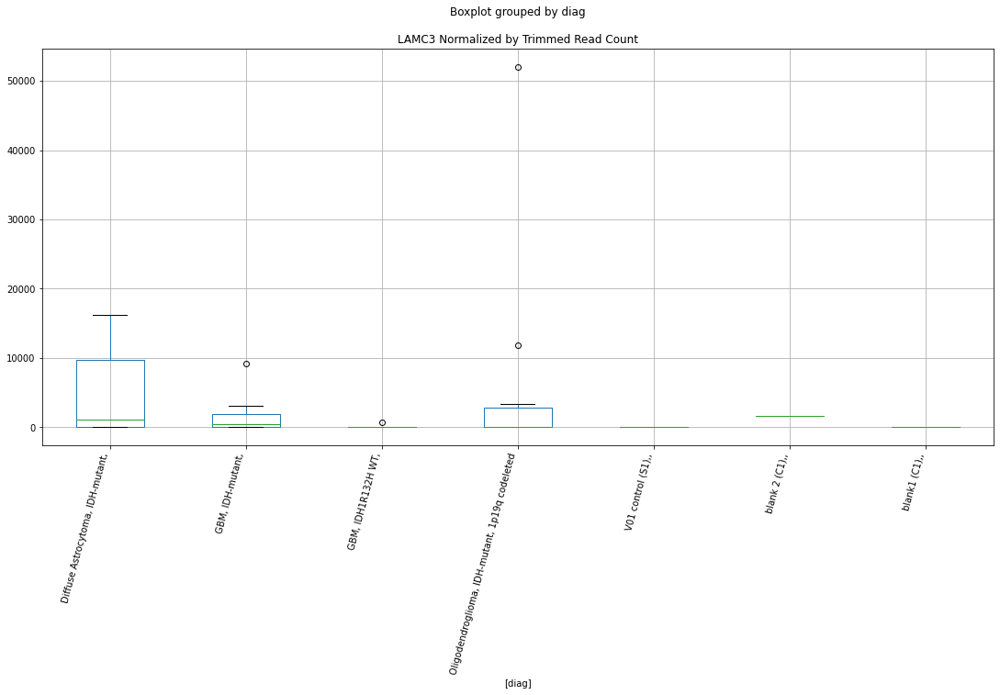

 p : 0.02667283995454686  ( t : 2.4135699054270328 ) :  D-plex  :  cutadapt2  :  EXOC3-AS1
Control and blanks
76         0.00
340    66054.91
Name: EXOC3-AS1, dtype: float64
208    352.72
Name: EXOC3-AS1, dtype: float64
472    0.0
Name: EXOC3-AS1, dtype: float64


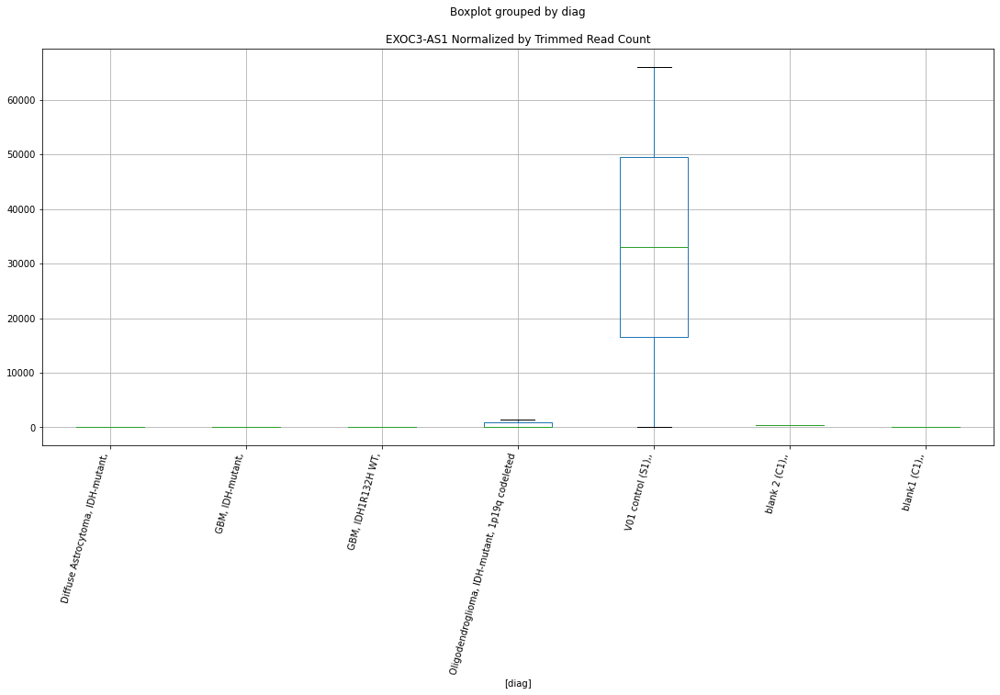

 p : 0.026733060392960497  ( t : 2.412473040011929 ) :  Lexogen  :  cutadapt2  :  FGD2
Control and blanks
82     0.0
346    0.0
Name: FGD2, dtype: float64
214    0.0
Name: FGD2, dtype: float64
478    3086.99
Name: FGD2, dtype: float64


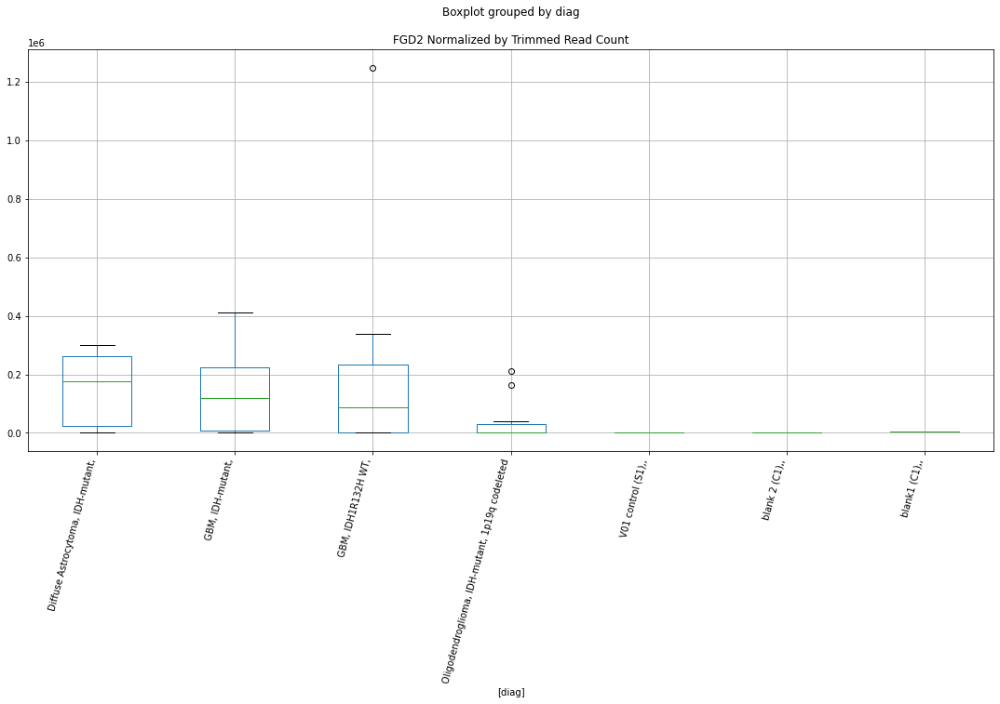

 p : 0.026763686959059323  ( t : 2.411916089368451 ) :  Lexogen  :  cutadapt2  :  FAM205BP
Control and blanks
82     0.0
346    0.0
Name: FAM205BP, dtype: float64
214    0.0
Name: FAM205BP, dtype: float64
478    0.0
Name: FAM205BP, dtype: float64


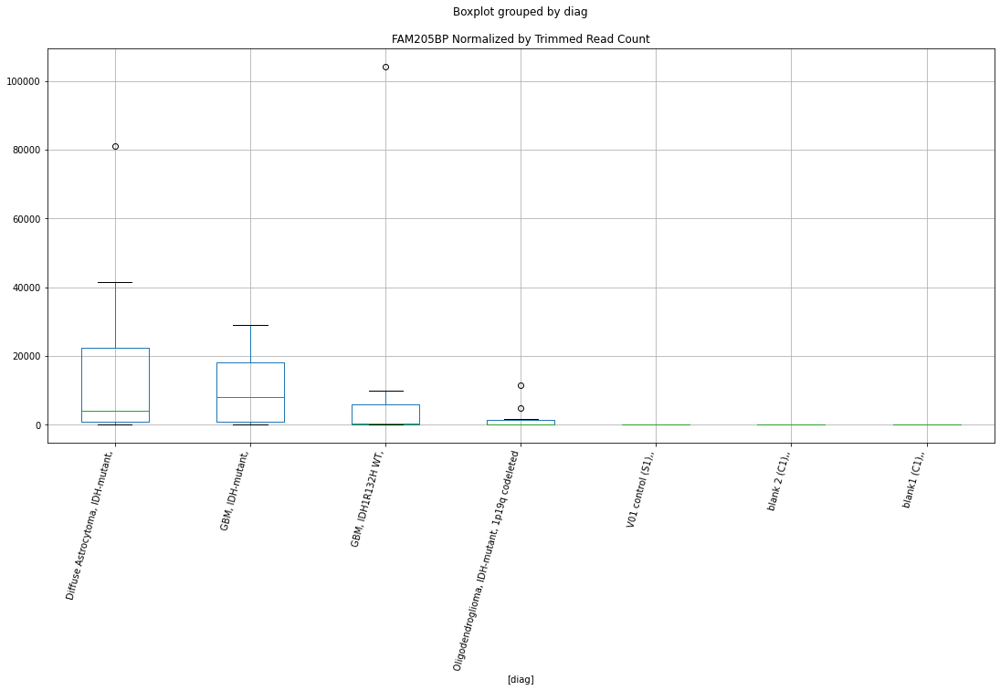

 p : 0.026813693707144263  ( t : 2.4110079868346053 ) :  D-plex  :  cutadapt2  :  FBXO10
Control and blanks
76     0.0
340    0.0
Name: FBXO10, dtype: float64
208    2821.76
Name: FBXO10, dtype: float64
472    0.0
Name: FBXO10, dtype: float64


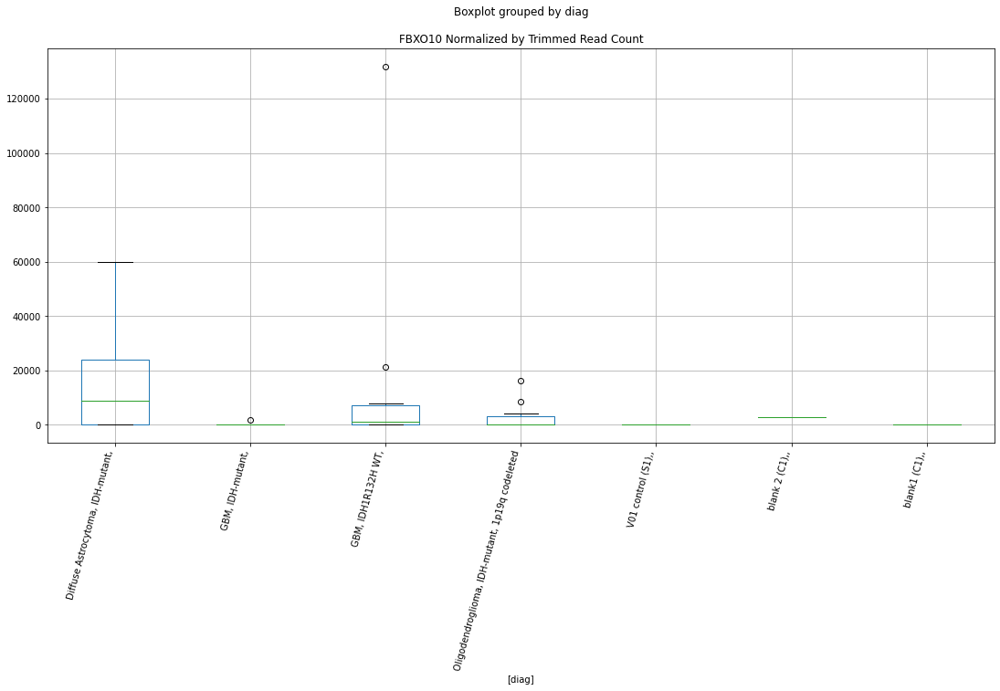

 p : 0.02696631501328074  ( t : 2.4082462125788195 ) :  Lexogen  :  bbduk2  :  FRY
Control and blanks
79        0.0
343    2972.4
Name: FRY, dtype: float64
211    0.0
Name: FRY, dtype: float64
475    0.0
Name: FRY, dtype: float64


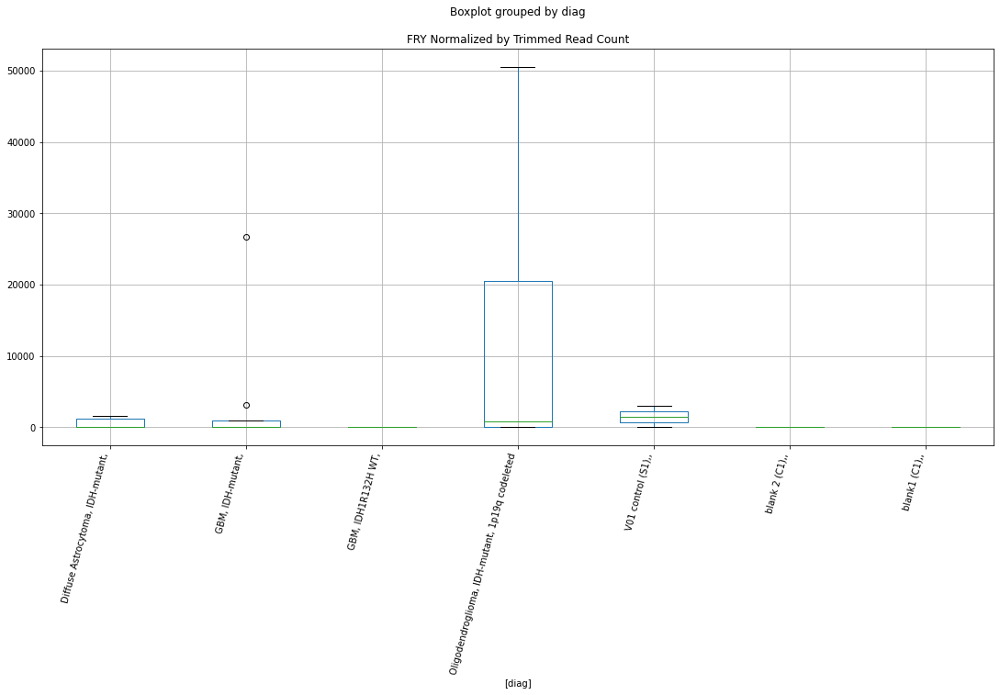

 p : 0.02697776287296137  ( t : 2.4080396468062104 ) :  D-plex  :  bbduk2  :  HIPK1
Control and blanks
73      9276.10
337    10681.89
Name: HIPK1, dtype: float64
205    119990.94
Name: HIPK1, dtype: float64
469    218865.11
Name: HIPK1, dtype: float64


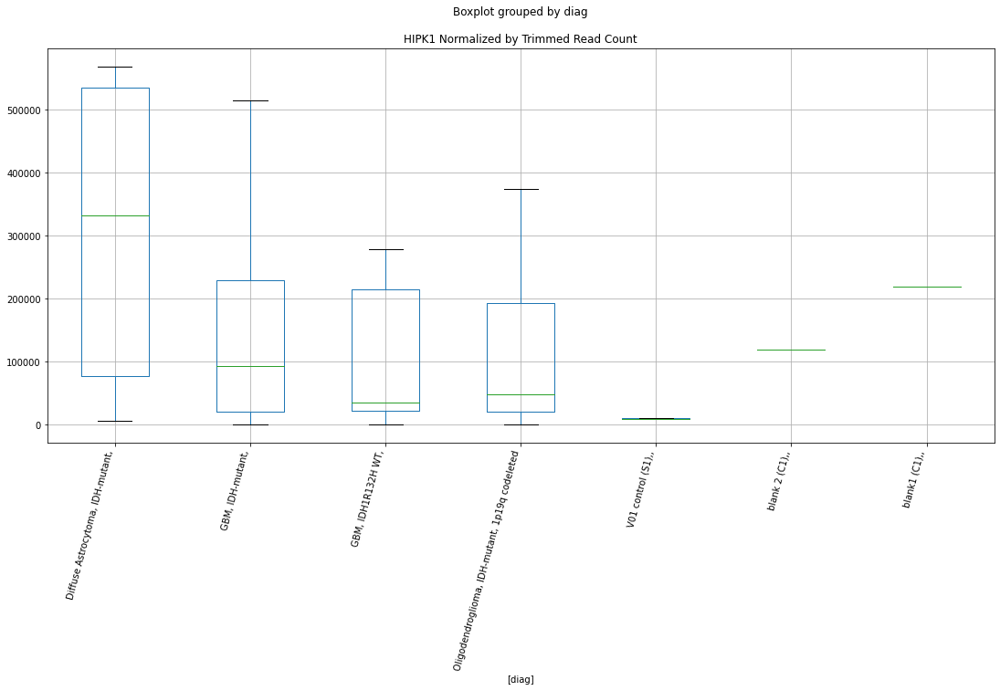

 p : 0.02707521415942543  ( t : 2.406284543834702 ) :  D-plex  :  bbduk2  :  KHDC3L
Control and blanks
73     0.0
337    0.0
Name: KHDC3L, dtype: float64
205    895.45
Name: KHDC3L, dtype: float64
469    4140.69
Name: KHDC3L, dtype: float64


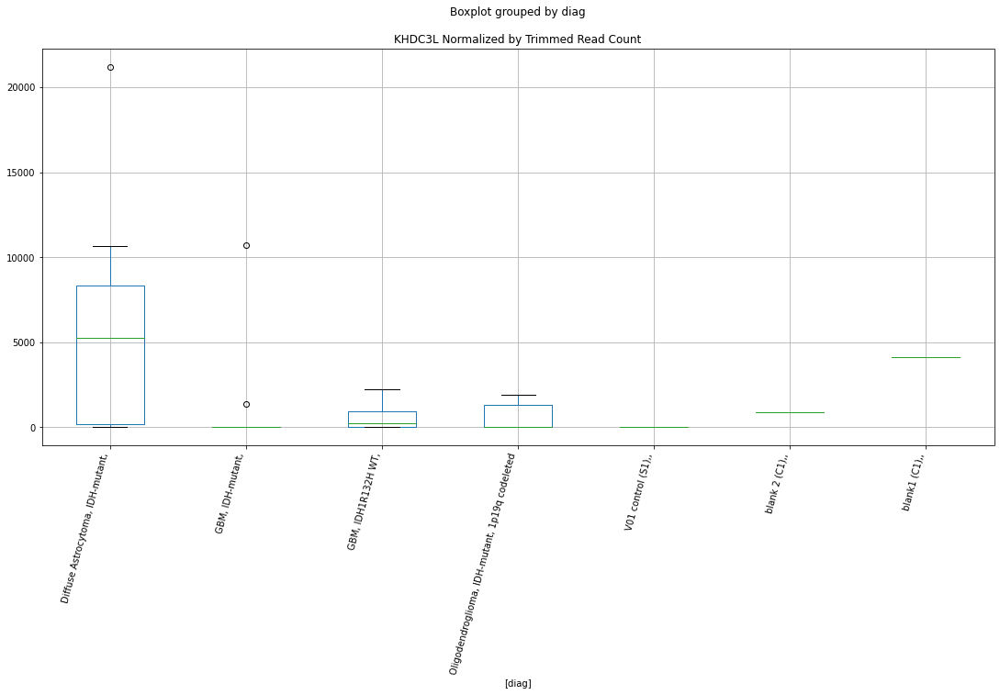

 p : 0.027218263462750632  ( t : 2.4037188929695623 ) :  D-plex  :  cutadapt2  :  GBE1
Control and blanks
76     0.0
340    0.0
Name: GBE1, dtype: float64
208    881.8
Name: GBE1, dtype: float64
472    0.0
Name: GBE1, dtype: float64


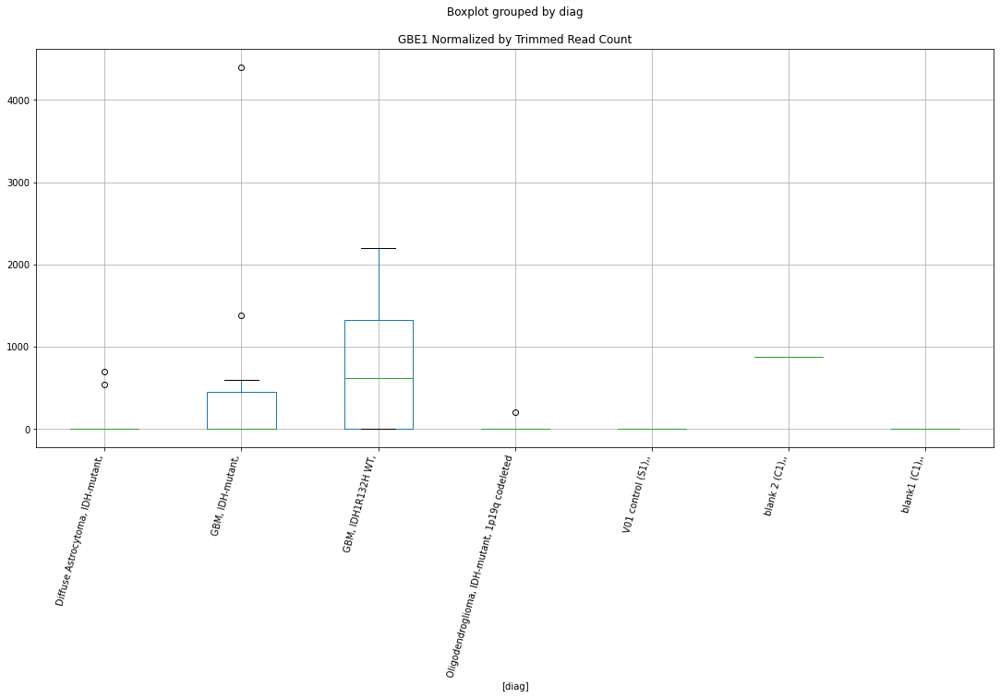

 p : 0.02740579051208717  ( t : 2.400374551417408 ) :  D-plex  :  bbduk2  :  IPO8
Control and blanks
73     0.0
337    0.0
Name: IPO8, dtype: float64
205    537.27
Name: IPO8, dtype: float64
469    3549.16
Name: IPO8, dtype: float64


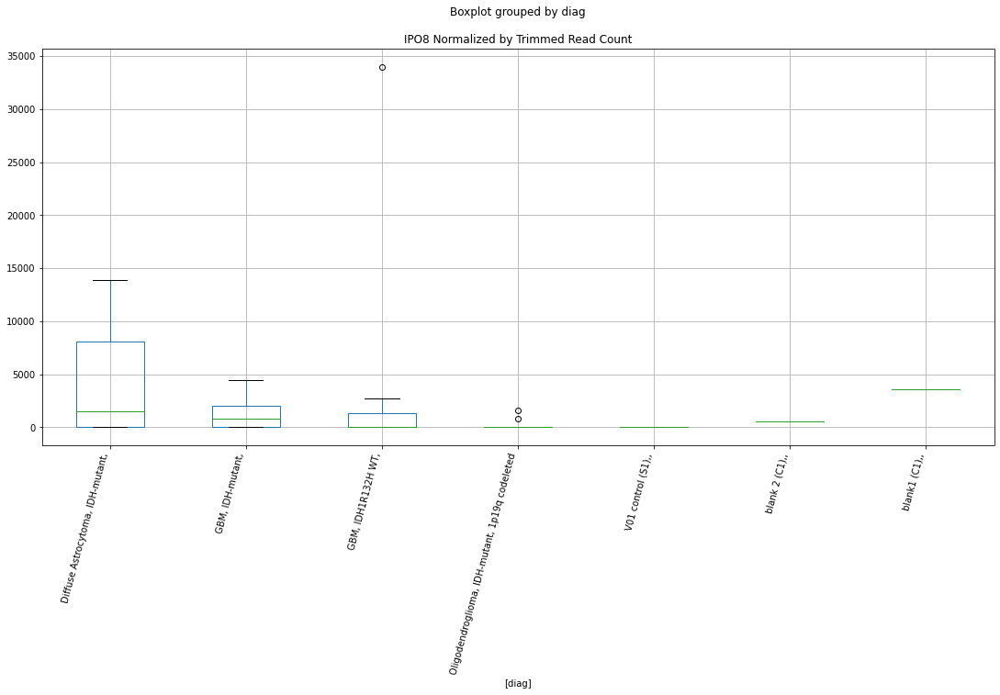

 p : 0.027431063753073217  ( t : 2.399925467996579 ) :  D-plex  :  cutadapt2  :  GGN
Control and blanks
76        0.00
340    3522.93
Name: GGN, dtype: float64
208    1587.24
Name: GGN, dtype: float64
472    1733.87
Name: GGN, dtype: float64


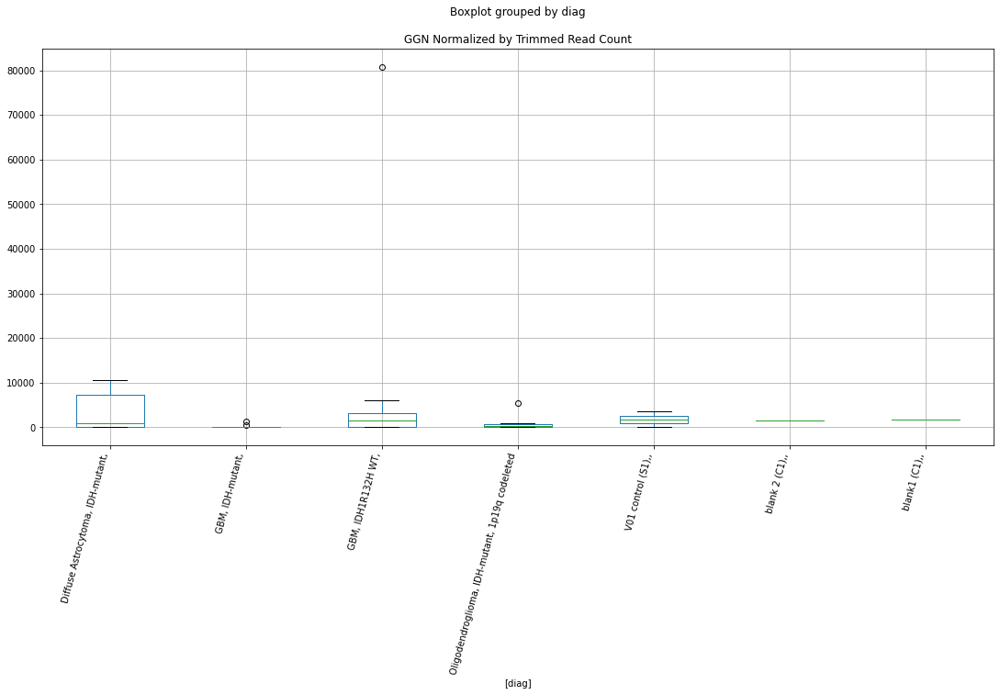

 p : 0.02744694676273268  ( t : 2.399643438713202 ) :  Lexogen  :  cutadapt2  :  HP1BP3
Control and blanks
82          0.00
346    174239.78
Name: HP1BP3, dtype: float64
214    0.0
Name: HP1BP3, dtype: float64
478    0.0
Name: HP1BP3, dtype: float64


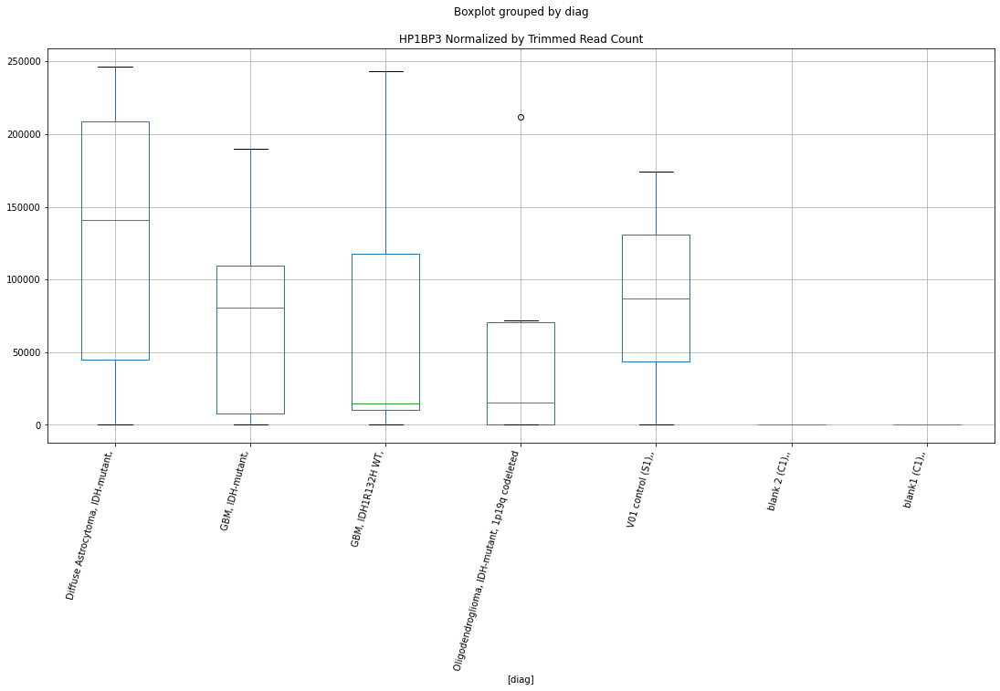

 p : 0.027567482120391826  ( t : 2.3975080922870045 ) :  D-plex  :  cutadapt2  :  KHDC3L
Control and blanks
76     0.0
340    0.0
Name: KHDC3L, dtype: float64
208    881.8
Name: KHDC3L, dtype: float64
472    4623.65
Name: KHDC3L, dtype: float64


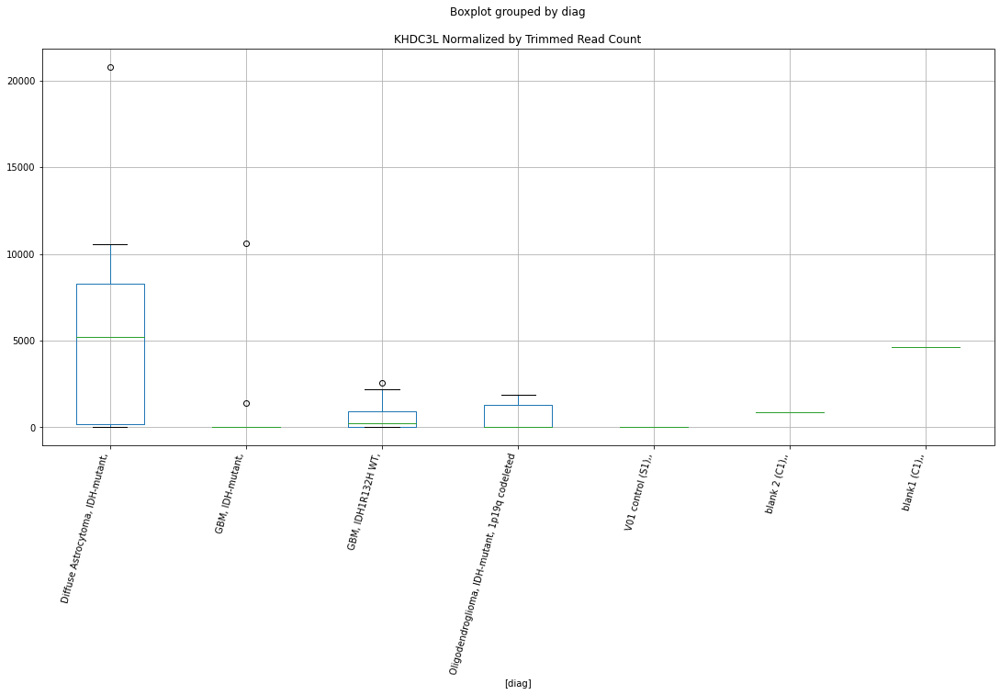

 p : 0.027608529282824937  ( t : 2.3967829124979034 ) :  D-plex  :  cutadapt2  :  HIPK1
Control and blanks
76      9091.37
340    10568.79
Name: HIPK1, dtype: float64
208    118161.35
Name: HIPK1, dtype: float64
472    213843.66
Name: HIPK1, dtype: float64


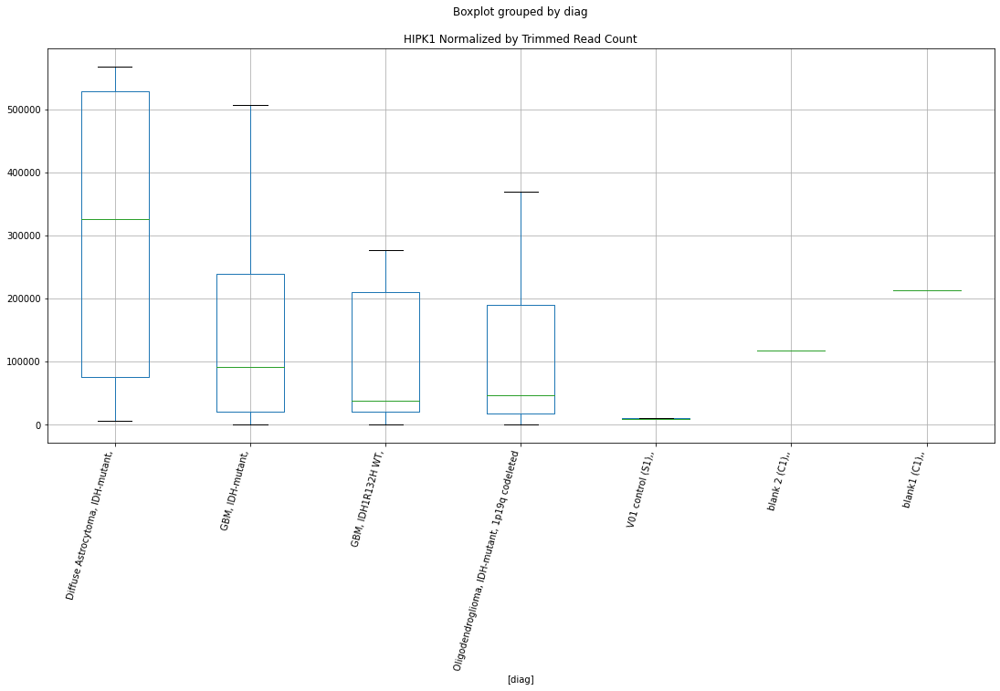

 p : 0.02768312434243294  ( t : 2.3954676186184125 ) :  Lexogen  :  bbduk2  :  EFR3A
Control and blanks
79        0.0
343    5944.8
Name: EFR3A, dtype: float64
211    0.0
Name: EFR3A, dtype: float64
475    6466.92
Name: EFR3A, dtype: float64


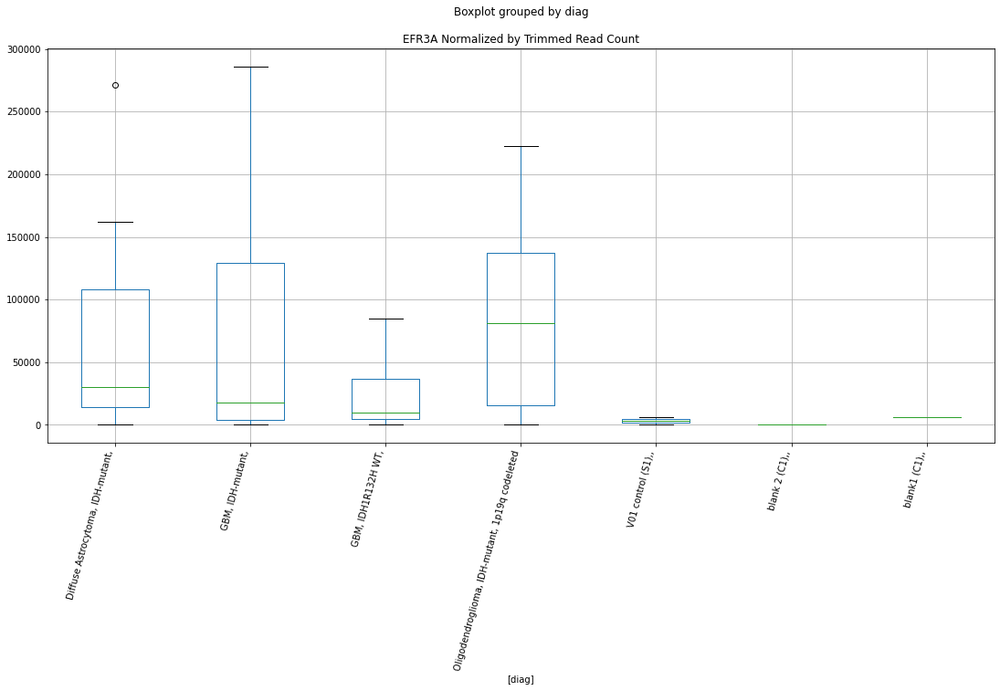

 p : 0.027744908516399946  ( t : 2.394380717923386 ) :  D-plex  :  cutadapt2  :  H1-7
Control and blanks
76     0.0
340    0.0
Name: H1-7, dtype: float64
208    176.36
Name: H1-7, dtype: float64
472    0.0
Name: H1-7, dtype: float64


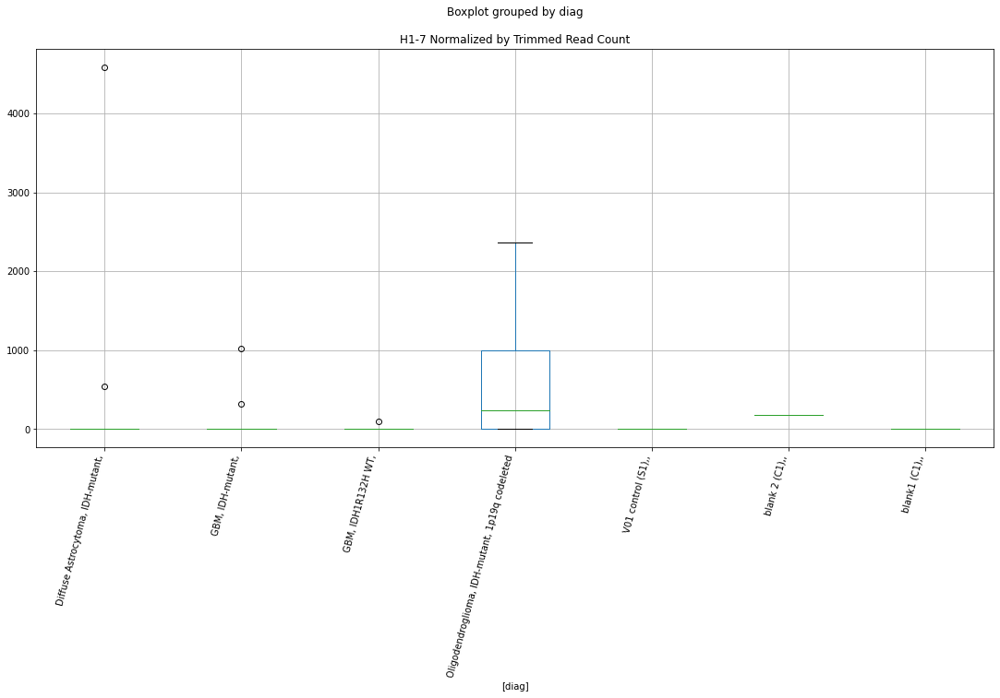

 p : 0.027779566527630403  ( t : 2.3937720078305973 ) :  D-plex  :  cutadapt2  :  HAUS6
Control and blanks
76     113642.13
340         0.00
Name: HAUS6, dtype: float64
208    3350.84
Name: HAUS6, dtype: float64
472    3467.74
Name: HAUS6, dtype: float64


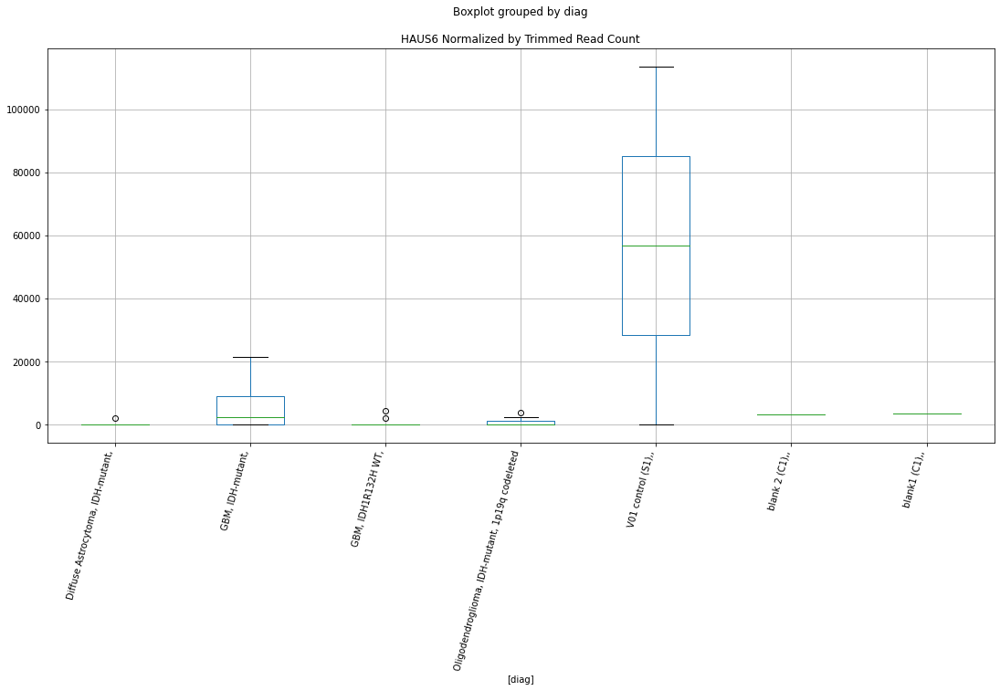

 p : 0.027929917048254232  ( t : 2.391139542736955 ) :  D-plex  :  bbduk2  :  FAM189B
Control and blanks
73     0.0
337    0.0
Name: FAM189B, dtype: float64
205    8775.46
Name: FAM189B, dtype: float64
469    12422.07
Name: FAM189B, dtype: float64


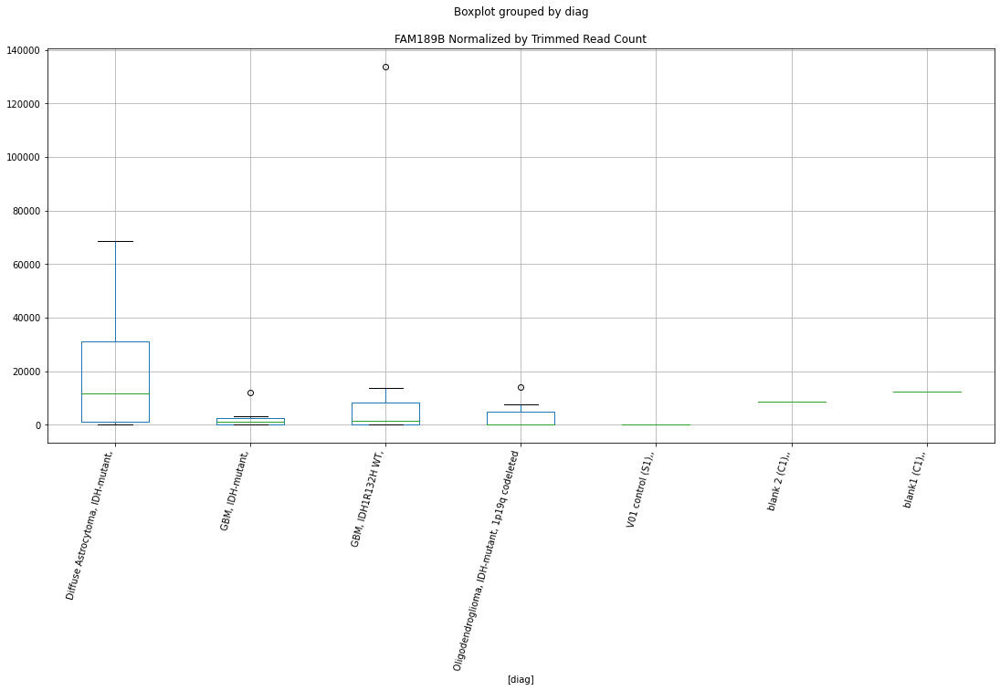

 p : 0.027945303681438438  ( t : 2.3908708878105025 ) :  D-plex  :  cutadapt2  :  ERCC3
Control and blanks
76     0.0
340    0.0
Name: ERCC3, dtype: float64
208    1058.16
Name: ERCC3, dtype: float64
472    4045.69
Name: ERCC3, dtype: float64


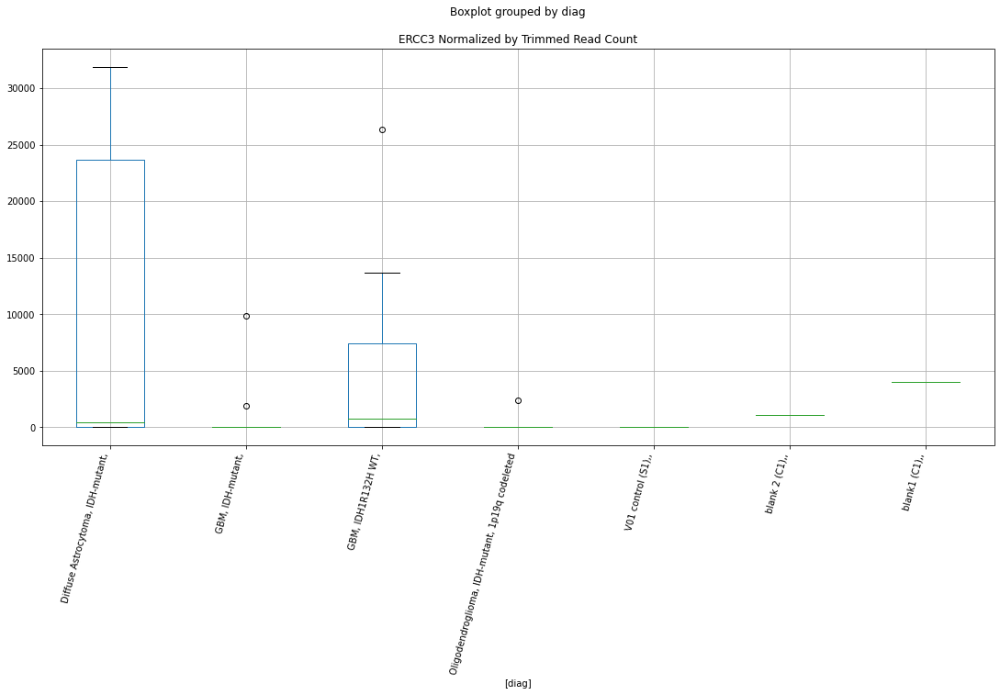

 p : 0.028003166470001693  ( t : 2.3898618229218496 ) :  D-plex  :  cutadapt2  :  EPB41L5
Control and blanks
76     0.0
340    0.0
Name: EPB41L5, dtype: float64
208    1410.88
Name: EPB41L5, dtype: float64
472    577.96
Name: EPB41L5, dtype: float64


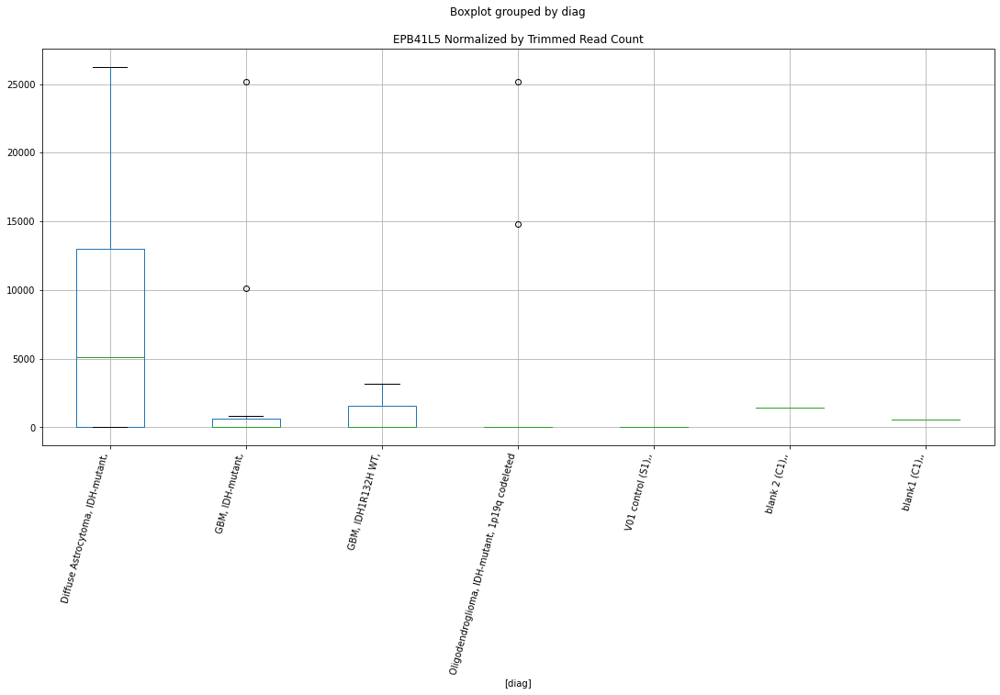

 p : 0.028046286557328666  ( t : 2.3891111208616334 ) :  D-plex  :  bbduk2  :  KAT8
Control and blanks
73     0.0
337    0.0
Name: KAT8, dtype: float64
205    0.0
Name: KAT8, dtype: float64
469    1183.05
Name: KAT8, dtype: float64


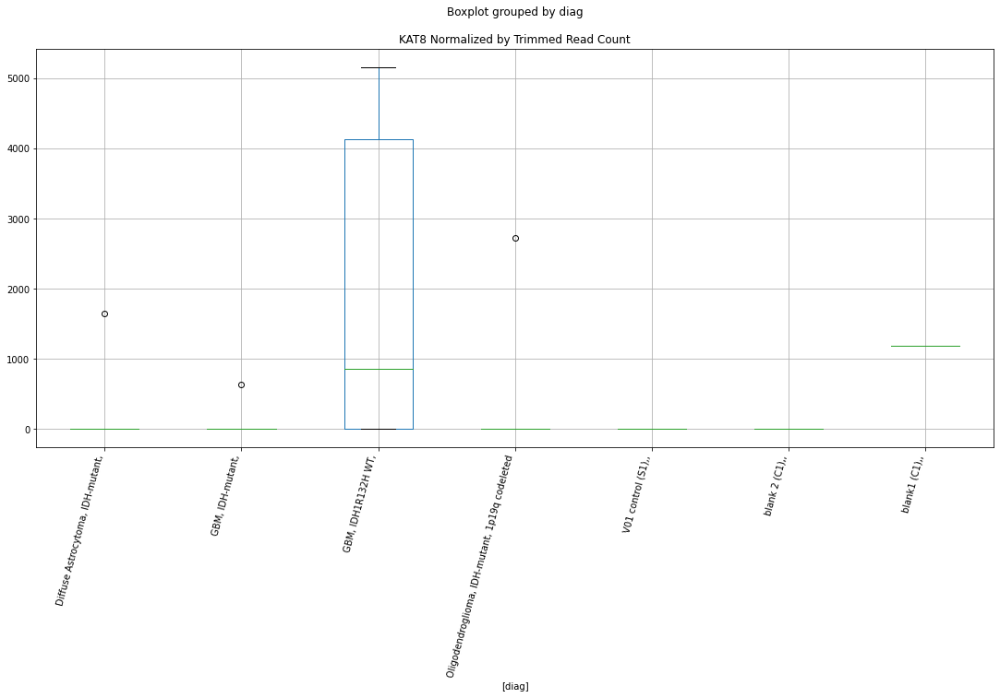

 p : 0.028109079427488498  ( t : 2.3880198502674963 ) :  Lexogen  :  cutadapt2  :  KCNMB4
Control and blanks
82       0.00
346    210.43
Name: KCNMB4, dtype: float64
214    0.0
Name: KCNMB4, dtype: float64
478    0.0
Name: KCNMB4, dtype: float64


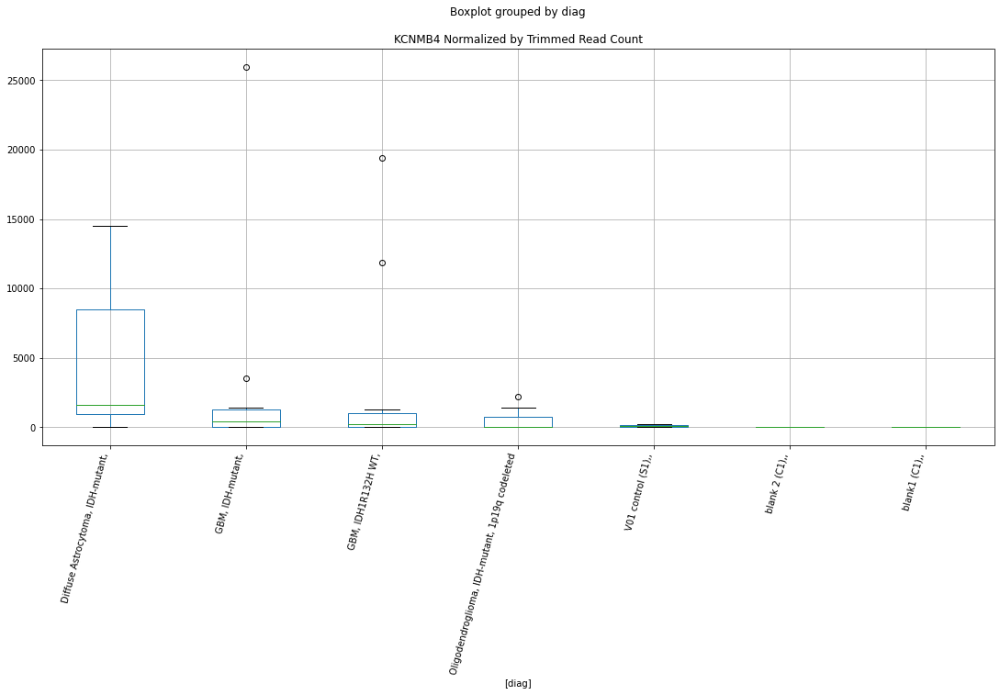

 p : 0.028163287576916083  ( t : 2.3870796025912373 ) :  Lexogen  :  bbduk2  :  FGD2
Control and blanks
79        0.00
343    2760.09
Name: FGD2, dtype: float64
211    0.0
Name: FGD2, dtype: float64
475    9341.11
Name: FGD2, dtype: float64


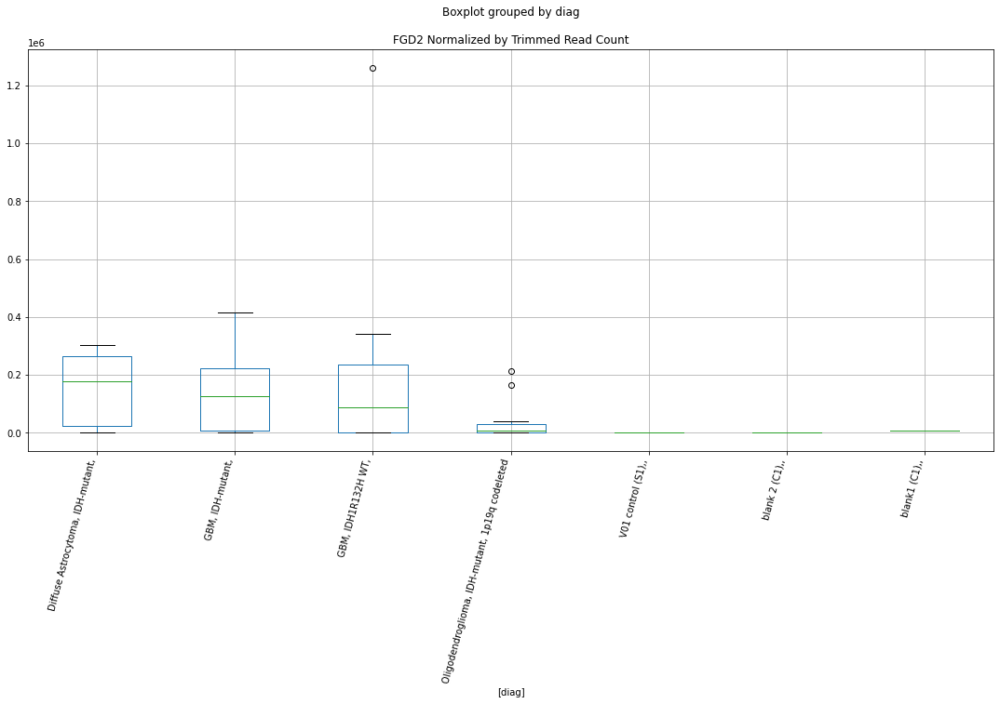

 p : 0.028168015632671184  ( t : 2.3869976739963312 ) :  Lexogen  :  cutadapt2  :  HMX1
Control and blanks
82     0.0
346    0.0
Name: HMX1, dtype: float64
214    0.0
Name: HMX1, dtype: float64
478    0.0
Name: HMX1, dtype: float64


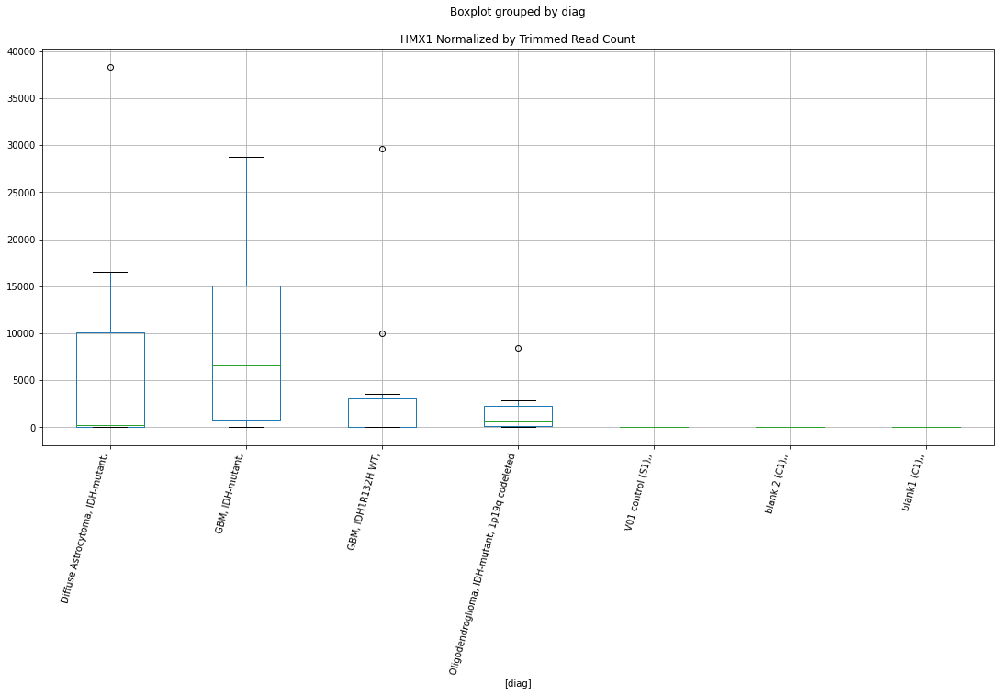

 p : 0.028288036956237633  ( t : 2.3849222128388368 ) :  Lexogen  :  cutadapt2  :  KCNT1
Control and blanks
82     0.0
346    0.0
Name: KCNT1, dtype: float64
214    0.0
Name: KCNT1, dtype: float64
478    0.0
Name: KCNT1, dtype: float64


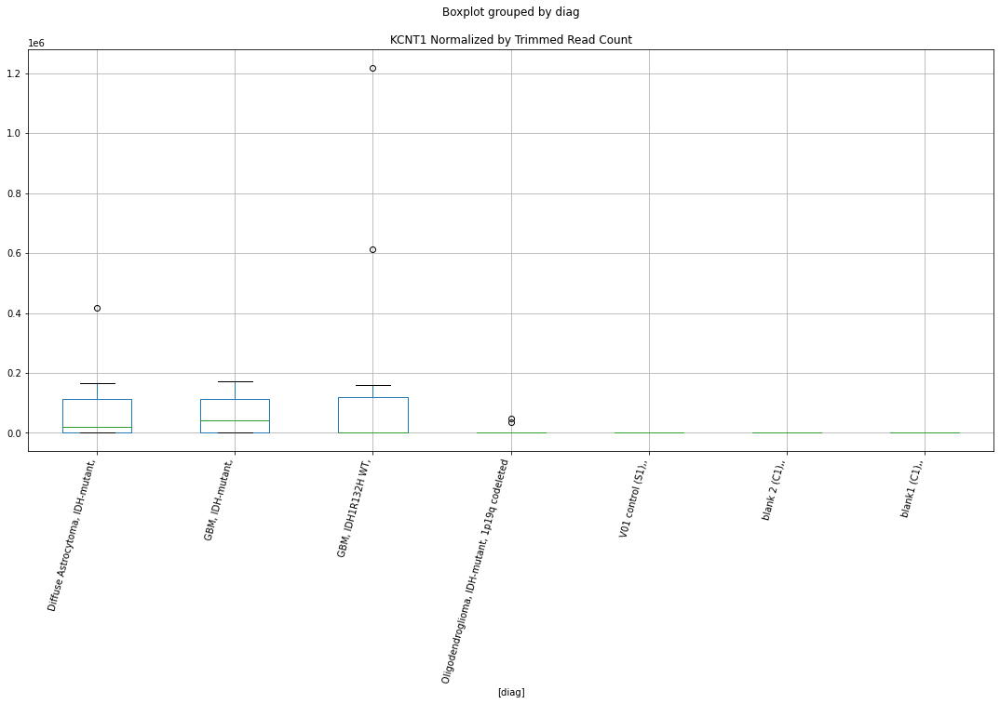

 p : 0.02837009125245637  ( t : 2.383508021937909 ) :  D-plex  :  cutadapt2  :  GSG1L
Control and blanks
76      6060.91
340    84550.28
Name: GSG1L, dtype: float64
208    4761.73
Name: GSG1L, dtype: float64
472    11559.12
Name: GSG1L, dtype: float64


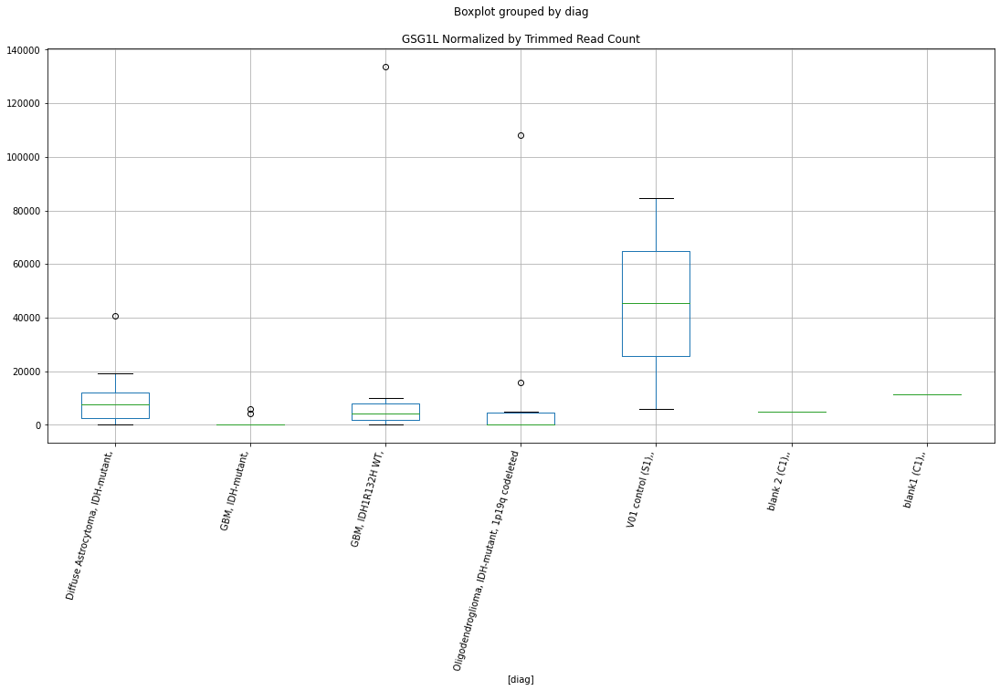

 p : 0.028372143181137337  ( t : 2.3834727062945635 ) :  D-plex  :  cutadapt2  :  KAT8
Control and blanks
76     0.0
340    0.0
Name: KAT8, dtype: float64
208    0.0
Name: KAT8, dtype: float64
472    1155.91
Name: KAT8, dtype: float64


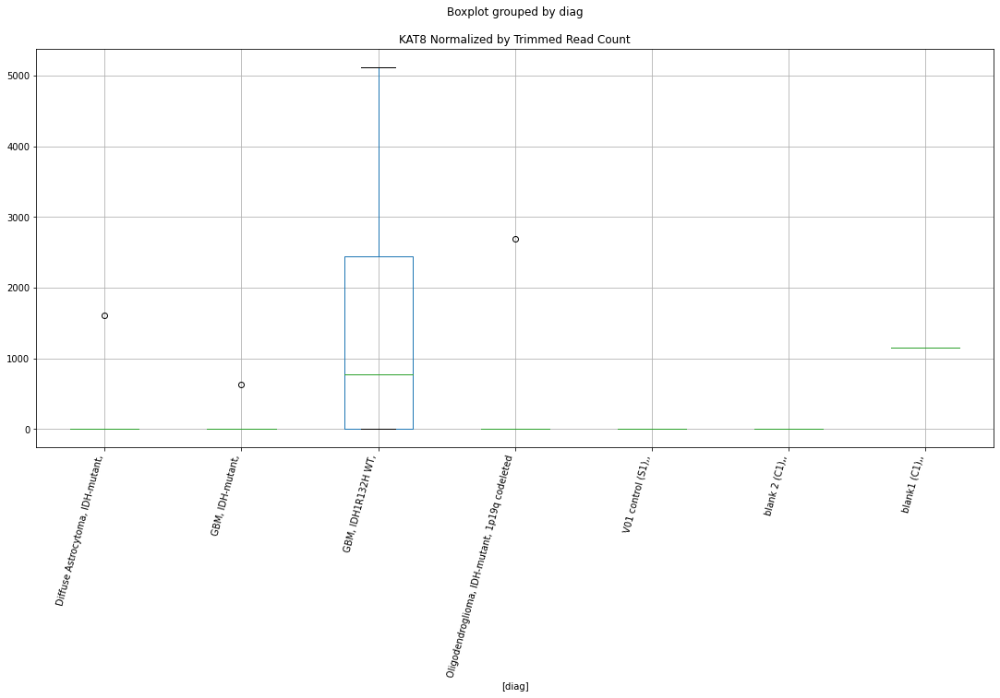

 p : 0.028384906465714097  ( t : 2.383253091573002 ) :  Lexogen  :  bbduk2  :  KCNT1
Control and blanks
79     0.0
343    0.0
Name: KCNT1, dtype: float64
211    0.0
Name: KCNT1, dtype: float64
475    0.0
Name: KCNT1, dtype: float64


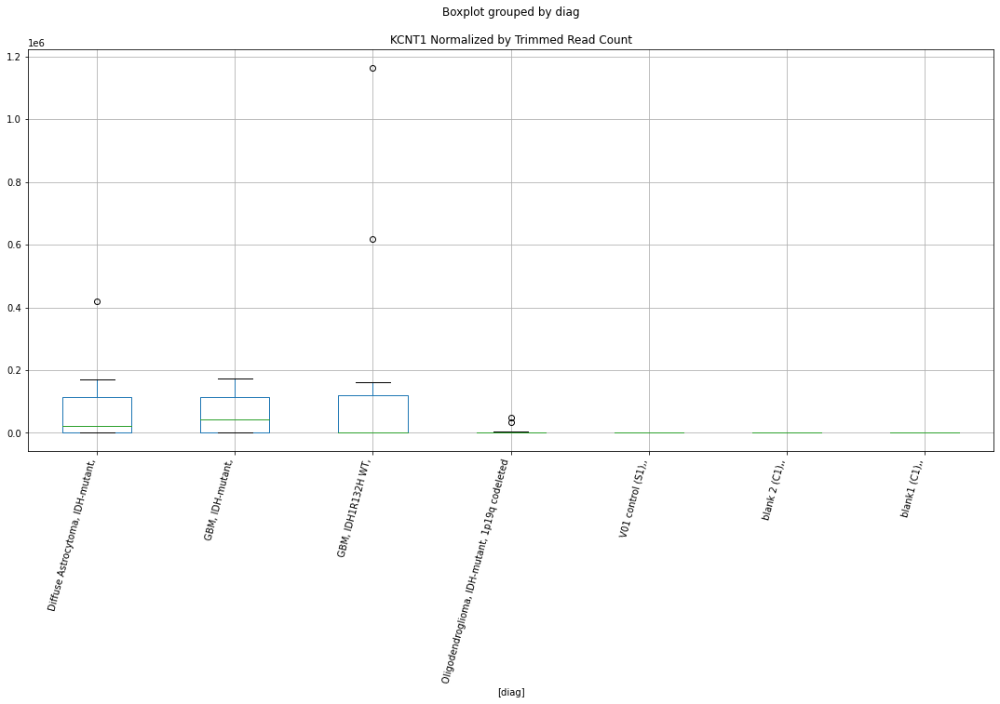

 p : 0.028422811697265984  ( t : 2.3826014086510385 ) :  D-plex  :  bbduk2  :  FBXO47
Control and blanks
73     141460.54
337         0.00
Name: FBXO47, dtype: float64
205    895.45
Name: FBXO47, dtype: float64
469    3549.16
Name: FBXO47, dtype: float64


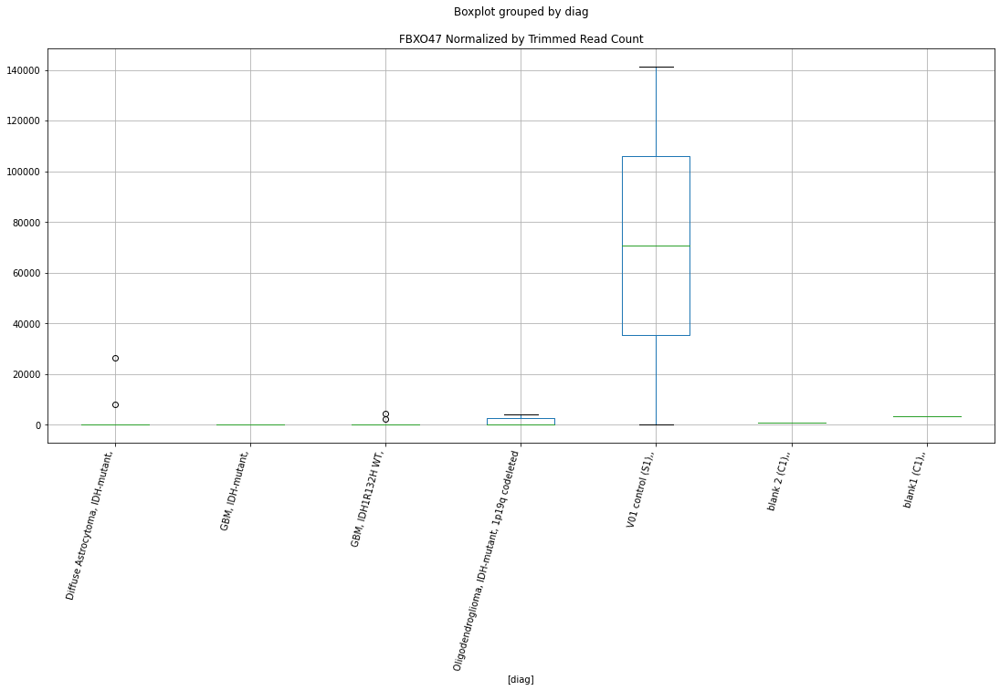

 p : 0.028450558262059753  ( t : 2.382124892078351 ) :  D-plex  :  cutadapt2  :  FBXO47
Control and blanks
76     138643.4
340         0.0
Name: FBXO47, dtype: float64
208    529.08
Name: FBXO47, dtype: float64
472    1733.87
Name: FBXO47, dtype: float64


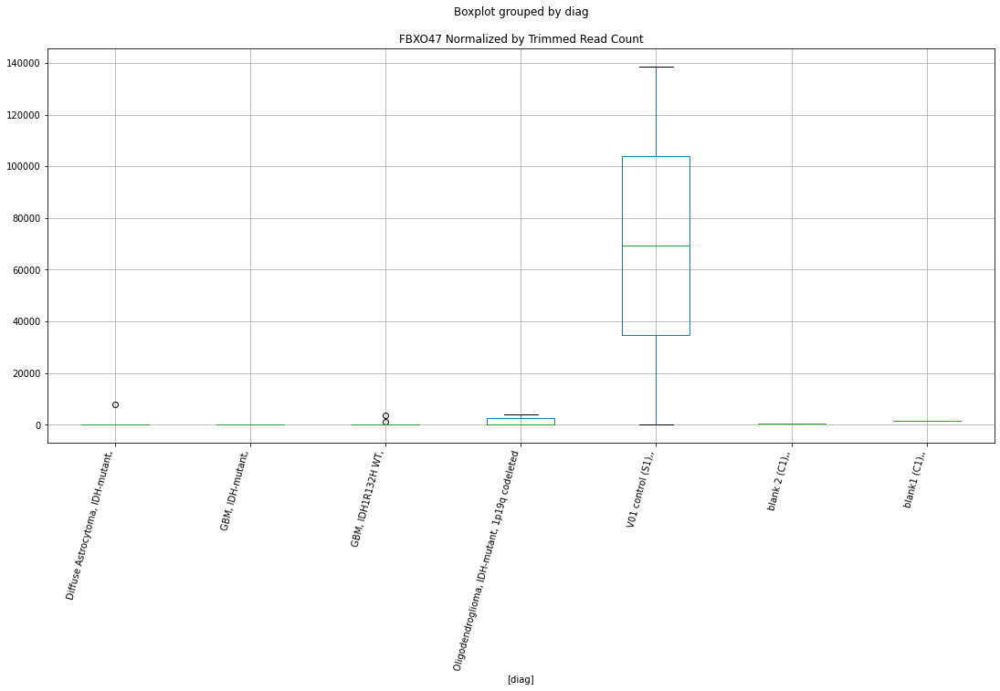

 p : 0.02846964023911845  ( t : 2.3817974319704844 ) :  Lexogen  :  bbduk2  :  DUOX2
Control and blanks
79     0.0
343    0.0
Name: DUOX2, dtype: float64
211    0.0
Name: DUOX2, dtype: float64
475    0.0
Name: DUOX2, dtype: float64


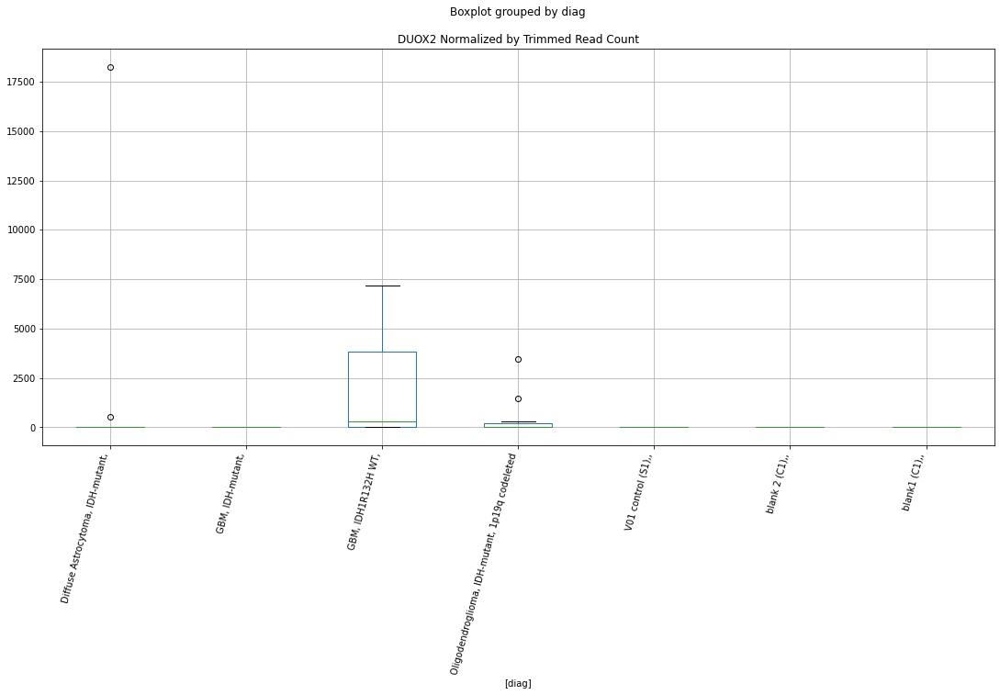

 p : 0.02849689823846576  ( t : 2.381330020843012 ) :  Lexogen  :  cutadapt2  :  DUOX2
Control and blanks
82     0.0
346    0.0
Name: DUOX2, dtype: float64
214    0.0
Name: DUOX2, dtype: float64
478    0.0
Name: DUOX2, dtype: float64


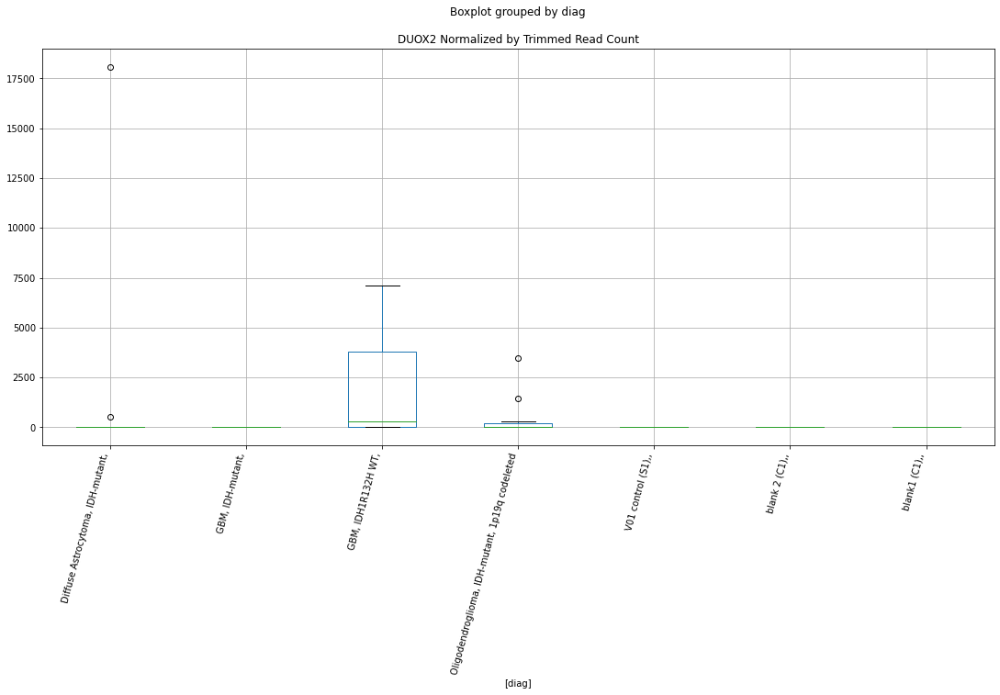

 p : 0.02851107568686052  ( t : 2.3810870756516276 ) :  D-plex  :  cutadapt2  :  DNA2
Control and blanks
76        0.0
340    2642.2
Name: DNA2, dtype: float64
208    263482.17
Name: DNA2, dtype: float64
472    3467.74
Name: DNA2, dtype: float64


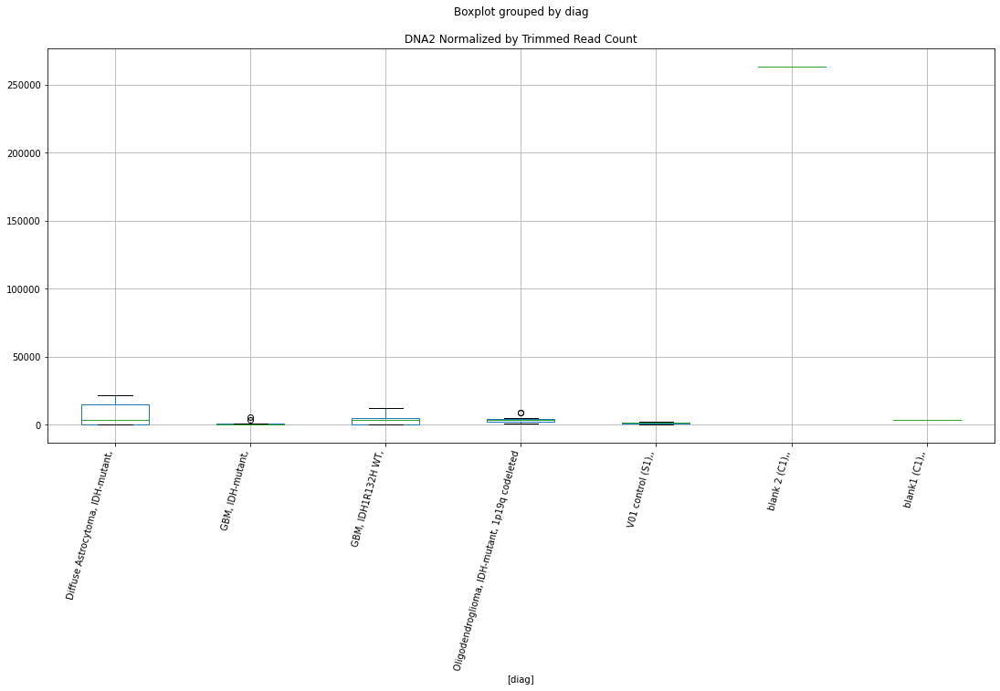

 p : 0.02864155252233747  ( t : 2.3788565005254583 ) :  D-plex  :  cutadapt2  :  FRRS1
Control and blanks
76     83337.56
340        0.00
Name: FRRS1, dtype: float64
208    352.72
Name: FRRS1, dtype: float64
472    0.0
Name: FRRS1, dtype: float64


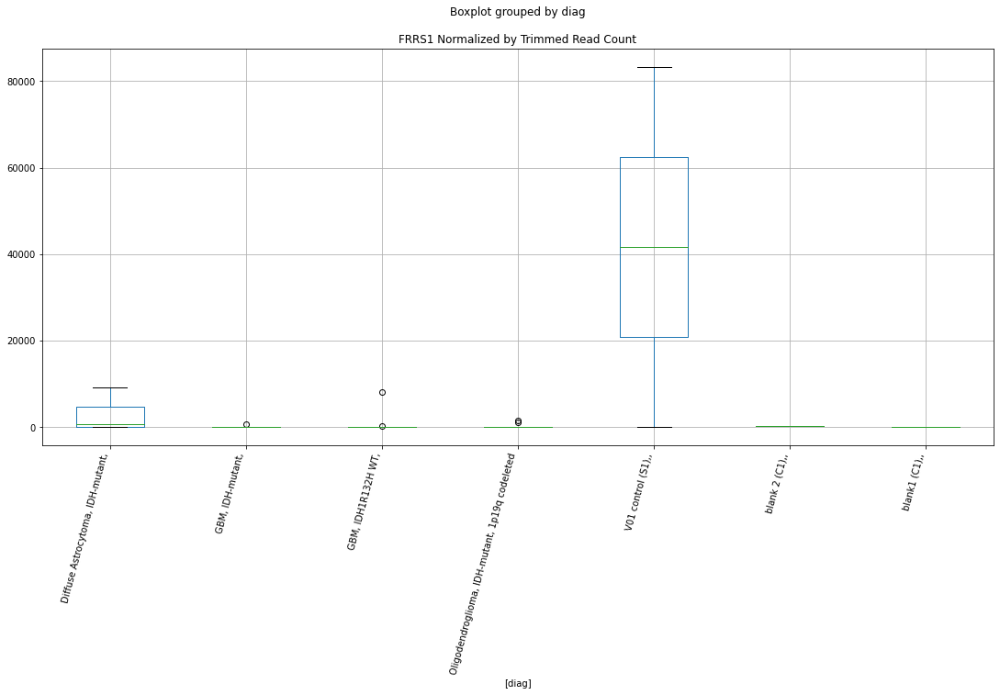

 p : 0.028659874035538102  ( t : 2.378544043709327 ) :  Lexogen  :  bbduk2  :  IRF2BPL
Control and blanks
79     0.0
343    0.0
Name: IRF2BPL, dtype: float64
211    0.0
Name: IRF2BPL, dtype: float64
475    0.0
Name: IRF2BPL, dtype: float64


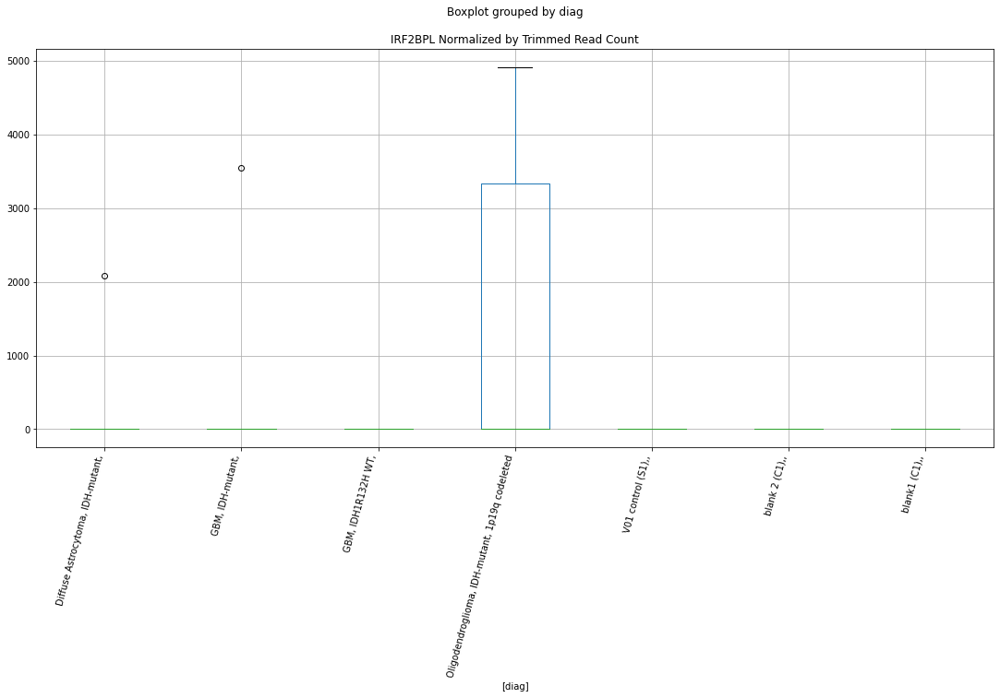

 p : 0.02866337131200905  ( t : 2.3784844220182157 ) :  Lexogen  :  cutadapt2  :  KIF19
Control and blanks
82     0.0
346    0.0
Name: KIF19, dtype: float64
214    0.0
Name: KIF19, dtype: float64
478    0.0
Name: KIF19, dtype: float64


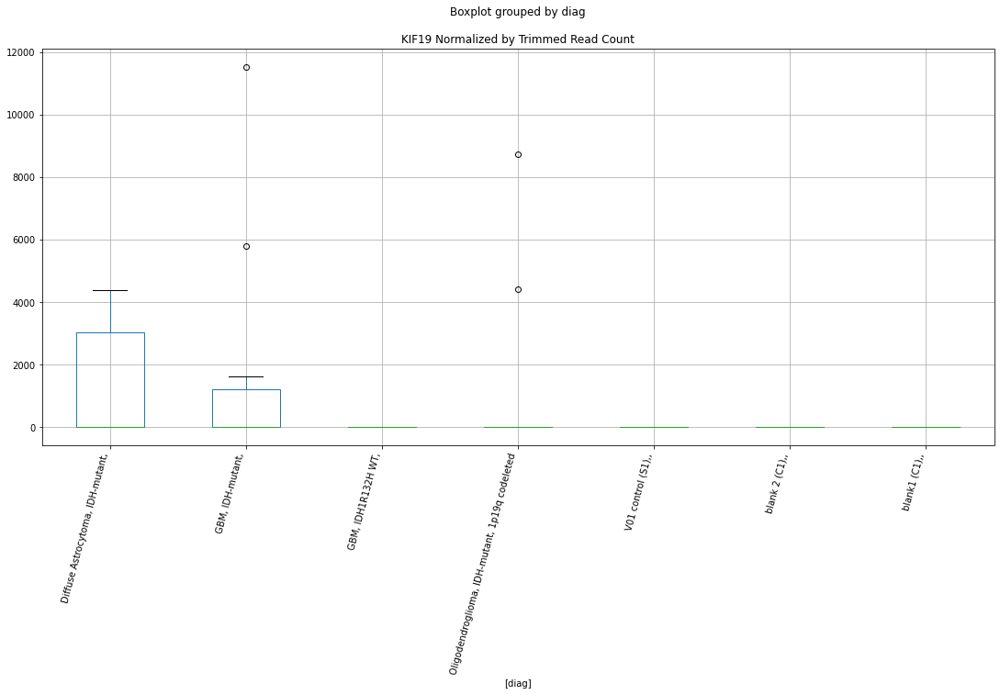

 p : 0.028671742192416763  ( t : 2.378341742529254 ) :  Lexogen  :  cutadapt2  :  IRF2BPL
Control and blanks
82     0.0
346    0.0
Name: IRF2BPL, dtype: float64
214    0.0
Name: IRF2BPL, dtype: float64
478    0.0
Name: IRF2BPL, dtype: float64


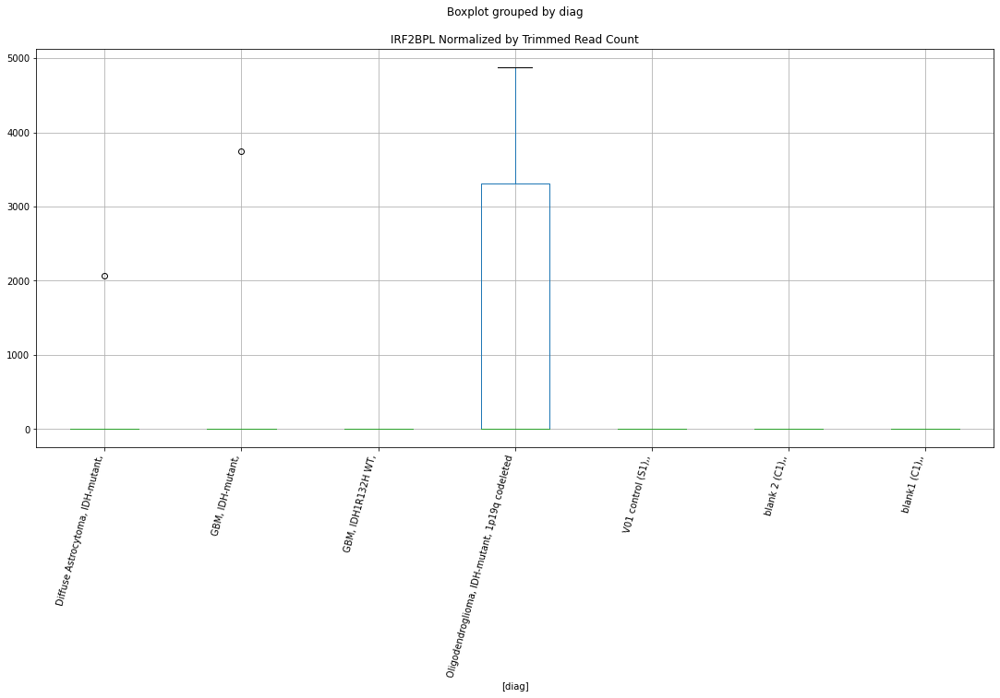

 p : 0.028810053666547958  ( t : 2.3759898704371443 ) :  D-plex  :  bbduk2  :  GEN1
Control and blanks
73        0.00
337    2670.47
Name: GEN1, dtype: float64
205    20595.46
Name: GEN1, dtype: float64
469    13013.6
Name: GEN1, dtype: float64


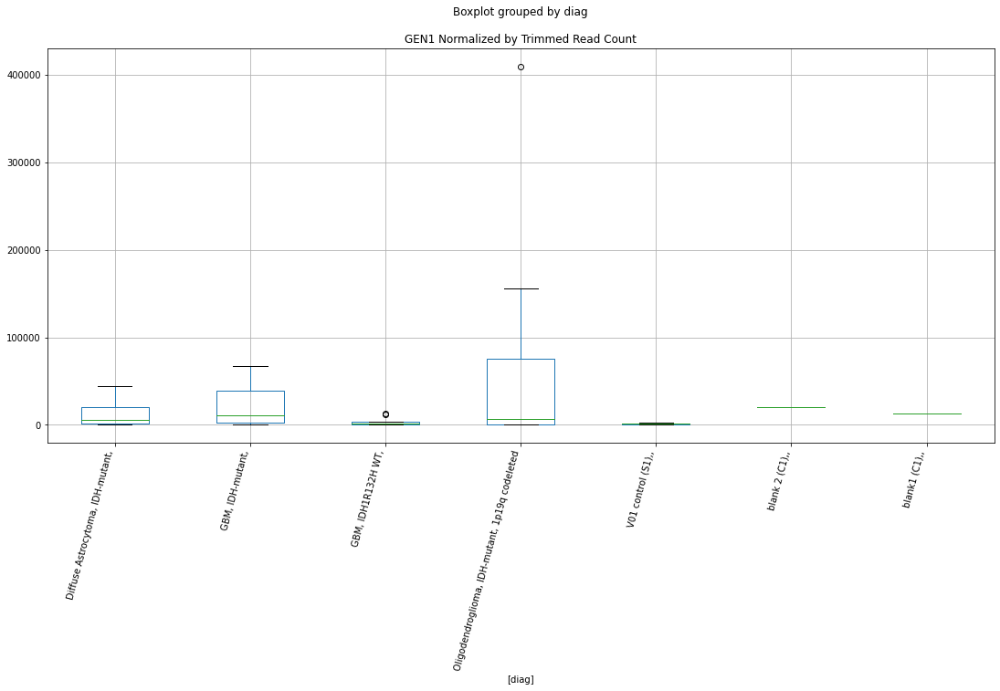

 p : 0.02885307456000236  ( t : 2.3752604840265494 ) :  D-plex  :  cutadapt2  :  FXYD3
Control and blanks
76     0.0
340    0.0
Name: FXYD3, dtype: float64
208    14637.9
Name: FXYD3, dtype: float64
472    2.15e+06
Name: FXYD3, dtype: float64


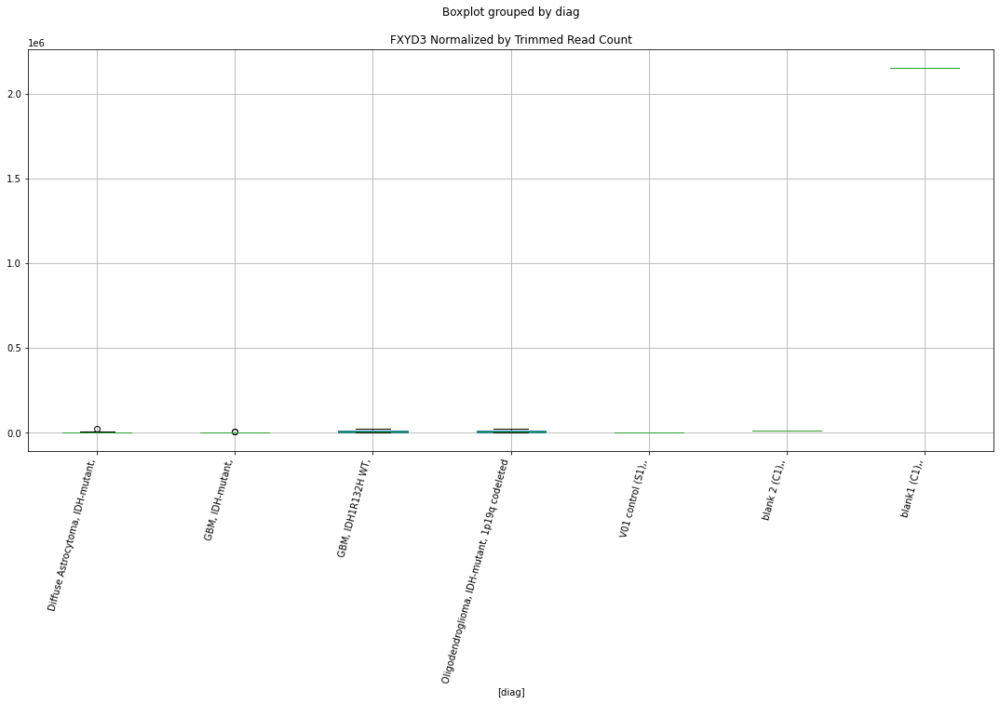

 p : 0.028854134548188633  ( t : 2.37524252554957 ) :  D-plex  :  bbduk2  :  EI24
Control and blanks
73     0.0
337    0.0
Name: EI24, dtype: float64
205    1432.73
Name: EI24, dtype: float64
469    5915.27
Name: EI24, dtype: float64


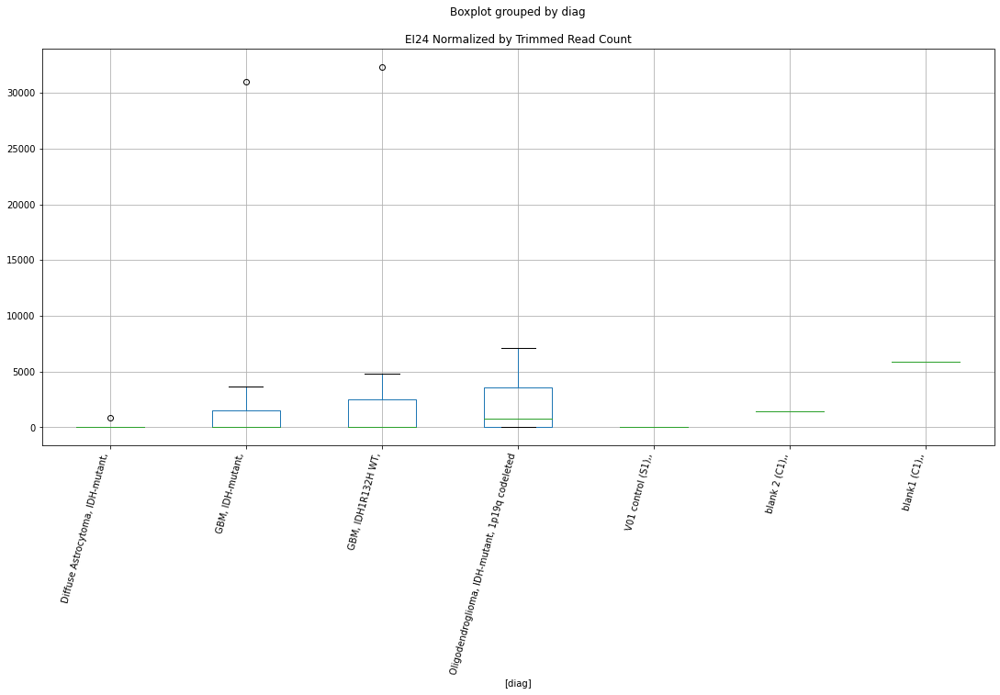

 p : 0.02886421544081747  ( t : 2.3750717643334744 ) :  D-plex  :  bbduk2  :  INTU
Control and blanks
73     7730.08
337       0.00
Name: INTU, dtype: float64
205    11103.64
Name: INTU, dtype: float64
469    22478.04
Name: INTU, dtype: float64


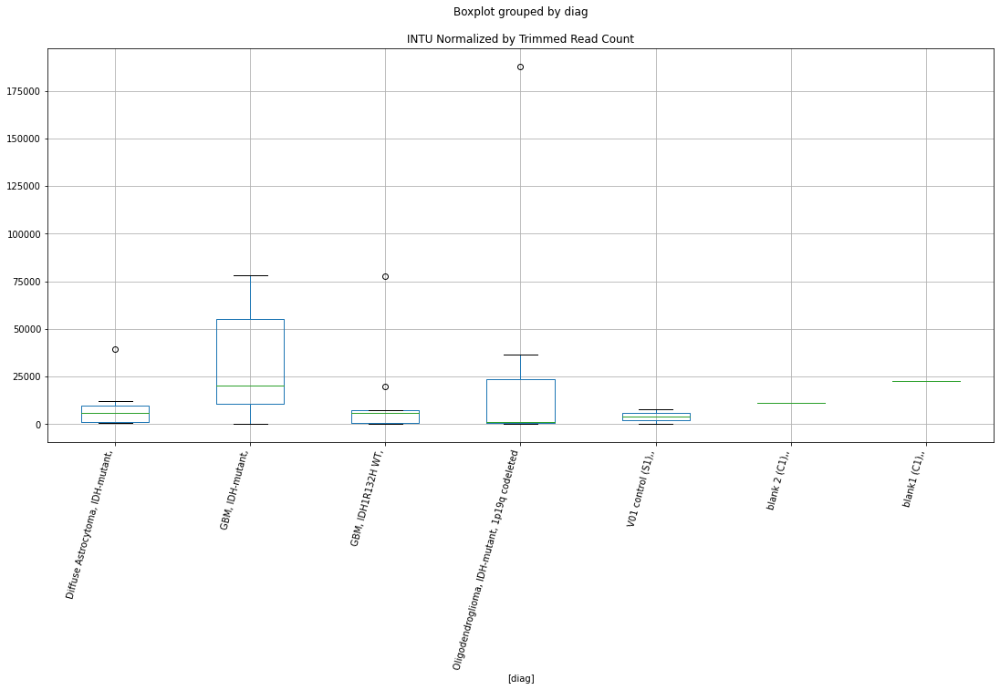

 p : 0.028873187033468205  ( t : 2.3749198404528244 ) :  Lexogen  :  cutadapt2  :  EFR3A
Control and blanks
82        0.00
346    8838.25
Name: EFR3A, dtype: float64
214    0.0
Name: EFR3A, dtype: float64
478    4036.83
Name: EFR3A, dtype: float64


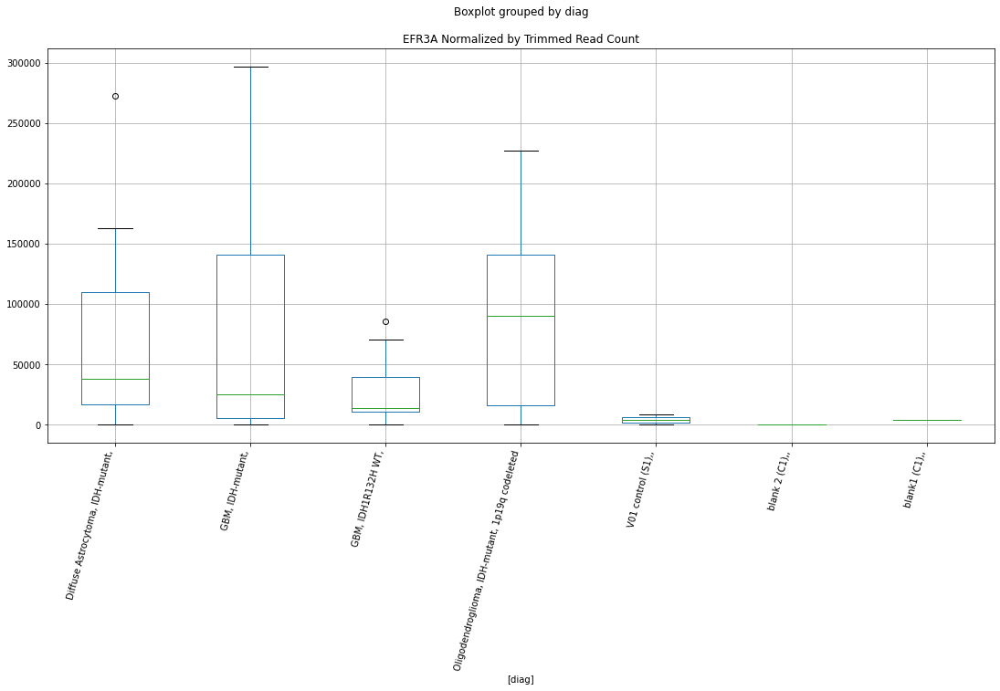

 p : 0.029072798203513738  ( t : 2.3715509906958823 ) :  D-plex  :  cutadapt2  :  ITPRIP
Control and blanks
76         0.00
340    95119.07
Name: ITPRIP, dtype: float64
208    0.0
Name: ITPRIP, dtype: float64
472    2311.82
Name: ITPRIP, dtype: float64


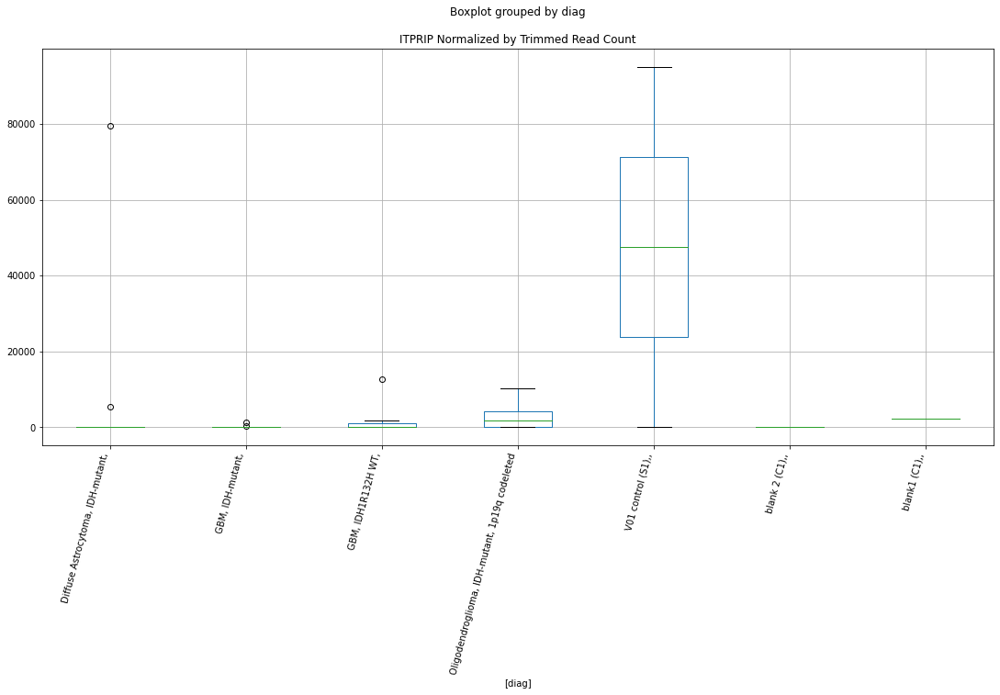

 p : 0.0291918407603504  ( t : 2.3695521593179887 ) :  Lexogen  :  bbduk2  :  FAM205BP
Control and blanks
79     0.0
343    0.0
Name: FAM205BP, dtype: float64
211    0.0
Name: FAM205BP, dtype: float64
475    0.0
Name: FAM205BP, dtype: float64


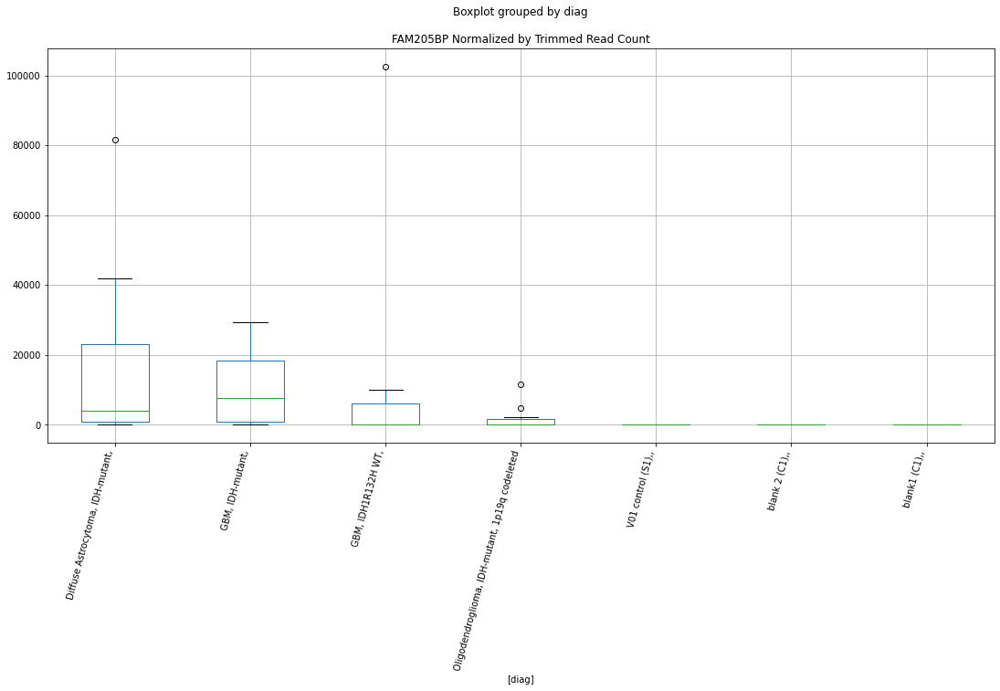

 p : 0.029195331917746974  ( t : 2.3694936544822176 ) :  D-plex  :  bbduk2  :  ELF2
Control and blanks
73         0.0
337    18693.3
Name: ELF2, dtype: float64
205    21490.91
Name: ELF2, dtype: float64
469    24252.62
Name: ELF2, dtype: float64


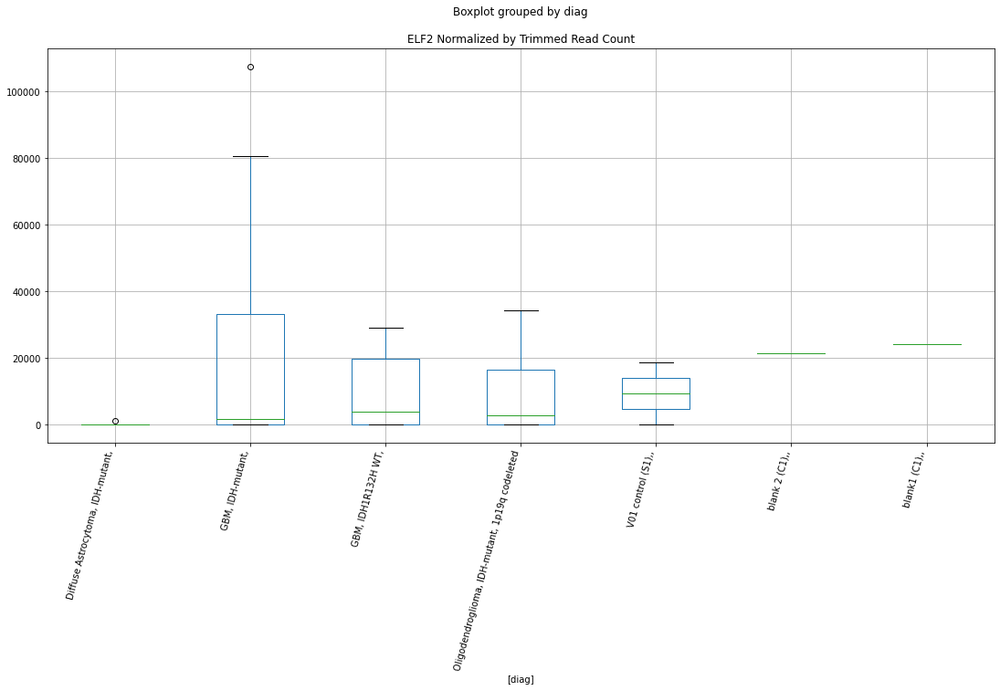

 p : 0.029273730280663258  ( t : 2.368181569800202 ) :  D-plex  :  bbduk2  :  IL9R
Control and blanks
73     0.0
337    0.0
Name: IL9R, dtype: float64
205    716.36
Name: IL9R, dtype: float64
469    0.0
Name: IL9R, dtype: float64


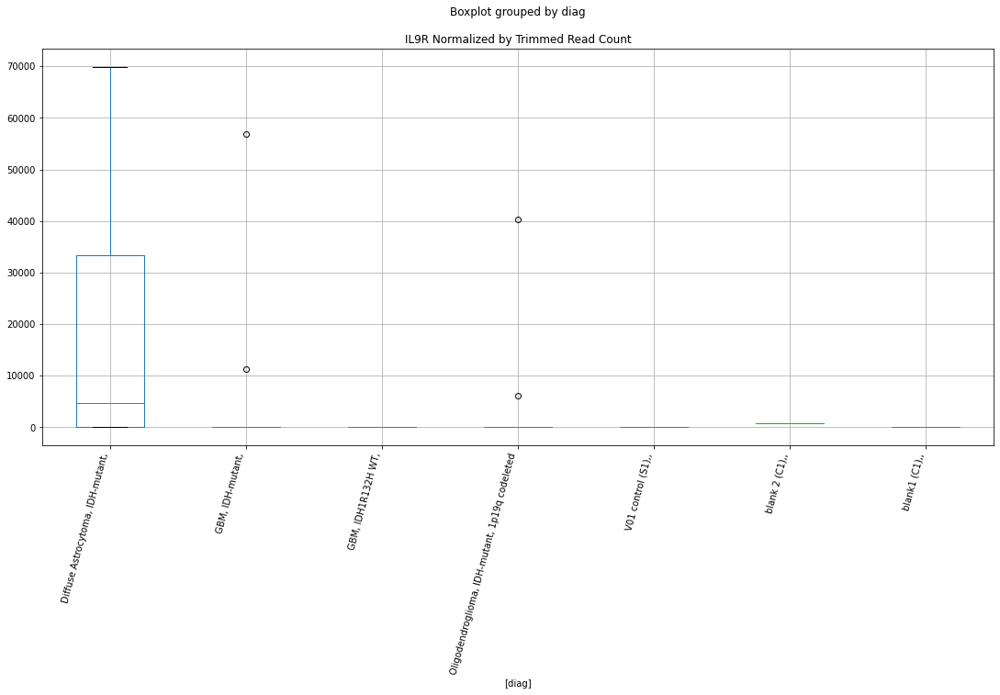

 p : 0.02927915609989854  ( t : 2.368090883915311 ) :  Lexogen  :  bbduk2  :  HP1BP3
Control and blanks
79          0.00
343    174522.37
Name: HP1BP3, dtype: float64
211    0.0
Name: HP1BP3, dtype: float64
475    0.0
Name: HP1BP3, dtype: float64


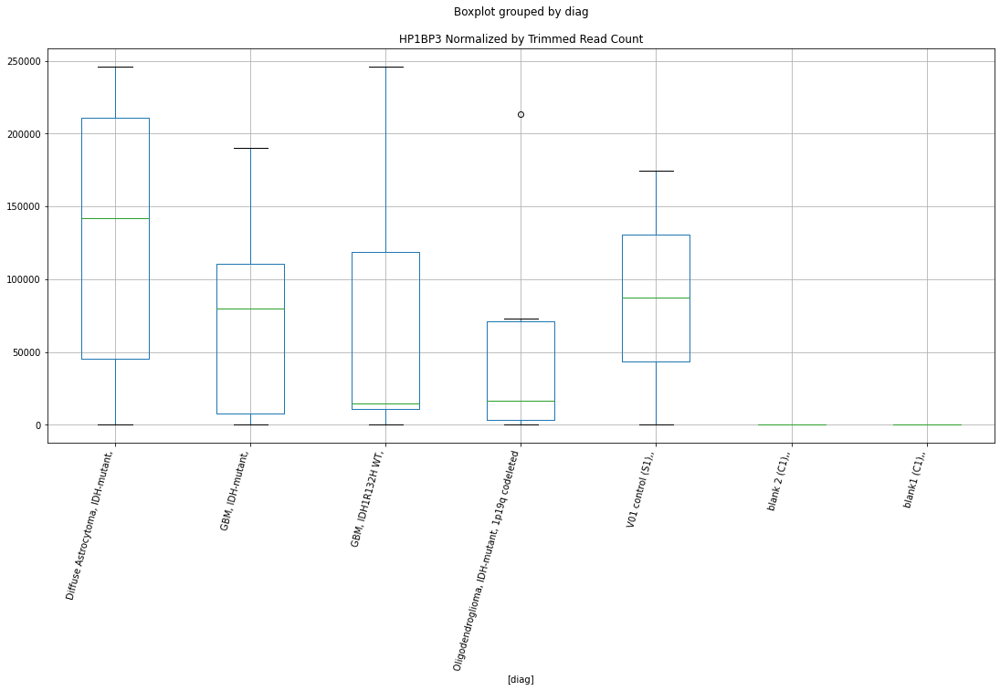

 p : 0.029288815976335175  ( t : 2.3679294697622963 ) :  D-plex  :  bbduk2  :  FOXRED1
Control and blanks
73     3092.03
337       0.00
Name: FOXRED1, dtype: float64
205    14685.46
Name: FOXRED1, dtype: float64
469    18337.35
Name: FOXRED1, dtype: float64


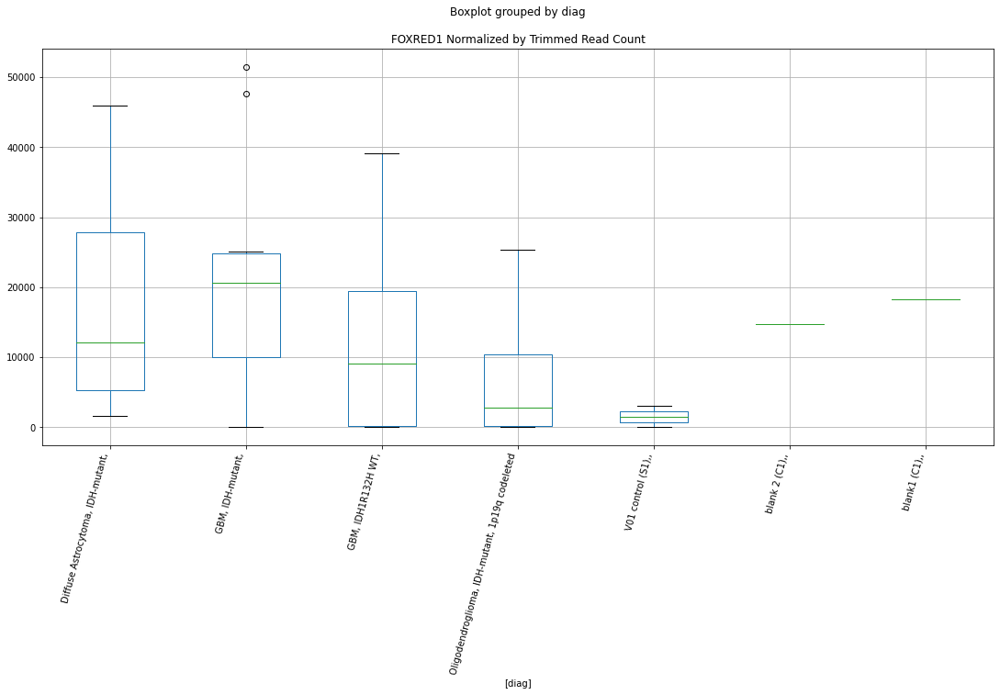

 p : 0.02930001423372432  ( t : 2.367742411768079 ) :  D-plex  :  bbduk2  :  IL11
Control and blanks
73     0.0
337    0.0
Name: IL11, dtype: float64
205    1074.55
Name: IL11, dtype: float64
469    2366.11
Name: IL11, dtype: float64


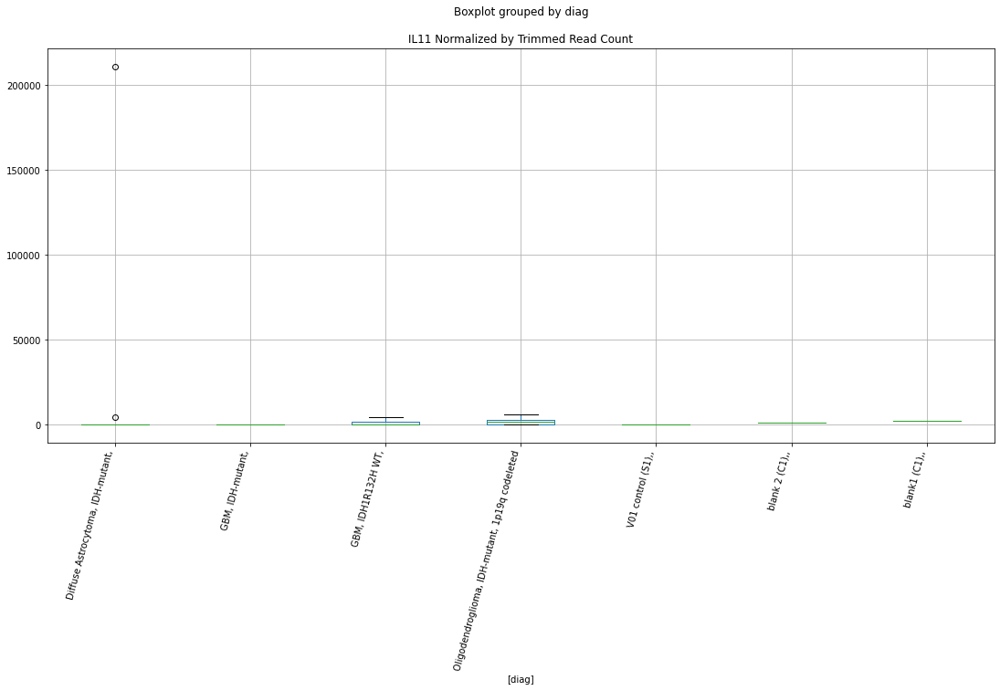

 p : 0.02931591582517442  ( t : 2.367476902836908 ) :  D-plex  :  cutadapt2  :  HNRNPA2B1
Control and blanks
76         0.00
340    36110.02
Name: HNRNPA2B1, dtype: float64
208    18165.1
Name: HNRNPA2B1, dtype: float64
472    53749.89
Name: HNRNPA2B1, dtype: float64


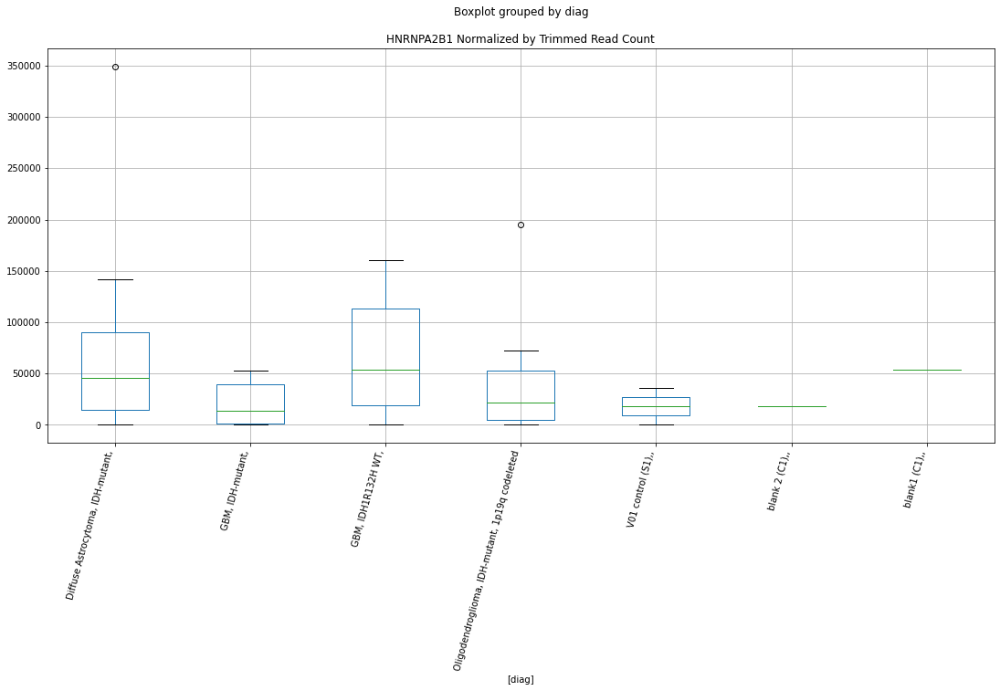

 p : 0.02933605878223895  ( t : 2.3671407685543517 ) :  Lexogen  :  bbduk2  :  IL17RB
Control and blanks
79         0.00
343    10191.09
Name: IL17RB, dtype: float64
211    9839.03
Name: IL17RB, dtype: float64
475    5748.38
Name: IL17RB, dtype: float64


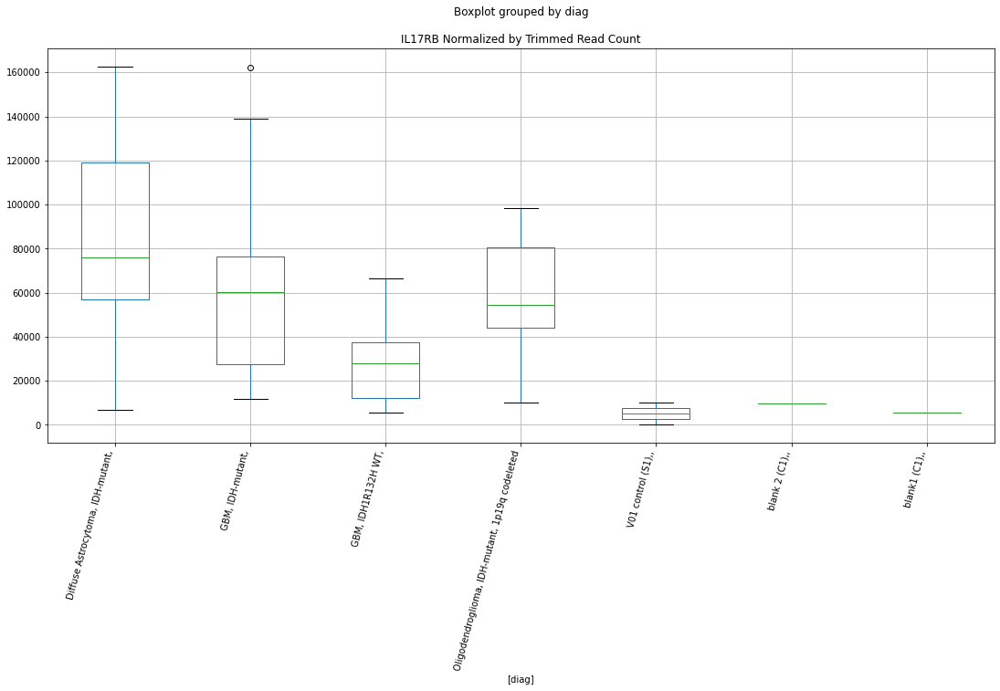

 p : 0.029365534890211407  ( t : 2.3666492756309676 ) :  D-plex  :  cutadapt2  :  GAMT
Control and blanks
76     0.0
340    0.0
Name: GAMT, dtype: float64
208    1763.6
Name: GAMT, dtype: float64
472    4045.69
Name: GAMT, dtype: float64


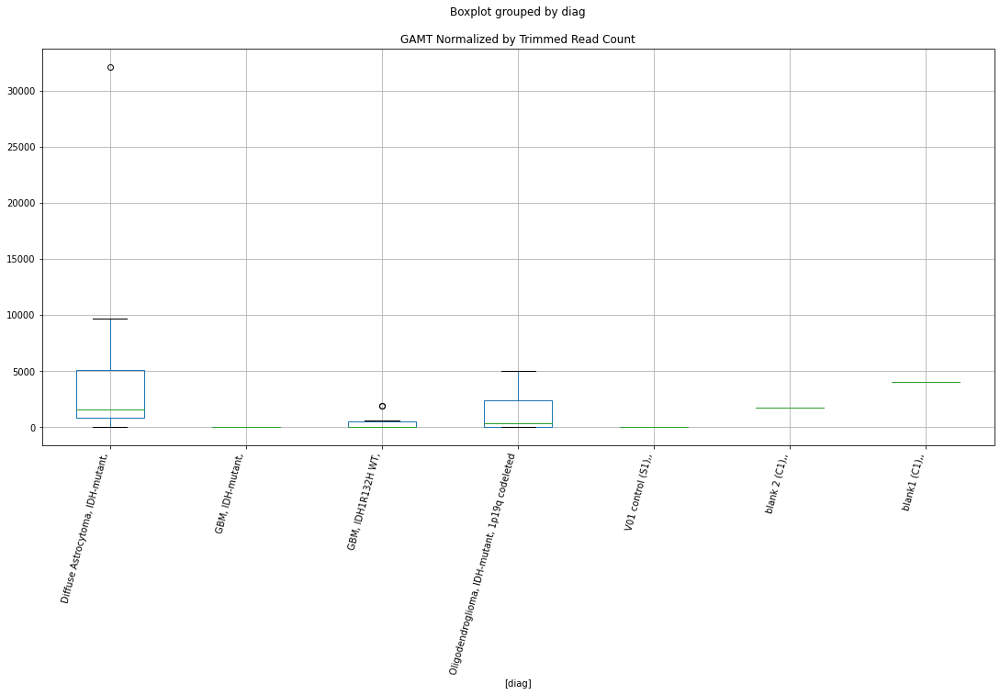

 p : 0.029394421976150158  ( t : 2.366168050358316 ) :  D-plex  :  bbduk2  :  GREM1
Control and blanks
73     12368.13
337        0.00
Name: GREM1, dtype: float64
205    25789.1
Name: GREM1, dtype: float64
469    26027.2
Name: GREM1, dtype: float64


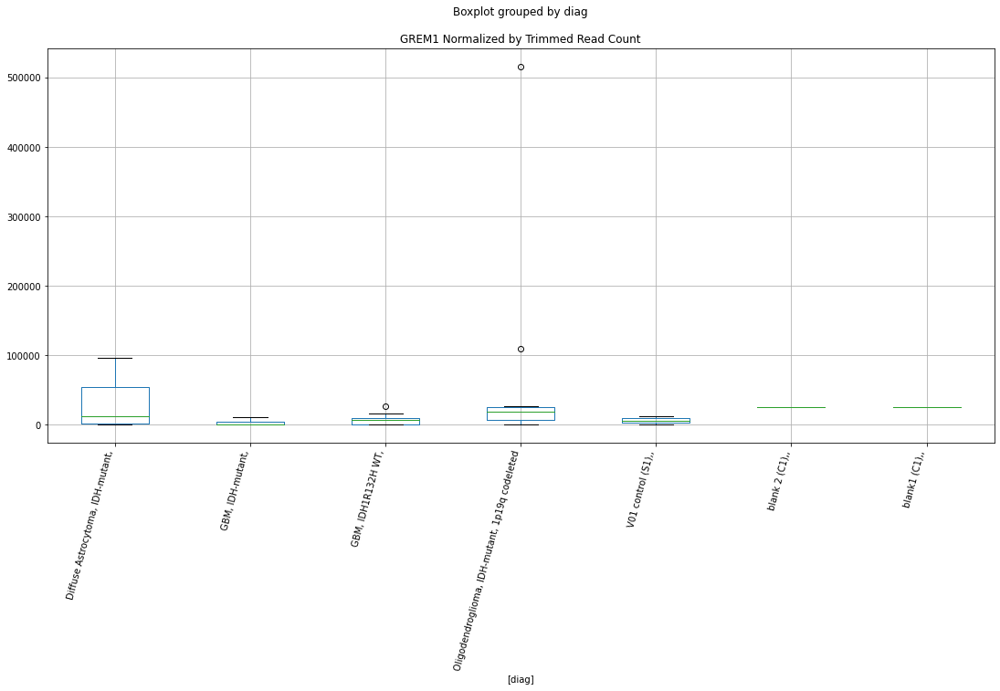

 p : 0.02949321195167969  ( t : 2.364525650178064 ) :  Lexogen  :  cutadapt2  :  DUSP10
Control and blanks
82       0.00
346    420.87
Name: DUSP10, dtype: float64
214    1627.36
Name: DUSP10, dtype: float64
478    237.46
Name: DUSP10, dtype: float64


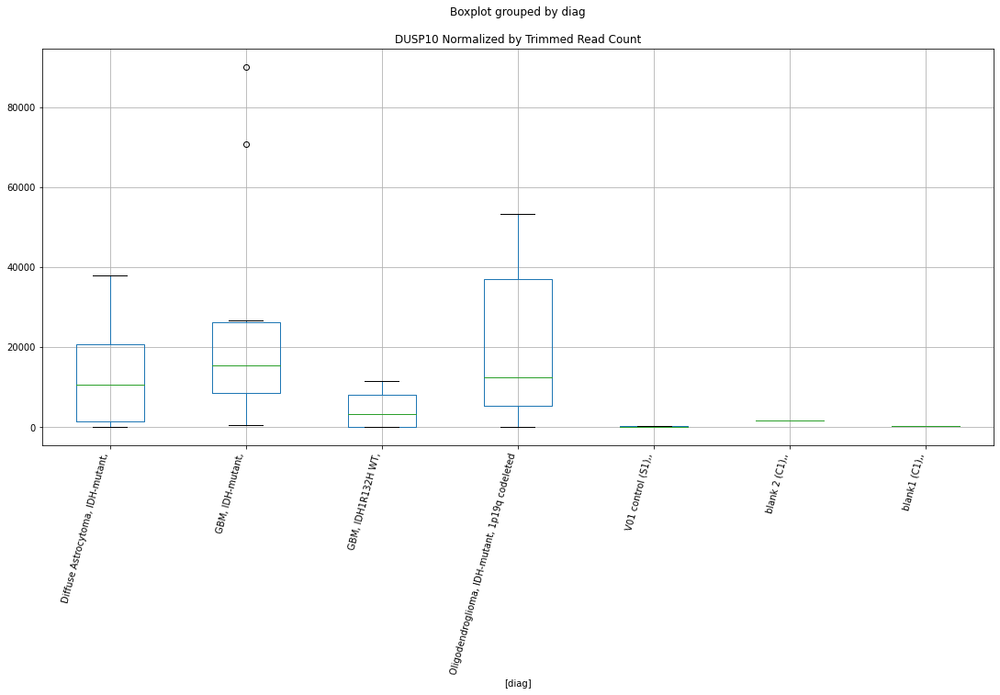

 p : 0.02953123135903965  ( t : 2.363894937542638 ) :  Lexogen  :  bbduk2  :  GLT1D1
Control and blanks
79          0.00
343    781528.99
Name: GLT1D1, dtype: float64
211    0.0
Name: GLT1D1, dtype: float64
475    111135.3
Name: GLT1D1, dtype: float64


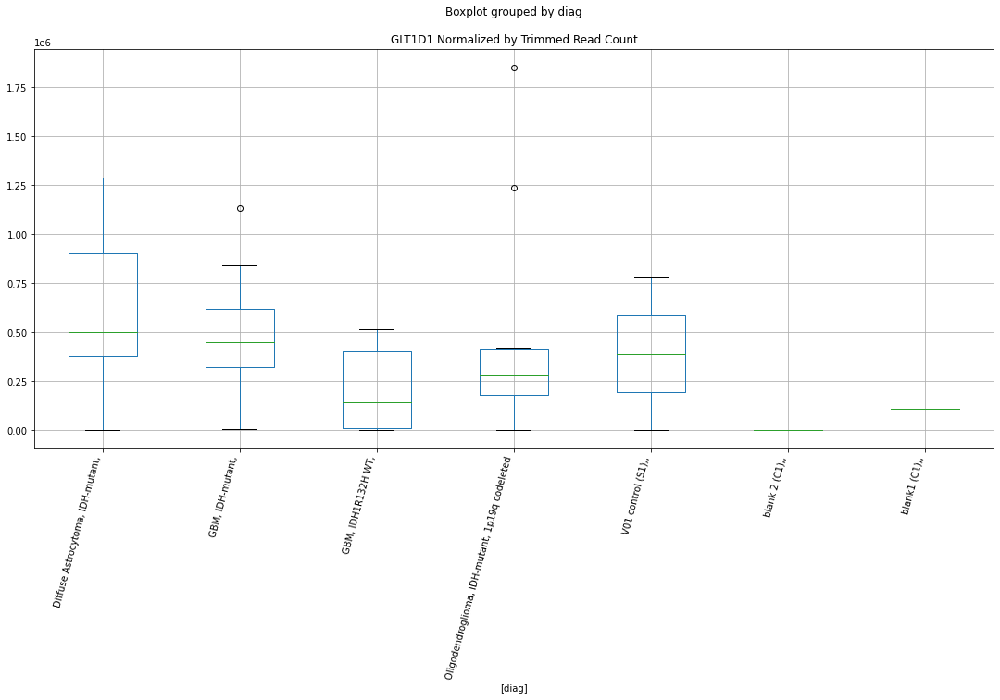

 p : 0.02976018116532027  ( t : 2.3601127645900872 ) :  Lexogen  :  cutadapt2  :  KNDC1
Control and blanks
82     0.0
346    0.0
Name: KNDC1, dtype: float64
214    813.68
Name: KNDC1, dtype: float64
478    0.0
Name: KNDC1, dtype: float64


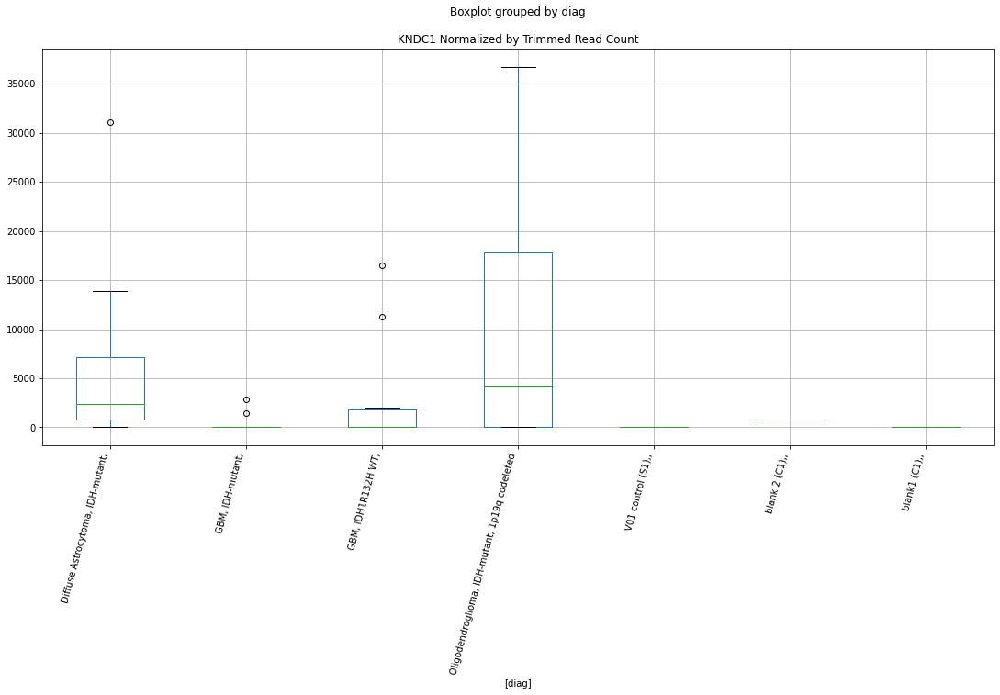

 p : 0.029772099491235073  ( t : 2.3599166213582627 ) :  Lexogen  :  bbduk2  :  HIC1
Control and blanks
79     0.0
343    0.0
Name: HIC1, dtype: float64
211    0.0
Name: HIC1, dtype: float64
475    0.0
Name: HIC1, dtype: float64


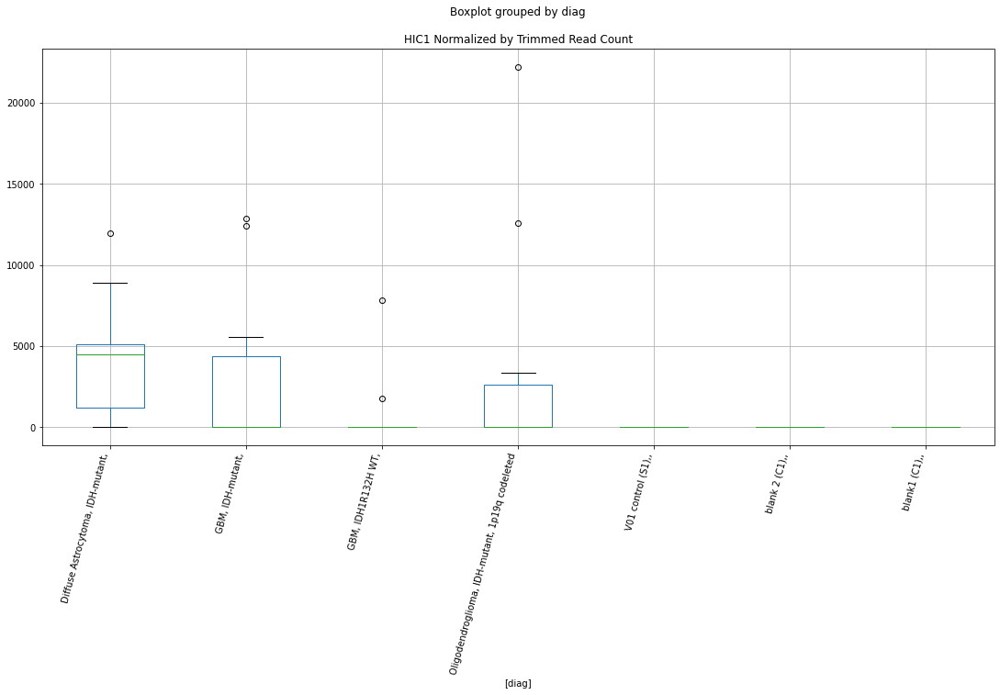

 p : 0.029772693339658925  ( t : 2.359906850142239 ) :  D-plex  :  cutadapt2  :  GP2
Control and blanks
76     3030.46
340       0.00
Name: GP2, dtype: float64
208    2116.32
Name: GP2, dtype: float64
472    2311.82
Name: GP2, dtype: float64


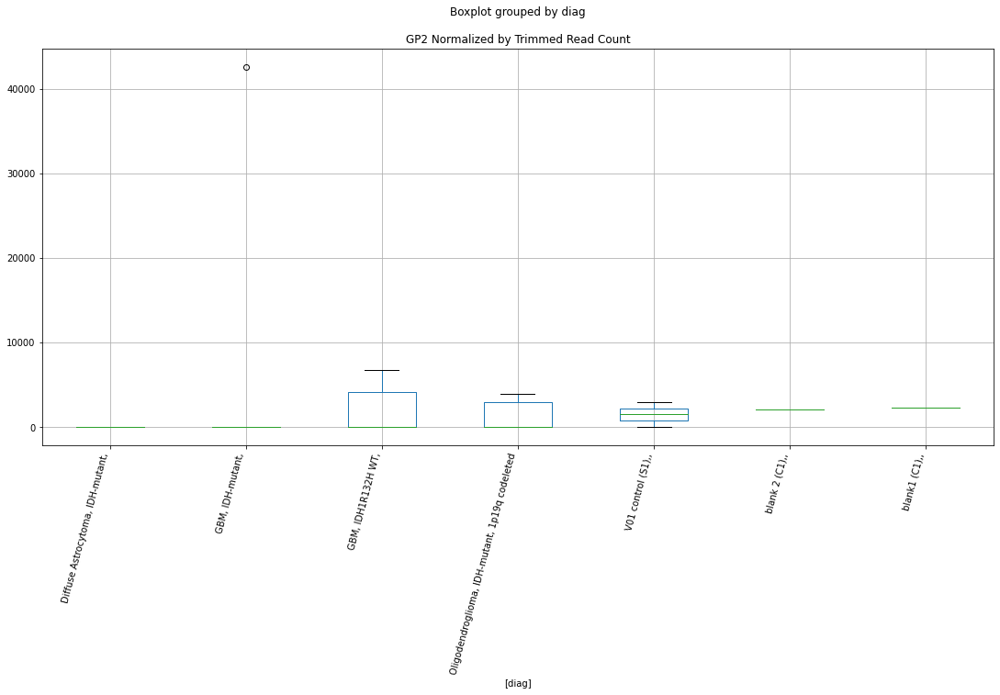

 p : 0.02986410630493666  ( t : 2.3584048975412824 ) :  Lexogen  :  bbduk2  :  HMGN5
Control and blanks
79     0.0
343    0.0
Name: HMGN5, dtype: float64
211    0.0
Name: HMGN5, dtype: float64
475    0.0
Name: HMGN5, dtype: float64


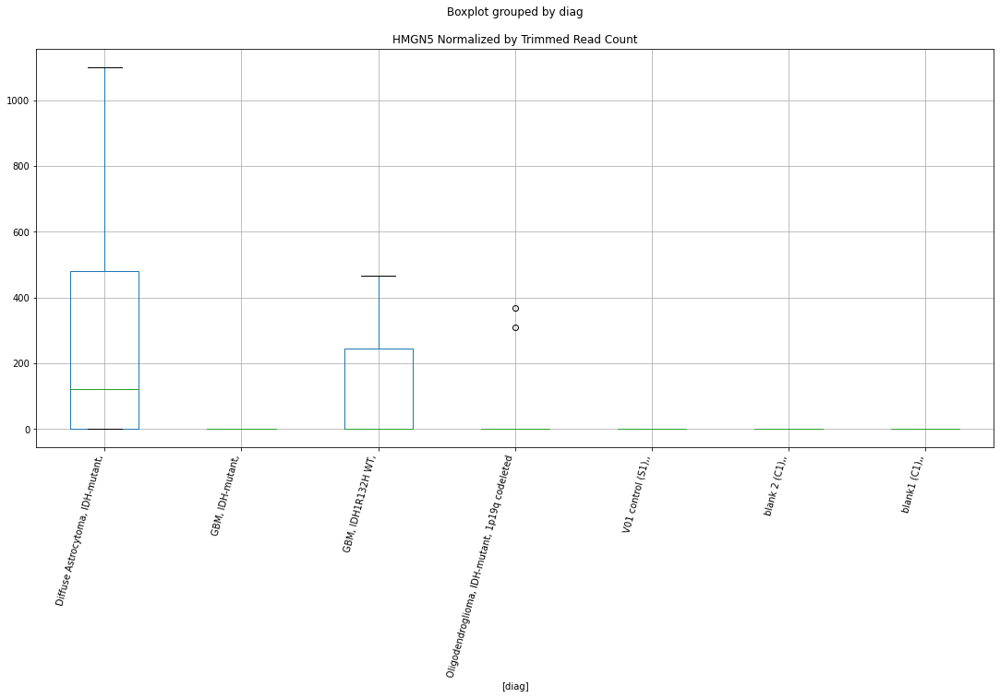

 p : 0.029965285439917295  ( t : 2.356747469571489 ) :  Lexogen  :  bbduk2  :  DNAH1
Control and blanks
79          0.00
343    122293.05
Name: DNAH1, dtype: float64
211    17218.3
Name: DNAH1, dtype: float64
475    0.0
Name: DNAH1, dtype: float64


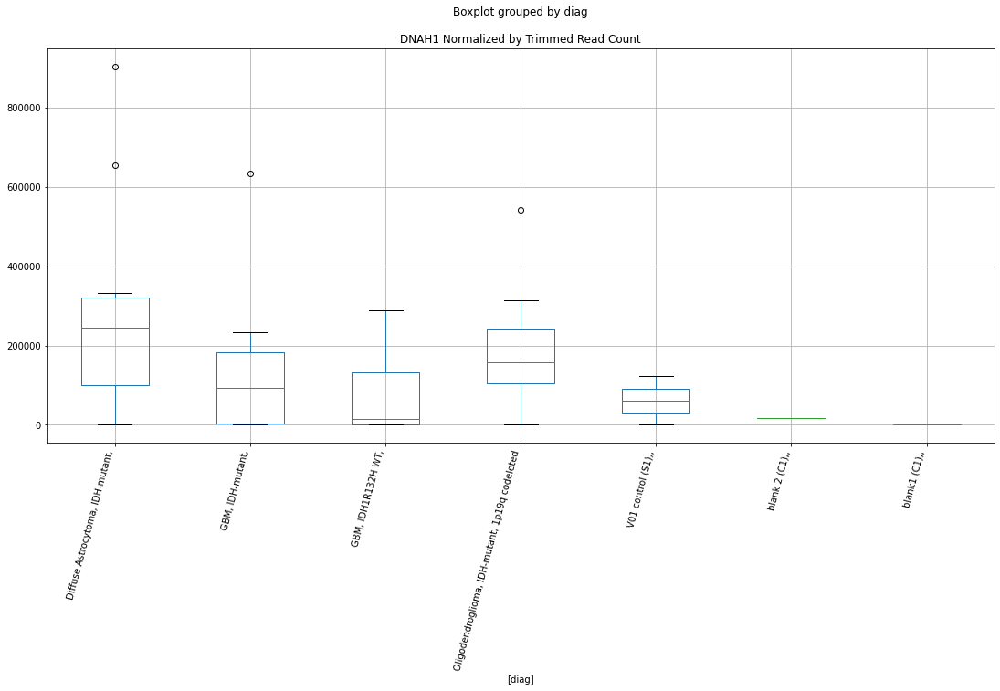

 p : 0.029969259255736527  ( t : 2.356682480475283 ) :  Lexogen  :  bbduk2  :  GPI
Control and blanks
79         0.00
343    17409.77
Name: GPI, dtype: float64
211    7105.96
Name: GPI, dtype: float64
475    1676.61
Name: GPI, dtype: float64


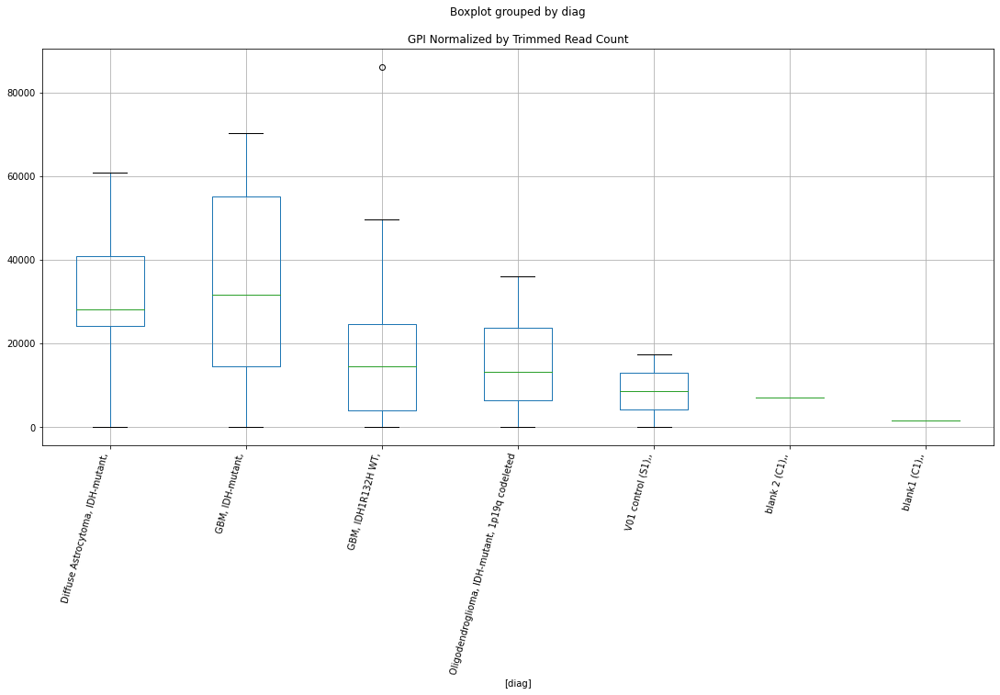

 p : 0.030068687795788255  ( t : 2.355059001285001 ) :  Lexogen  :  cutadapt2  :  DUSP10
Control and blanks
82       0.00
346    420.87
Name: DUSP10, dtype: float64
214    1627.36
Name: DUSP10, dtype: float64
478    237.46
Name: DUSP10, dtype: float64


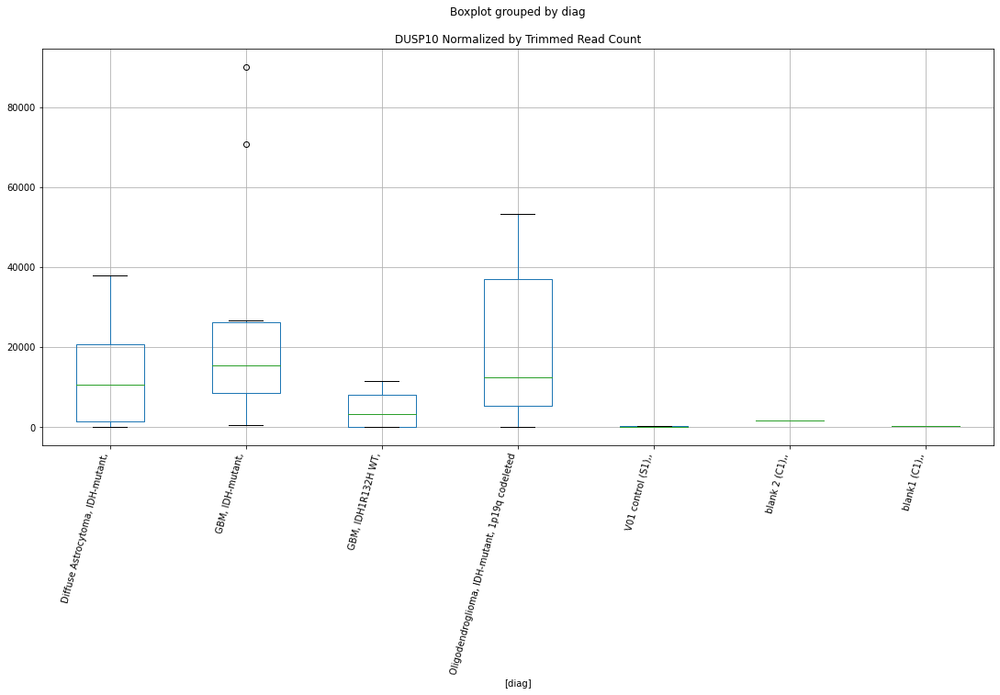

 p : 0.03023289580610347  ( t : 2.3523887138978927 ) :  Lexogen  :  cutadapt2  :  DNAH1
Control and blanks
82          0.00
346    121210.28
Name: DNAH1, dtype: float64
214    15188.68
Name: DNAH1, dtype: float64
478    0.0
Name: DNAH1, dtype: float64


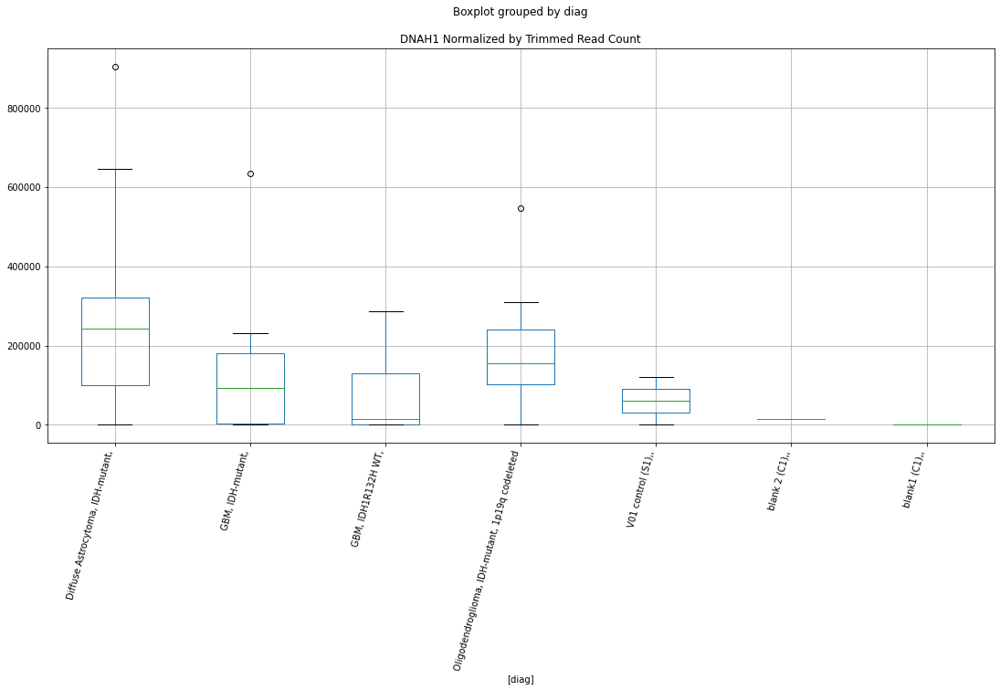

 p : 0.030360545381223892  ( t : 2.3503222412362583 ) :  D-plex  :  cutadapt2  :  GABARAPL1
Control and blanks
76     0.0
340    0.0
Name: GABARAPL1, dtype: float64
208    1234.52
Name: GABARAPL1, dtype: float64
472    2311.82
Name: GABARAPL1, dtype: float64


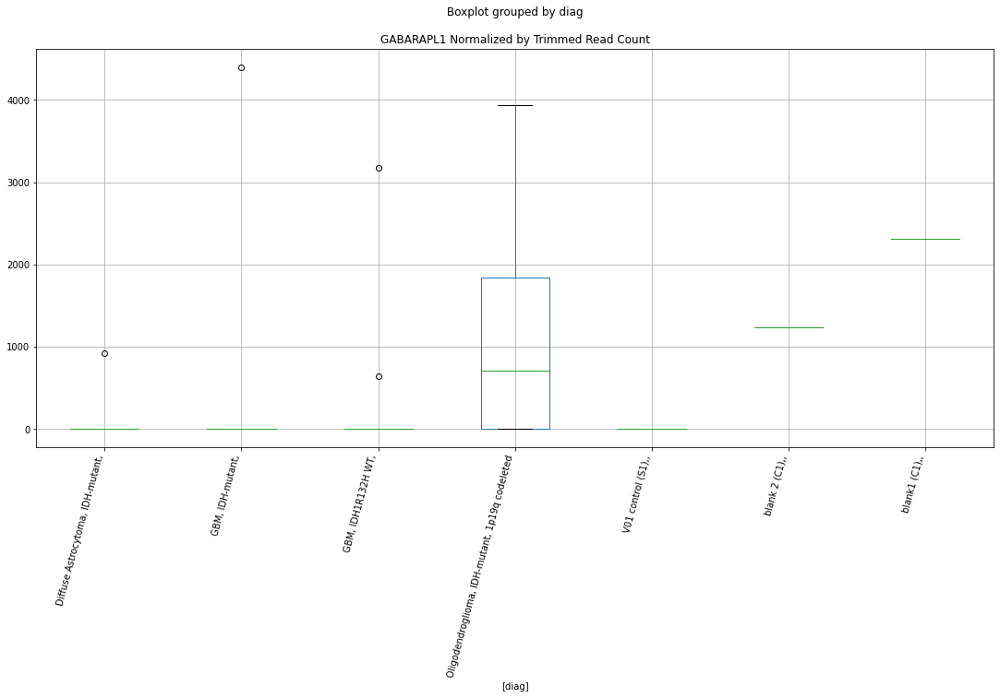

 p : 0.030385701307381663  ( t : 2.349915955632279 ) :  D-plex  :  cutadapt2  :  EIF2B5
Control and blanks
76         0.00
340    66054.91
Name: EIF2B5, dtype: float64
208    2116.32
Name: EIF2B5, dtype: float64
472    0.0
Name: EIF2B5, dtype: float64


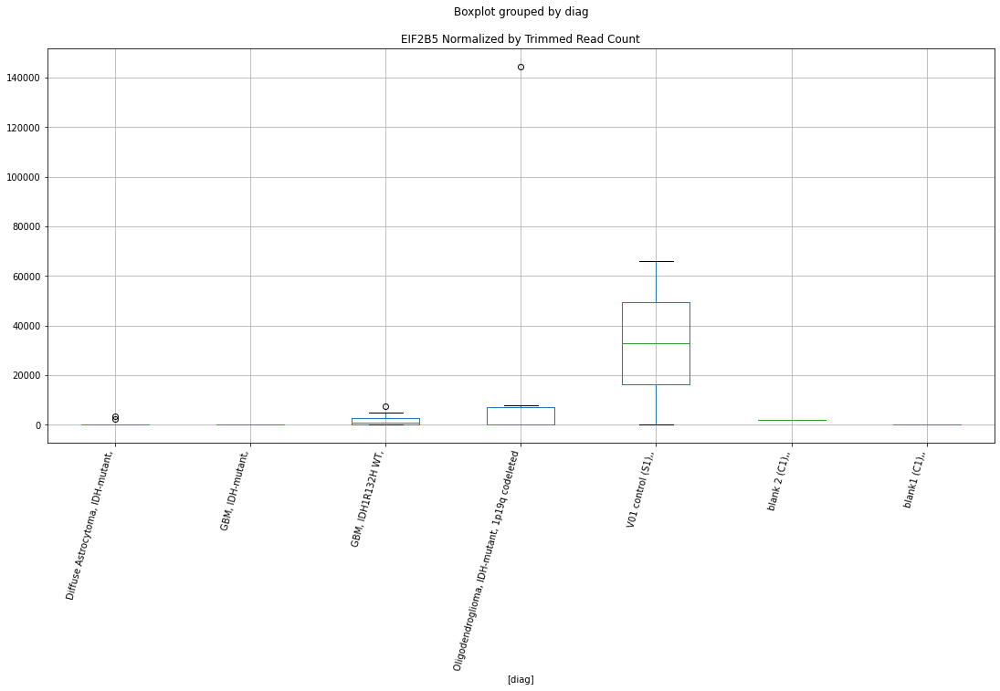

 p : 0.03047229436857588  ( t : 2.3485198083575063 ) :  Lexogen  :  cutadapt2  :  ECI1
Control and blanks
82     0.0
346    0.0
Name: ECI1, dtype: float64
214    0.0
Name: ECI1, dtype: float64
478    0.0
Name: ECI1, dtype: float64


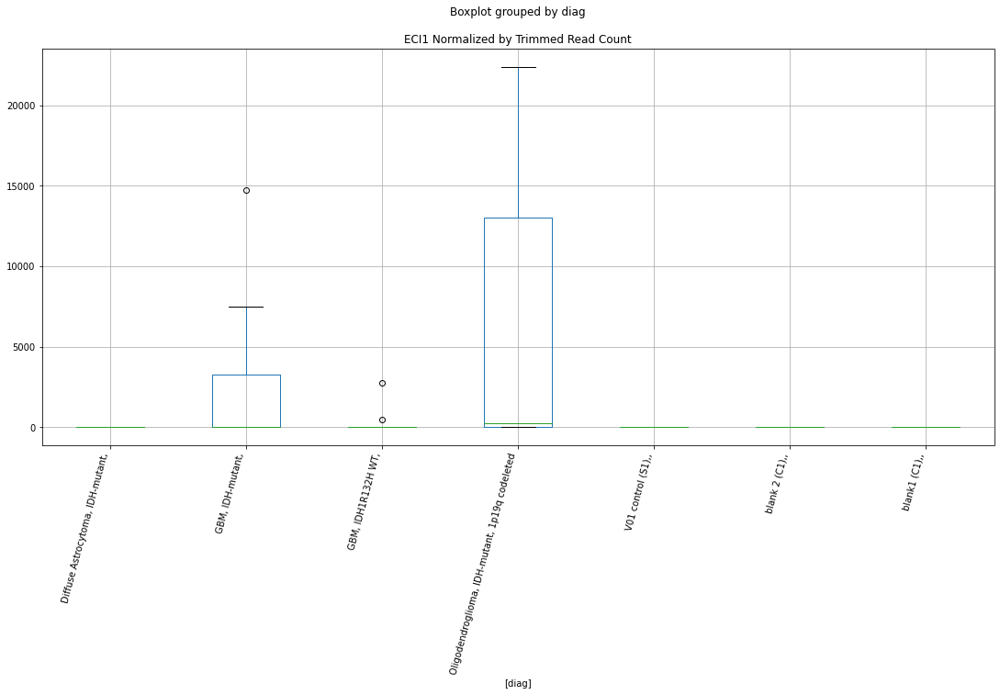

 p : 0.030481292256955242  ( t : 2.3483749465704133 ) :  D-plex  :  bbduk2  :  EIF3L
Control and blanks
73     0.0
337    0.0
Name: EIF3L, dtype: float64
205    895.45
Name: EIF3L, dtype: float64
469    0.0
Name: EIF3L, dtype: float64


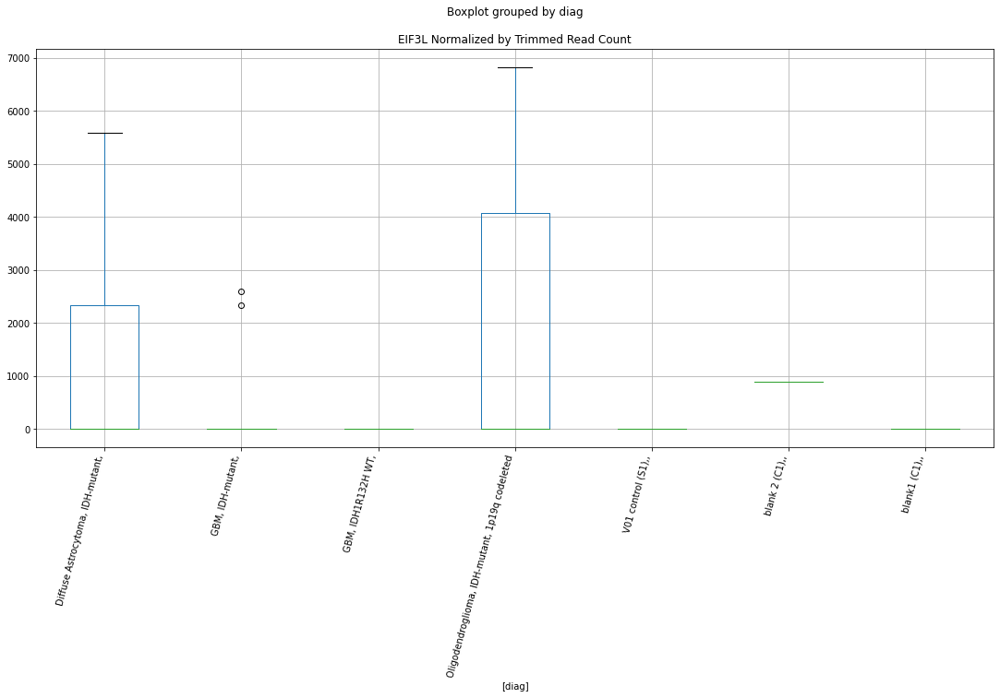

 p : 0.030511820543815023  ( t : 2.3478837519668105 ) :  D-plex  :  cutadapt2  :  GSPT1
Control and blanks
76     2272.84
340       0.00
Name: GSPT1, dtype: float64
208    1587.24
Name: GSPT1, dtype: float64
472    1733.87
Name: GSPT1, dtype: float64


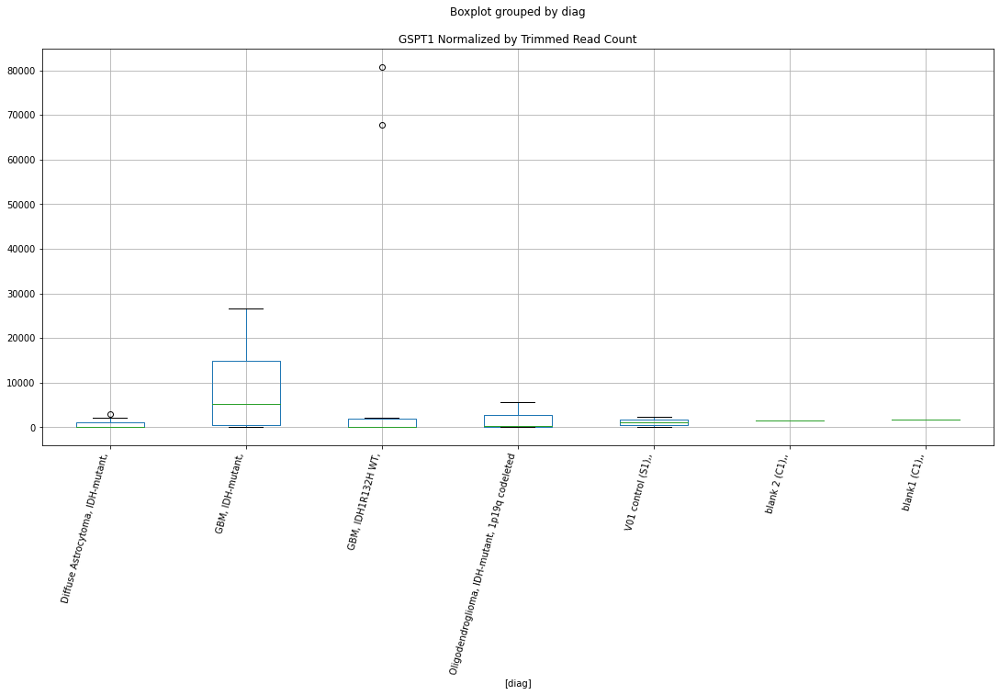

 p : 0.030548847495528383  ( t : 2.347288608664263 ) :  Lexogen  :  bbduk2  :  JUP
Control and blanks
79     0.0
343    0.0
Name: JUP, dtype: float64
211    0.0
Name: JUP, dtype: float64
475    0.0
Name: JUP, dtype: float64


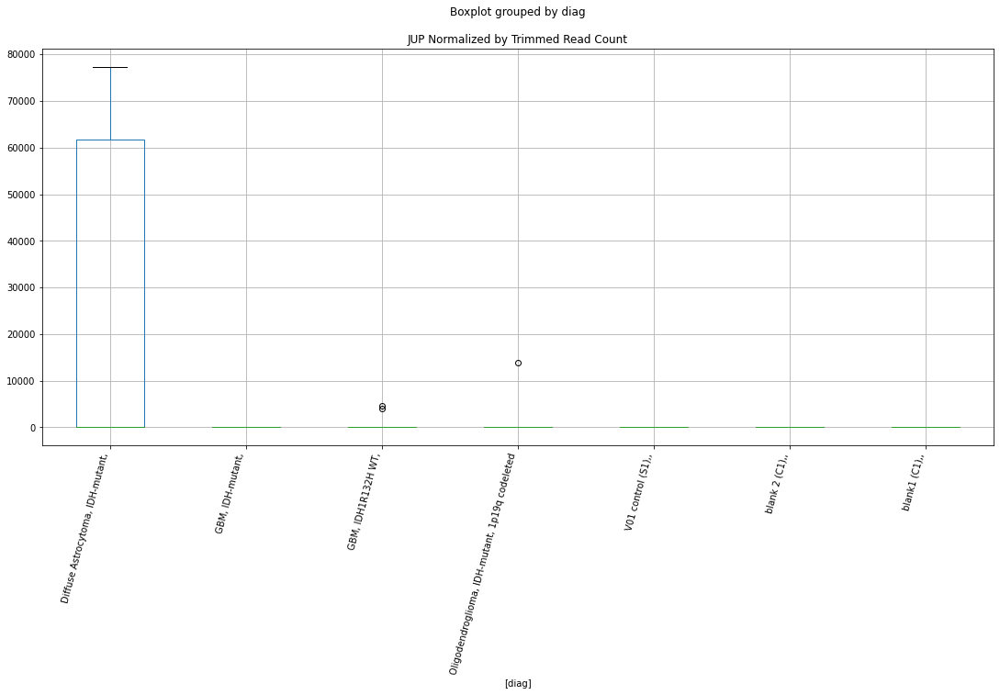

 p : 0.03055975582313867  ( t : 2.347113404492314 ) :  Lexogen  :  cutadapt2  :  JUP
Control and blanks
82     0.0
346    0.0
Name: JUP, dtype: float64
214    0.0
Name: JUP, dtype: float64
478    0.0
Name: JUP, dtype: float64


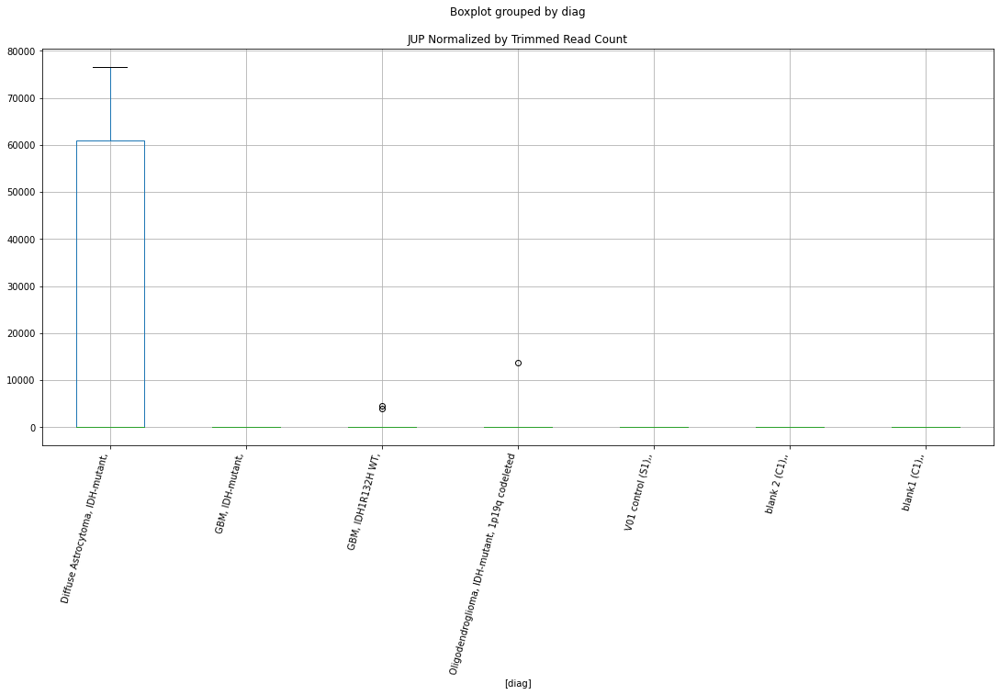

 p : 0.030713150372879316  ( t : 2.3446558027855264 ) :  Lexogen  :  cutadapt2  :  GLT1D1
Control and blanks
82          0.00
346    777976.43
Name: GLT1D1, dtype: float64
214    0.0
Name: GLT1D1, dtype: float64
478    110181.66
Name: GLT1D1, dtype: float64


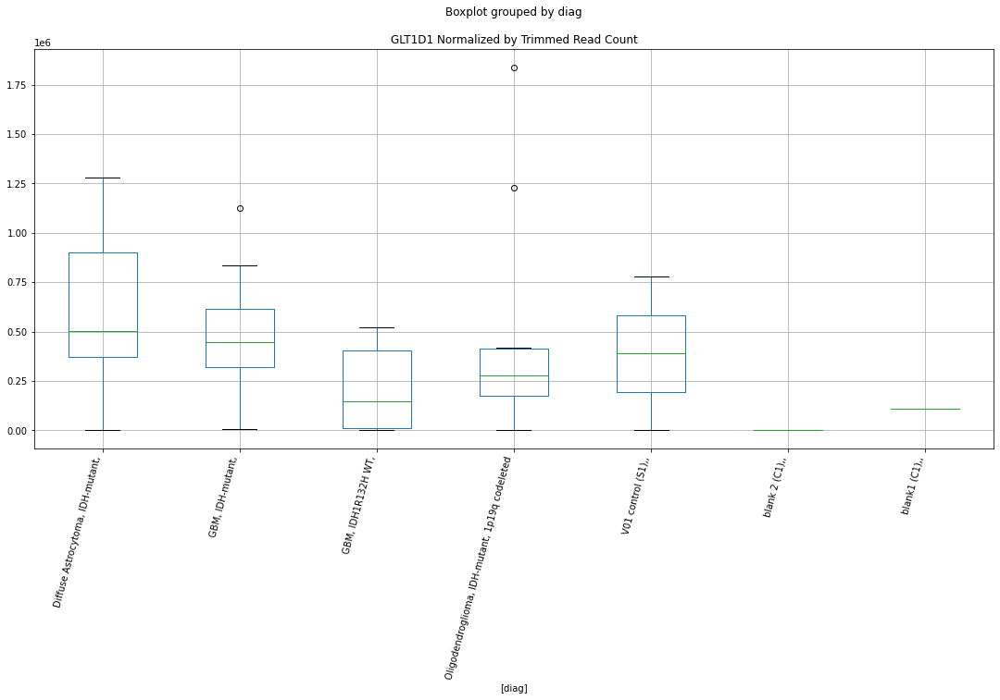

 p : 0.03071399727816187  ( t : 2.344642265883599 ) :  D-plex  :  cutadapt2  :  GOLGA6L10
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L10, dtype: float64
208    1234.52
Name: GOLGA6L10, dtype: float64
472    1155.91
Name: GOLGA6L10, dtype: float64


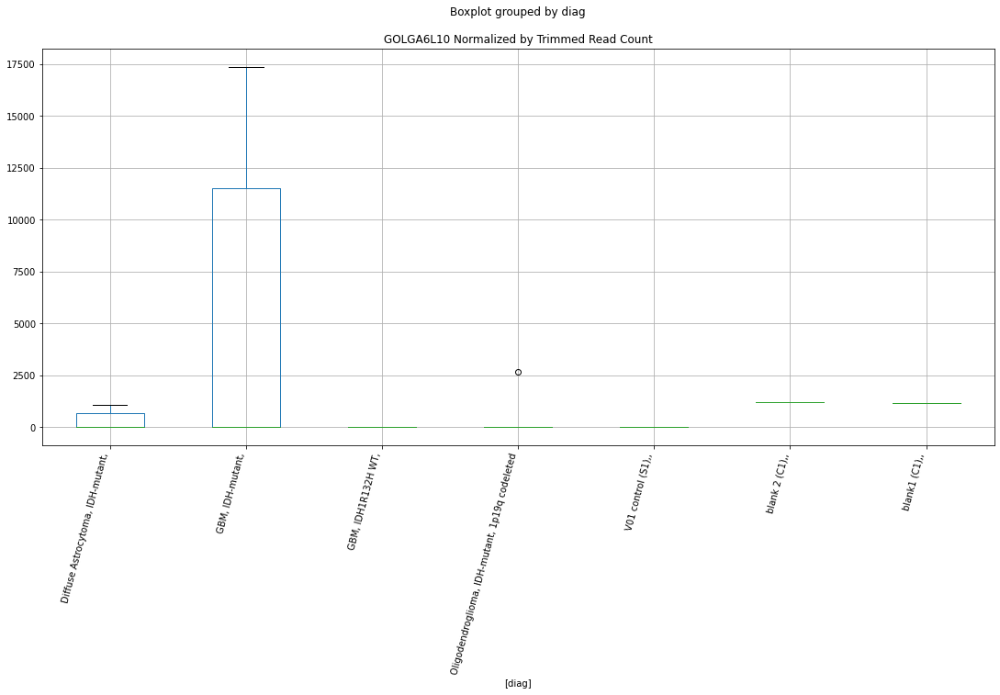

 p : 0.030717337027453353  ( t : 2.3445888868436224 ) :  D-plex  :  cutadapt2  :  FARP1
Control and blanks
76     0.0
340    0.0
Name: FARP1, dtype: float64
208    4585.37
Name: FARP1, dtype: float64
472    0.0
Name: FARP1, dtype: float64


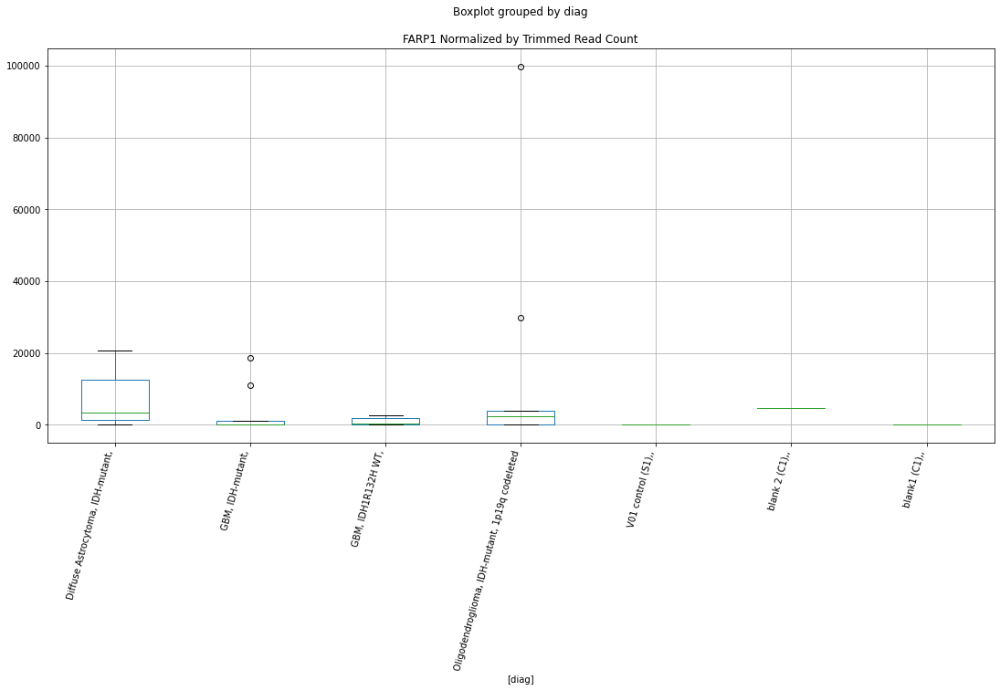

 p : 0.03082492335532447  ( t : 2.342872223297356 ) :  D-plex  :  bbduk2  :  KIF19
Control and blanks
73     6184.07
337       0.00
Name: KIF19, dtype: float64
205    0.0
Name: KIF19, dtype: float64
469    0.0
Name: KIF19, dtype: float64


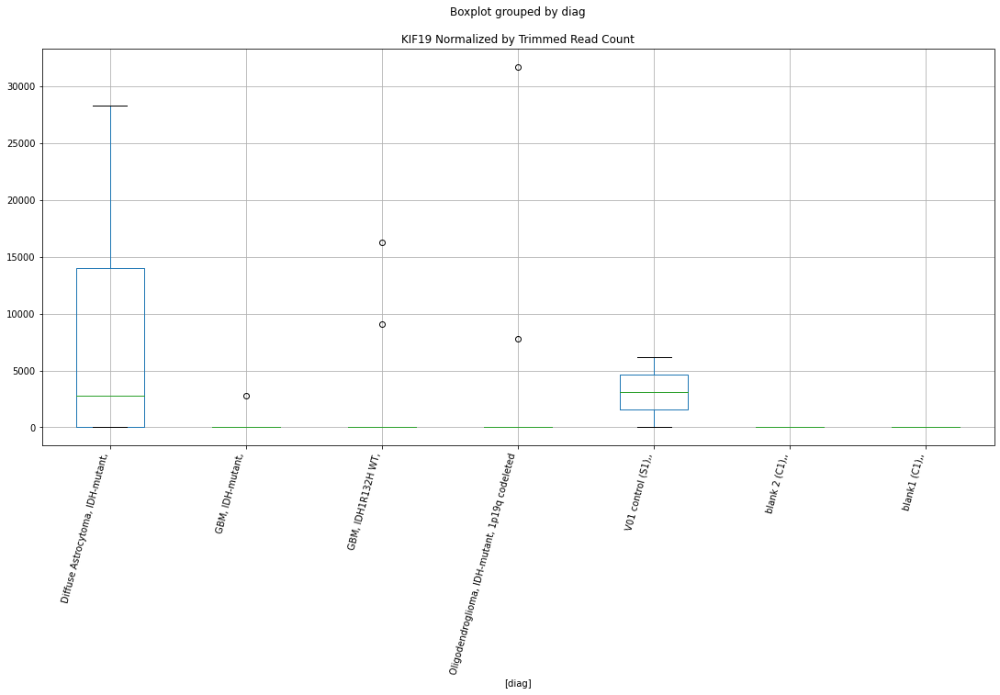

 p : 0.030865592183311284  ( t : 2.34222475731444 ) :  D-plex  :  cutadapt2  :  FRAS1
Control and blanks
76     1515.23
340    2642.20
Name: FRAS1, dtype: float64
208    2469.04
Name: FRAS1, dtype: float64
472    6935.47
Name: FRAS1, dtype: float64


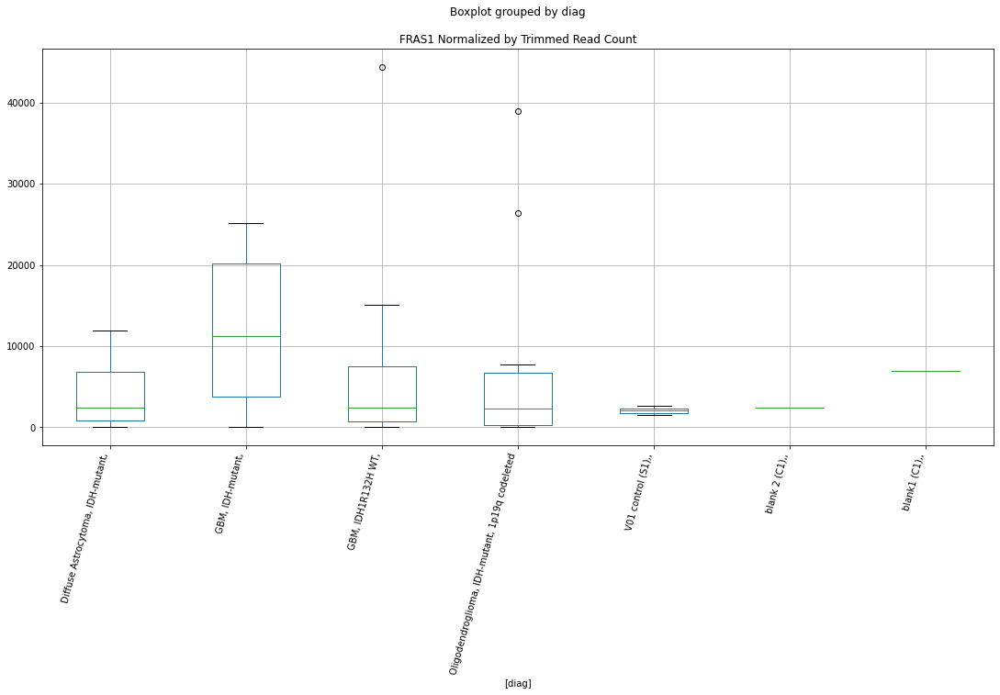

 p : 0.03087621922299769  ( t : 2.342055700901865 ) :  D-plex  :  cutadapt2  :  IFT88
Control and blanks
76     0.0
340    0.0
Name: IFT88, dtype: float64
208    63489.68
Name: IFT88, dtype: float64
472    86115.42
Name: IFT88, dtype: float64


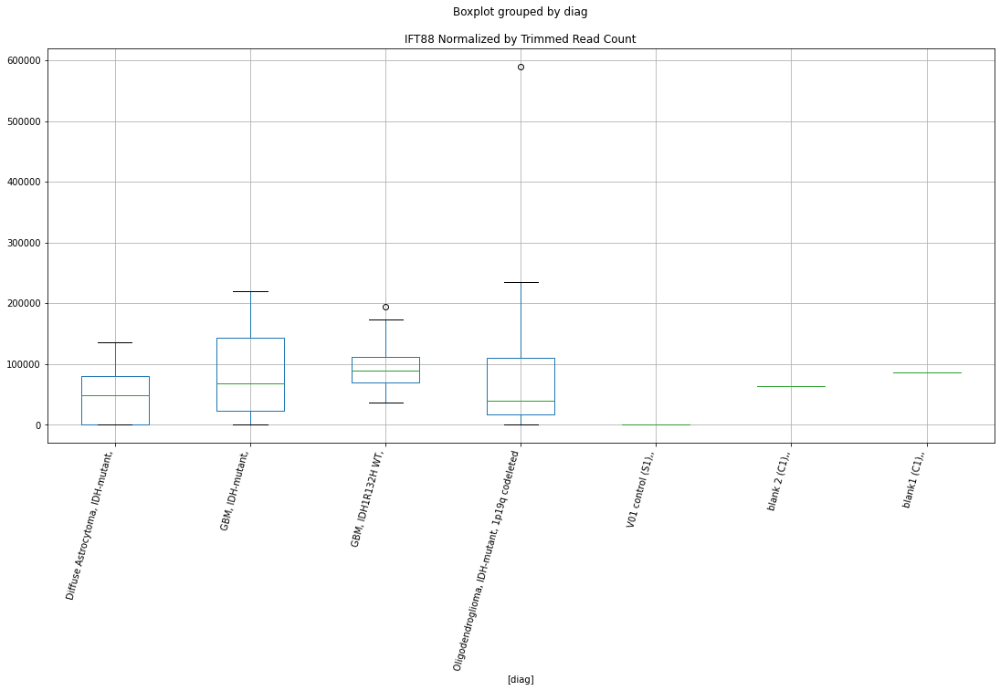

 p : 0.030889701710145375  ( t : 2.3418412975410563 ) :  Lexogen  :  bbduk2  :  IFRD1
Control and blanks
79     0.0
343    0.0
Name: IFRD1, dtype: float64
211    0.0
Name: IFRD1, dtype: float64
475    1197.58
Name: IFRD1, dtype: float64


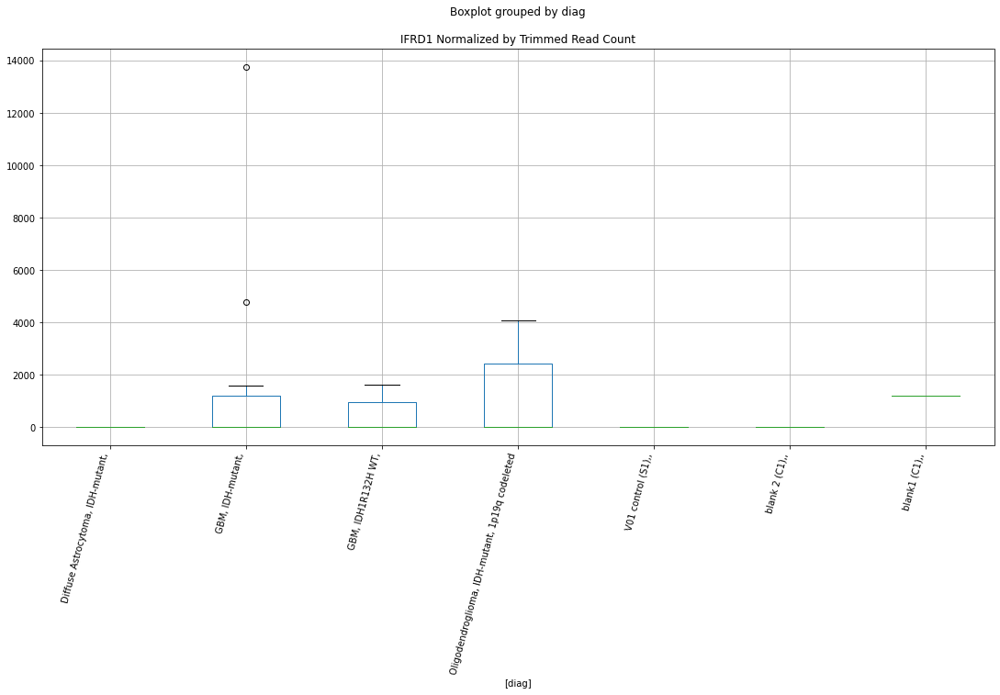

 p : 0.0309152593539812  ( t : 2.3414351095704915 ) :  D-plex  :  cutadapt2  :  KIF1A
Control and blanks
76     0.0
340    0.0
Name: KIF1A, dtype: float64
208    7230.77
Name: KIF1A, dtype: float64
472    17338.68
Name: KIF1A, dtype: float64


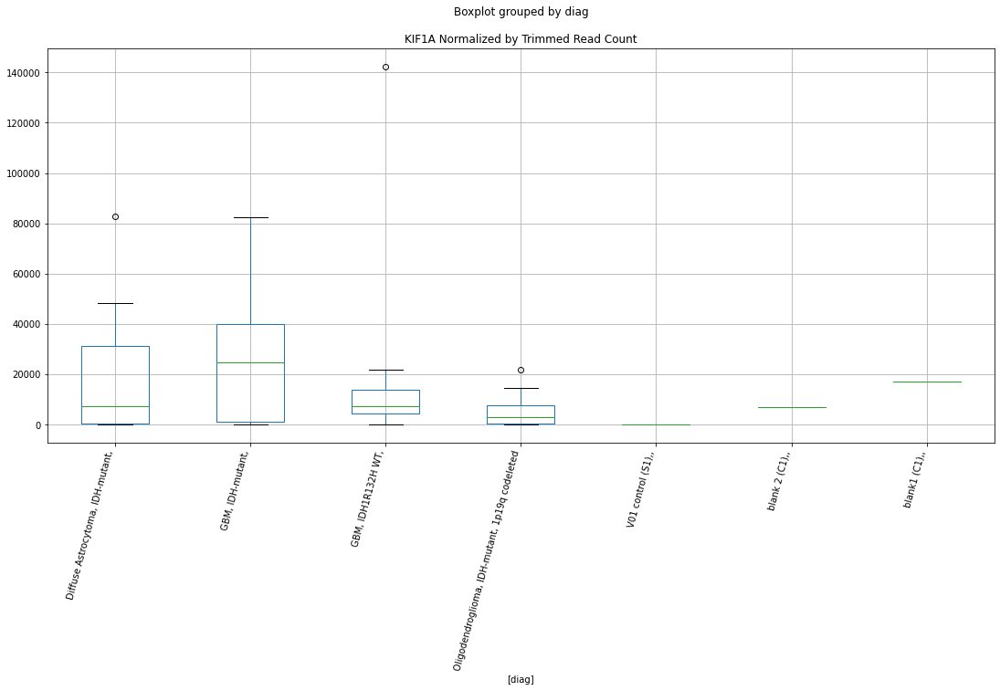

 p : 0.031114565005254155  ( t : 2.3382782175501853 ) :  D-plex  :  bbduk2  :  FAM234A
Control and blanks
73     0.0
337    0.0
Name: FAM234A, dtype: float64
205    716.36
Name: FAM234A, dtype: float64
469    9464.44
Name: FAM234A, dtype: float64


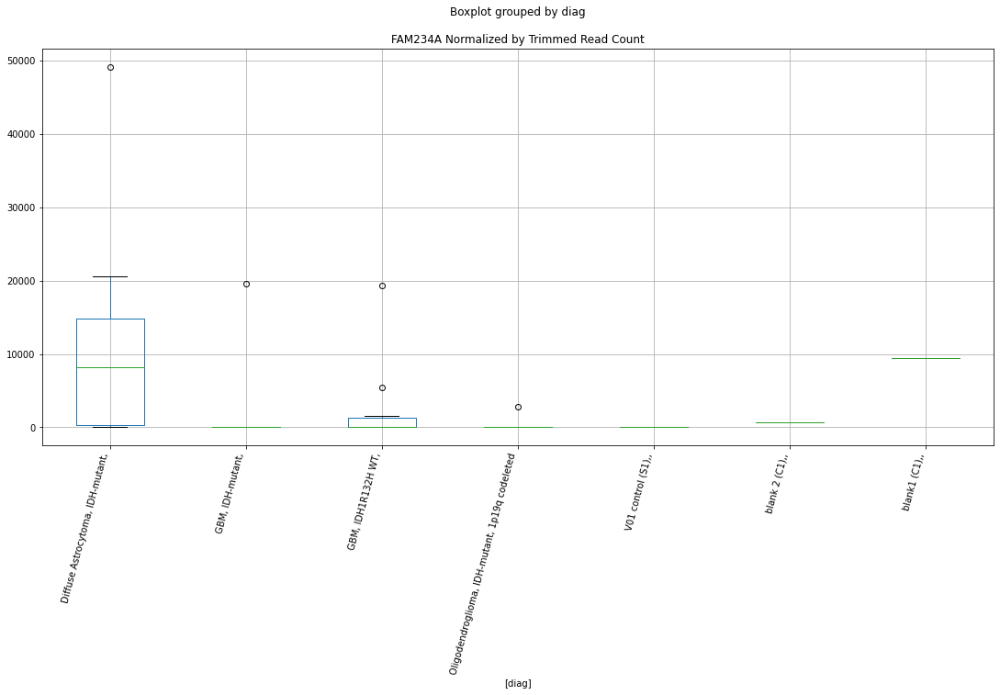

 p : 0.031260339226840204  ( t : 2.3359811227093137 ) :  Lexogen  :  bbduk2  :  DUSP10
Control and blanks
79     4291.80
343    2760.09
Name: DUSP10, dtype: float64
211    4099.6
Name: DUSP10, dtype: float64
475    1916.13
Name: DUSP10, dtype: float64


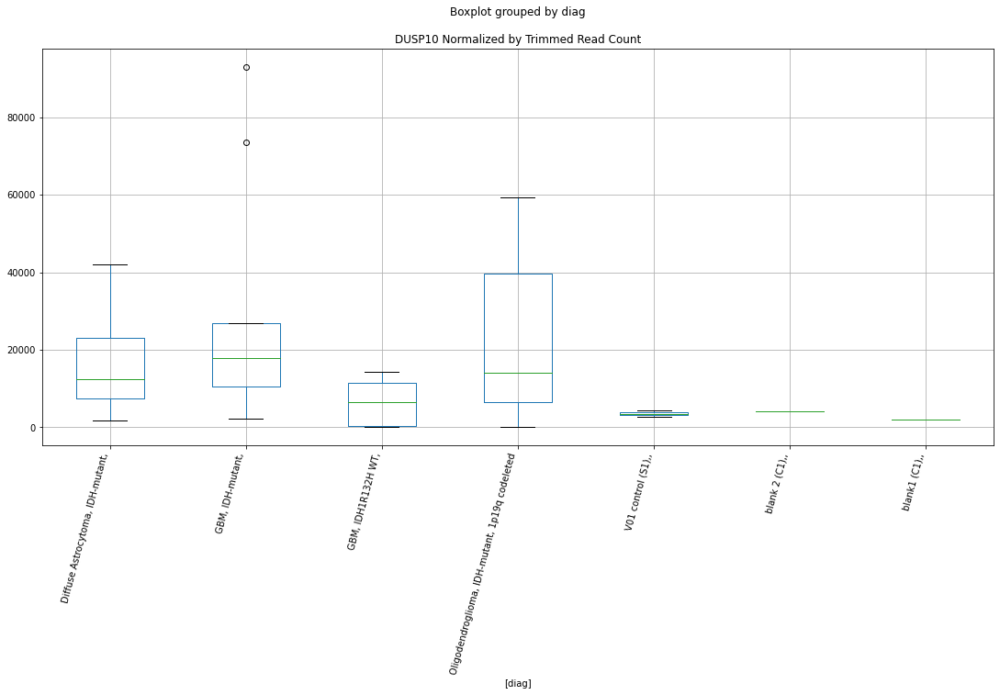

 p : 0.031283472160328604  ( t : 2.3356175126720613 ) :  D-plex  :  cutadapt2  :  FAM234A
Control and blanks
76     0.0
340    0.0
Name: FAM234A, dtype: float64
208    705.44
Name: FAM234A, dtype: float64
472    9247.29
Name: FAM234A, dtype: float64


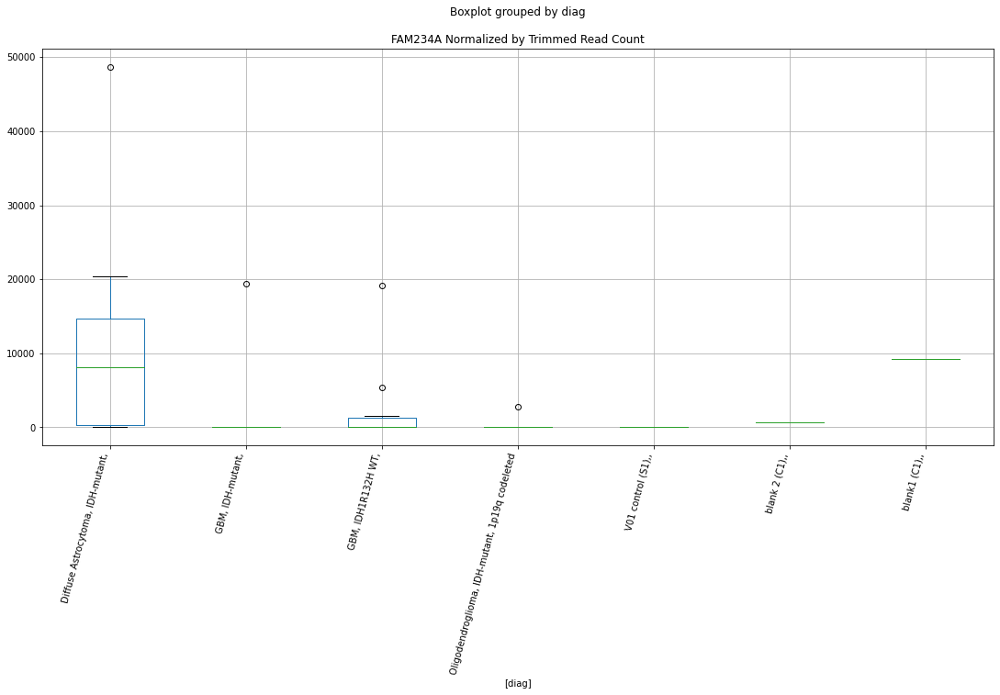

 p : 0.031465019488995744  ( t : 2.3327725501924745 ) :  D-plex  :  bbduk2  :  HAUS8
Control and blanks
73     0.0
337    0.0
Name: HAUS8, dtype: float64
205    3223.64
Name: HAUS8, dtype: float64
469    1774.58
Name: HAUS8, dtype: float64


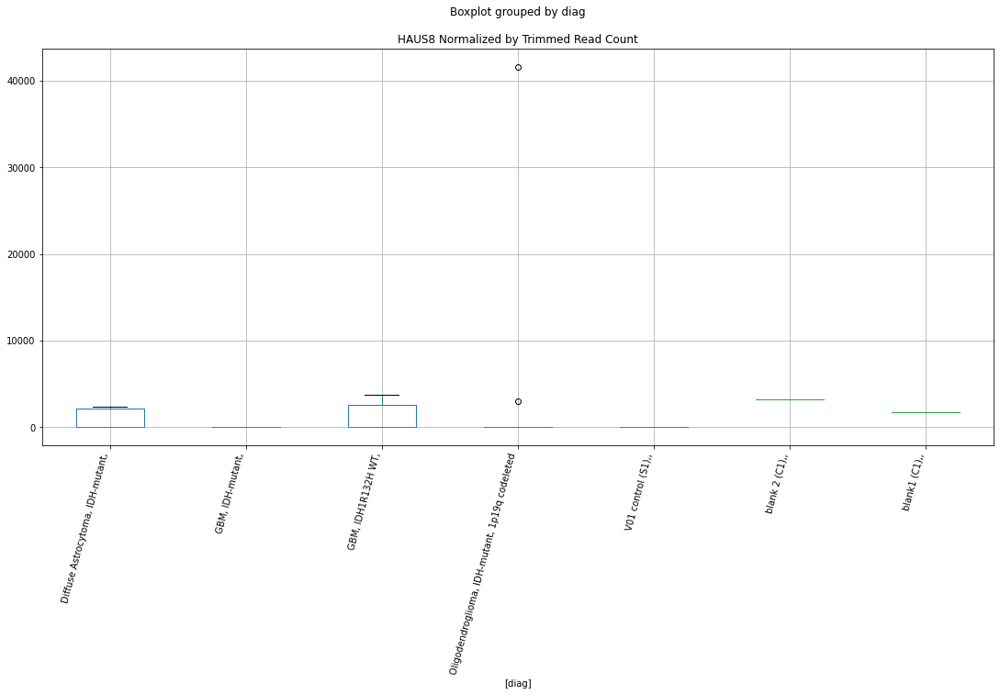

 p : 0.03147017441012392  ( t : 2.332691992347627 ) :  D-plex  :  cutadapt2  :  FBXL16
Control and blanks
76     146977.16
340      1761.46
Name: FBXL16, dtype: float64
208    20457.79
Name: FBXL16, dtype: float64
472    23696.19
Name: FBXL16, dtype: float64


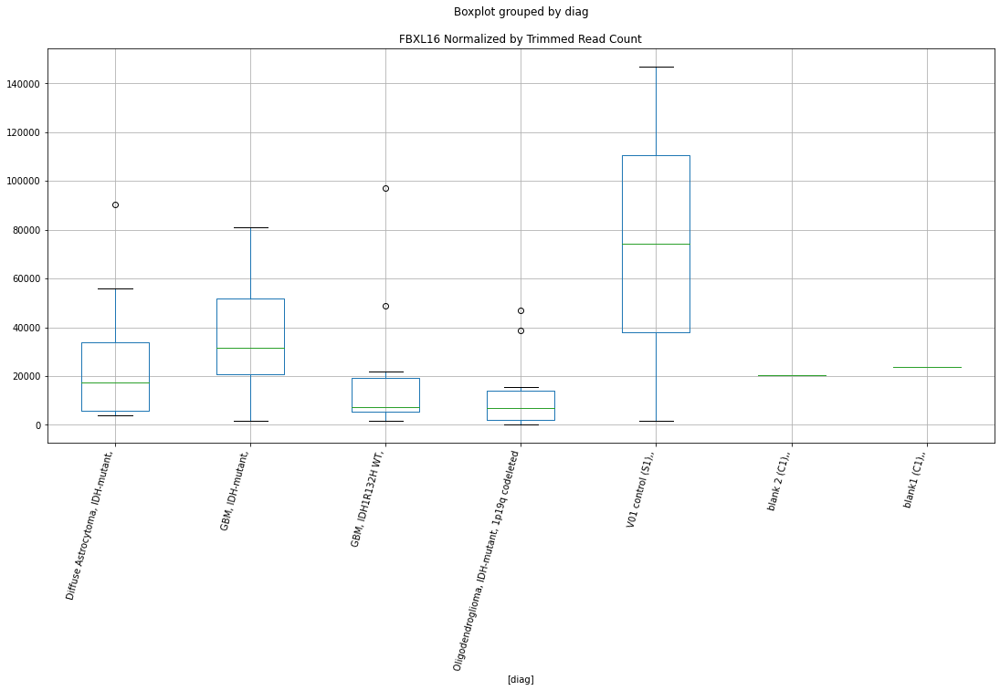

 p : 0.03149993195198664  ( t : 2.332227200010482 ) :  D-plex  :  bbduk2  :  KCNIP4-IT1
Control and blanks
73     0.0
337    0.0
Name: KCNIP4-IT1, dtype: float64
205    537.27
Name: KCNIP4-IT1, dtype: float64
469    591.53
Name: KCNIP4-IT1, dtype: float64


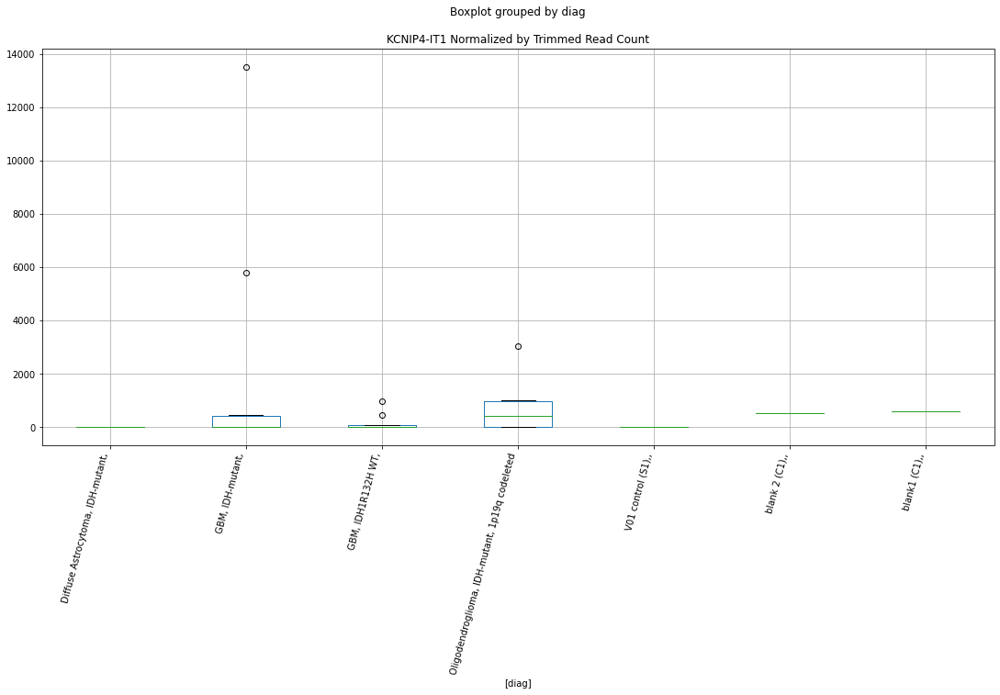

 p : 0.03159155394989283  ( t : 2.33079868646373 ) :  D-plex  :  bbduk2  :  GLYAT
Control and blanks
73     2319.03
337       0.00
Name: GLYAT, dtype: float64
205    3760.91
Name: GLYAT, dtype: float64
469    285116.17
Name: GLYAT, dtype: float64


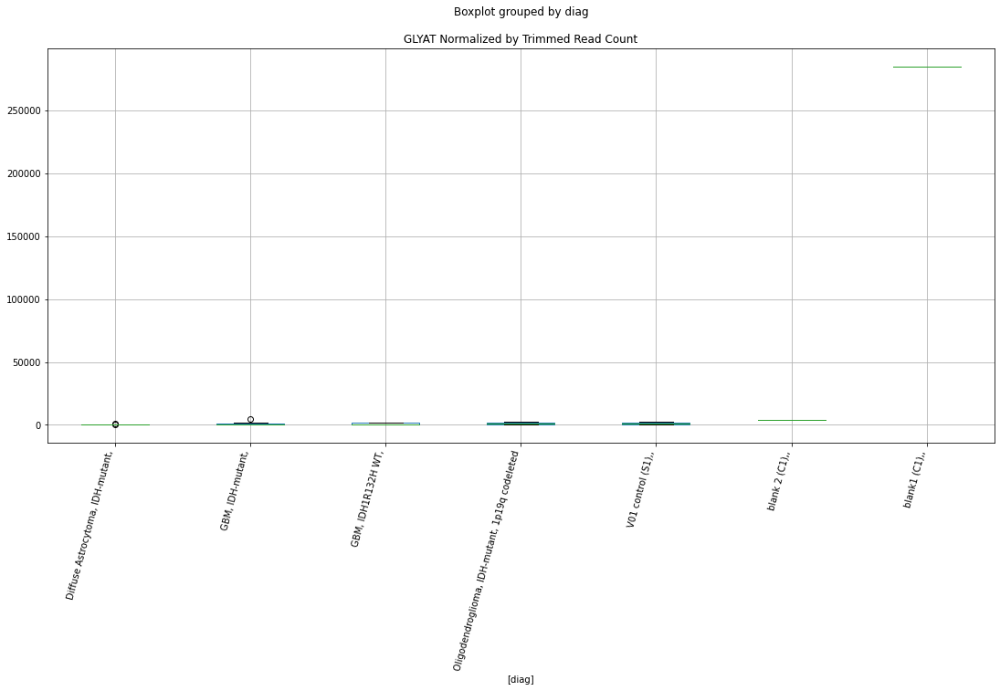

 p : 0.03170627430942409  ( t : 2.3290154578857227 ) :  Lexogen  :  bbduk2  :  KNDC1
Control and blanks
79     0.0
343    0.0
Name: KNDC1, dtype: float64
211    819.92
Name: KNDC1, dtype: float64
475    0.0
Name: KNDC1, dtype: float64


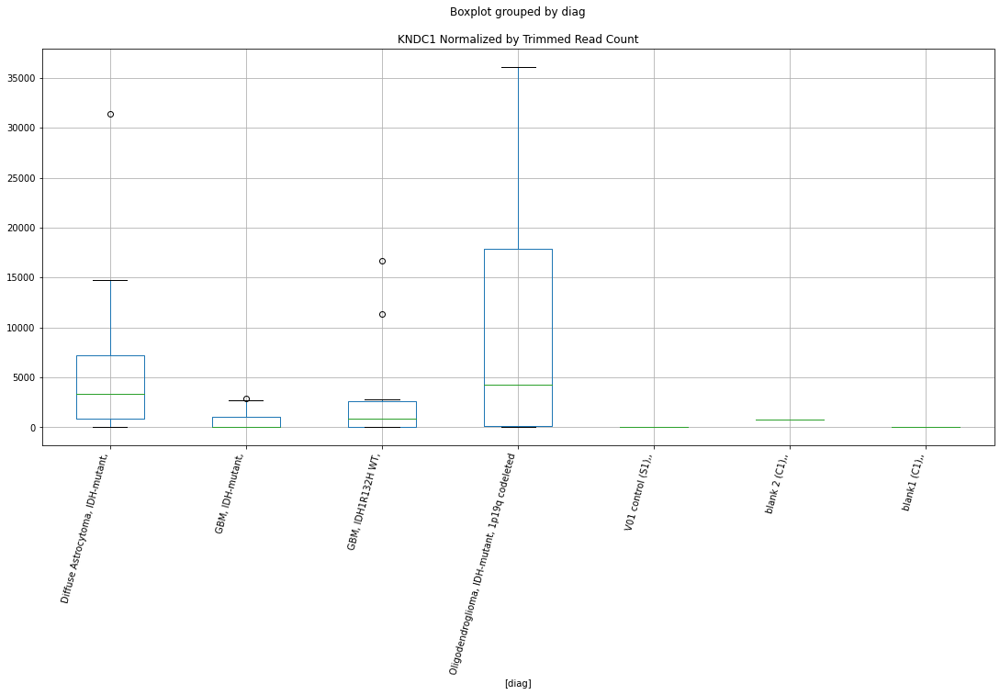

 p : 0.03183041613839549  ( t : 2.32709252419372 ) :  Lexogen  :  bbduk2  :  HMX1
Control and blanks
79       0.00
343    212.31
Name: HMX1, dtype: float64
211    0.0
Name: HMX1, dtype: float64
475    0.0
Name: HMX1, dtype: float64


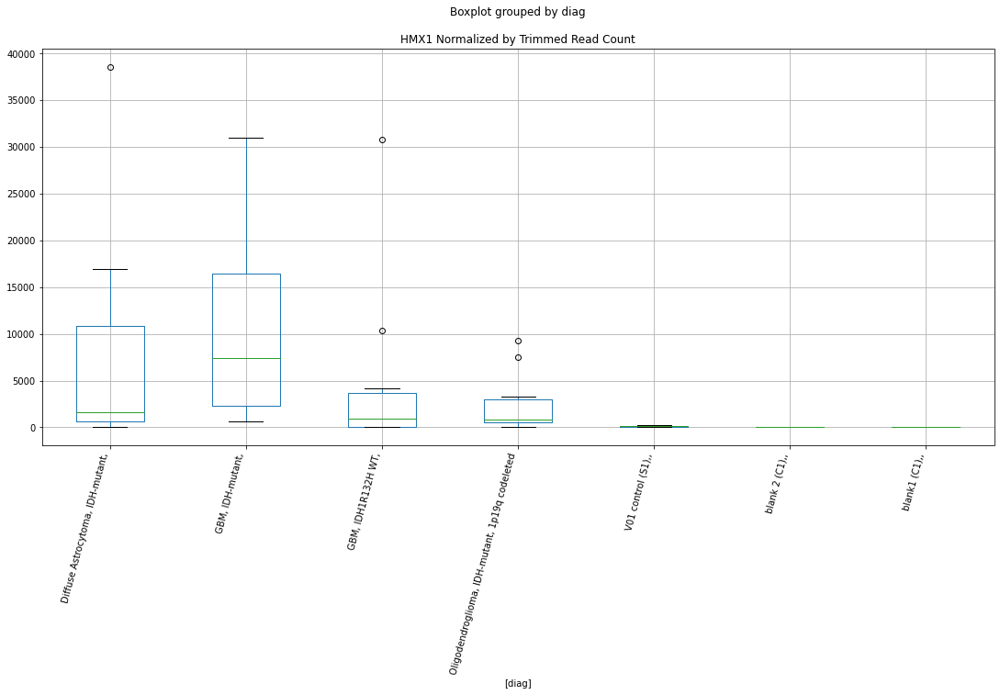

 p : 0.03184692595339186  ( t : 2.326837315548711 ) :  D-plex  :  bbduk2  :  HCFC1R1
Control and blanks
73     255092.77
337         0.00
Name: HCFC1R1, dtype: float64
205    2686.36
Name: HCFC1R1, dtype: float64
469    8872.91
Name: HCFC1R1, dtype: float64


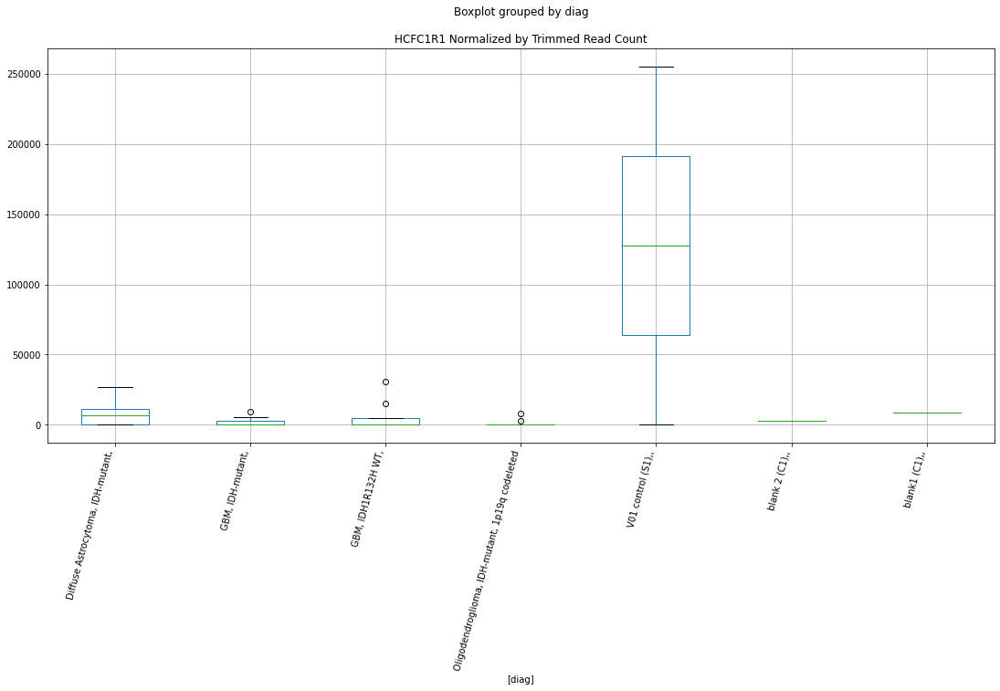

 p : 0.03184796854053796  ( t : 2.326821203368936 ) :  Lexogen  :  bbduk2  :  KLHL23
Control and blanks
79     0.0
343    0.0
Name: KLHL23, dtype: float64
211    0.0
Name: KLHL23, dtype: float64
475    0.0
Name: KLHL23, dtype: float64


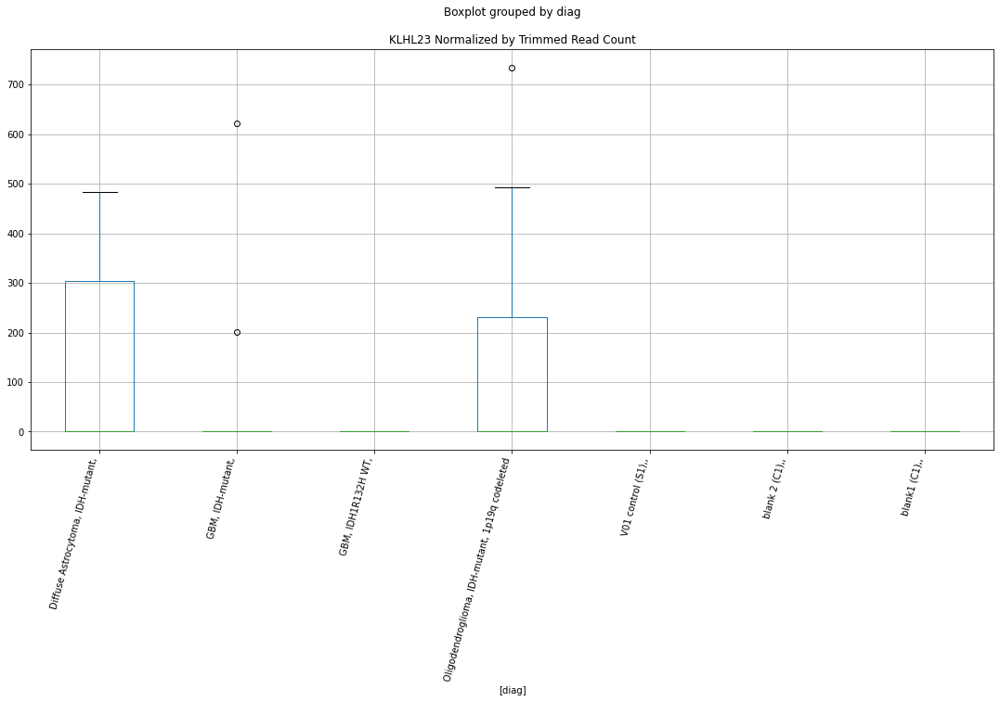

 p : 0.031889732441807705  ( t : 2.3261761852565708 ) :  D-plex  :  cutadapt2  :  GTF2A1L
Control and blanks
76     0.0
340    0.0
Name: GTF2A1L, dtype: float64
208    705.44
Name: GTF2A1L, dtype: float64
472    0.0
Name: GTF2A1L, dtype: float64


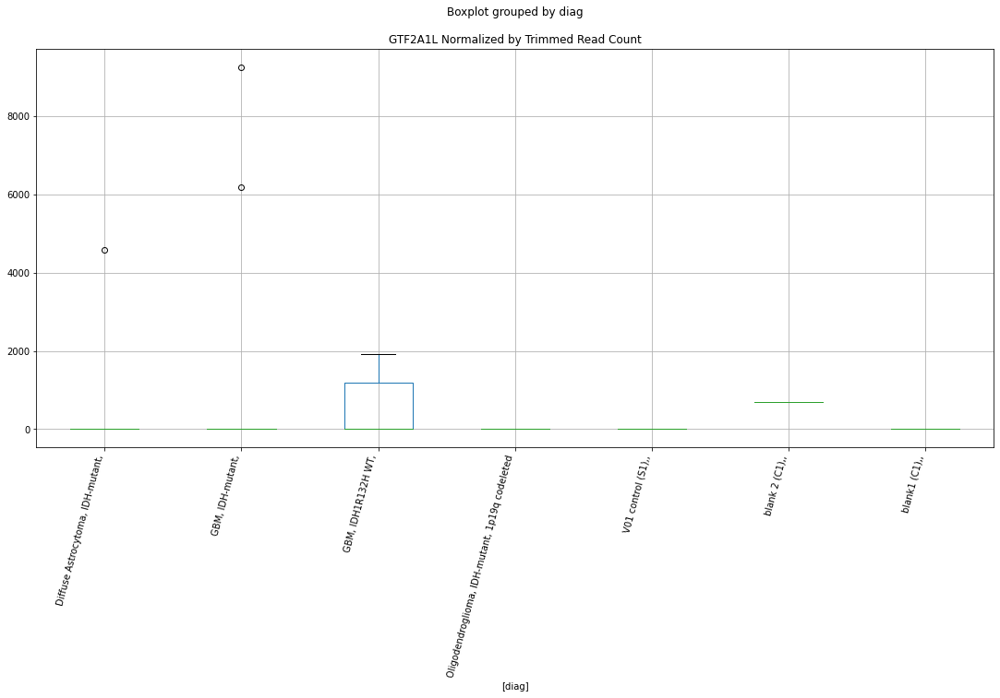

 p : 0.0318987633618173  ( t : 2.3260368114061527 ) :  D-plex  :  bbduk2  :  GOLGA6L9
Control and blanks
73     0.0
337    0.0
Name: GOLGA6L9, dtype: float64
205    2149.09
Name: GOLGA6L9, dtype: float64
469    9464.44
Name: GOLGA6L9, dtype: float64


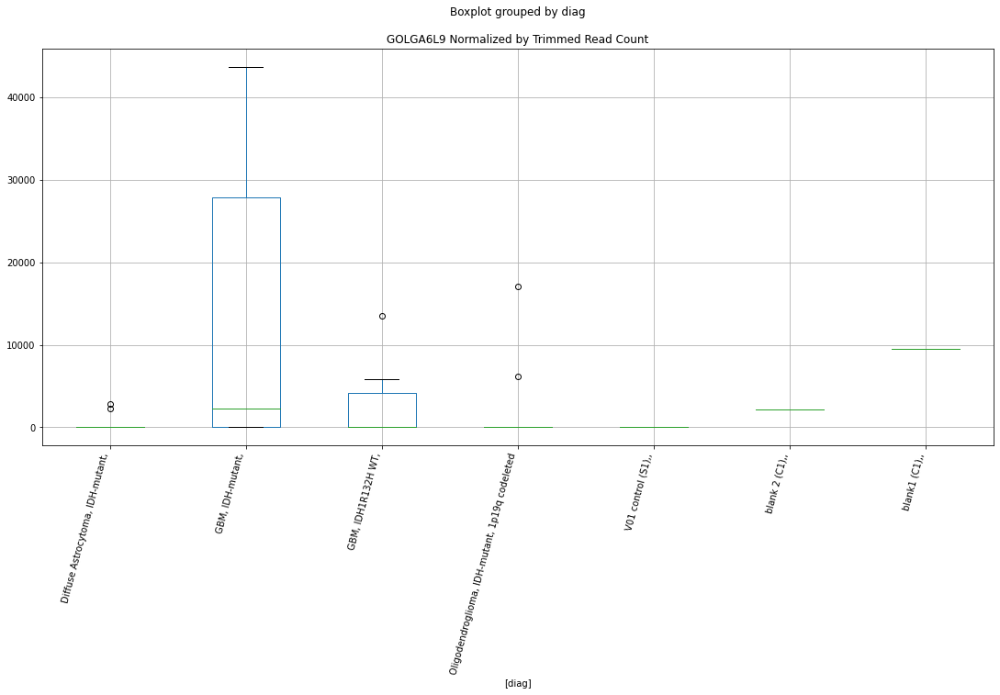

 p : 0.03193791164814481  ( t : 2.3254330610292038 ) :  D-plex  :  bbduk2  :  HCG11
Control and blanks
73     0.0
337    0.0
Name: HCG11, dtype: float64
205    179.09
Name: HCG11, dtype: float64
469    591.53
Name: HCG11, dtype: float64


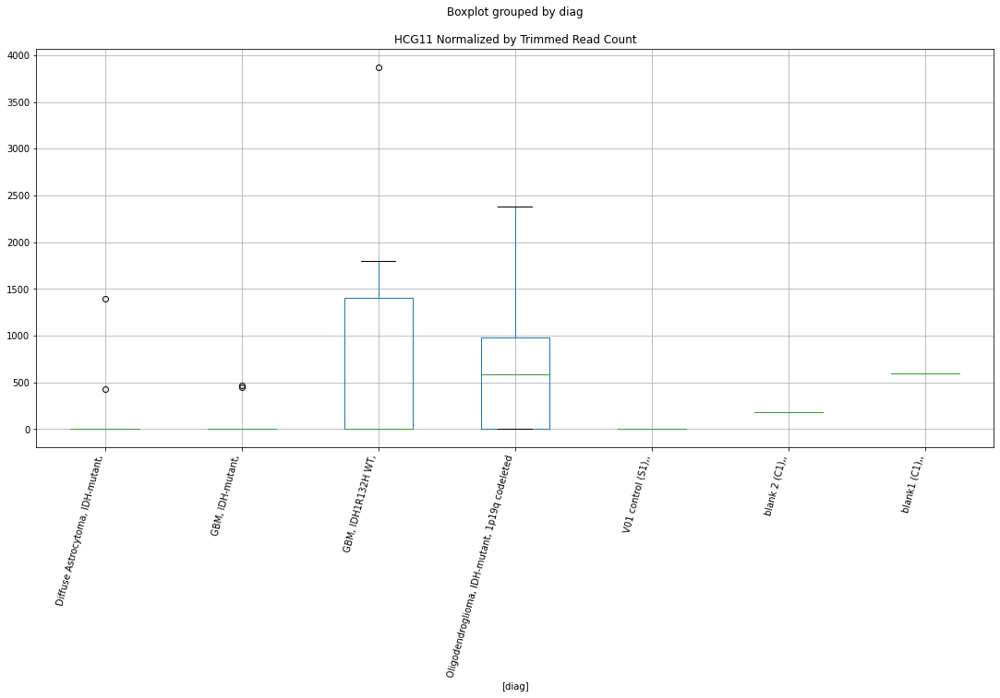

 p : 0.03194725949238271  ( t : 2.325288998967492 ) :  D-plex  :  cutadapt2  :  KRT6B
Control and blanks
76     0.0
340    0.0
Name: KRT6B, dtype: float64
208    176.36
Name: KRT6B, dtype: float64
472    577.96
Name: KRT6B, dtype: float64


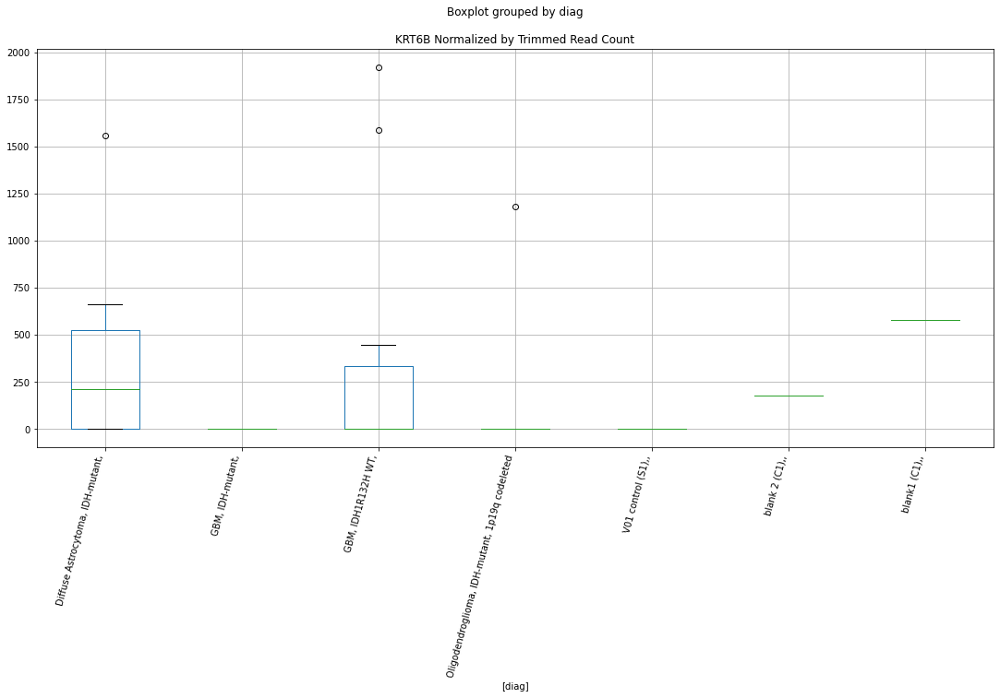

 p : 0.032129006882181  ( t : 2.322495797846879 ) :  D-plex  :  cutadapt2  :  FOXI2
Control and blanks
76     0.0
340    0.0
Name: FOXI2, dtype: float64
208    705.44
Name: FOXI2, dtype: float64
472    4045.69
Name: FOXI2, dtype: float64


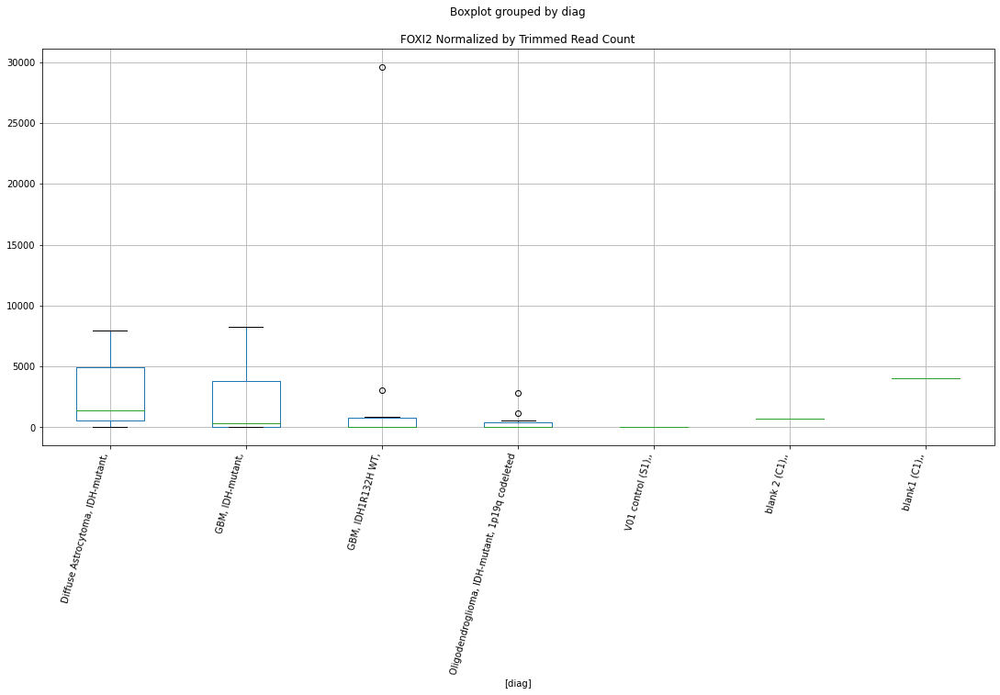

 p : 0.03215324069091942  ( t : 2.32212446808041 ) :  D-plex  :  cutadapt2  :  IGF1R
Control and blanks
76     24243.65
340     7045.86
Name: IGF1R, dtype: float64
208    202461.53
Name: IGF1R, dtype: float64
472    31787.57
Name: IGF1R, dtype: float64


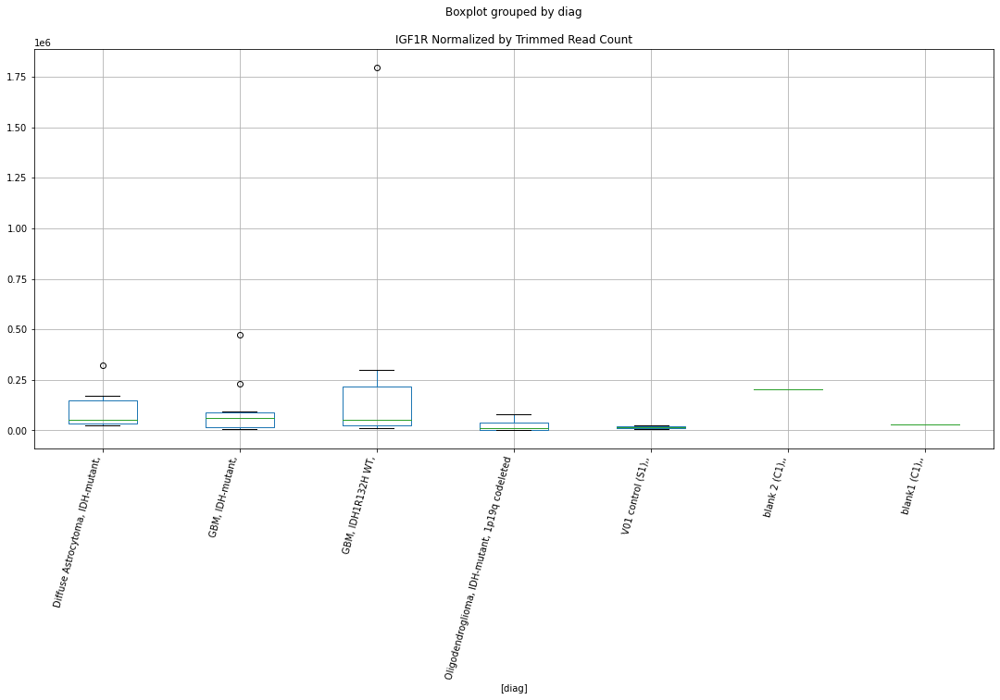

 p : 0.03216920277005251  ( t : 2.321880026347958 ) :  D-plex  :  cutadapt2  :  GEN1
Control and blanks
76        0.0
340    2642.2
Name: GEN1, dtype: float64
208    19752.34
Name: GEN1, dtype: float64
472    14448.9
Name: GEN1, dtype: float64


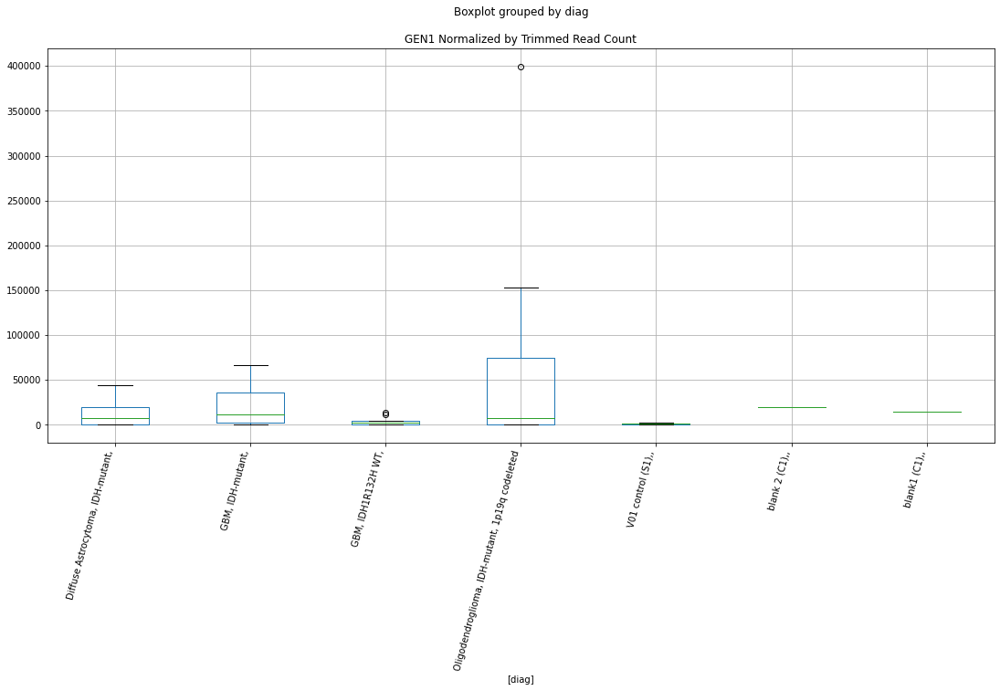

 p : 0.032203728630683166  ( t : 2.321351685834301 ) :  D-plex  :  bbduk2  :  FBXL17
Control and blanks
73        0.00
337    2670.47
Name: FBXL17, dtype: float64
205    13431.82
Name: FBXL17, dtype: float64
469    10647.49
Name: FBXL17, dtype: float64


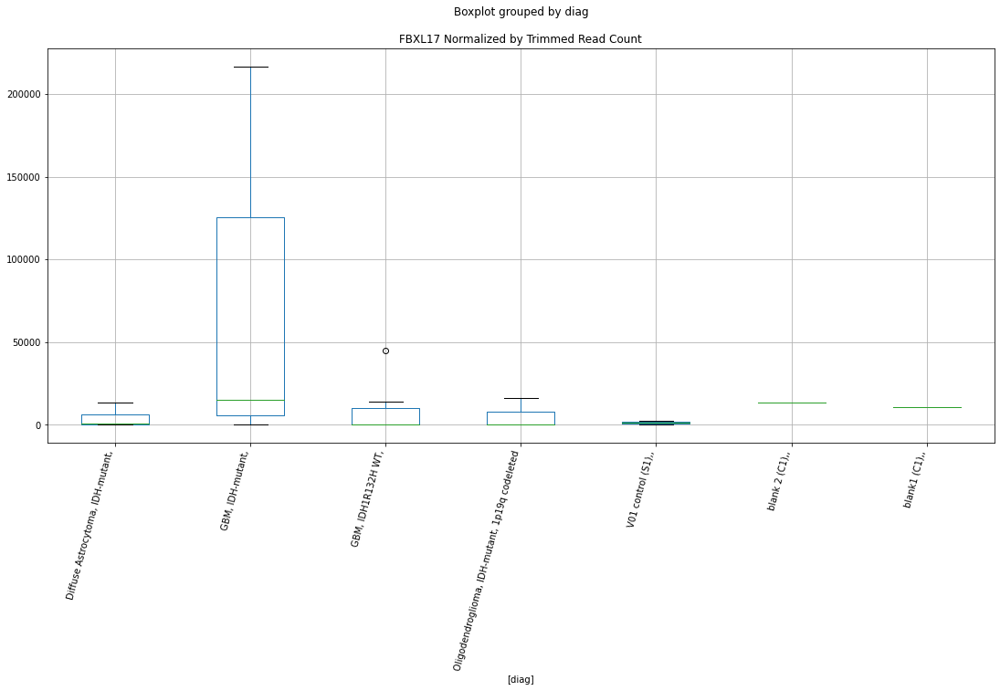

 p : 0.032302385977842  ( t : 2.319844851921447 ) :  D-plex  :  bbduk2  :  KCNG1
Control and blanks
73     0.0
337    0.0
Name: KCNG1, dtype: float64
205    6447.27
Name: KCNG1, dtype: float64
469    10647.49
Name: KCNG1, dtype: float64


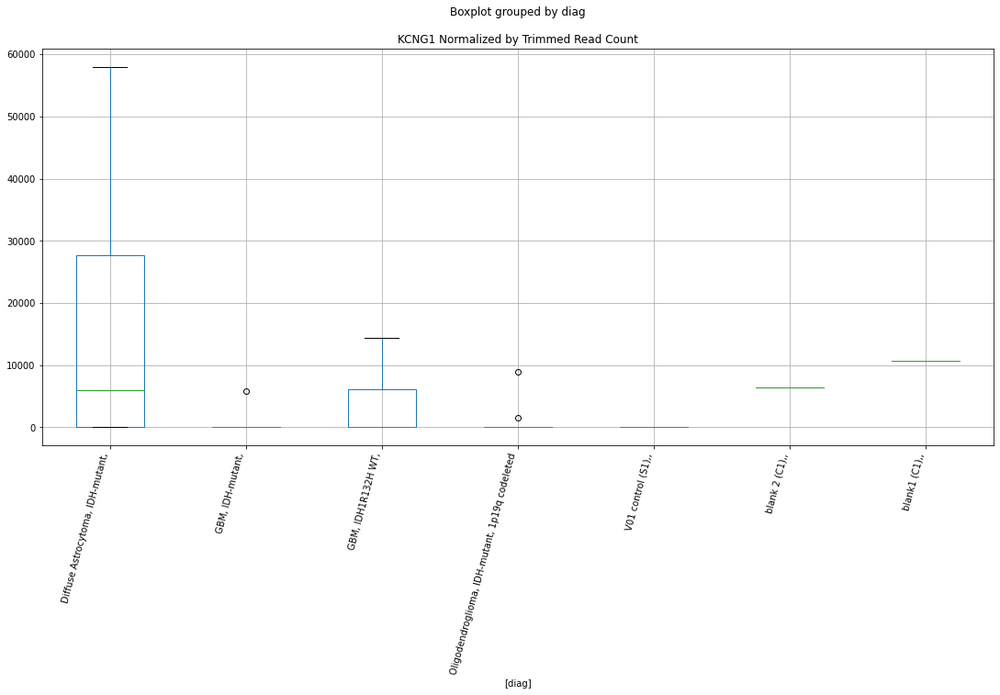

 p : 0.03237718027425374  ( t : 2.318705333919784 ) :  D-plex  :  cutadapt2  :  ERICH1
Control and blanks
76     10606.60
340      880.73
Name: ERICH1, dtype: float64
208    56611.63
Name: ERICH1, dtype: float64
472    52016.03
Name: ERICH1, dtype: float64


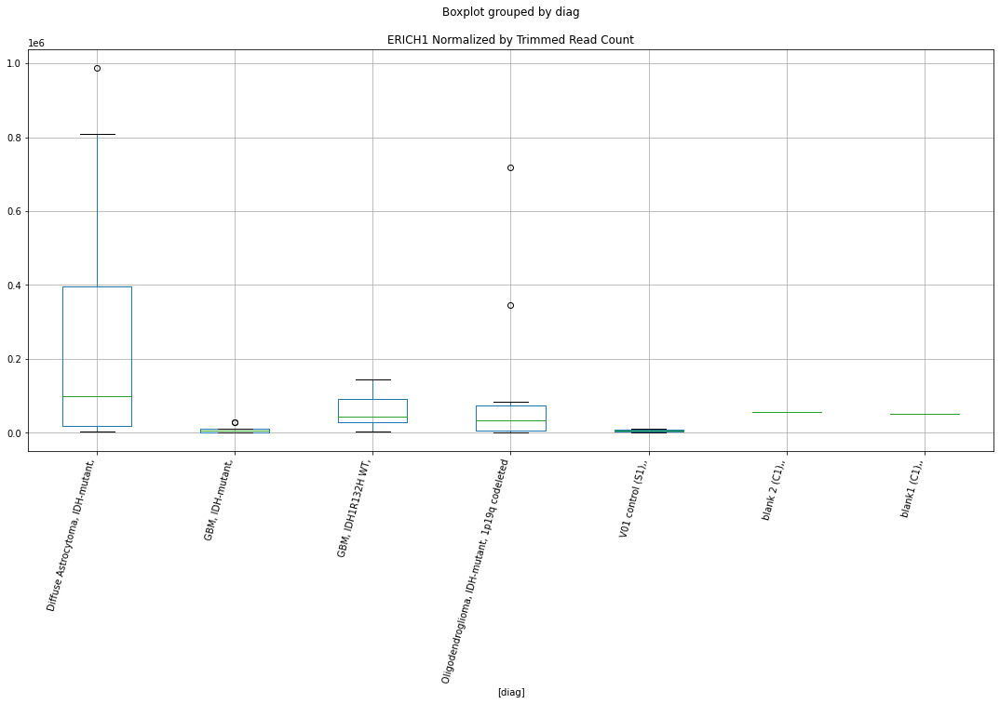

 p : 0.0324153421910767  ( t : 2.3181248649118156 ) :  D-plex  :  cutadapt2  :  JMJD7-PLA2G4B
Control and blanks
76     77276.65
340        0.00
Name: JMJD7-PLA2G4B, dtype: float64
208    705.44
Name: JMJD7-PLA2G4B, dtype: float64
472    3467.74
Name: JMJD7-PLA2G4B, dtype: float64


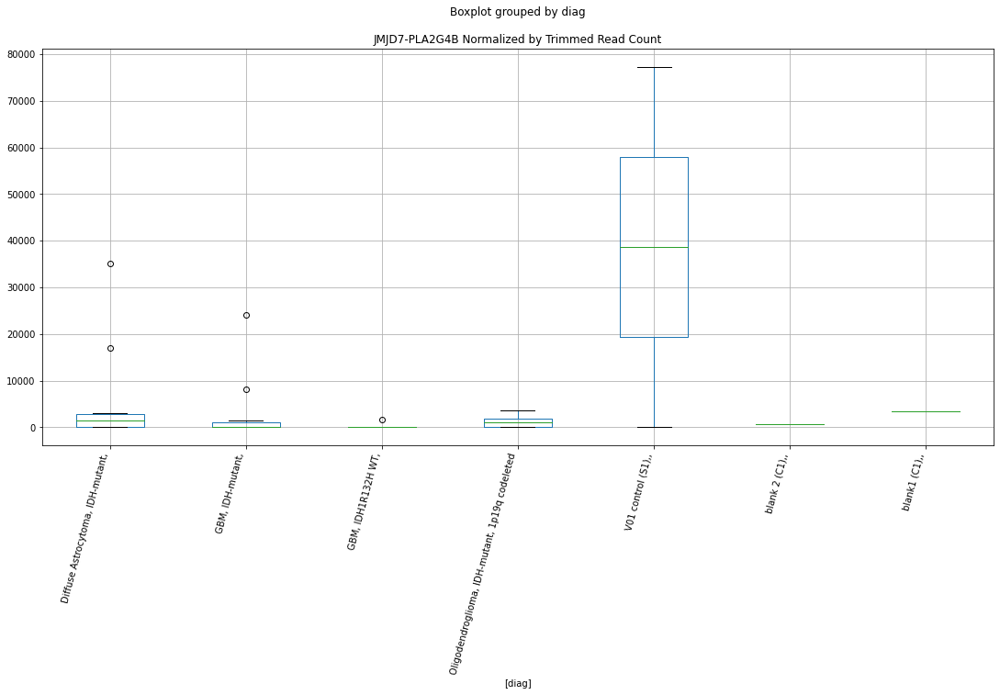

 p : 0.03243023737820181  ( t : 2.3178984710357686 ) :  D-plex  :  cutadapt2  :  GDPD5
Control and blanks
76     0.0
340    0.0
Name: GDPD5, dtype: float64
208    12345.22
Name: GDPD5, dtype: float64
472    14448.9
Name: GDPD5, dtype: float64


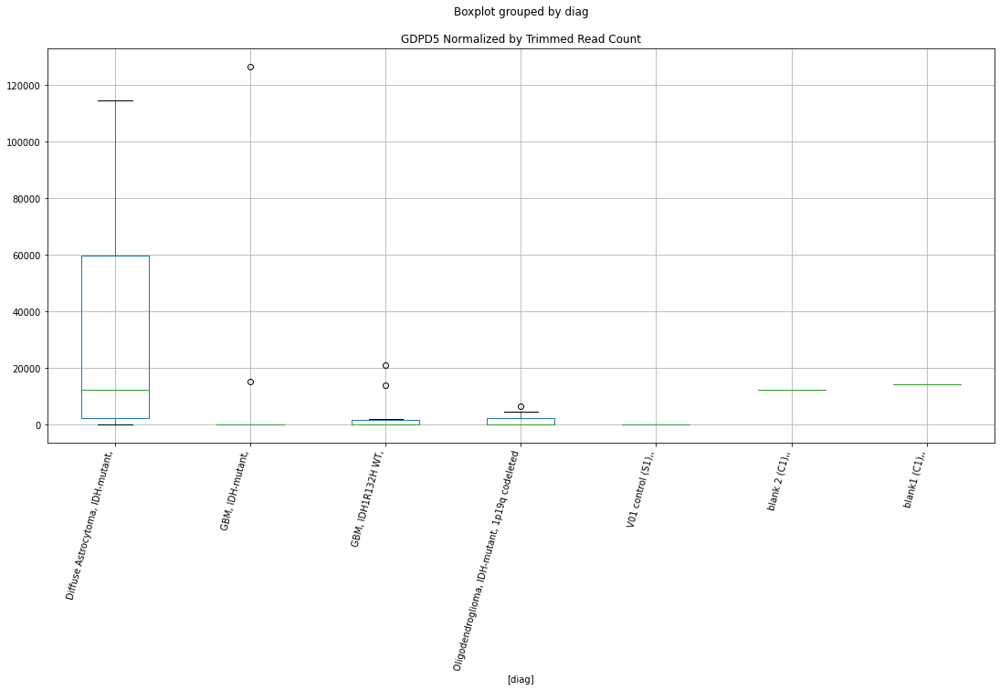

 p : 0.03257775031761009  ( t : 2.3156616007718345 ) :  D-plex  :  cutadapt2  :  EIF3B
Control and blanks
76     13637.06
340        0.00
Name: EIF3B, dtype: float64
208    6172.61
Name: EIF3B, dtype: float64
472    5201.6
Name: EIF3B, dtype: float64


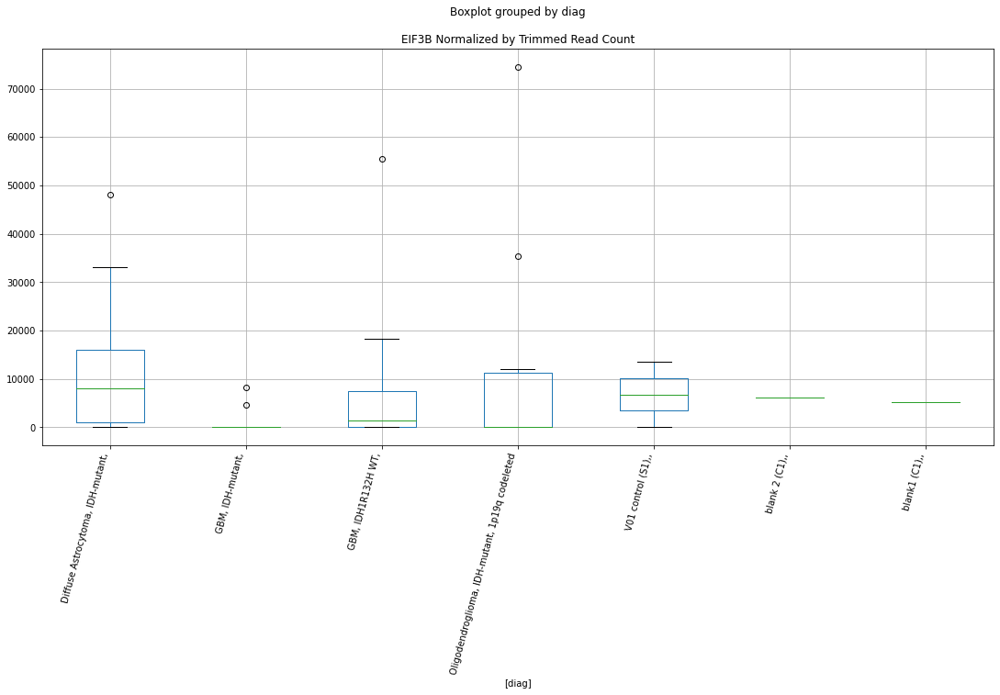

 p : 0.03261877902392541  ( t : 2.3150411174044874 ) :  D-plex  :  bbduk2  :  FAM72D
Control and blanks
73     0.0
337    0.0
Name: FAM72D, dtype: float64
205    3402.73
Name: FAM72D, dtype: float64
469    5323.75
Name: FAM72D, dtype: float64


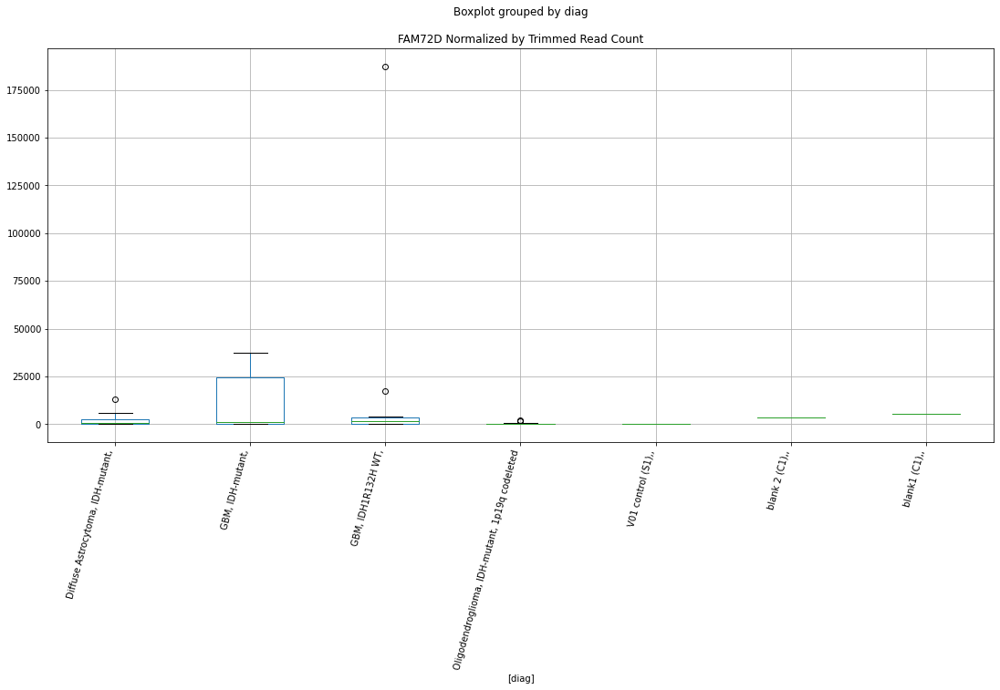

 p : 0.03270075761359013  ( t : 2.3138035097837815 ) :  D-plex  :  bbduk2  :  HYAL2
Control and blanks
73     0.0
337    0.0
Name: HYAL2, dtype: float64
205    0.0
Name: HYAL2, dtype: float64
469    5915.27
Name: HYAL2, dtype: float64


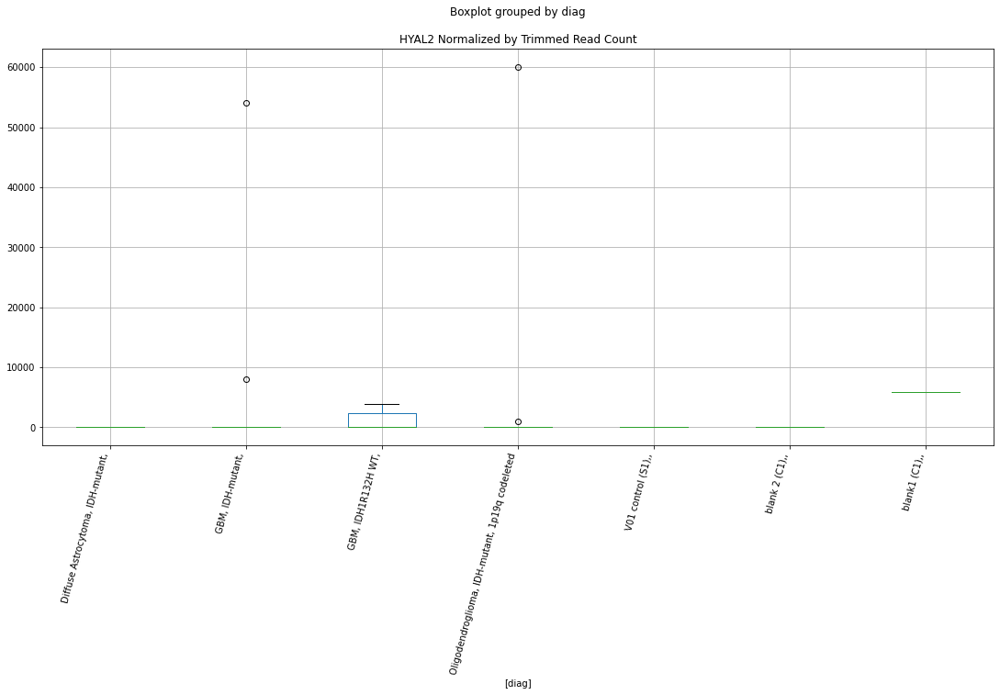

 p : 0.032722043790162185  ( t : 2.313482629394555 ) :  D-plex  :  cutadapt2  :  EPX
Control and blanks
76     58336.29
340        0.00
Name: EPX, dtype: float64
208    881.8
Name: EPX, dtype: float64
472    1155.91
Name: EPX, dtype: float64


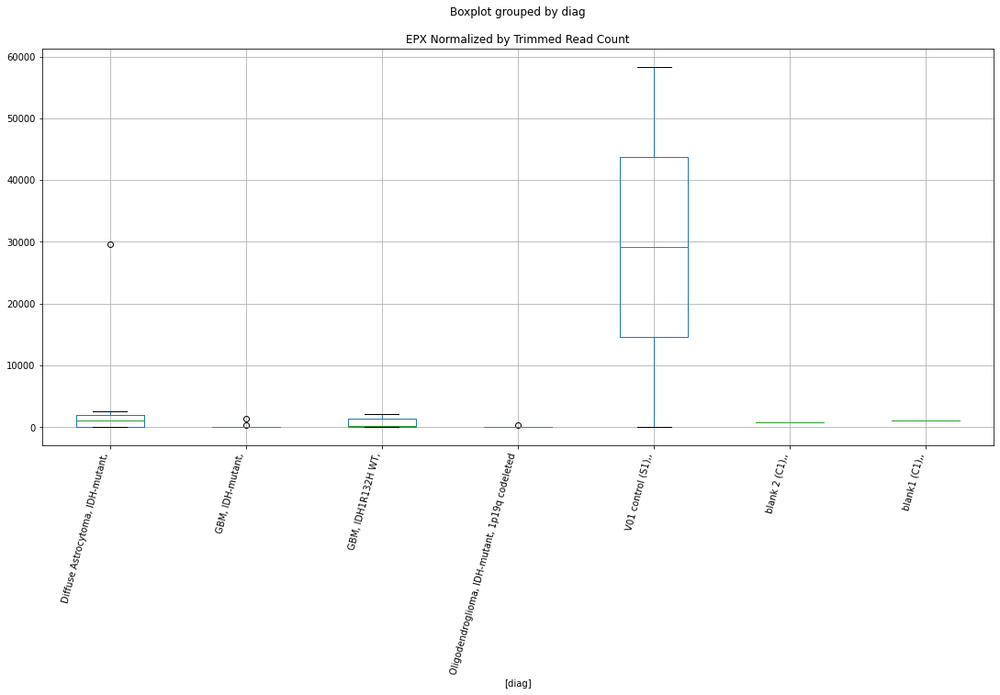

 p : 0.03276523288305178  ( t : 2.312832166448916 ) :  D-plex  :  bbduk2  :  GIPC1
Control and blanks
73     313841.41
337         0.00
Name: GIPC1, dtype: float64
205    30266.37
Name: GIPC1, dtype: float64
469    14788.18
Name: GIPC1, dtype: float64


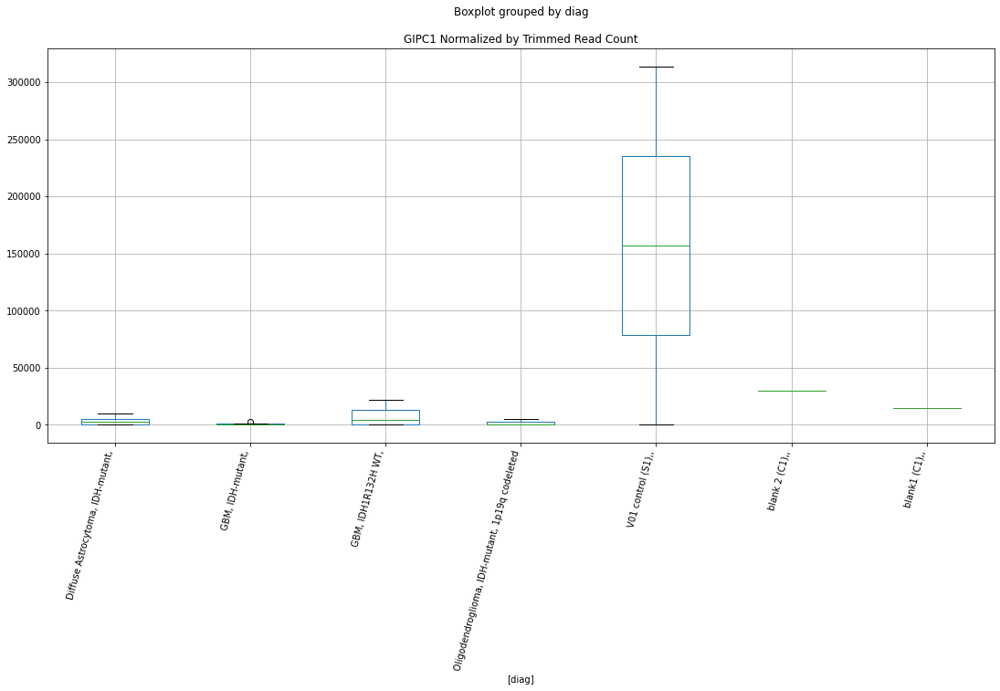

 p : 0.03281382602731524  ( t : 2.31210126479455 ) :  D-plex  :  cutadapt2  :  GPT2
Control and blanks
76       0.00
340    880.73
Name: GPT2, dtype: float64
208    1763.6
Name: GPT2, dtype: float64
472    2889.78
Name: GPT2, dtype: float64


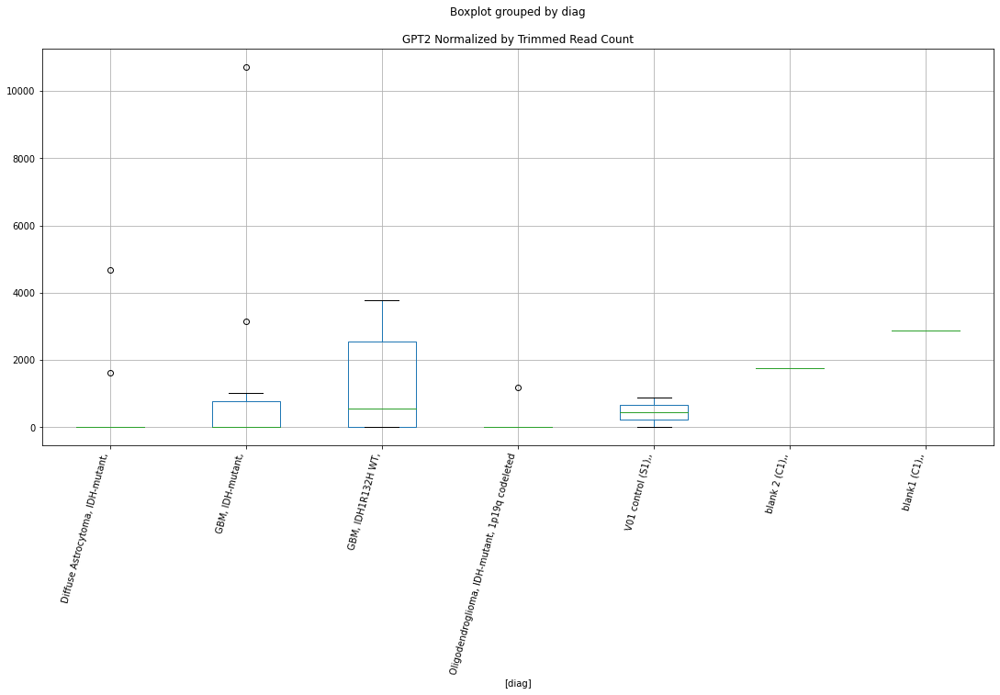

 p : 0.0328437917652951  ( t : 2.311651043205267 ) :  Lexogen  :  cutadapt2  :  INSYN2A
Control and blanks
82        0.00
346    1262.61
Name: INSYN2A, dtype: float64
214    0.0
Name: INSYN2A, dtype: float64
478    0.0
Name: INSYN2A, dtype: float64


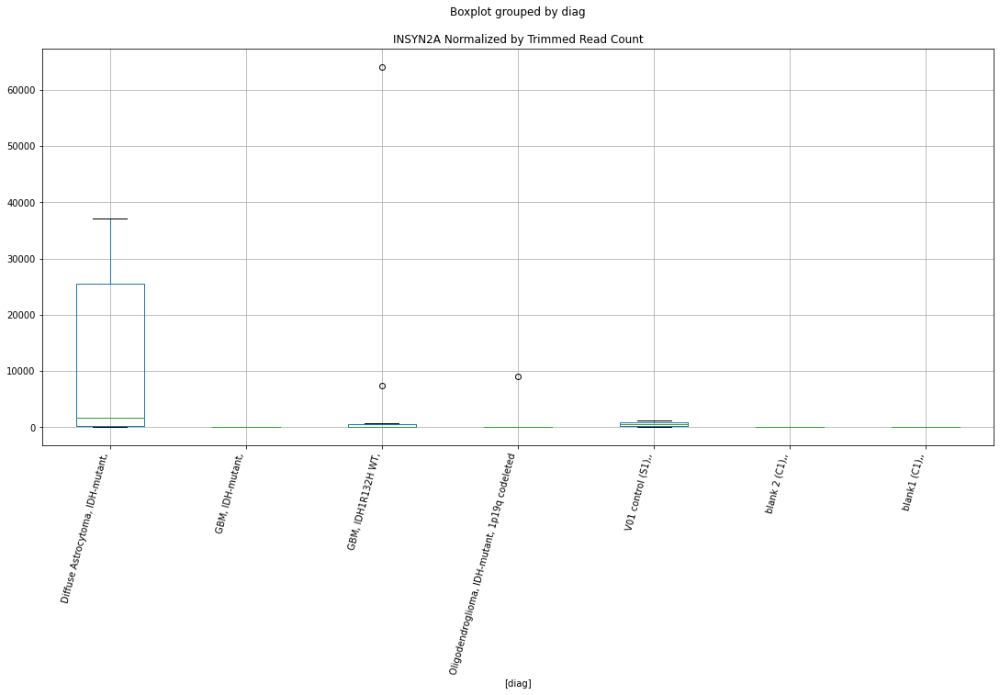

 p : 0.03284509107601154  ( t : 2.311631530276939 ) :  D-plex  :  bbduk2  :  GSPT1
Control and blanks
73     2319.03
337       0.00
Name: GSPT1, dtype: float64
205    2149.09
Name: GSPT1, dtype: float64
469    0.0
Name: GSPT1, dtype: float64


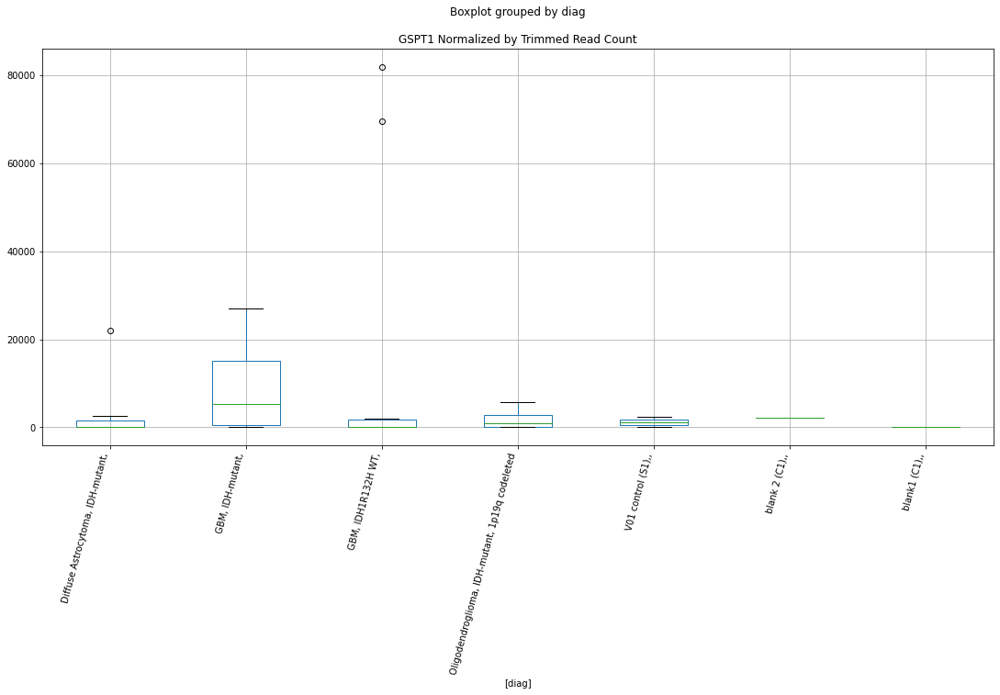

 p : 0.032857831062423216  ( t : 2.3114402402772334 ) :  D-plex  :  bbduk2  :  ERICH1
Control and blanks
73     7730.08
337     890.16
Name: ERICH1, dtype: float64
205    59816.38
Name: ERICH1, dtype: float64
469    53237.46
Name: ERICH1, dtype: float64


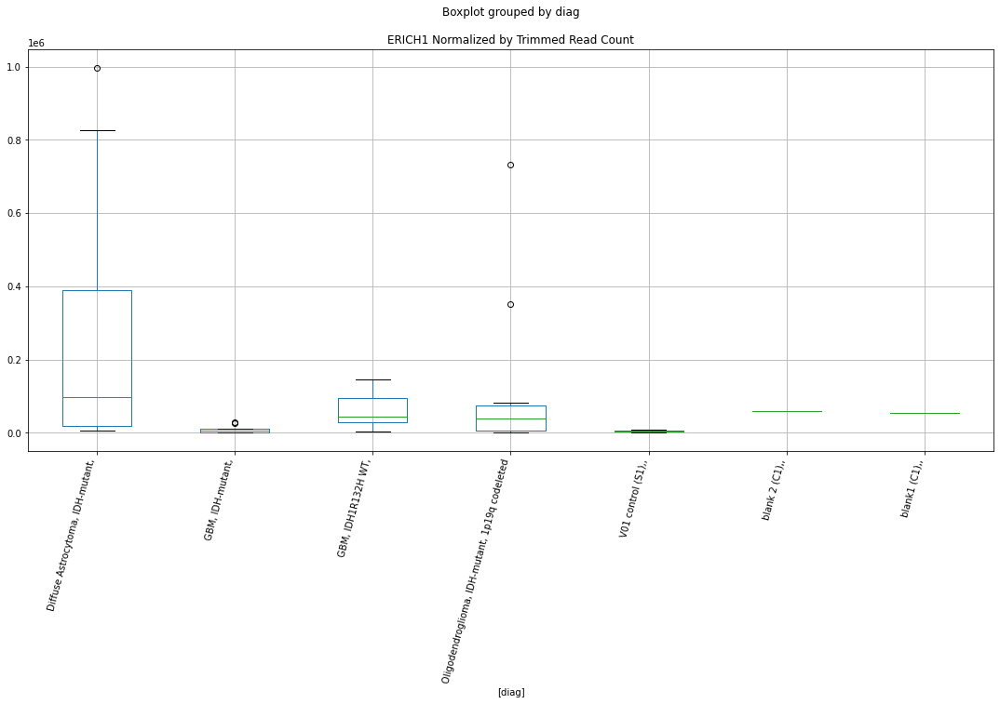

 p : 0.032890557546321315  ( t : 2.310949169751104 ) :  D-plex  :  cutadapt2  :  IPO8
Control and blanks
76     0.0
340    0.0
Name: IPO8, dtype: float64
208    352.72
Name: IPO8, dtype: float64
472    3467.74
Name: IPO8, dtype: float64


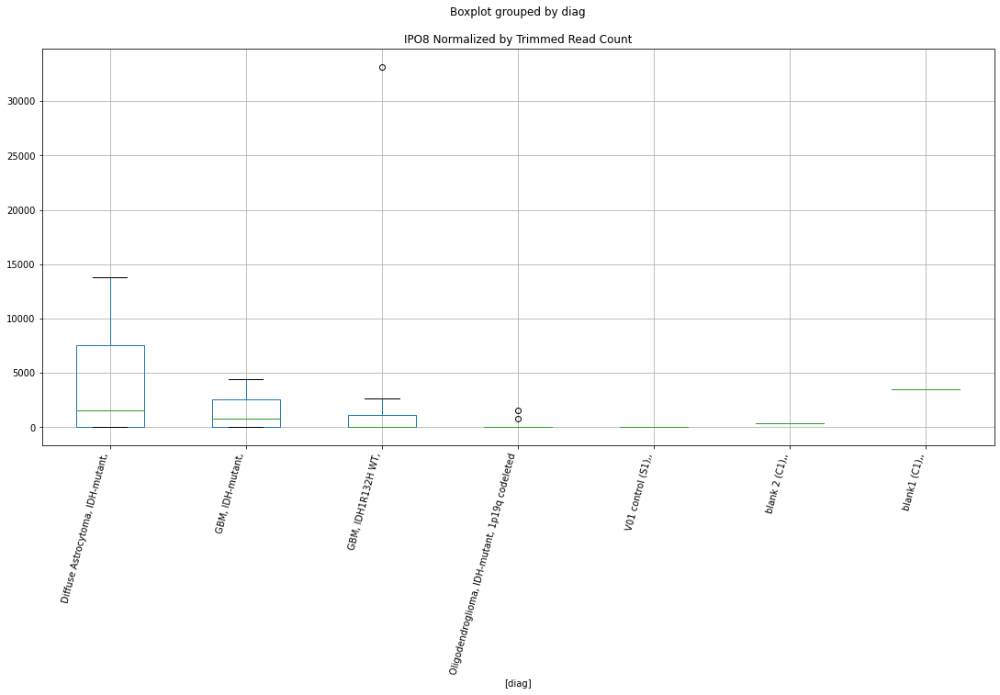

 p : 0.03298416953923306  ( t : 2.3095469936130395 ) :  Lexogen  :  cutadapt2  :  DMRTA2
Control and blanks
82     0.0
346    0.0
Name: DMRTA2, dtype: float64
214    542.45
Name: DMRTA2, dtype: float64
478    0.0
Name: DMRTA2, dtype: float64


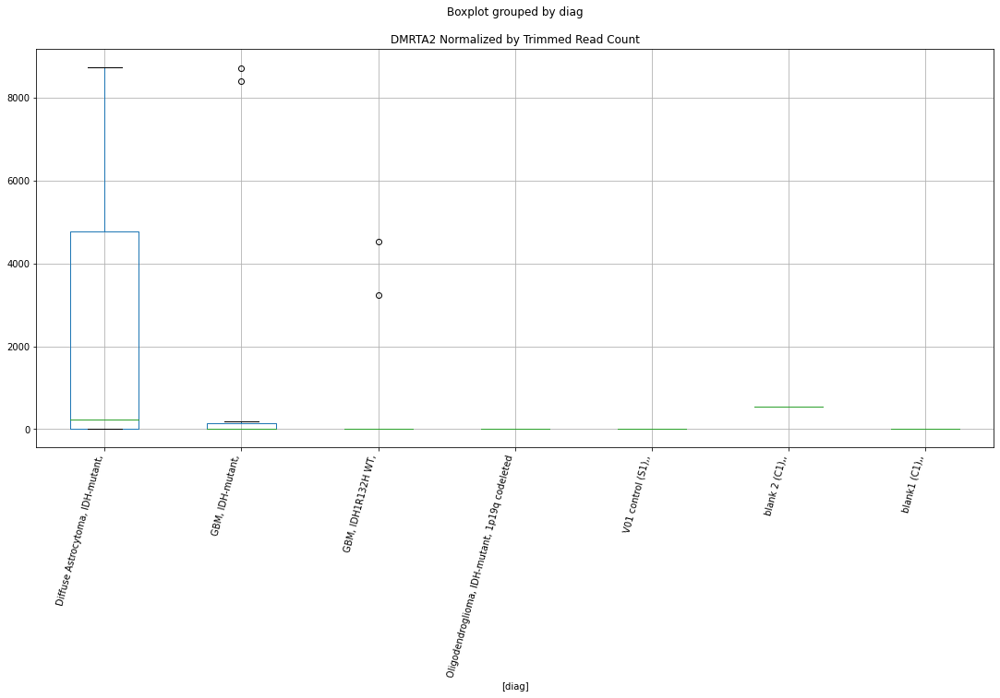

 p : 0.033025012194236286  ( t : 2.308936384680928 ) :  D-plex  :  cutadapt2  :  FRMPD4
Control and blanks
76     12879.44
340        0.00
Name: FRMPD4, dtype: float64
208    22045.03
Name: FRMPD4, dtype: float64
472    21384.37
Name: FRMPD4, dtype: float64


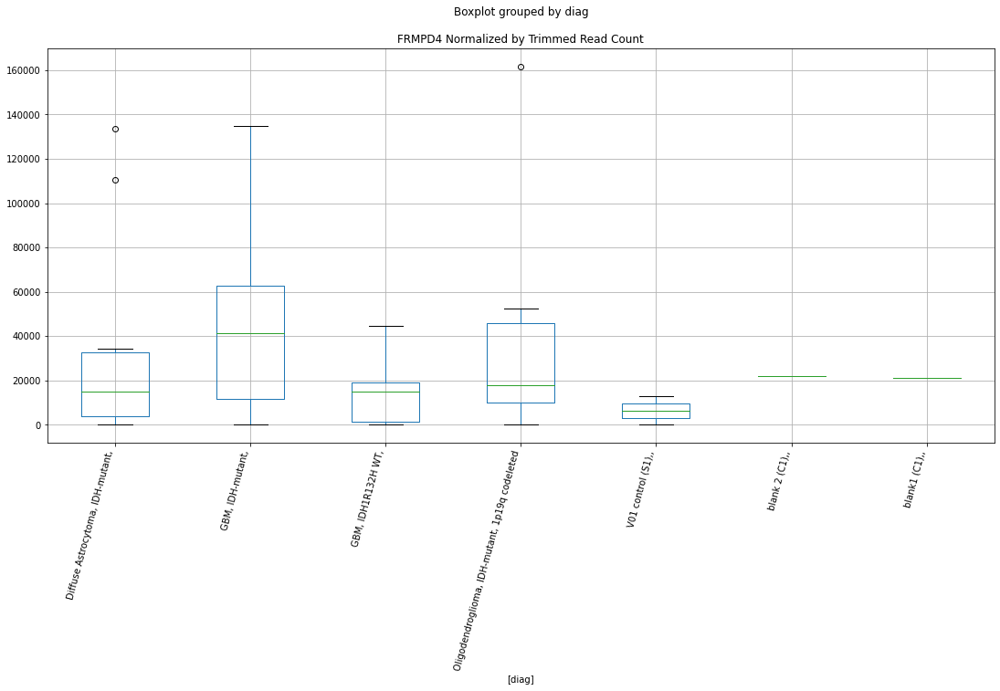

 p : 0.03304133618764037  ( t : 2.3086925324527696 ) :  D-plex  :  bbduk2  :  FBXL16
Control and blanks
73     145325.58
337      1780.31
Name: FBXL16, dtype: float64
205    21132.73
Name: FBXL16, dtype: float64
469    24252.62
Name: FBXL16, dtype: float64


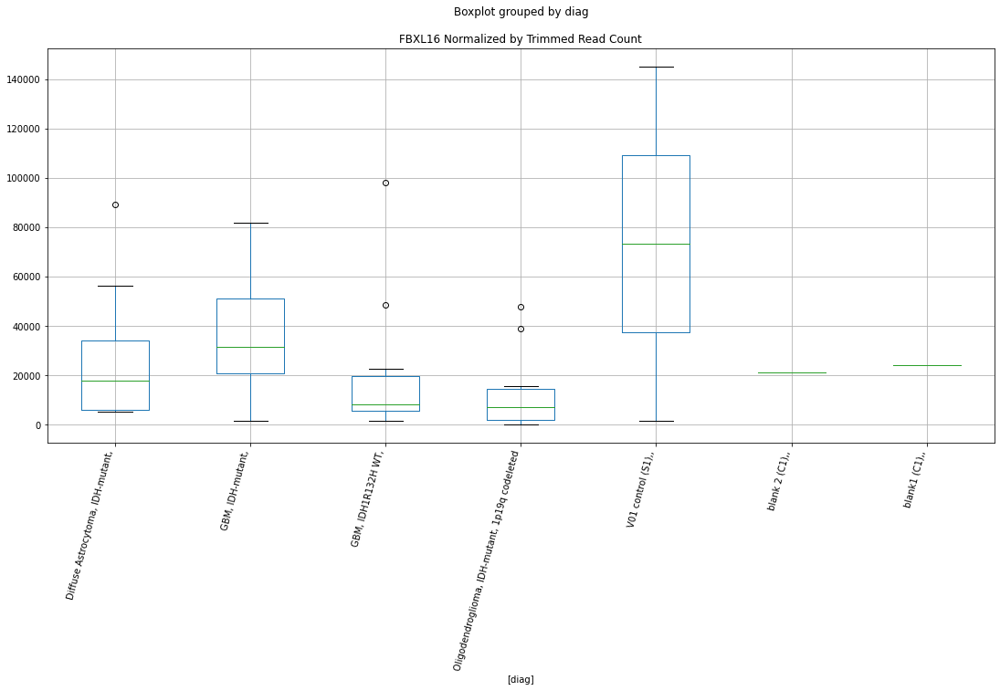

 p : 0.03314065755617424  ( t : 2.3072112475197093 ) :  D-plex  :  cutadapt2  :  GOLGA6L10
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L10, dtype: float64
208    1234.52
Name: GOLGA6L10, dtype: float64
472    1155.91
Name: GOLGA6L10, dtype: float64


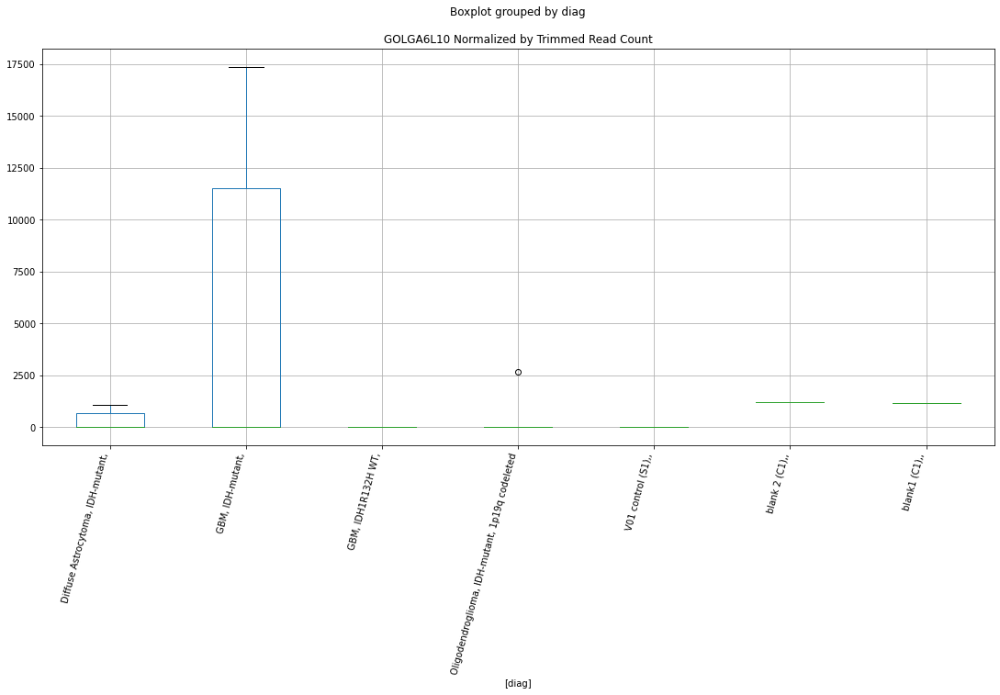

 p : 0.033244171192107444  ( t : 2.305671815200749 ) :  D-plex  :  cutadapt2  :  HCG11
Control and blanks
76     0.0
340    0.0
Name: HCG11, dtype: float64
208    176.36
Name: HCG11, dtype: float64
472    577.96
Name: HCG11, dtype: float64


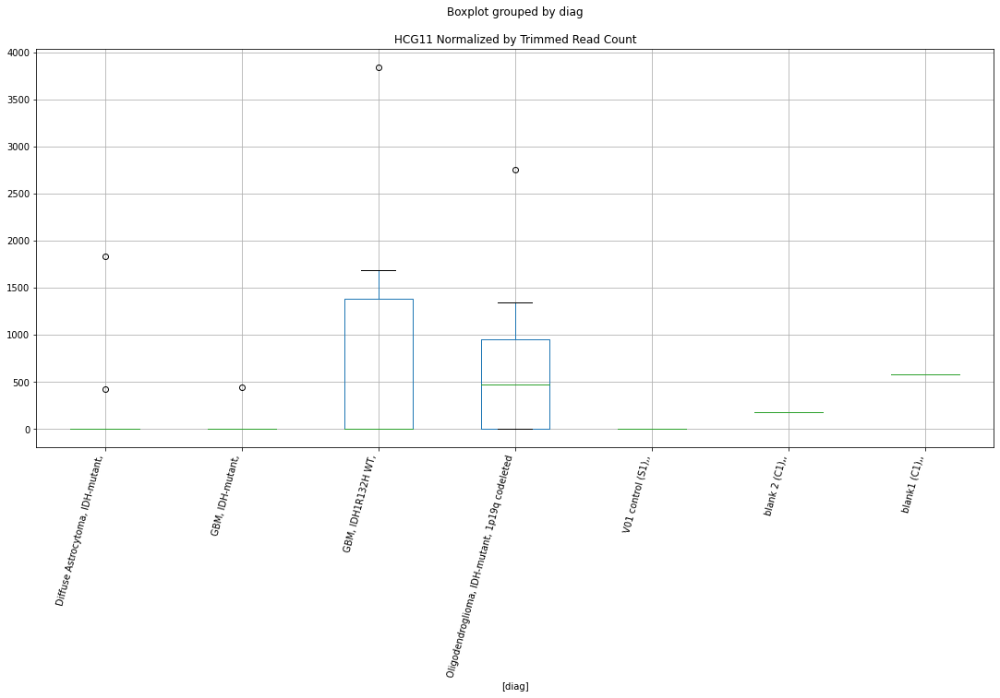

 p : 0.03325716816035785  ( t : 2.3054788413936183 ) :  D-plex  :  bbduk2  :  FGFR4
Control and blanks
73     0.0
337    0.0
Name: FGFR4, dtype: float64
205    0.0
Name: FGFR4, dtype: float64
469    2366.11
Name: FGFR4, dtype: float64


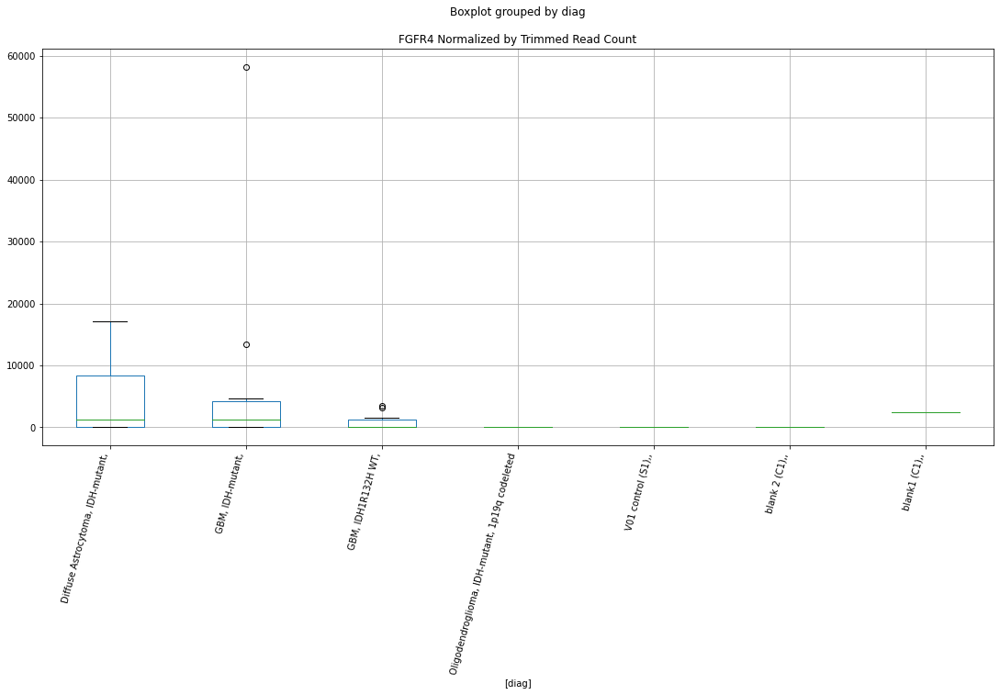

 p : 0.03333528371504189  ( t : 2.304320484246403 ) :  D-plex  :  bbduk2  :  LDB2
Control and blanks
73     0.0
337    0.0
Name: LDB2, dtype: float64
205    8238.18
Name: LDB2, dtype: float64
469    9464.44
Name: LDB2, dtype: float64


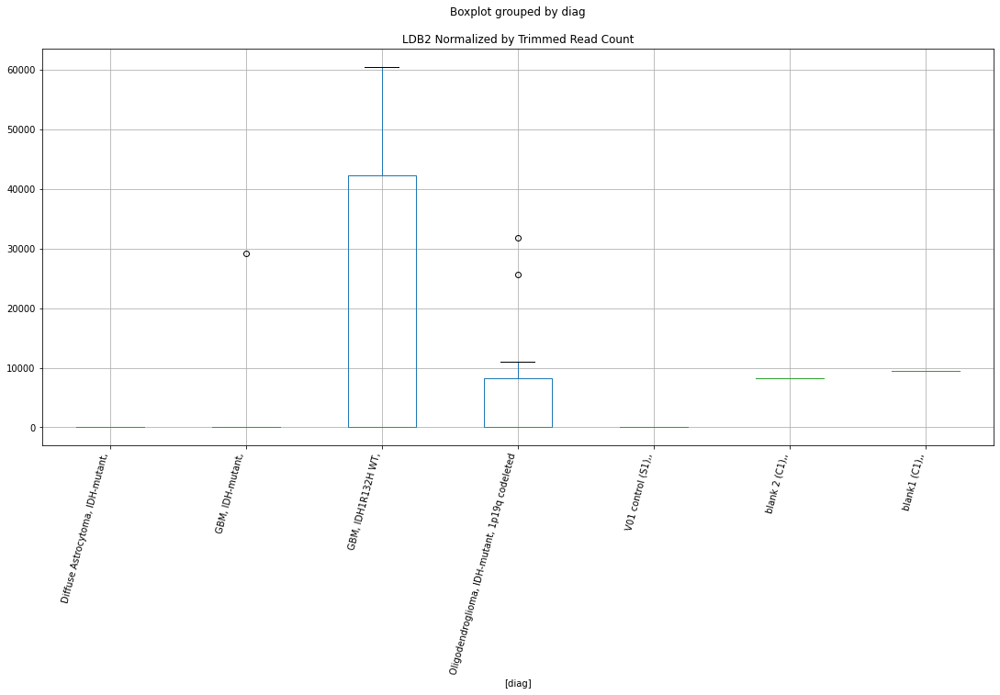

 p : 0.0334233375769609  ( t : 2.3030177687267286 ) :  Lexogen  :  bbduk2  :  FAT4
Control and blanks
79       0.00
343    849.26
Name: FAT4, dtype: float64
211    0.0
Name: FAT4, dtype: float64
475    0.0
Name: FAT4, dtype: float64


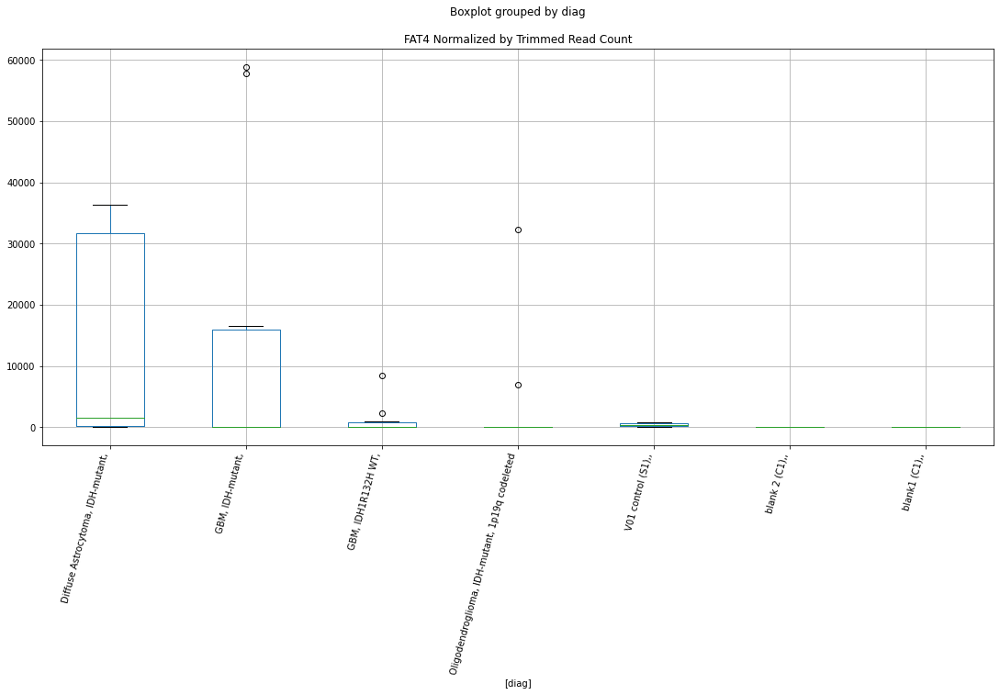

 p : 0.033430070767037565  ( t : 2.302918285380915 ) :  D-plex  :  cutadapt2  :  FGFR4
Control and blanks
76     0.0
340    0.0
Name: FGFR4, dtype: float64
208    0.0
Name: FGFR4, dtype: float64
472    2311.82
Name: FGFR4, dtype: float64


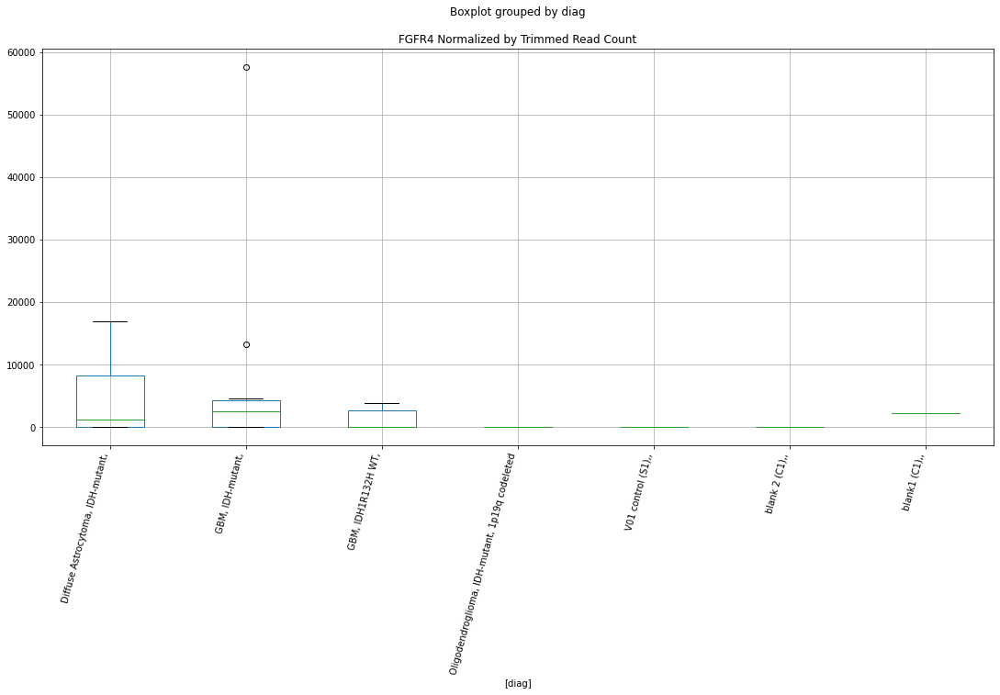

 p : 0.03349045904724141  ( t : 2.302026874084818 ) :  D-plex  :  cutadapt2  :  FGFR4
Control and blanks
76     0.0
340    0.0
Name: FGFR4, dtype: float64
208    0.0
Name: FGFR4, dtype: float64
472    2311.82
Name: FGFR4, dtype: float64


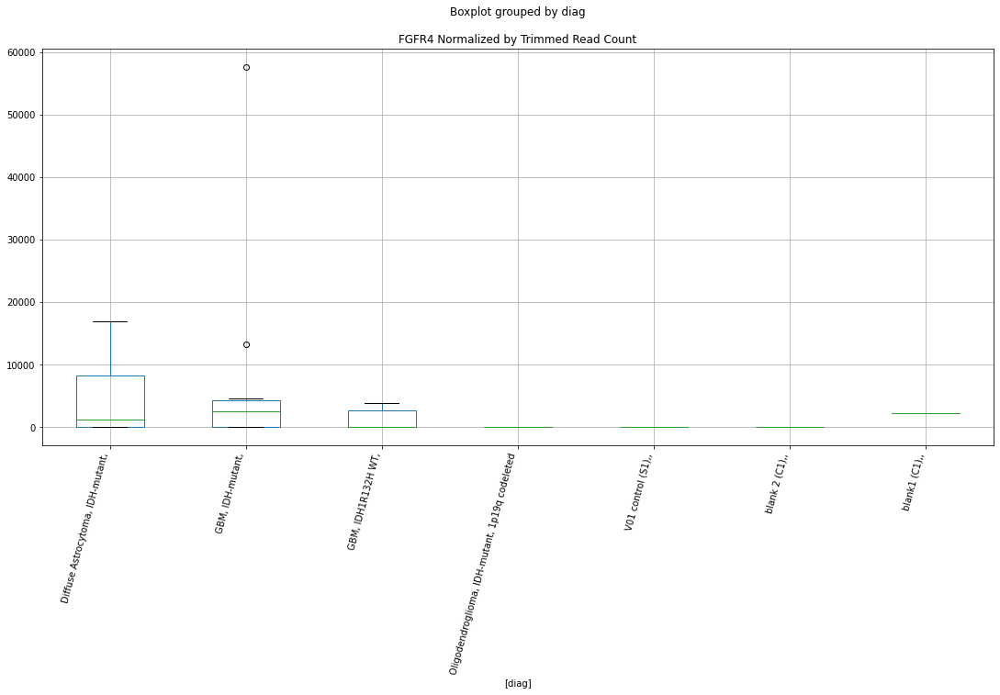

 p : 0.03367907729326021  ( t : 2.2992521838045406 ) :  D-plex  :  bbduk2  :  GDPD5
Control and blanks
73     0.0
337    0.0
Name: GDPD5, dtype: float64
205    12536.37
Name: GDPD5, dtype: float64
469    14788.18
Name: GDPD5, dtype: float64


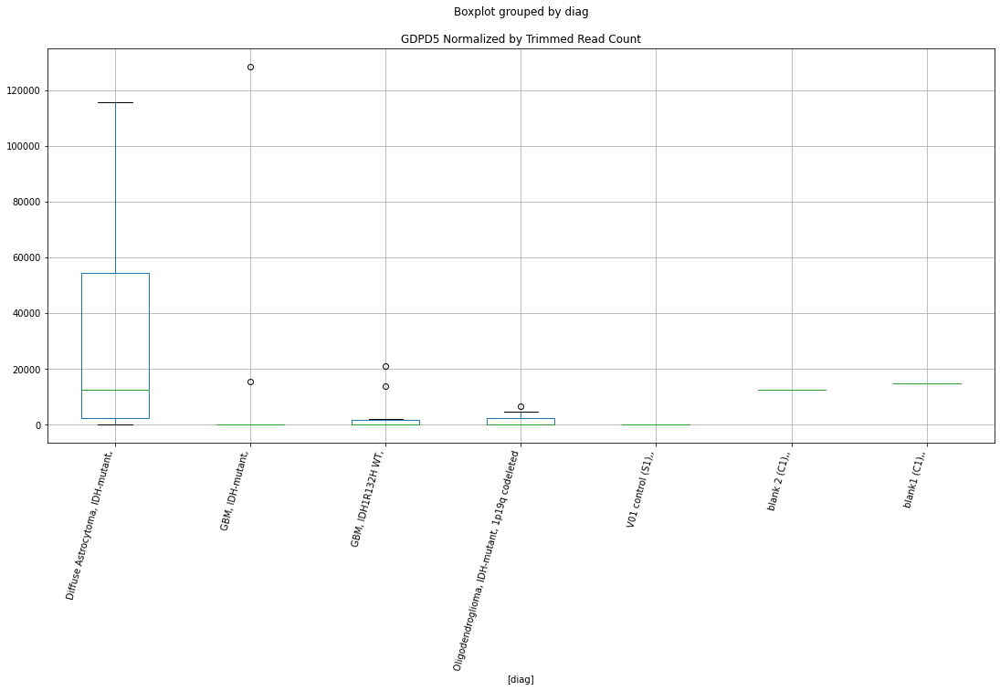

 p : 0.033839348414596786  ( t : 2.296905794980612 ) :  D-plex  :  bbduk2  :  FAM236C
Control and blanks
73     0.0
337    0.0
Name: FAM236C, dtype: float64
205    358.18
Name: FAM236C, dtype: float64
469    1774.58
Name: FAM236C, dtype: float64


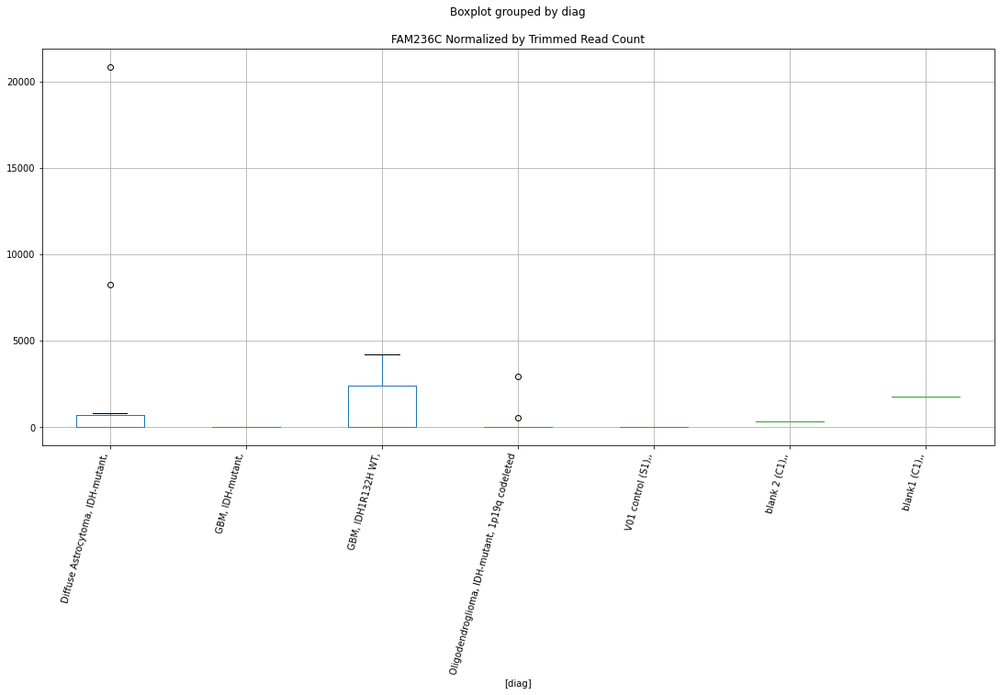

 p : 0.03385219885207995  ( t : 2.296718109334378 ) :  Lexogen  :  bbduk2  :  KCNV1
Control and blanks
79     17167.19
343      212.31
Name: KCNV1, dtype: float64
211    8745.8
Name: KCNV1, dtype: float64
475    0.0
Name: KCNV1, dtype: float64


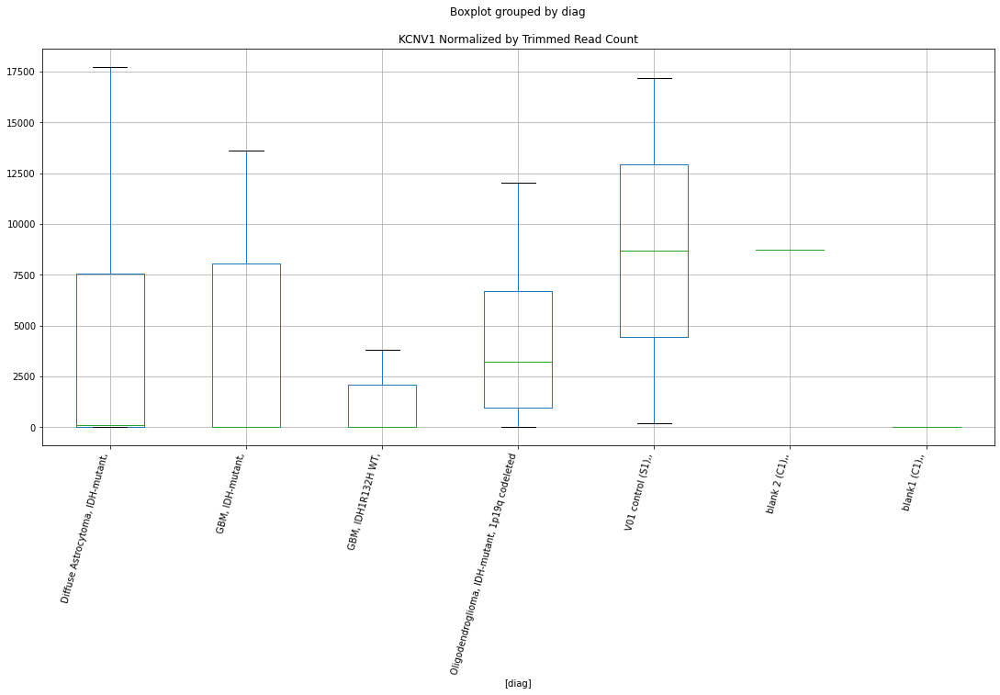

 p : 0.03388702360803753  ( t : 2.29620981195609 ) :  Lexogen  :  bbduk2  :  IRF7
Control and blanks
79     0.0
343    0.0
Name: IRF7, dtype: float64
211    0.0
Name: IRF7, dtype: float64
475    0.0
Name: IRF7, dtype: float64


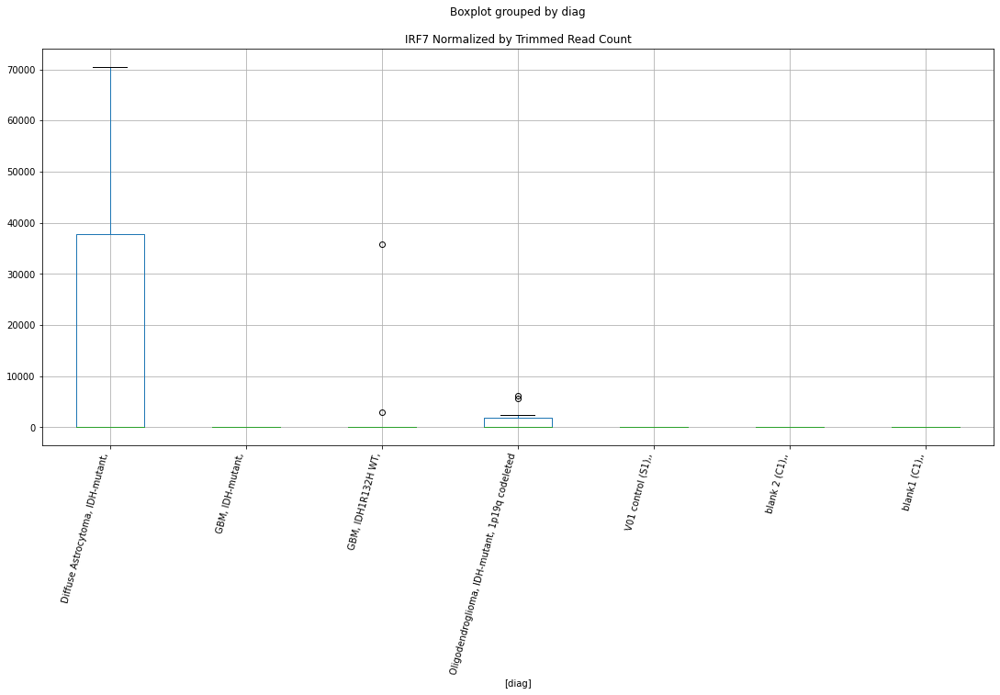

 p : 0.03388767175757279  ( t : 2.2962003562438857 ) :  Lexogen  :  cutadapt2  :  IRF7
Control and blanks
82     0.0
346    0.0
Name: IRF7, dtype: float64
214    0.0
Name: IRF7, dtype: float64
478    0.0
Name: IRF7, dtype: float64


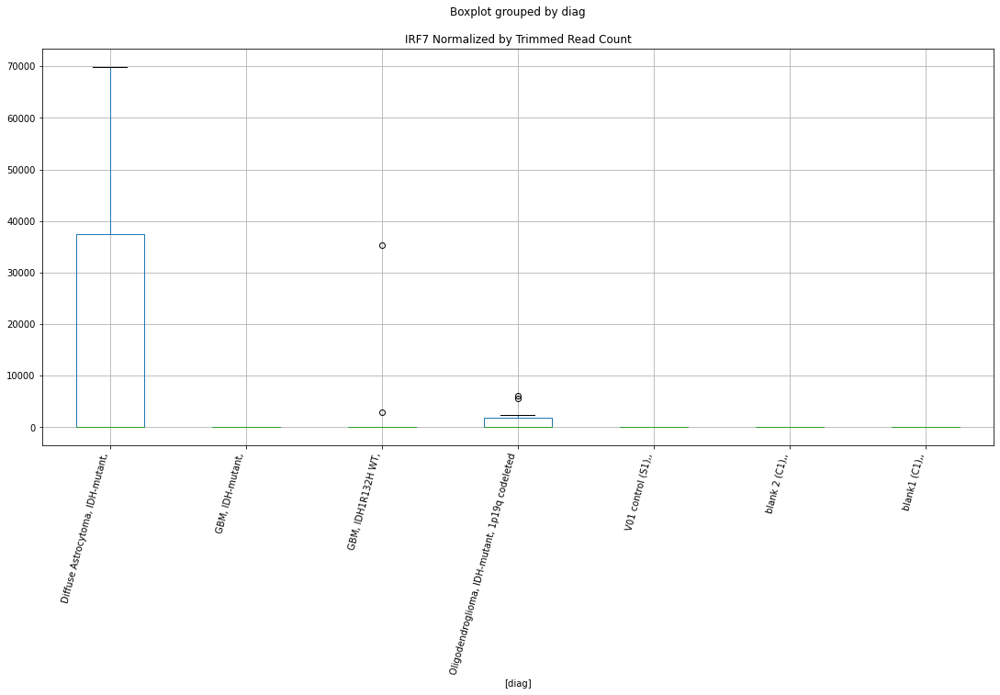

 p : 0.03390027895732728  ( t : 2.296016465885917 ) :  D-plex  :  bbduk2  :  LAX1
Control and blanks
73     6184.07
337       0.00
Name: LAX1, dtype: float64
205    225833.69
Name: LAX1, dtype: float64
469    2366.11
Name: LAX1, dtype: float64


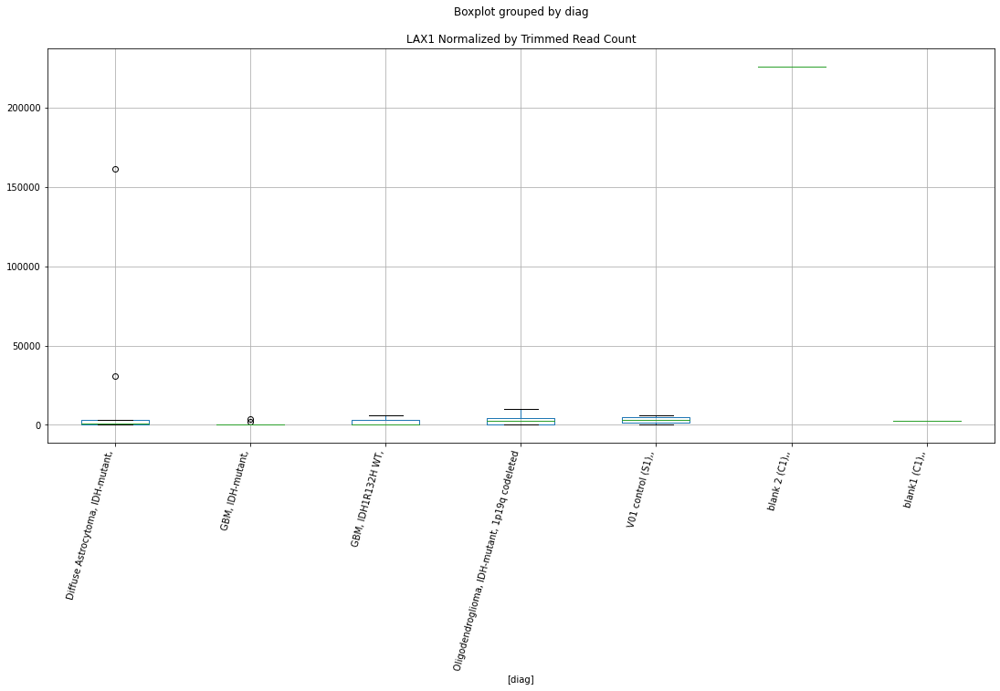

 p : 0.033908241706304826  ( t : 2.295900352782898 ) :  D-plex  :  bbduk2  :  FBXO10
Control and blanks
73     0.0
337    0.0
Name: FBXO10, dtype: float64
205    3581.82
Name: FBXO10, dtype: float64
469    0.0
Name: FBXO10, dtype: float64


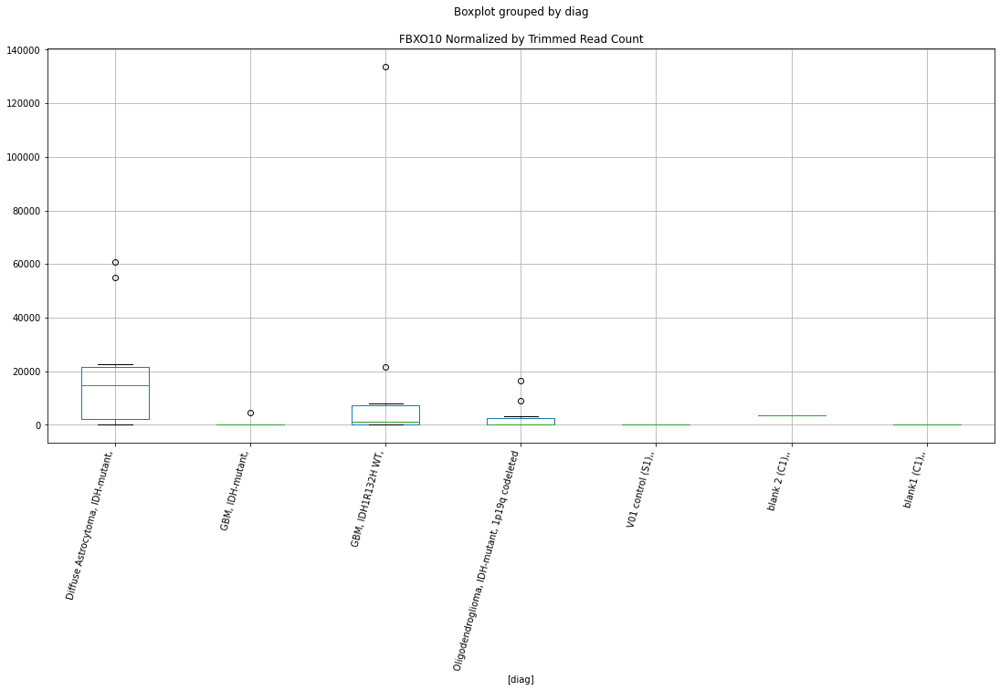

 p : 0.03412106240639207  ( t : 2.292806318655344 ) :  D-plex  :  bbduk2  :  EMILIN3
Control and blanks
73     0.0
337    0.0
Name: EMILIN3, dtype: float64
205    537.27
Name: EMILIN3, dtype: float64
469    591.53
Name: EMILIN3, dtype: float64


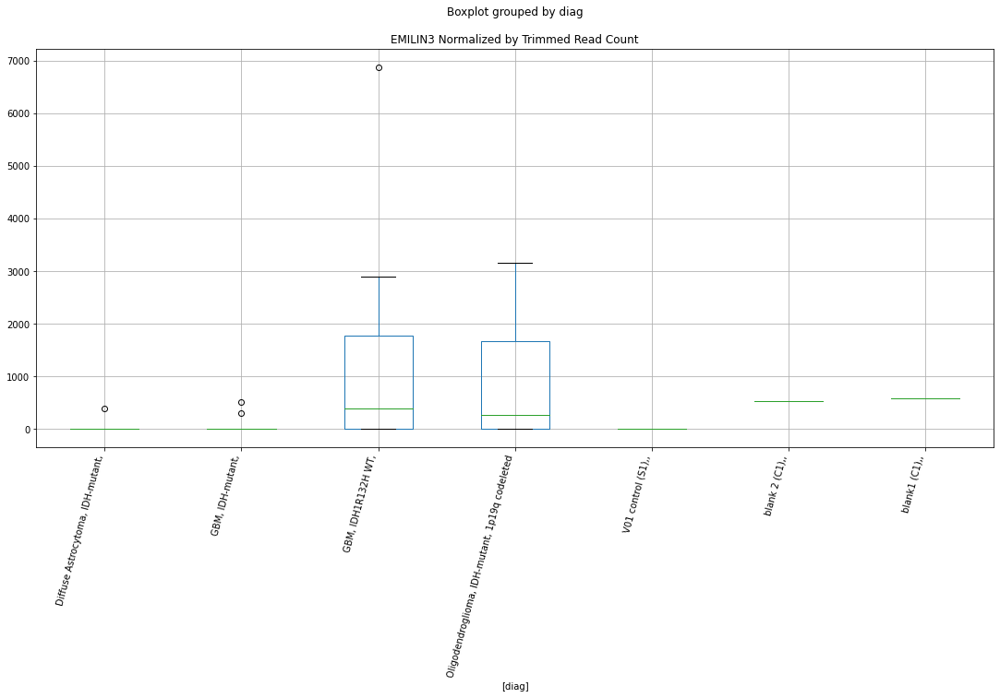

 p : 0.0341348804707374  ( t : 2.2926060473182677 ) :  D-plex  :  cutadapt2  :  LAX1
Control and blanks
76     6060.91
340       0.00
Name: LAX1, dtype: float64
208    224506.56
Name: LAX1, dtype: float64
472    2311.82
Name: LAX1, dtype: float64


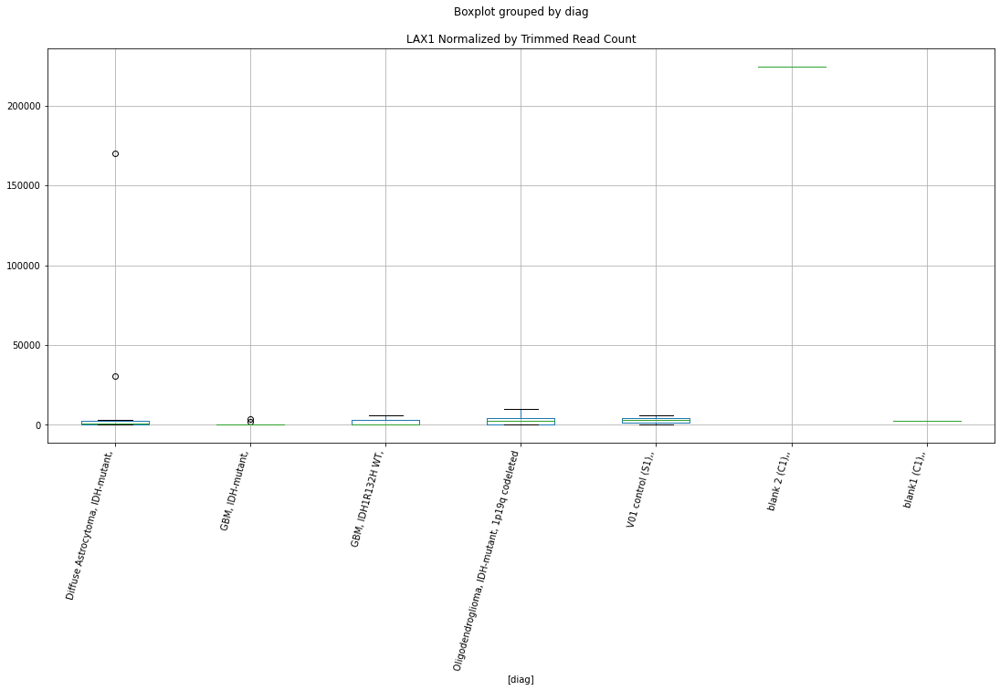

 p : 0.03414001682722414  ( t : 2.2925316229734554 ) :  D-plex  :  bbduk2  :  KCTD8
Control and blanks
73     1546.02
337       0.00
Name: KCTD8, dtype: float64
205    5372.73
Name: KCTD8, dtype: float64
469    4140.69
Name: KCTD8, dtype: float64


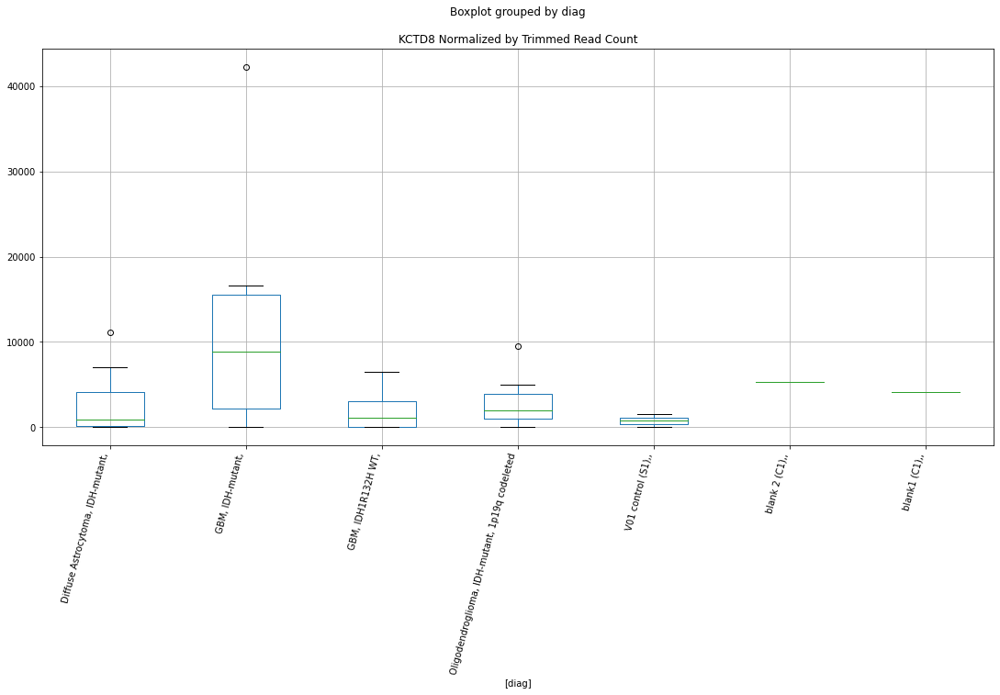

 p : 0.03415402660952562  ( t : 2.2923286779358687 ) :  D-plex  :  bbduk2  :  IQSEC3
Control and blanks
73     11595.13
337    61420.85
Name: IQSEC3, dtype: float64
205    35818.19
Name: IQSEC3, dtype: float64
469    54420.51
Name: IQSEC3, dtype: float64


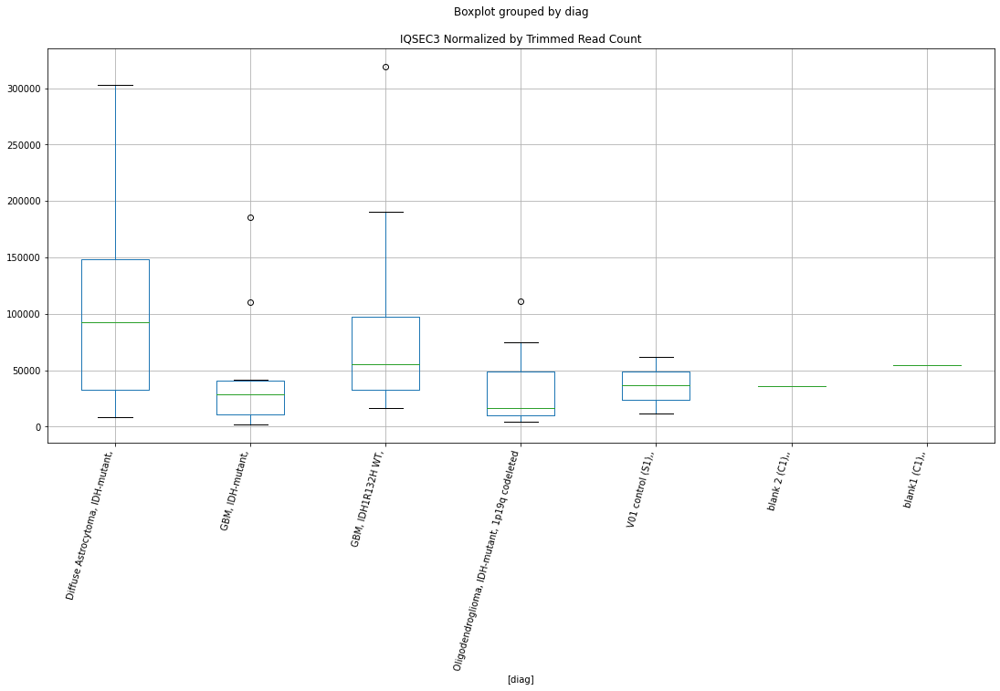

 p : 0.03416023202690698  ( t : 2.292238811201096 ) :  D-plex  :  cutadapt2  :  KCNQ3
Control and blanks
76     0.0
340    0.0
Name: KCNQ3, dtype: float64
208    6878.05
Name: KCNQ3, dtype: float64
472    6935.47
Name: KCNQ3, dtype: float64


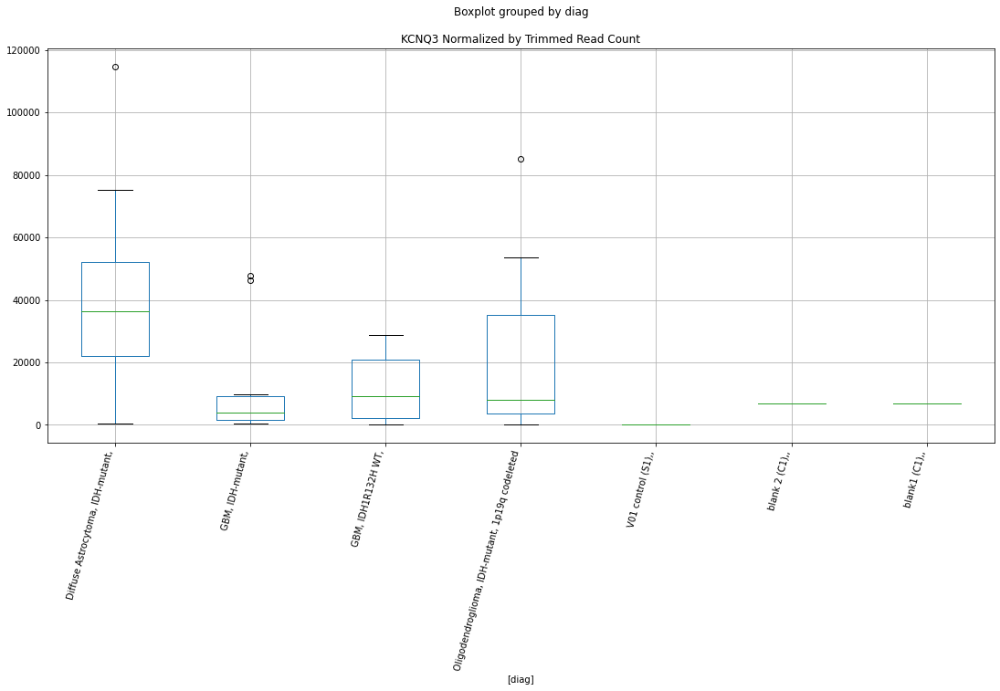

 p : 0.03421245563009955  ( t : 2.2914831086377423 ) :  D-plex  :  bbduk2  :  HCLS1
Control and blanks
73     0.0
337    0.0
Name: HCLS1, dtype: float64
205    1074.55
Name: HCLS1, dtype: float64
469    233061.76
Name: HCLS1, dtype: float64


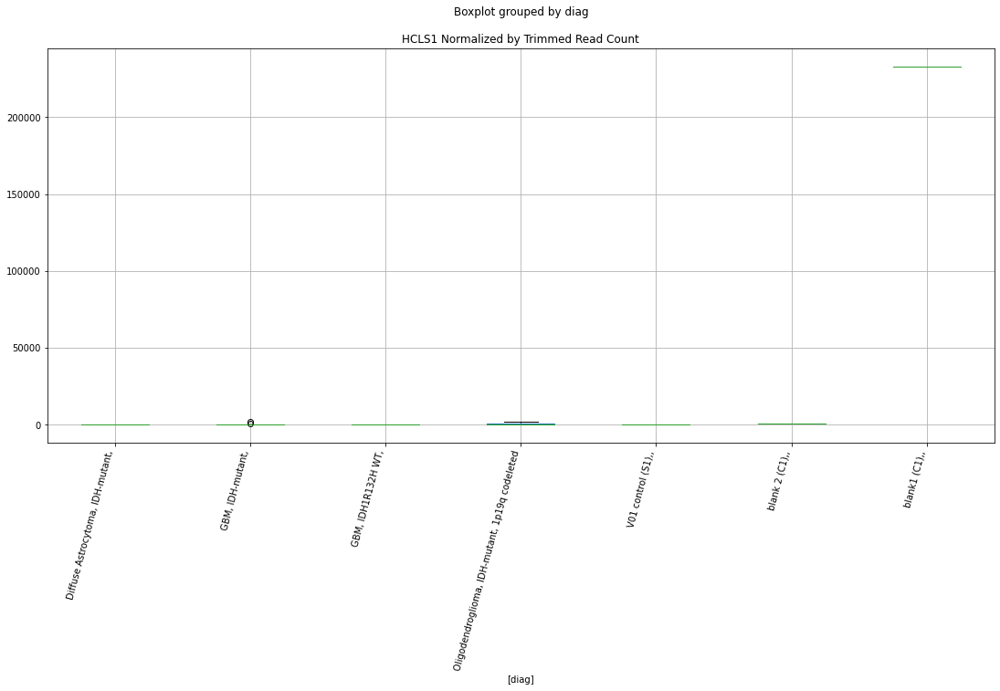

 p : 0.03421635618470044  ( t : 2.291426708491843 ) :  Lexogen  :  bbduk2  :  INSYN2A
Control and blanks
79        0.00
343    1273.89
Name: INSYN2A, dtype: float64
211    0.0
Name: INSYN2A, dtype: float64
475    0.0
Name: INSYN2A, dtype: float64


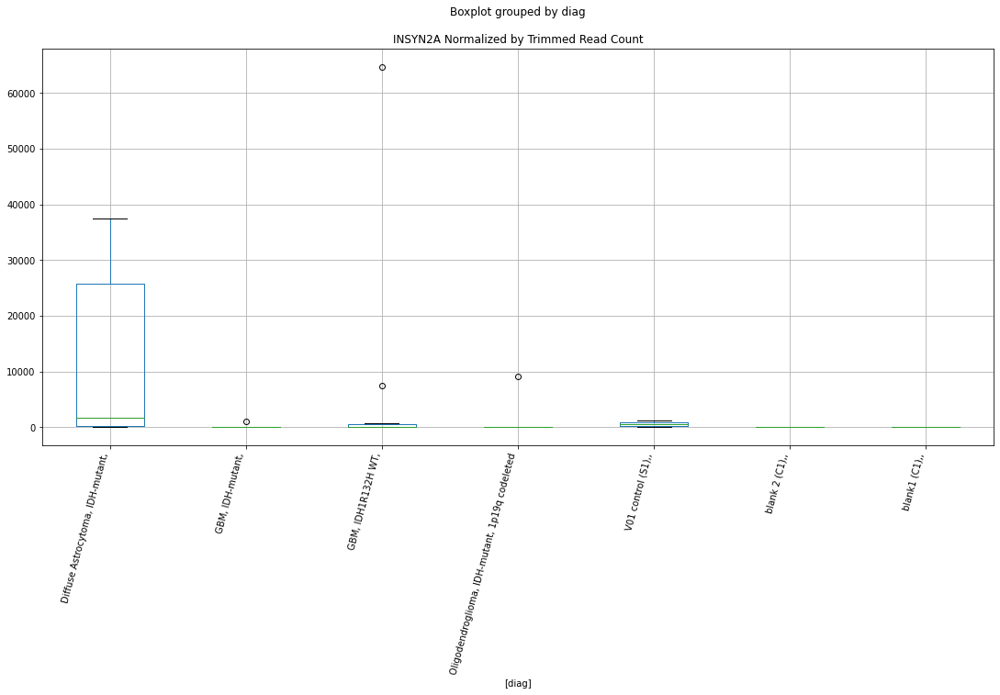

 p : 0.03432986668359827  ( t : 2.2897880042901932 ) :  D-plex  :  cutadapt2  :  FABP6-AS1
Control and blanks
76     0.0
340    0.0
Name: FABP6-AS1, dtype: float64
208    0.0
Name: FABP6-AS1, dtype: float64
472    577.96
Name: FABP6-AS1, dtype: float64


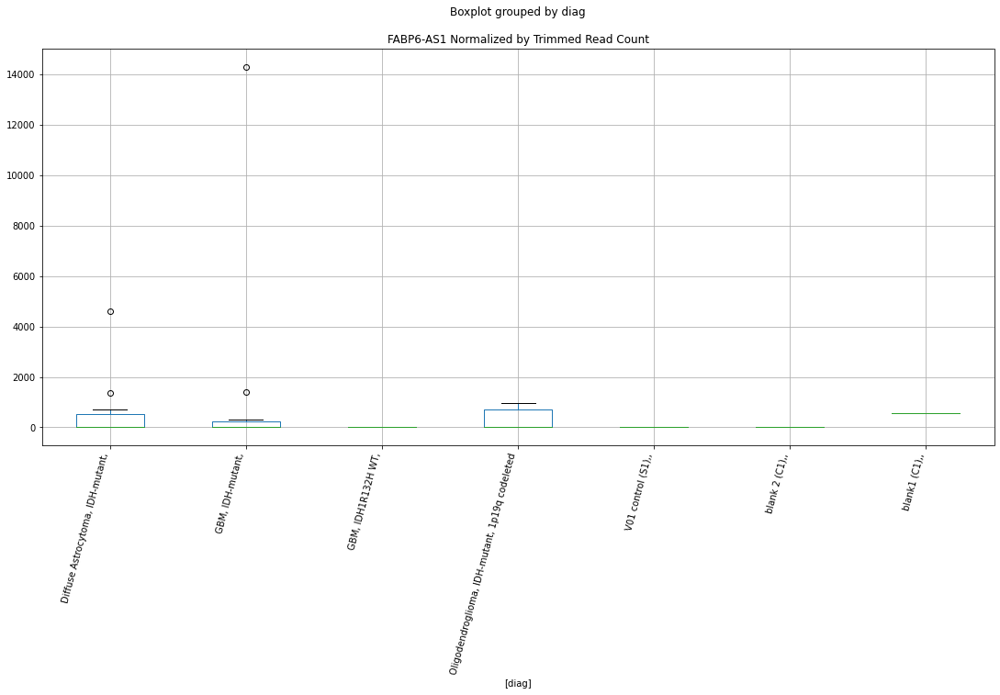

 p : 0.03435540301489832  ( t : 2.2894200384492795 ) :  D-plex  :  bbduk2  :  LARS2
Control and blanks
73     119043.29
337         0.00
Name: LARS2, dtype: float64
205    8238.18
Name: LARS2, dtype: float64
469    20111.93
Name: LARS2, dtype: float64


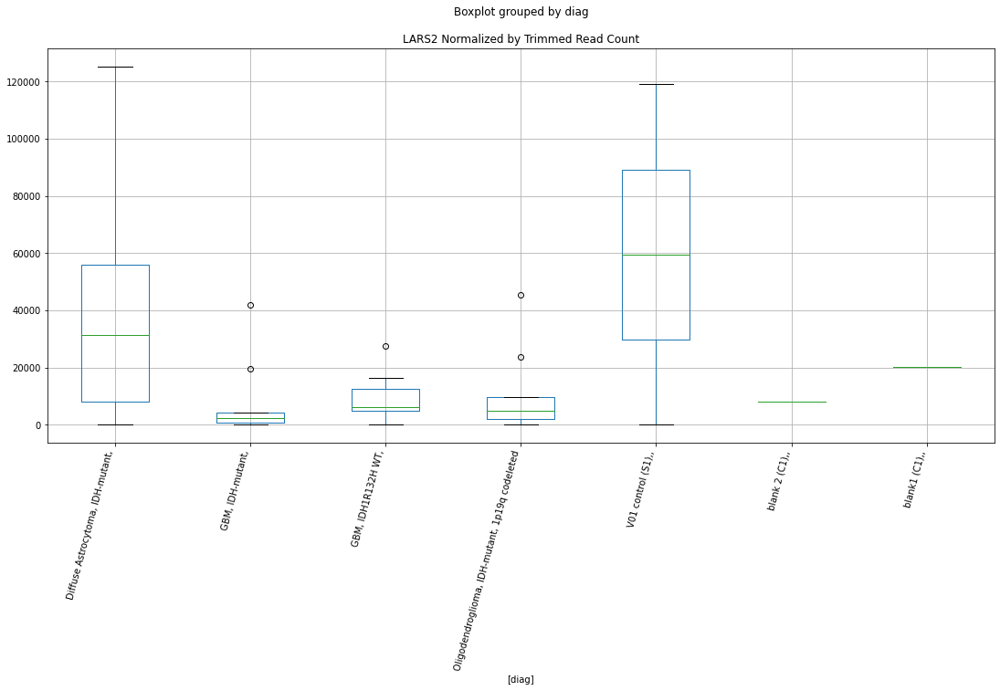

 p : 0.03436340820399907  ( t : 2.28930473980708 ) :  D-plex  :  cutadapt2  :  DPP4
Control and blanks
76      13637.06
340    160293.25
Name: DPP4, dtype: float64
208    31744.84
Name: DPP4, dtype: float64
472    13870.94
Name: DPP4, dtype: float64


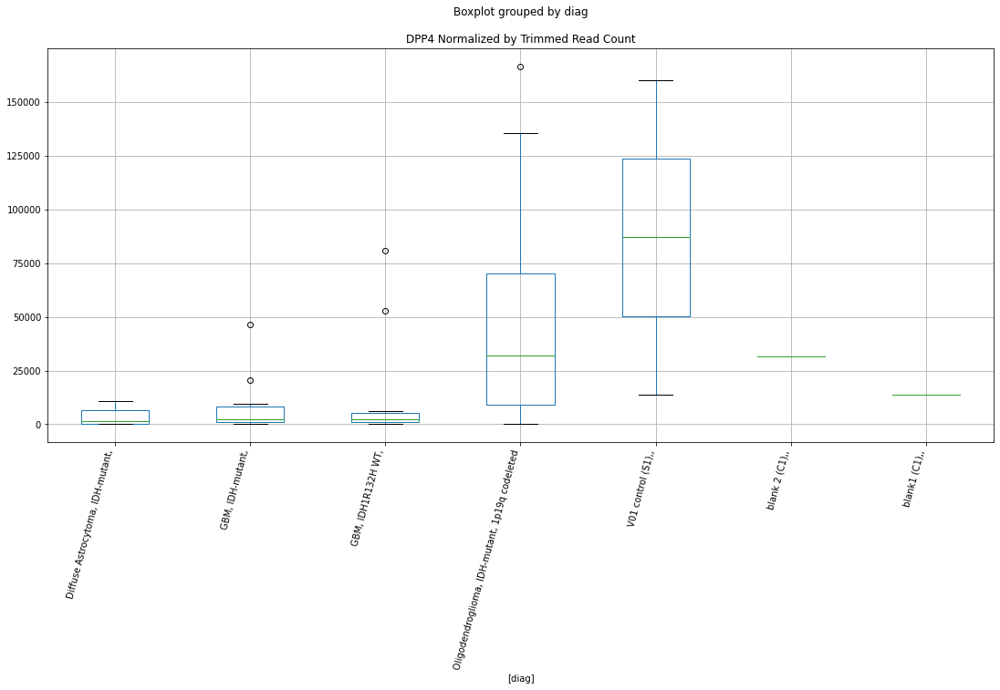

 p : 0.03442192888007202  ( t : 2.288462622074069 ) :  D-plex  :  bbduk2  :  GRM7
Control and blanks
73      2319.03
337    69432.27
Name: GRM7, dtype: float64
205    8954.55
Name: GRM7, dtype: float64
469    0.0
Name: GRM7, dtype: float64


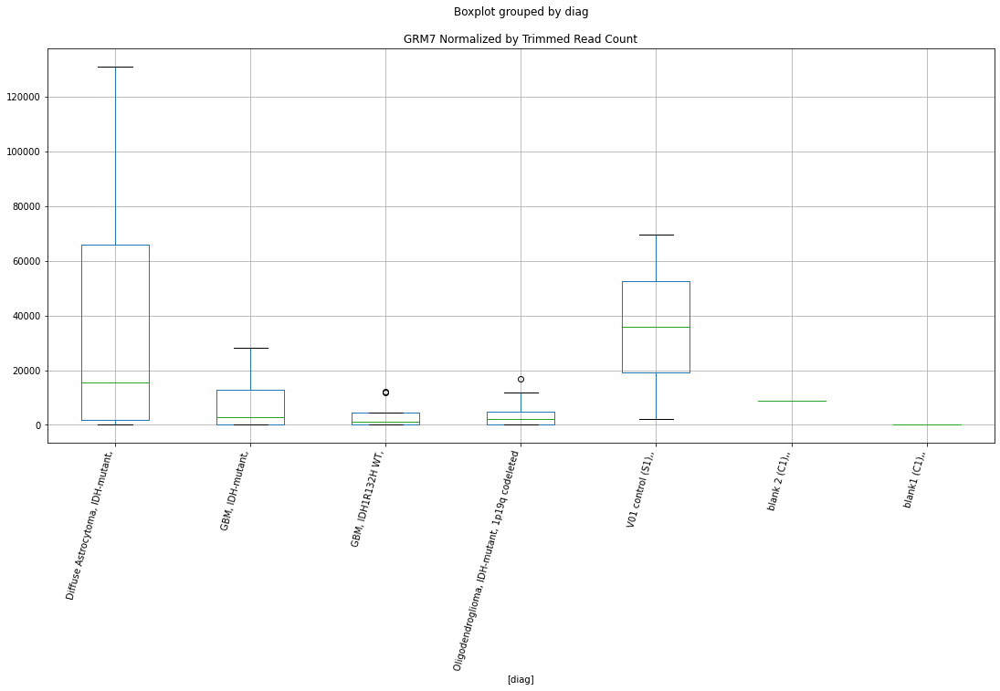

 p : 0.03443470022916822  ( t : 2.2882790174979637 ) :  D-plex  :  bbduk2  :  FBXL17
Control and blanks
73        0.00
337    2670.47
Name: FBXL17, dtype: float64
205    13431.82
Name: FBXL17, dtype: float64
469    10647.49
Name: FBXL17, dtype: float64


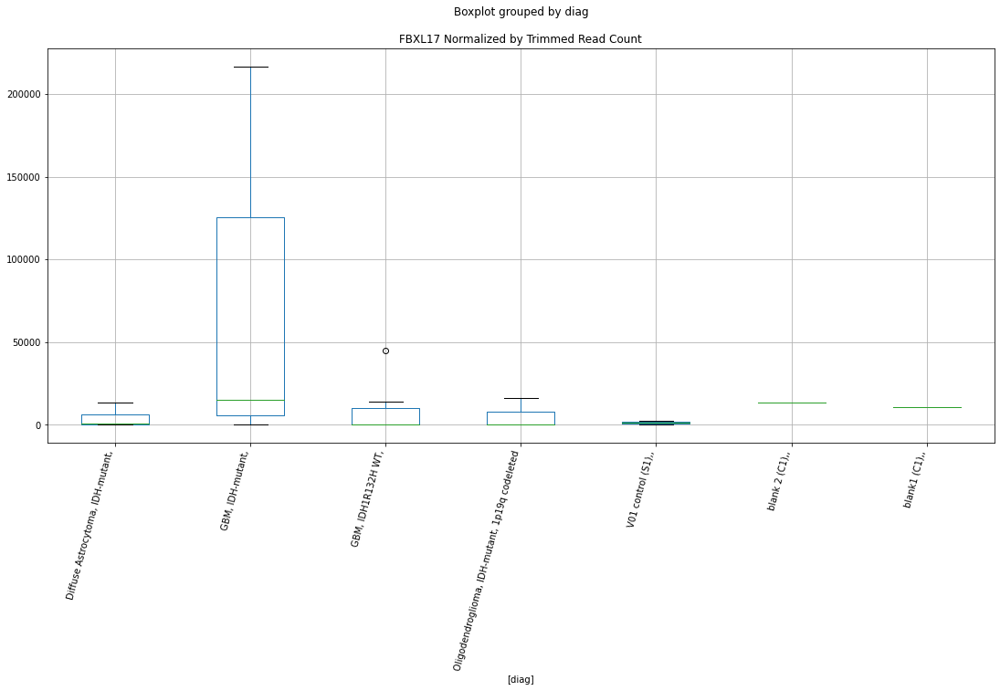

 p : 0.034467806933277674  ( t : 2.2878033594982305 ) :  D-plex  :  cutadapt2  :  F2RL2
Control and blanks
76     0.0
340    0.0
Name: F2RL2, dtype: float64
208    1058.16
Name: F2RL2, dtype: float64
472    2311.82
Name: F2RL2, dtype: float64


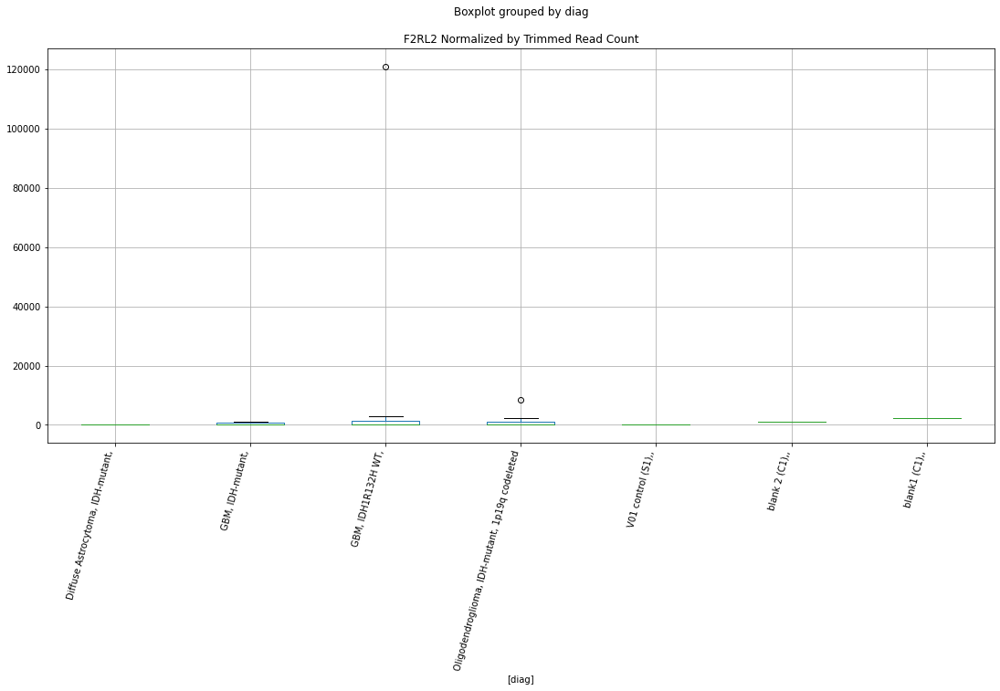

 p : 0.03448080245144359  ( t : 2.2876167630304804 ) :  D-plex  :  cutadapt2  :  GGT7
Control and blanks
76     0.0
340    0.0
Name: GGT7, dtype: float64
208    1587.24
Name: GGT7, dtype: float64
472    0.0
Name: GGT7, dtype: float64


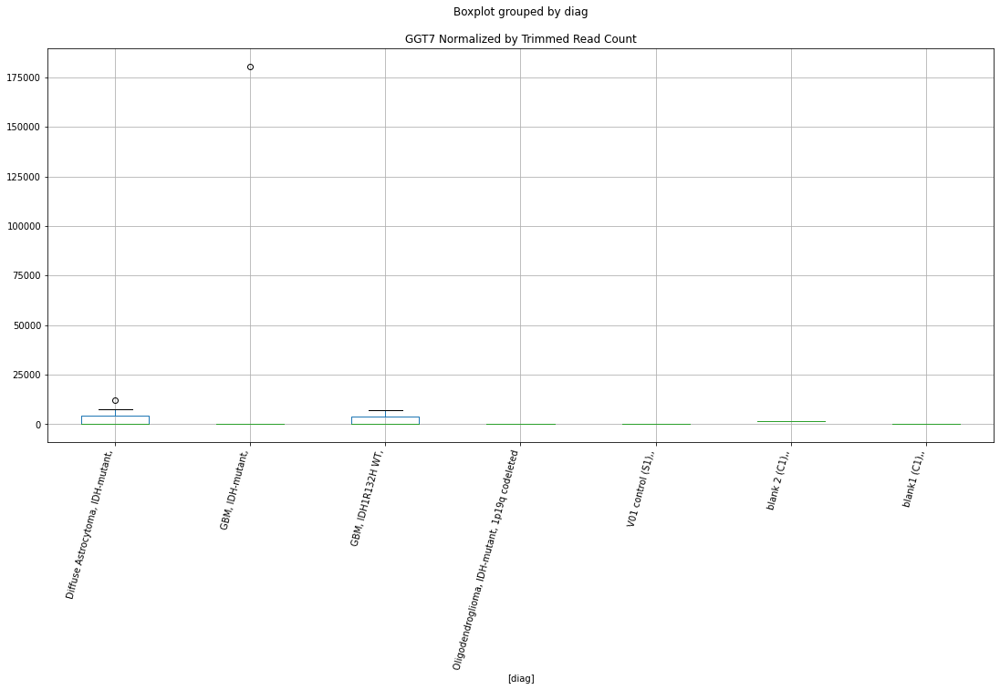

 p : 0.03448830569167223  ( t : 2.287509057225121 ) :  D-plex  :  cutadapt2  :  FXYD3
Control and blanks
76     0.0
340    0.0
Name: FXYD3, dtype: float64
208    14637.9
Name: FXYD3, dtype: float64
472    2.15e+06
Name: FXYD3, dtype: float64


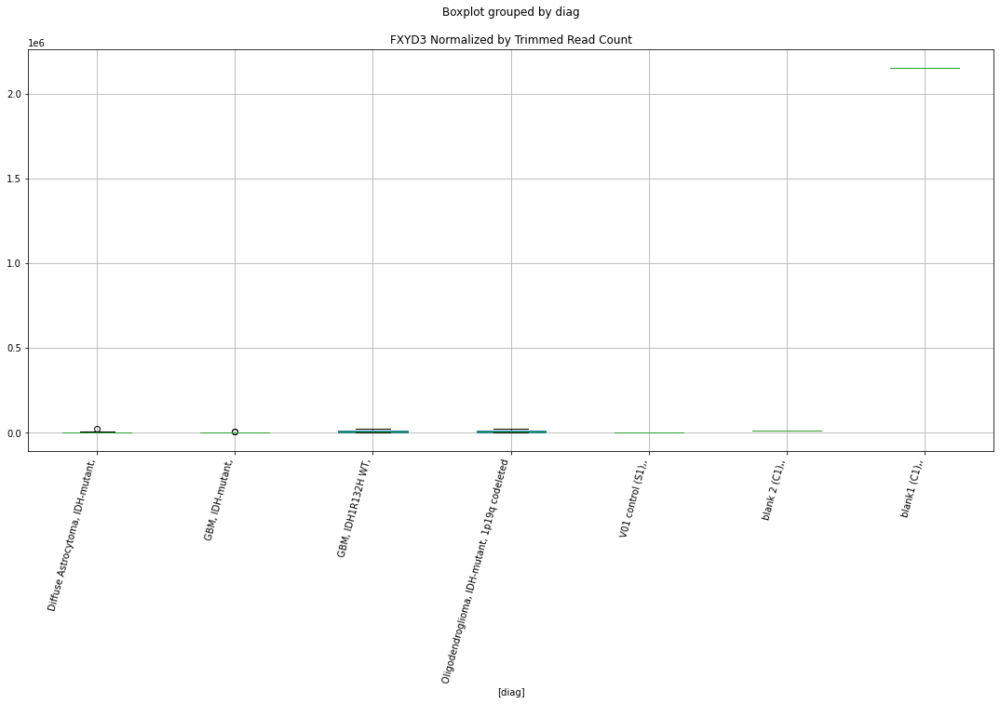

 p : 0.03449481366215499  ( t : 2.2874156556629393 ) :  D-plex  :  bbduk2  :  DPP4
Control and blanks
73      13914.15
337    160228.31
Name: DPP4, dtype: float64
205    31878.19
Name: DPP4, dtype: float64
469    14196.66
Name: DPP4, dtype: float64


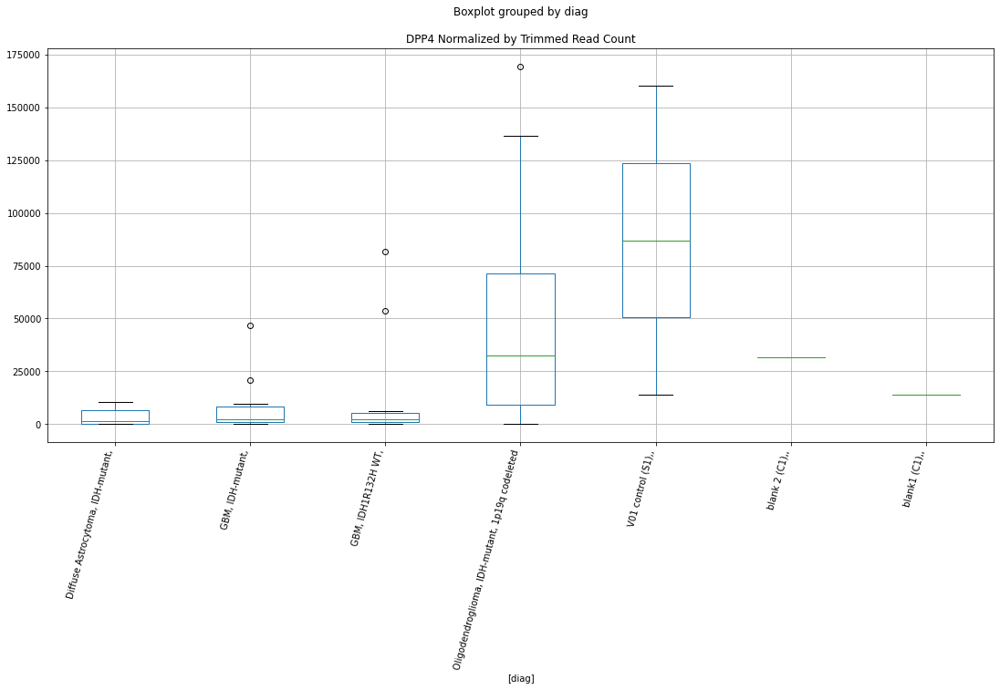

 p : 0.03453337532249904  ( t : 2.286862558207428 ) :  D-plex  :  bbduk2  :  FABP6-AS1
Control and blanks
73     0.0
337    0.0
Name: FABP6-AS1, dtype: float64
205    0.0
Name: FABP6-AS1, dtype: float64
469    591.53
Name: FABP6-AS1, dtype: float64


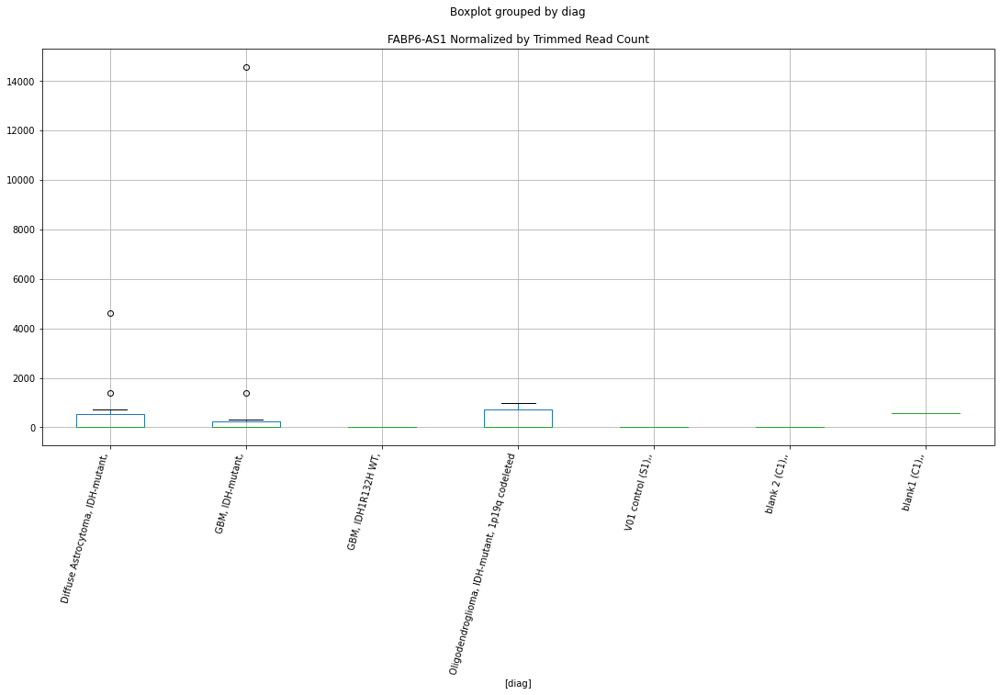

 p : 0.03457276377419725  ( t : 2.286298192042308 ) :  D-plex  :  bbduk2  :  GSG1L
Control and blanks
73      6184.07
337    85455.10
Name: GSG1L, dtype: float64
205    3940.0
Name: GSG1L, dtype: float64
469    11830.55
Name: GSG1L, dtype: float64


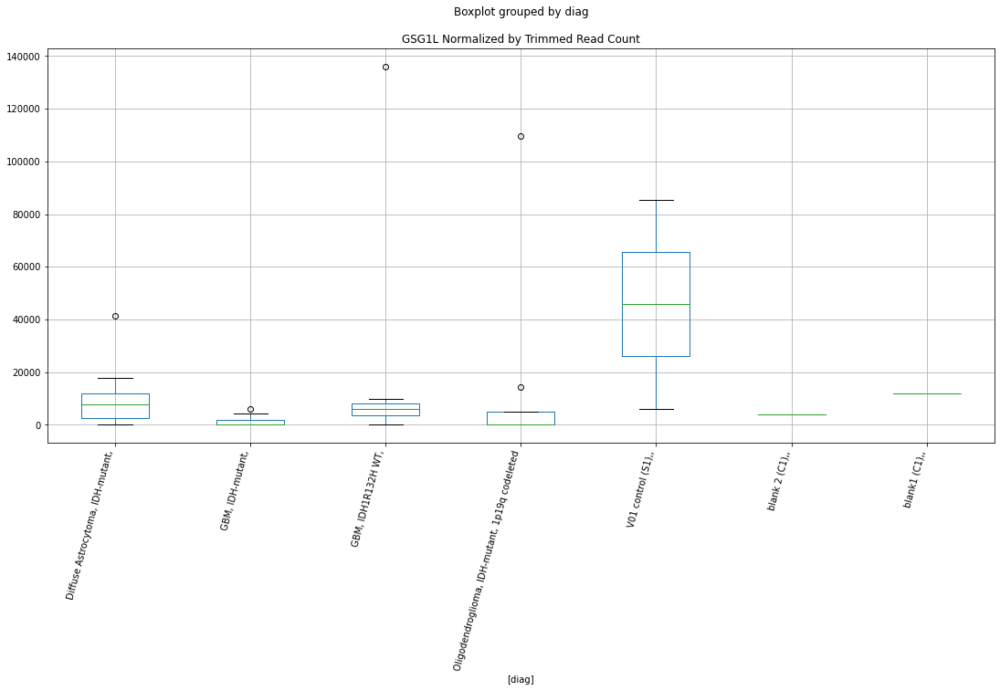

 p : 0.03461703766982915  ( t : 2.2856645364617143 ) :  D-plex  :  bbduk2  :  FAM189B
Control and blanks
73     0.0
337    0.0
Name: FAM189B, dtype: float64
205    8775.46
Name: FAM189B, dtype: float64
469    12422.07
Name: FAM189B, dtype: float64


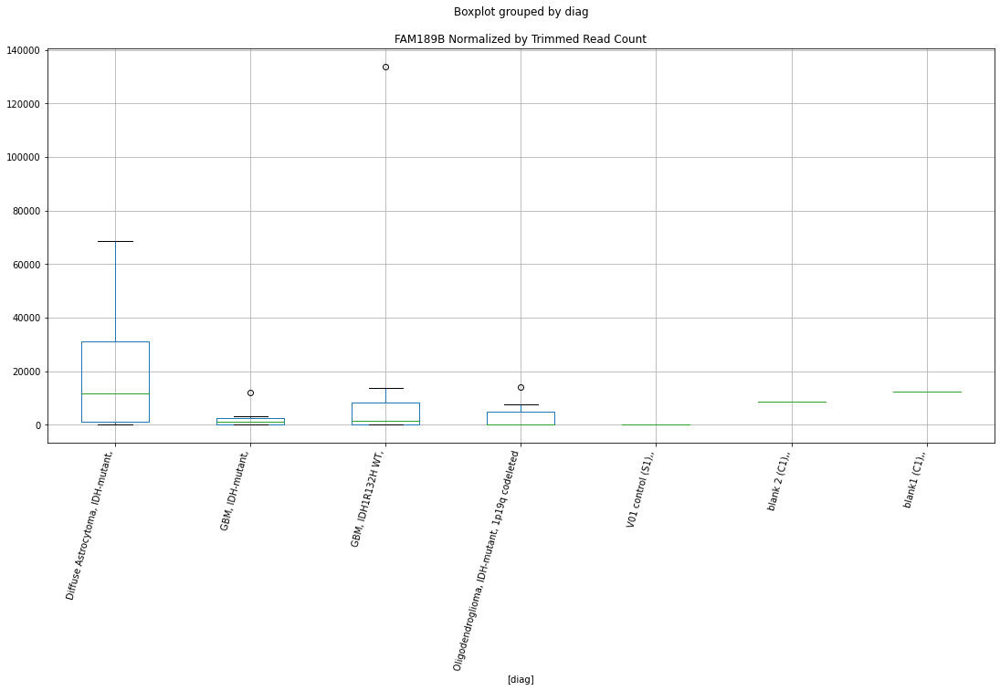

 p : 0.034623371975605874  ( t : 2.2855739401574464 ) :  D-plex  :  bbduk2  :  FRAS1
Control and blanks
73     2319.03
337    2670.47
Name: FRAS1, dtype: float64
205    2865.46
Name: FRAS1, dtype: float64
469    7689.86
Name: FRAS1, dtype: float64


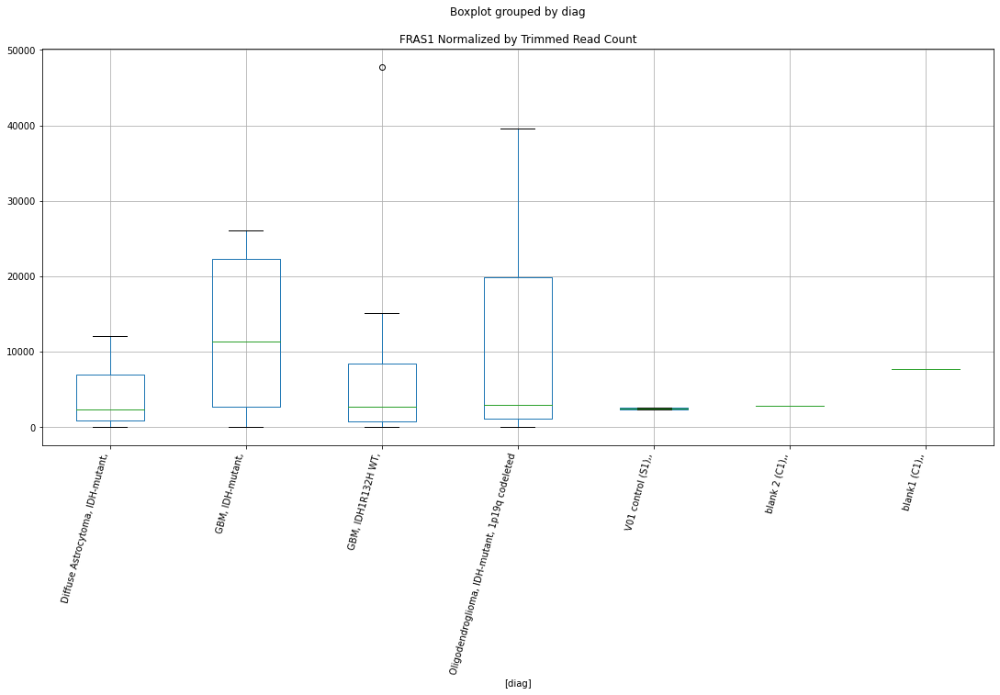

 p : 0.034632251593755686  ( t : 2.2854469653962335 ) :  D-plex  :  cutadapt2  :  LARS2
Control and blanks
76     116672.59
340         0.00
Name: LARS2, dtype: float64
208    8818.01
Name: LARS2, dtype: float64
472    19650.5
Name: LARS2, dtype: float64


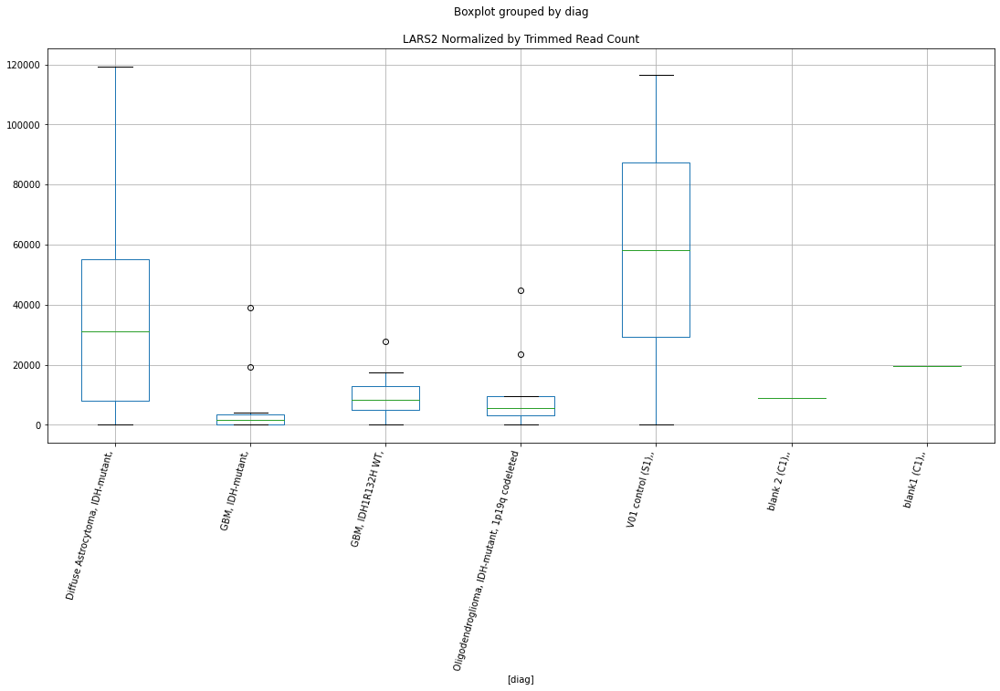

 p : 0.03473207504751438  ( t : 2.2840216028181386 ) :  Lexogen  :  bbduk2  :  JUP
Control and blanks
79     0.0
343    0.0
Name: JUP, dtype: float64
211    0.0
Name: JUP, dtype: float64
475    0.0
Name: JUP, dtype: float64


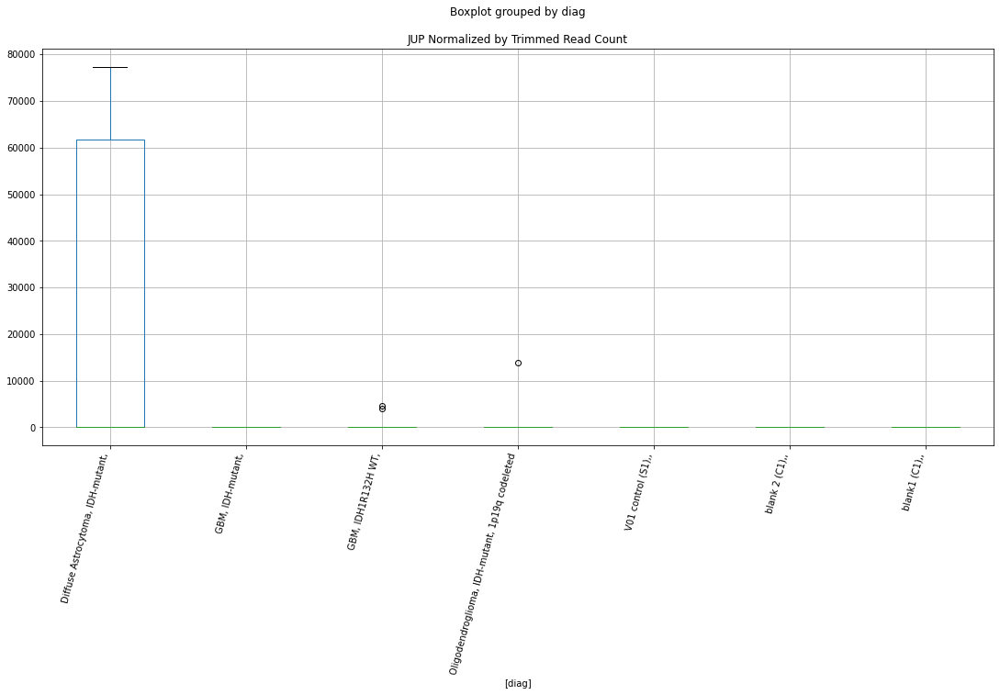

 p : 0.03477640870768895  ( t : 2.2833897856634406 ) :  Lexogen  :  cutadapt2  :  JUP
Control and blanks
82     0.0
346    0.0
Name: JUP, dtype: float64
214    0.0
Name: JUP, dtype: float64
478    0.0
Name: JUP, dtype: float64


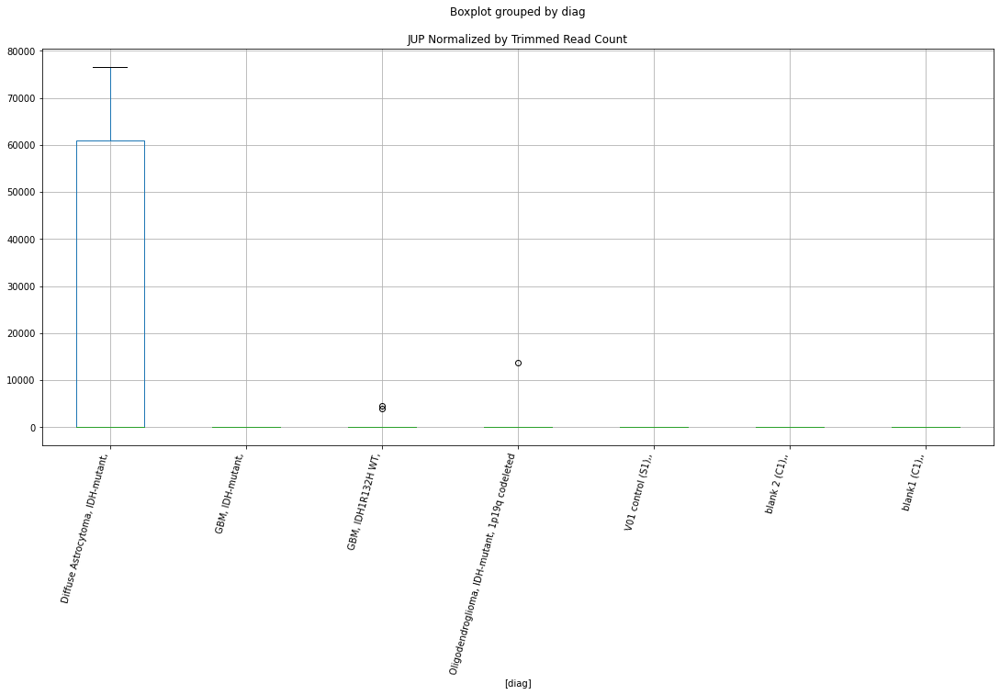

 p : 0.03484283126474412  ( t : 2.2824445645870863 ) :  Lexogen  :  bbduk2  :  EPHA5
Control and blanks
79     0.0
343    0.0
Name: EPHA5, dtype: float64
211    0.0
Name: EPHA5, dtype: float64
475    0.0
Name: EPHA5, dtype: float64


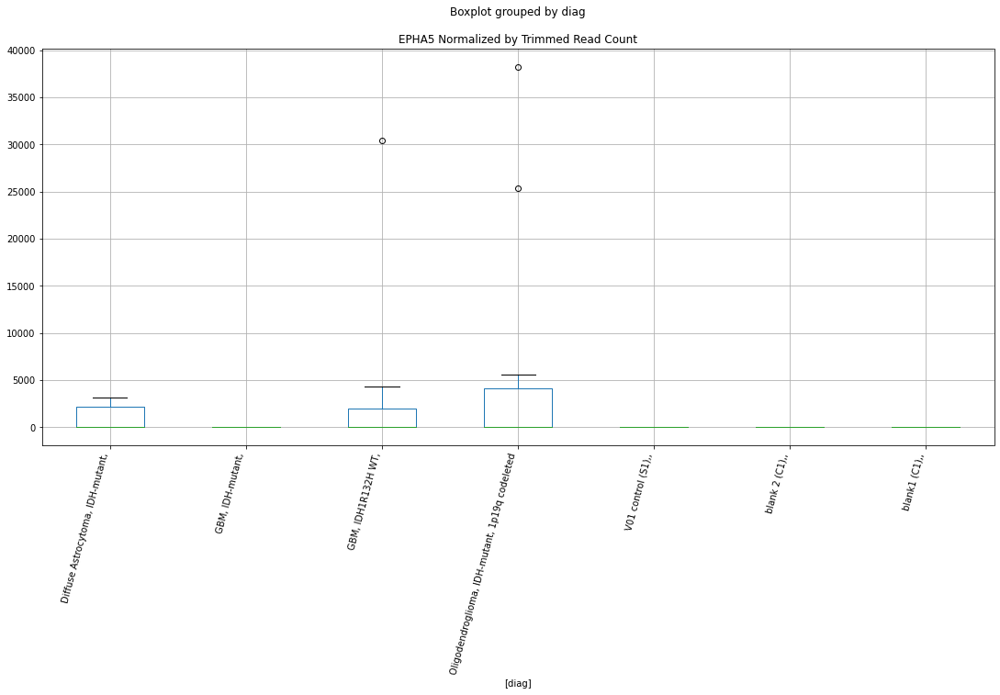

 p : 0.03490448117562106  ( t : 2.2815687515454486 ) :  D-plex  :  cutadapt2  :  FAM189B
Control and blanks
76     0.0
340    0.0
Name: FAM189B, dtype: float64
208    7407.13
Name: FAM189B, dtype: float64
472    8091.38
Name: FAM189B, dtype: float64


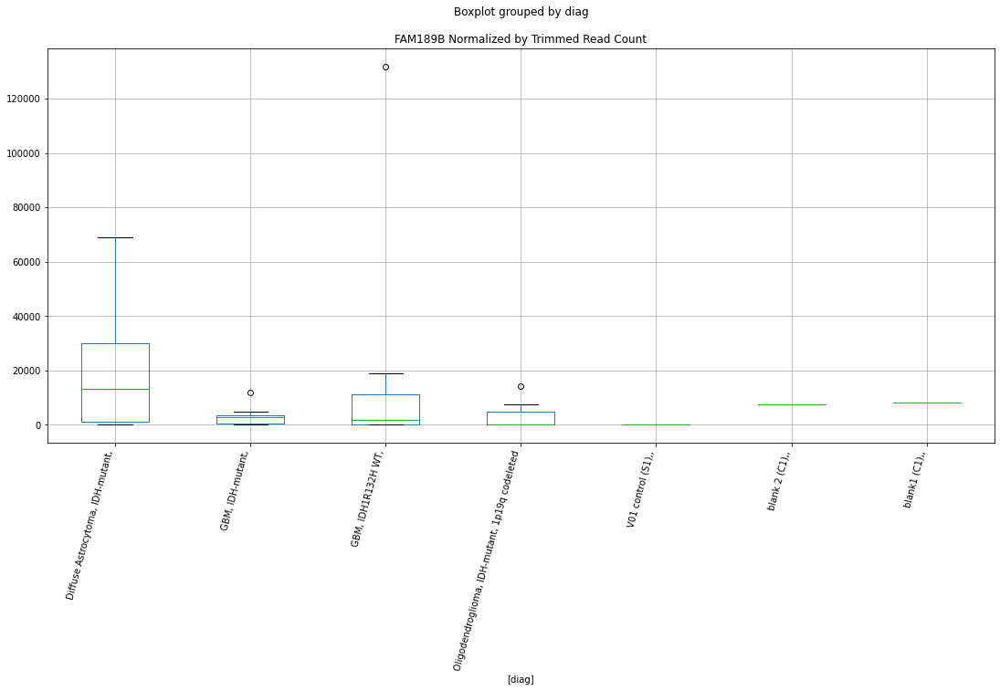

 p : 0.03503688511990087  ( t : 2.279692619193957 ) :  D-plex  :  bbduk2  :  HNRNPA2B1
Control and blanks
73         0.00
337    21363.77
Name: HNRNPA2B1, dtype: float64
205    18446.37
Name: HNRNPA2B1, dtype: float64
469    55012.04
Name: HNRNPA2B1, dtype: float64


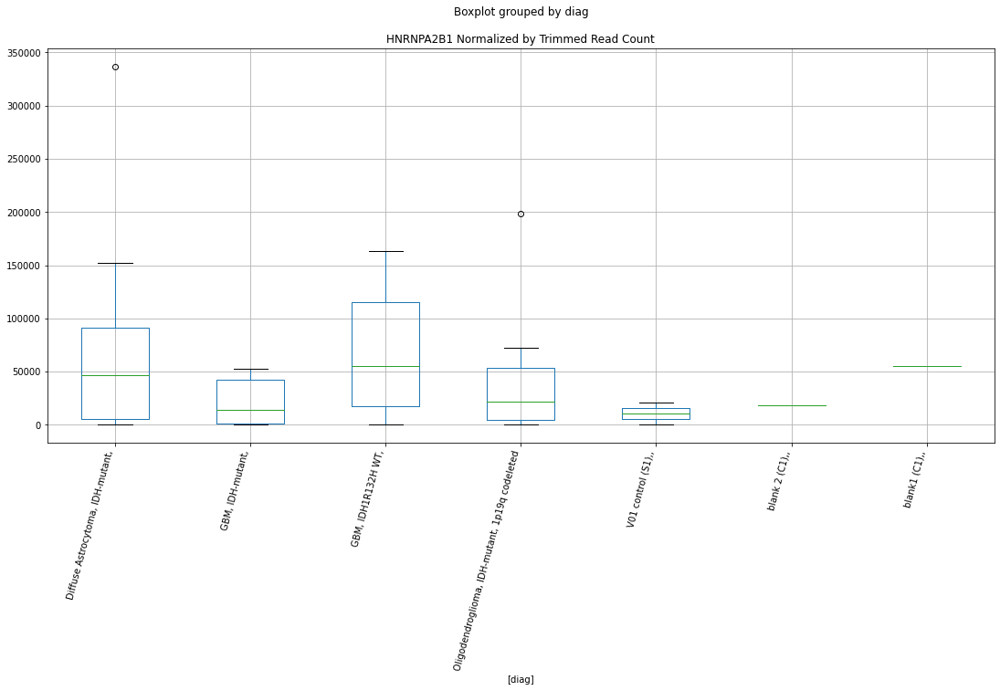

 p : 0.03508535761120964  ( t : 2.2790074158810216 ) :  D-plex  :  bbduk2  :  LAMC2
Control and blanks
73     0.0
337    0.0
Name: LAMC2, dtype: float64
205    2865.46
Name: LAMC2, dtype: float64
469    3549.16
Name: LAMC2, dtype: float64


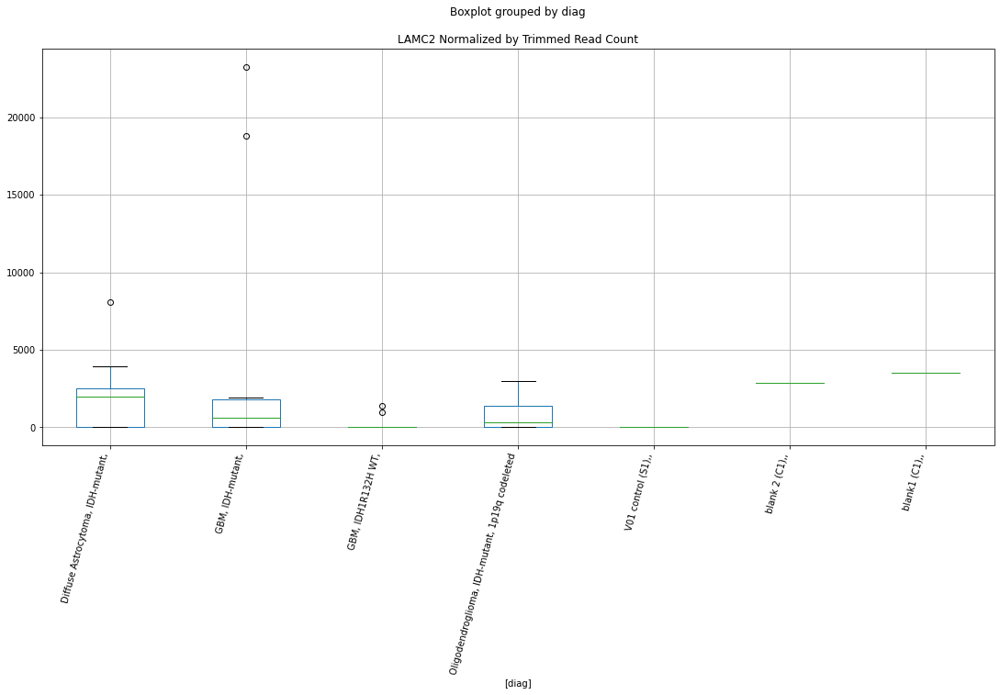

 p : 0.03515346373504861  ( t : 2.2780461516332893 ) :  D-plex  :  bbduk2  :  HCAR1
Control and blanks
73     0.0
337    0.0
Name: HCAR1, dtype: float64
205    716.36
Name: HCAR1, dtype: float64
469    0.0
Name: HCAR1, dtype: float64


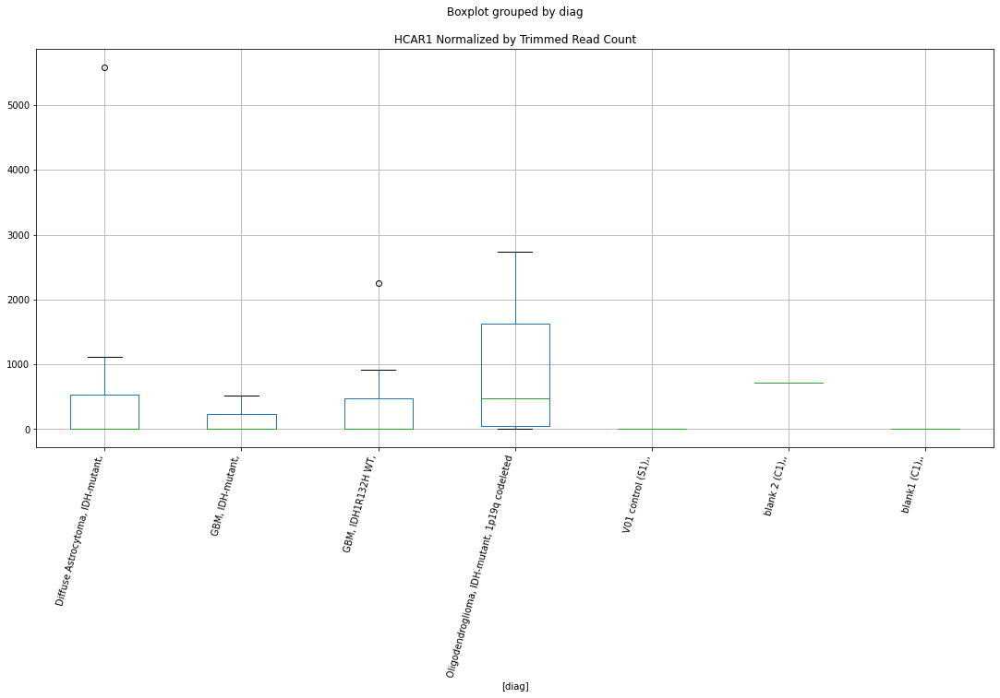

 p : 0.03519908473941566  ( t : 2.277403210375392 ) :  D-plex  :  cutadapt2  :  KLHL34
Control and blanks
76       0.00
340    880.73
Name: KLHL34, dtype: float64
208    3527.2
Name: KLHL34, dtype: float64
472    5779.56
Name: KLHL34, dtype: float64


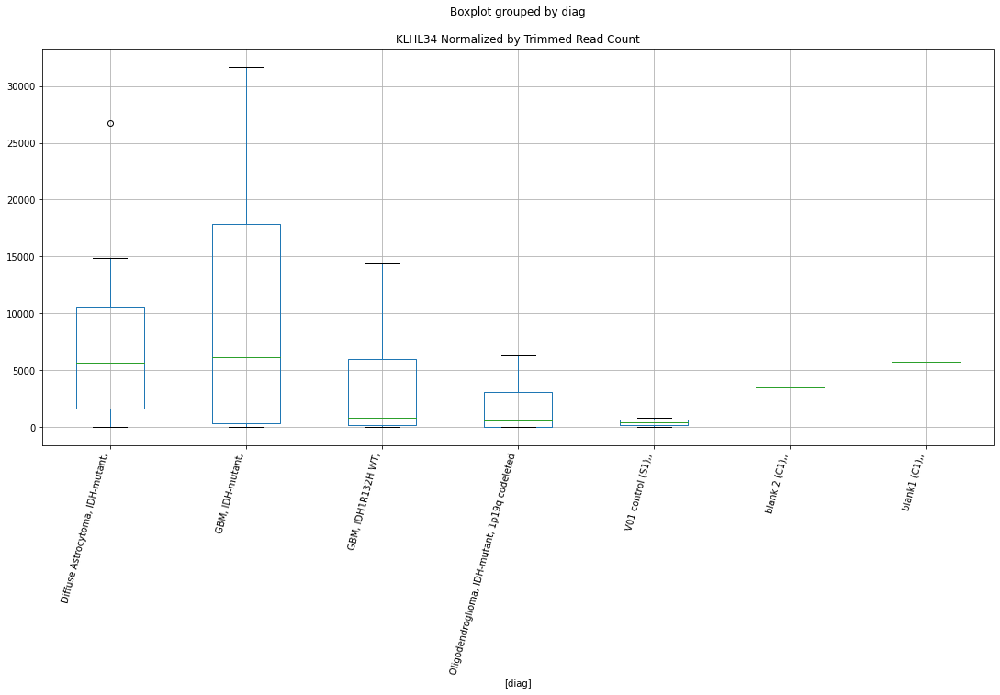

 p : 0.03521237967804715  ( t : 2.2772159885879595 ) :  D-plex  :  cutadapt2  :  HERC2
Control and blanks
76     63639.59
340        0.00
Name: HERC2, dtype: float64
208    93470.92
Name: HERC2, dtype: float64
472    62419.23
Name: HERC2, dtype: float64


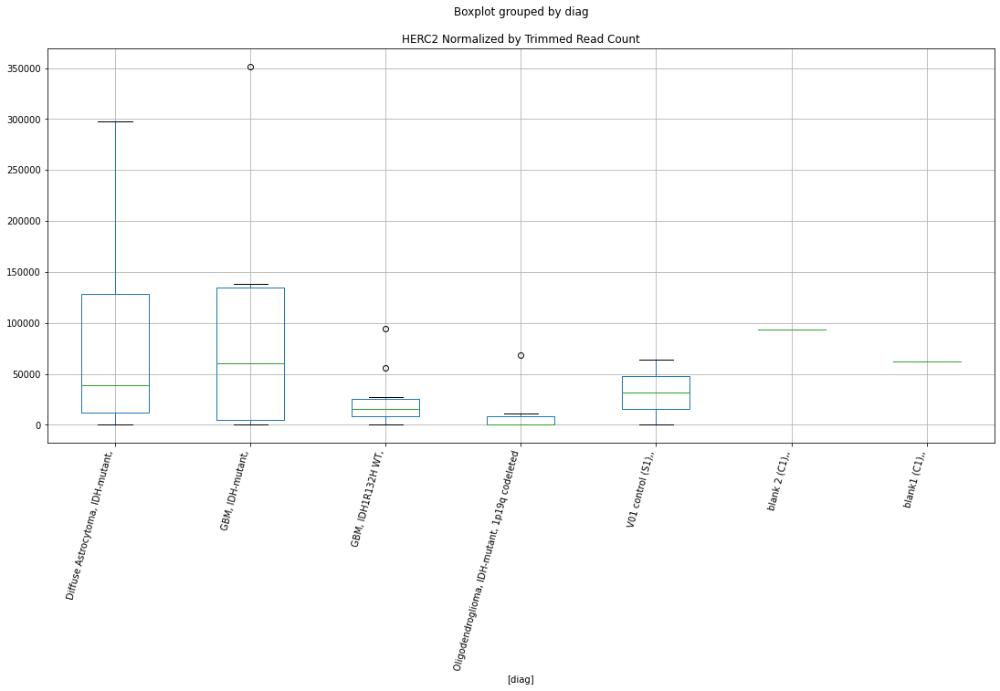

 p : 0.035229881914012356  ( t : 2.276969618553804 ) :  D-plex  :  bbduk2  :  GOLGA6L10
Control and blanks
73     0.0
337    0.0
Name: GOLGA6L10, dtype: float64
205    1790.91
Name: GOLGA6L10, dtype: float64
469    1774.58
Name: GOLGA6L10, dtype: float64


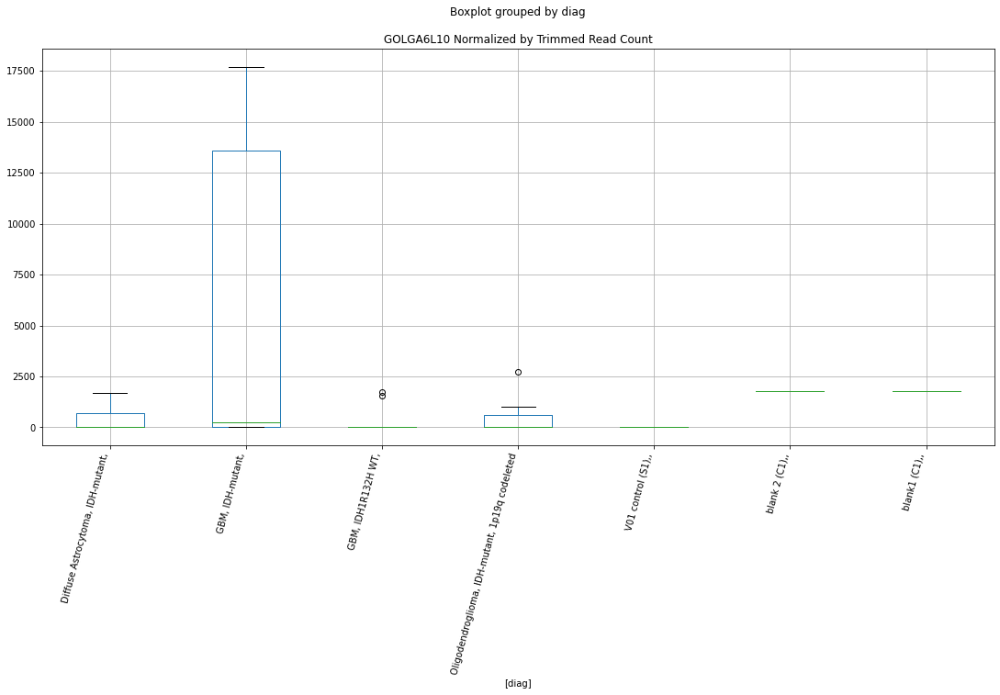

 p : 0.035233636649313296  ( t : 2.2769167798155836 ) :  D-plex  :  cutadapt2  :  HSPG2
Control and blanks
76     4545.69
340       0.00
Name: HSPG2, dtype: float64
208    111106.94
Name: HSPG2, dtype: float64
472    31209.62
Name: HSPG2, dtype: float64


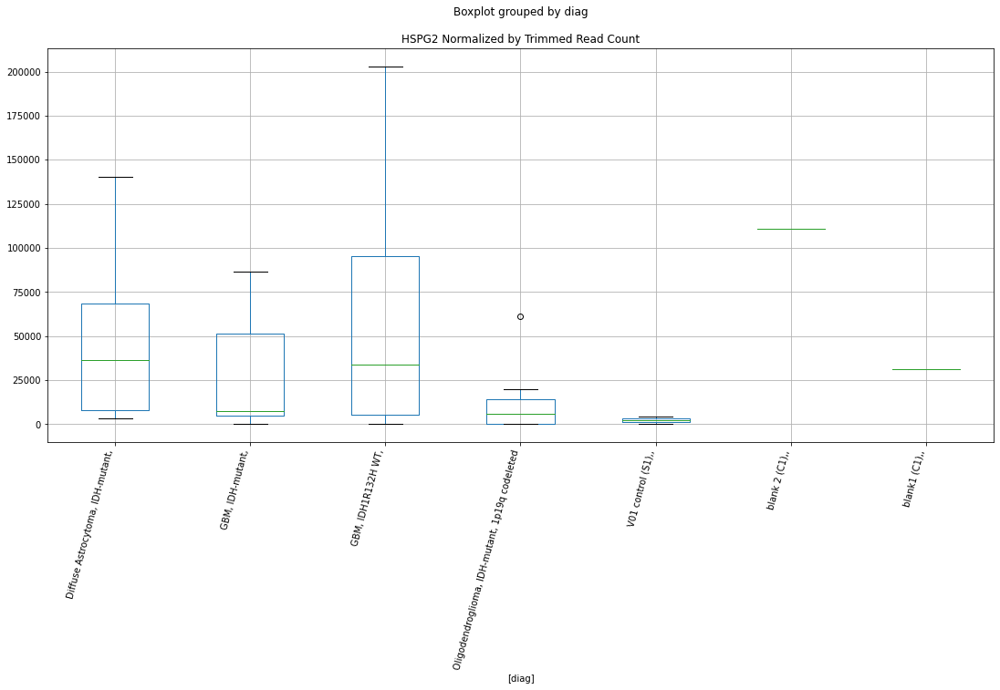

 p : 0.03523908703833565  ( t : 2.276840088157224 ) :  D-plex  :  cutadapt2  :  FAM120C
Control and blanks
76     0.0
340    0.0
Name: FAM120C, dtype: float64
208    3879.92
Name: FAM120C, dtype: float64
472    1733.87
Name: FAM120C, dtype: float64


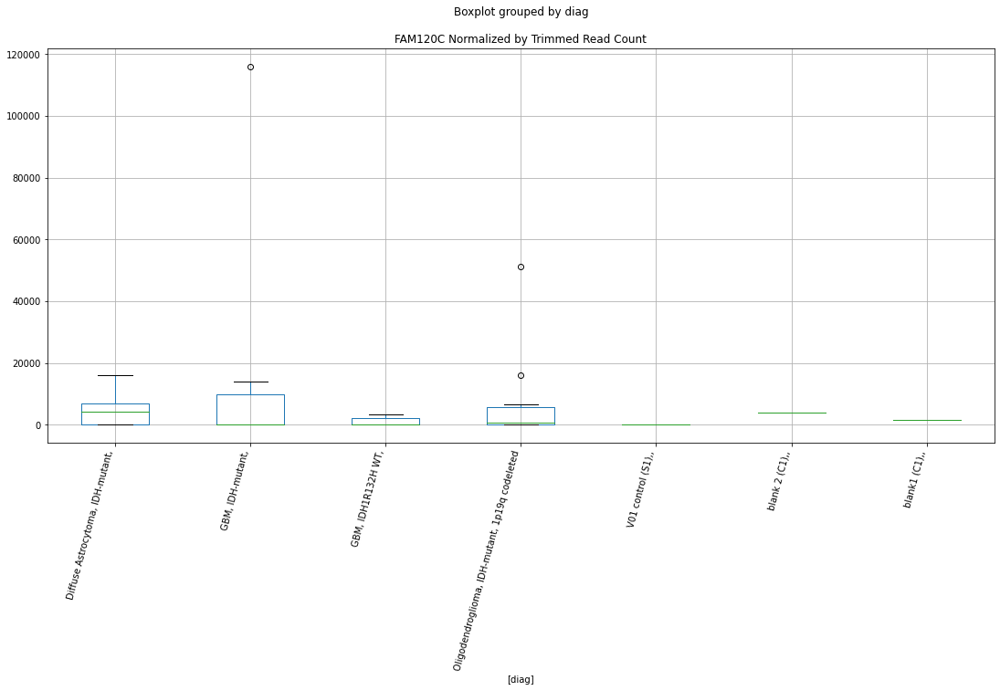

 p : 0.03530701556489606  ( t : 2.275885194929424 ) :  Lexogen  :  cutadapt2  :  GPR157
Control and blanks
82     0.0
346    0.0
Name: GPR157, dtype: float64
214    0.0
Name: GPR157, dtype: float64
478    0.0
Name: GPR157, dtype: float64


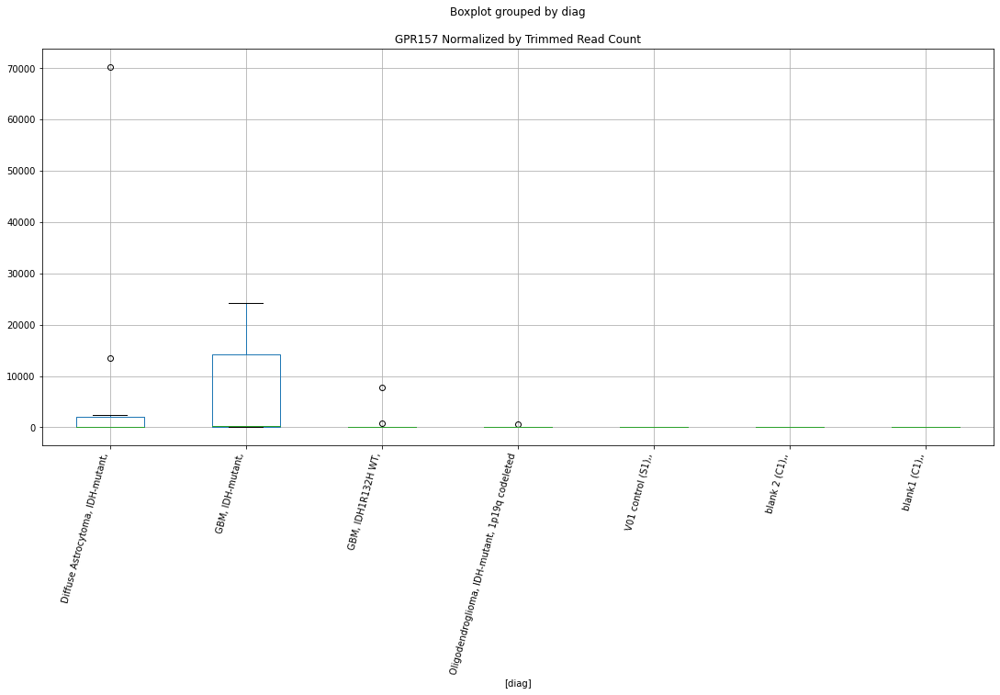

 p : 0.03531477406926622  ( t : 2.275776239293253 ) :  D-plex  :  bbduk2  :  FOXI2
Control and blanks
73     0.0
337    0.0
Name: FOXI2, dtype: float64
205    716.36
Name: FOXI2, dtype: float64
469    4140.69
Name: FOXI2, dtype: float64


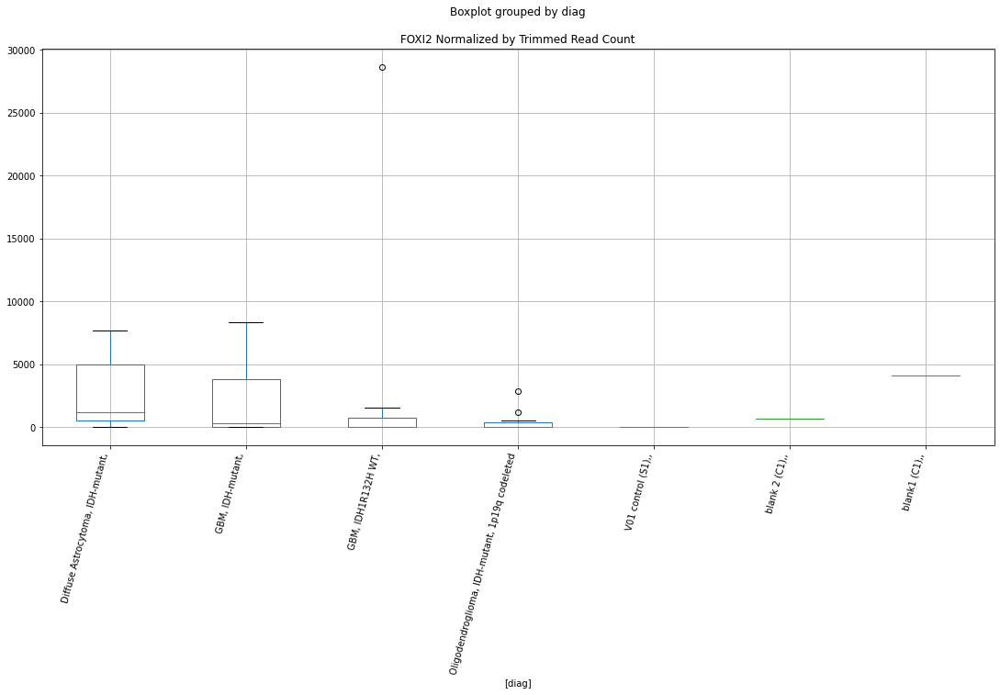

 p : 0.03540757836072972  ( t : 2.2744746669105638 ) :  D-plex  :  cutadapt2  :  GIPC1
Control and blanks
76     307591.37
340         0.00
Name: GIPC1, dtype: float64
208    31215.76
Name: GIPC1, dtype: float64
472    14448.9
Name: GIPC1, dtype: float64


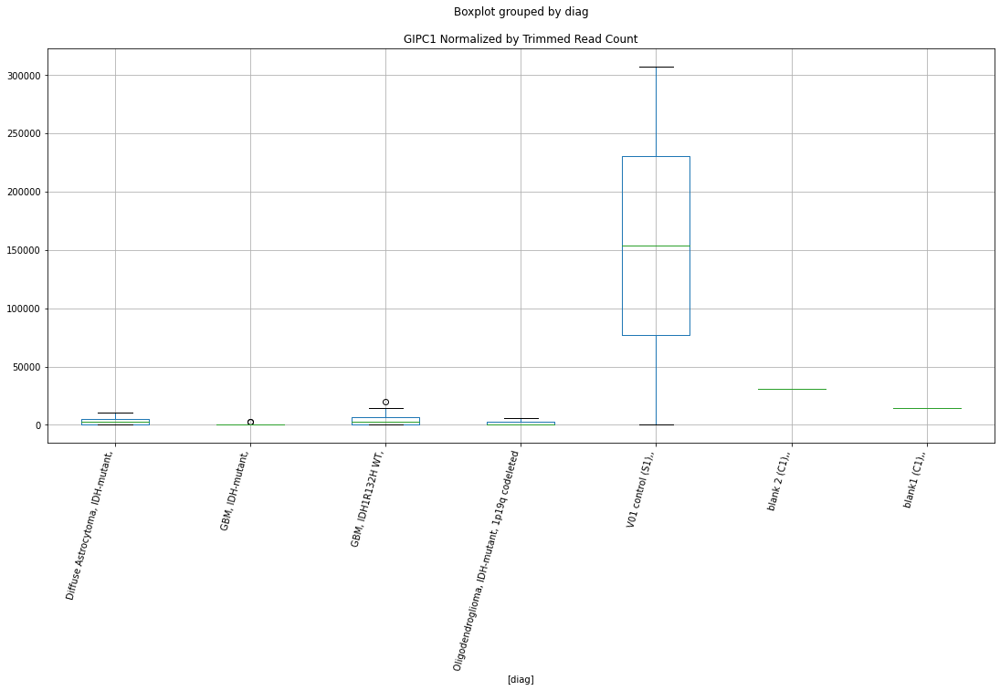

 p : 0.03545704402052238  ( t : 2.2737822038322877 ) :  Lexogen  :  bbduk2  :  FTSJ1
Control and blanks
79       0.00
343    849.26
Name: FTSJ1, dtype: float64
211    10932.25
Name: FTSJ1, dtype: float64
475    0.0
Name: FTSJ1, dtype: float64


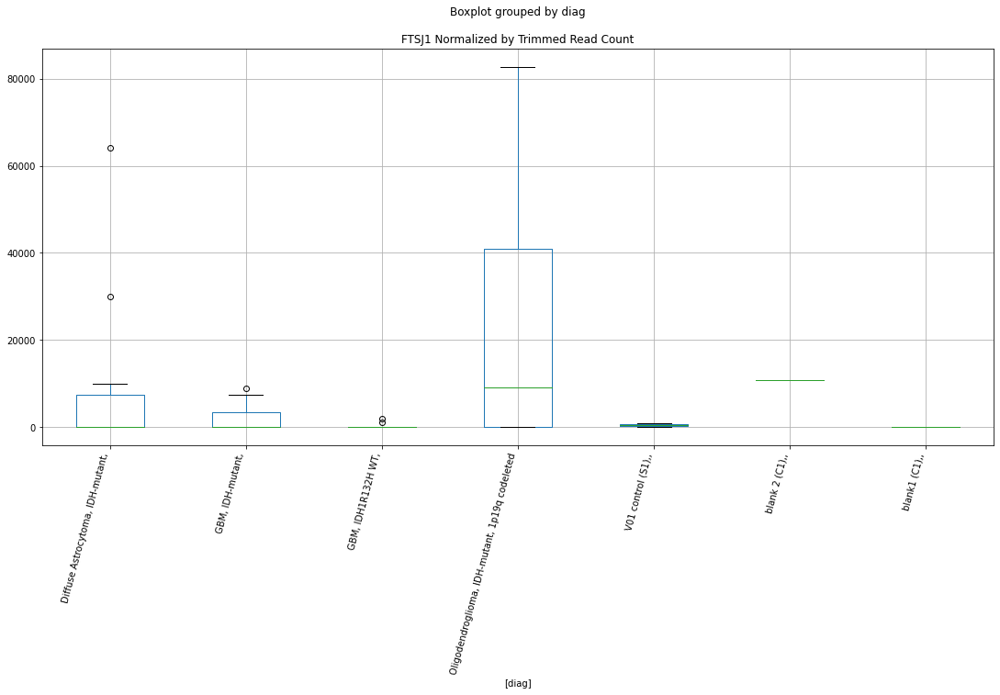

 p : 0.03547767445627398  ( t : 2.273493665153877 ) :  Lexogen  :  cutadapt2  :  FTSJ1
Control and blanks
82       0.00
346    841.74
Name: FTSJ1, dtype: float64
214    10849.06
Name: FTSJ1, dtype: float64
478    0.0
Name: FTSJ1, dtype: float64


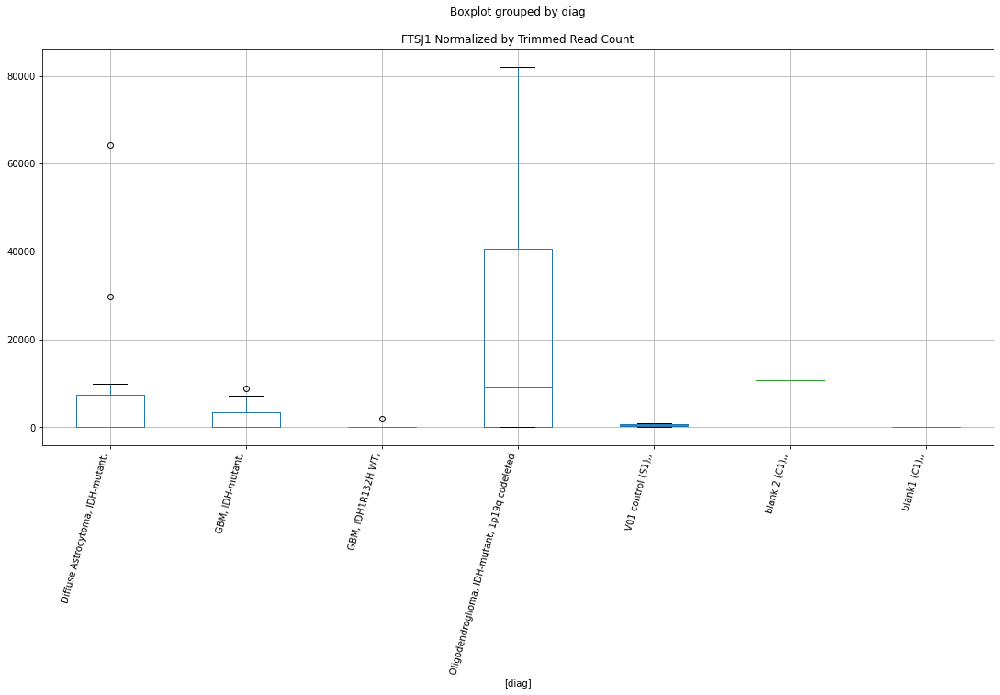

 p : 0.03554811951959033  ( t : 2.272509583922562 ) :  D-plex  :  cutadapt2  :  KRT17P5
Control and blanks
76     0.0
340    0.0
Name: KRT17P5, dtype: float64
208    705.44
Name: KRT17P5, dtype: float64
472    2311.82
Name: KRT17P5, dtype: float64


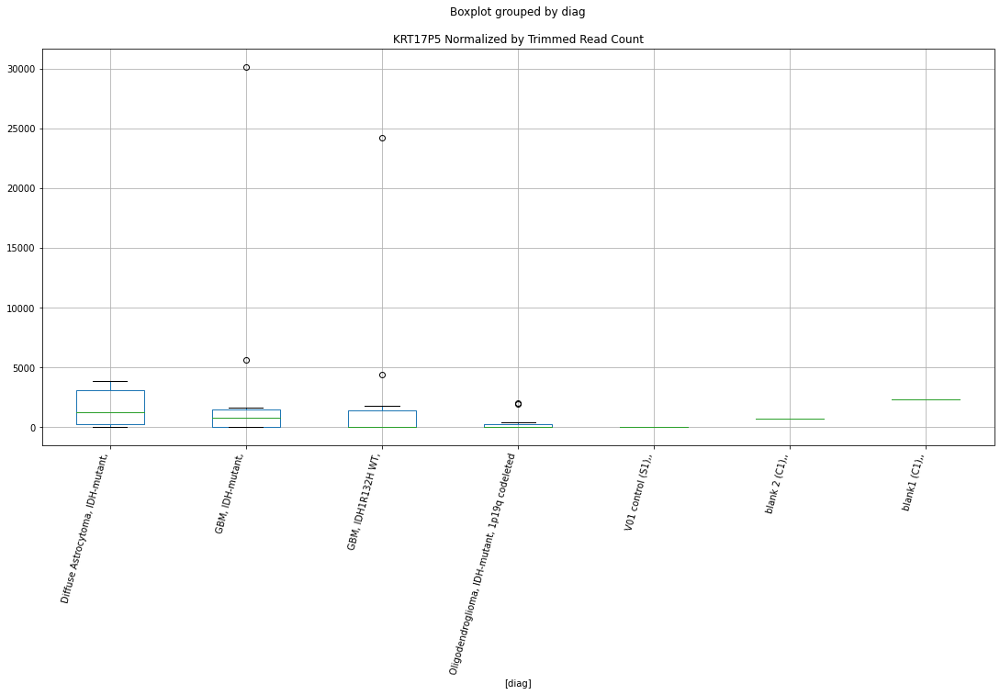

 p : 0.03561737870139281  ( t : 2.271543825439889 ) :  D-plex  :  bbduk2  :  KIF1A
Control and blanks
73     65705.71
337        0.00
Name: KIF1A, dtype: float64
205    7342.73
Name: KIF1A, dtype: float64
469    21294.98
Name: KIF1A, dtype: float64


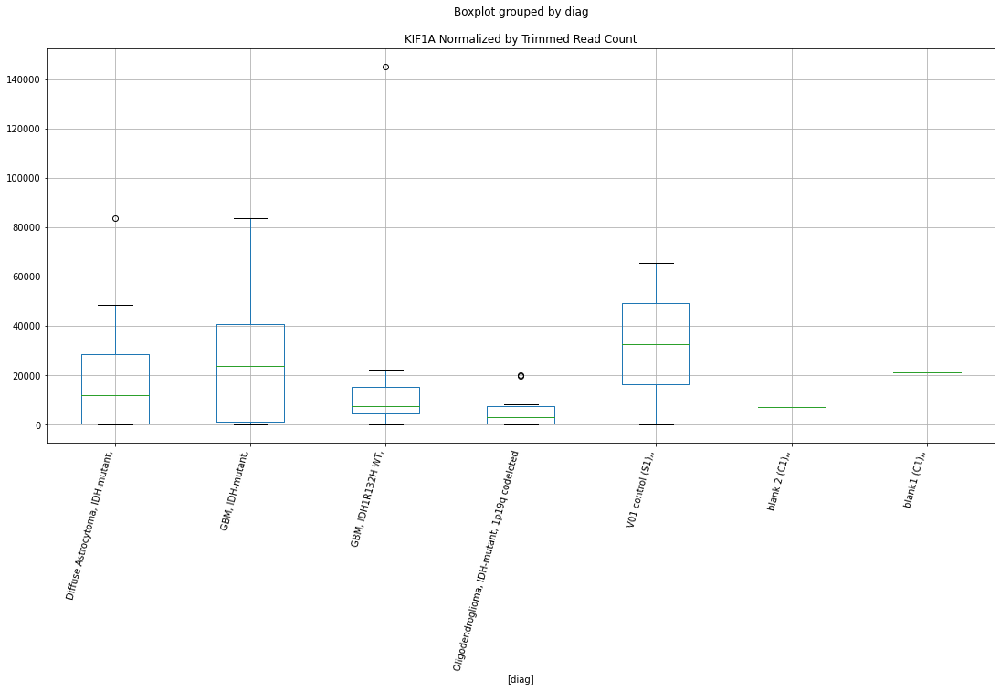

 p : 0.035790650471804436  ( t : 2.2691352880435605 ) :  D-plex  :  cutadapt2  :  GAREM1
Control and blanks
76        0.00
340    5284.39
Name: GAREM1, dtype: float64
208    6348.97
Name: GAREM1, dtype: float64
472    6357.51
Name: GAREM1, dtype: float64


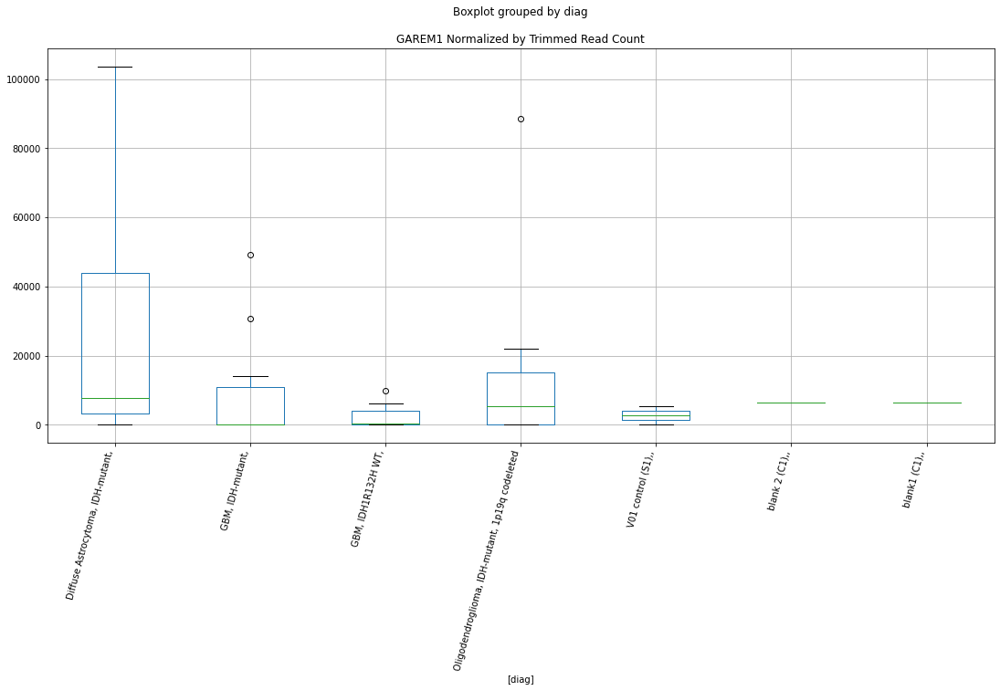

 p : 0.03584780348997877  ( t : 2.2683432053966315 ) :  D-plex  :  cutadapt2  :  GRAP2
Control and blanks
76     0.0
340    0.0
Name: GRAP2, dtype: float64
208    6348.97
Name: GRAP2, dtype: float64
472    6935.47
Name: GRAP2, dtype: float64


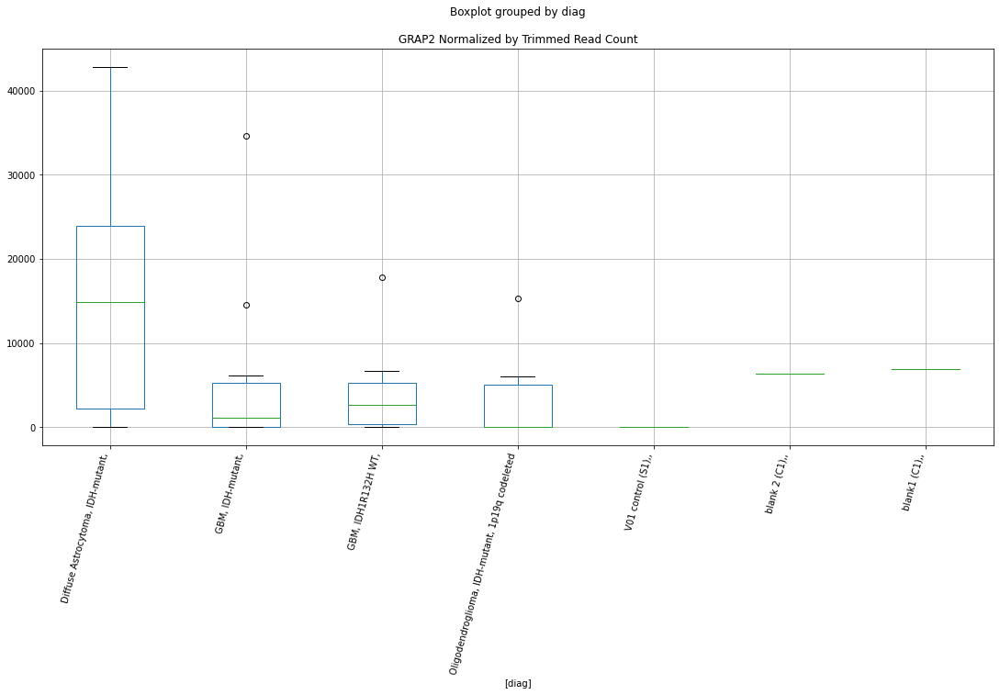

 p : 0.03586772817112106  ( t : 2.26806734401481 ) :  D-plex  :  bbduk2  :  KCNG4
Control and blanks
73     0.0
337    0.0
Name: KCNG4, dtype: float64
205    358.18
Name: KCNG4, dtype: float64
469    0.0
Name: KCNG4, dtype: float64


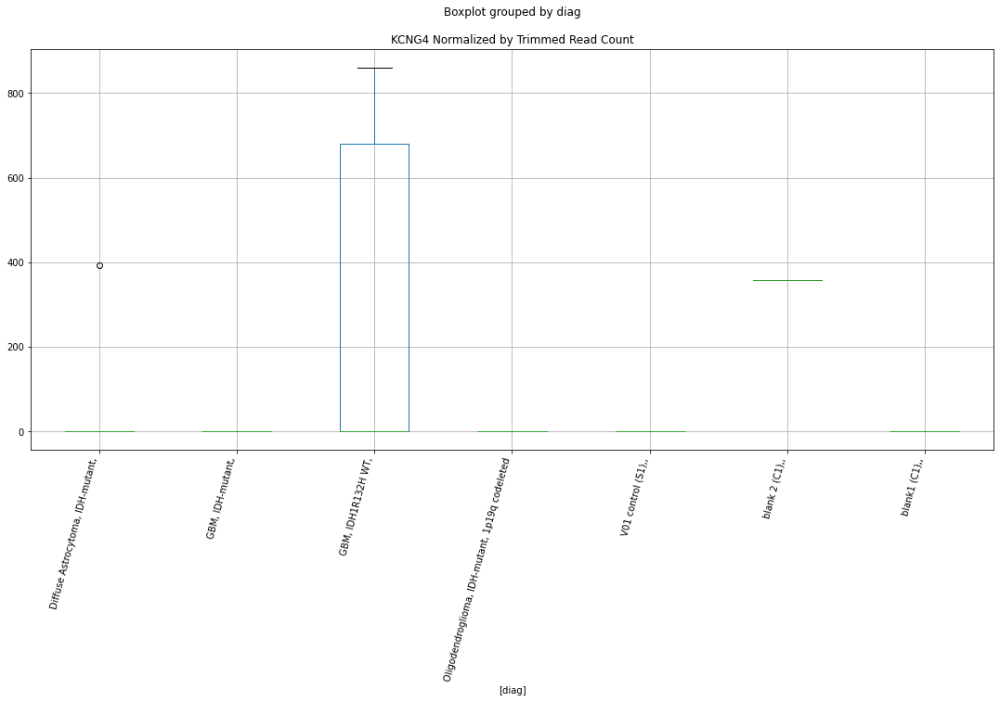

 p : 0.03587939747533208  ( t : 2.267905845825228 ) :  D-plex  :  bbduk2  :  KLHL34
Control and blanks
73       0.00
337    890.16
Name: KLHL34, dtype: float64
205    3581.82
Name: KLHL34, dtype: float64
469    5915.27
Name: KLHL34, dtype: float64


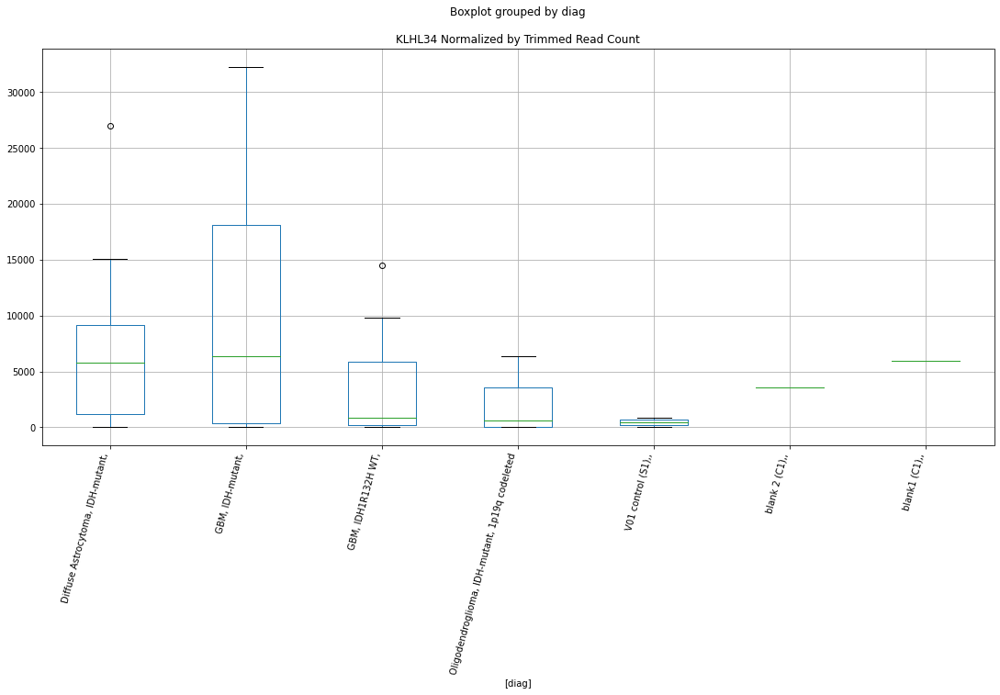

 p : 0.03588054841238575  ( t : 2.267889919978327 ) :  D-plex  :  bbduk2  :  HSPG2
Control and blanks
73     4638.05
337       0.00
Name: HSPG2, dtype: float64
205    114976.39
Name: HSPG2, dtype: float64
469    31942.48
Name: HSPG2, dtype: float64


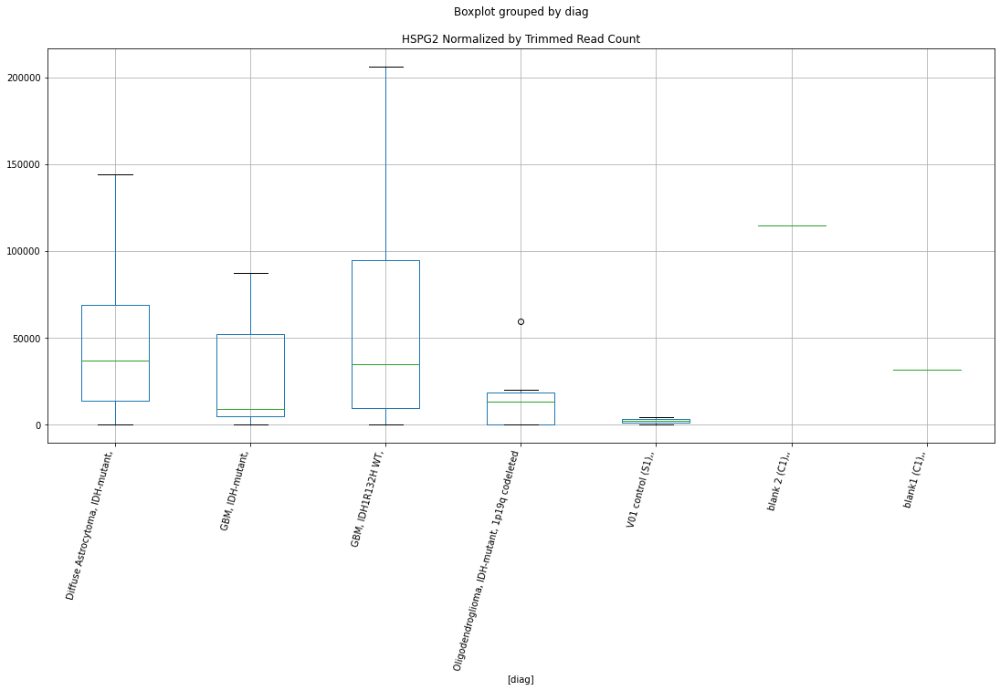

 p : 0.03588626746999482  ( t : 2.2678107907364913 ) :  Lexogen  :  cutadapt2  :  IGSF9
Control and blanks
82     0.0
346    0.0
Name: IGSF9, dtype: float64
214    0.0
Name: IGSF9, dtype: float64
478    0.0
Name: IGSF9, dtype: float64


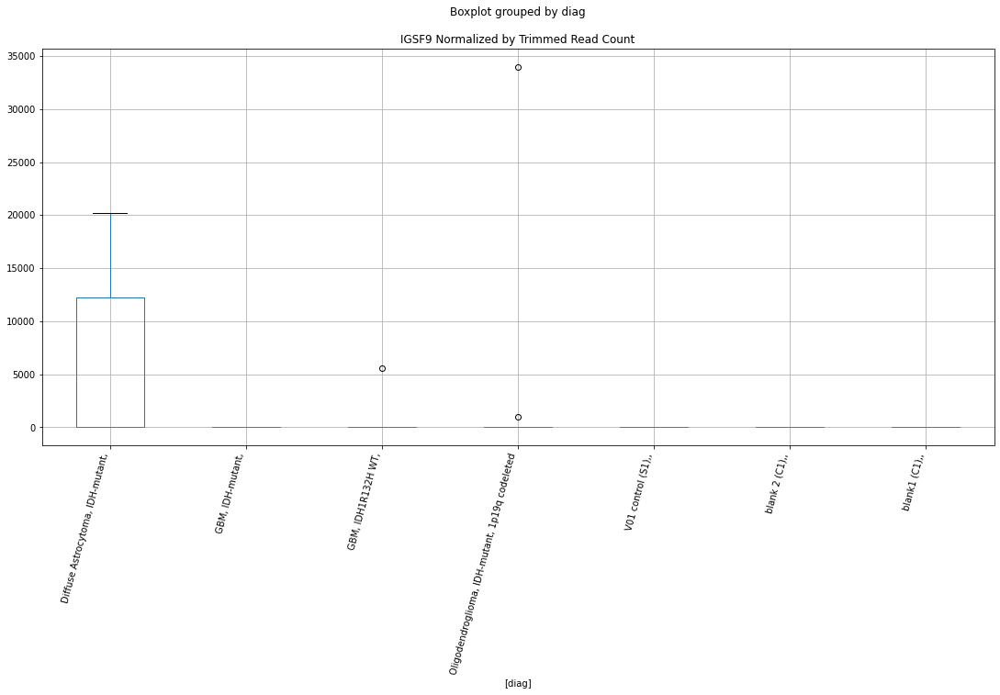

 p : 0.03594201601700688  ( t : 2.26704006035872 ) :  D-plex  :  bbduk2  :  FRRS1
Control and blanks
73     83484.91
337        0.00
Name: FRRS1, dtype: float64
205    358.18
Name: FRRS1, dtype: float64
469    0.0
Name: FRRS1, dtype: float64


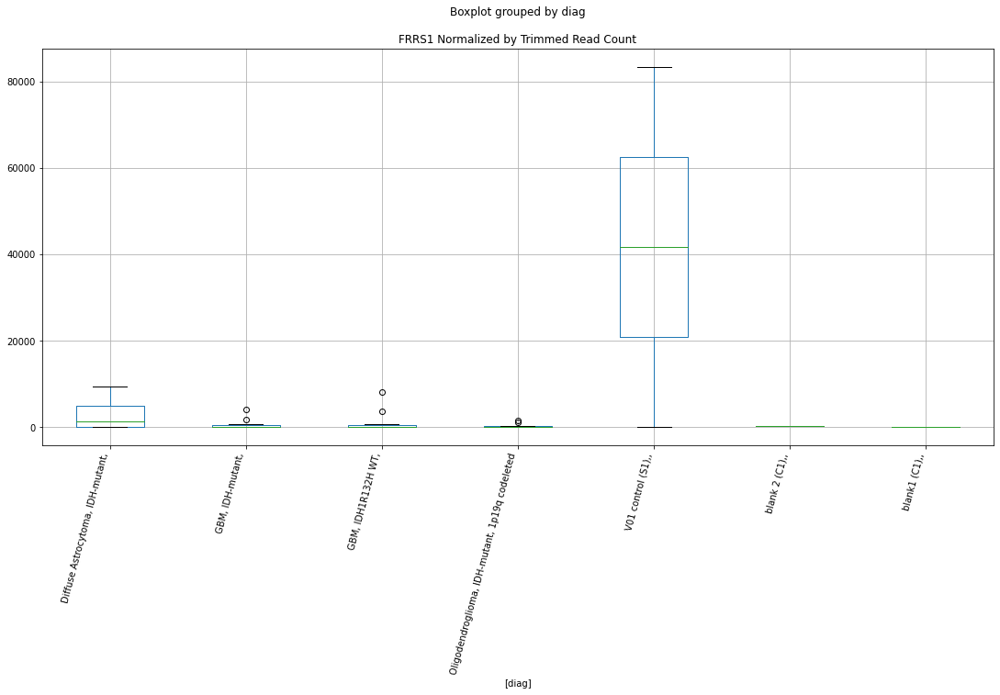

 p : 0.035950737329158815  ( t : 2.266919587134573 ) :  D-plex  :  cutadapt2  :  HLA-DRB6
Control and blanks
76     757.61
340      0.00
Name: HLA-DRB6, dtype: float64
208    529.08
Name: HLA-DRB6, dtype: float64
472    1155.91
Name: HLA-DRB6, dtype: float64


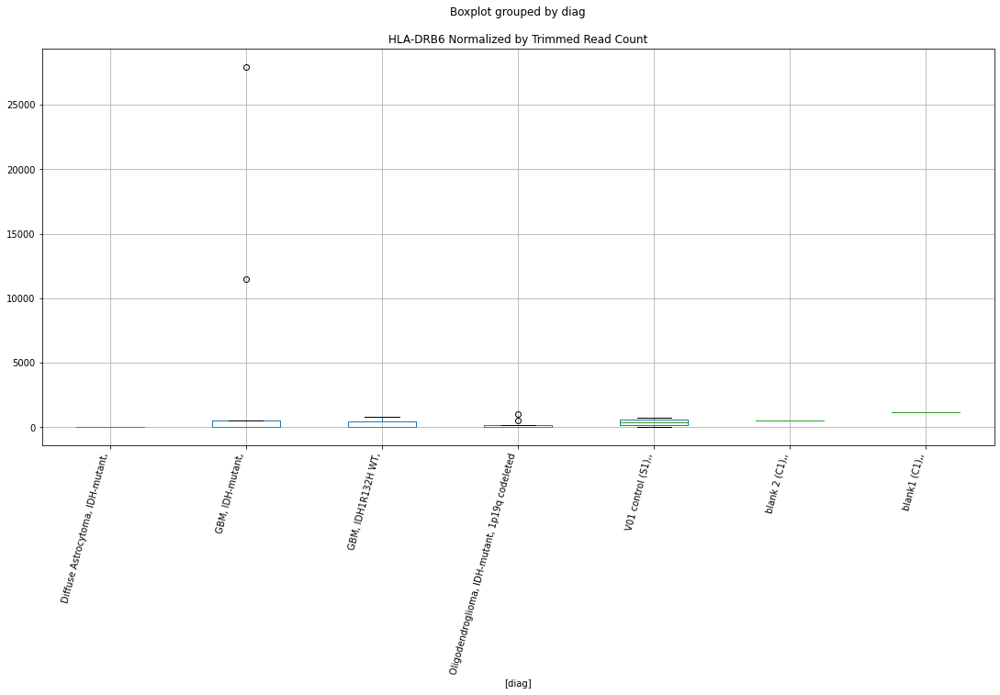

 p : 0.03600773425754924  ( t : 2.266132915547944 ) :  D-plex  :  cutadapt2  :  FAM189B
Control and blanks
76     0.0
340    0.0
Name: FAM189B, dtype: float64
208    7407.13
Name: FAM189B, dtype: float64
472    8091.38
Name: FAM189B, dtype: float64


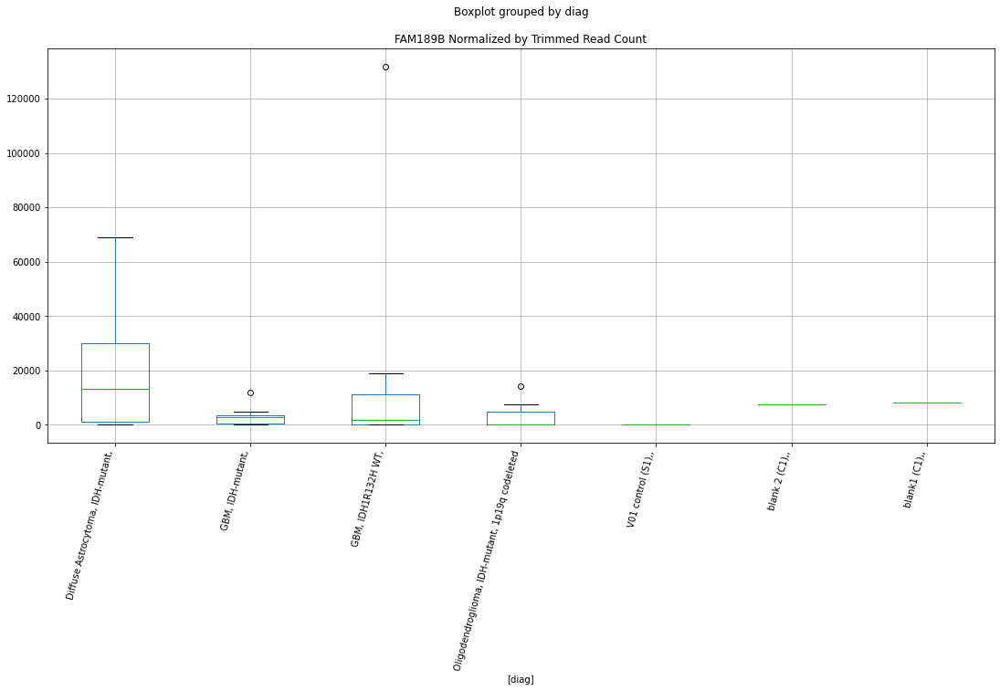

 p : 0.03605638298041901  ( t : 2.2654623757428967 ) :  Lexogen  :  bbduk2  :  ECI1
Control and blanks
79     0.0
343    0.0
Name: ECI1, dtype: float64
211    0.0
Name: ECI1, dtype: float64
475    0.0
Name: ECI1, dtype: float64


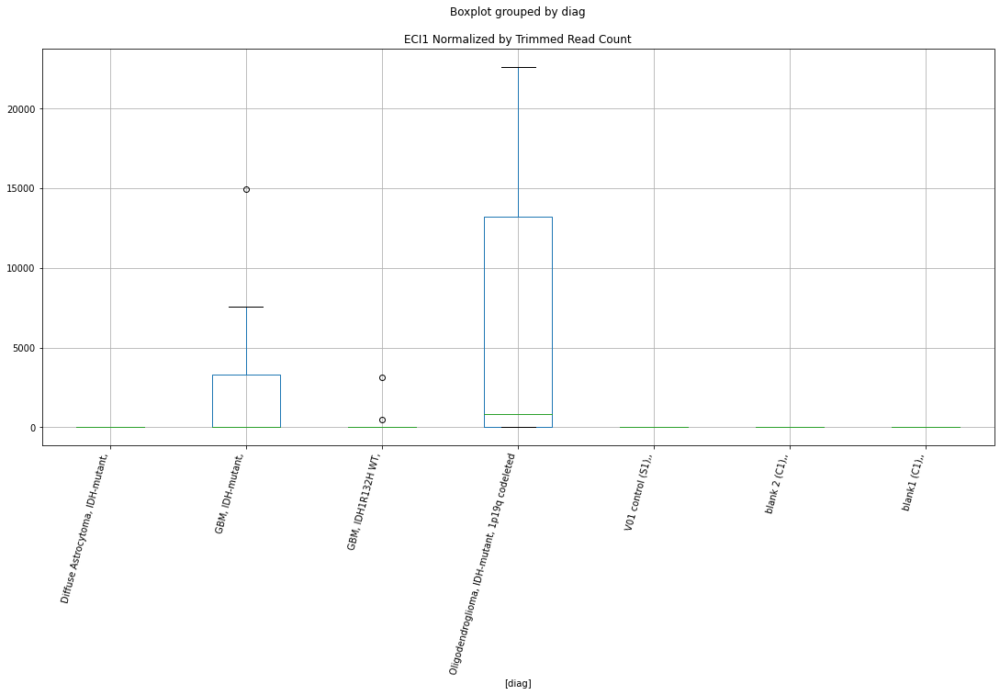

 p : 0.03610593265947024  ( t : 2.264780276733753 ) :  Lexogen  :  bbduk2  :  DMRTA2
Control and blanks
79       0.00
343    212.31
Name: DMRTA2, dtype: float64
211    0.0
Name: DMRTA2, dtype: float64
475    0.0
Name: DMRTA2, dtype: float64


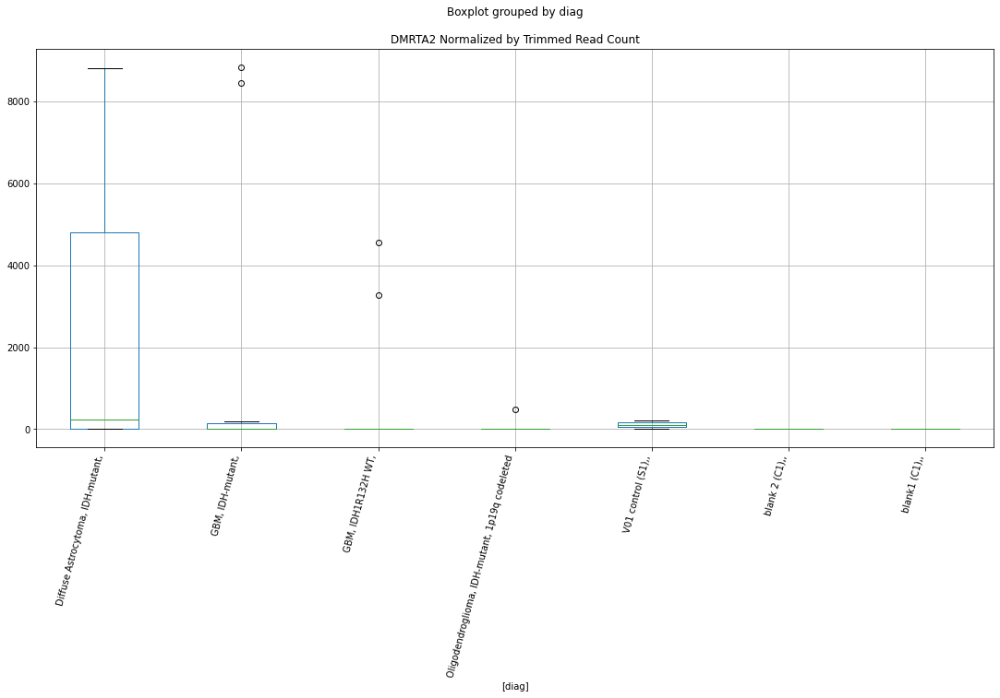

 p : 0.03613315252302445  ( t : 2.2644059371668264 ) :  Lexogen  :  cutadapt2  :  FAT4
Control and blanks
82       0.00
346    841.74
Name: FAT4, dtype: float64
214    0.0
Name: FAT4, dtype: float64
478    0.0
Name: FAT4, dtype: float64


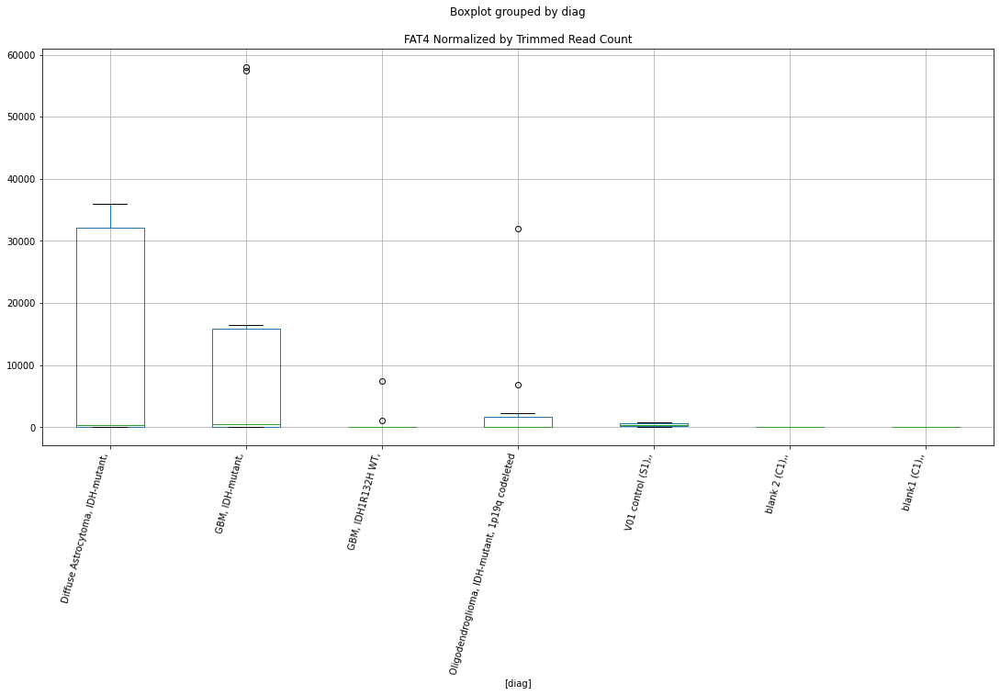

 p : 0.036141156050666014  ( t : 2.26429591870117 ) :  Lexogen  :  cutadapt2  :  HK1
Control and blanks
82     0.0
346    0.0
Name: HK1, dtype: float64
214    0.0
Name: HK1, dtype: float64
478    3086.99
Name: HK1, dtype: float64


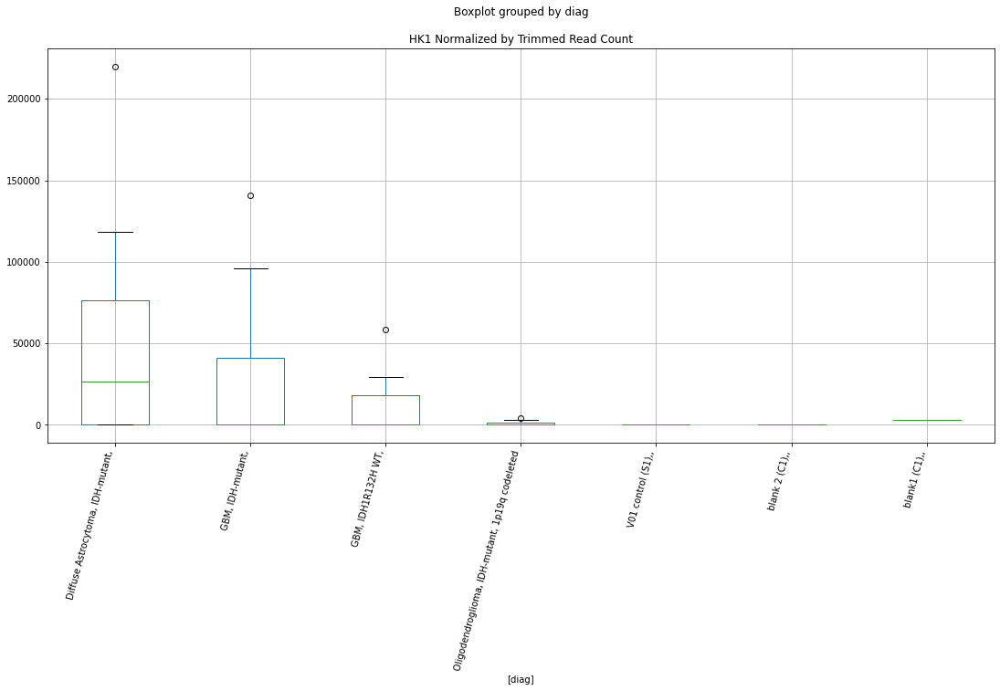

 p : 0.036173031198397765  ( t : 2.2638579783210466 ) :  D-plex  :  bbduk2  :  HLA-DRB6
Control and blanks
73     773.01
337      0.00
Name: HLA-DRB6, dtype: float64
205    537.27
Name: HLA-DRB6, dtype: float64
469    1183.05
Name: HLA-DRB6, dtype: float64


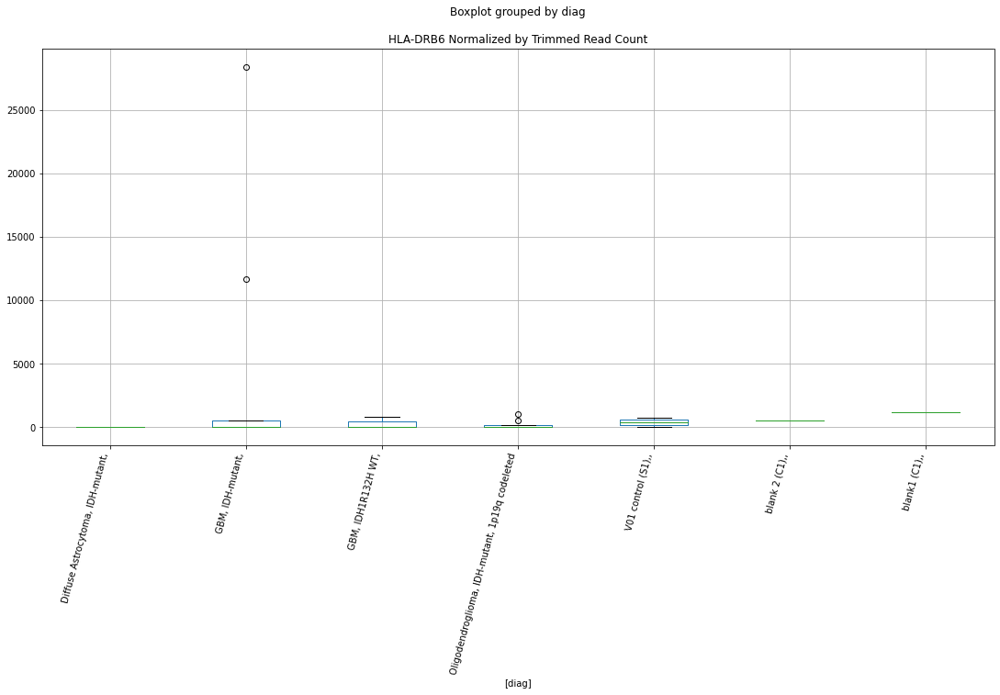

 p : 0.03617350583703359  ( t : 2.263851459840702 ) :  D-plex  :  cutadapt2  :  DUSP8
Control and blanks
76     0.0
340    0.0
Name: DUSP8, dtype: float64
208    529.08
Name: DUSP8, dtype: float64
472    0.0
Name: DUSP8, dtype: float64


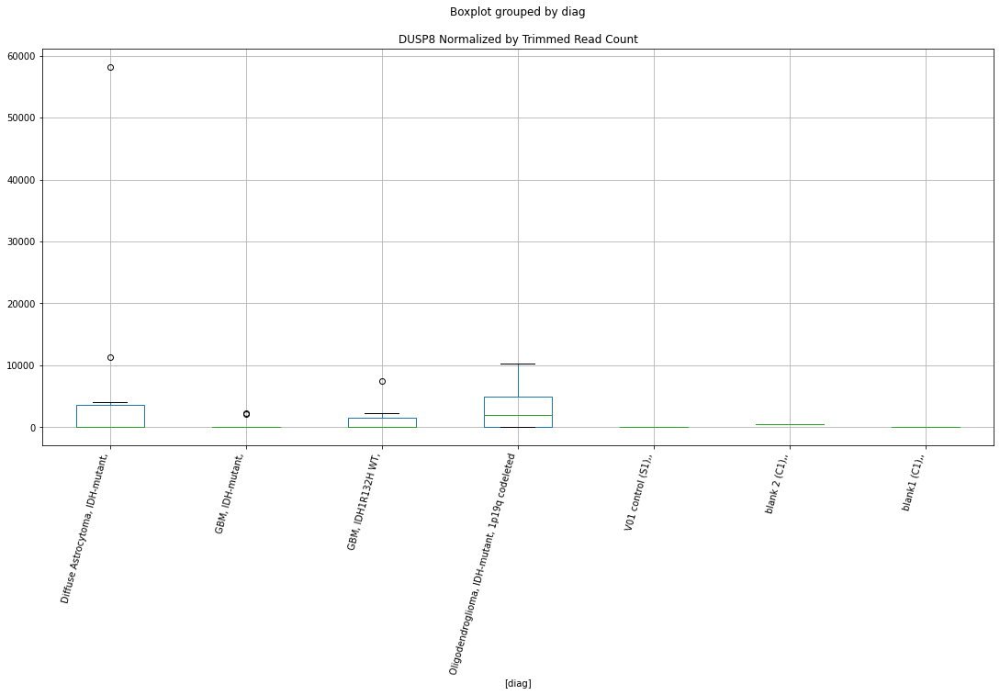

 p : 0.03618949138730006  ( t : 2.2636319673955825 ) :  D-plex  :  cutadapt2  :  INTS5
Control and blanks
76     0.0
340    0.0
Name: INTS5, dtype: float64
208    529.08
Name: INTS5, dtype: float64
472    1733.87
Name: INTS5, dtype: float64


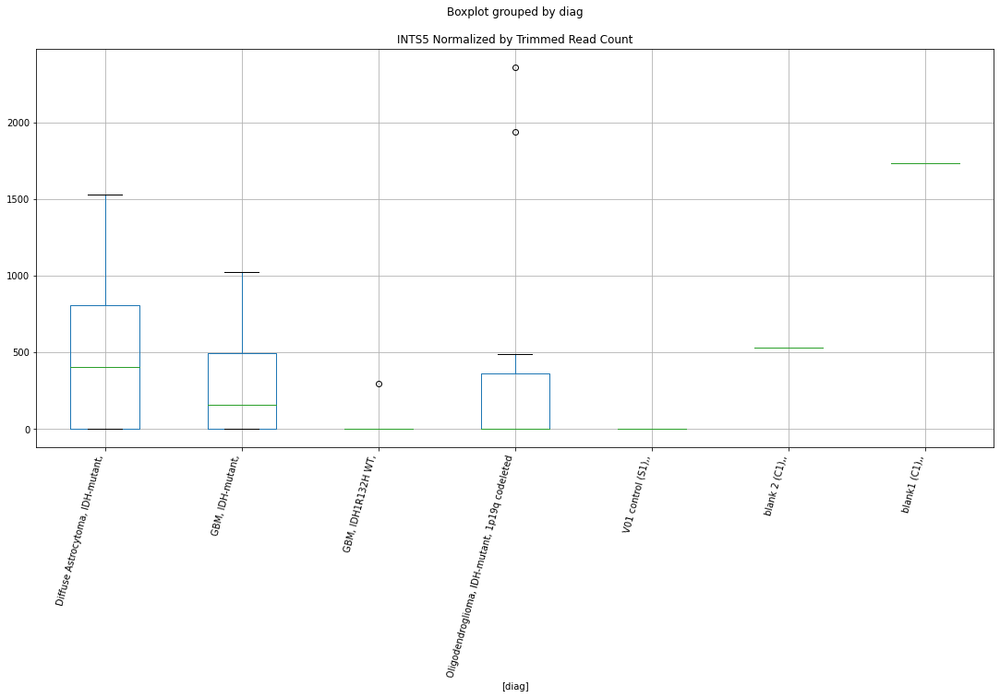

 p : 0.03624204539351624  ( t : 2.262910996111038 ) :  D-plex  :  cutadapt2  :  HERC2
Control and blanks
76     63639.59
340        0.00
Name: HERC2, dtype: float64
208    93470.92
Name: HERC2, dtype: float64
472    62419.23
Name: HERC2, dtype: float64


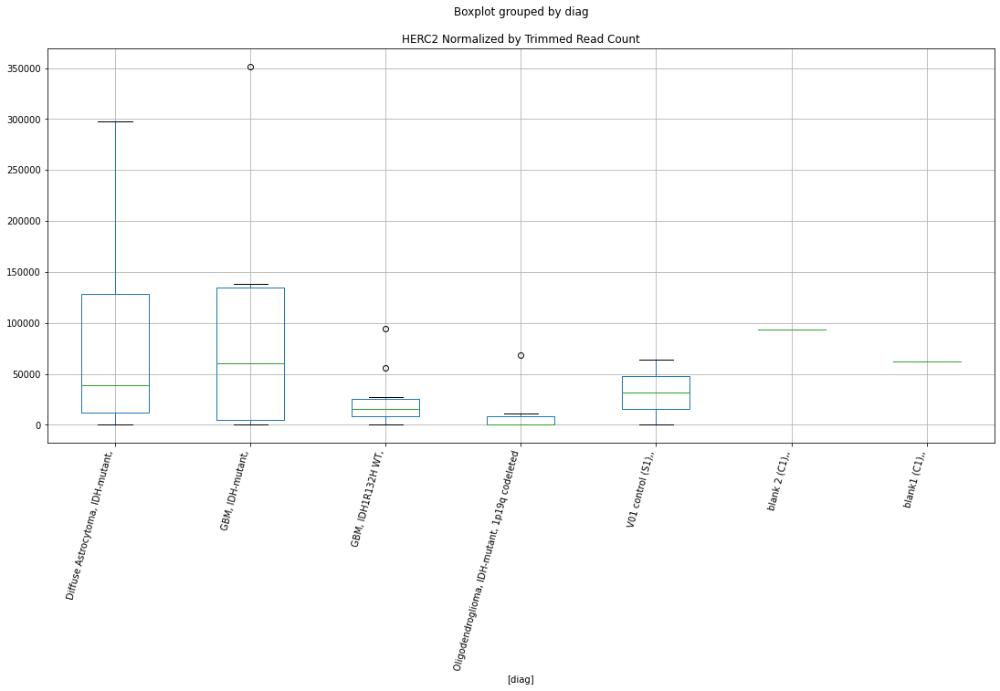

 p : 0.036242345530441214  ( t : 2.262906881405234 ) :  D-plex  :  bbduk2  :  KRT17P5
Control and blanks
73     0.0
337    0.0
Name: KRT17P5, dtype: float64
205    716.36
Name: KRT17P5, dtype: float64
469    2366.11
Name: KRT17P5, dtype: float64


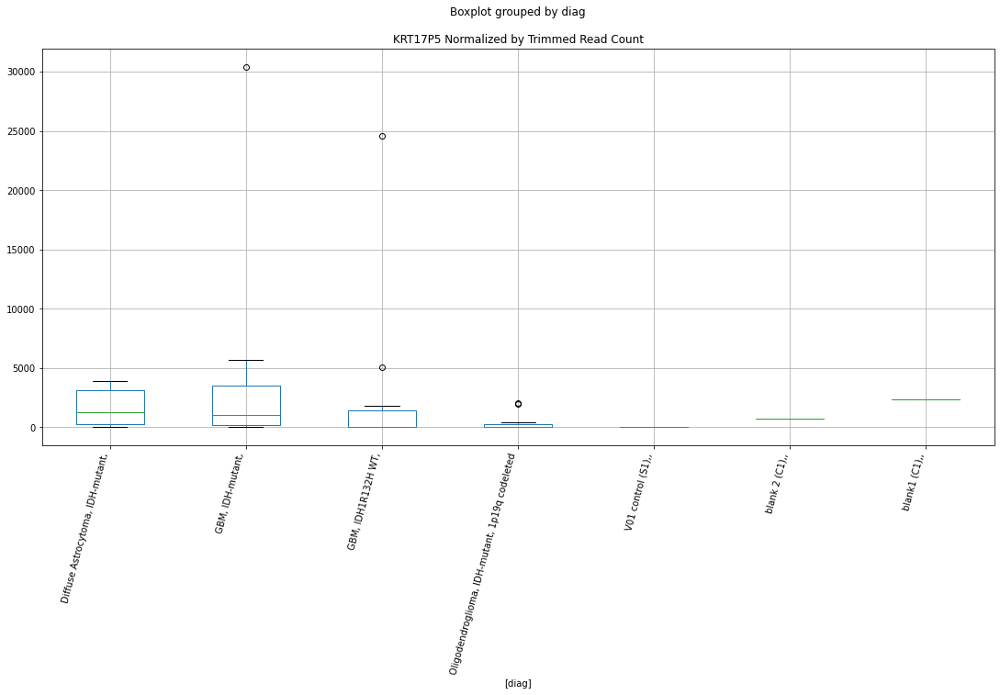

 p : 0.03626588106380535  ( t : 2.262584320678643 ) :  D-plex  :  cutadapt2  :  KCTD8
Control and blanks
76        0.00
340    1761.46
Name: KCTD8, dtype: float64
208    5467.17
Name: KCTD8, dtype: float64
472    4045.69
Name: KCTD8, dtype: float64


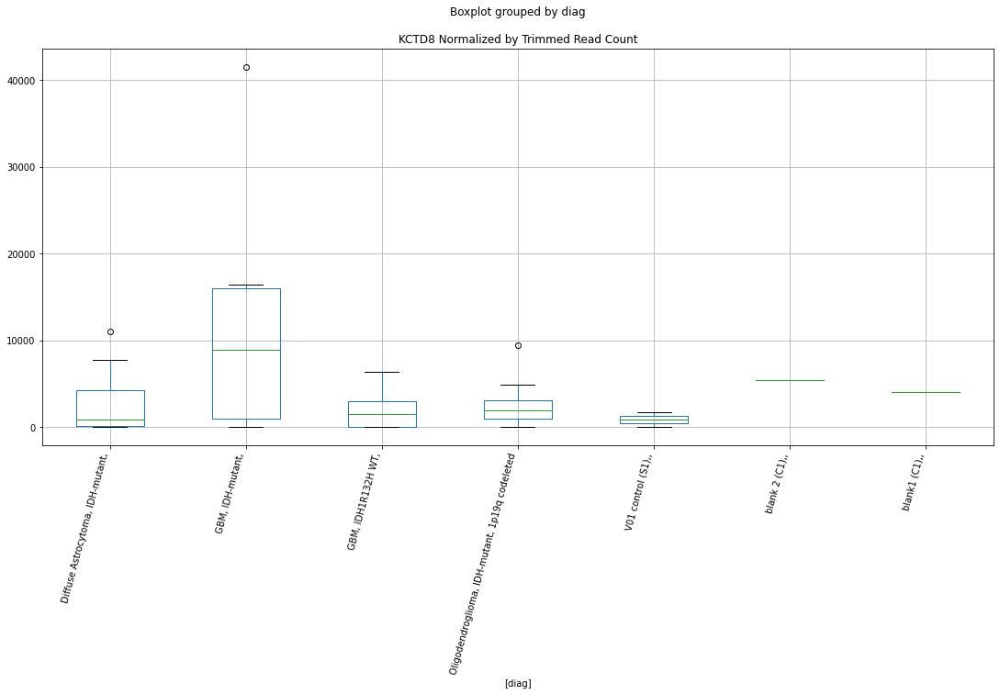

 p : 0.036276774614732755  ( t : 2.262435087147193 ) :  D-plex  :  bbduk2  :  GABRB3
Control and blanks
73     0.0
337    0.0
Name: GABRB3, dtype: float64
205    11820.0
Name: GABRB3, dtype: float64
469    8281.38
Name: GABRB3, dtype: float64


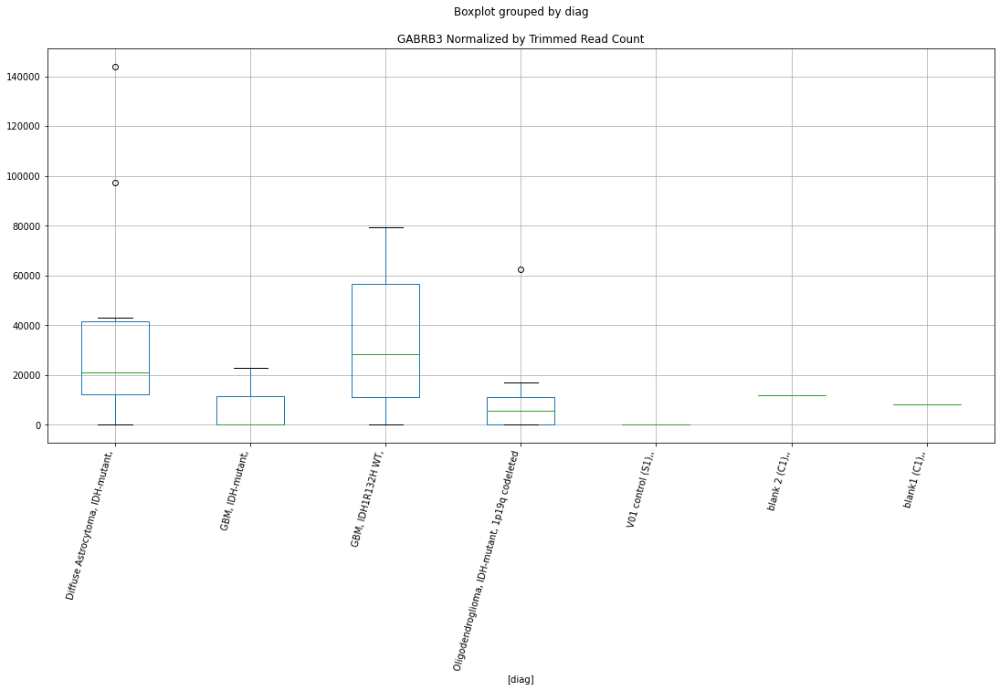

 p : 0.036284756587140345  ( t : 2.2623257663532863 ) :  D-plex  :  bbduk2  :  GOLGA6L10
Control and blanks
73     0.0
337    0.0
Name: GOLGA6L10, dtype: float64
205    1790.91
Name: GOLGA6L10, dtype: float64
469    1774.58
Name: GOLGA6L10, dtype: float64


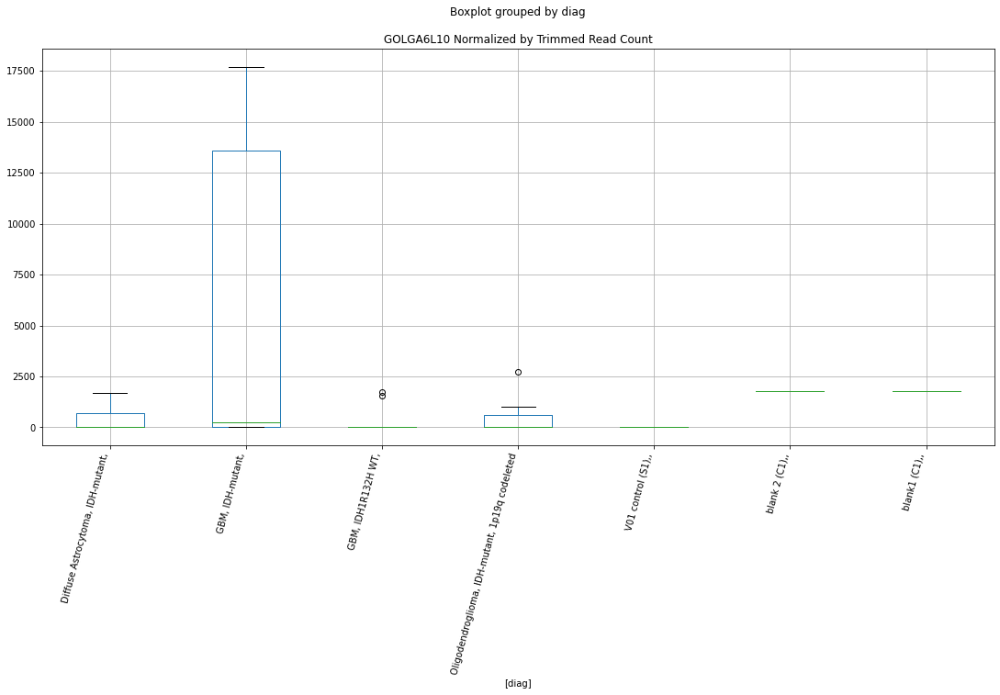

 p : 0.03639817864836691  ( t : 2.2607747382850327 ) :  D-plex  :  cutadapt2  :  FOXB1
Control and blanks
76     0.0
340    0.0
Name: FOXB1, dtype: float64
208    1234.52
Name: FOXB1, dtype: float64
472    2311.82
Name: FOXB1, dtype: float64


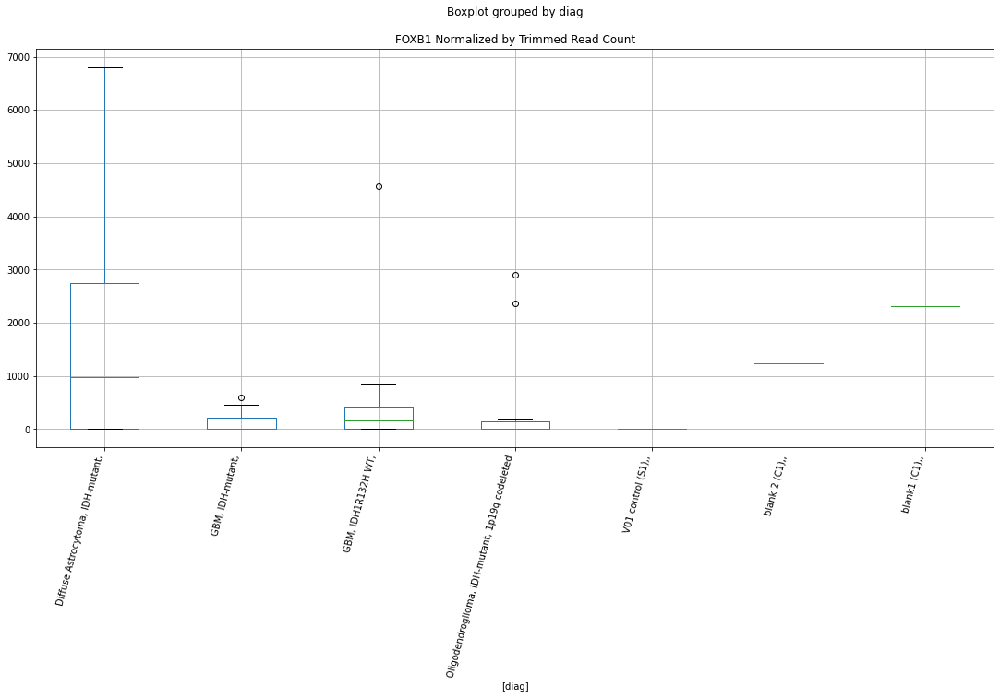

 p : 0.03640771277759208  ( t : 2.2606445641493065 ) :  Lexogen  :  bbduk2  :  LARP4
Control and blanks
79     0.0
343    0.0
Name: LARP4, dtype: float64
211    0.0
Name: LARP4, dtype: float64
475    0.0
Name: LARP4, dtype: float64


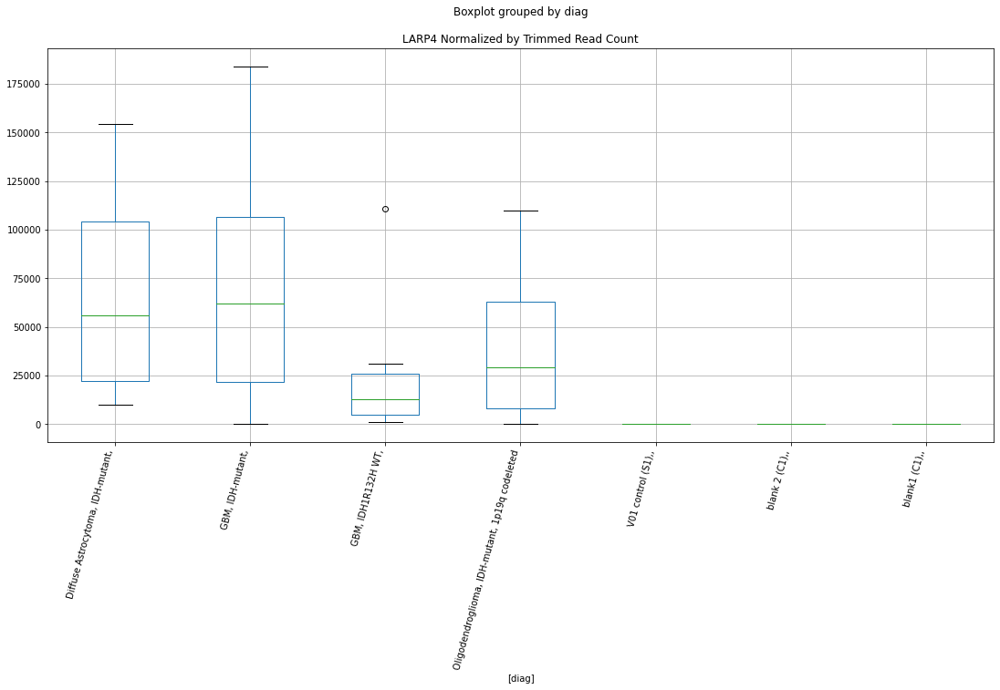

 p : 0.03647047928856966  ( t : 2.25978836743767 ) :  D-plex  :  cutadapt2  :  GABRB3
Control and blanks
76     0.0
340    0.0
Name: GABRB3, dtype: float64
208    11639.77
Name: GABRB3, dtype: float64
472    7513.43
Name: GABRB3, dtype: float64


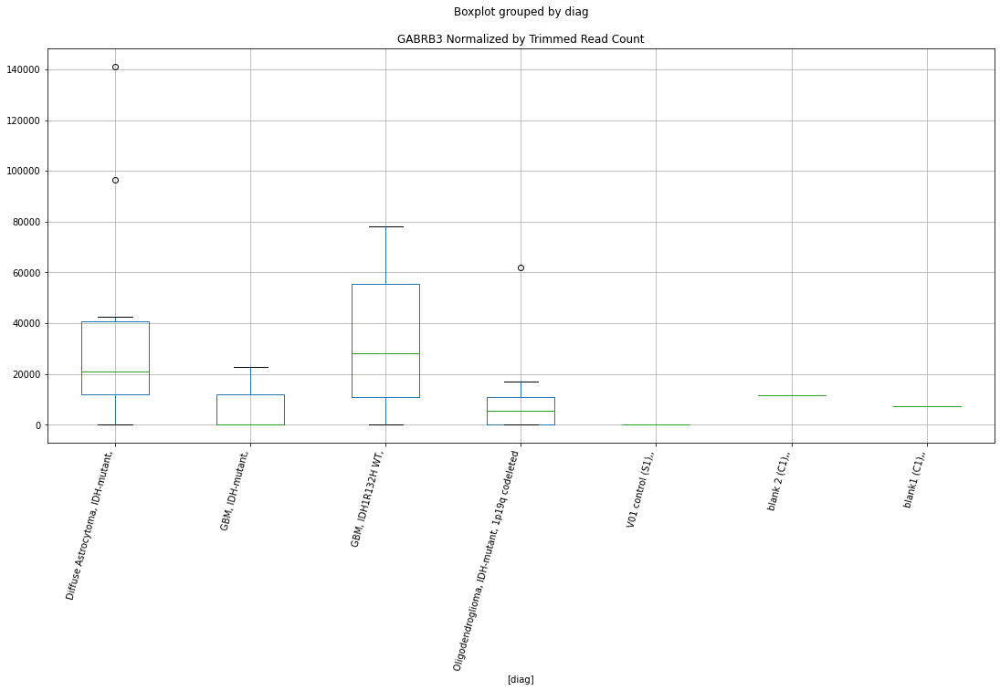

 p : 0.03652613607596558  ( t : 2.25903029212286 ) :  D-plex  :  cutadapt2  :  KLHL34
Control and blanks
76       0.00
340    880.73
Name: KLHL34, dtype: float64
208    3527.2
Name: KLHL34, dtype: float64
472    5779.56
Name: KLHL34, dtype: float64


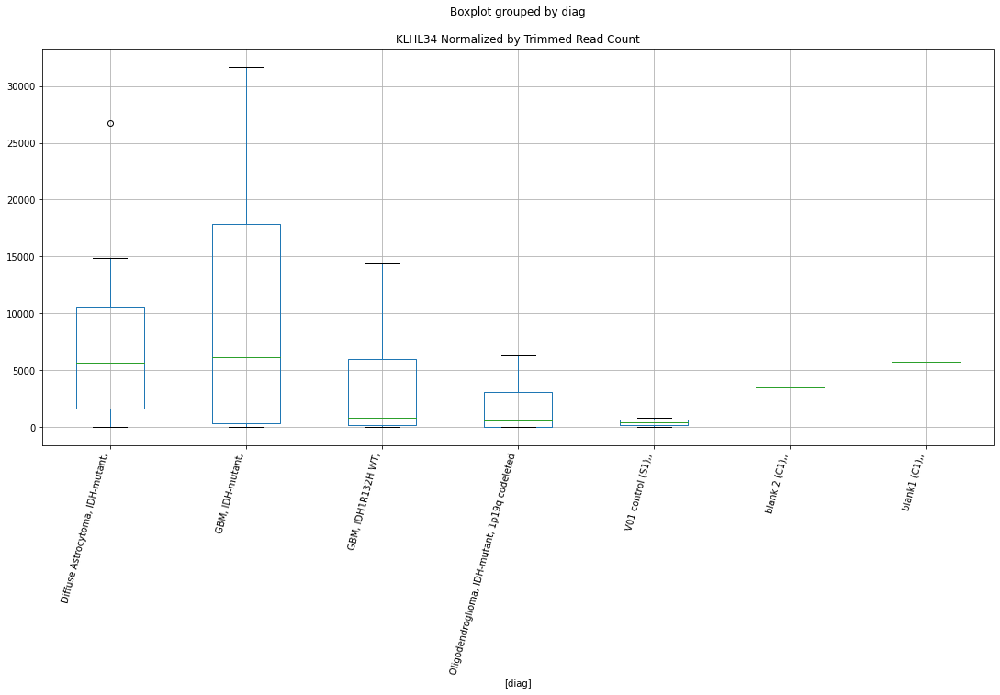

 p : 0.036529298505496174  ( t : 2.2589872501759793 ) :  D-plex  :  bbduk2  :  GRAP2
Control and blanks
73     0.0
337    0.0
Name: GRAP2, dtype: float64
205    6447.27
Name: GRAP2, dtype: float64
469    7098.33
Name: GRAP2, dtype: float64


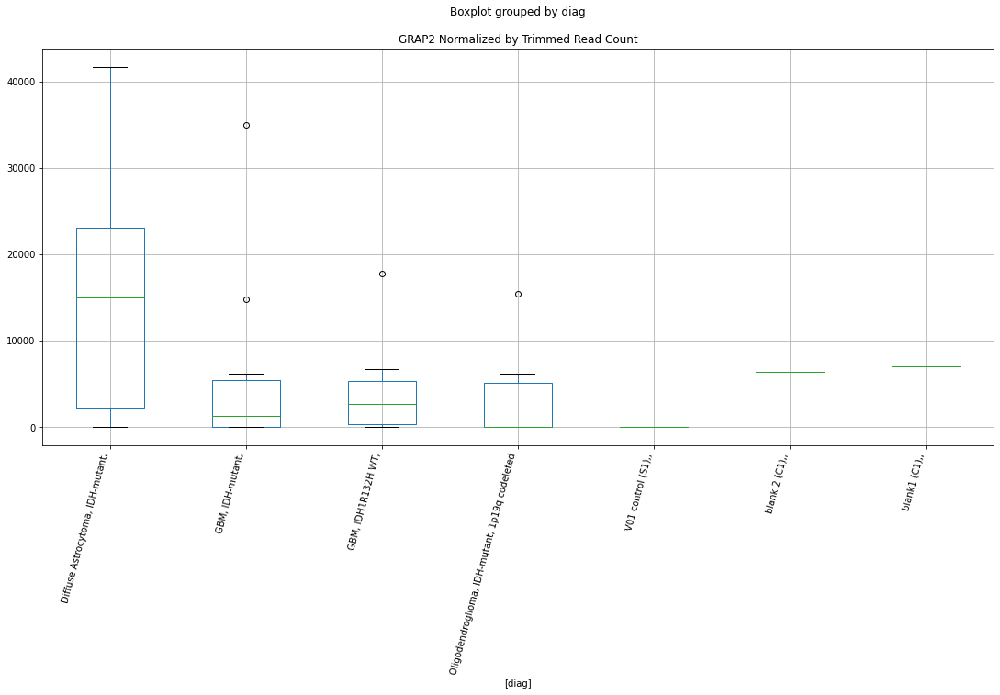

 p : 0.03655250971225121  ( t : 2.2586714415401605 ) :  Lexogen  :  bbduk2  :  HK1
Control and blanks
79     0.0
343    0.0
Name: HK1, dtype: float64
211    0.0
Name: HK1, dtype: float64
475    3113.7
Name: HK1, dtype: float64


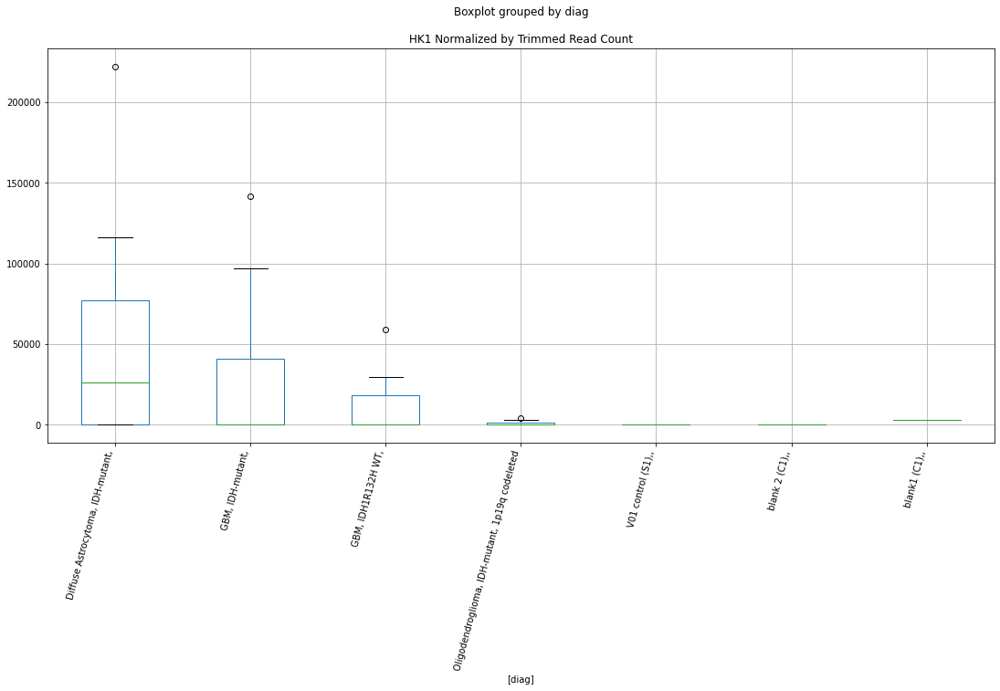

 p : 0.0365575327351002  ( t : 2.2586031233288395 ) :  D-plex  :  bbduk2  :  EIF3B
Control and blanks
73     6957.08
337       0.00
Name: EIF3B, dtype: float64
205    6268.18
Name: EIF3B, dtype: float64
469    5323.75
Name: EIF3B, dtype: float64


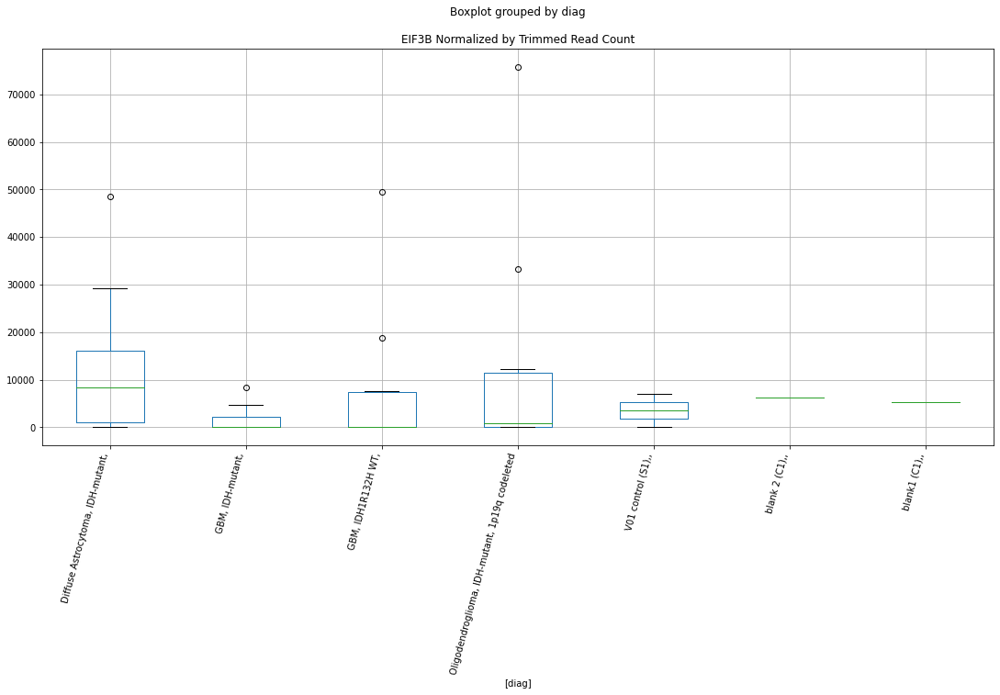

 p : 0.036577447293993044  ( t : 2.2583323504009103 ) :  Lexogen  :  bbduk2  :  ITGA4
Control and blanks
79        0.00
343    1061.57
Name: ITGA4, dtype: float64
211    0.0
Name: ITGA4, dtype: float64
475    239.52
Name: ITGA4, dtype: float64


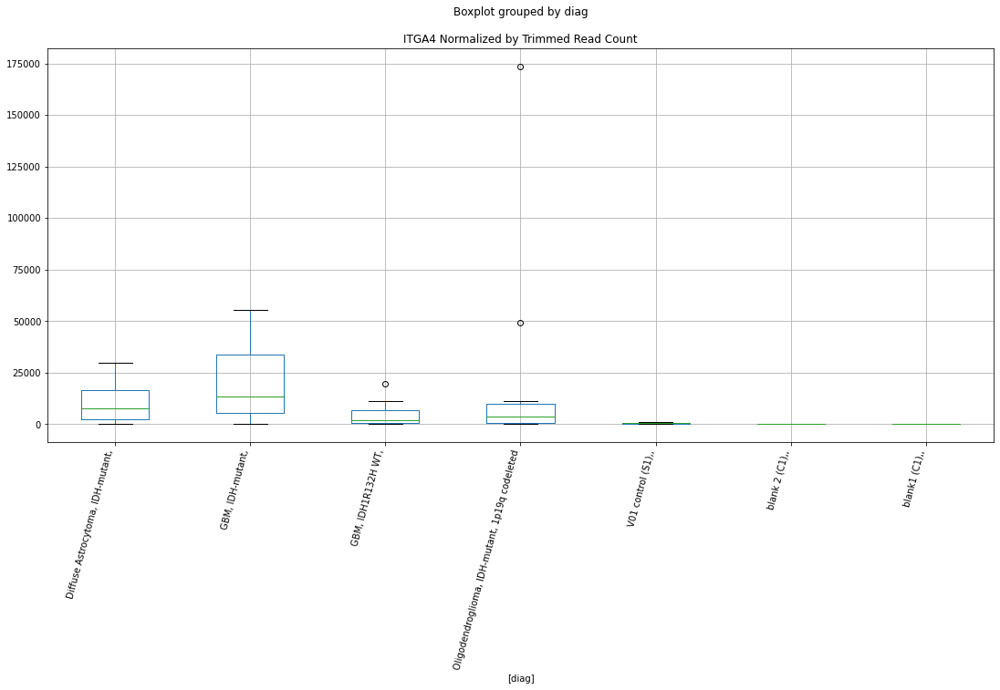

 p : 0.036612888701353444  ( t : 2.257850799661203 ) :  D-plex  :  bbduk2  :  KLK14
Control and blanks
73     0.0
337    0.0
Name: KLK14, dtype: float64
205    0.0
Name: KLK14, dtype: float64
469    0.0
Name: KLK14, dtype: float64


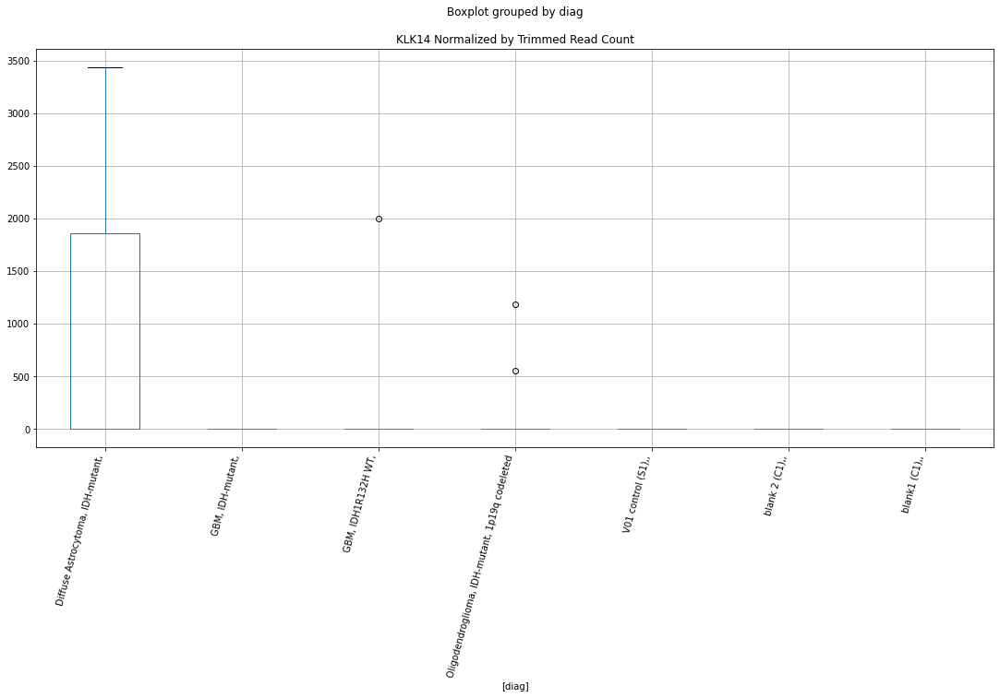

 p : 0.03681865172599663  ( t : 2.2550635242372725 ) :  D-plex  :  cutadapt2  :  FOXB2
Control and blanks
76     0.0
340    0.0
Name: FOXB2, dtype: float64
208    176.36
Name: FOXB2, dtype: float64
472    0.0
Name: FOXB2, dtype: float64


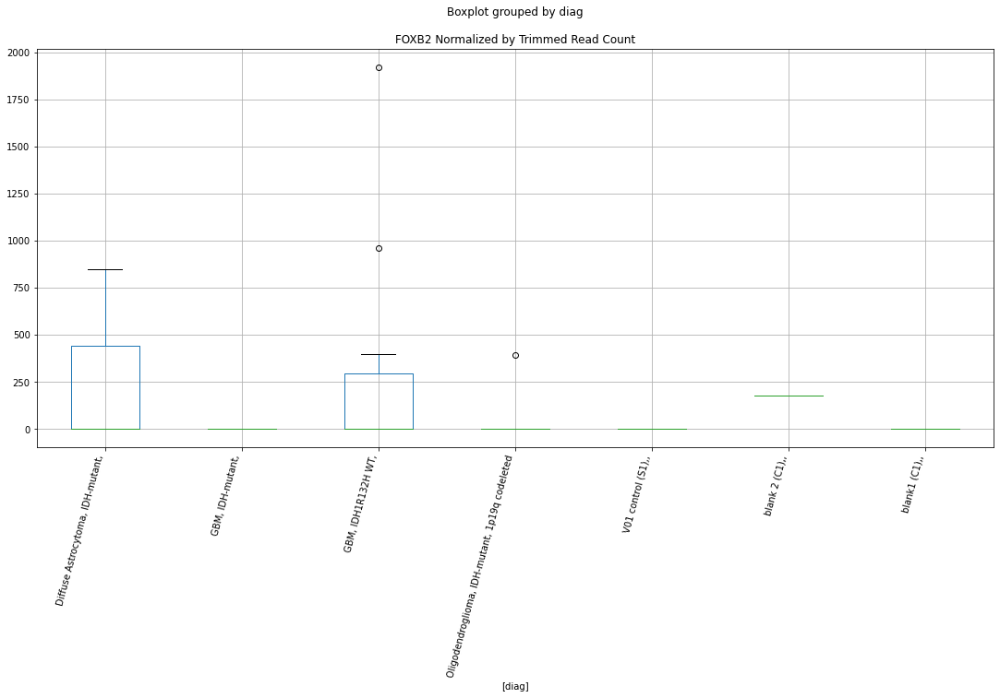

 p : 0.03682131028621288  ( t : 2.2550276054667666 ) :  D-plex  :  bbduk2  :  FOXB2
Control and blanks
73     0.0
337    0.0
Name: FOXB2, dtype: float64
205    179.09
Name: FOXB2, dtype: float64
469    0.0
Name: FOXB2, dtype: float64


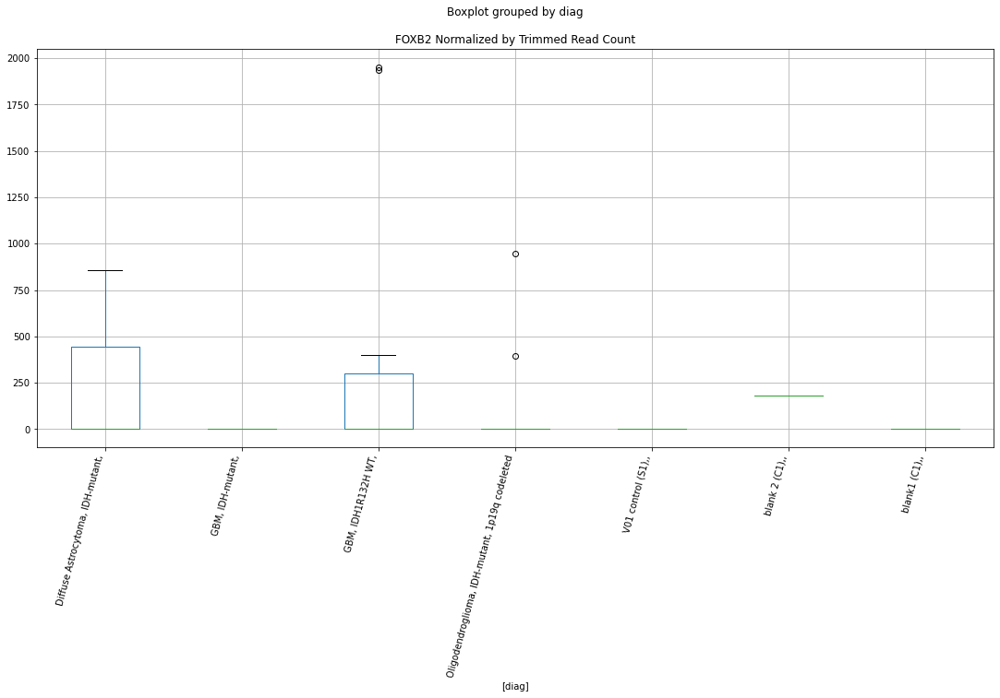

 p : 0.03691172040407824  ( t : 2.253807532616931 ) :  D-plex  :  bbduk2  :  GTF2E2
Control and blanks
73     0.0
337    0.0
Name: GTF2E2, dtype: float64
205    2328.18
Name: GTF2E2, dtype: float64
469    3549.16
Name: GTF2E2, dtype: float64


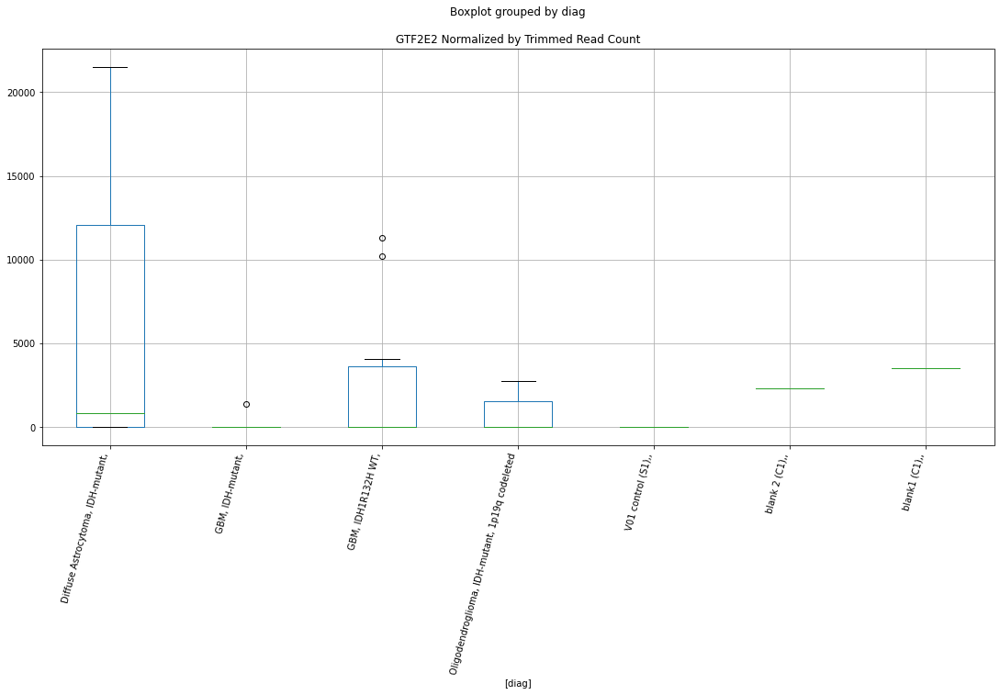

 p : 0.03694116578979594  ( t : 2.2534107664865184 ) :  D-plex  :  cutadapt2  :  GTF2E2
Control and blanks
76     0.0
340    0.0
Name: GTF2E2, dtype: float64
208    1939.96
Name: GTF2E2, dtype: float64
472    3467.74
Name: GTF2E2, dtype: float64


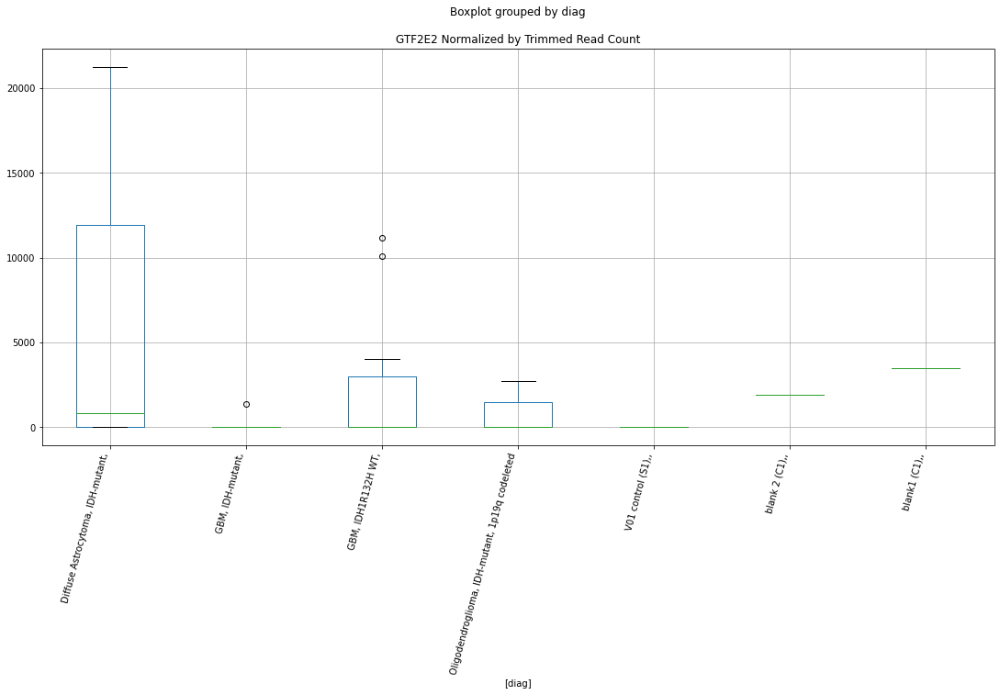

 p : 0.036999346412481475  ( t : 2.2526276608057145 ) :  Lexogen  :  bbduk2  :  EFNB3
Control and blanks
79       0.00
343    424.63
Name: EFNB3, dtype: float64
211    0.0
Name: EFNB3, dtype: float64
475    239.52
Name: EFNB3, dtype: float64


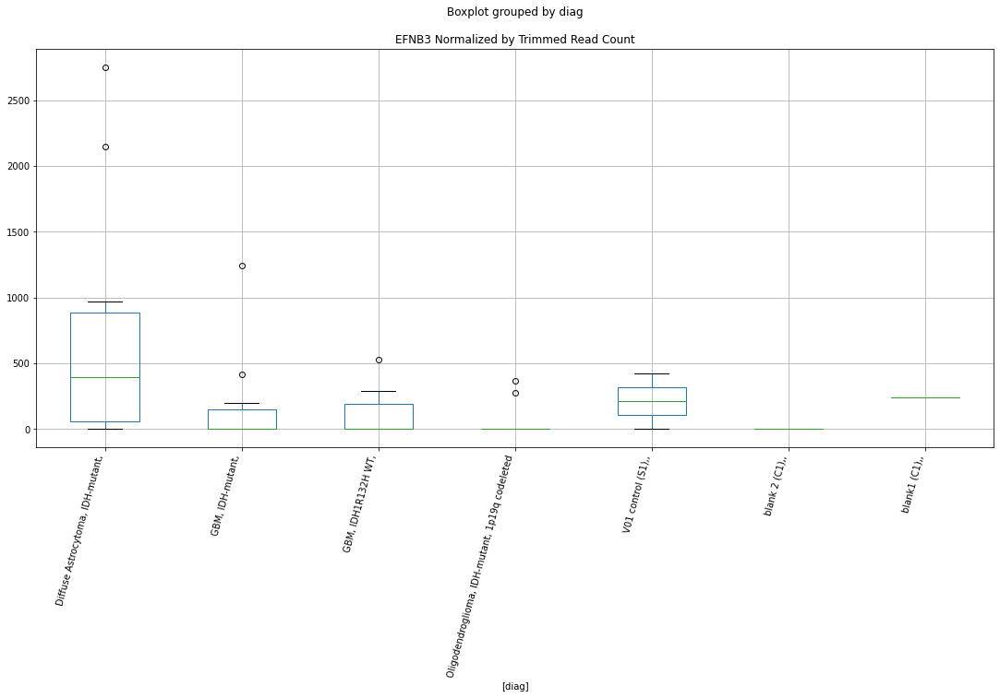

 p : 0.03711262830796835  ( t : 2.2511061528951153 ) :  D-plex  :  cutadapt2  :  KCNG1
Control and blanks
76     0.0
340    0.0
Name: KCNG1, dtype: float64
208    4761.73
Name: KCNG1, dtype: float64
472    10403.21
Name: KCNG1, dtype: float64


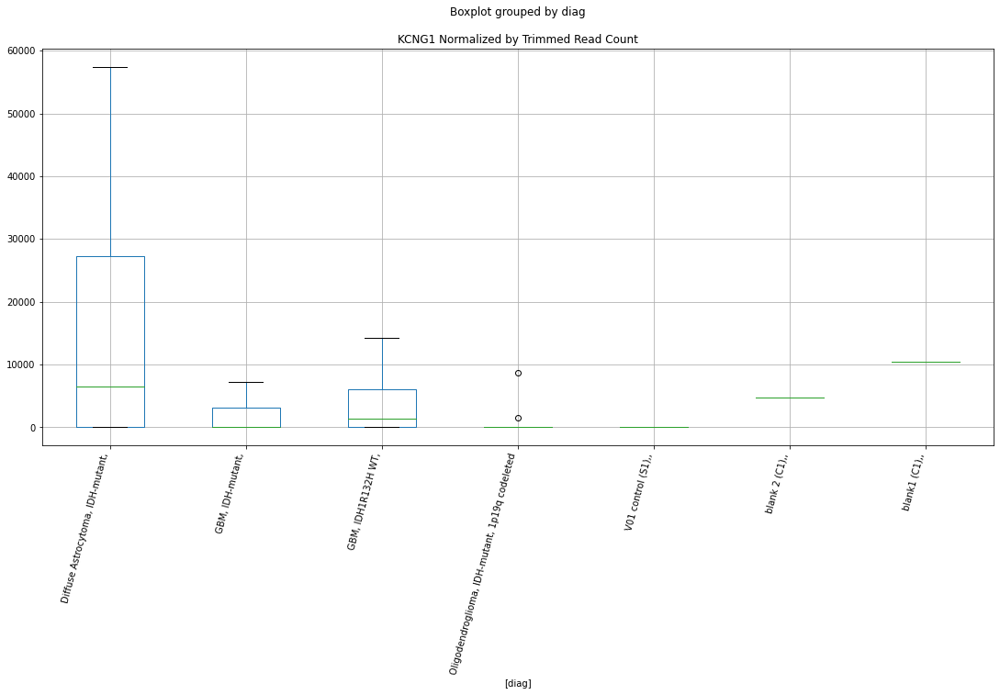

 p : 0.03711802122414405  ( t : 2.2510338266827863 ) :  D-plex  :  cutadapt2  :  GOLGA6L9
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L9, dtype: float64
208    2116.32
Name: GOLGA6L9, dtype: float64
472    5779.56
Name: GOLGA6L9, dtype: float64


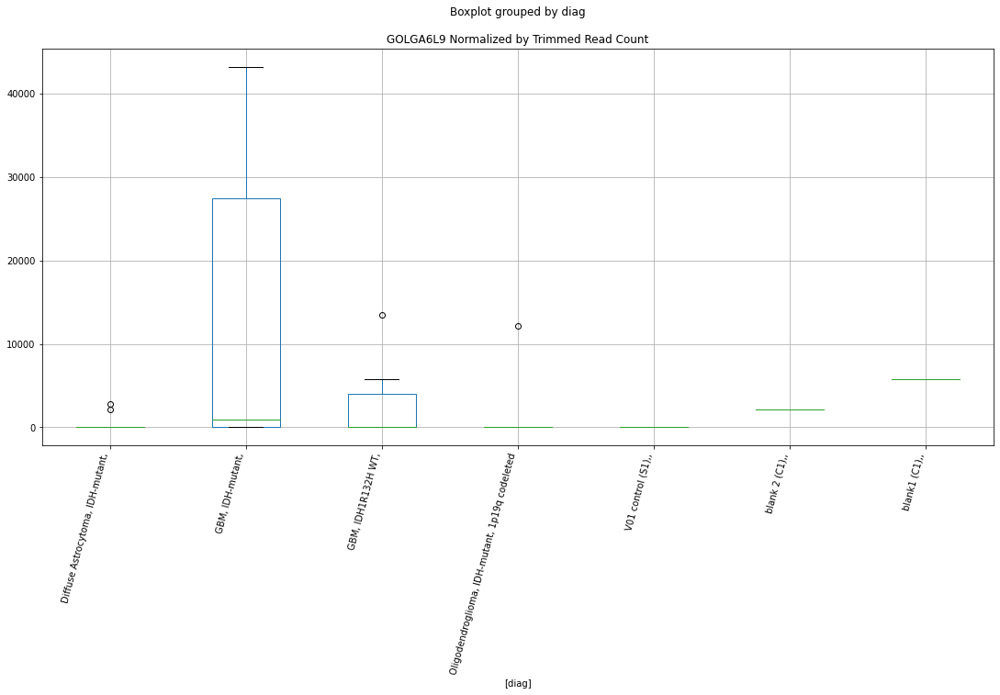

 p : 0.03713389334482119  ( t : 2.2508210165973845 ) :  Lexogen  :  cutadapt2  :  FRS2
Control and blanks
82     0.0
346    0.0
Name: FRS2, dtype: float64
214    0.0
Name: FRS2, dtype: float64
478    0.0
Name: FRS2, dtype: float64


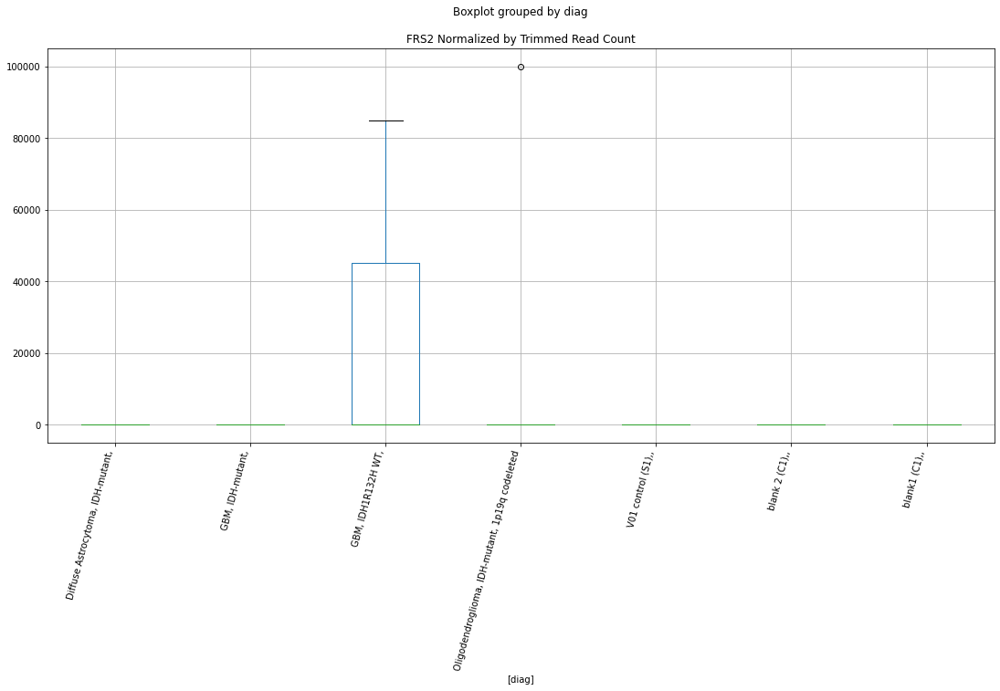

 p : 0.037164910590919815  ( t : 2.250405386038023 ) :  Lexogen  :  cutadapt2  :  ETFA
Control and blanks
82     0.0
346    0.0
Name: ETFA, dtype: float64
214    5695.76
Name: ETFA, dtype: float64
478    0.0
Name: ETFA, dtype: float64


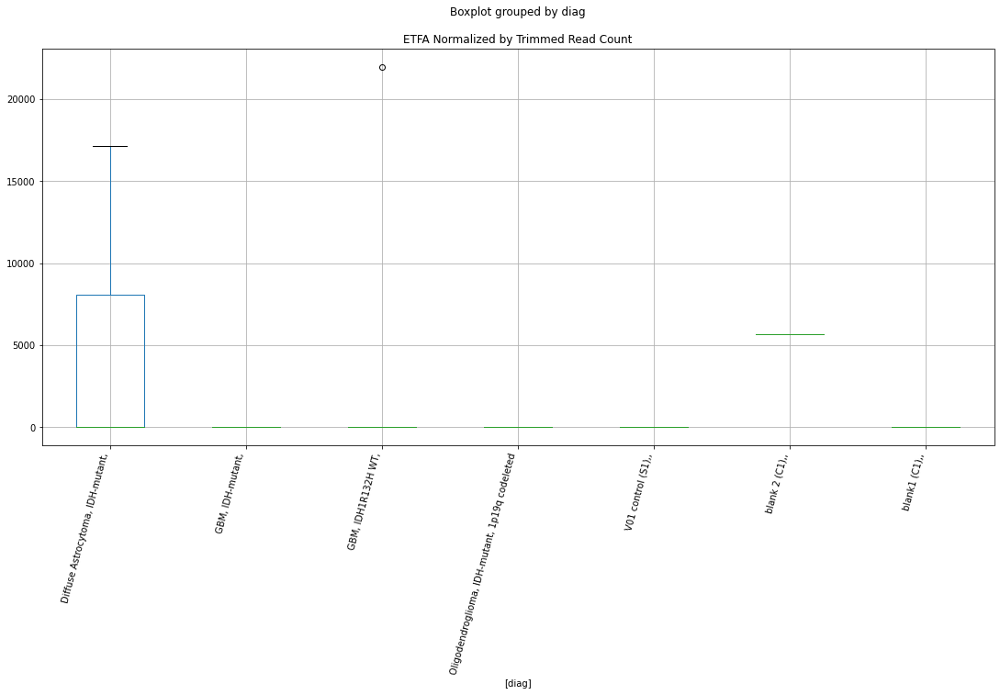

 p : 0.03716672678742939  ( t : 2.2503810589588125 ) :  D-plex  :  bbduk2  :  HOTS
Control and blanks
73       0.00
337    890.16
Name: HOTS, dtype: float64
205    2507.27
Name: HOTS, dtype: float64
469    2366.11
Name: HOTS, dtype: float64


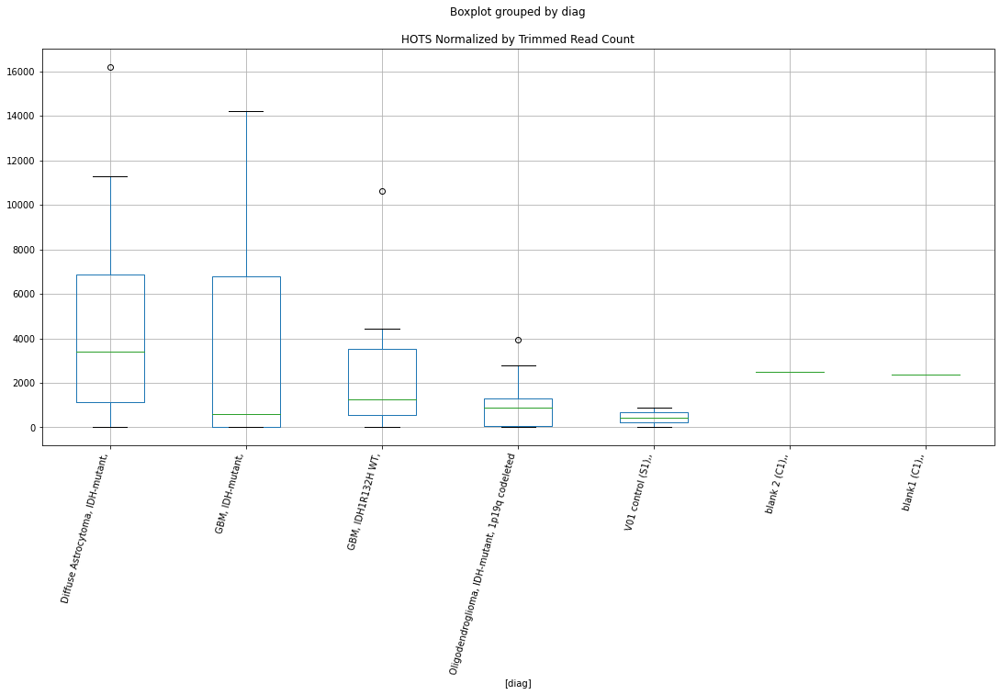

 p : 0.037191346634812314  ( t : 2.2500513961266098 ) :  Lexogen  :  bbduk2  :  ETFA
Control and blanks
79     0.0
343    0.0
Name: ETFA, dtype: float64
211    5739.43
Name: ETFA, dtype: float64
475    0.0
Name: ETFA, dtype: float64


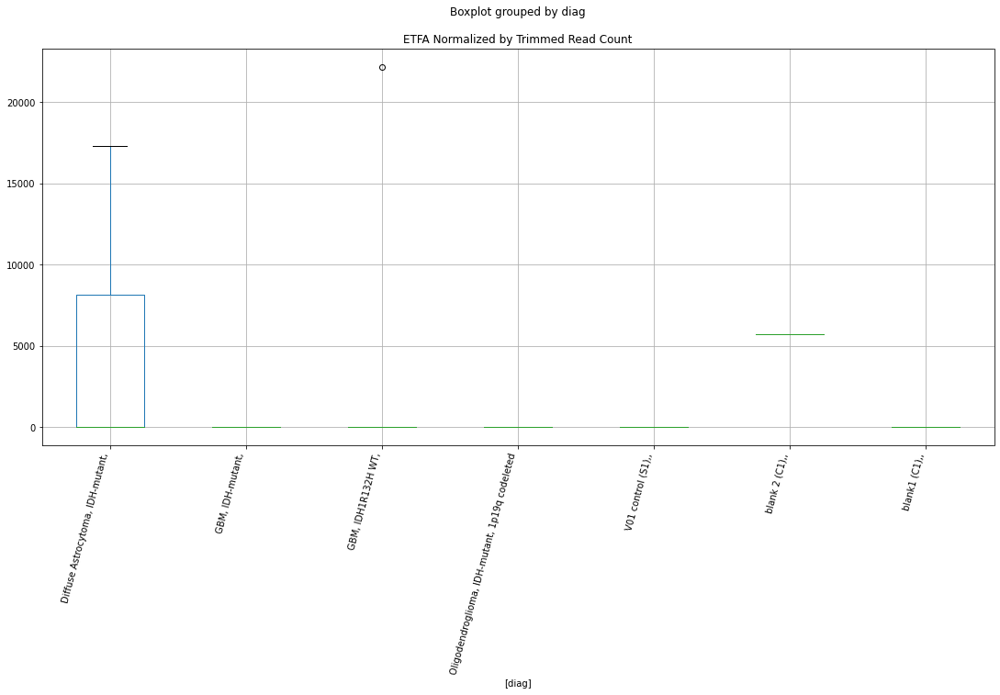

 p : 0.03721771967540709  ( t : 2.24969848115783 ) :  Lexogen  :  bbduk2  :  KCNC4
Control and blanks
79       0.00
343    424.63
Name: KCNC4, dtype: float64
211    0.0
Name: KCNC4, dtype: float64
475    0.0
Name: KCNC4, dtype: float64


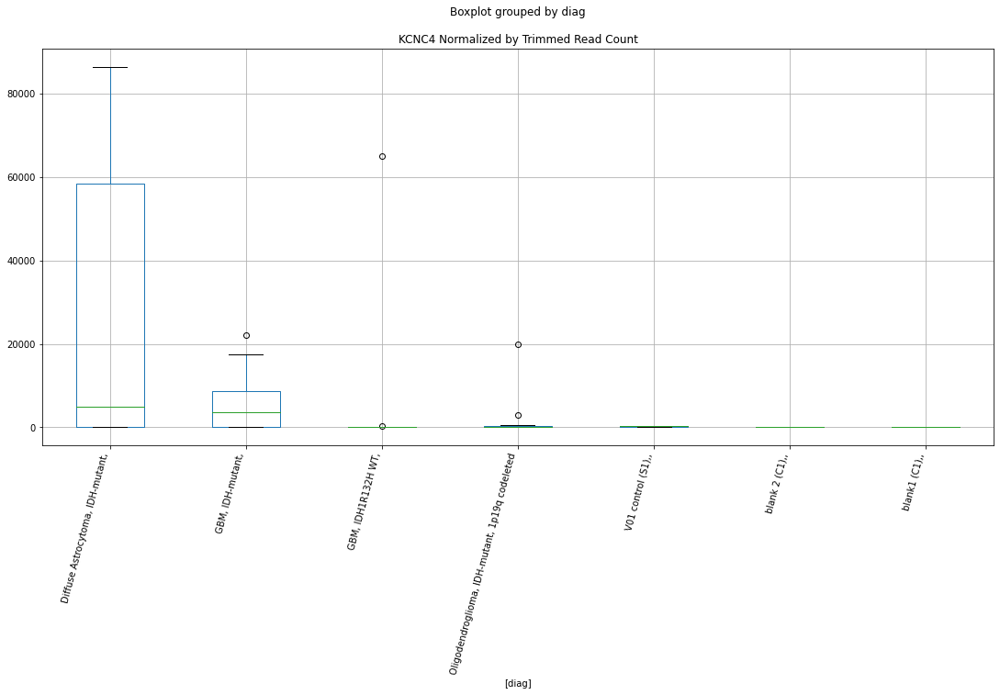

 p : 0.037307601626399914  ( t : 2.2484974427841413 ) :  Lexogen  :  cutadapt2  :  FAT3
Control and blanks
82        0.00
346    2104.35
Name: FAT3, dtype: float64
214    0.0
Name: FAT3, dtype: float64
478    0.0
Name: FAT3, dtype: float64


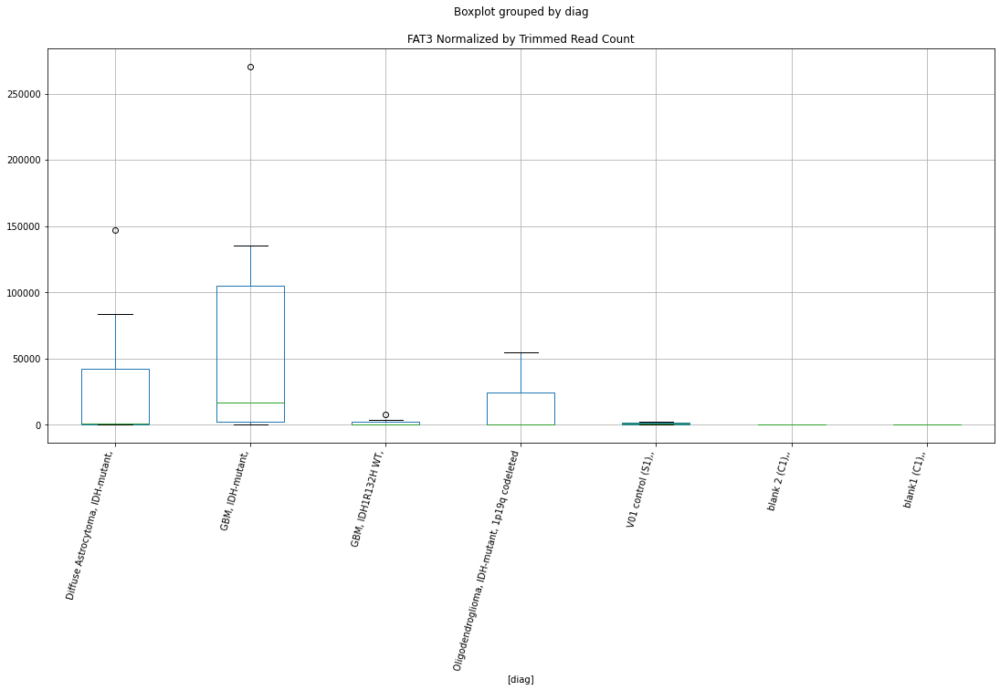

 p : 0.03733796751018198  ( t : 2.2480922851034455 ) :  Lexogen  :  bbduk2  :  KHDRBS2
Control and blanks
79     0.0
343    0.0
Name: KHDRBS2, dtype: float64
211    9019.11
Name: KHDRBS2, dtype: float64
475    5748.38
Name: KHDRBS2, dtype: float64


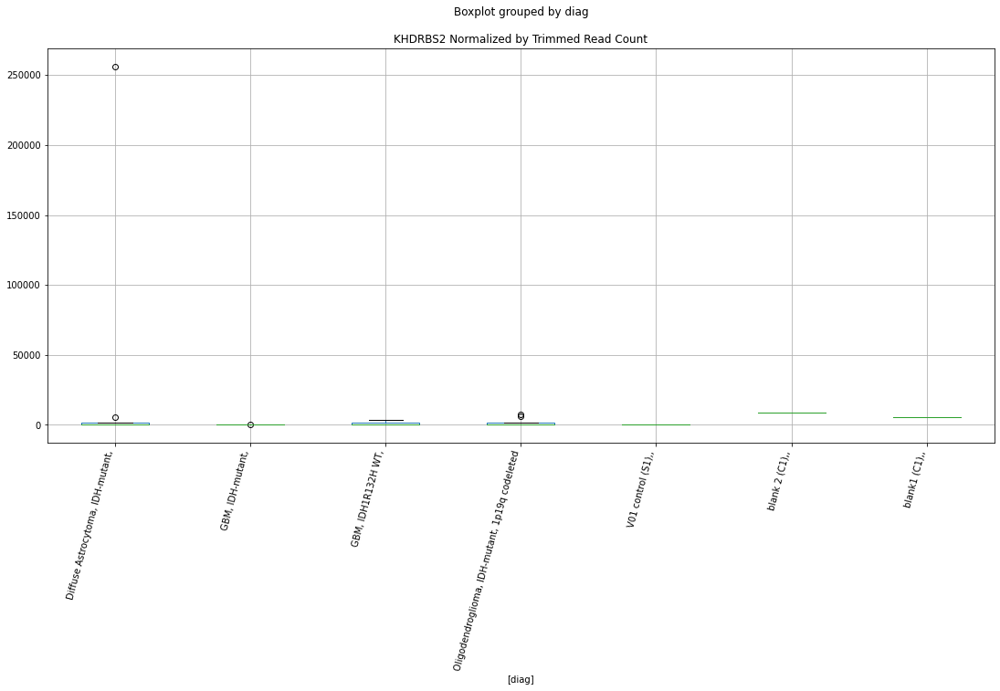

 p : 0.03741895051491312  ( t : 2.2470132517201566 ) :  D-plex  :  bbduk2  :  KCNG1
Control and blanks
73     0.0
337    0.0
Name: KCNG1, dtype: float64
205    6447.27
Name: KCNG1, dtype: float64
469    10647.49
Name: KCNG1, dtype: float64


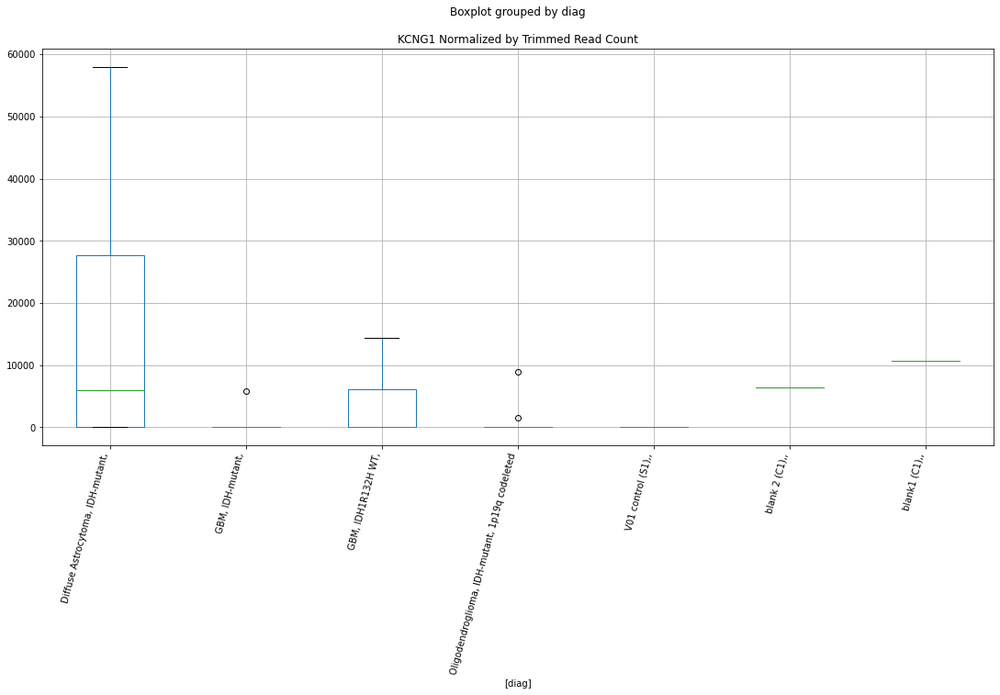

 p : 0.037448610906334986  ( t : 2.2466185898617246 ) :  D-plex  :  cutadapt2  :  HIVEP2
Control and blanks
76     757.61
340      0.00
Name: HIVEP2, dtype: float64
208    6348.97
Name: HIVEP2, dtype: float64
472    577.96
Name: HIVEP2, dtype: float64


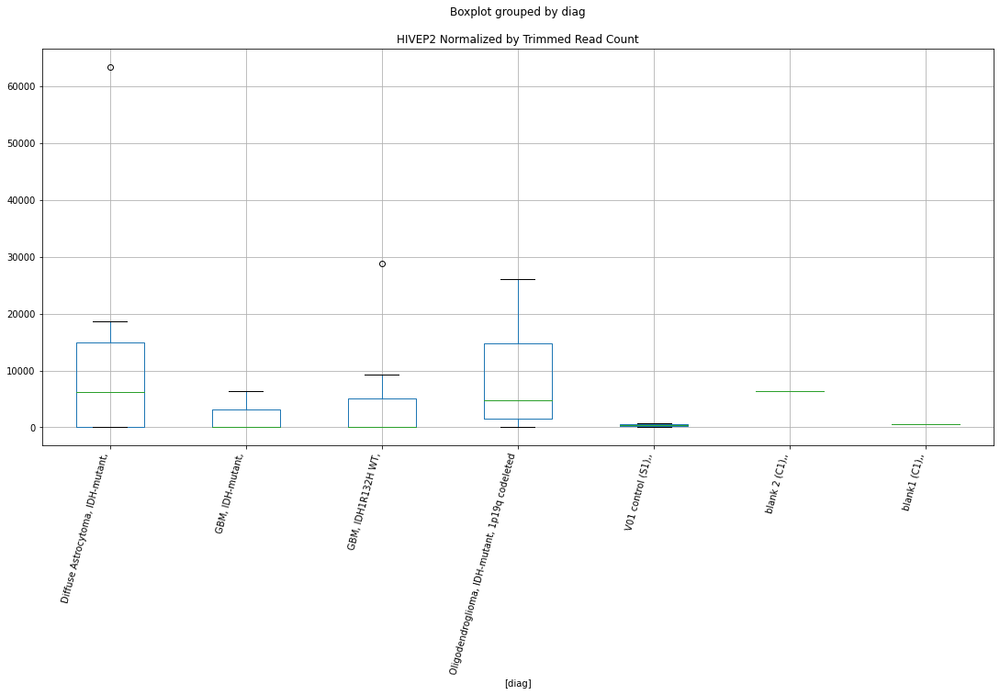

 p : 0.037542776536437804  ( t : 2.2453675280059495 ) :  D-plex  :  bbduk2  :  DNM3OS
Control and blanks
73     0.0
337    0.0
Name: DNM3OS, dtype: float64
205    358.18
Name: DNM3OS, dtype: float64
469    2366.11
Name: DNM3OS, dtype: float64


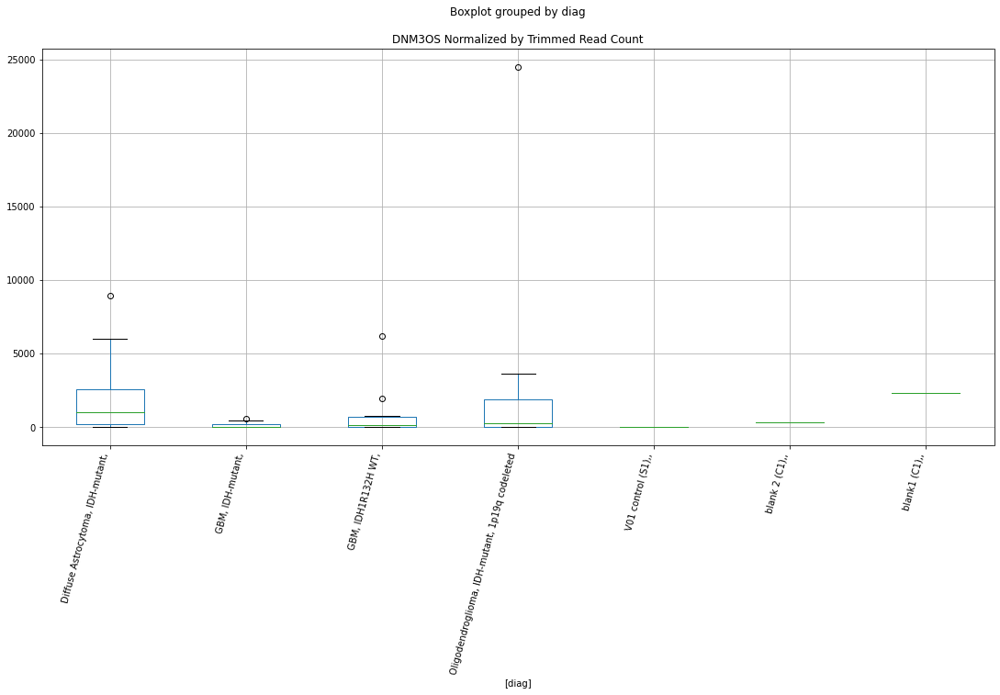

 p : 0.037555214515737415  ( t : 2.2452024964867356 ) :  Lexogen  :  bbduk2  :  HMGN5
Control and blanks
79     0.0
343    0.0
Name: HMGN5, dtype: float64
211    0.0
Name: HMGN5, dtype: float64
475    0.0
Name: HMGN5, dtype: float64


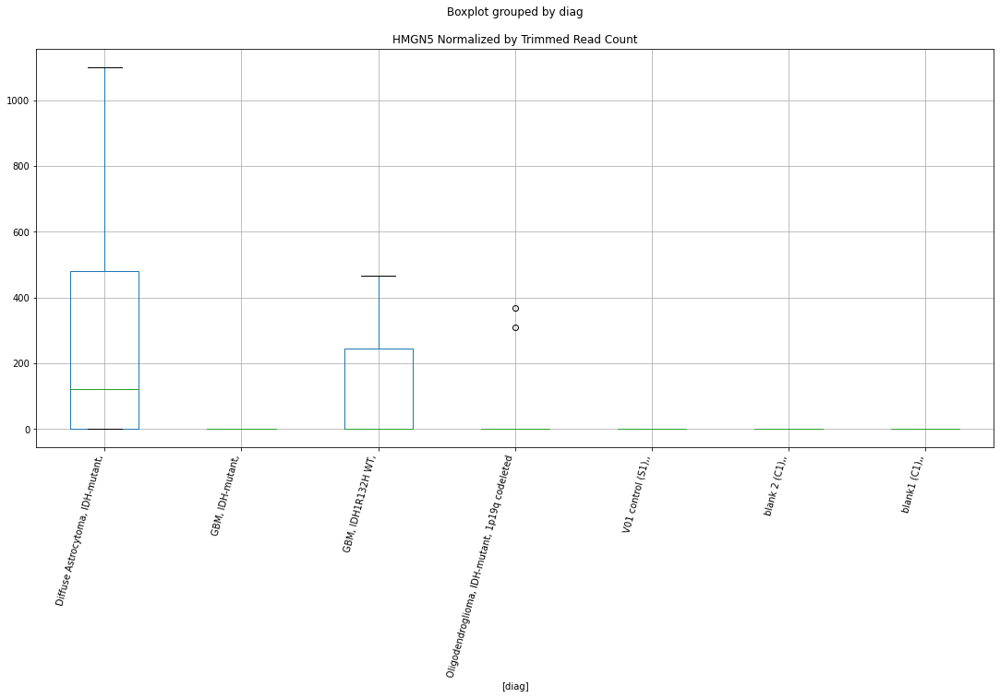

 p : 0.03768088020810648  ( t : 2.243537941441696 ) :  Lexogen  :  bbduk2  :  FAT3
Control and blanks
79        0.00
343    2123.14
Name: FAT3, dtype: float64
211    0.0
Name: FAT3, dtype: float64
475    2395.16
Name: FAT3, dtype: float64


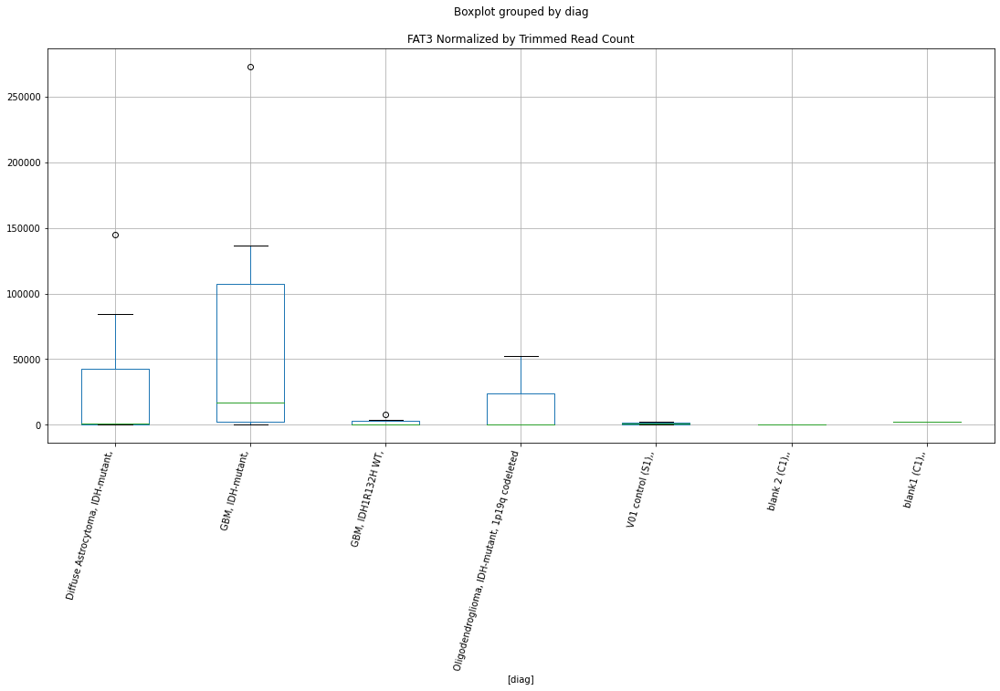

 p : 0.037804289418042494  ( t : 2.2419082508417554 ) :  D-plex  :  bbduk2  :  GRIK2
Control and blanks
73       0.00
337    890.16
Name: GRIK2, dtype: float64
205    10208.18
Name: GRIK2, dtype: float64
469    20111.93
Name: GRIK2, dtype: float64


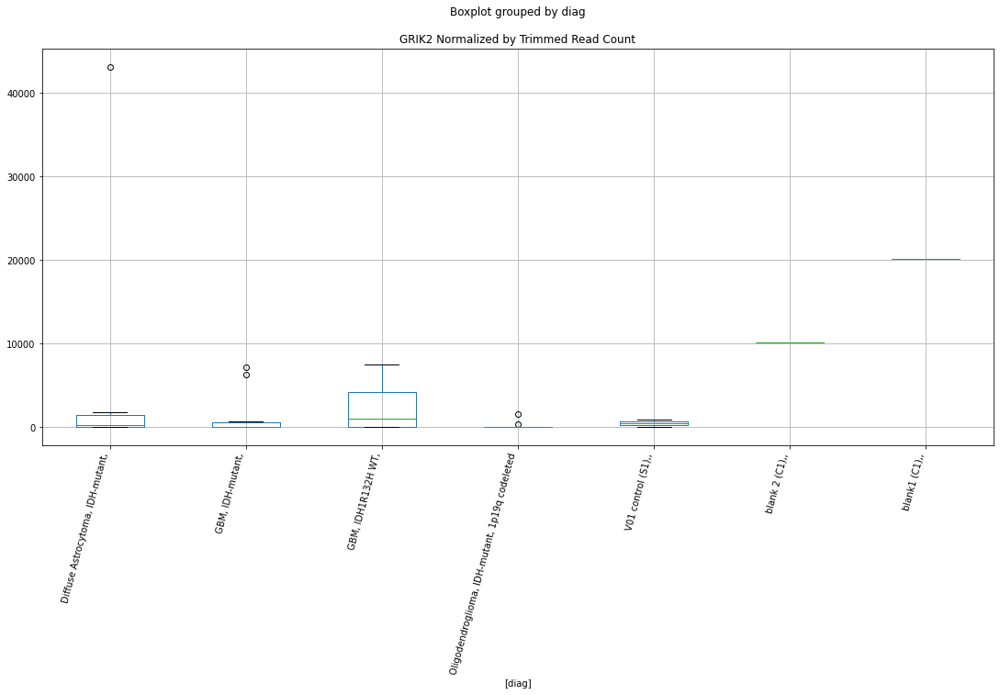

 p : 0.0378517057039756  ( t : 2.2412833954387397 ) :  D-plex  :  cutadapt2  :  GTSE1
Control and blanks
76     2272.84
340       0.00
Name: GTSE1, dtype: float64
208    2821.76
Name: GTSE1, dtype: float64
472    1733.87
Name: GTSE1, dtype: float64


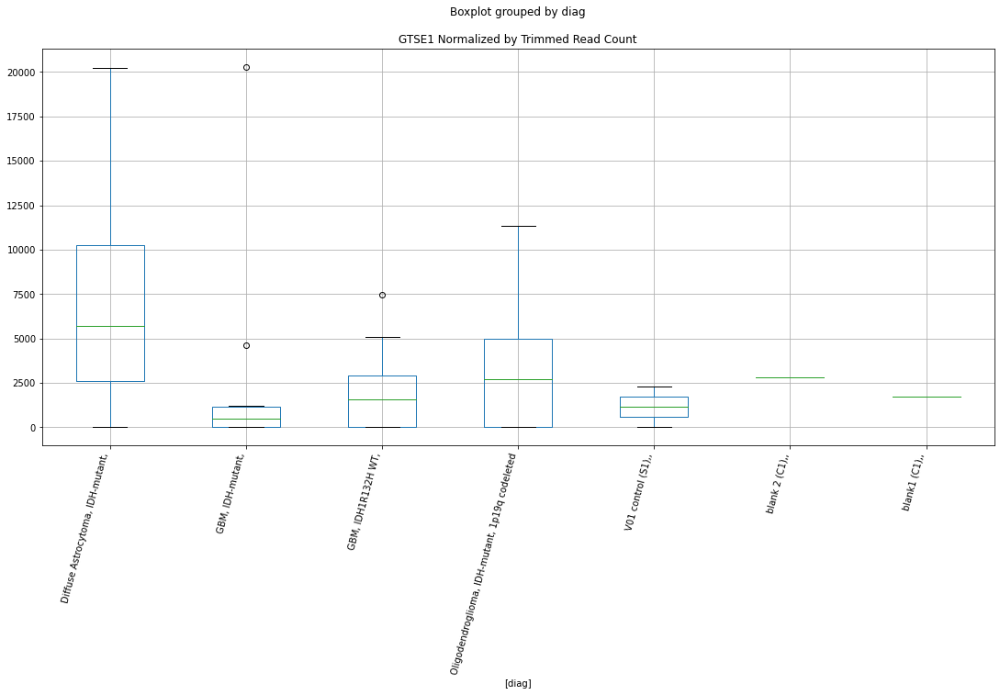

 p : 0.037944122080667615  ( t : 2.2400675968801727 ) :  Lexogen  :  cutadapt2  :  FUT8-AS1
Control and blanks
82     0.0
346    0.0
Name: FUT8-AS1, dtype: float64
214    0.0
Name: FUT8-AS1, dtype: float64
478    0.0
Name: FUT8-AS1, dtype: float64


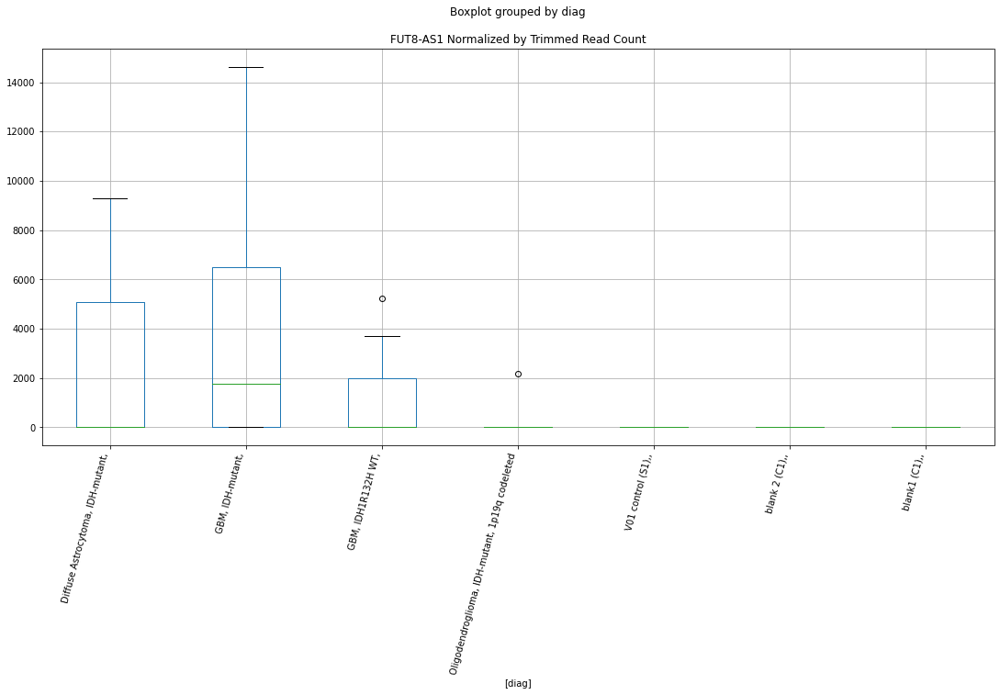

 p : 0.03796621100716449  ( t : 2.239777406736892 ) :  D-plex  :  bbduk2  :  GAS7
Control and blanks
73         0.0
337    12462.2
Name: GAS7, dtype: float64
205    15043.64
Name: GAS7, dtype: float64
469    33125.53
Name: GAS7, dtype: float64


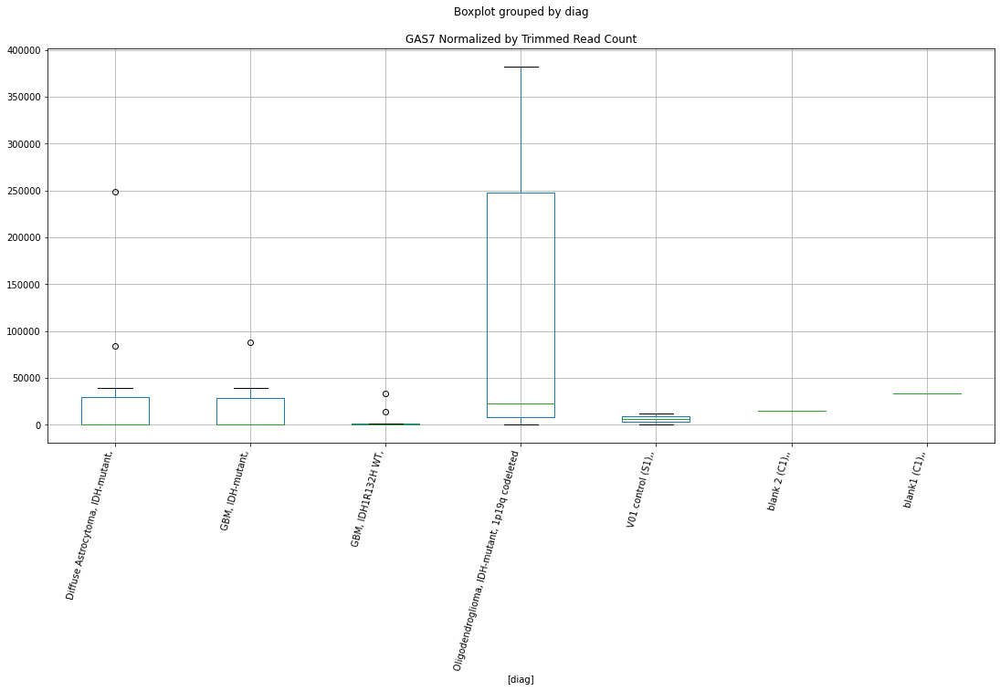

 p : 0.0379835299734491  ( t : 2.2395499901160316 ) :  D-plex  :  cutadapt2  :  KIF12
Control and blanks
76     0.0
340    0.0
Name: KIF12, dtype: float64
208    0.0
Name: KIF12, dtype: float64
472    0.0
Name: KIF12, dtype: float64


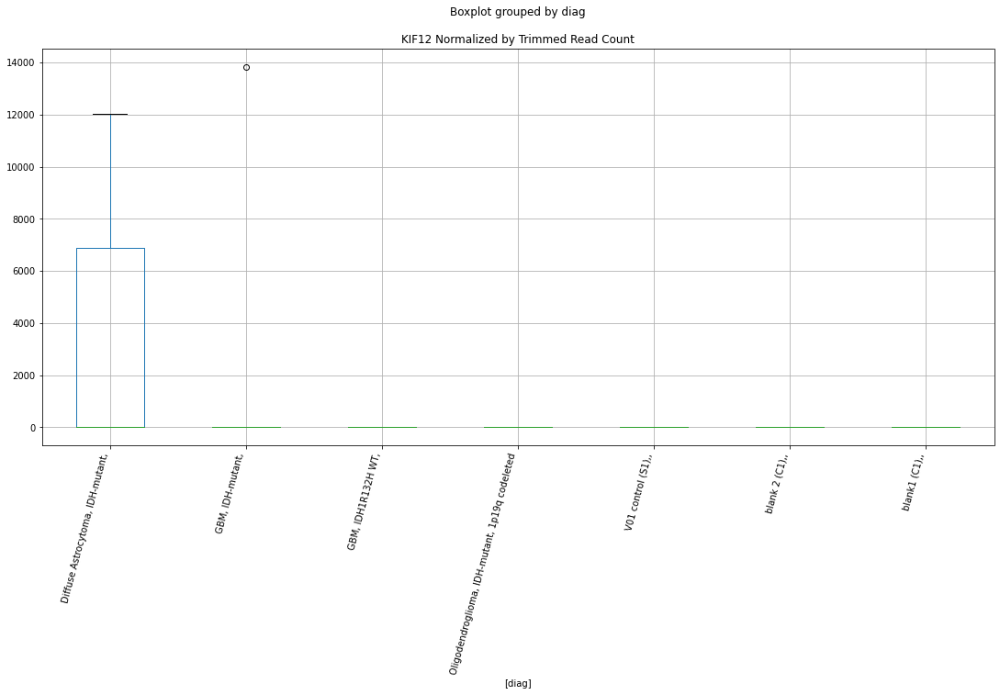

 p : 0.038003009321900455  ( t : 2.2392943195580335 ) :  Lexogen  :  bbduk2  :  IMPA2
Control and blanks
79     0.0
343    0.0
Name: IMPA2, dtype: float64
211    16398.38
Name: IMPA2, dtype: float64
475    0.0
Name: IMPA2, dtype: float64


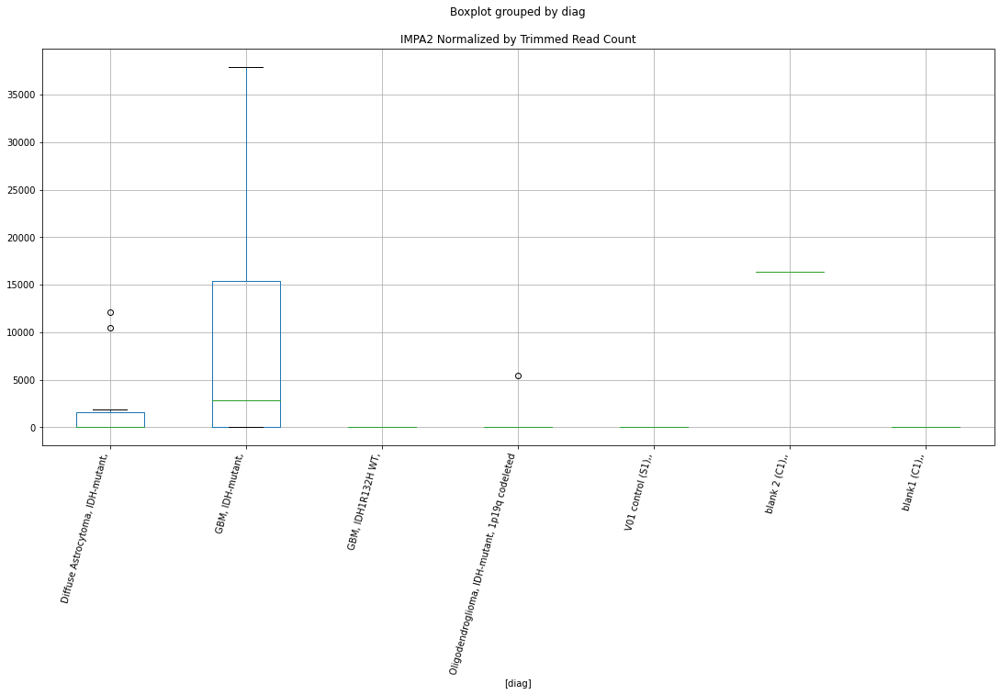

 p : 0.0380302225527403  ( t : 2.2389373423763046 ) :  D-plex  :  cutadapt2  :  HIVEP3
Control and blanks
76      6818.53
340    15853.18
Name: HIVEP3, dtype: float64
208    11992.49
Name: HIVEP3, dtype: float64
472    17916.63
Name: HIVEP3, dtype: float64


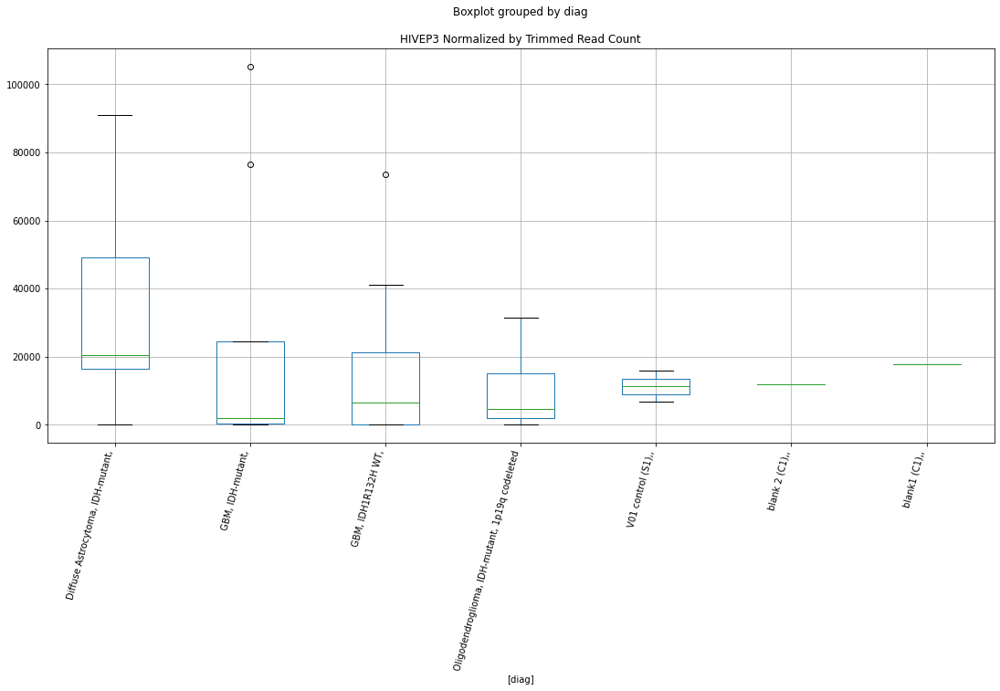

 p : 0.03805349246919111  ( t : 2.23863227945023 ) :  Lexogen  :  cutadapt2  :  KCNJ14
Control and blanks
82     0.0
346    0.0
Name: KCNJ14, dtype: float64
214    271.23
Name: KCNJ14, dtype: float64
478    0.0
Name: KCNJ14, dtype: float64


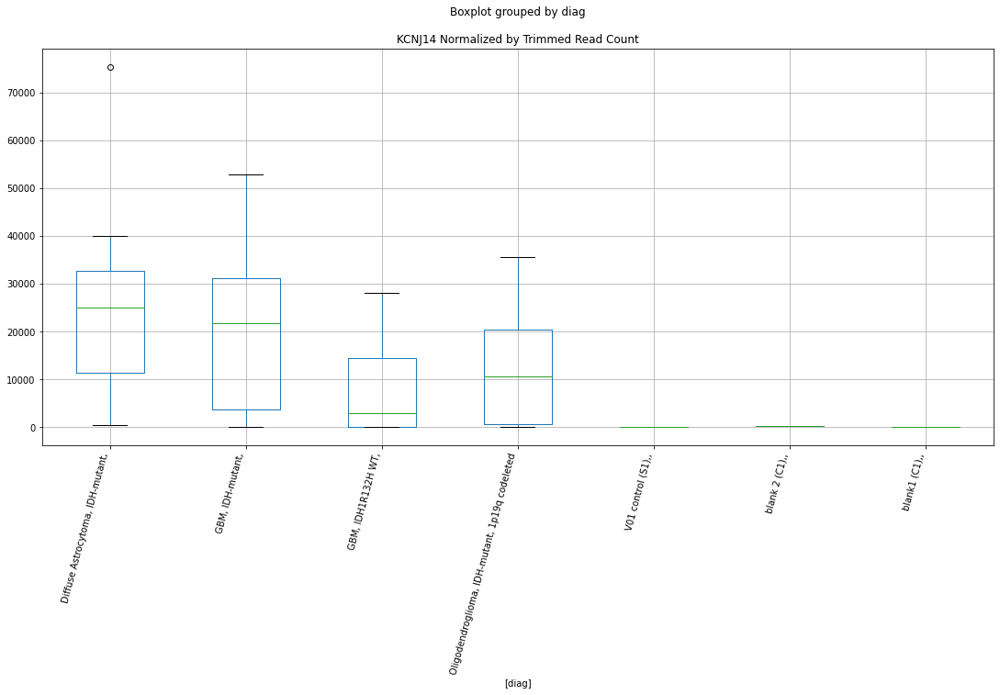

 p : 0.03820463859430349  ( t : 2.236654966374626 ) :  Lexogen  :  bbduk2  :  ITFG2
Control and blanks
79     0.0
343    0.0
Name: ITFG2, dtype: float64
211    32796.76
Name: ITFG2, dtype: float64
475    0.0
Name: ITFG2, dtype: float64


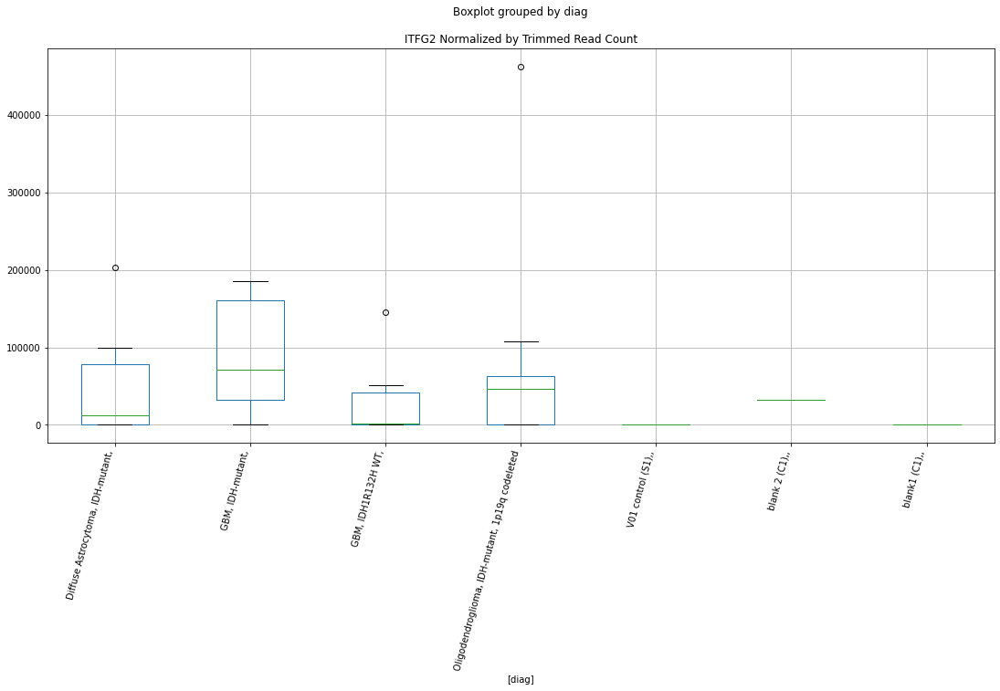

 p : 0.03824192589720218  ( t : 2.236168277959949 ) :  D-plex  :  bbduk2  :  KIF12
Control and blanks
73     0.0
337    0.0
Name: KIF12, dtype: float64
205    0.0
Name: KIF12, dtype: float64
469    0.0
Name: KIF12, dtype: float64


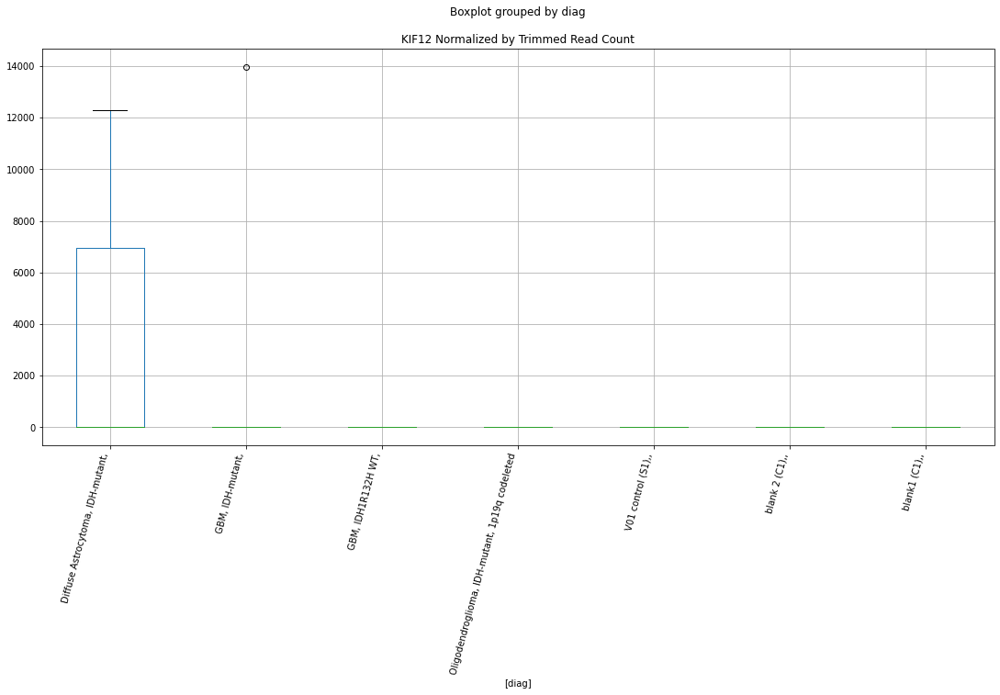

 p : 0.038277831657797405  ( t : 2.2357000351413743 ) :  Lexogen  :  cutadapt2  :  ITFG2
Control and blanks
82     0.0
346    0.0
Name: ITFG2, dtype: float64
214    32547.17
Name: ITFG2, dtype: float64
478    0.0
Name: ITFG2, dtype: float64


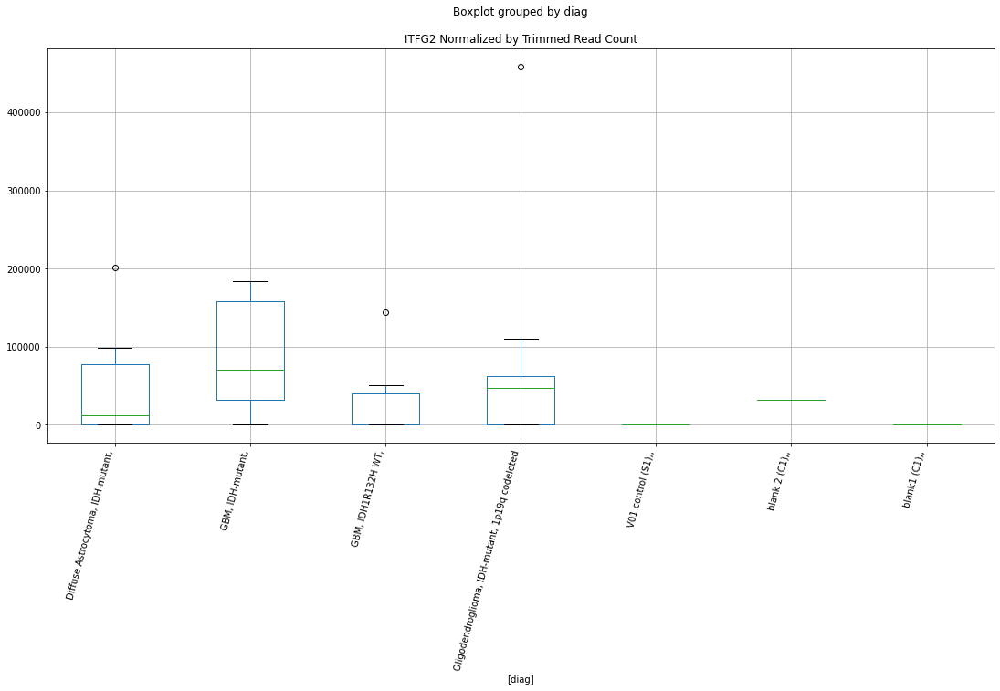

 p : 0.03831751419058394  ( t : 2.2351830105362693 ) :  D-plex  :  bbduk2  :  GXYLT1P3
Control and blanks
73     0.0
337    0.0
Name: GXYLT1P3, dtype: float64
205    0.0
Name: GXYLT1P3, dtype: float64
469    591.53
Name: GXYLT1P3, dtype: float64


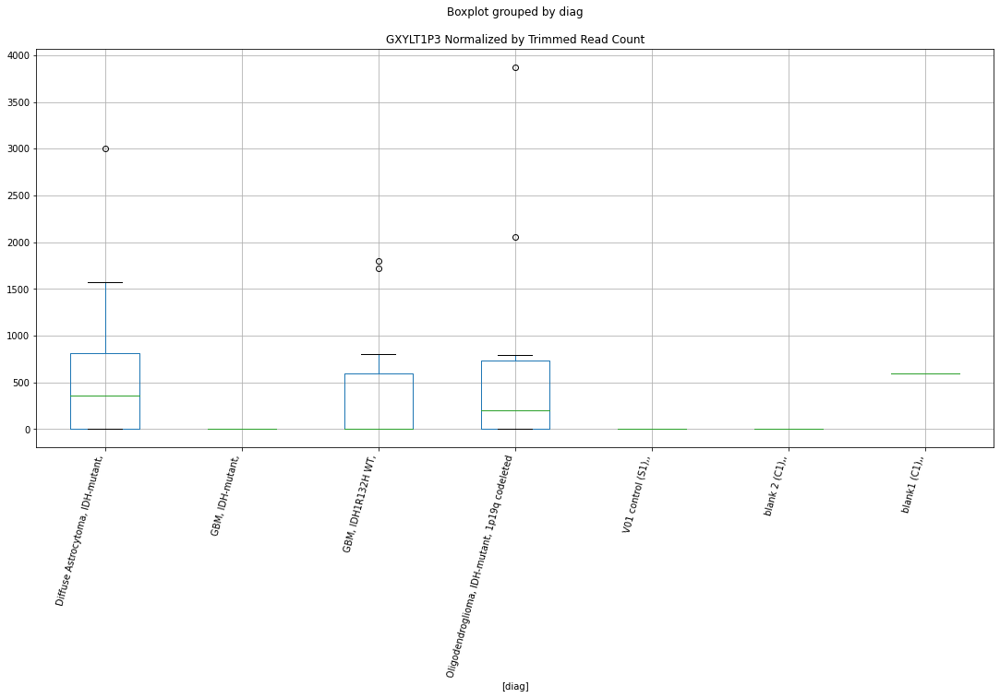

 p : 0.03835448617913062  ( t : 2.2347017455095814 ) :  Lexogen  :  bbduk2  :  KCNJ14
Control and blanks
79     0.0
343    0.0
Name: KCNJ14, dtype: float64
211    273.31
Name: KCNJ14, dtype: float64
475    0.0
Name: KCNJ14, dtype: float64


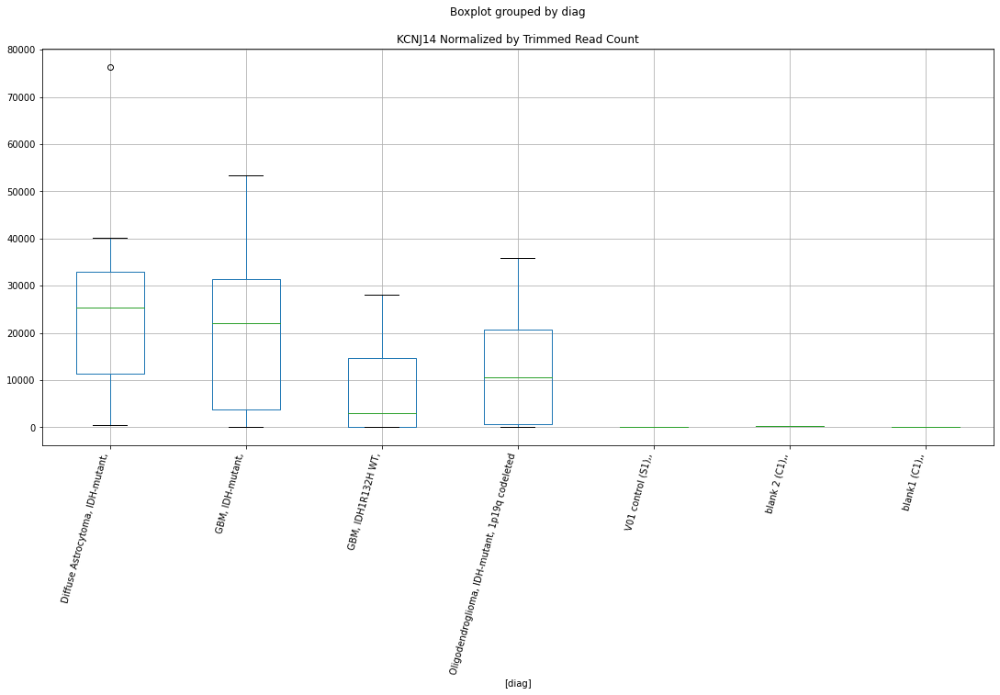

 p : 0.038409140043143254  ( t : 2.233991097682351 ) :  D-plex  :  cutadapt2  :  GRM7
Control and blanks
76         0.0
340    73981.5
Name: GRM7, dtype: float64
208    8288.93
Name: GRM7, dtype: float64
472    0.0
Name: GRM7, dtype: float64


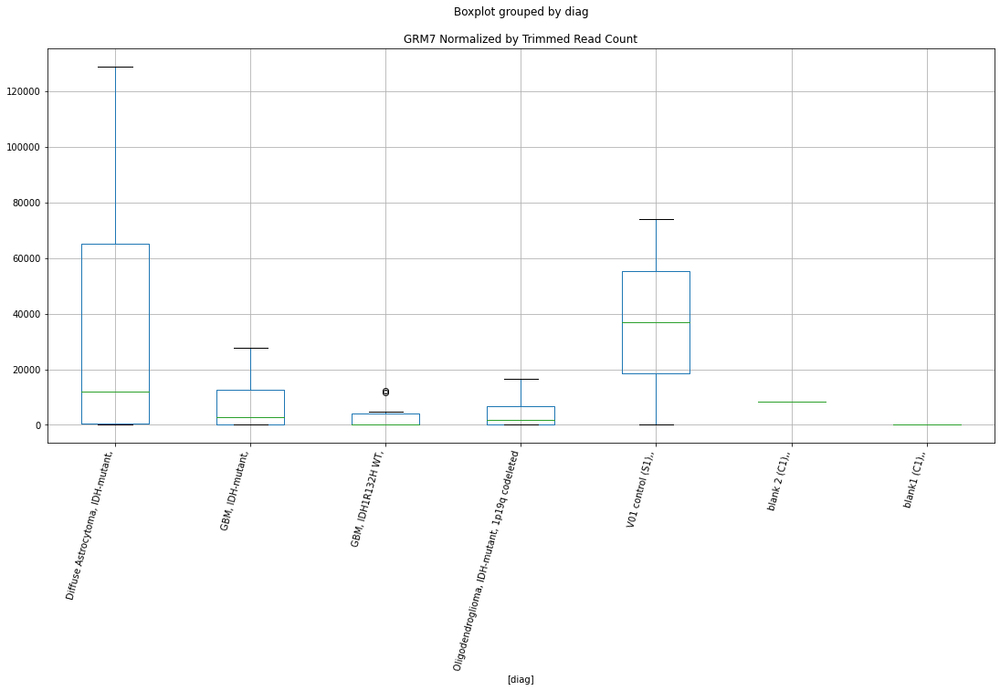

 p : 0.038412577833331935  ( t : 2.2339464282806873 ) :  D-plex  :  cutadapt2  :  GLYAT
Control and blanks
76     2272.84
340       0.00
Name: GLYAT, dtype: float64
208    3703.56
Name: GLYAT, dtype: float64
472    278574.71
Name: GLYAT, dtype: float64


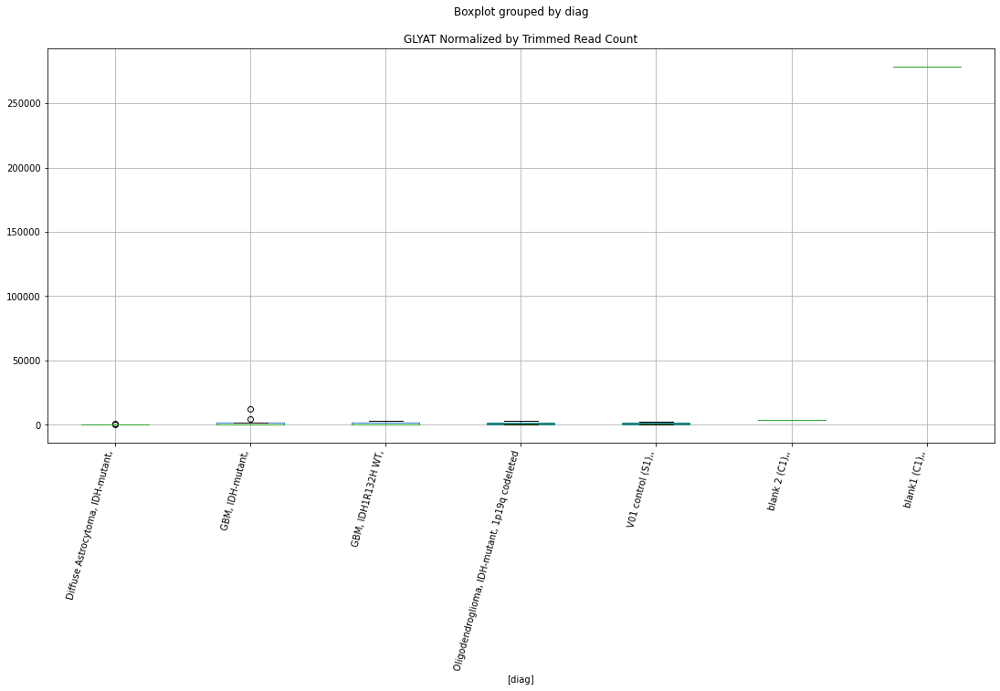

 p : 0.038418534351807594  ( t : 2.2338690401550347 ) :  Lexogen  :  cutadapt2  :  IMPA2
Control and blanks
82     0.0
346    0.0
Name: IMPA2, dtype: float64
214    16273.59
Name: IMPA2, dtype: float64
478    0.0
Name: IMPA2, dtype: float64


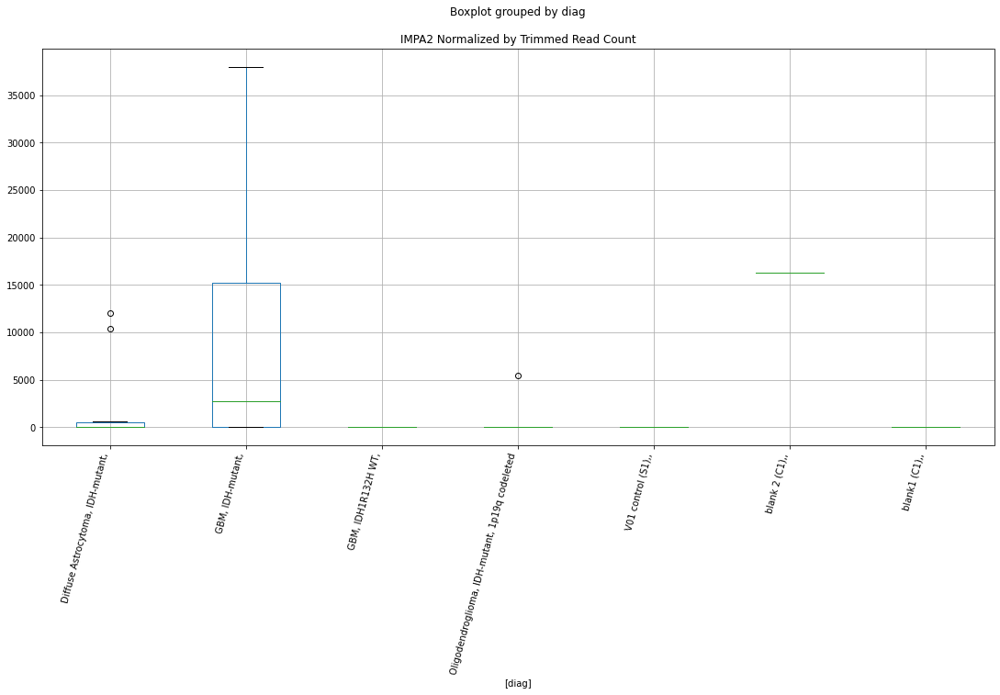

 p : 0.0384255070436319  ( t : 2.233778463772701 ) :  Lexogen  :  bbduk2  :  GPR157
Control and blanks
79     0.0
343    0.0
Name: GPR157, dtype: float64
211    0.0
Name: GPR157, dtype: float64
475    0.0
Name: GPR157, dtype: float64


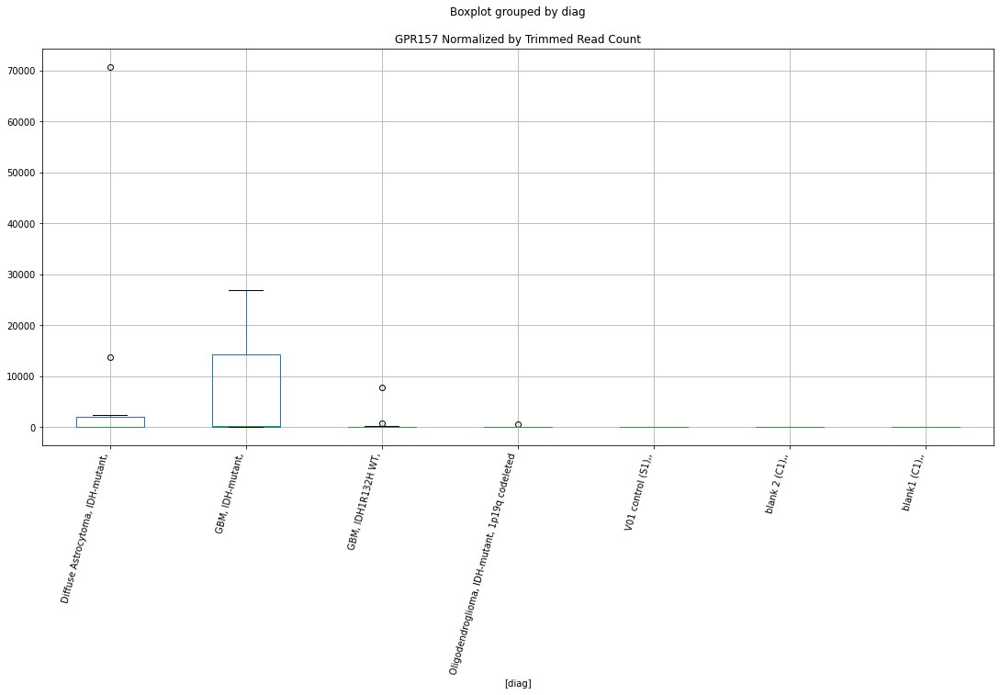

 p : 0.03849224494211091  ( t : 2.2329122931175296 ) :  D-plex  :  bbduk2  :  GRM7
Control and blanks
73      2319.03
337    69432.27
Name: GRM7, dtype: float64
205    8954.55
Name: GRM7, dtype: float64
469    0.0
Name: GRM7, dtype: float64


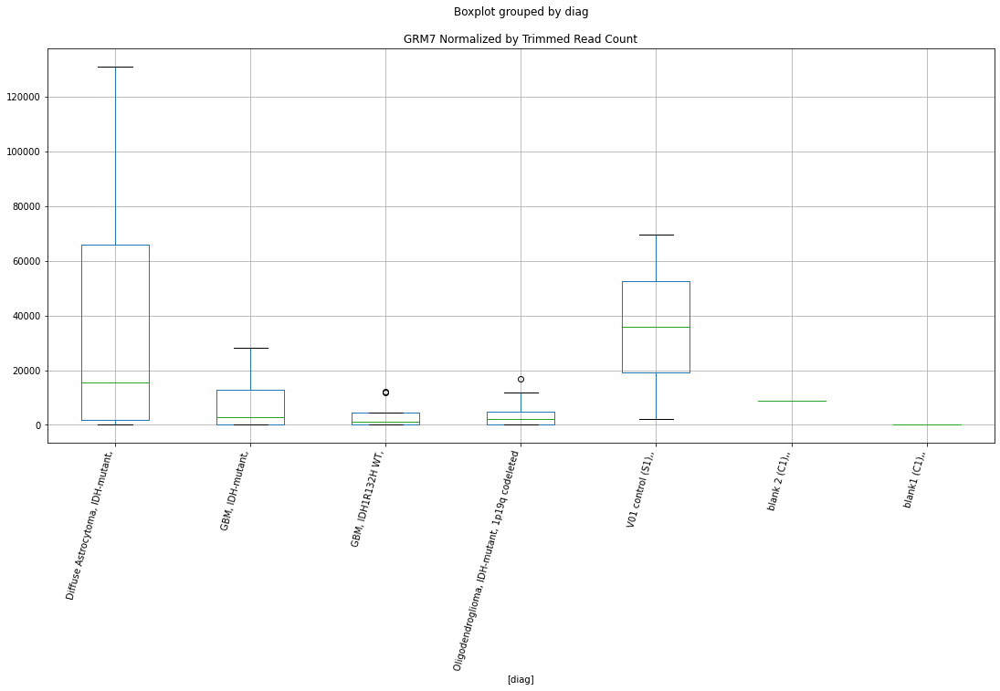

 p : 0.038563192163008166  ( t : 2.2319930069409857 ) :  D-plex  :  bbduk2  :  HIVEP3
Control and blanks
73         0.00
337    16022.83
Name: HIVEP3, dtype: float64
205    12178.18
Name: HIVEP3, dtype: float64
469    17745.82
Name: HIVEP3, dtype: float64


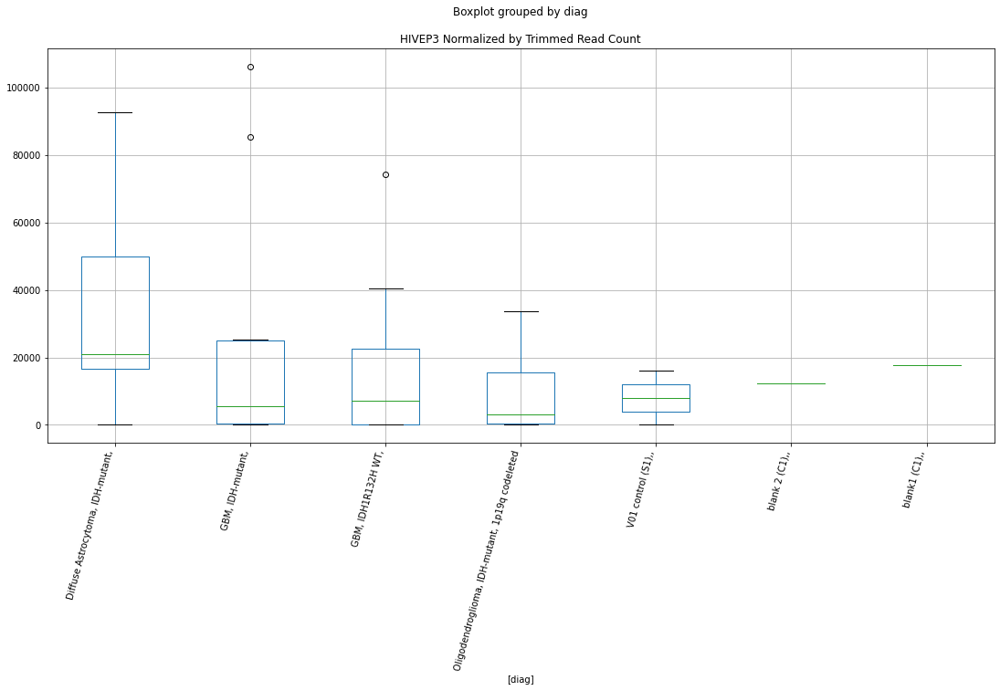

 p : 0.03860146508605057  ( t : 2.2314977390400146 ) :  D-plex  :  cutadapt2  :  GXYLT1P3
Control and blanks
76     0.0
340    0.0
Name: GXYLT1P3, dtype: float64
208    0.0
Name: GXYLT1P3, dtype: float64
472    577.96
Name: GXYLT1P3, dtype: float64


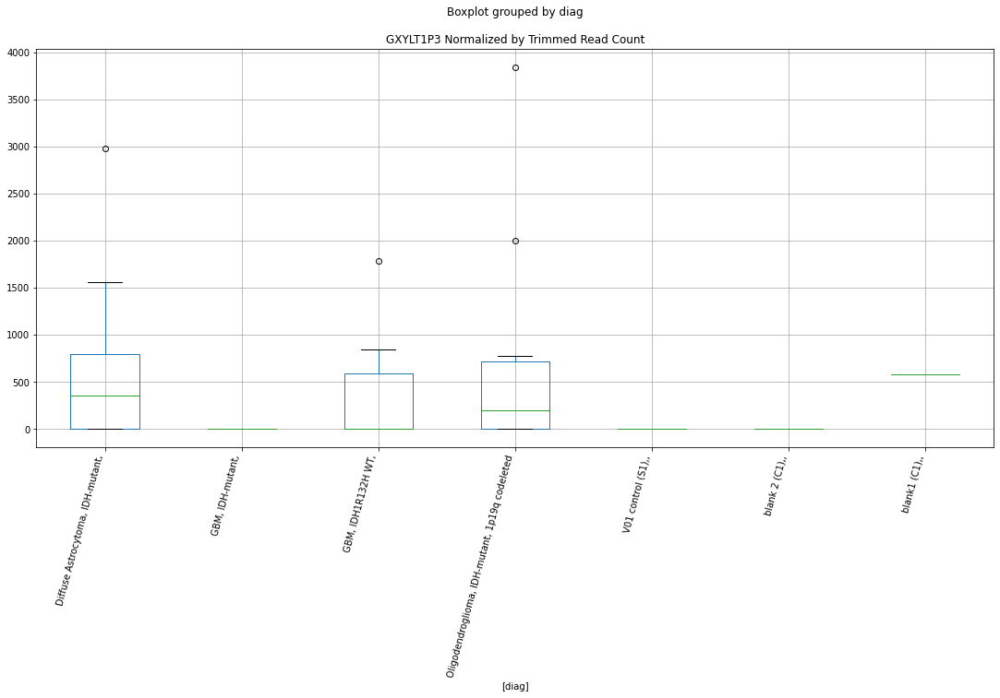

 p : 0.03869532280048325  ( t : 2.2302850925372537 ) :  D-plex  :  bbduk2  :  FEN1
Control and blanks
73     0.0
337    0.0
Name: FEN1, dtype: float64
205    3760.91
Name: FEN1, dtype: float64
469    6506.8
Name: FEN1, dtype: float64


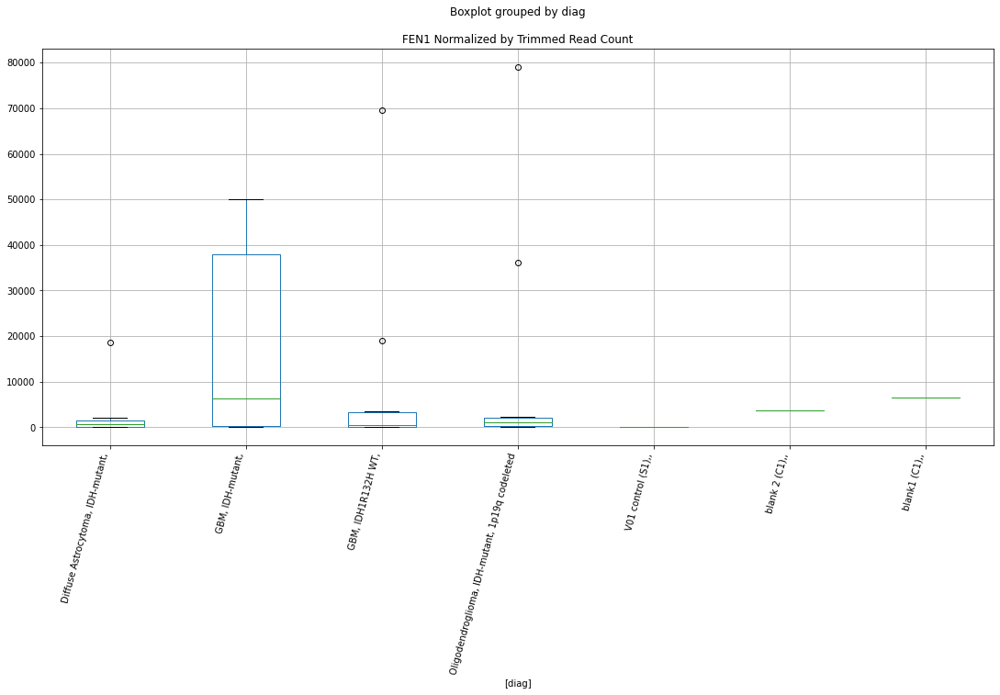

 p : 0.03878687788812248  ( t : 2.229104803695524 ) :  D-plex  :  bbduk2  :  GBE1
Control and blanks
73     0.0
337    0.0
Name: GBE1, dtype: float64
205    895.45
Name: GBE1, dtype: float64
469    0.0
Name: GBE1, dtype: float64


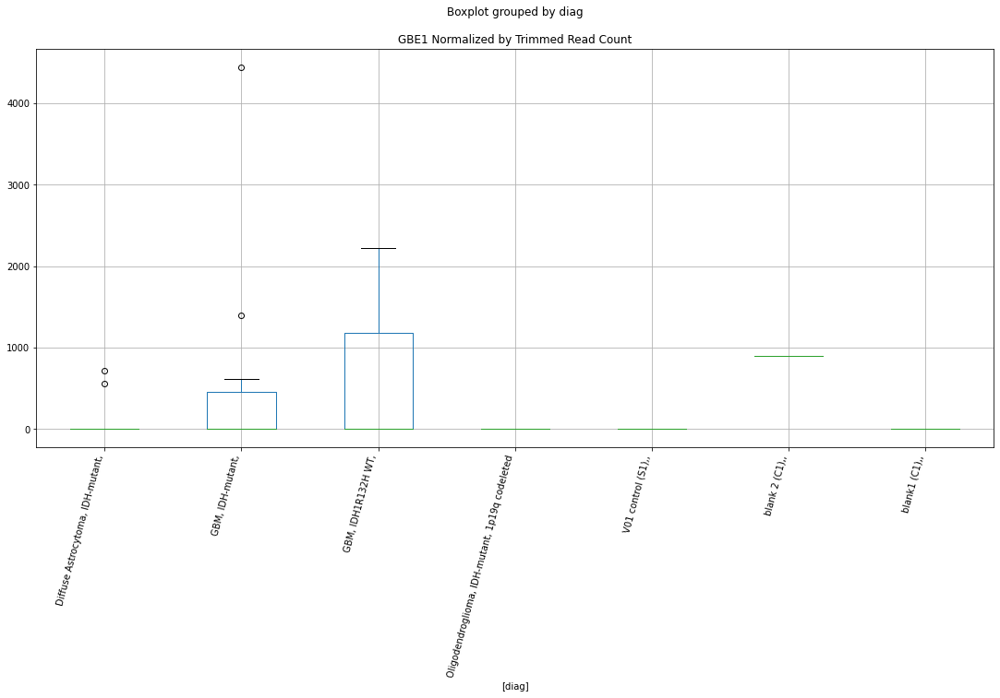

 p : 0.038794702266121056  ( t : 2.2290040542307583 ) :  D-plex  :  cutadapt2  :  GAB1
Control and blanks
76     100005.08
340     70458.57
Name: GAB1, dtype: float64
208    137208.25
Name: GAB1, dtype: float64
472    53171.94
Name: GAB1, dtype: float64


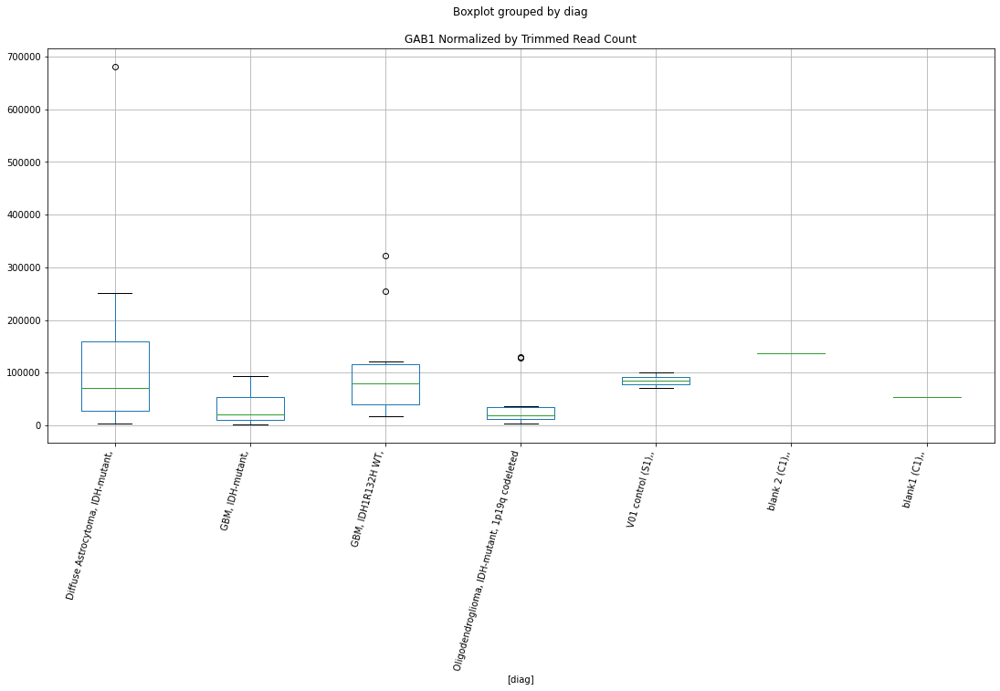

 p : 0.03885086098929194  ( t : 2.228281483304082 ) :  D-plex  :  cutadapt2  :  KIFAP3
Control and blanks
76       0.00
340    880.73
Name: KIFAP3, dtype: float64
208    705.44
Name: KIFAP3, dtype: float64
472    0.0
Name: KIFAP3, dtype: float64


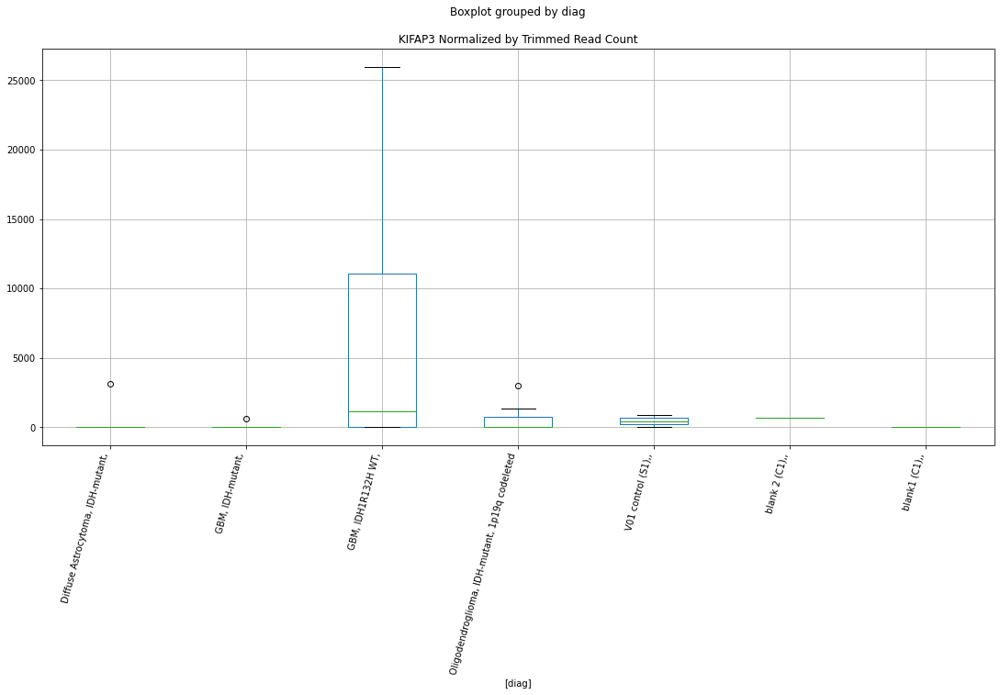

 p : 0.03885619598940141  ( t : 2.22821289011631 ) :  D-plex  :  bbduk2  :  ITGA2
Control and blanks
73     0.0
337    0.0
Name: ITGA2, dtype: float64
205    1970.0
Name: ITGA2, dtype: float64
469    2957.64
Name: ITGA2, dtype: float64


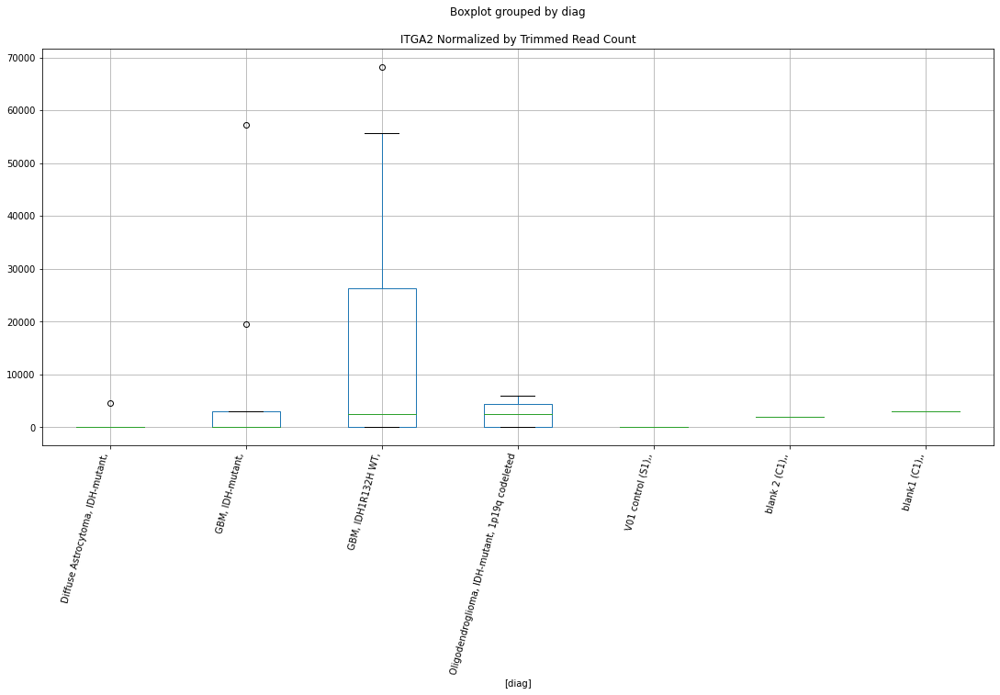

 p : 0.03885642233017549  ( t : 2.228209980198469 ) :  Lexogen  :  bbduk2  :  DUSP10
Control and blanks
79     4291.80
343    2760.09
Name: DUSP10, dtype: float64
211    4099.6
Name: DUSP10, dtype: float64
475    1916.13
Name: DUSP10, dtype: float64


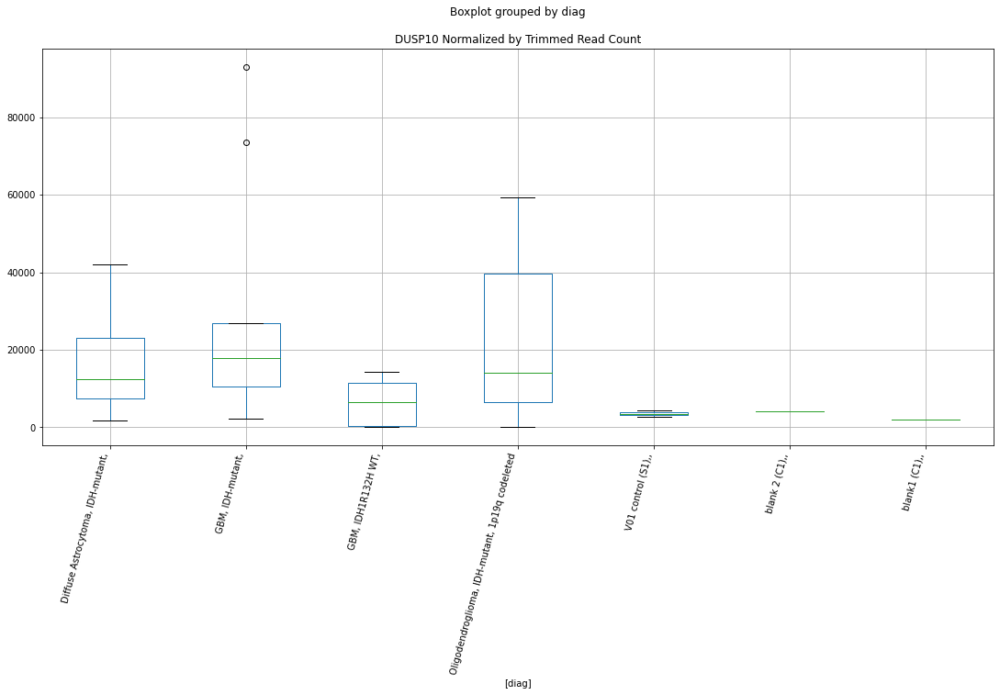

 p : 0.038887885436466214  ( t : 2.227805631087577 ) :  Lexogen  :  bbduk2  :  EOGT
Control and blanks
79     0.0
343    0.0
Name: EOGT, dtype: float64
211    0.0
Name: EOGT, dtype: float64
475    0.0
Name: EOGT, dtype: float64


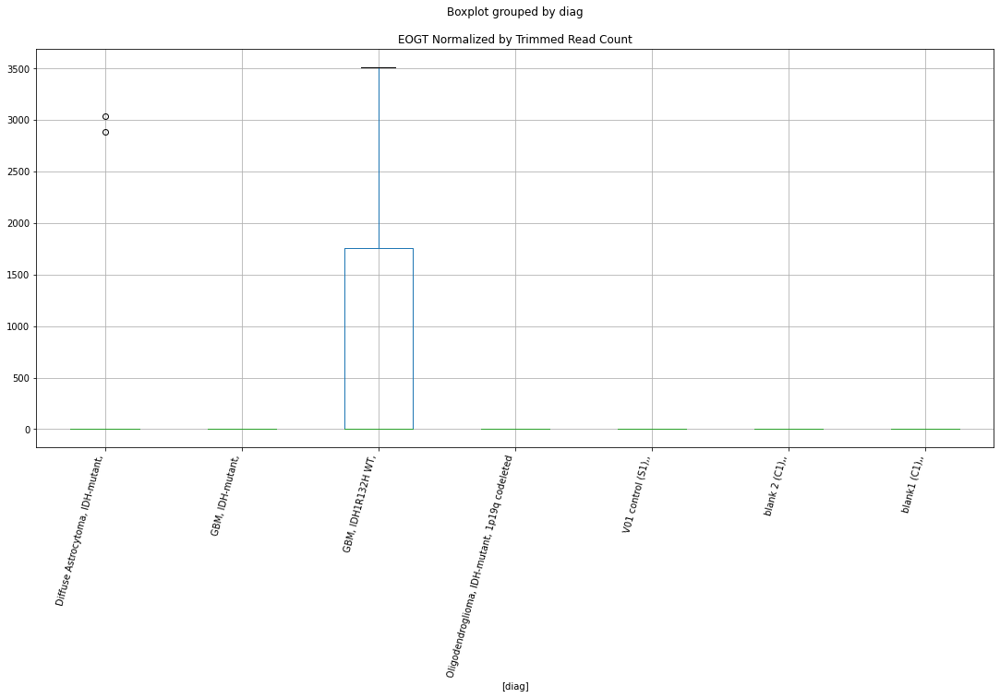

 p : 0.038901846752546036  ( t : 2.2276263032840617 ) :  D-plex  :  cutadapt2  :  FAM27E4
Control and blanks
76     757.61
340    880.73
Name: FAM27E4, dtype: float64
208    9876.17
Name: FAM27E4, dtype: float64
472    13870.94
Name: FAM27E4, dtype: float64


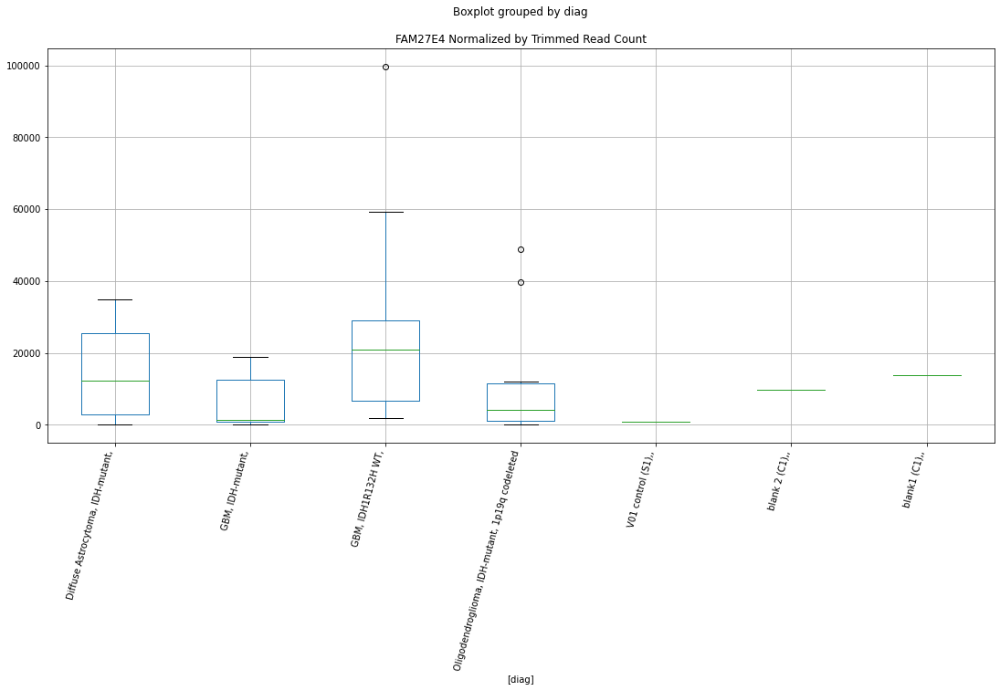

 p : 0.0389087597446824  ( t : 2.2275375304622296 ) :  D-plex  :  bbduk2  :  DOCK9
Control and blanks
73     25509.28
337    58750.38
Name: DOCK9, dtype: float64
205    76471.84
Name: DOCK9, dtype: float64
469    605132.45
Name: DOCK9, dtype: float64


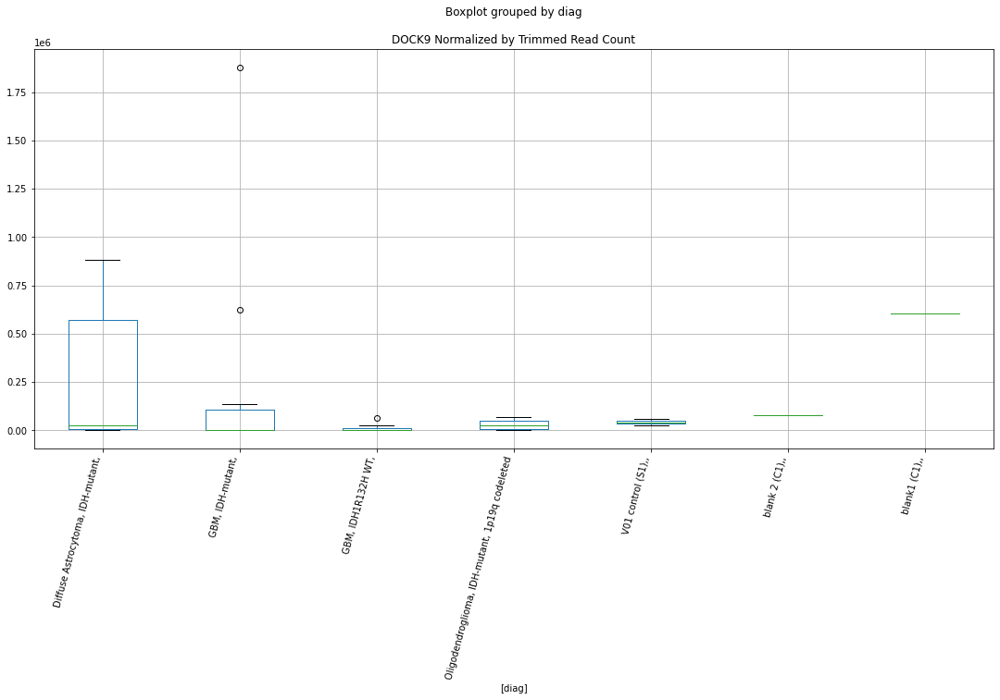

 p : 0.03898336262173838  ( t : 2.226580444569 ) :  D-plex  :  bbduk2  :  GALR2
Control and blanks
73     0.0
337    0.0
Name: GALR2, dtype: float64
205    0.0
Name: GALR2, dtype: float64
469    0.0
Name: GALR2, dtype: float64


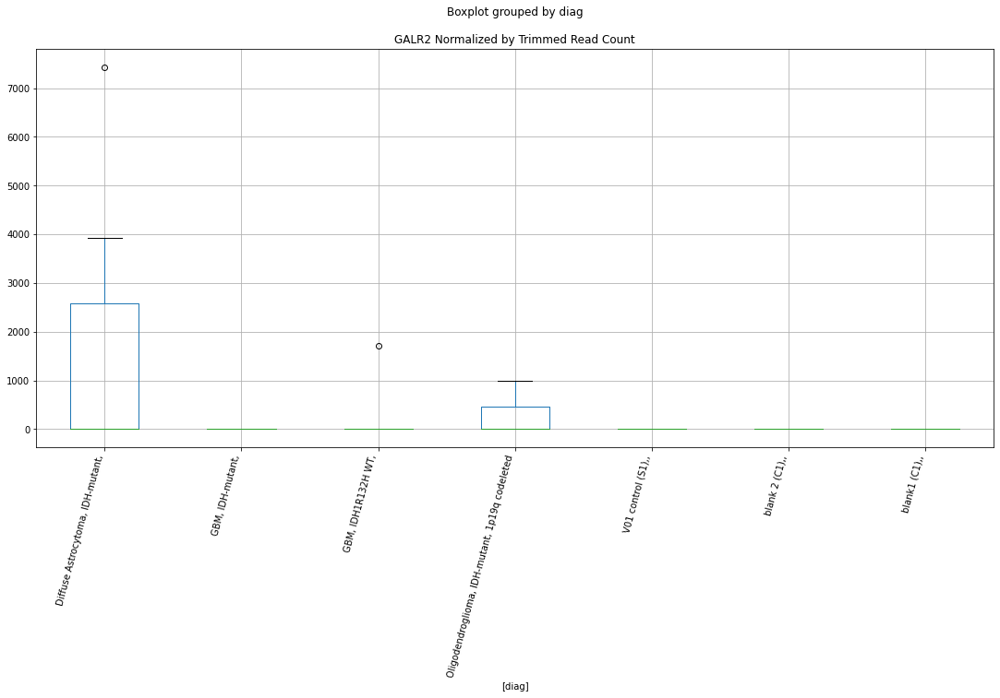

 p : 0.03905800756490782  ( t : 2.225624505435231 ) :  Lexogen  :  cutadapt2  :  ETF1
Control and blanks
82     11360.41
346     8417.38
Name: ETF1, dtype: float64
214    4339.62
Name: ETF1, dtype: float64
478    5699.05
Name: ETF1, dtype: float64


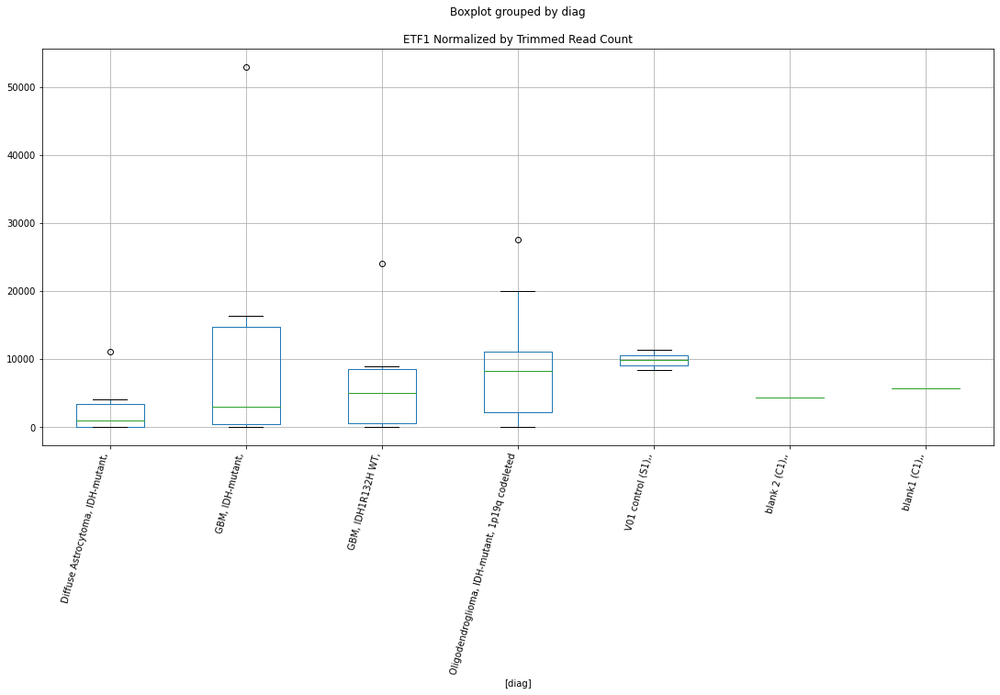

 p : 0.039061680777030566  ( t : 2.2255775079457063 ) :  D-plex  :  cutadapt2  :  KCNMB4
Control and blanks
76     0.0
340    0.0
Name: KCNMB4, dtype: float64
208    2998.12
Name: KCNMB4, dtype: float64
472    1733.87
Name: KCNMB4, dtype: float64


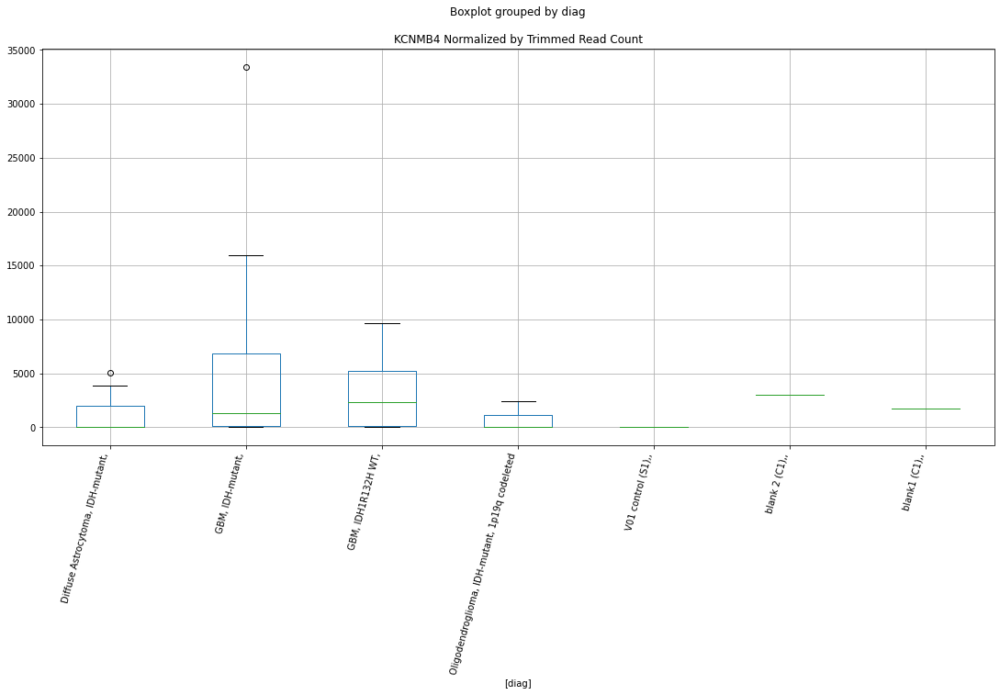

 p : 0.03913999613559738  ( t : 2.224576456726707 ) :  D-plex  :  cutadapt2  :  FEN1
Control and blanks
76     0.0
340    0.0
Name: FEN1, dtype: float64
208    3703.56
Name: FEN1, dtype: float64
472    5779.56
Name: FEN1, dtype: float64


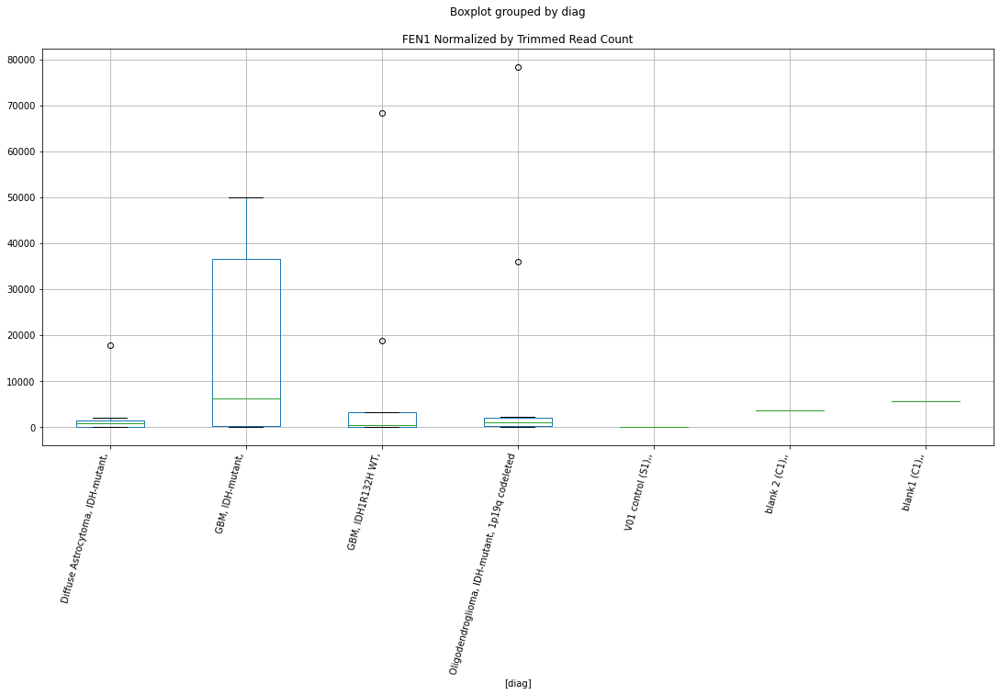

 p : 0.039178528908446045  ( t : 2.2240845955282027 ) :  Lexogen  :  cutadapt2  :  HIPK1
Control and blanks
82     0.0
346    0.0
Name: HIPK1, dtype: float64
214    0.0
Name: HIPK1, dtype: float64
478    0.0
Name: HIPK1, dtype: float64


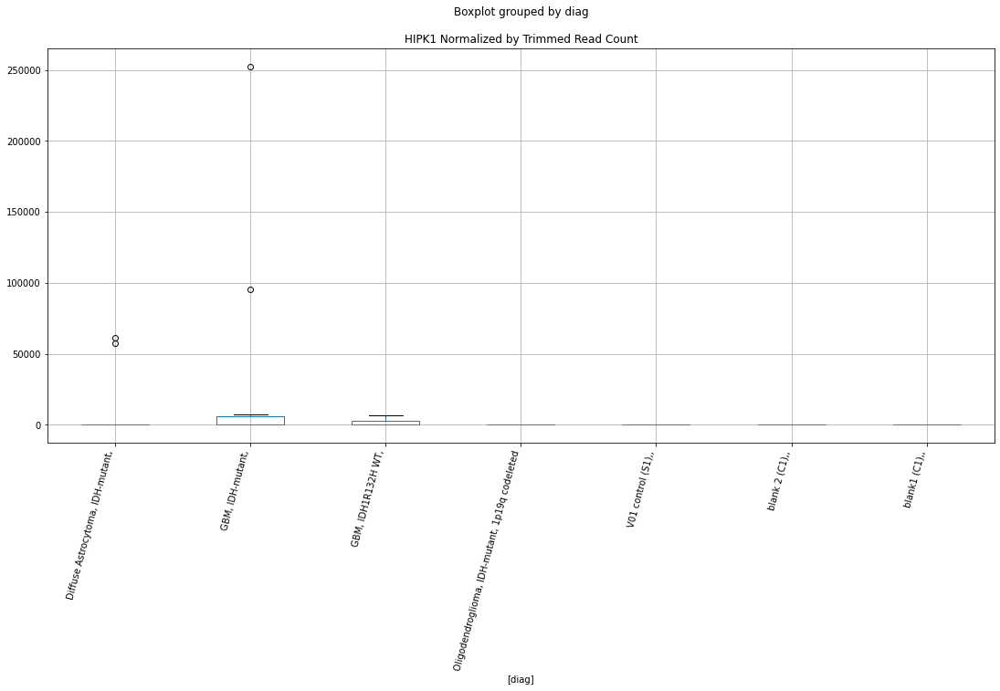

 p : 0.039196378194991215  ( t : 2.2238569047582506 ) :  Lexogen  :  cutadapt2  :  KCNC4
Control and blanks
82       0.00
346    420.87
Name: KCNC4, dtype: float64
214    0.0
Name: KCNC4, dtype: float64
478    0.0
Name: KCNC4, dtype: float64


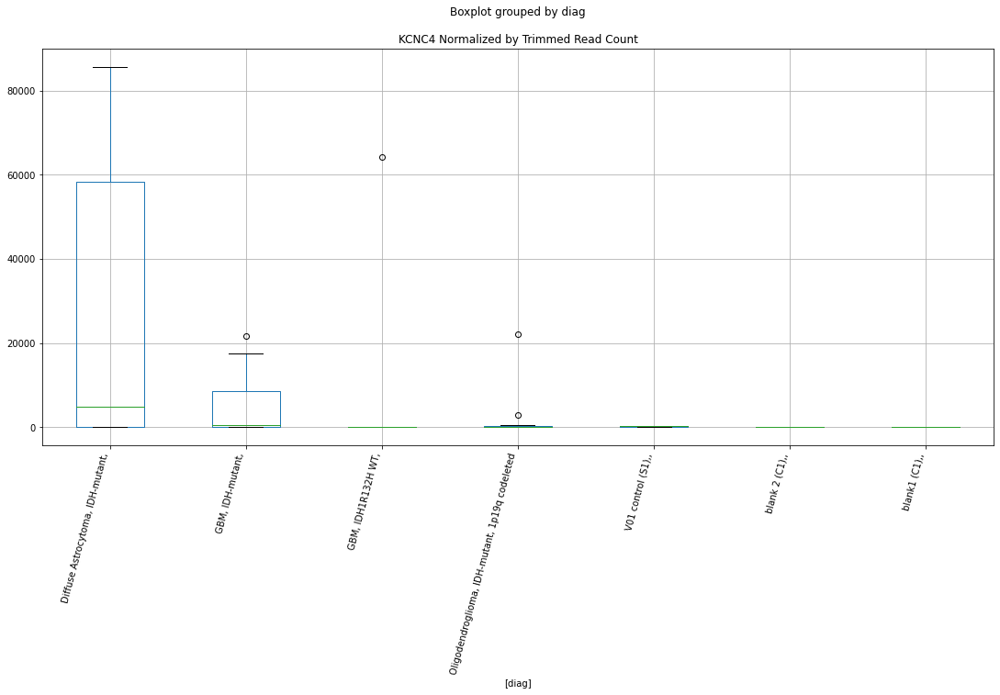

 p : 0.03921896789275432  ( t : 2.223568880699637 ) :  D-plex  :  cutadapt2  :  HDAC2
Control and blanks
76     3030.46
340       0.00
Name: HDAC2, dtype: float64
208    5114.45
Name: HDAC2, dtype: float64
472    4623.65
Name: HDAC2, dtype: float64


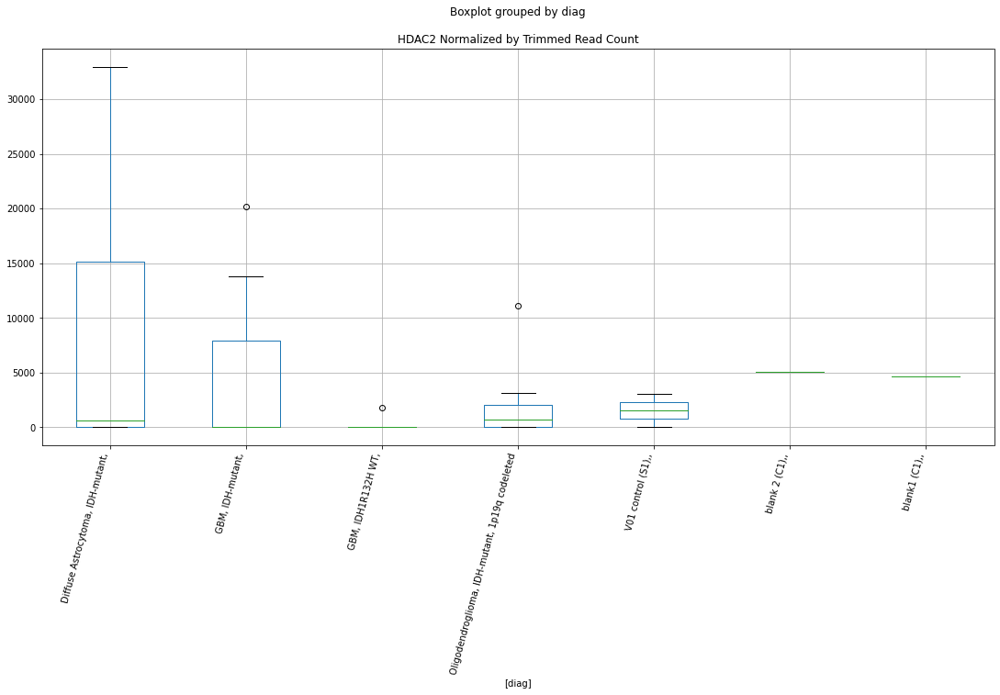

 p : 0.0392940564000718  ( t : 2.2226125804584145 ) :  D-plex  :  cutadapt2  :  ELAVL3
Control and blanks
76     15909.9
340        0.0
Name: ELAVL3, dtype: float64
208    274769.22
Name: ELAVL3, dtype: float64
472    12137.07
Name: ELAVL3, dtype: float64


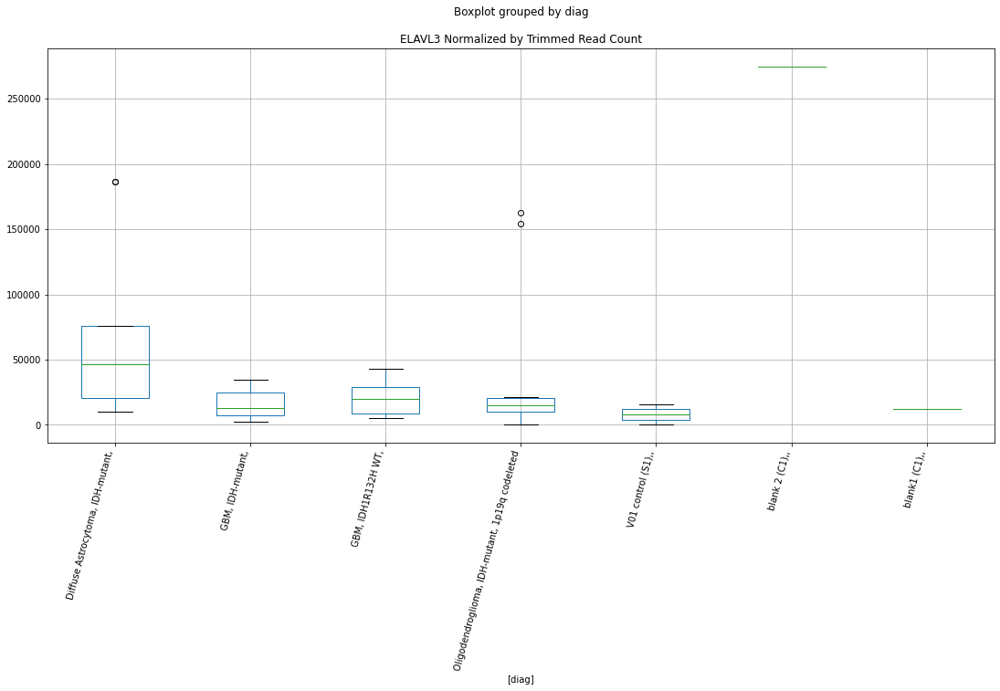

 p : 0.03930991728784004  ( t : 2.2224107970855234 ) :  Lexogen  :  cutadapt2  :  ITGA4
Control and blanks
82       0.00
346    210.43
Name: ITGA4, dtype: float64
214    0.0
Name: ITGA4, dtype: float64
478    0.0
Name: ITGA4, dtype: float64


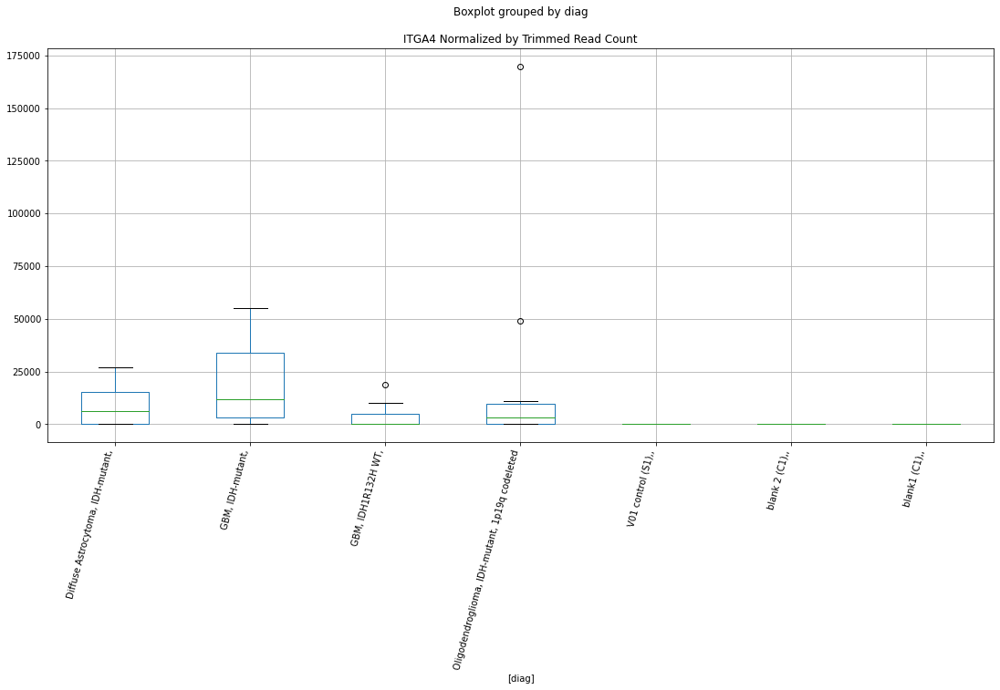

 p : 0.03938066287563306  ( t : 2.221511678094106 ) :  D-plex  :  cutadapt2  :  FAM78A
Control and blanks
76      2272.84
340    58128.32
Name: FAM78A, dtype: float64
208    93647.28
Name: FAM78A, dtype: float64
472    6935.47
Name: FAM78A, dtype: float64


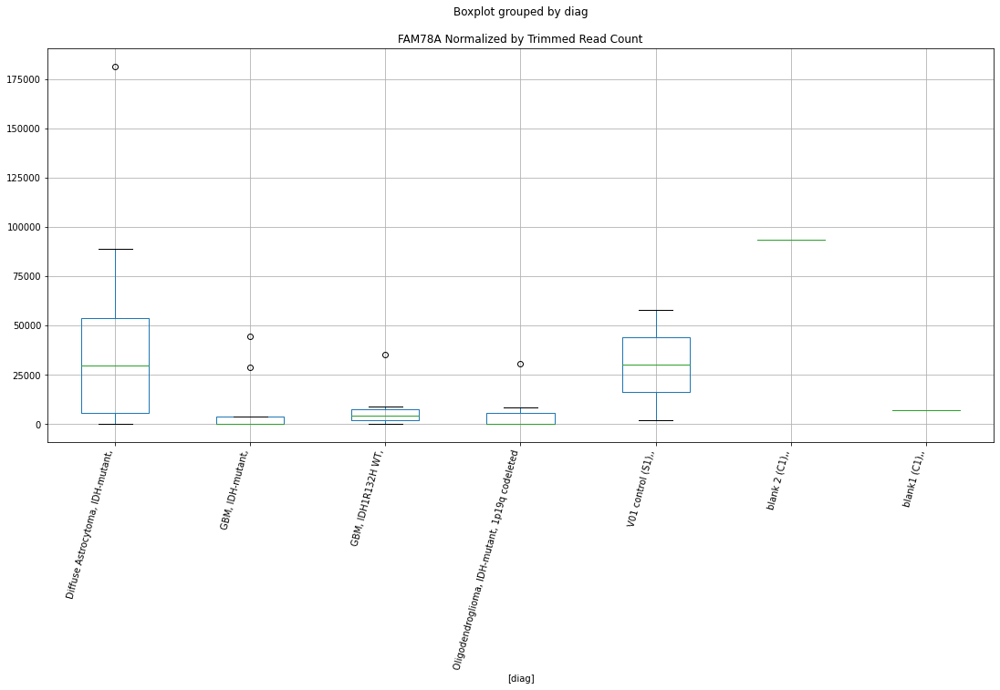

 p : 0.03939961790225666  ( t : 2.2212710276057166 ) :  D-plex  :  cutadapt2  :  DUSP28
Control and blanks
76     3030.46
340       0.00
Name: DUSP28, dtype: float64
208    705.44
Name: DUSP28, dtype: float64
472    0.0
Name: DUSP28, dtype: float64


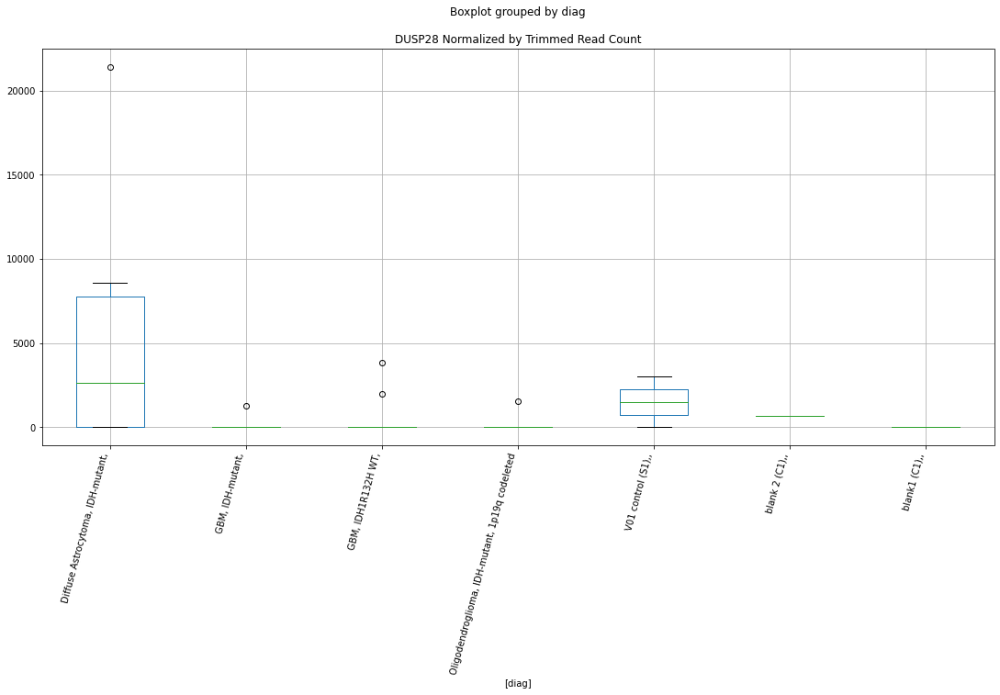

 p : 0.03940181082656077  ( t : 2.221243193408265 ) :  D-plex  :  cutadapt2  :  IQSEC3
Control and blanks
76     12879.44
340    62531.98
Name: IQSEC3, dtype: float64
208    37035.65
Name: IQSEC3, dtype: float64
472    57795.58
Name: IQSEC3, dtype: float64


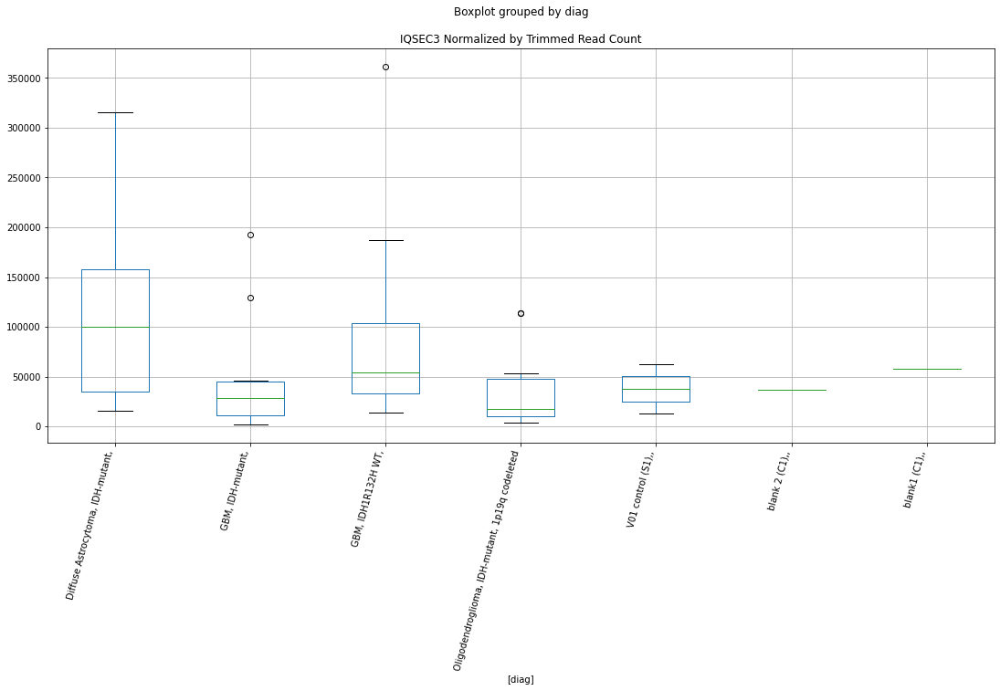

 p : 0.0394077625361074  ( t : 2.2211676571470997 ) :  D-plex  :  cutadapt2  :  GPT
Control and blanks
76     0.0
340    0.0
Name: GPT, dtype: float64
208    0.0
Name: GPT, dtype: float64
472    1155.91
Name: GPT, dtype: float64


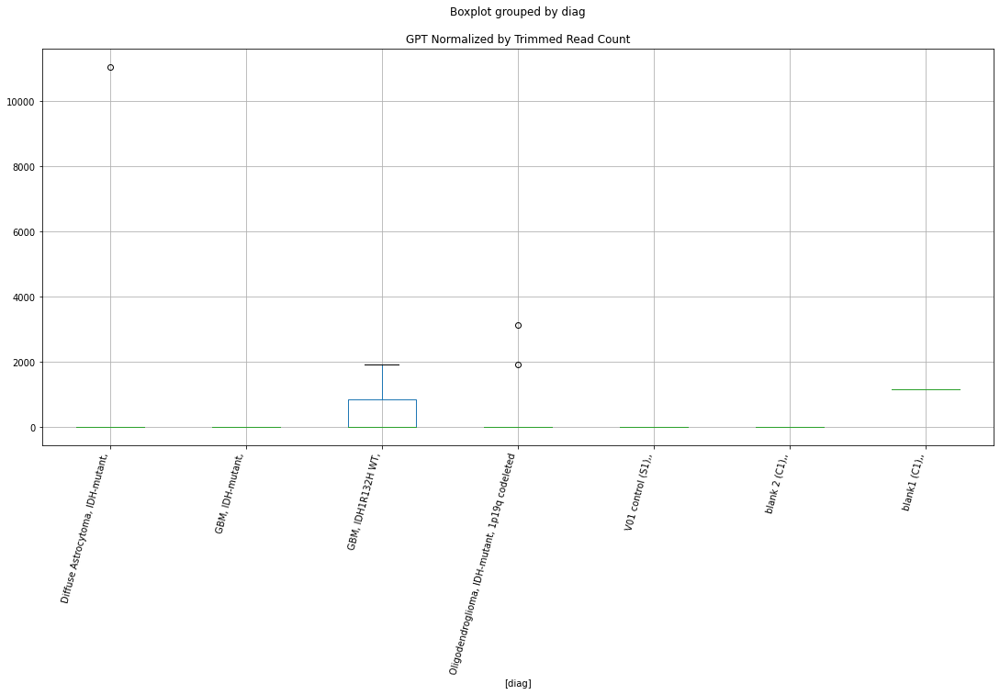

 p : 0.03945604315433172  ( t : 2.2205552902759114 ) :  Lexogen  :  bbduk2  :  GLI3
Control and blanks
79       0.00
343    212.31
Name: GLI3, dtype: float64
211    7379.27
Name: GLI3, dtype: float64
475    0.0
Name: GLI3, dtype: float64


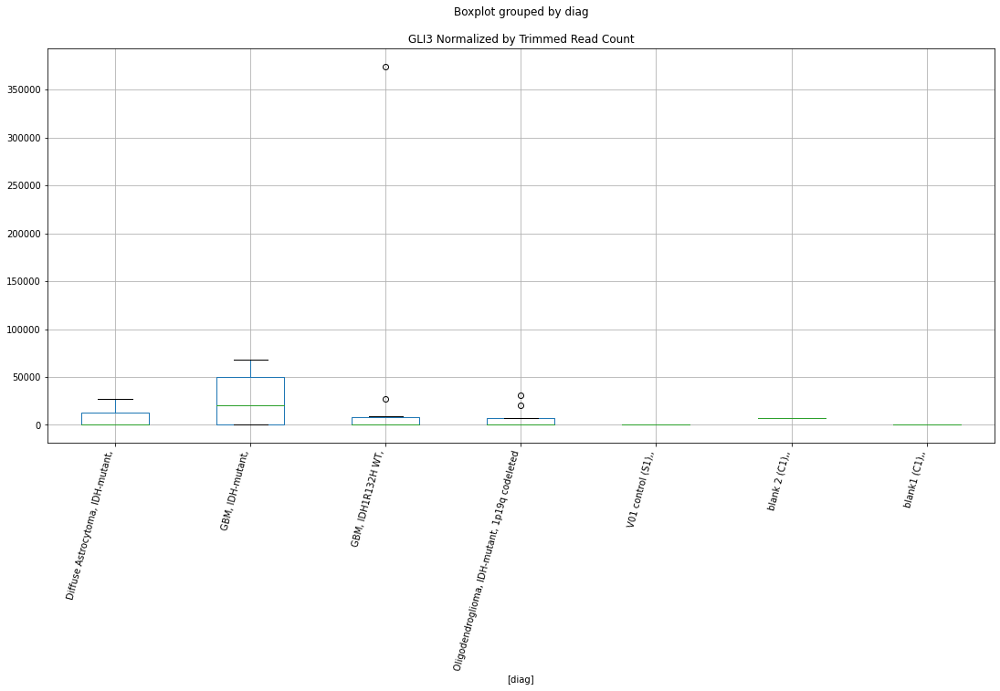

 p : 0.03952324900375811  ( t : 2.219704032350039 ) :  D-plex  :  cutadapt2  :  GDF1
Control and blanks
76     0.0
340    0.0
Name: GDF1, dtype: float64
208    176.36
Name: GDF1, dtype: float64
472    0.0
Name: GDF1, dtype: float64


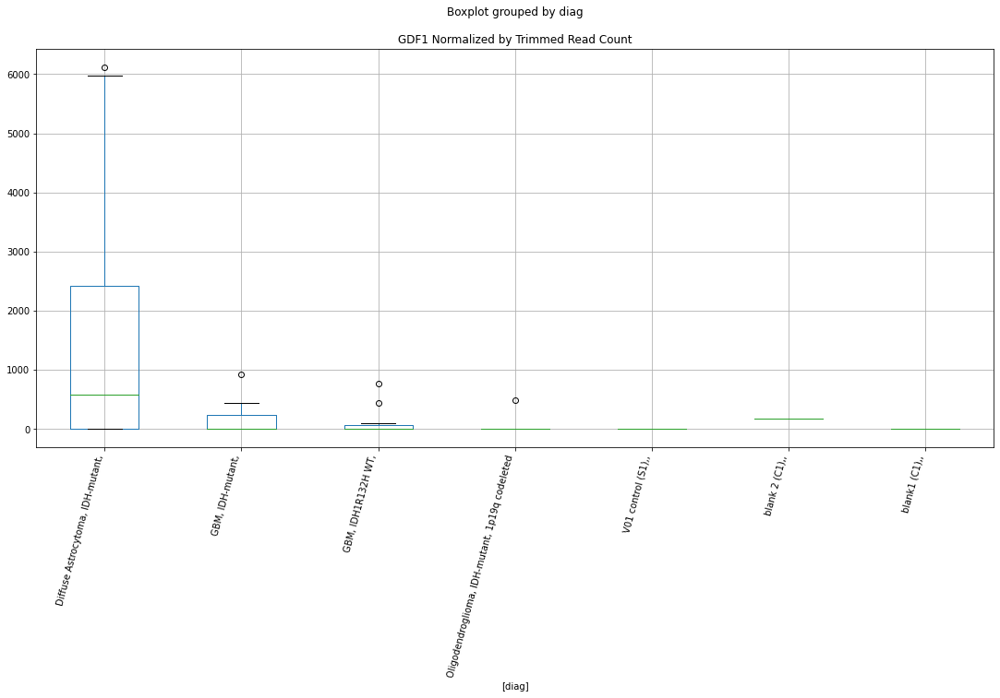

 p : 0.039574938886461866  ( t : 2.2190502119656124 ) :  Lexogen  :  cutadapt2  :  GNB1L
Control and blanks
82       0.0
346    631.3
Name: GNB1L, dtype: float64
214    0.0
Name: GNB1L, dtype: float64
478    0.0
Name: GNB1L, dtype: float64


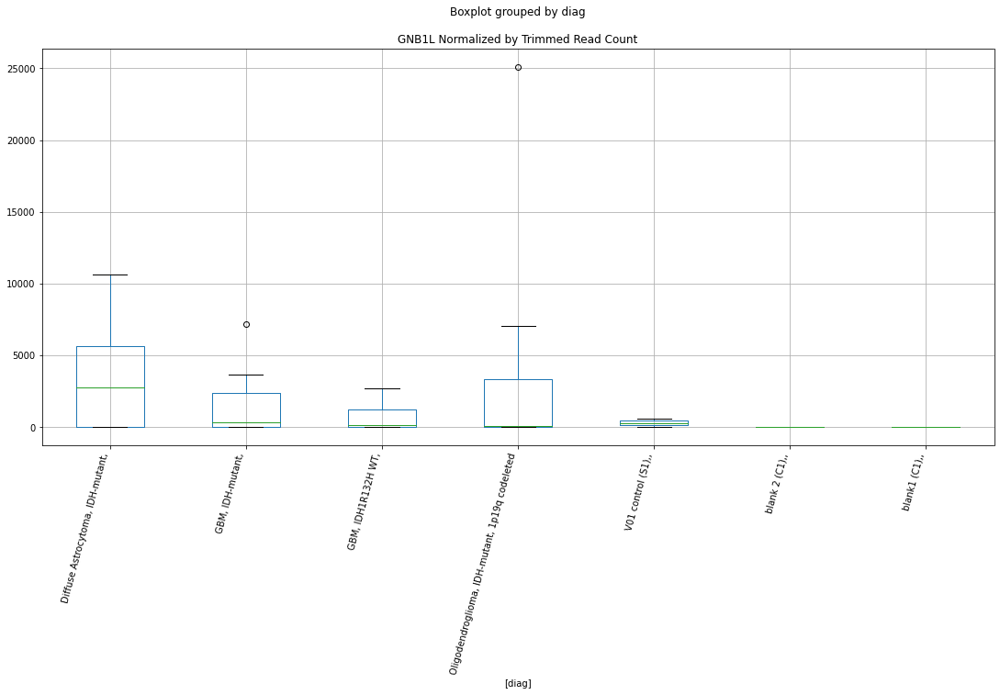

 p : 0.039591715023051165  ( t : 2.2188381811059394 ) :  Lexogen  :  bbduk2  :  ETF1
Control and blanks
79     11444.79
343     8492.57
Name: ETF1, dtype: float64
211    2186.45
Name: ETF1, dtype: float64
475    7664.5
Name: ETF1, dtype: float64


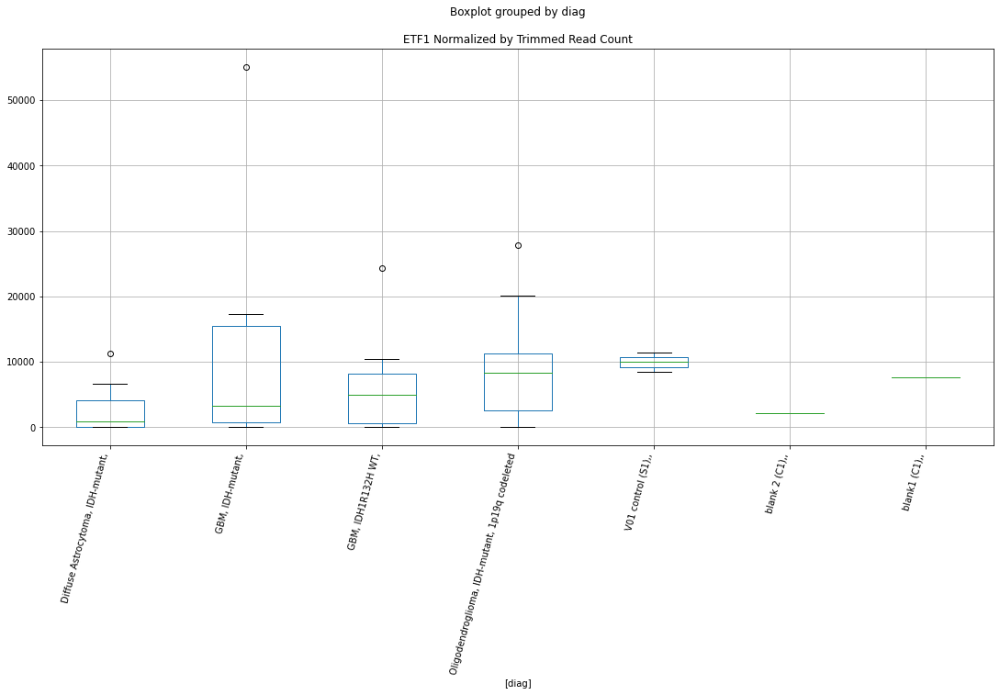

 p : 0.03960431547179053  ( t : 2.2186789804398157 ) :  D-plex  :  bbduk2  :  KTN1
Control and blanks
73         0.00
337    16022.83
Name: KTN1, dtype: float64
205    25072.73
Name: KTN1, dtype: float64
469    0.0
Name: KTN1, dtype: float64


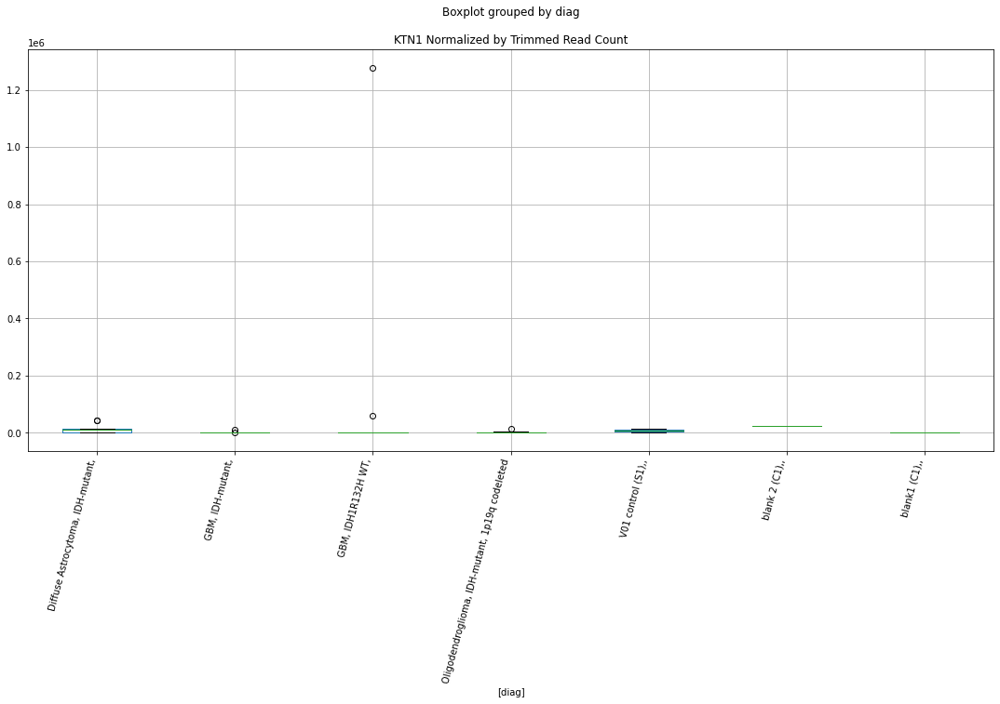

 p : 0.03964069695773866  ( t : 2.2182195790908583 ) :  D-plex  :  bbduk2  :  GOLGA6L10
Control and blanks
73     0.0
337    0.0
Name: GOLGA6L10, dtype: float64
205    1790.91
Name: GOLGA6L10, dtype: float64
469    1774.58
Name: GOLGA6L10, dtype: float64


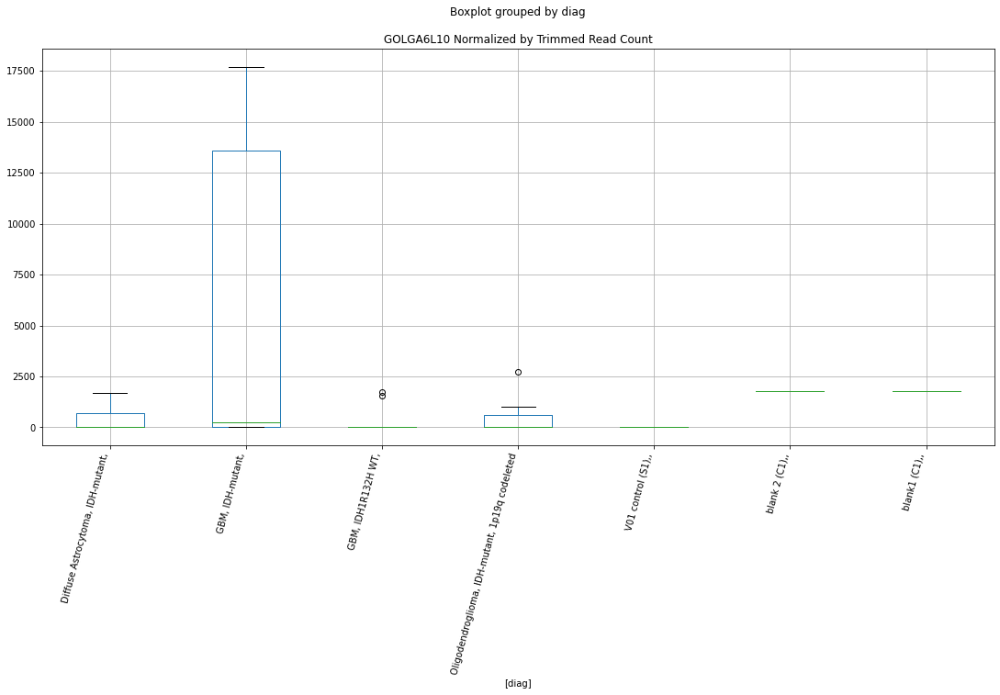

 p : 0.039773119553557376  ( t : 2.2165507031230987 ) :  D-plex  :  cutadapt2  :  KHDC1
Control and blanks
76     0.0
340    0.0
Name: KHDC1, dtype: float64
208    3879.92
Name: KHDC1, dtype: float64
472    6357.51
Name: KHDC1, dtype: float64


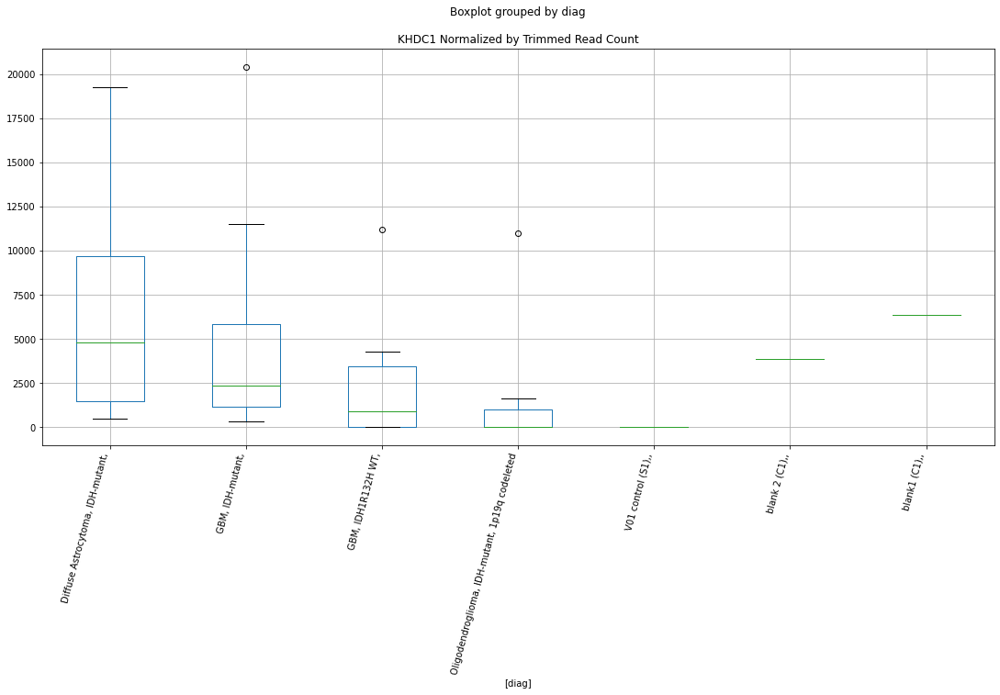

 p : 0.03980915470444003  ( t : 2.216097449382455 ) :  D-plex  :  cutadapt2  :  IGFL3
Control and blanks
76     3030.46
340       0.00
Name: IGFL3, dtype: float64
208    16048.78
Name: IGFL3, dtype: float64
472    18494.59
Name: IGFL3, dtype: float64


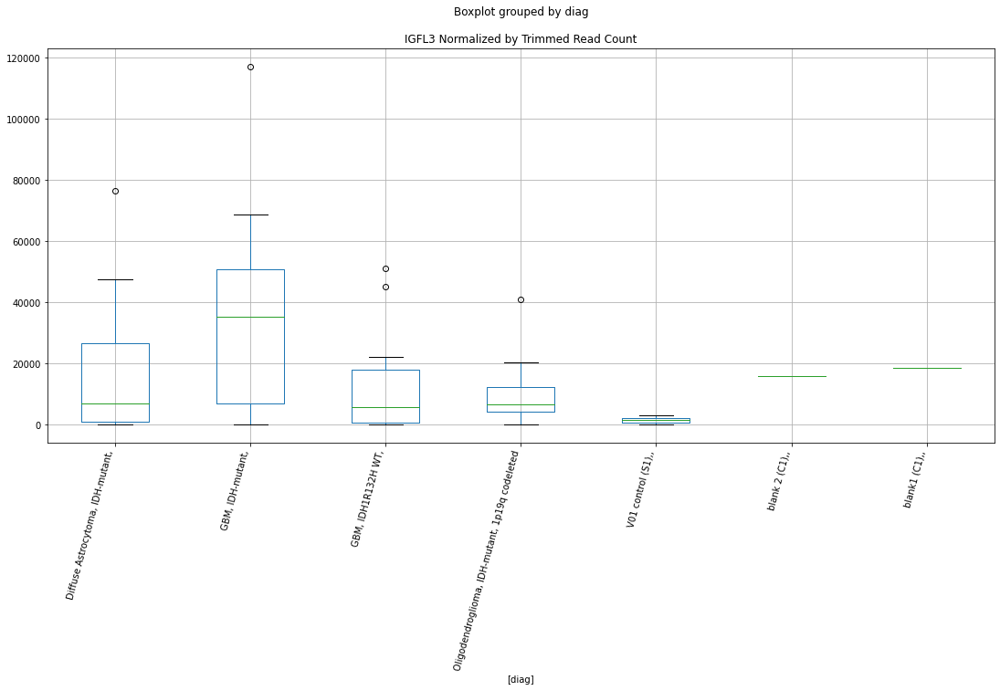

 p : 0.0398581563141679  ( t : 2.2154817073676303 ) :  D-plex  :  cutadapt2  :  FAM74A3
Control and blanks
76     0.0
340    0.0
Name: FAM74A3, dtype: float64
208    0.0
Name: FAM74A3, dtype: float64
472    0.0
Name: FAM74A3, dtype: float64


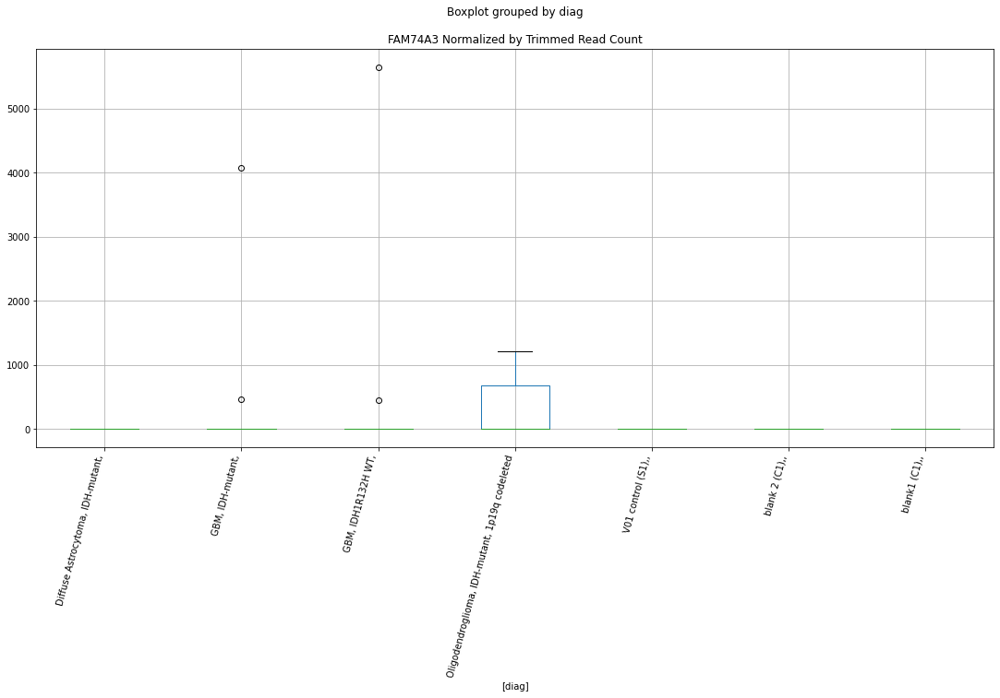

 p : 0.03995160569882119  ( t : 2.214309373252407 ) :  D-plex  :  cutadapt2  :  GDI1
Control and blanks
76     0.0
340    0.0
Name: GDI1, dtype: float64
208    352.72
Name: GDI1, dtype: float64
472    0.0
Name: GDI1, dtype: float64


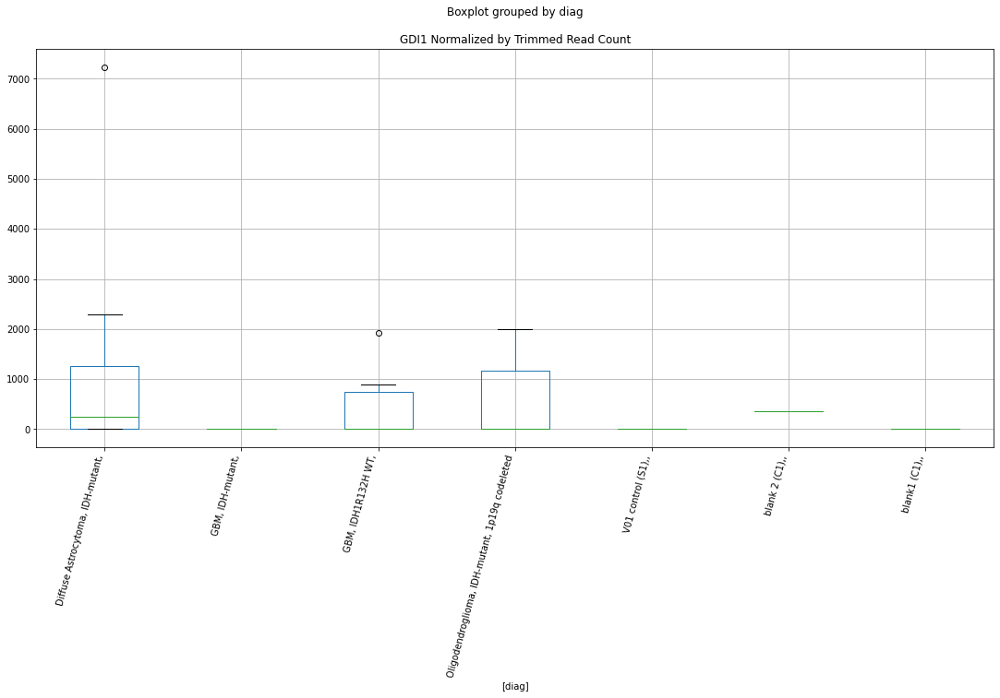

 p : 0.03996442364313568  ( t : 2.2141487672839975 ) :  D-plex  :  cutadapt2  :  ELP1
Control and blanks
76     0.0
340    0.0
Name: ELP1, dtype: float64
208    1058.16
Name: ELP1, dtype: float64
472    0.0
Name: ELP1, dtype: float64


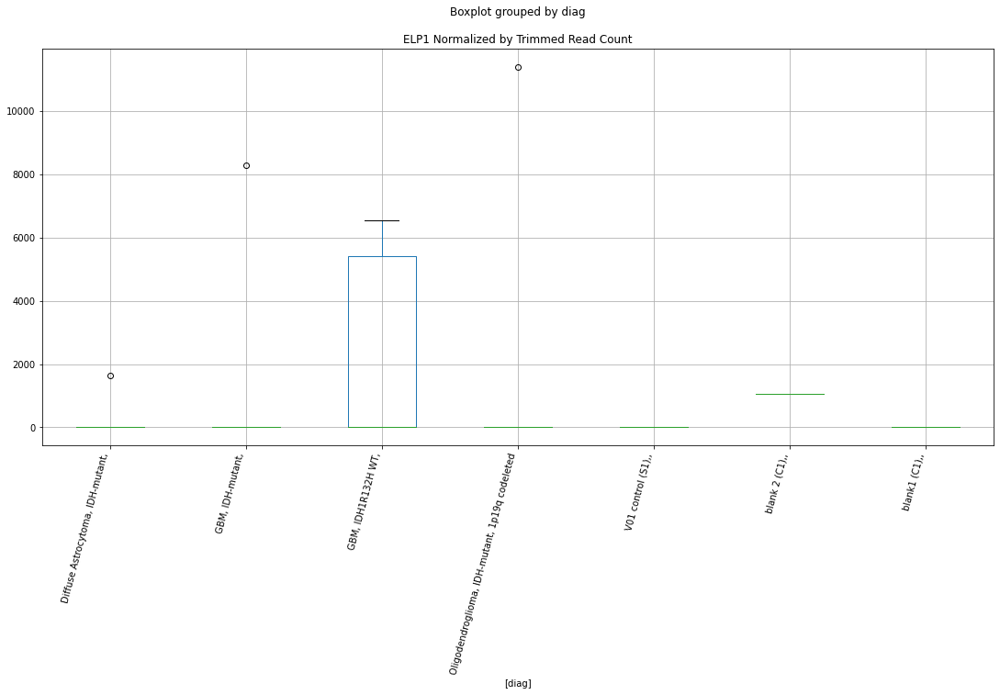

 p : 0.039964606184707485  ( t : 2.2141464804211815 ) :  D-plex  :  bbduk2  :  GAREM1
Control and blanks
73        0.00
337    5340.94
Name: GAREM1, dtype: float64
205    7521.82
Name: GAREM1, dtype: float64
469    8872.91
Name: GAREM1, dtype: float64


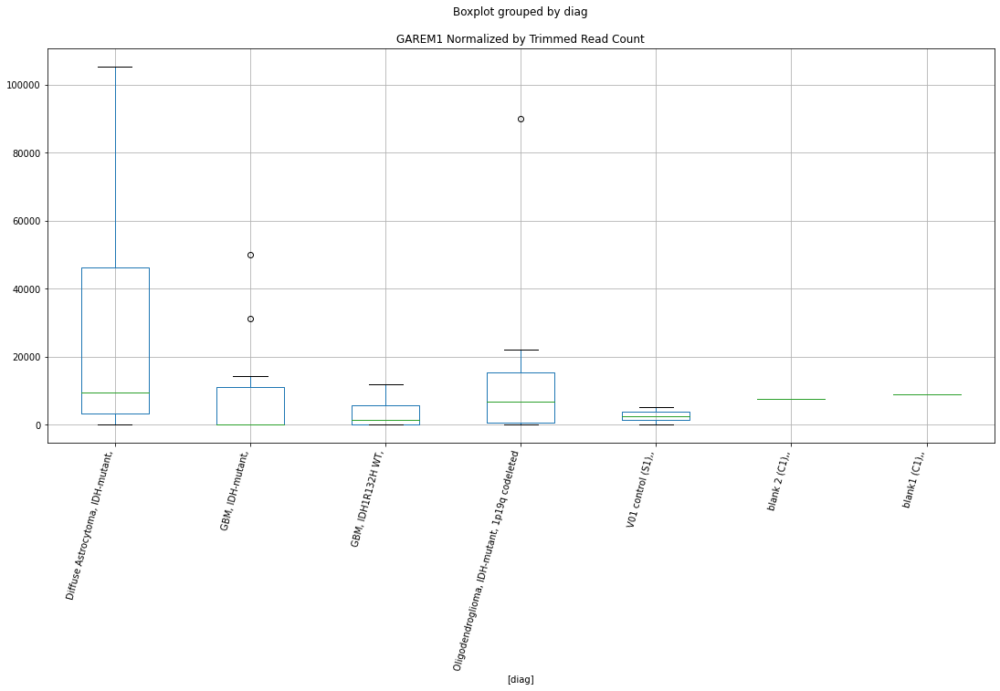

 p : 0.039991926864409354  ( t : 2.2138043179032816 ) :  Lexogen  :  cutadapt2  :  GALNT5
Control and blanks
82     0.0
346    0.0
Name: GALNT5, dtype: float64
214    0.0
Name: GALNT5, dtype: float64
478    949.84
Name: GALNT5, dtype: float64


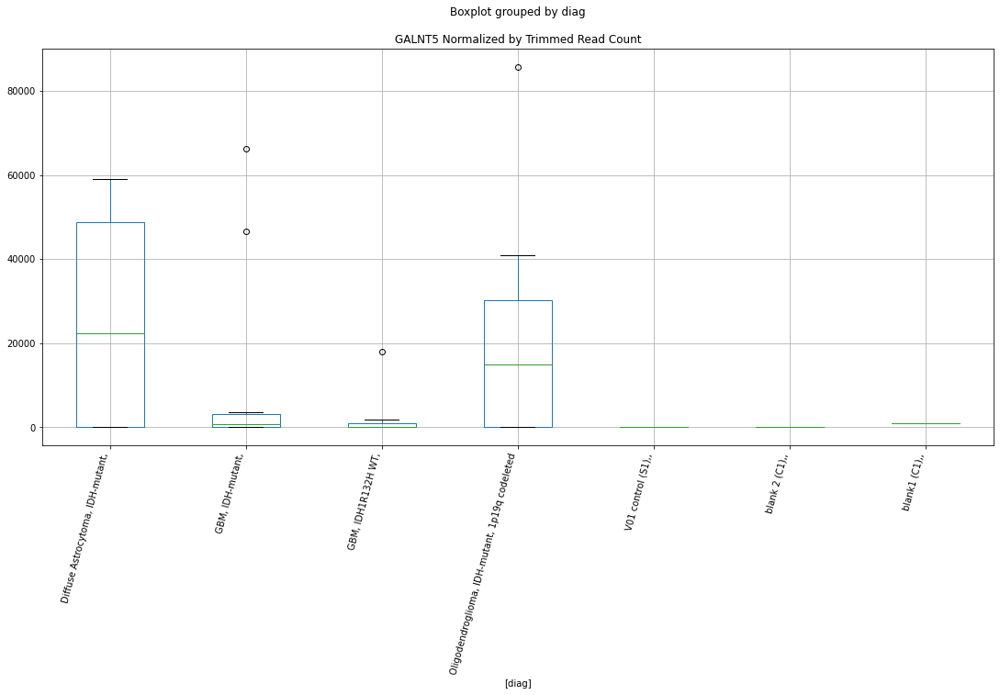

 p : 0.03999932338966535  ( t : 2.2137117212514927 ) :  Lexogen  :  cutadapt2  :  KHDRBS2
Control and blanks
82     0.0
346    0.0
Name: KHDRBS2, dtype: float64
214    8950.47
Name: KHDRBS2, dtype: float64
478    5699.05
Name: KHDRBS2, dtype: float64


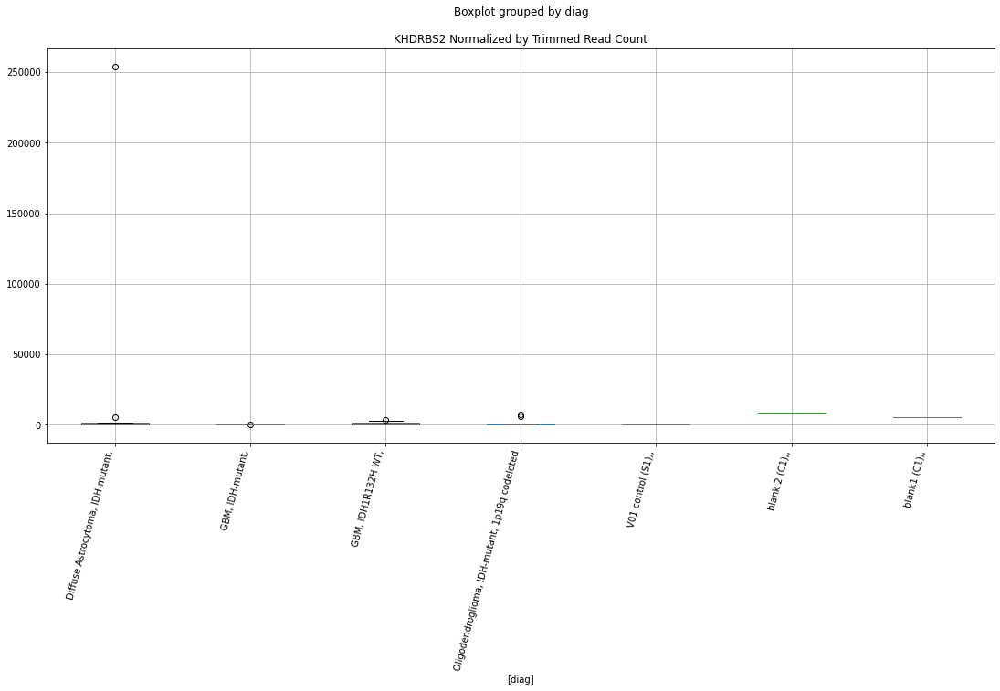

 p : 0.04000322761337833  ( t : 2.2136628508605702 ) :  D-plex  :  cutadapt2  :  GAS7
Control and blanks
76         0.00
340    12330.25
Name: GAS7, dtype: float64
208    17283.3
Name: GAS7, dtype: float64
472    40456.91
Name: GAS7, dtype: float64


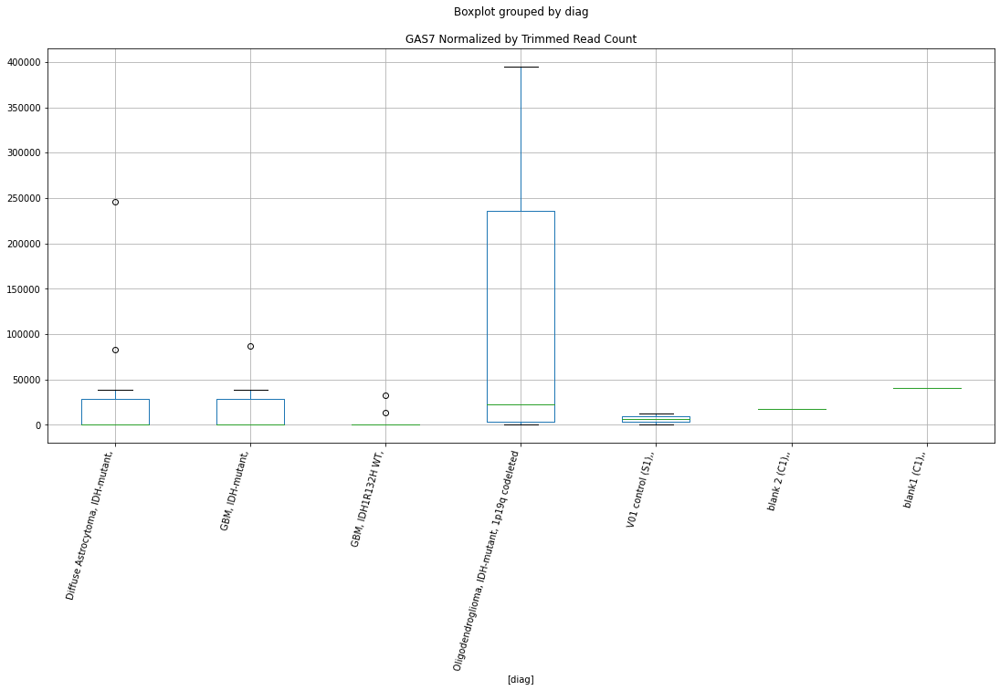

 p : 0.040036058327483304  ( t : 2.2132520719629434 ) :  D-plex  :  cutadapt2  :  DOK1
Control and blanks
76     36365.48
340        0.00
Name: DOK1, dtype: float64
208    10581.61
Name: DOK1, dtype: float64
472    1155.91
Name: DOK1, dtype: float64


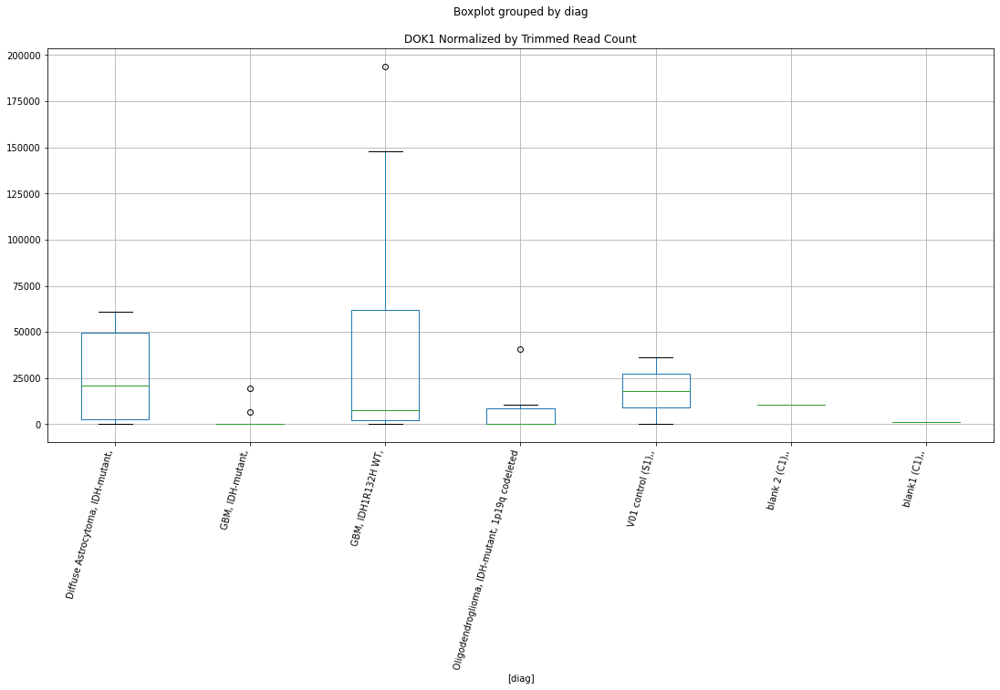

 p : 0.04009788529698197  ( t : 2.2124793312724482 ) :  D-plex  :  bbduk2  :  FAM78A
Control and blanks
73      2319.03
337    58750.38
Name: FAM78A, dtype: float64
205    94560.02
Name: FAM78A, dtype: float64
469    8872.91
Name: FAM78A, dtype: float64


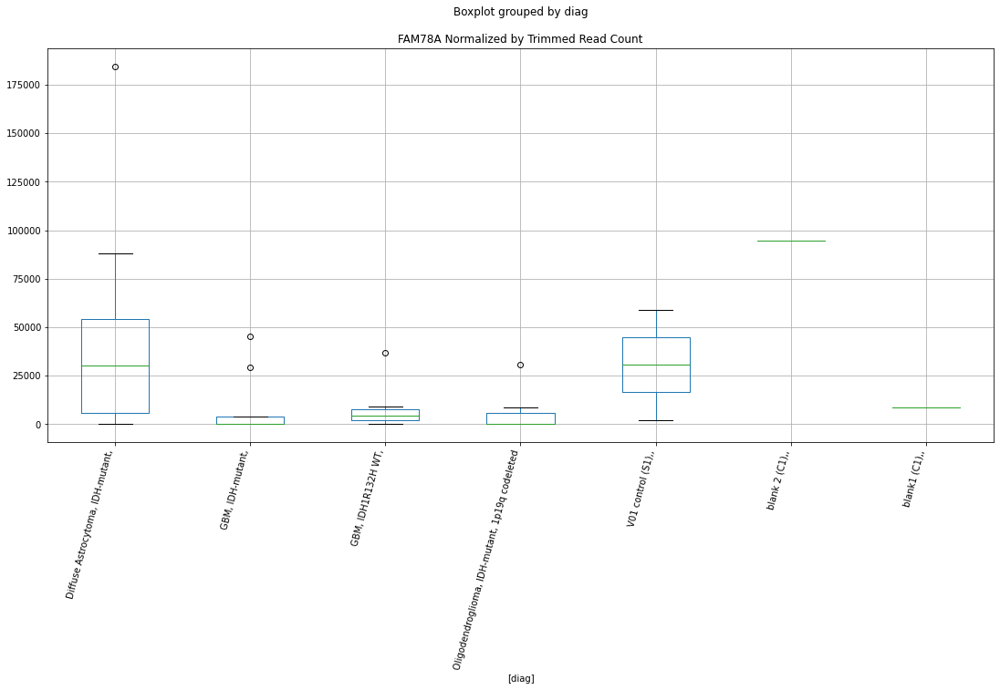

 p : 0.04012618189479959  ( t : 2.212126033331686 ) :  Lexogen  :  cutadapt2  :  ECI1
Control and blanks
82     0.0
346    0.0
Name: ECI1, dtype: float64
214    0.0
Name: ECI1, dtype: float64
478    0.0
Name: ECI1, dtype: float64


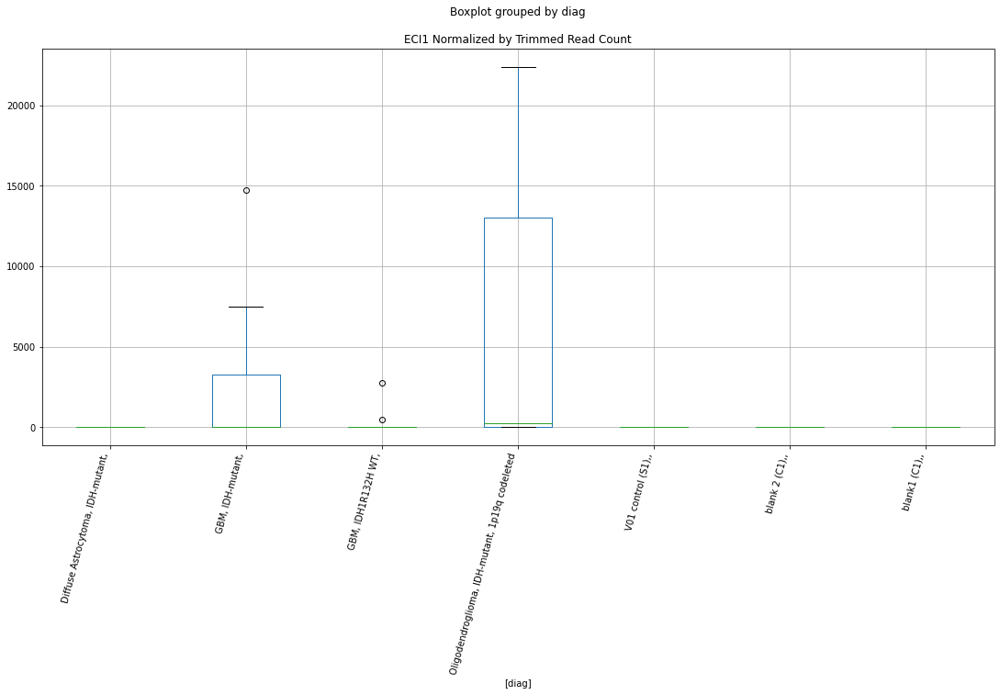

 p : 0.040134409243004654  ( t : 2.2120233535388056 ) :  D-plex  :  bbduk2  :  DNALI1
Control and blanks
73     22417.24
337        0.00
Name: DNALI1, dtype: float64
205    895.45
Name: DNALI1, dtype: float64
469    1774.58
Name: DNALI1, dtype: float64


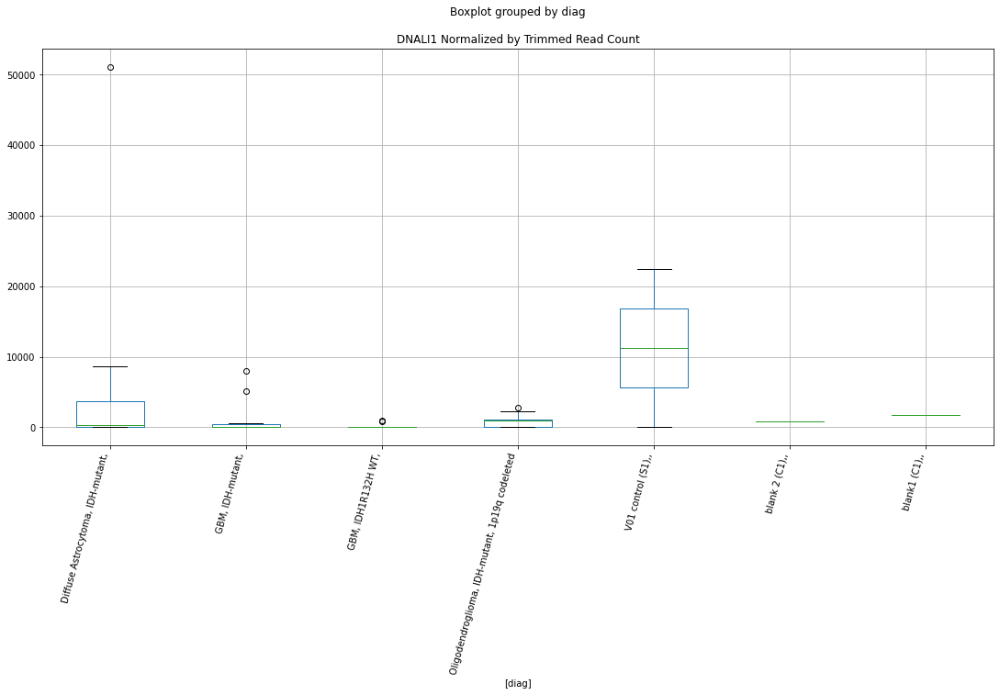

 p : 0.04013442486161414  ( t : 2.212023158632243 ) :  Lexogen  :  bbduk2  :  IGSF5
Control and blanks
79     0.0
343    0.0
Name: IGSF5, dtype: float64
211    0.0
Name: IGSF5, dtype: float64
475    0.0
Name: IGSF5, dtype: float64


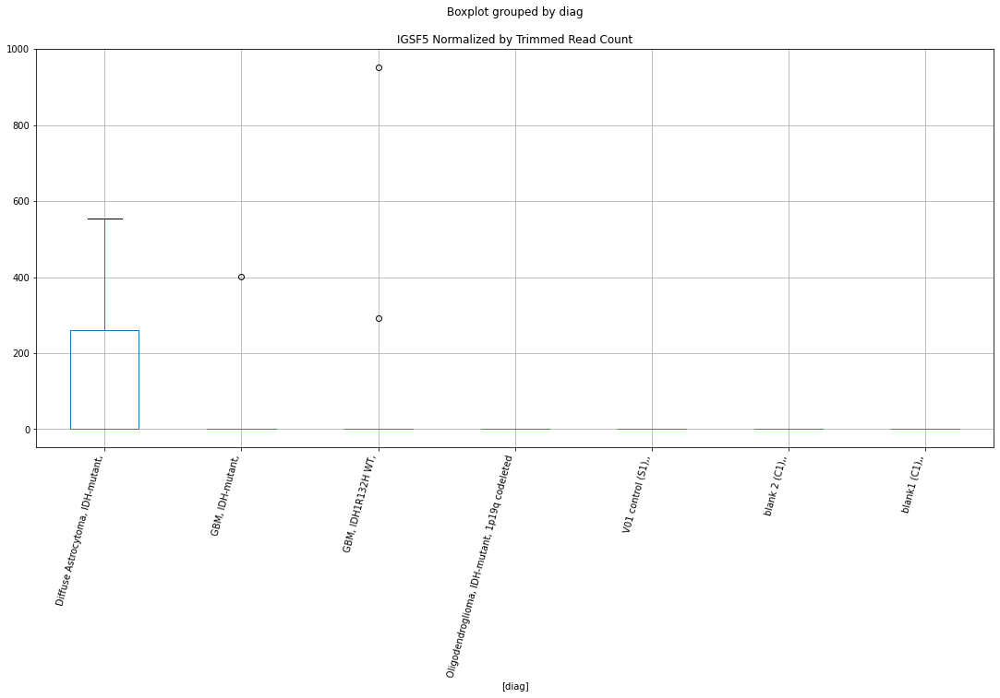

 p : 0.04014563700059787  ( t : 2.211883258953311 ) :  Lexogen  :  bbduk2  :  FUT8-AS1
Control and blanks
79     0.0
343    0.0
Name: FUT8-AS1, dtype: float64
211    0.0
Name: FUT8-AS1, dtype: float64
475    0.0
Name: FUT8-AS1, dtype: float64


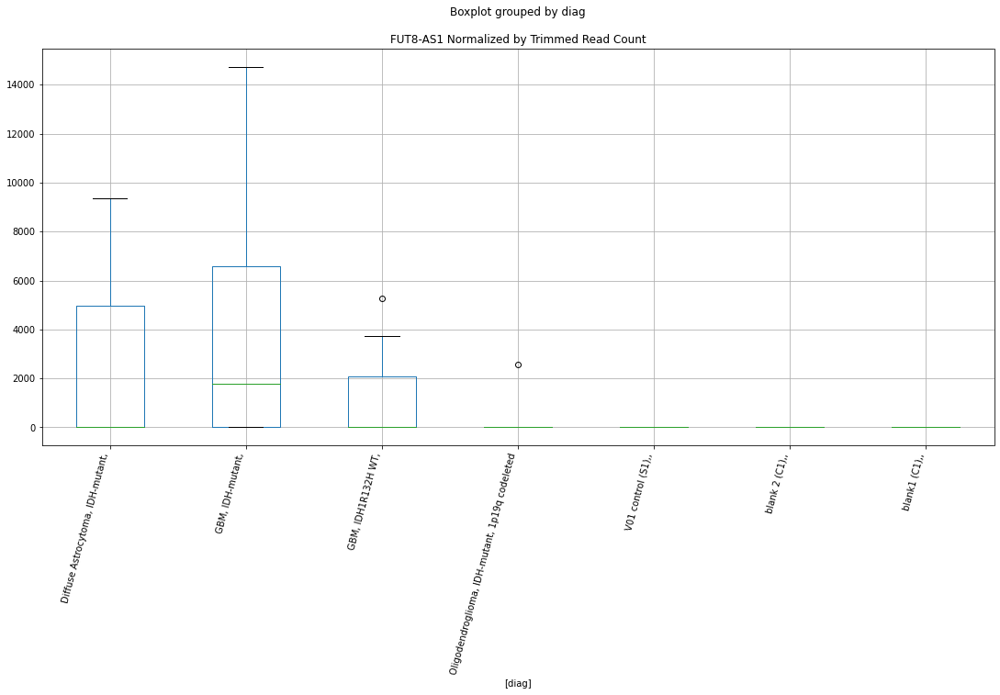

 p : 0.04027750300760903  ( t : 2.210240588557716 ) :  D-plex  :  cutadapt2  :  GOLGA6L10
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L10, dtype: float64
208    1234.52
Name: GOLGA6L10, dtype: float64
472    1155.91
Name: GOLGA6L10, dtype: float64


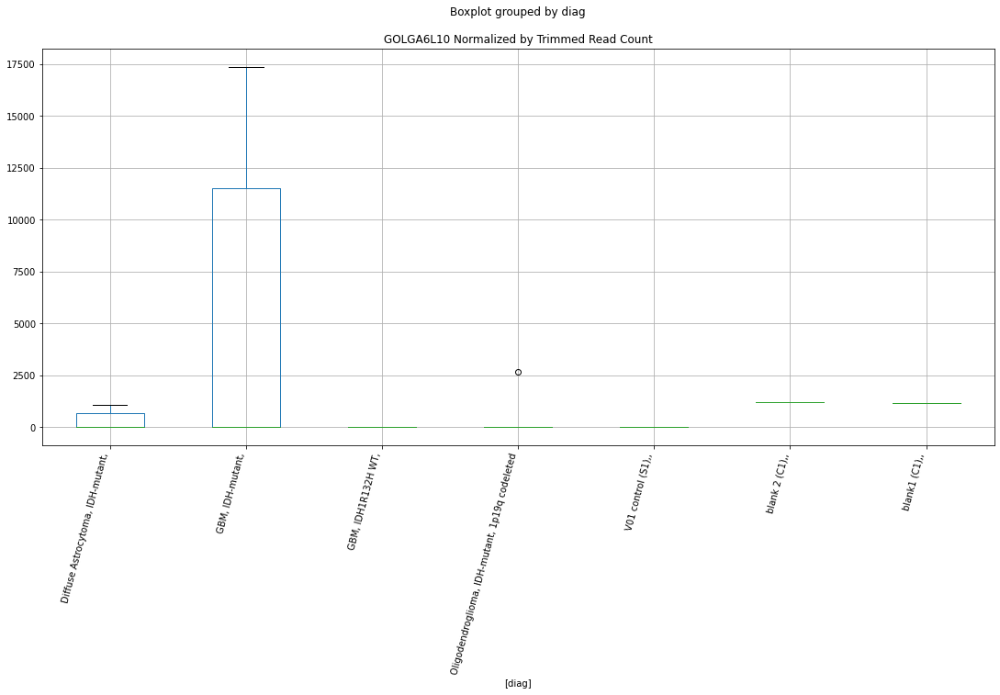

 p : 0.04027971553178267  ( t : 2.210213069082147 ) :  D-plex  :  cutadapt2  :  HYMAI
Control and blanks
76     0.0
340    0.0
Name: HYMAI, dtype: float64
208    176.36
Name: HYMAI, dtype: float64
472    0.0
Name: HYMAI, dtype: float64


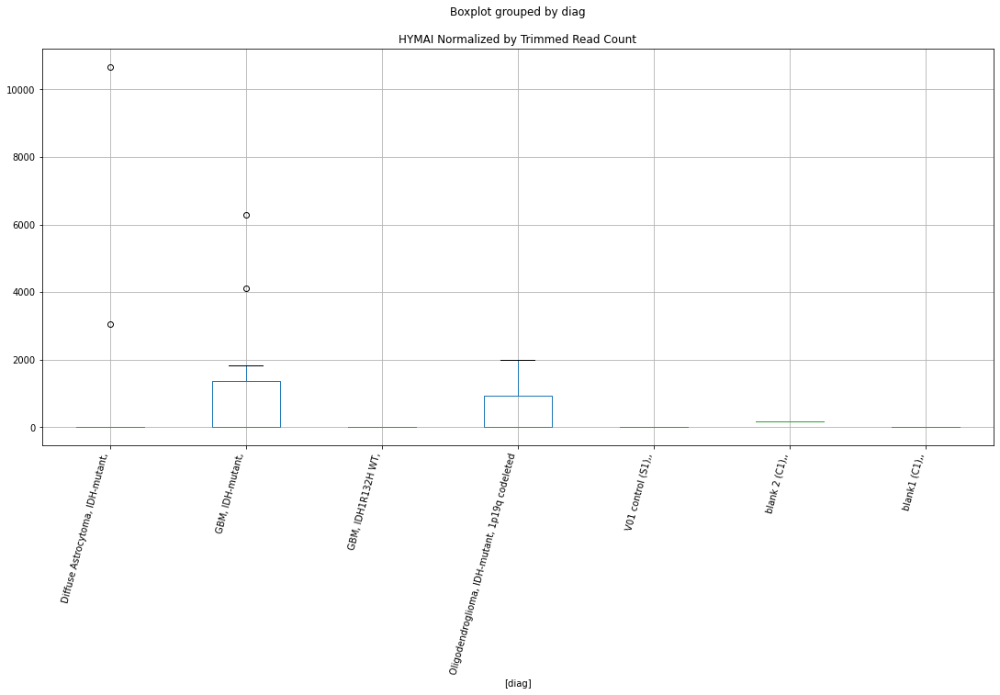

 p : 0.04033687571575195  ( t : 2.2095025893937366 ) :  D-plex  :  cutadapt2  :  EMC1-AS1
Control and blanks
76     0.0
340    0.0
Name: EMC1-AS1, dtype: float64
208    0.0
Name: EMC1-AS1, dtype: float64
472    577.96
Name: EMC1-AS1, dtype: float64


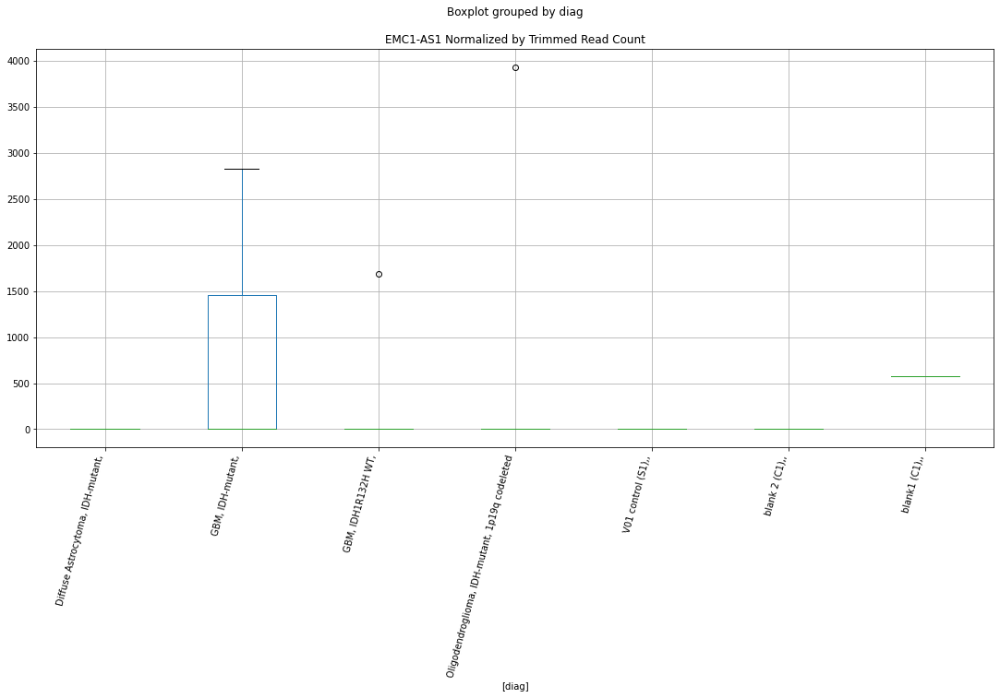

 p : 0.040359926082398086  ( t : 2.2092163437997336 ) :  D-plex  :  cutadapt2  :  IRF2BPL
Control and blanks
76     53790.61
340     1761.46
Name: IRF2BPL, dtype: float64
208    4056.29
Name: IRF2BPL, dtype: float64
472    4045.69
Name: IRF2BPL, dtype: float64


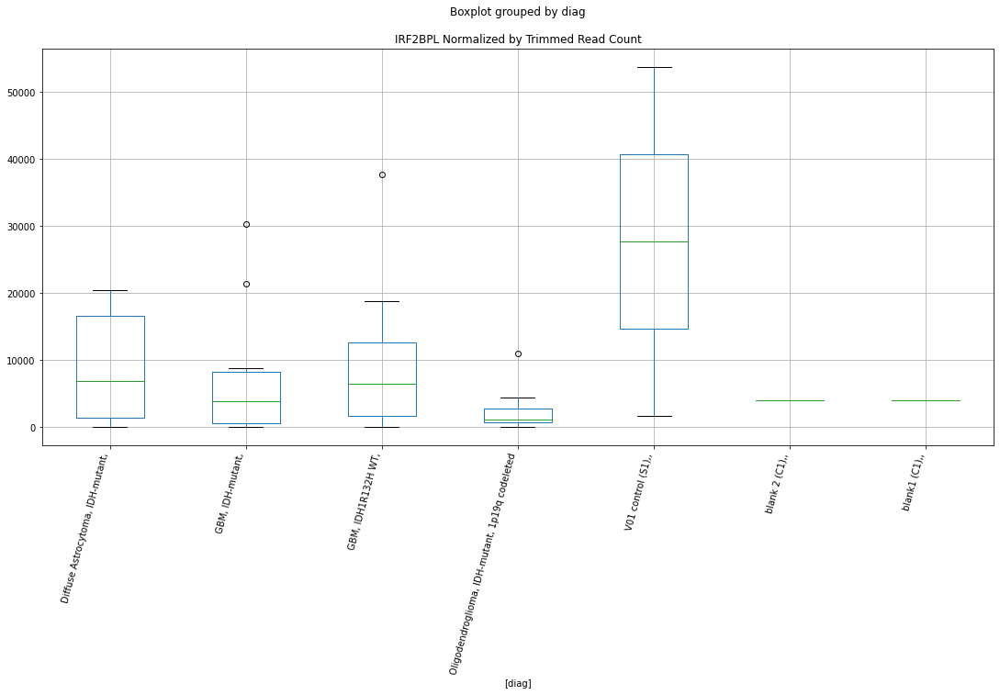

 p : 0.04038085096938905  ( t : 2.2089566230774174 ) :  D-plex  :  cutadapt2  :  FOXRED1
Control and blanks
76     3030.46
340       0.00
Name: FOXRED1, dtype: float64
208    14814.26
Name: FOXRED1, dtype: float64
472    17916.63
Name: FOXRED1, dtype: float64


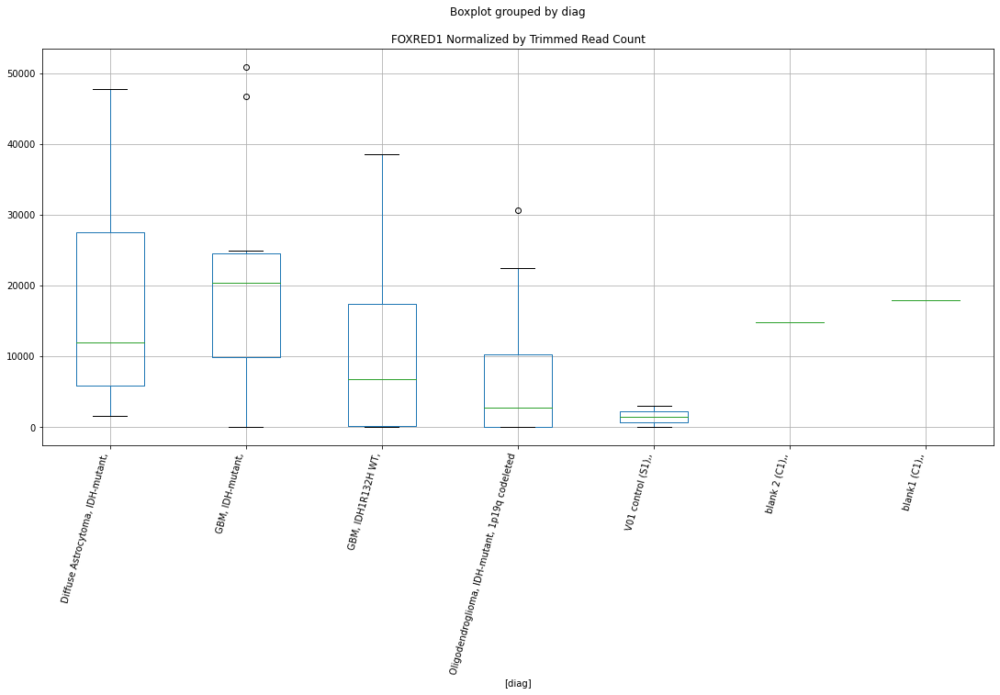

 p : 0.04056220396757868  ( t : 2.2067108283684953 ) :  D-plex  :  cutadapt2  :  DNALI1
Control and blanks
76     21970.81
340        0.00
Name: DNALI1, dtype: float64
208    881.8
Name: DNALI1, dtype: float64
472    1733.87
Name: DNALI1, dtype: float64


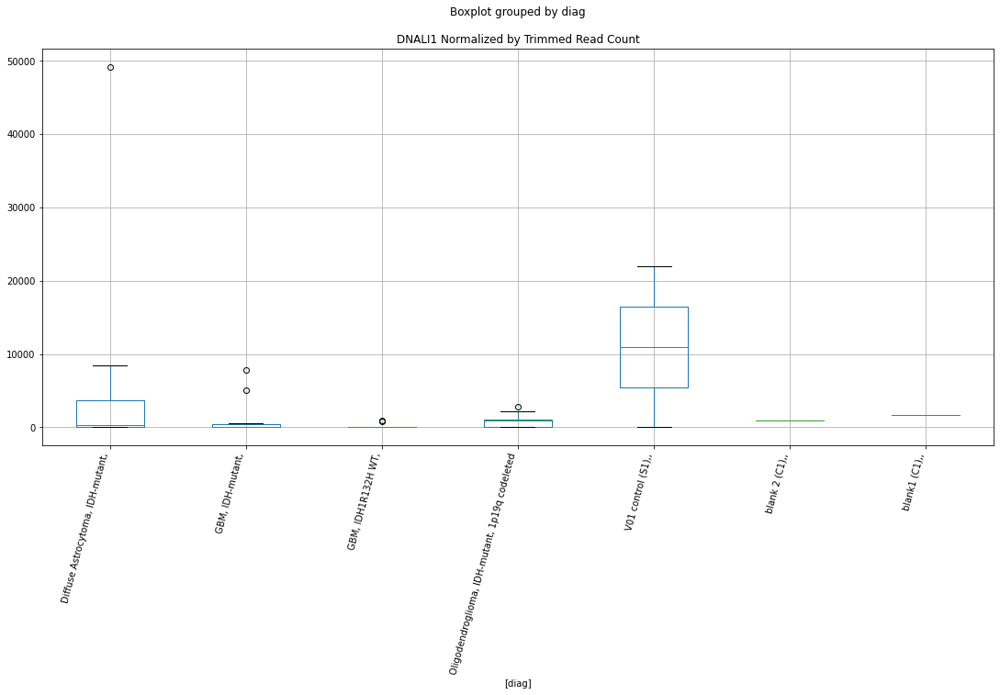

 p : 0.04057769263351767  ( t : 2.206519451601159 ) :  D-plex  :  cutadapt2  :  HOTS
Control and blanks
76       0.00
340    880.73
Name: HOTS, dtype: float64
208    2469.04
Name: HOTS, dtype: float64
472    2311.82
Name: HOTS, dtype: float64


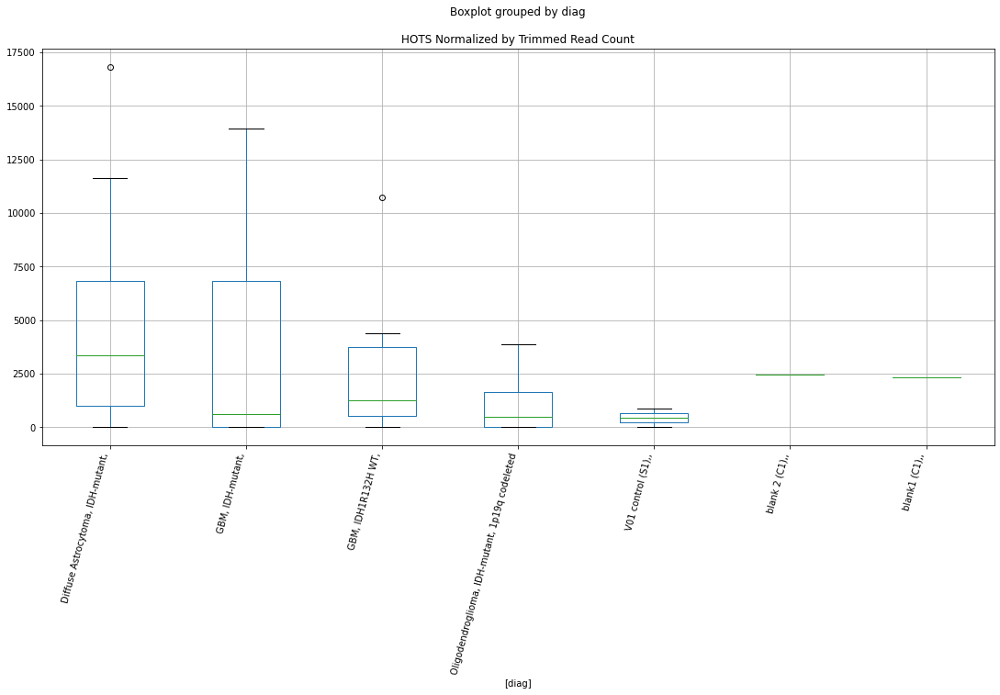

 p : 0.04061410143837701  ( t : 2.206069851440021 ) :  Lexogen  :  bbduk2  :  GBF1
Control and blanks
79     0.0
343    0.0
Name: GBF1, dtype: float64
211    0.0
Name: GBF1, dtype: float64
475    3832.25
Name: GBF1, dtype: float64


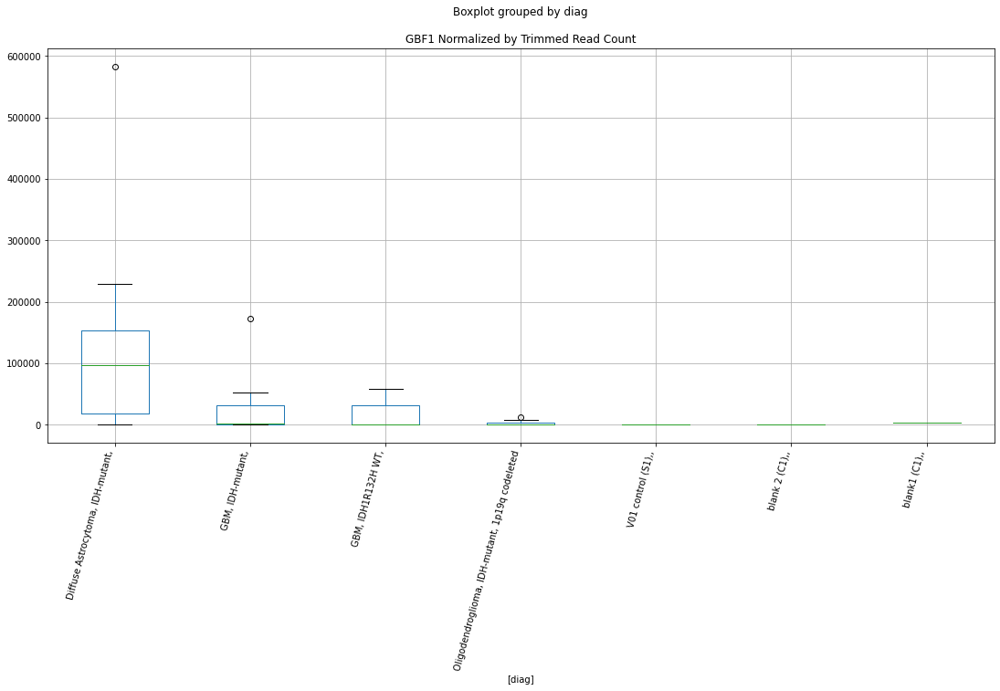

 p : 0.04062173498397918  ( t : 2.205975634306865 ) :  D-plex  :  bbduk2  :  DUSP28
Control and blanks
73     3092.03
337       0.00
Name: DUSP28, dtype: float64
205    1074.55
Name: DUSP28, dtype: float64
469    0.0
Name: DUSP28, dtype: float64


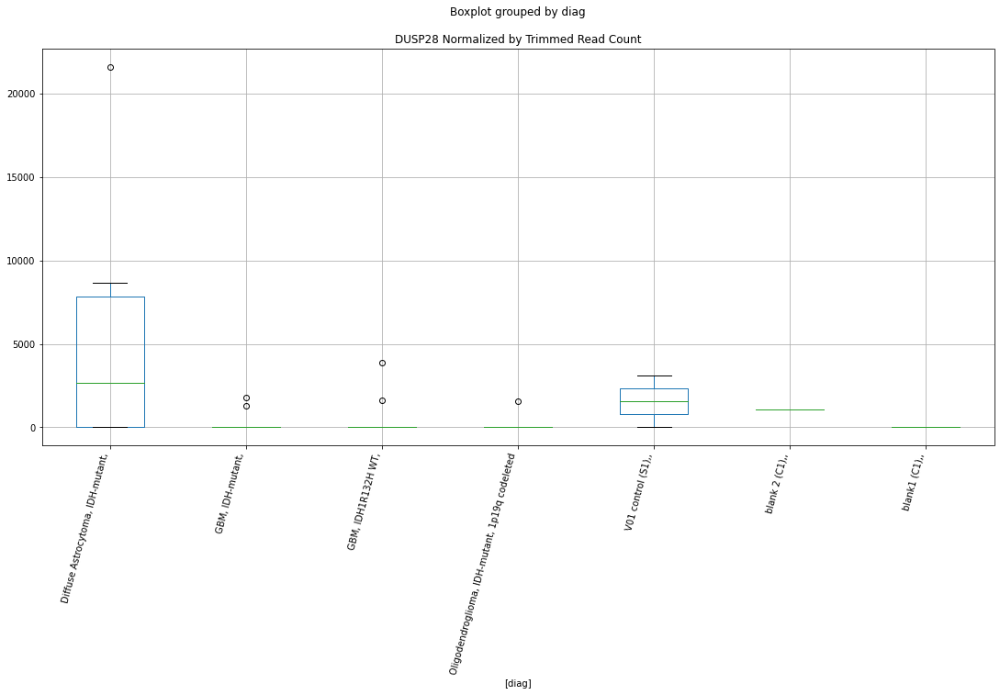

 p : 0.040646877172256166  ( t : 2.2056654315286734 ) :  D-plex  :  cutadapt2  :  HES6
Control and blanks
76     0.0
340    0.0
Name: HES6, dtype: float64
208    1939.96
Name: HES6, dtype: float64
472    0.0
Name: HES6, dtype: float64


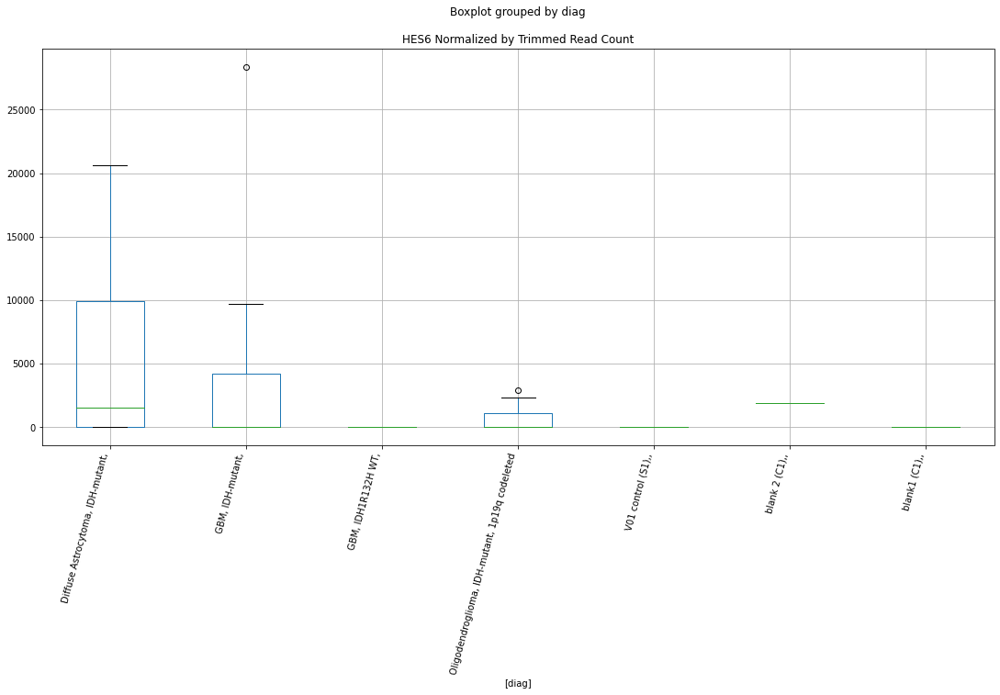

 p : 0.040691142485149163  ( t : 2.205119717031082 ) :  Lexogen  :  bbduk2  :  EFHC1
Control and blanks
79     0.0
343    0.0
Name: EFHC1, dtype: float64
211    0.0
Name: EFHC1, dtype: float64
475    0.0
Name: EFHC1, dtype: float64


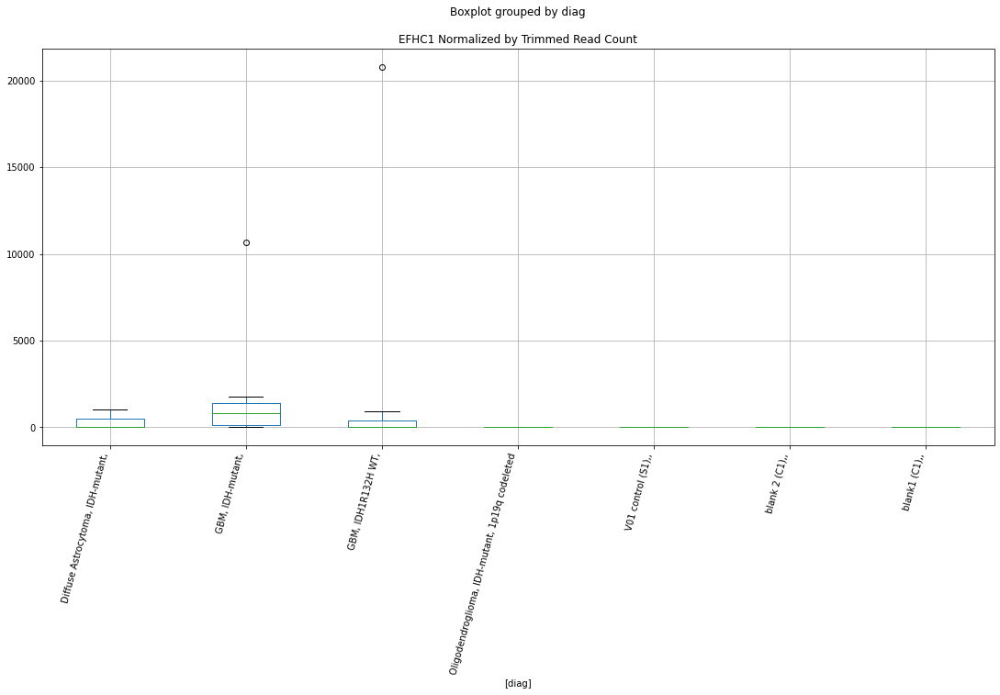

 p : 0.04072255408975351  ( t : 2.204732797236521 ) :  D-plex  :  cutadapt2  :  DUSP28
Control and blanks
76     3030.46
340       0.00
Name: DUSP28, dtype: float64
208    705.44
Name: DUSP28, dtype: float64
472    0.0
Name: DUSP28, dtype: float64


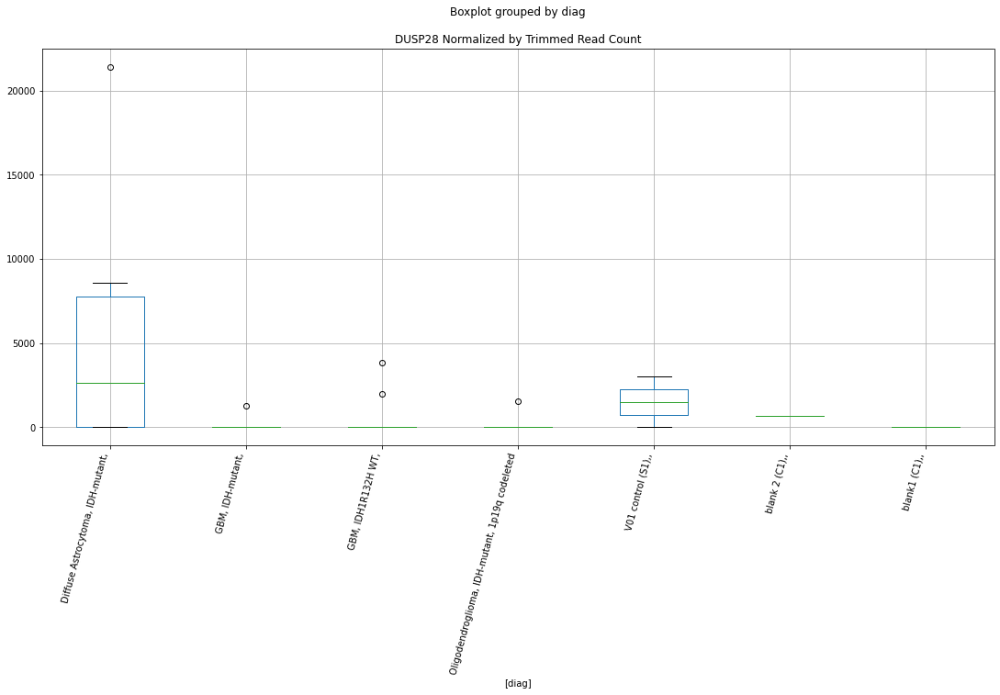

 p : 0.04076797551770252  ( t : 2.204173792839058 ) :  Lexogen  :  cutadapt2  :  KMT5B
Control and blanks
82     0.0
346    0.0
Name: KMT5B, dtype: float64
214    0.0
Name: KMT5B, dtype: float64
478    237.46
Name: KMT5B, dtype: float64


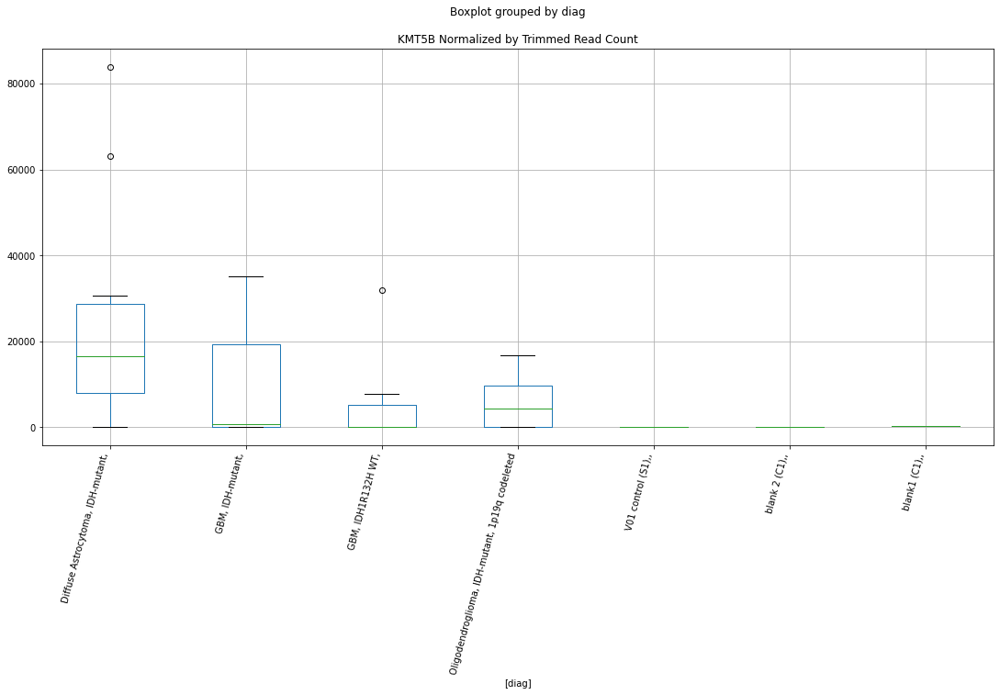

 p : 0.040769539207293426  ( t : 2.2041545586027254 ) :  D-plex  :  cutadapt2  :  EIF3A
Control and blanks
76     0.0
340    0.0
Name: EIF3A, dtype: float64
208    1410.88
Name: EIF3A, dtype: float64
472    1155.91
Name: EIF3A, dtype: float64


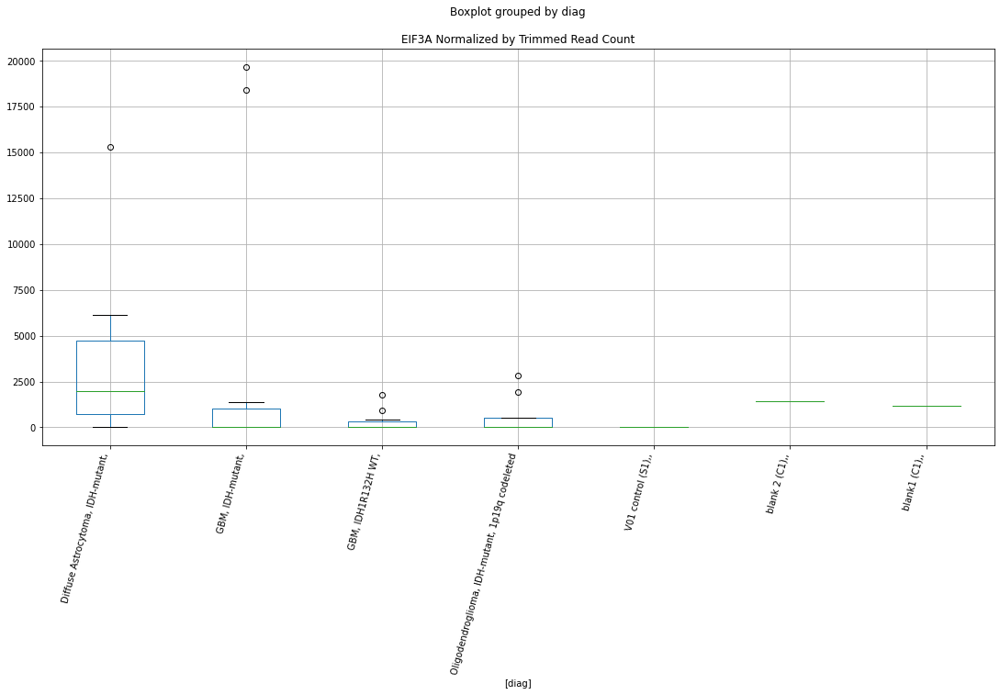

 p : 0.04089268244967666  ( t : 2.2026419536993167 ) :  D-plex  :  cutadapt2  :  GOLGA6L10
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L10, dtype: float64
208    1234.52
Name: GOLGA6L10, dtype: float64
472    1155.91
Name: GOLGA6L10, dtype: float64


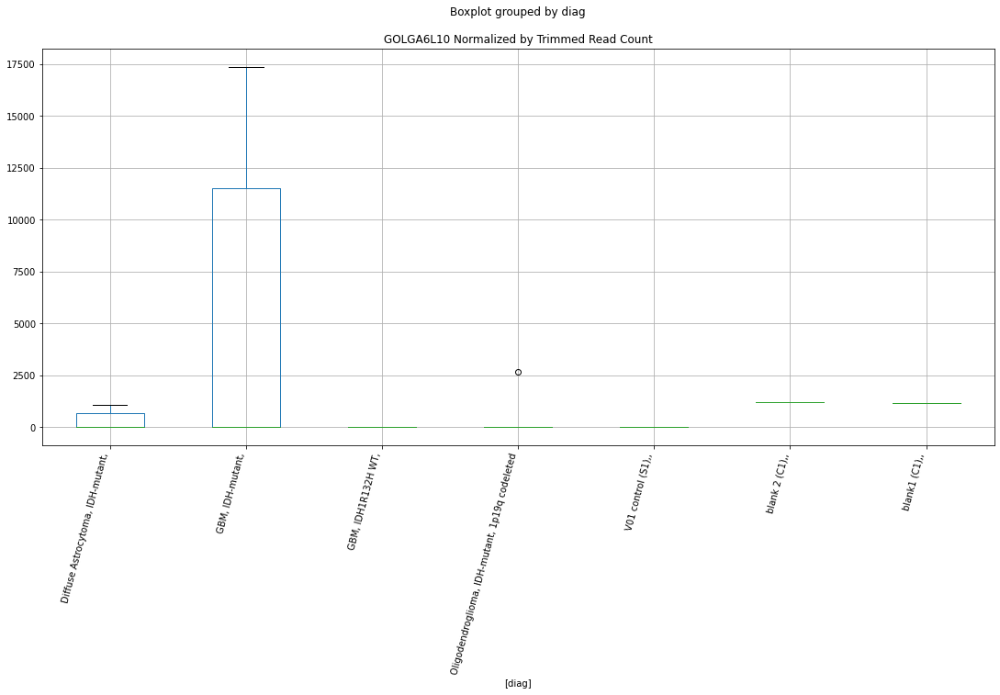

 p : 0.04107594884052984  ( t : 2.200398567778187 ) :  Lexogen  :  bbduk2  :  GALNT5
Control and blanks
79     0.0
343    0.0
Name: GALNT5, dtype: float64
211    0.0
Name: GALNT5, dtype: float64
475    958.06
Name: GALNT5, dtype: float64


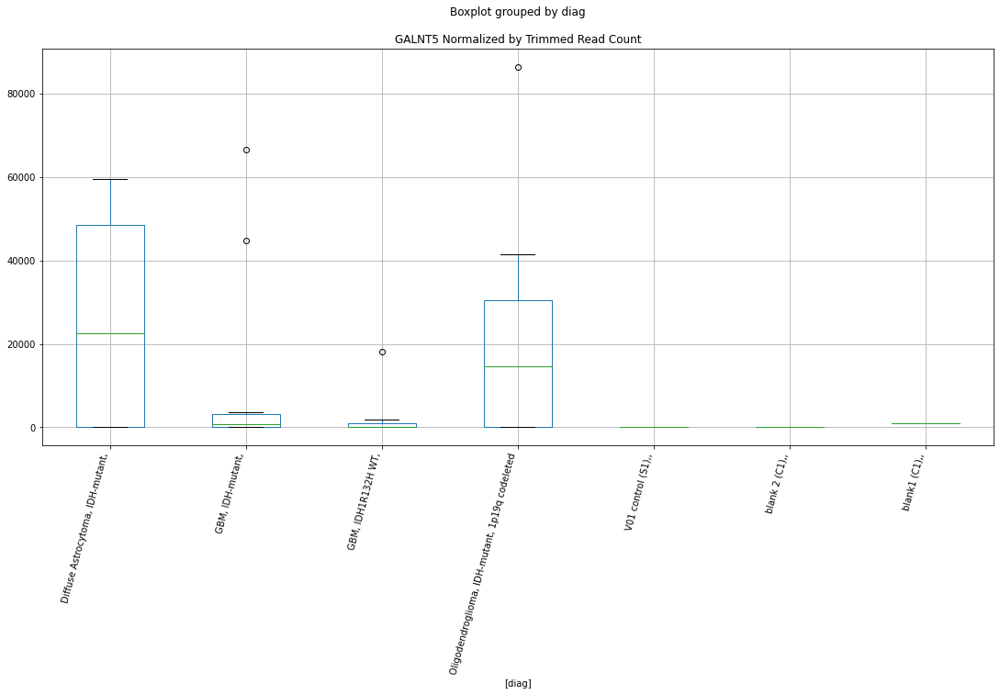

 p : 0.0410776032157537  ( t : 2.2003783582743823 ) :  Lexogen  :  bbduk2  :  ICE2
Control and blanks
79     0.0
343    0.0
Name: ICE2, dtype: float64
211    0.0
Name: ICE2, dtype: float64
475    0.0
Name: ICE2, dtype: float64


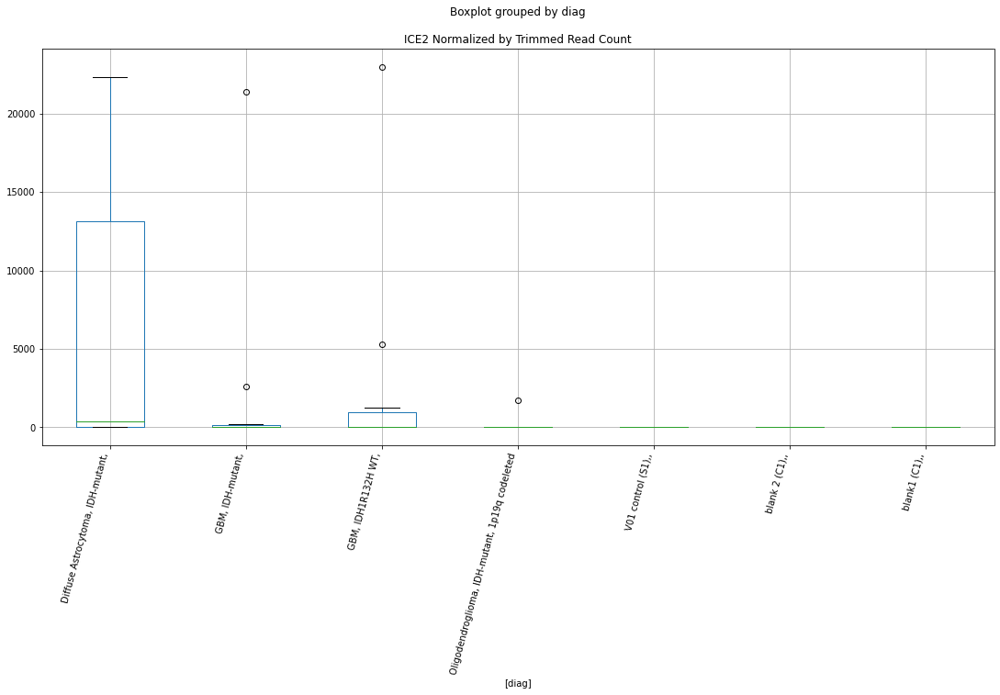

 p : 0.04108158821480743  ( t : 2.2003296814231526 ) :  D-plex  :  bbduk2  :  GRIK4
Control and blanks
73     773.01
337      0.00
Name: GRIK4, dtype: float64
205    6626.37
Name: GRIK4, dtype: float64
469    0.0
Name: GRIK4, dtype: float64


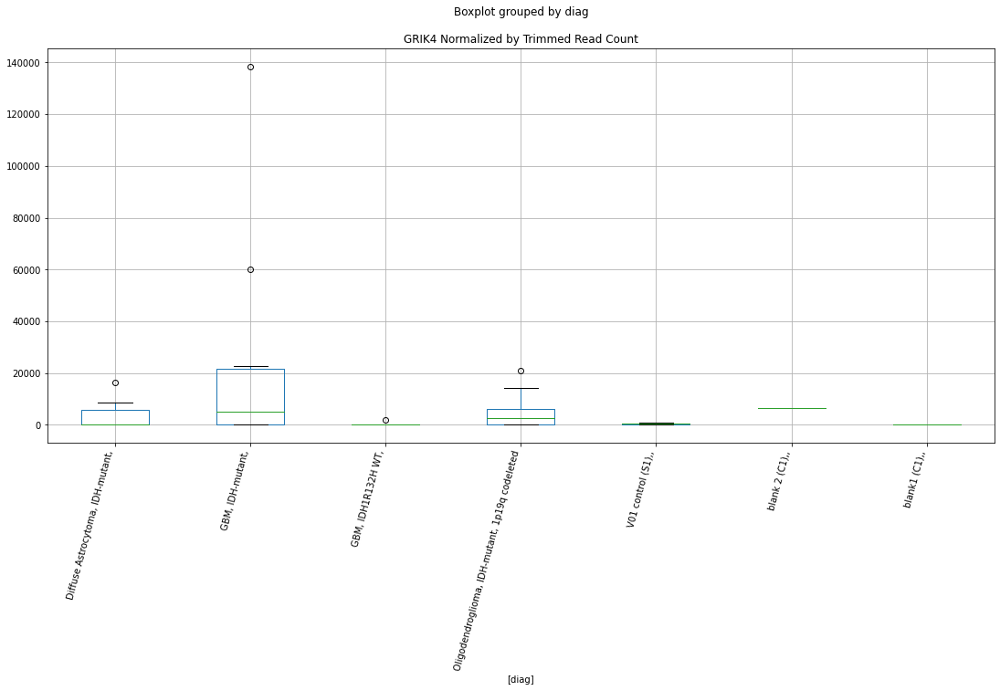

 p : 0.04110136155305723  ( t : 2.200088213785341 ) :  Lexogen  :  bbduk2  :  KMT5B
Control and blanks
79     0.0
343    0.0
Name: KMT5B, dtype: float64
211    0.0
Name: KMT5B, dtype: float64
475    239.52
Name: KMT5B, dtype: float64


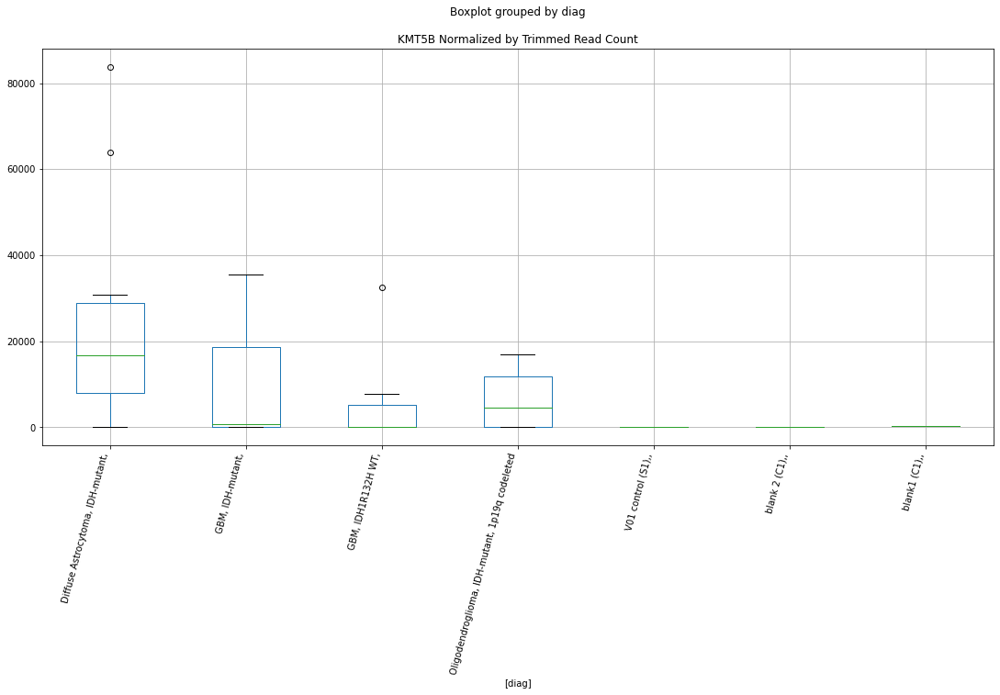

 p : 0.04114460880038258  ( t : 2.1995604595810634 ) :  Lexogen  :  cutadapt2  :  ICE2
Control and blanks
82     0.0
346    0.0
Name: ICE2, dtype: float64
214    0.0
Name: ICE2, dtype: float64
478    0.0
Name: ICE2, dtype: float64


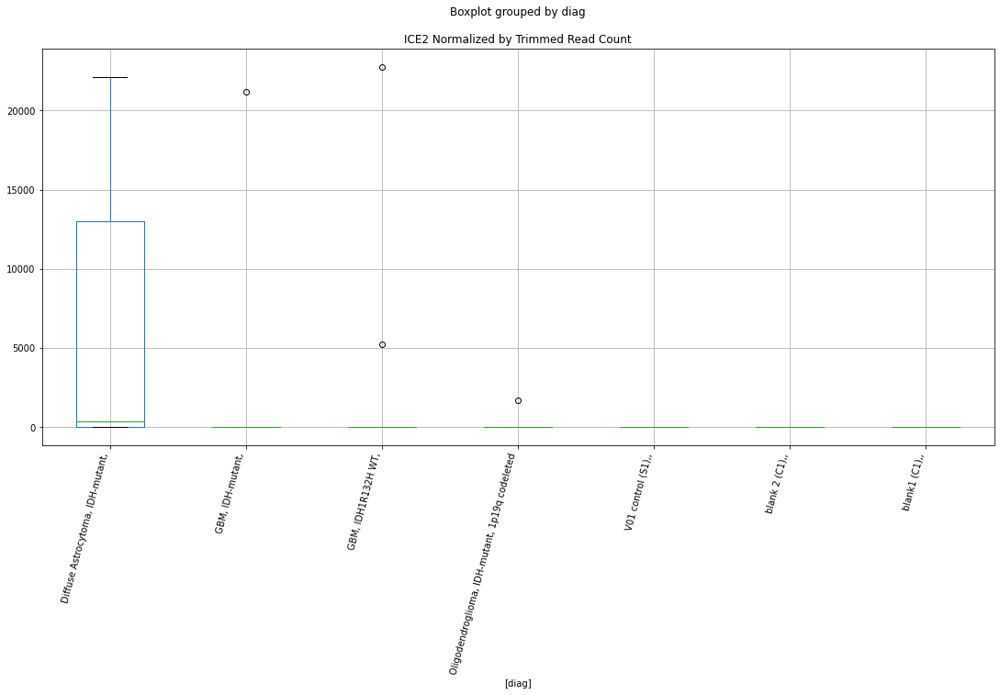

 p : 0.04119233766793774  ( t : 2.198978606355237 ) :  D-plex  :  bbduk2  :  FBXO46
Control and blanks
73     0.0
337    0.0
Name: FBXO46, dtype: float64
205    1432.73
Name: FBXO46, dtype: float64
469    0.0
Name: FBXO46, dtype: float64


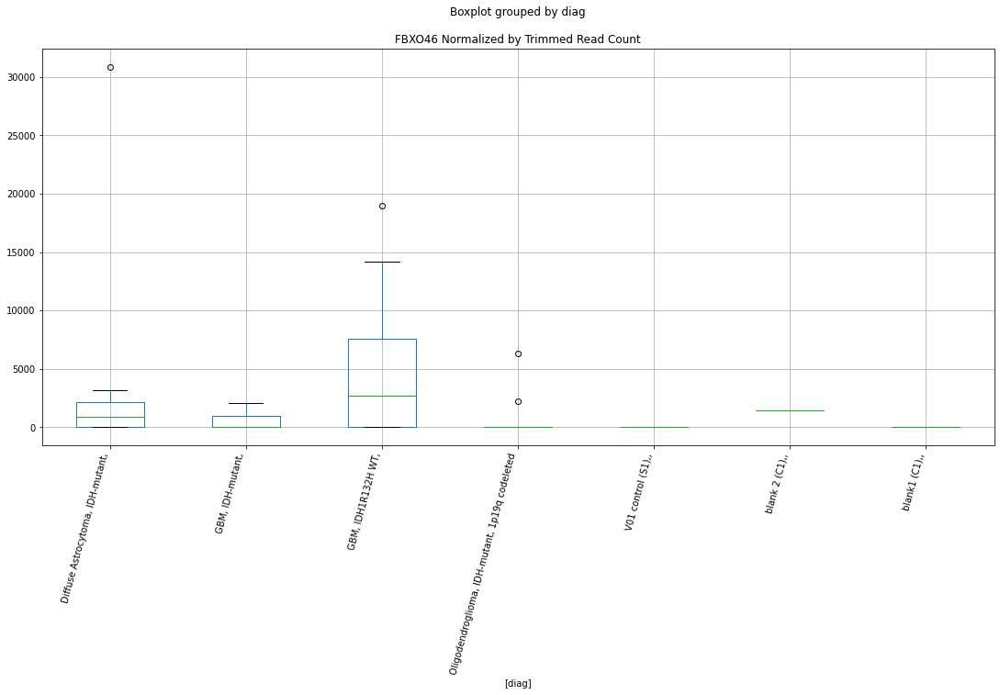

 p : 0.04130713003193073  ( t : 2.1975817262755135 ) :  Lexogen  :  cutadapt2  :  GBF1
Control and blanks
82     0.0
346    0.0
Name: GBF1, dtype: float64
214    0.0
Name: GBF1, dtype: float64
478    3799.37
Name: GBF1, dtype: float64


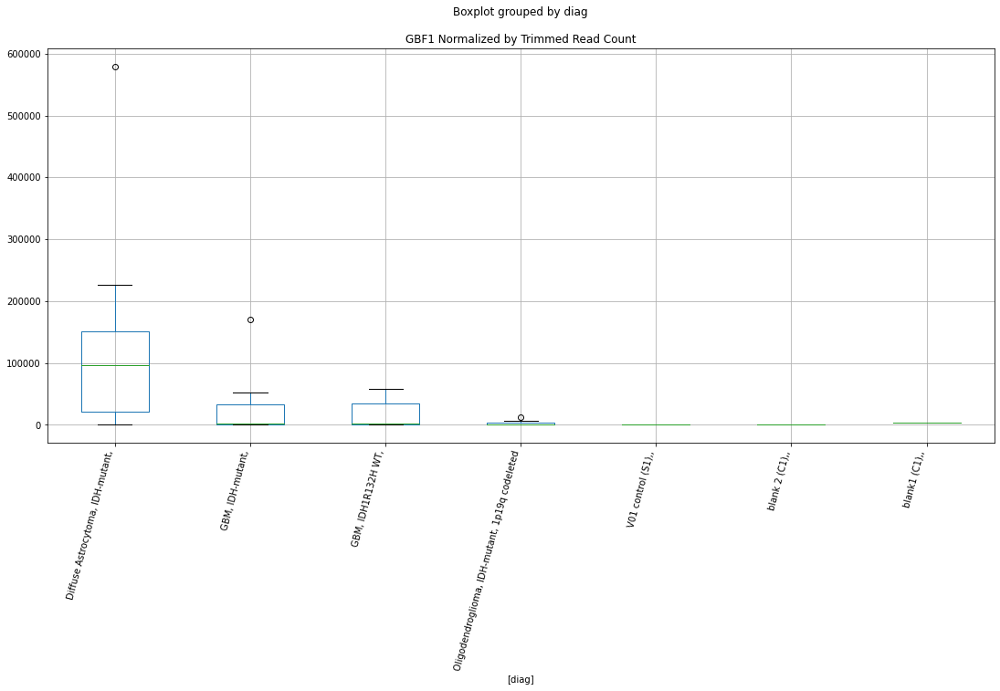

 p : 0.04132397508510973  ( t : 2.197377042936746 ) :  Lexogen  :  bbduk2  :  KIF19
Control and blanks
79     0.0
343    0.0
Name: KIF19, dtype: float64
211    0.0
Name: KIF19, dtype: float64
475    0.0
Name: KIF19, dtype: float64


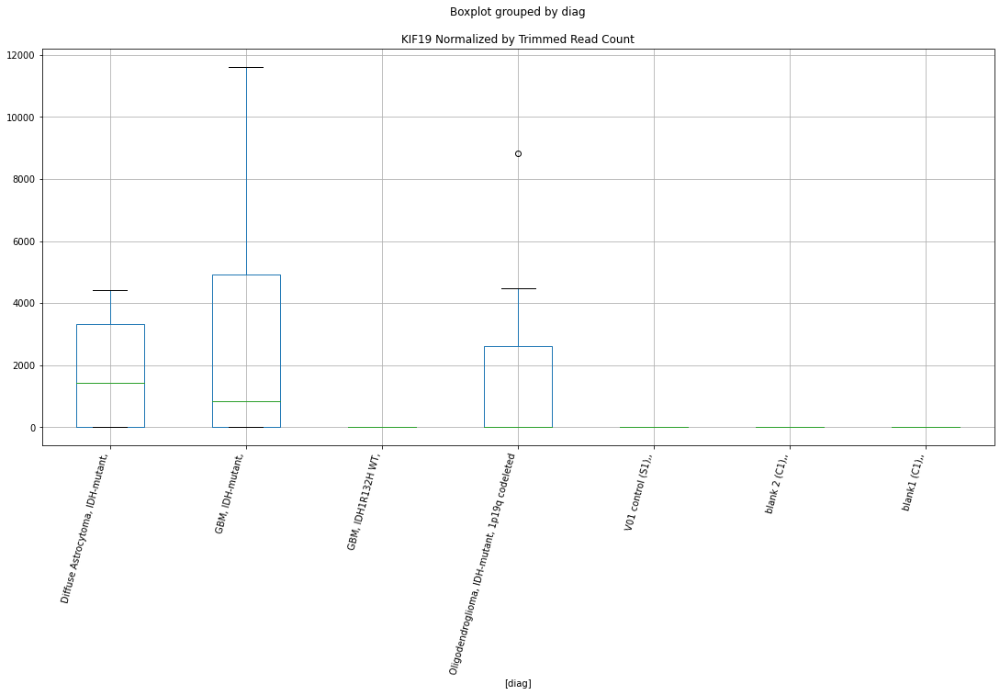

 p : 0.041400743168534766  ( t : 2.196445207045482 ) :  Lexogen  :  cutadapt2  :  ITSN2
Control and blanks
82        0.00
346    2314.78
Name: ITSN2, dtype: float64
214    0.0
Name: ITSN2, dtype: float64
478    0.0
Name: ITSN2, dtype: float64


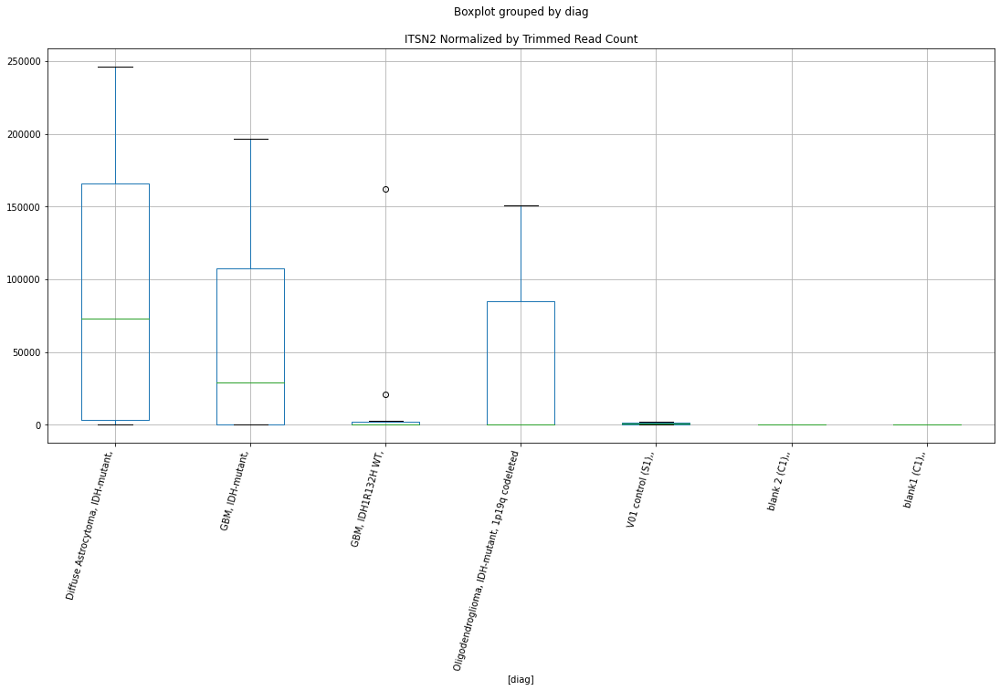

 p : 0.04146543703296995  ( t : 2.195661162801233 ) :  D-plex  :  cutadapt2  :  IL9R
Control and blanks
76     0.0
340    0.0
Name: IL9R, dtype: float64
208    705.44
Name: IL9R, dtype: float64
472    0.0
Name: IL9R, dtype: float64


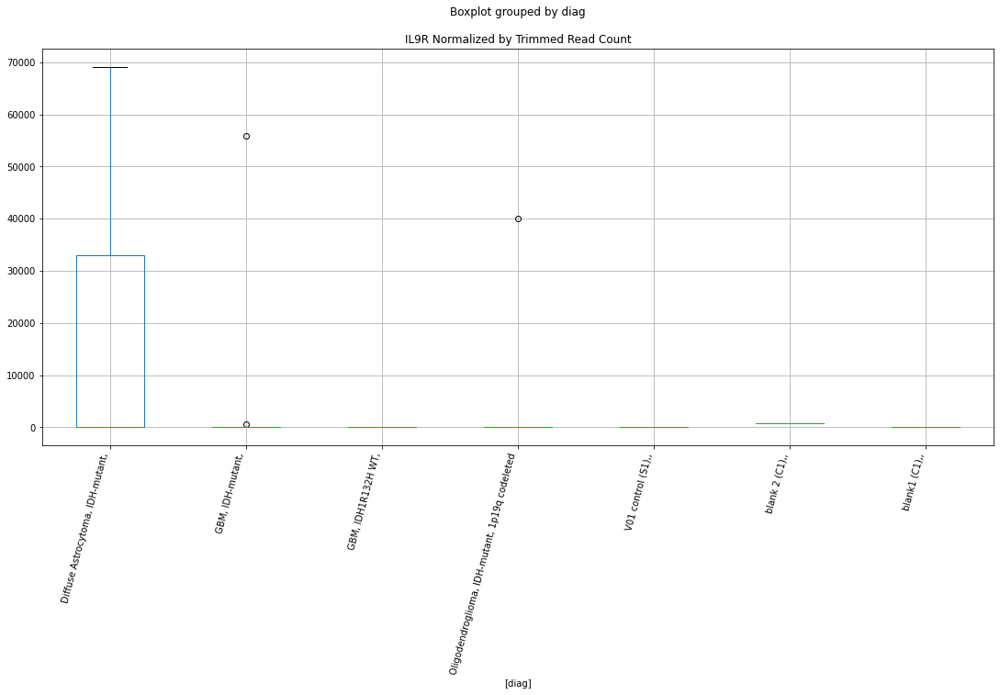

 p : 0.04153525821745252  ( t : 2.1948162379945573 ) :  Lexogen  :  cutadapt2  :  HMGN5
Control and blanks
82     0.0
346    0.0
Name: HMGN5, dtype: float64
214    0.0
Name: HMGN5, dtype: float64
478    0.0
Name: HMGN5, dtype: float64


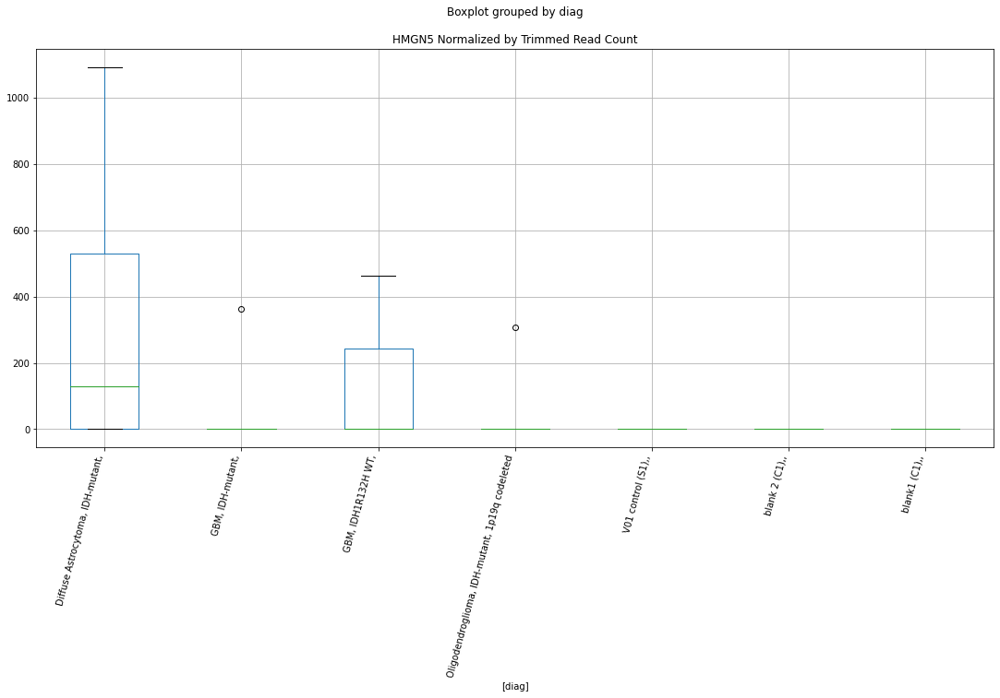

 p : 0.0415803800402588  ( t : 2.1942709000110696 ) :  D-plex  :  cutadapt2  :  FBXO46
Control and blanks
76     0.0
340    0.0
Name: FBXO46, dtype: float64
208    1410.88
Name: FBXO46, dtype: float64
472    0.0
Name: FBXO46, dtype: float64


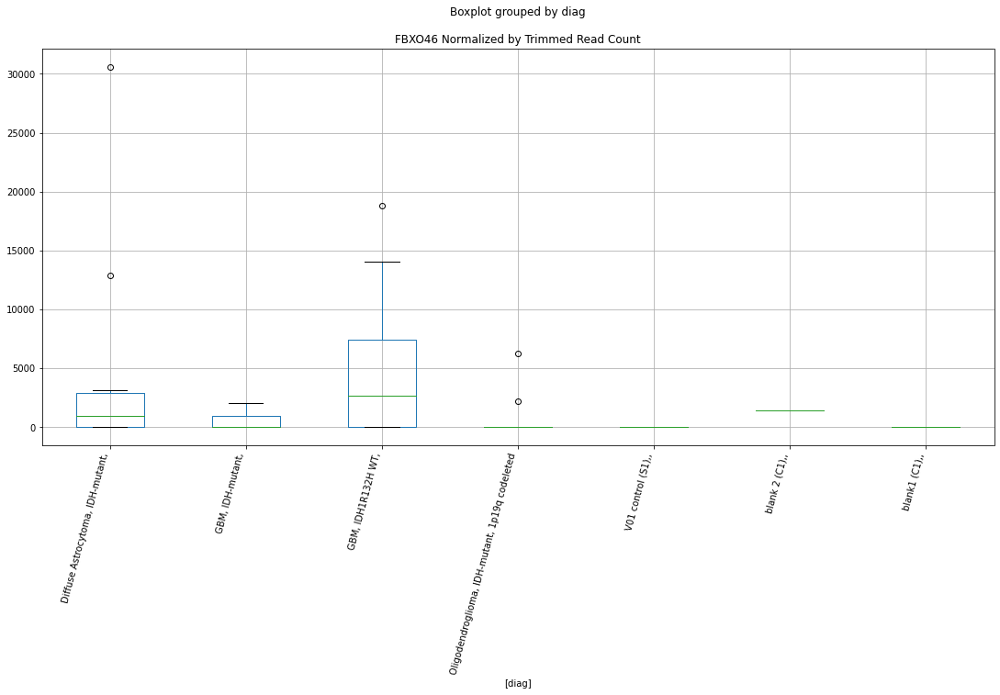

 p : 0.04159205076953781  ( t : 2.1941299371245515 ) :  D-plex  :  bbduk2  :  GAB1
Control and blanks
73     102037.11
337     67651.95
Name: GAB1, dtype: float64
205    138616.4
Name: GAB1, dtype: float64
469    54420.51
Name: GAB1, dtype: float64


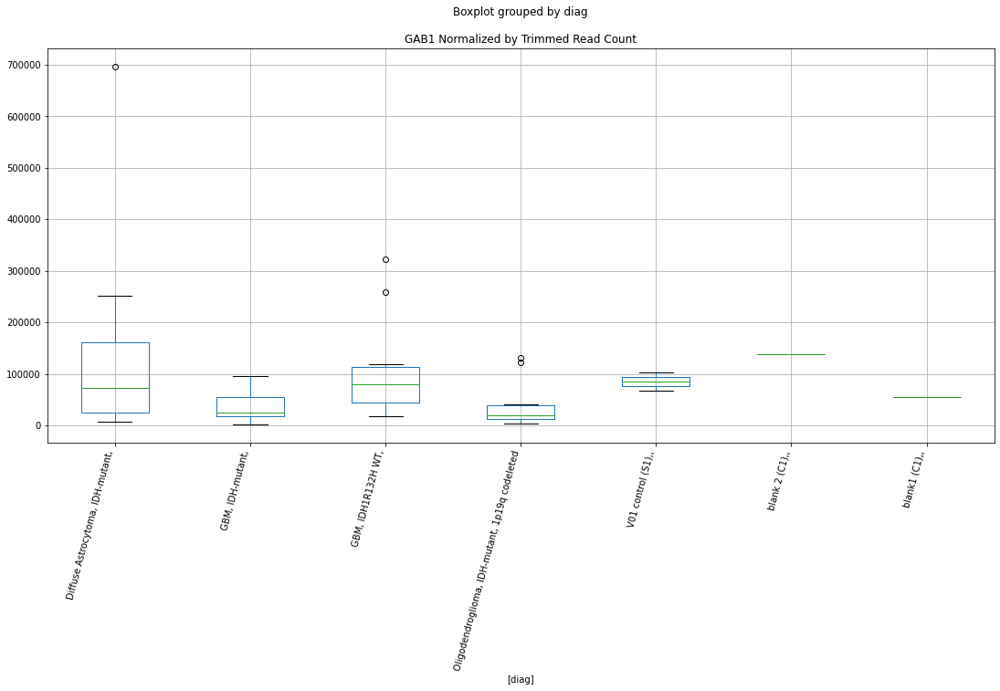

 p : 0.04167333905601453  ( t : 2.1931491164373846 ) :  Lexogen  :  cutadapt2  :  GTF3C5
Control and blanks
82     0.0
346    0.0
Name: GTF3C5, dtype: float64
214    0.0
Name: GTF3C5, dtype: float64
478    0.0
Name: GTF3C5, dtype: float64


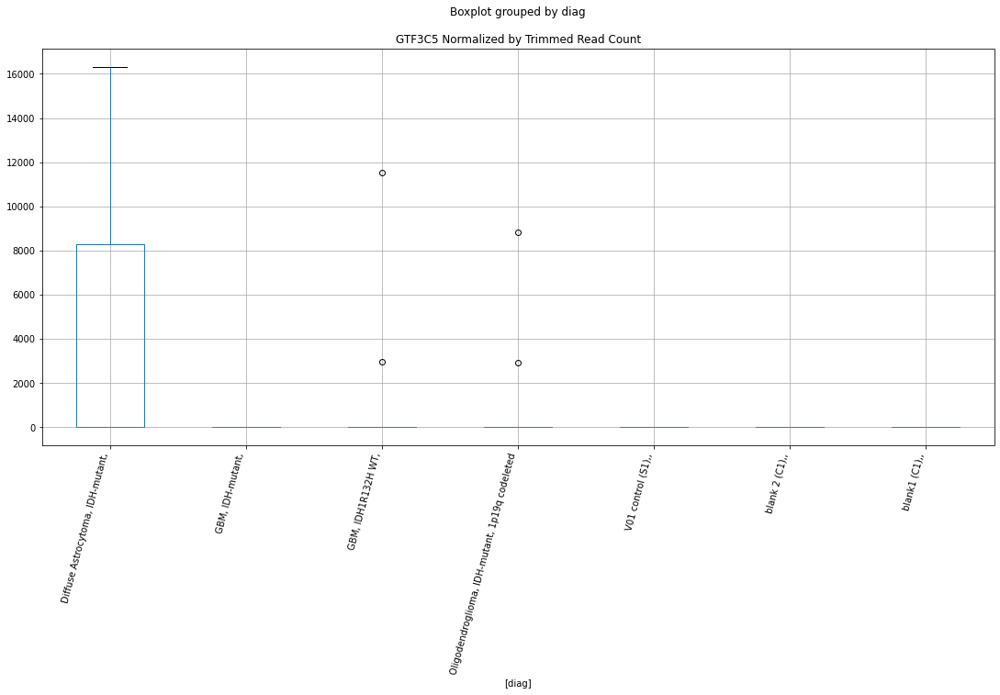

 p : 0.041743749652565096  ( t : 2.1923009635583286 ) :  D-plex  :  bbduk2  :  KLF7
Control and blanks
73     0.0
337    0.0
Name: KLF7, dtype: float64
205    6805.46
Name: KLF7, dtype: float64
469    2957.64
Name: KLF7, dtype: float64


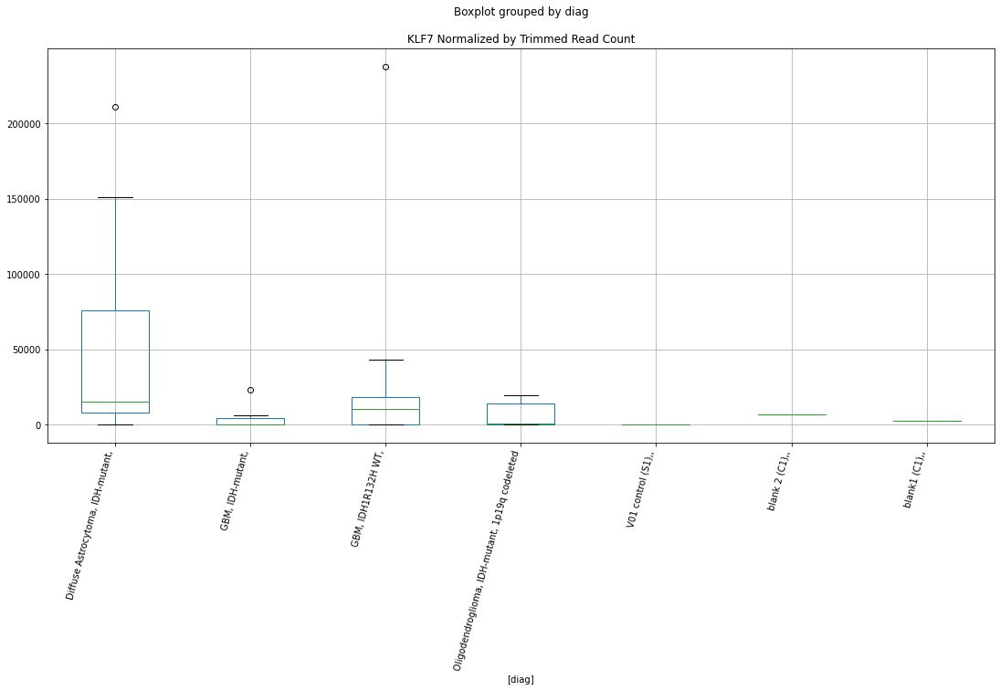

 p : 0.04175671136900107  ( t : 2.192144972248597 ) :  D-plex  :  bbduk2  :  KCNMB4
Control and blanks
73     0.0
337    0.0
Name: KCNMB4, dtype: float64
205    4119.09
Name: KCNMB4, dtype: float64
469    5323.75
Name: KCNMB4, dtype: float64


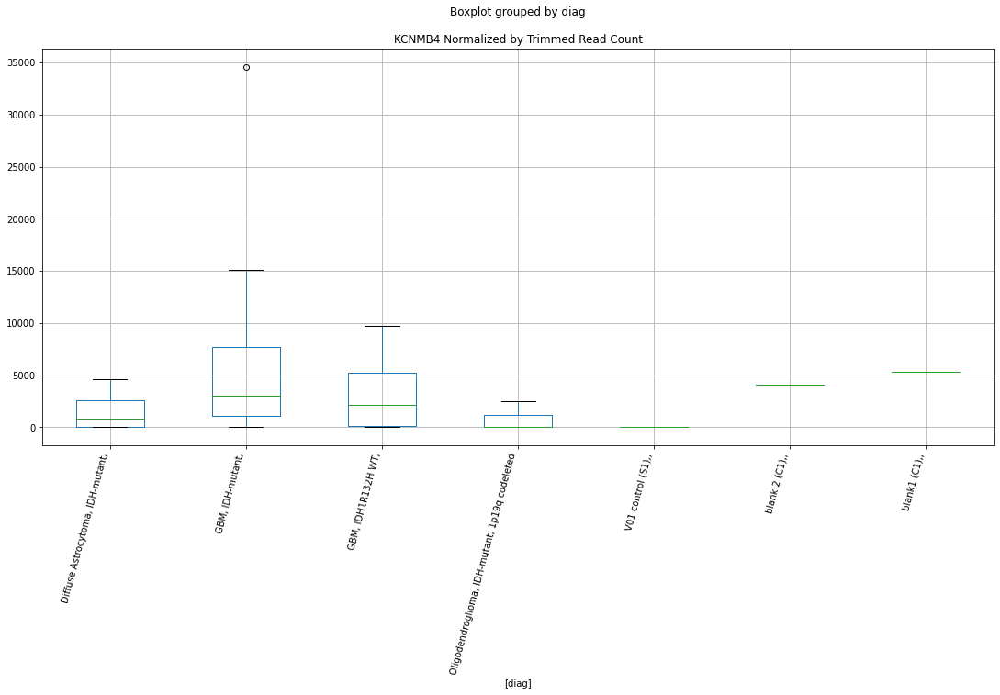

 p : 0.041890463461295976  ( t : 2.190537885961025 ) :  D-plex  :  bbduk2  :  ESYT3
Control and blanks
73      1546.02
337    12462.20
Name: ESYT3, dtype: float64
205    42981.83
Name: ESYT3, dtype: float64
469    46730.66
Name: ESYT3, dtype: float64


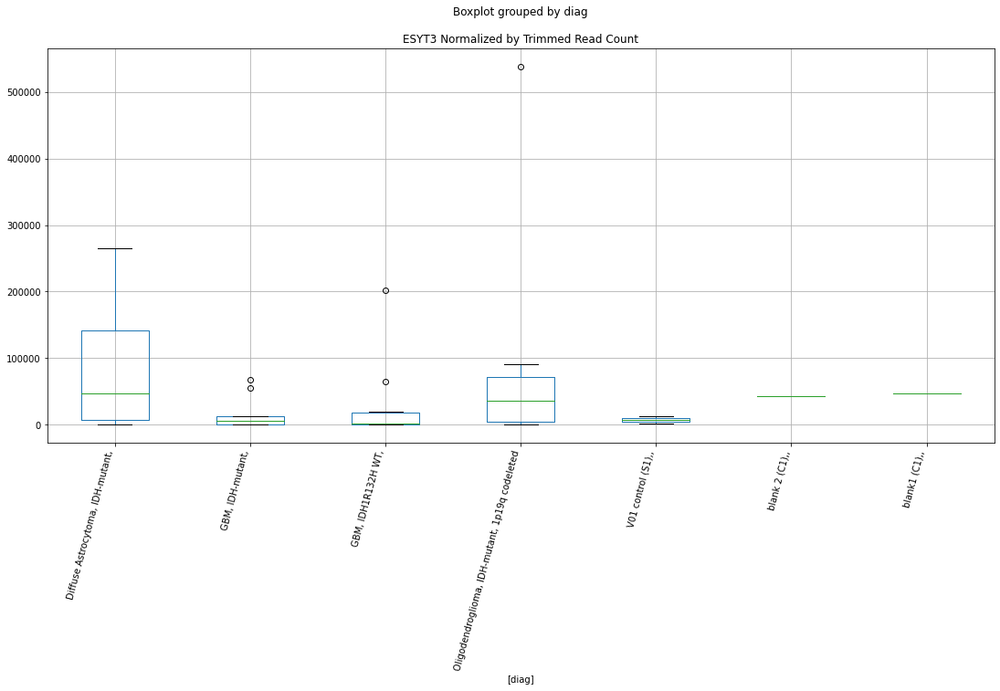

 p : 0.04189363447071949  ( t : 2.1904998421469717 ) :  D-plex  :  cutadapt2  :  FGF11
Control and blanks
76     0.0
340    0.0
Name: FGF11, dtype: float64
208    1058.16
Name: FGF11, dtype: float64
472    0.0
Name: FGF11, dtype: float64


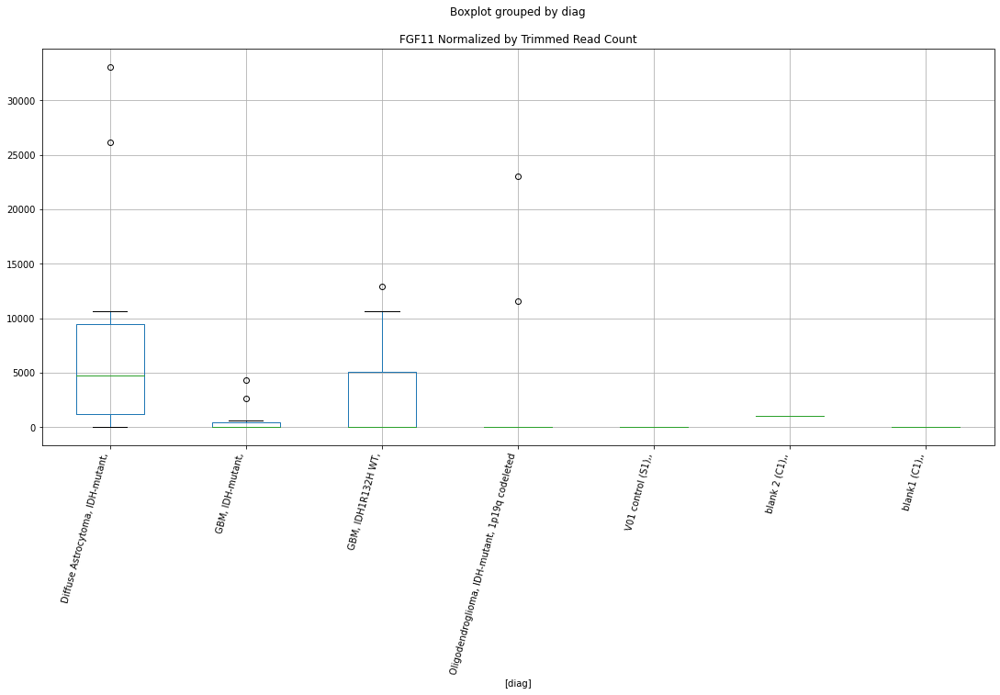

 p : 0.04200876610924614  ( t : 2.1891203500271046 ) :  D-plex  :  bbduk2  :  KIRREL1
Control and blanks
73     0.0
337    0.0
Name: KIRREL1, dtype: float64
205    1611.82
Name: KIRREL1, dtype: float64
469    0.0
Name: KIRREL1, dtype: float64


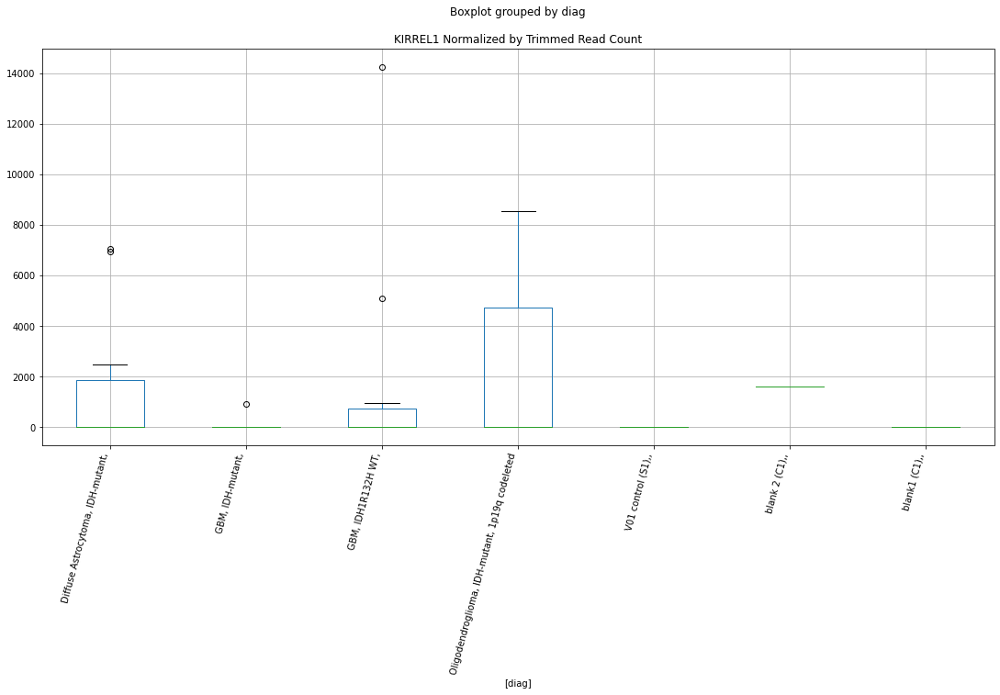

 p : 0.04215649362636949  ( t : 2.187355369781732 ) :  D-plex  :  cutadapt2  :  ITGA7
Control and blanks
76     11364.21
340        0.00
Name: ITGA7, dtype: float64
208    40915.57
Name: ITGA7, dtype: float64
472    52016.03
Name: ITGA7, dtype: float64


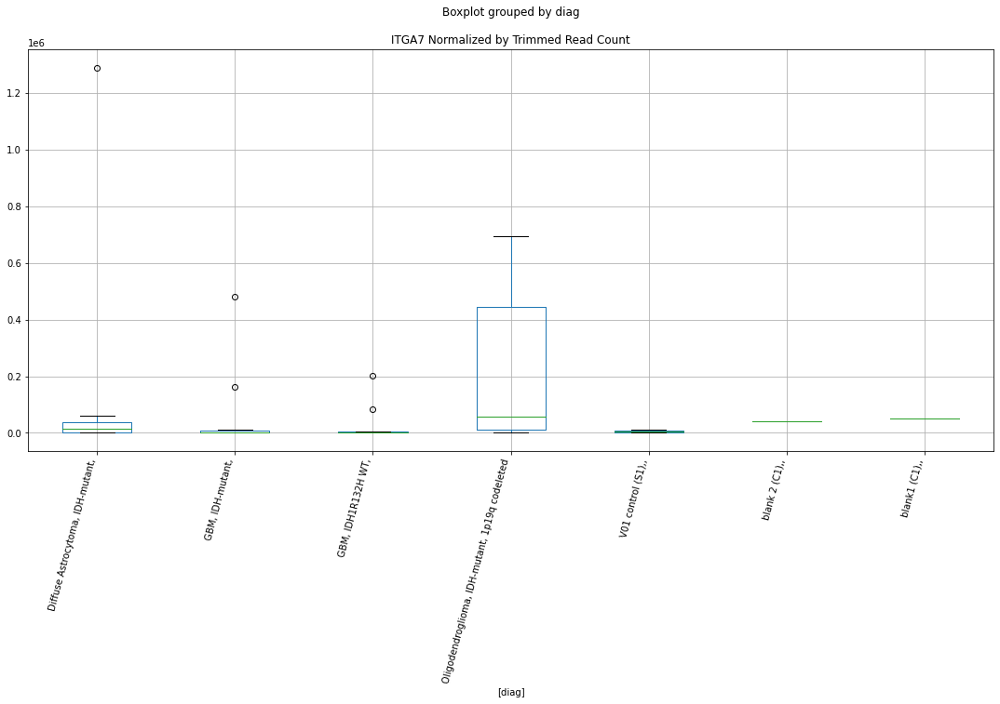

 p : 0.042169576764180386  ( t : 2.187199332074682 ) :  Lexogen  :  cutadapt2  :  GLI3
Control and blanks
82     0.0
346    0.0
Name: GLI3, dtype: float64
214    7323.11
Name: GLI3, dtype: float64
478    0.0
Name: GLI3, dtype: float64


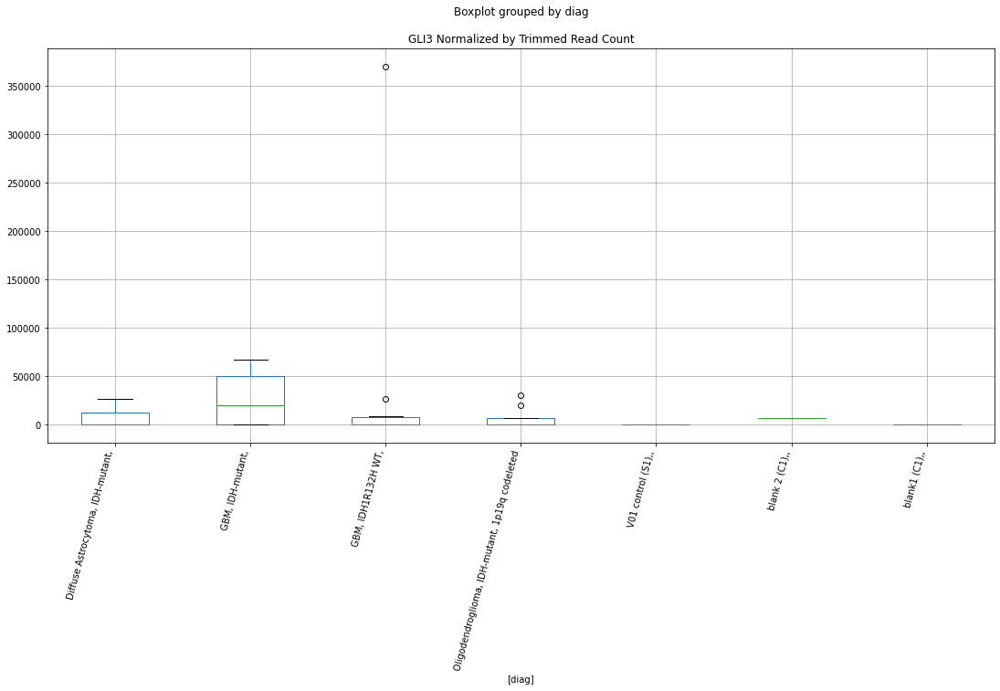

 p : 0.04218459603515356  ( t : 2.1870202575656084 ) :  Lexogen  :  cutadapt2  :  LARP4
Control and blanks
82     0.0
346    0.0
Name: LARP4, dtype: float64
214    0.0
Name: LARP4, dtype: float64
478    0.0
Name: LARP4, dtype: float64


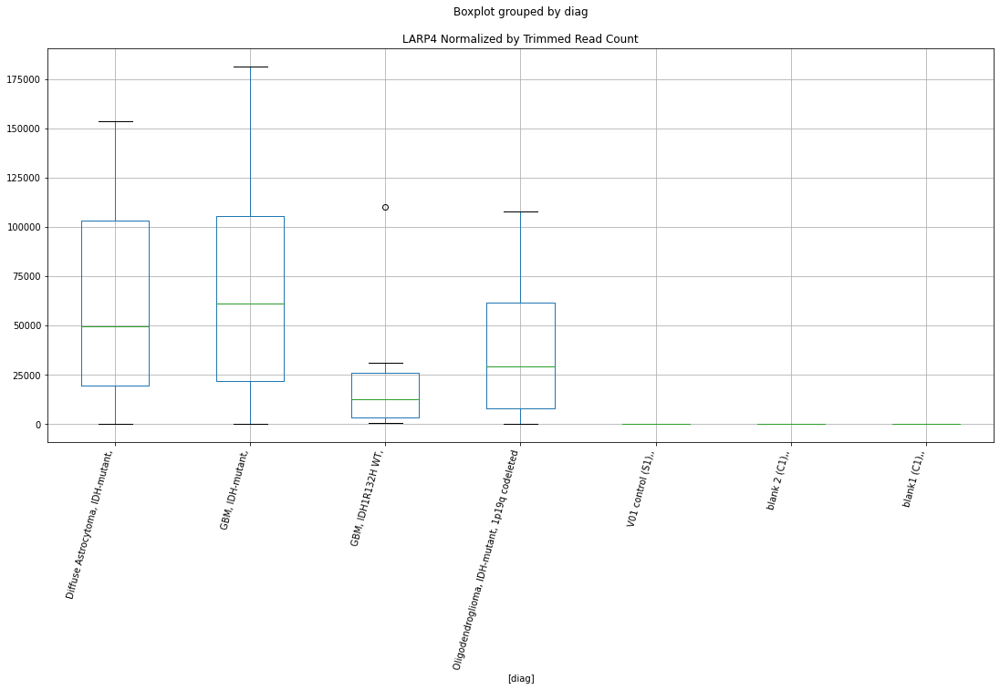

 p : 0.04226752141281228  ( t : 2.1860325911998455 ) :  D-plex  :  cutadapt2  :  HCAR1
Control and blanks
76     0.0
340    0.0
Name: HCAR1, dtype: float64
208    705.44
Name: HCAR1, dtype: float64
472    577.96
Name: HCAR1, dtype: float64


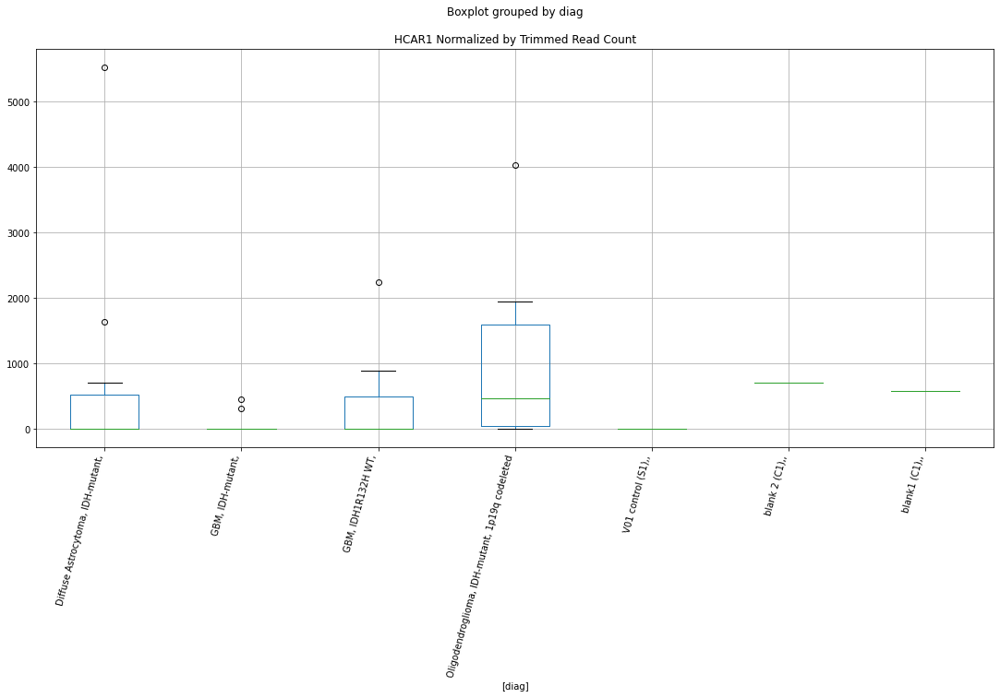

 p : 0.0422808572869072  ( t : 2.1858739228038617 ) :  D-plex  :  cutadapt2  :  FOCAD
Control and blanks
76     0.0
340    0.0
Name: FOCAD, dtype: float64
208    352.72
Name: FOCAD, dtype: float64
472    1155.91
Name: FOCAD, dtype: float64


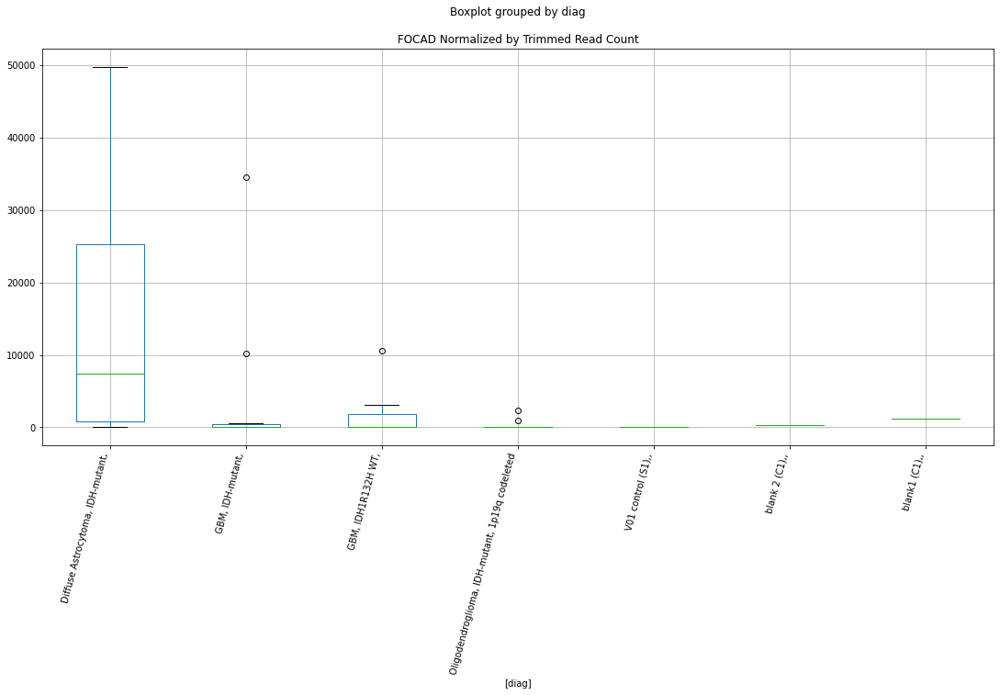

 p : 0.042301684967042626  ( t : 2.1856262097204695 ) :  D-plex  :  bbduk2  :  EYS
Control and blanks
73     0.0
337    0.0
Name: EYS, dtype: float64
205    716.36
Name: EYS, dtype: float64
469    3549.16
Name: EYS, dtype: float64


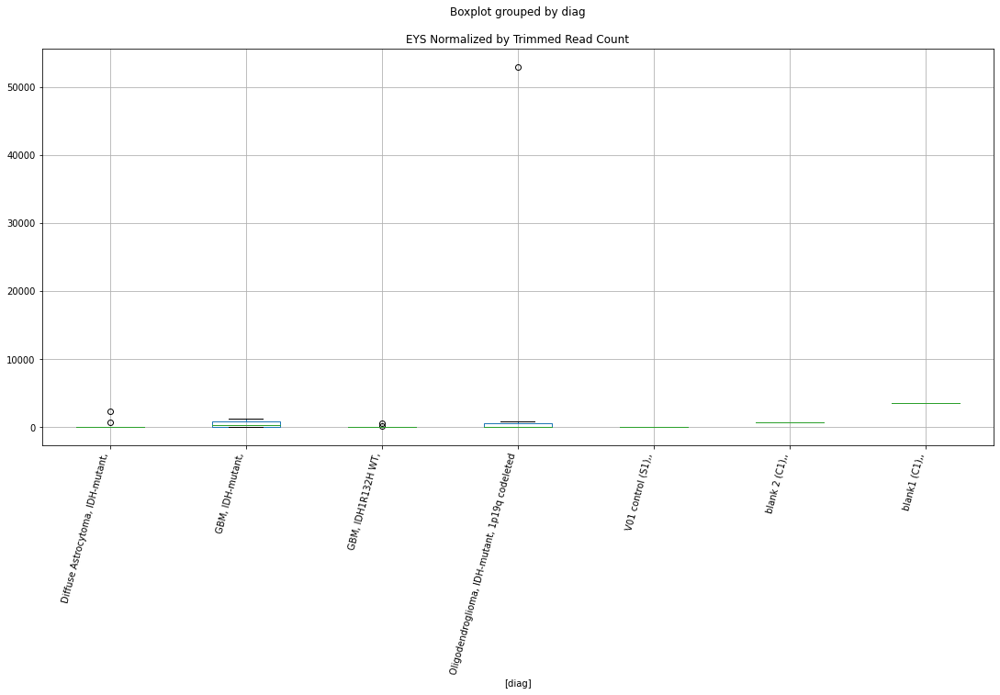

 p : 0.04232057156203861  ( t : 2.185401679526579 ) :  Lexogen  :  cutadapt2  :  IQSEC3
Control and blanks
82     0.0
346    0.0
Name: IQSEC3, dtype: float64
214    0.0
Name: IQSEC3, dtype: float64
478    0.0
Name: IQSEC3, dtype: float64


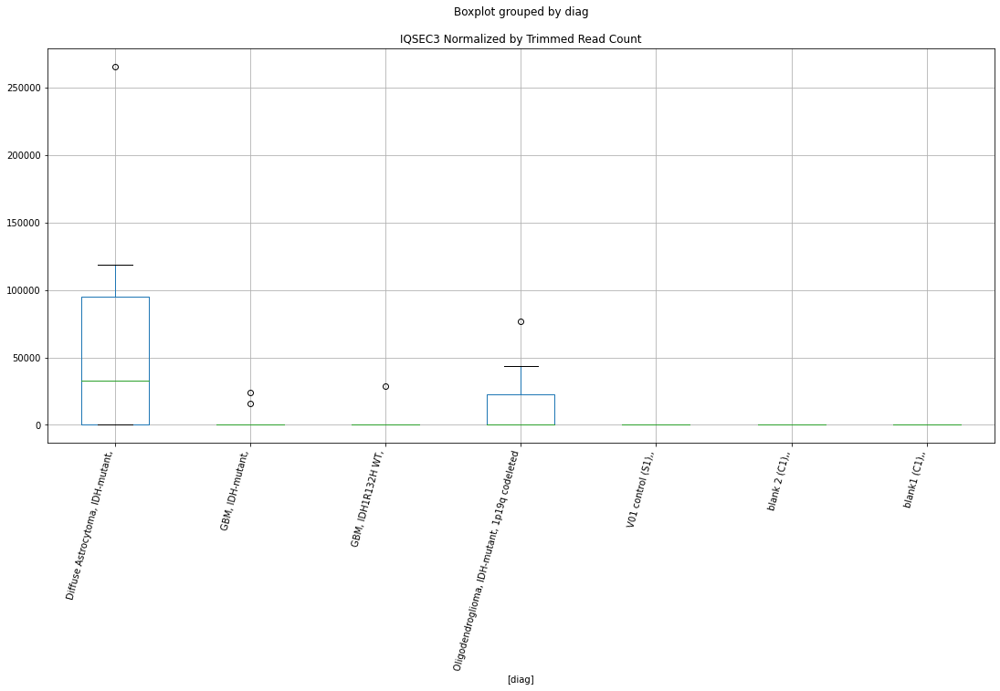

 p : 0.04250444632547253  ( t : 2.183220503451651 ) :  D-plex  :  cutadapt2  :  DOCK9
Control and blanks
76         0.00
340    58128.32
Name: DOCK9, dtype: float64
208    75305.81
Name: DOCK9, dtype: float64
472    629393.91
Name: DOCK9, dtype: float64


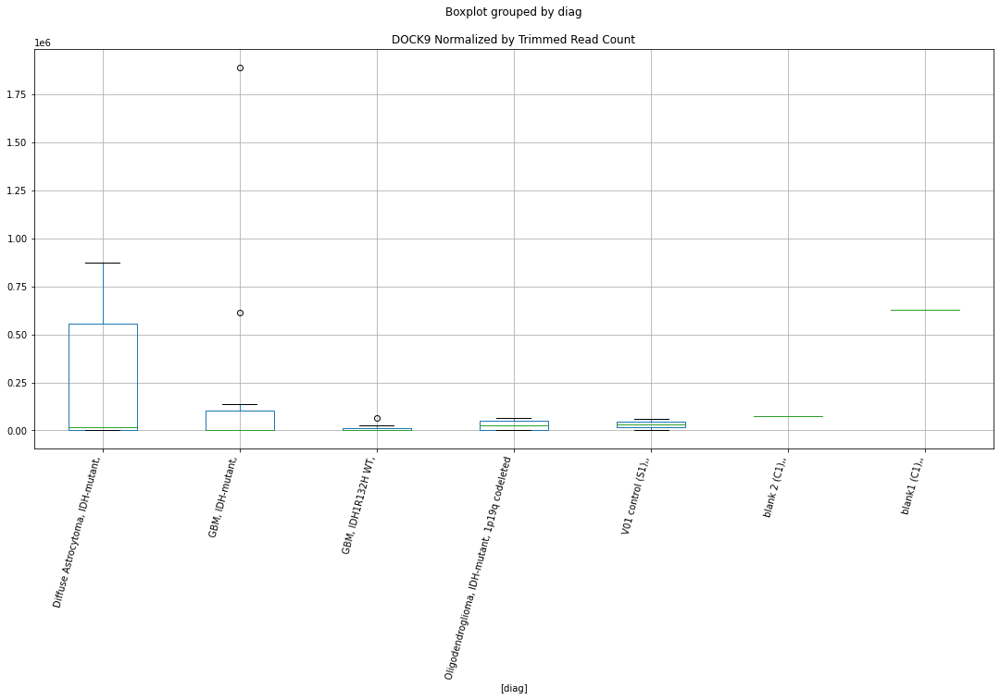

 p : 0.04251723050161583  ( t : 2.183069175689568 ) :  D-plex  :  cutadapt2  :  GSN
Control and blanks
76     0.0
340    0.0
Name: GSN, dtype: float64
208    8994.37
Name: GSN, dtype: float64
472    0.0
Name: GSN, dtype: float64


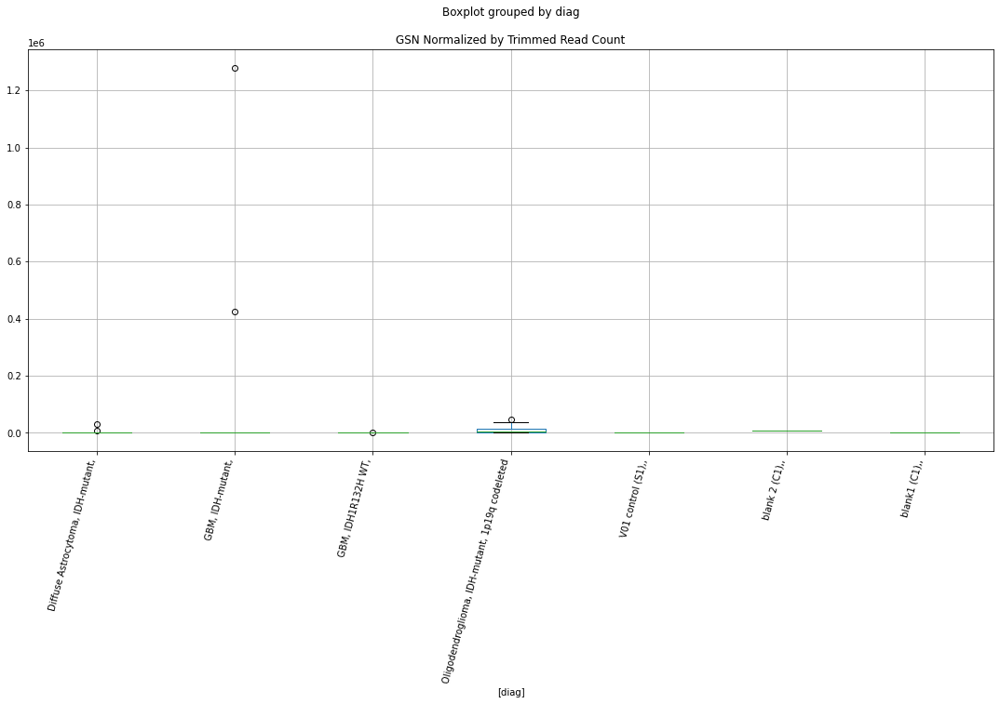

 p : 0.042588757380411874  ( t : 2.182223272654626 ) :  D-plex  :  bbduk2  :  IGFL3
Control and blanks
73     3092.03
337       0.00
Name: IGFL3, dtype: float64
205    16297.28
Name: IGFL3, dtype: float64
469    18928.87
Name: IGFL3, dtype: float64


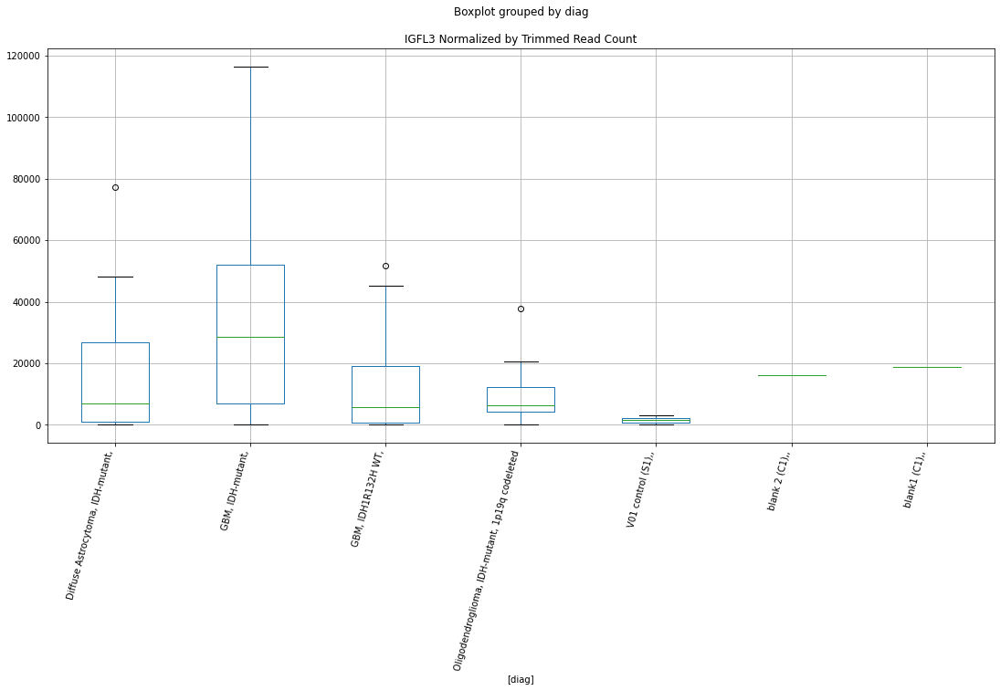

 p : 0.042643402125254984  ( t : 2.1815779010487364 ) :  D-plex  :  bbduk2  :  FAM27E4
Control and blanks
73     773.01
337      0.00
Name: FAM27E4, dtype: float64
205    10208.18
Name: FAM27E4, dtype: float64
469    13605.13
Name: FAM27E4, dtype: float64


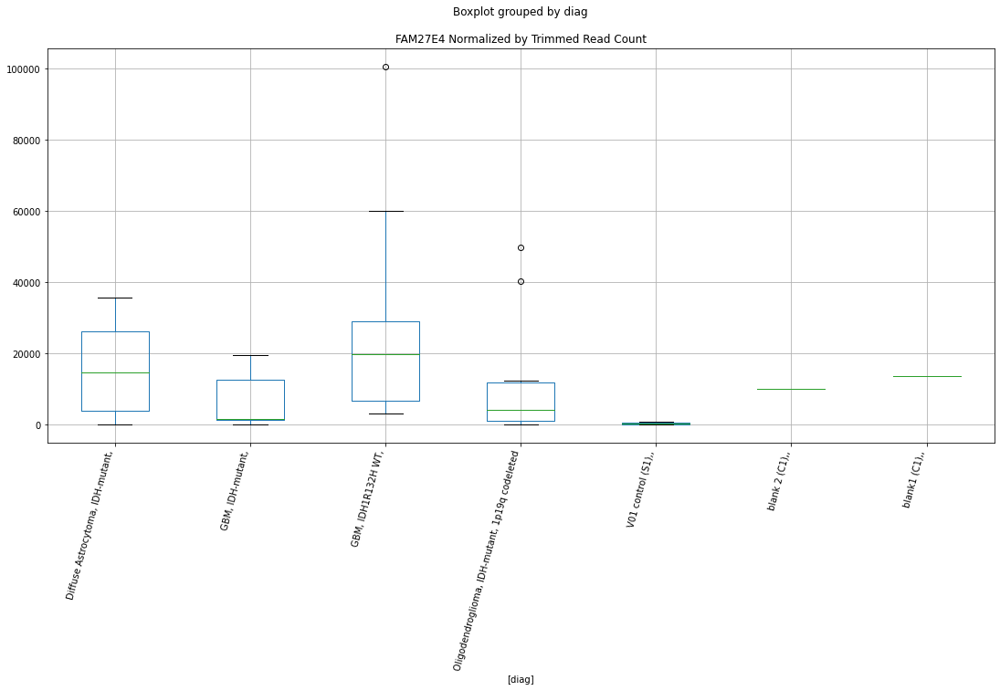

 p : 0.042677070707058555  ( t : 2.181180641864943 ) :  D-plex  :  cutadapt2  :  HAUS6
Control and blanks
76     113642.13
340         0.00
Name: HAUS6, dtype: float64
208    3350.84
Name: HAUS6, dtype: float64
472    3467.74
Name: HAUS6, dtype: float64


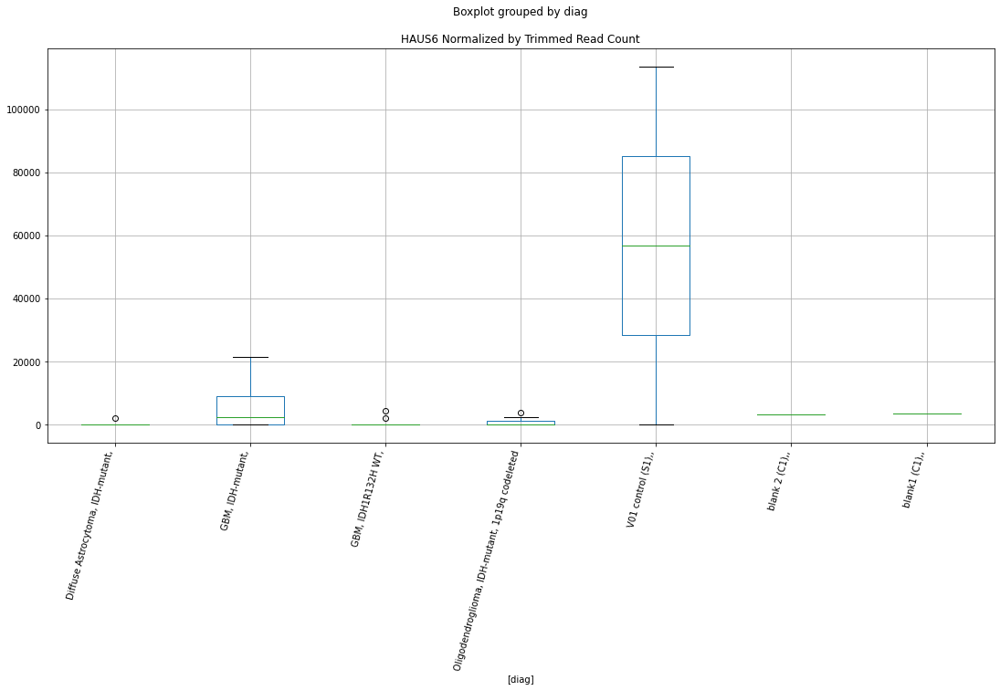

 p : 0.04268224363940849  ( t : 2.1811196313472805 ) :  Lexogen  :  bbduk2  :  IDH3G
Control and blanks
79     0.0
343    0.0
Name: IDH3G, dtype: float64
211    0.0
Name: IDH3G, dtype: float64
475    0.0
Name: IDH3G, dtype: float64


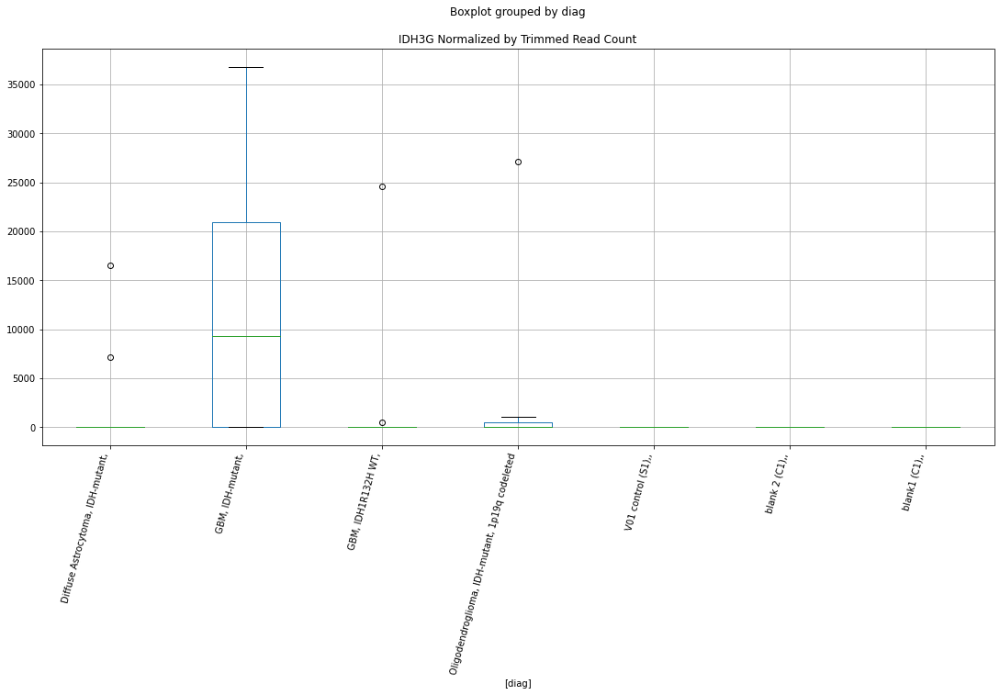

 p : 0.04268678980582609  ( t : 2.1810660186181443 ) :  D-plex  :  cutadapt2  :  ESYT3
Control and blanks
76      1515.23
340    14091.71
Name: ESYT3, dtype: float64
208    39857.41
Name: ESYT3, dtype: float64
472    45658.51
Name: ESYT3, dtype: float64


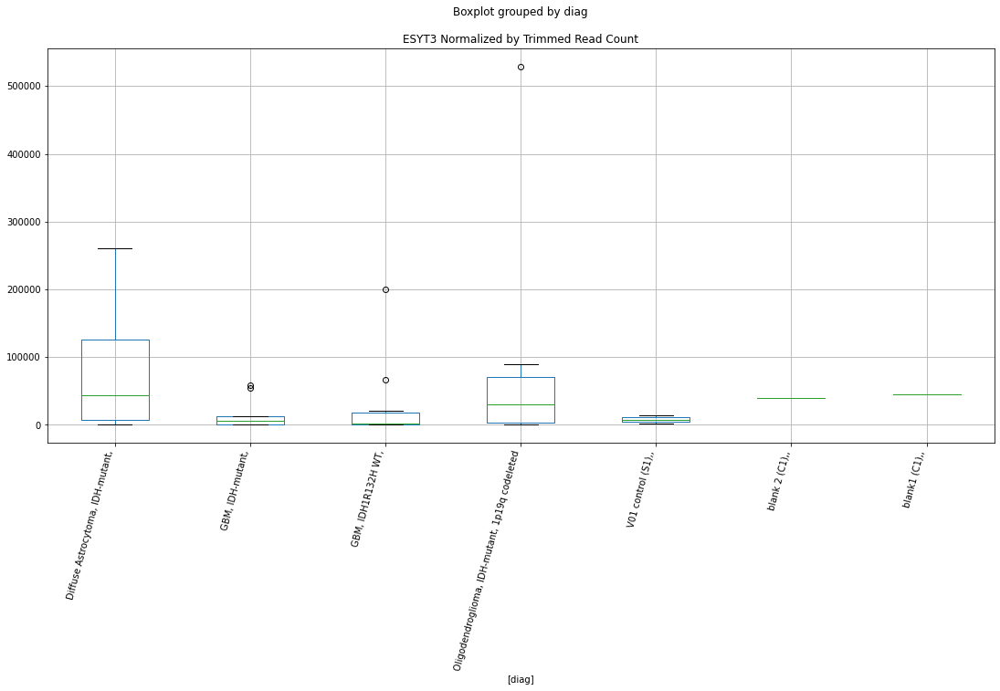

 p : 0.04274282630862215  ( t : 2.180405612238948 ) :  D-plex  :  cutadapt2  :  GOLGA6L4
Control and blanks
76     0.0
340    0.0
Name: GOLGA6L4, dtype: float64
208    176.36
Name: GOLGA6L4, dtype: float64
472    1155.91
Name: GOLGA6L4, dtype: float64


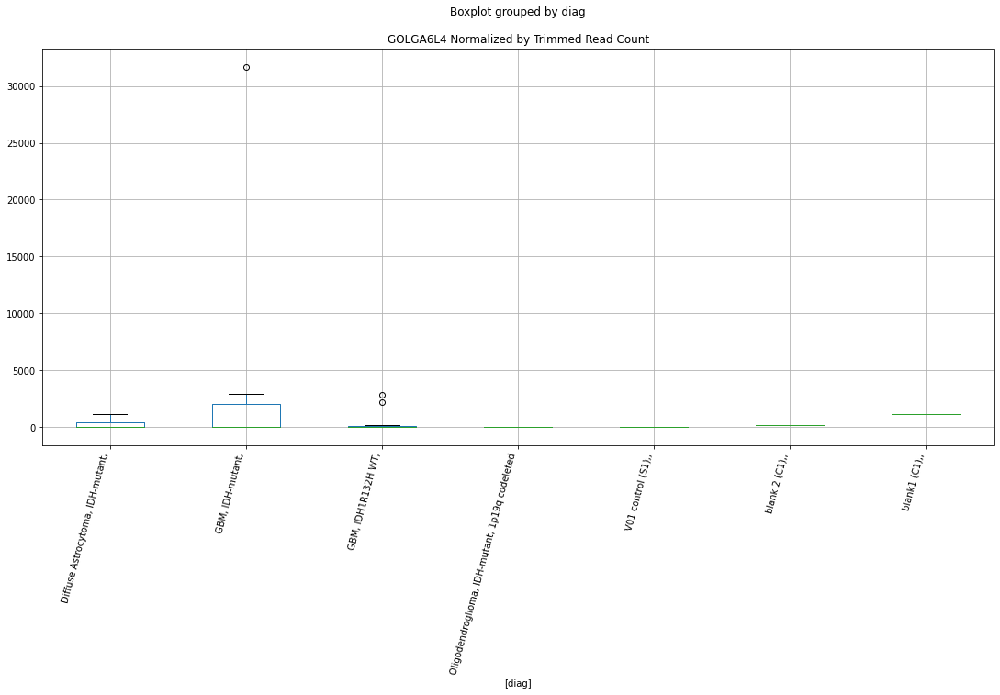

 p : 0.04282717781642029  ( t : 2.179413000177327 ) :  Lexogen  :  bbduk2  :  IMPG2
Control and blanks
79     0.0
343    0.0
Name: IMPG2, dtype: float64
211    0.0
Name: IMPG2, dtype: float64
475    0.0
Name: IMPG2, dtype: float64


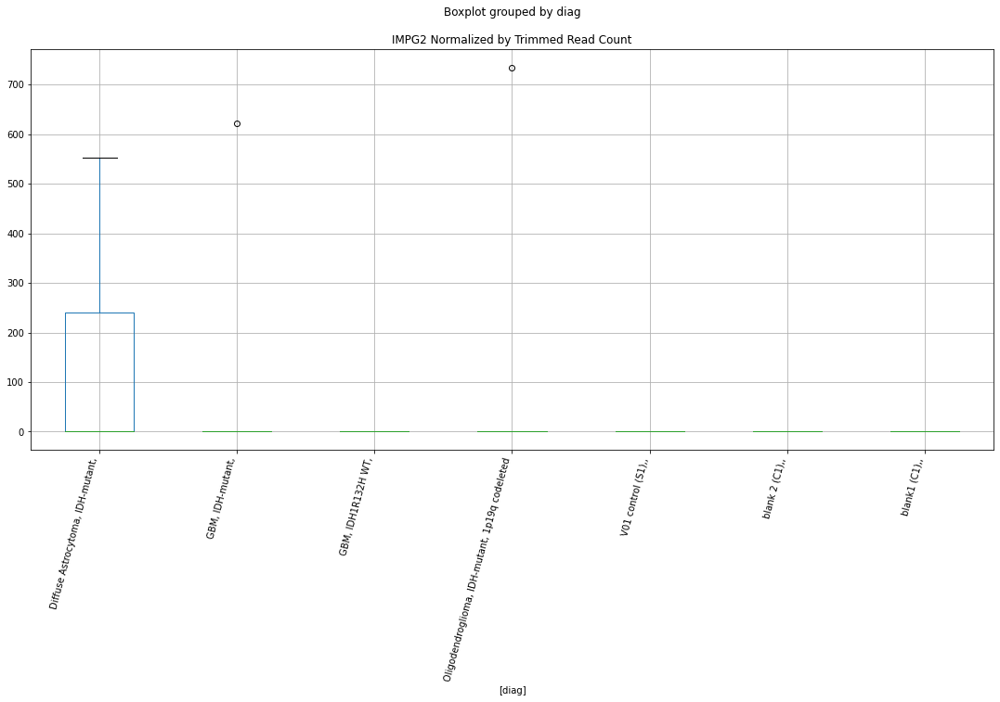

 p : 0.042835604904522546  ( t : 2.17931393231935 ) :  Lexogen  :  cutadapt2  :  KIAA0895
Control and blanks
82     0.0
346    0.0
Name: KIAA0895, dtype: float64
214    0.0
Name: KIAA0895, dtype: float64
478    0.0
Name: KIAA0895, dtype: float64


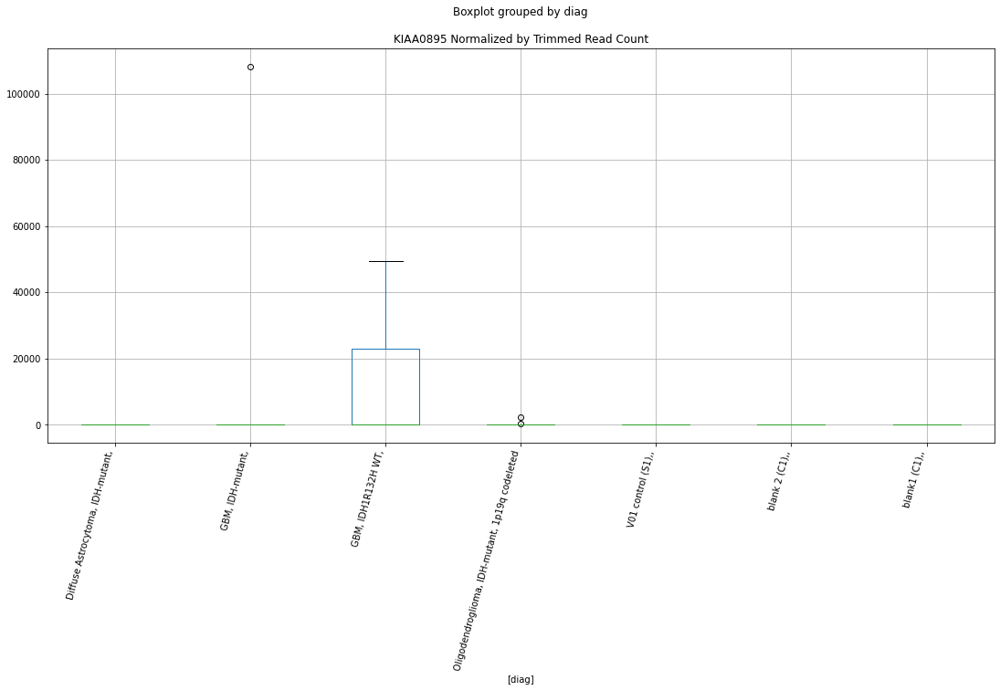

 p : 0.04283873915246295  ( t : 2.179277091025708 ) :  D-plex  :  bbduk2  :  GREB1
Control and blanks
73     54110.59
337        0.00
Name: GREB1, dtype: float64
205    14327.28
Name: GREB1, dtype: float64
469    9464.44
Name: GREB1, dtype: float64


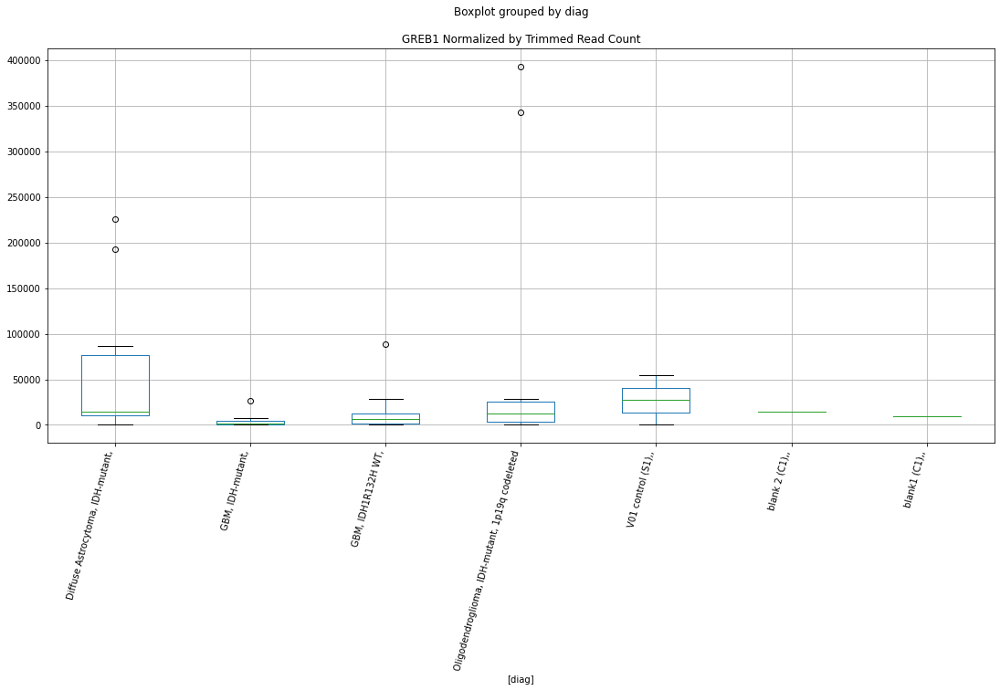

 p : 0.042931009798200914  ( t : 2.1781936076205164 ) :  D-plex  :  bbduk2  :  FOCAD
Control and blanks
73     0.0
337    0.0
Name: FOCAD, dtype: float64
205    358.18
Name: FOCAD, dtype: float64
469    1183.05
Name: FOCAD, dtype: float64


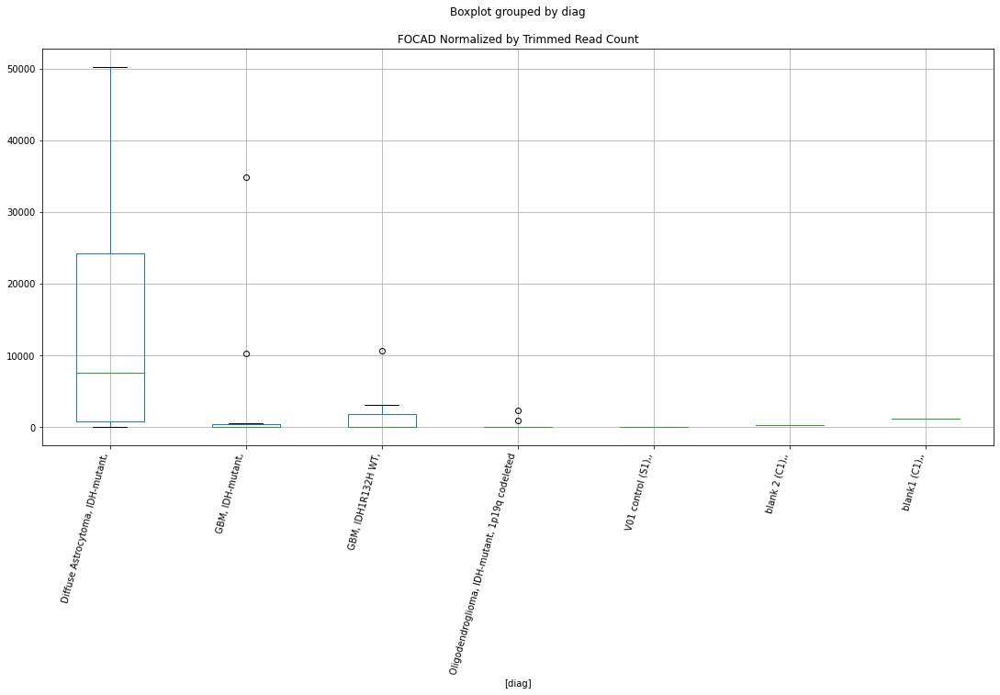

 p : 0.042942719096238625  ( t : 2.1780562644016697 ) :  D-plex  :  cutadapt2  :  ISOC1
Control and blanks
76     0.0
340    0.0
Name: ISOC1, dtype: float64
208    3174.48
Name: ISOC1, dtype: float64
472    0.0
Name: ISOC1, dtype: float64


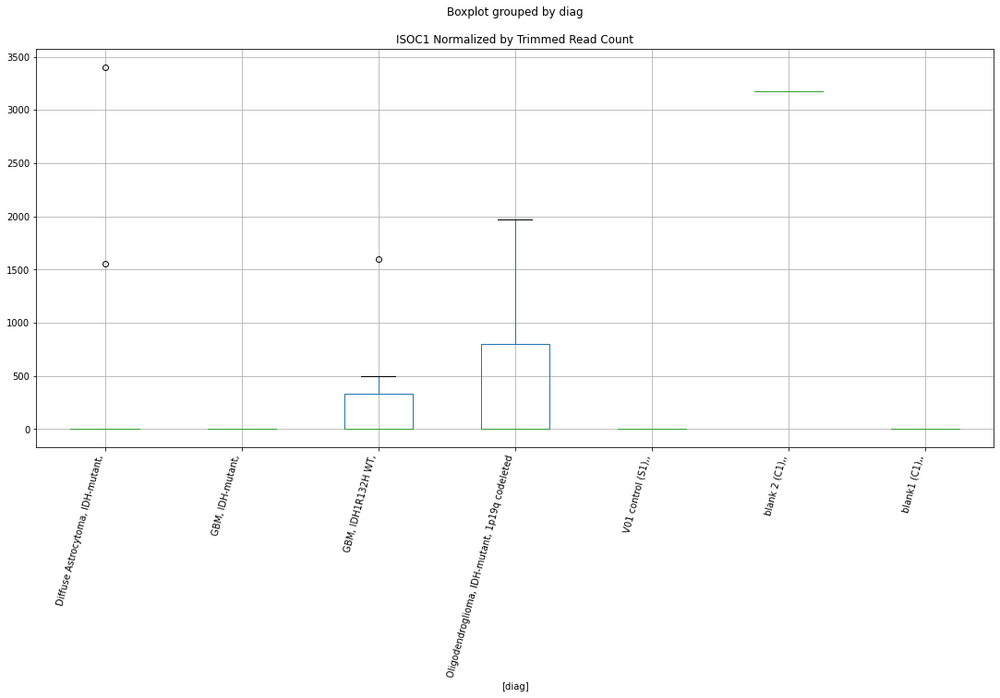

 p : 0.04297801424433169  ( t : 2.1776424804780676 ) :  D-plex  :  cutadapt2  :  GREM1
Control and blanks
76     12121.83
340        0.00
Name: GREM1, dtype: float64
208    26101.31
Name: GREM1, dtype: float64
472    20806.41
Name: GREM1, dtype: float64


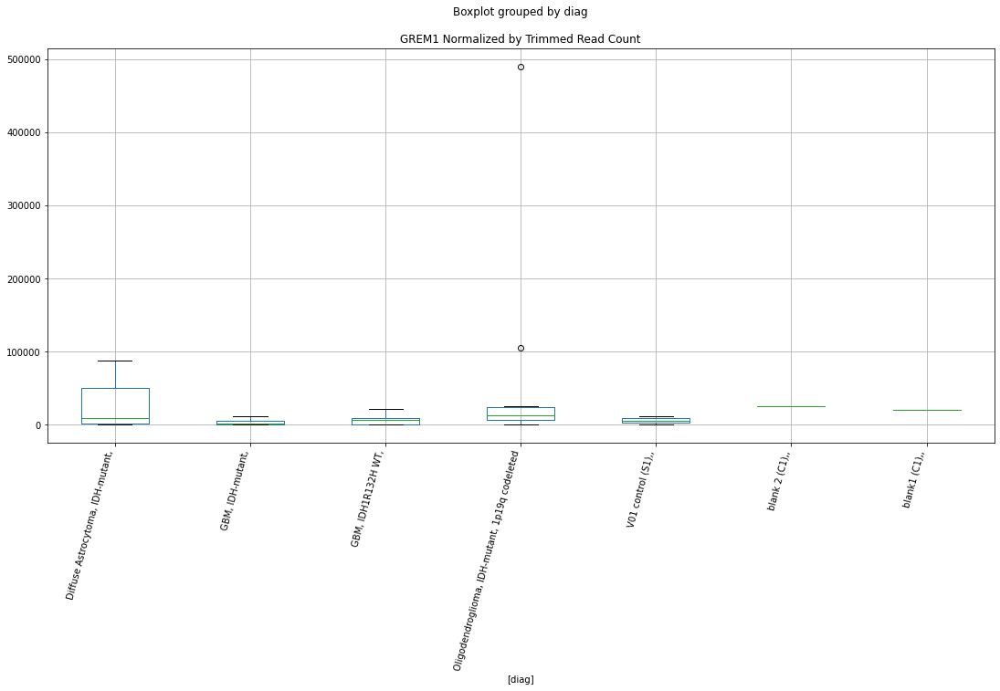

 p : 0.04307784880973155  ( t : 2.176473750137465 ) :  D-plex  :  bbduk2  :  FAM106A
Control and blanks
73     0.0
337    0.0
Name: FAM106A, dtype: float64
205    1074.55
Name: FAM106A, dtype: float64
469    591.53
Name: FAM106A, dtype: float64


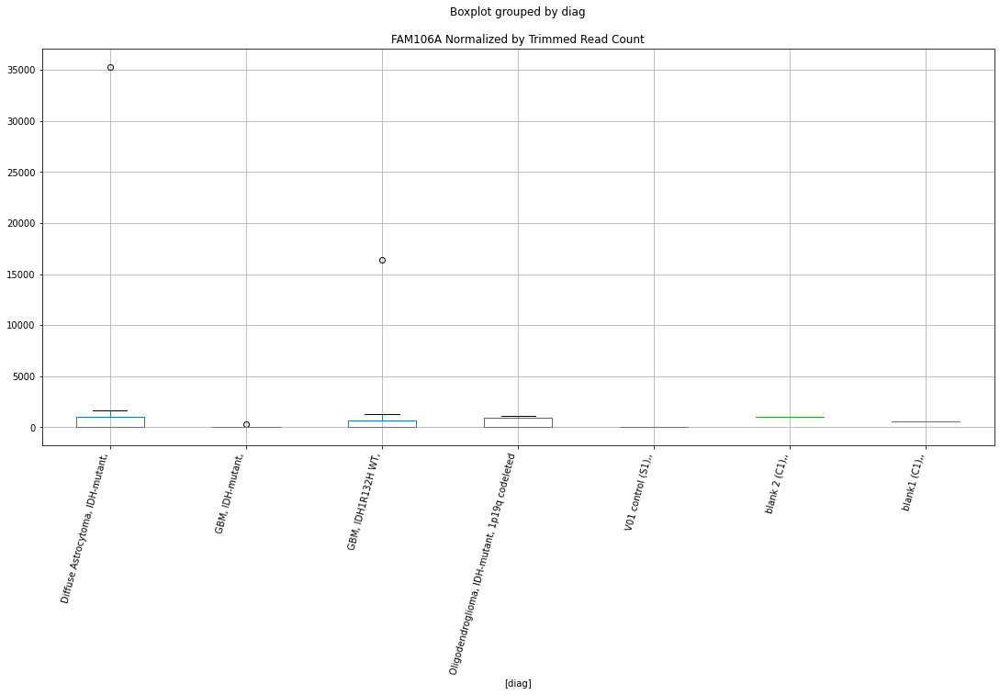

 p : 0.04315969781306249  ( t : 2.1755174206887586 ) :  D-plex  :  bbduk2  :  JARID2
Control and blanks
73     6184.07
337       0.00
Name: JARID2, dtype: float64
205    35997.28
Name: JARID2, dtype: float64
469    37266.22
Name: JARID2, dtype: float64


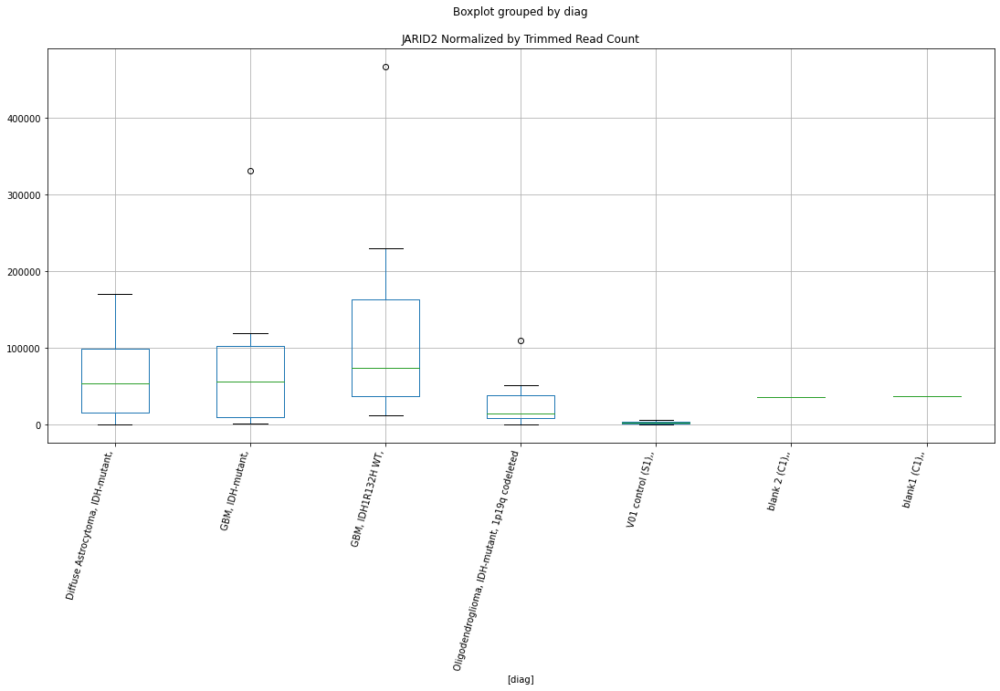

 p : 0.043221045736134736  ( t : 2.174801716053468 ) :  D-plex  :  bbduk2  :  HEATR5B
Control and blanks
73     0.0
337    0.0
Name: HEATR5B, dtype: float64
205    2686.36
Name: HEATR5B, dtype: float64
469    0.0
Name: HEATR5B, dtype: float64


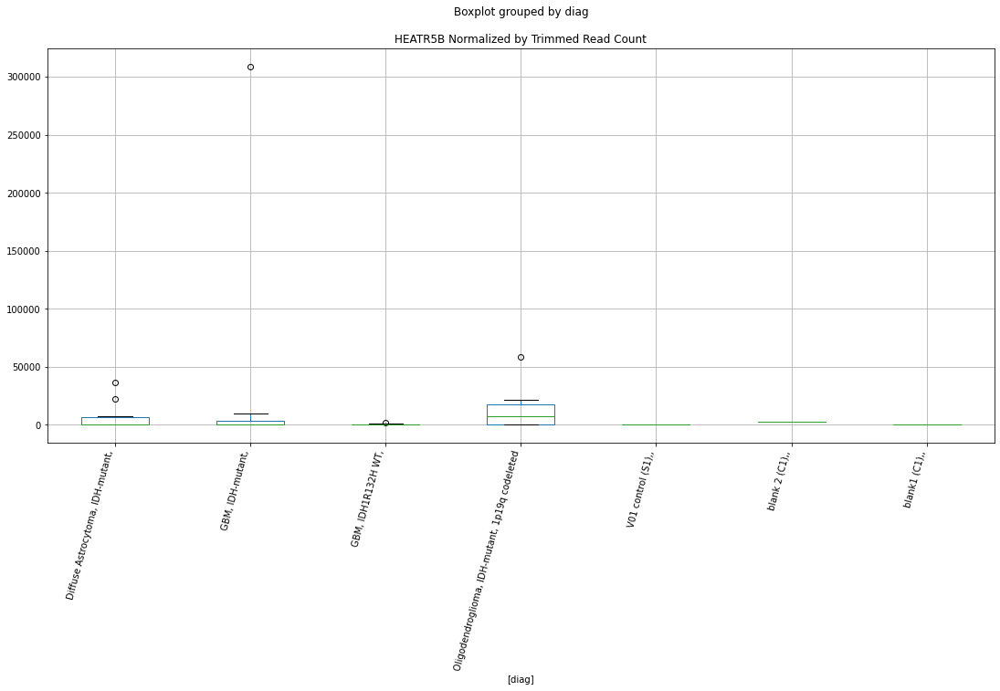

 p : 0.04324378463257945  ( t : 2.174536673137583 ) :  Lexogen  :  bbduk2  :  JOSD1
Control and blanks
79       0.00
343    849.26
Name: JOSD1, dtype: float64
211    0.0
Name: JOSD1, dtype: float64
475    0.0
Name: JOSD1, dtype: float64


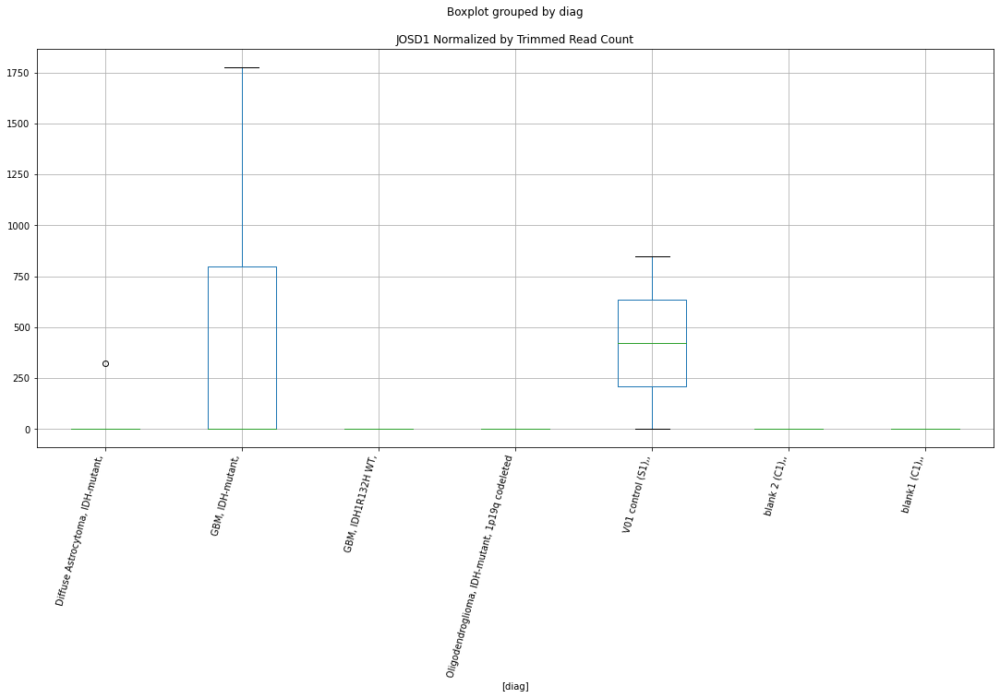

 p : 0.04324598041015773  ( t : 2.17451108607426 ) :  D-plex  :  bbduk2  :  ITGA7
Control and blanks
73     11595.13
337        0.00
Name: ITGA7, dtype: float64
205    41549.1
Name: ITGA7, dtype: float64
469    53237.46
Name: ITGA7, dtype: float64


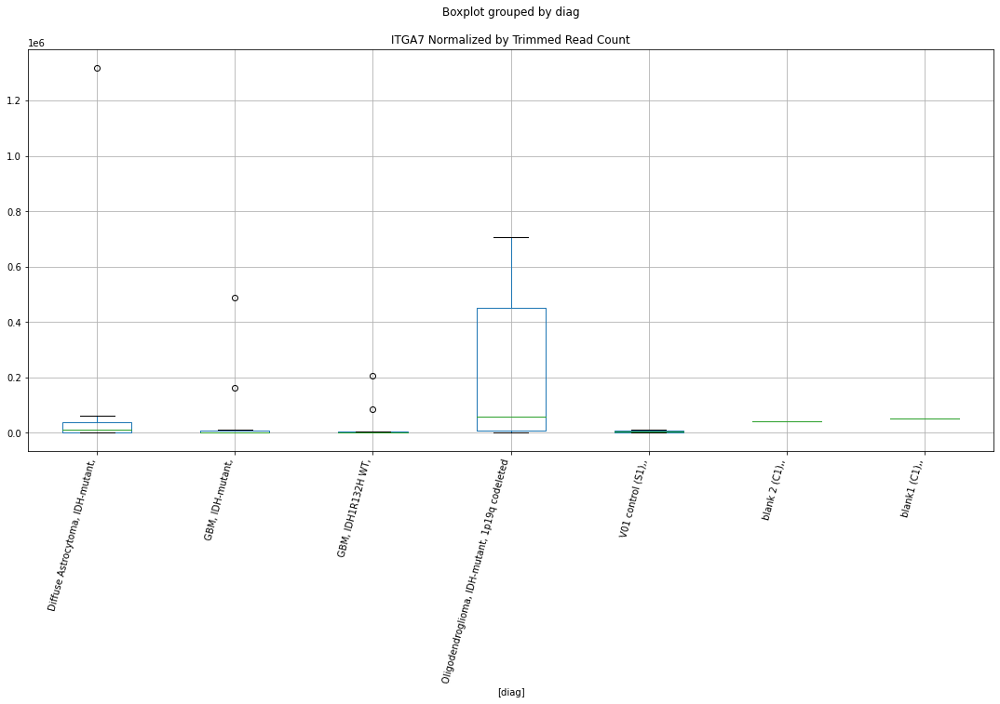

 p : 0.043284388868540795  ( t : 2.1740637104915597 ) :  D-plex  :  cutadapt2  :  EOMES
Control and blanks
76     1.71e+06
340    3.33e+05
Name: EOMES, dtype: float64
208    1.96e+06
Name: EOMES, dtype: float64
472    5.67e+06
Name: EOMES, dtype: float64


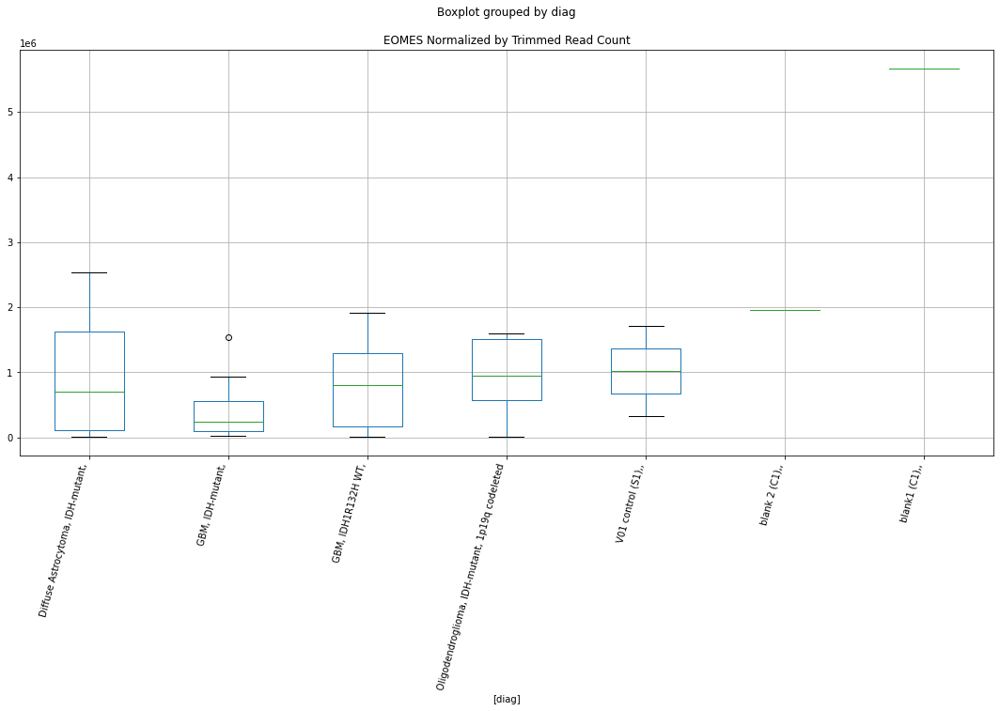

 p : 0.04334515323758217  ( t : 2.1733566789910657 ) :  Lexogen  :  cutadapt2  :  GRIN2D
Control and blanks
82         0.00
346    25673.01
Name: GRIN2D, dtype: float64
214    0.0
Name: GRIN2D, dtype: float64
478    0.0
Name: GRIN2D, dtype: float64


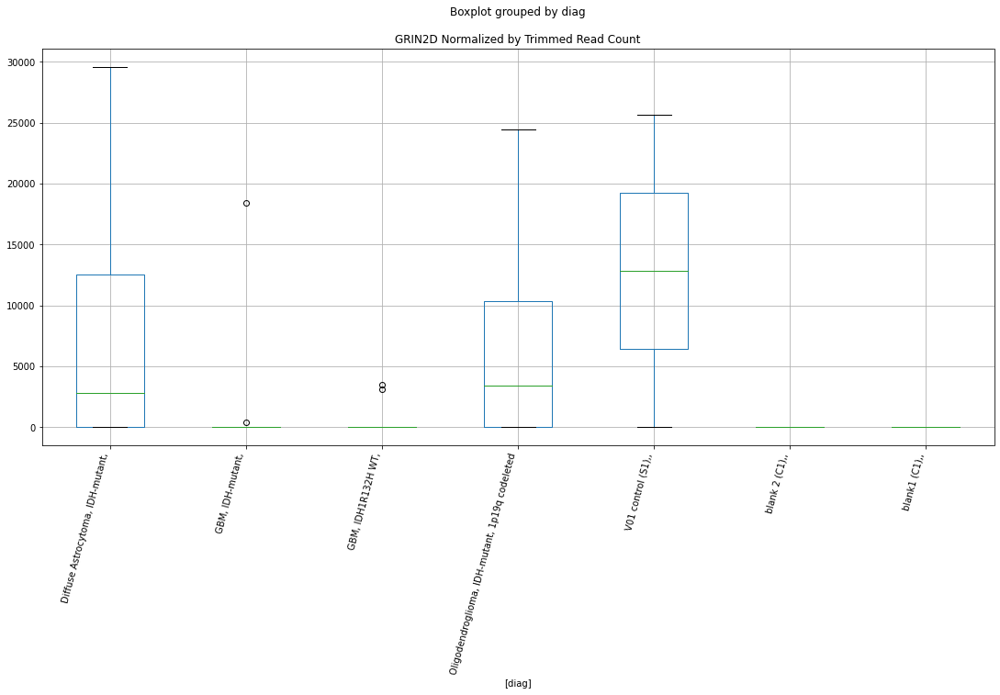

 p : 0.04336554135268152  ( t : 2.173119653897043 ) :  D-plex  :  cutadapt2  :  FEV
Control and blanks
76     757.61
340      0.00
Name: FEV, dtype: float64
208    529.08
Name: FEV, dtype: float64
472    3467.74
Name: FEV, dtype: float64


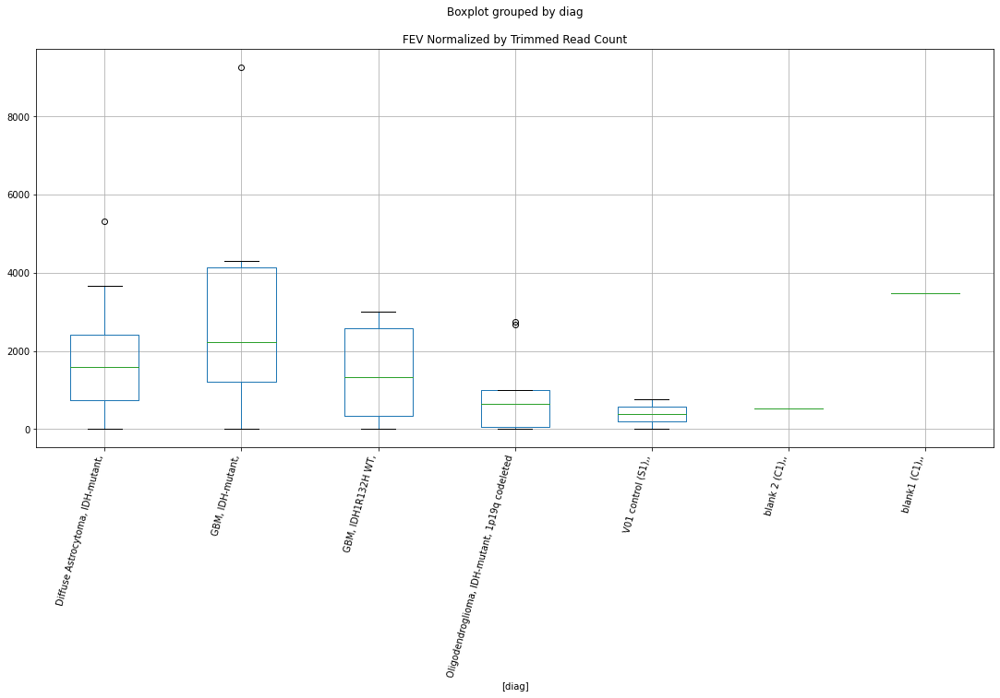

 p : 0.04342757743328963  ( t : 2.172399071353097 ) :  D-plex  :  bbduk2  :  GLTP
Control and blanks
73     0.0
337    0.0
Name: GLTP, dtype: float64
205    0.0
Name: GLTP, dtype: float64
469    0.0
Name: GLTP, dtype: float64


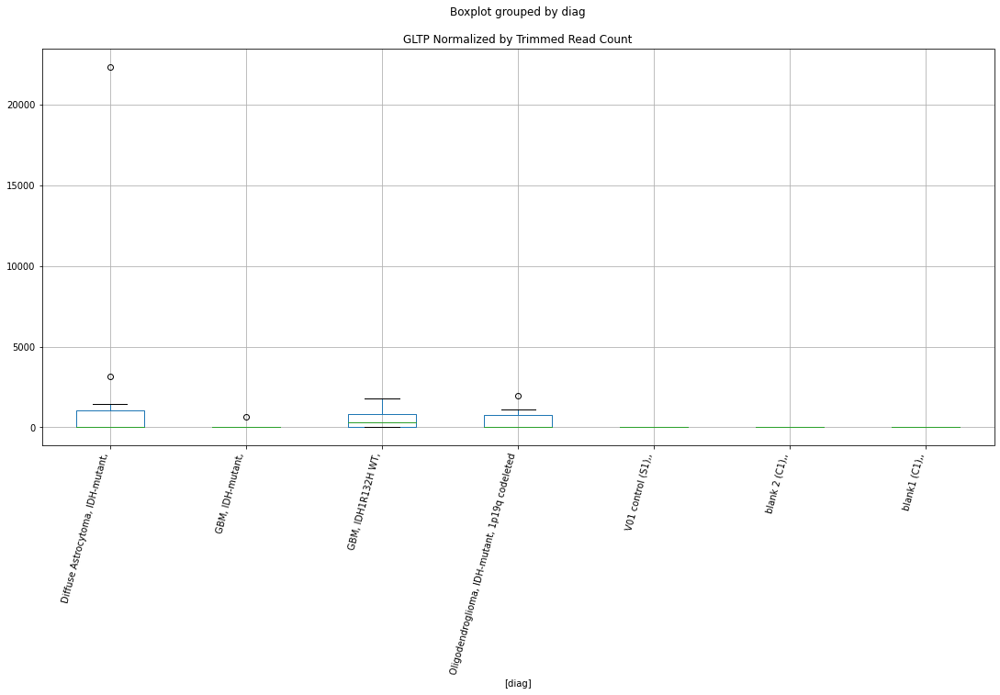

 p : 0.043491462797491505  ( t : 2.171657993000087 ) :  D-plex  :  cutadapt2  :  LDB2
Control and blanks
76     0.0
340    0.0
Name: LDB2, dtype: float64
208    8112.57
Name: LDB2, dtype: float64
472    9247.29
Name: LDB2, dtype: float64


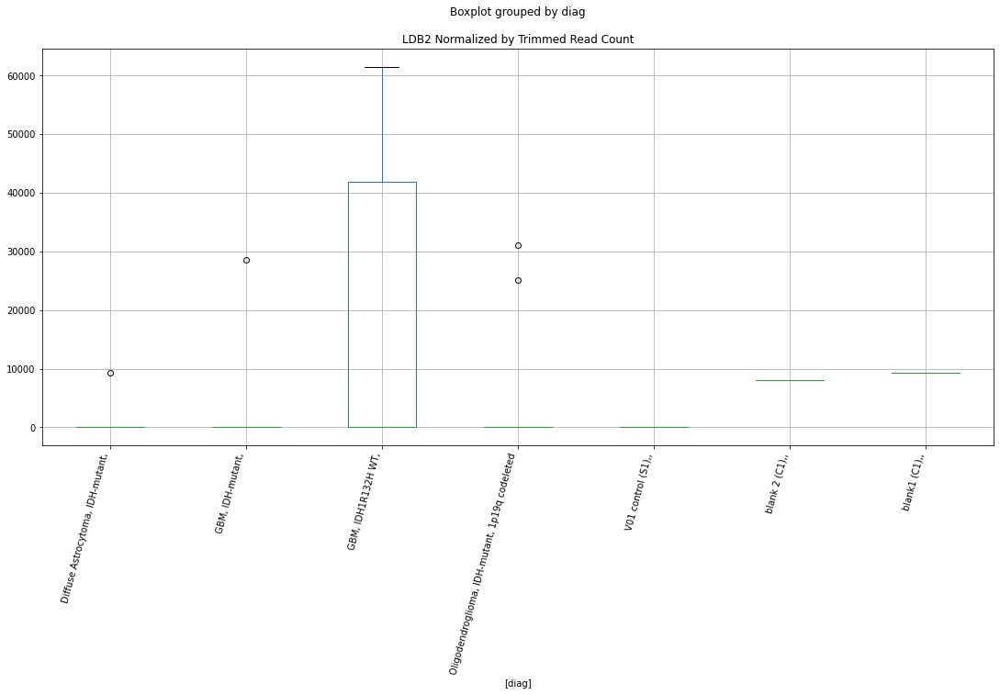

 p : 0.04351099934917271  ( t : 2.1714315655551863 ) :  Lexogen  :  cutadapt2  :  DMTN
Control and blanks
82     0.0
346    0.0
Name: DMTN, dtype: float64
214    0.0
Name: DMTN, dtype: float64
478    0.0
Name: DMTN, dtype: float64


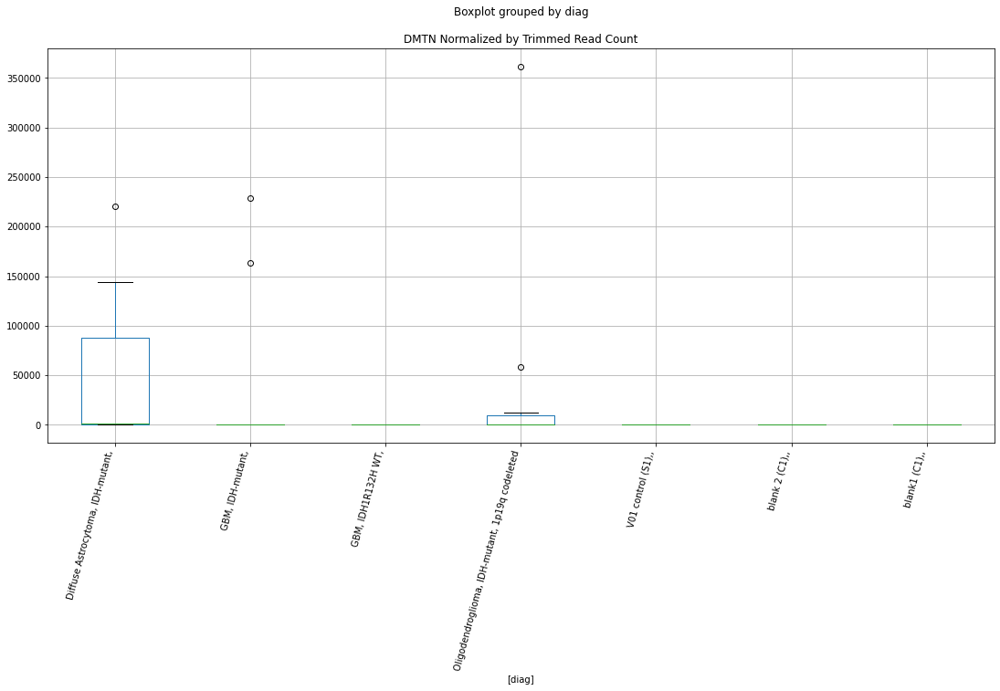

 p : 0.04355477854993707  ( t : 2.170924505160666 ) :  D-plex  :  bbduk2  :  EIF3A
Control and blanks
73     0.0
337    0.0
Name: EIF3A, dtype: float64
205    1432.73
Name: EIF3A, dtype: float64
469    1183.05
Name: EIF3A, dtype: float64


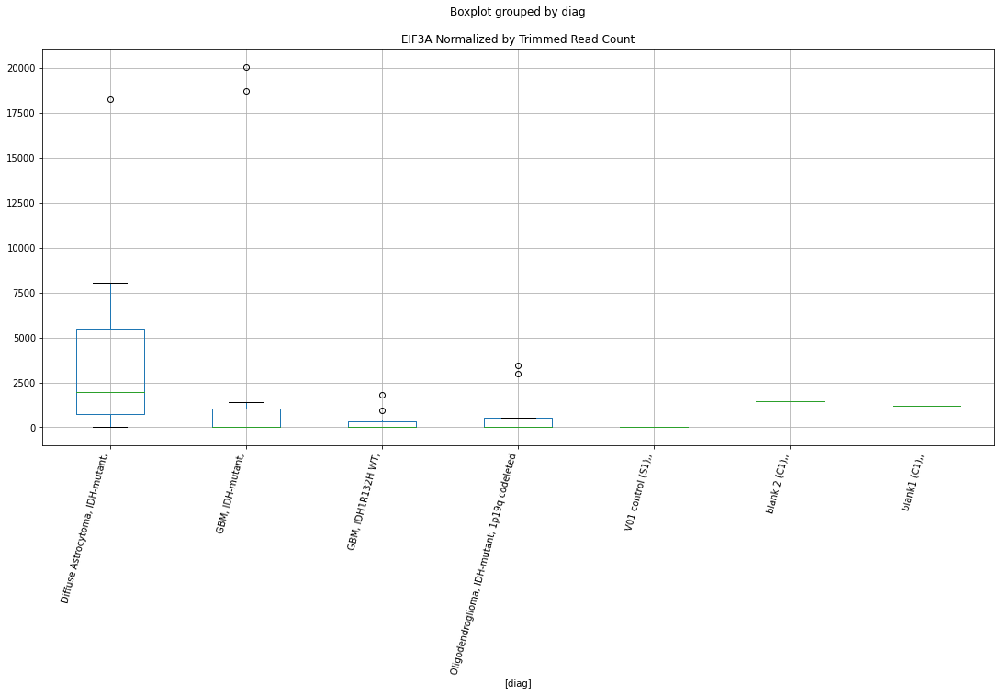

 p : 0.04355481214146445  ( t : 2.170924116275384 ) :  Lexogen  :  bbduk2  :  FAM210A
Control and blanks
79     0.0
343    0.0
Name: FAM210A, dtype: float64
211    0.0
Name: FAM210A, dtype: float64
475    0.0
Name: FAM210A, dtype: float64


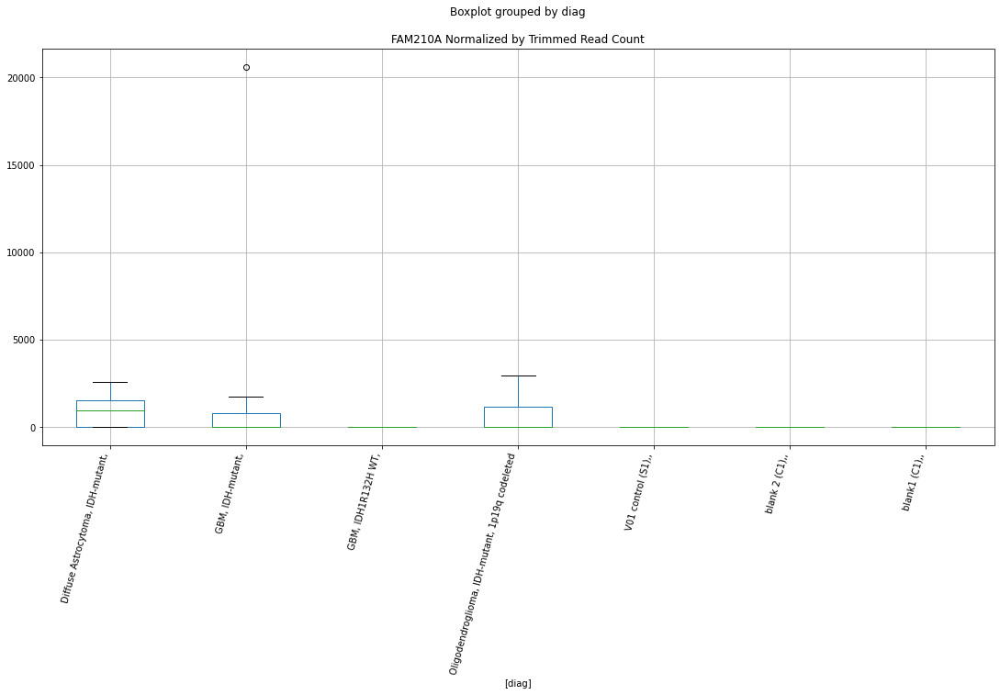

 p : 0.04363235286789709  ( t : 2.1700271672999643 ) :  D-plex  :  cutadapt2  :  KCNIP4-IT1
Control and blanks
76     0.0
340    0.0
Name: KCNIP4-IT1, dtype: float64
208    352.72
Name: KCNIP4-IT1, dtype: float64
472    577.96
Name: KCNIP4-IT1, dtype: float64


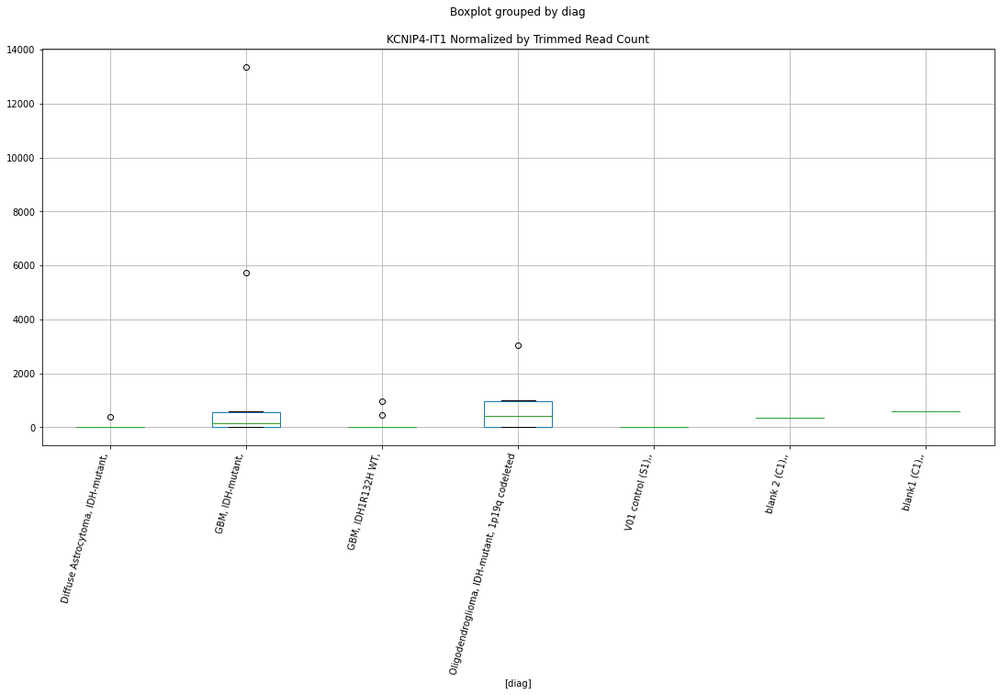

 p : 0.04365831453162388  ( t : 2.1697271830067706 ) :  Lexogen  :  bbduk2  :  DMTN
Control and blanks
79     0.0
343    0.0
Name: DMTN, dtype: float64
211    8472.5
Name: DMTN, dtype: float64
475    0.0
Name: DMTN, dtype: float64


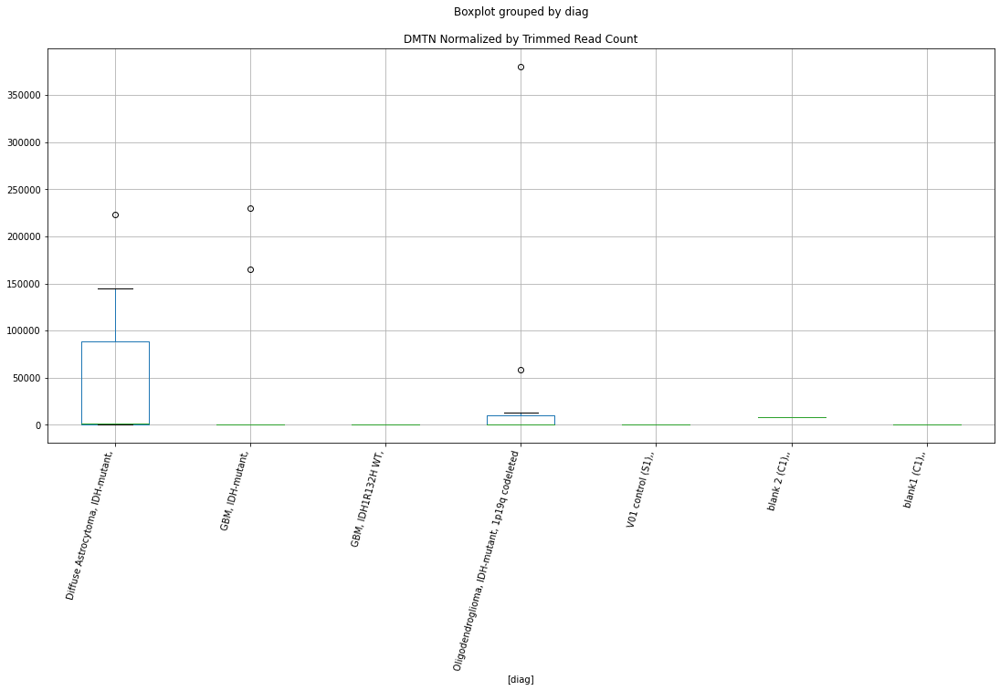

 p : 0.043669804817535234  ( t : 2.169594466099376 ) :  D-plex  :  bbduk2  :  GIT1
Control and blanks
73     0.0
337    0.0
Name: GIT1, dtype: float64
205    2865.46
Name: GIT1, dtype: float64
469    0.0
Name: GIT1, dtype: float64


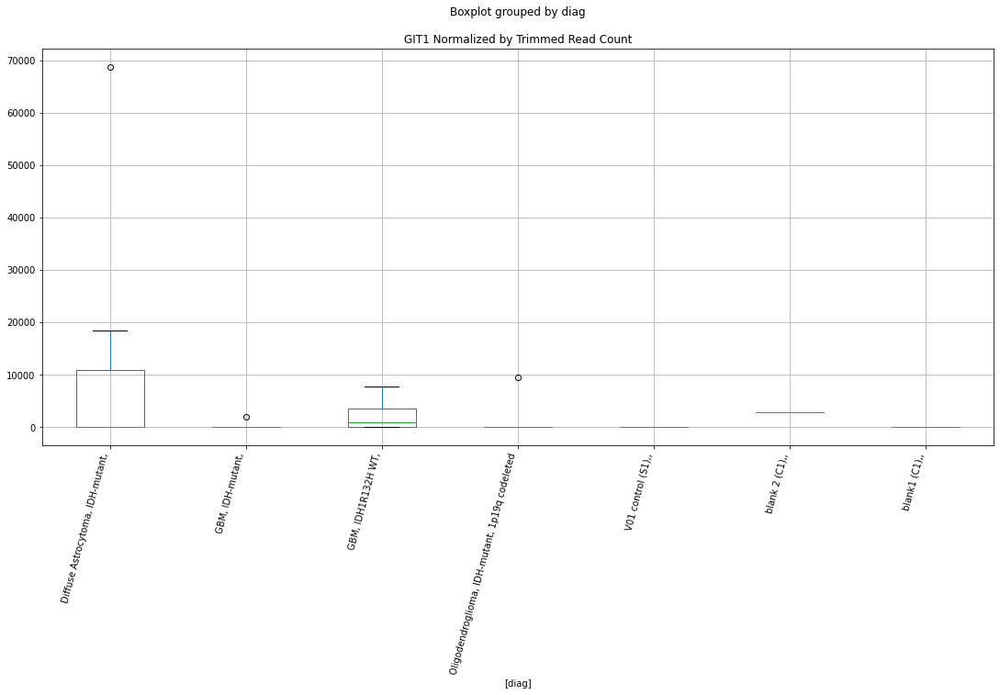

 p : 0.0436928782719072  ( t : 2.1693280559927315 ) :  D-plex  :  cutadapt2  :  IQCJ-SCHIP1
Control and blanks
76     54548.22
340        0.00
Name: IQCJ-SCHIP1, dtype: float64
208    1058.16
Name: IQCJ-SCHIP1, dtype: float64
472    3467.74
Name: IQCJ-SCHIP1, dtype: float64


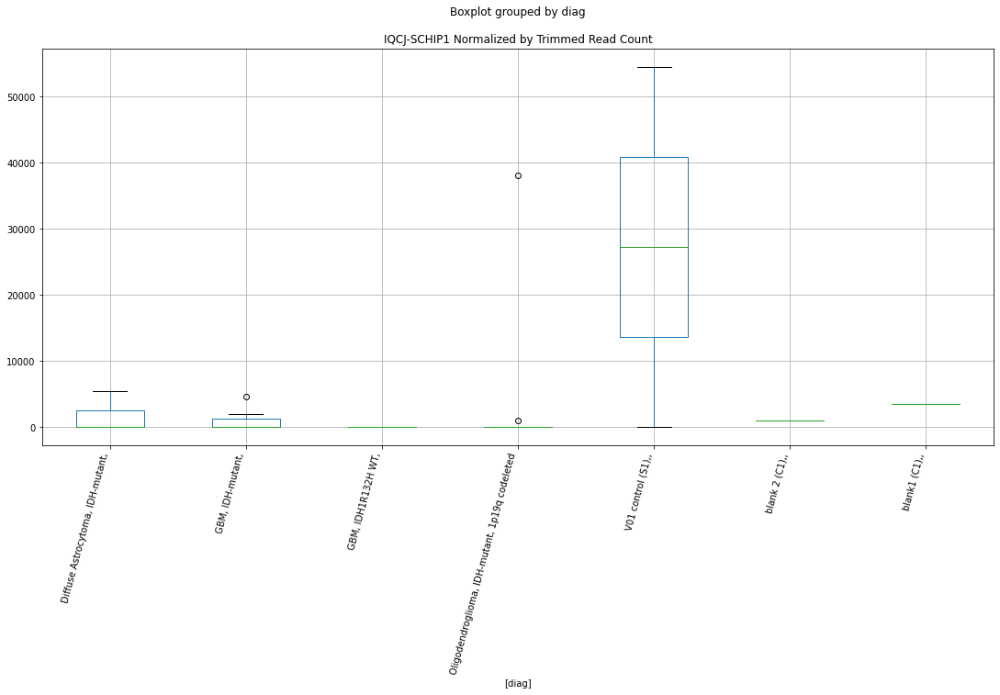

 p : 0.043693051226095334  ( t : 2.1693260595200927 ) :  D-plex  :  bbduk2  :  EIF3L
Control and blanks
73     0.0
337    0.0
Name: EIF3L, dtype: float64
205    895.45
Name: EIF3L, dtype: float64
469    0.0
Name: EIF3L, dtype: float64


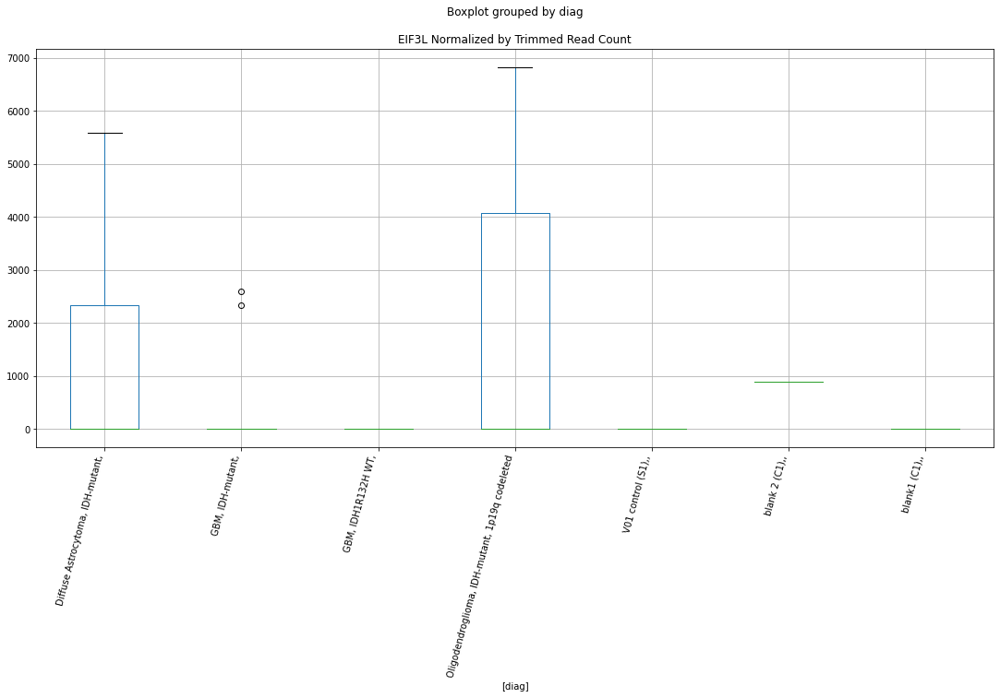

 p : 0.04369682037050211  ( t : 2.169282552722237 ) :  D-plex  :  bbduk2  :  KIAA0586
Control and blanks
73     18552.20
337    19583.46
Name: KIAA0586, dtype: float64
205    15222.73
Name: KIAA0586, dtype: float64
469    14196.66
Name: KIAA0586, dtype: float64


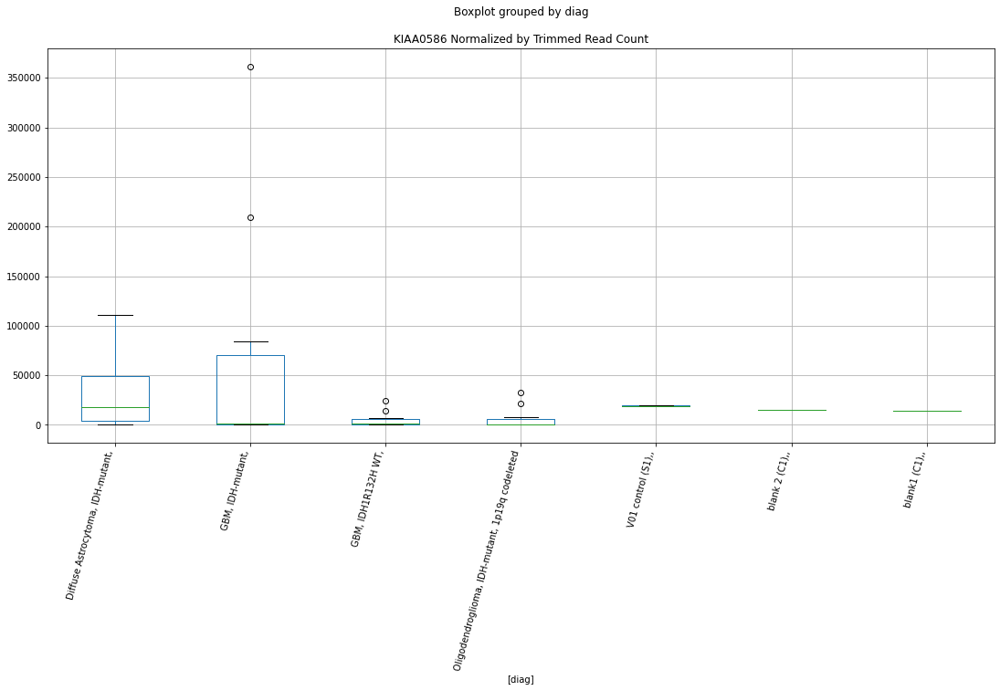

 p : 0.043710350439179896  ( t : 2.169126405003005 ) :  Lexogen  :  bbduk2  :  IQSEC3
Control and blanks
79     0.0
343    0.0
Name: IQSEC3, dtype: float64
211    0.0
Name: IQSEC3, dtype: float64
475    0.0
Name: IQSEC3, dtype: float64


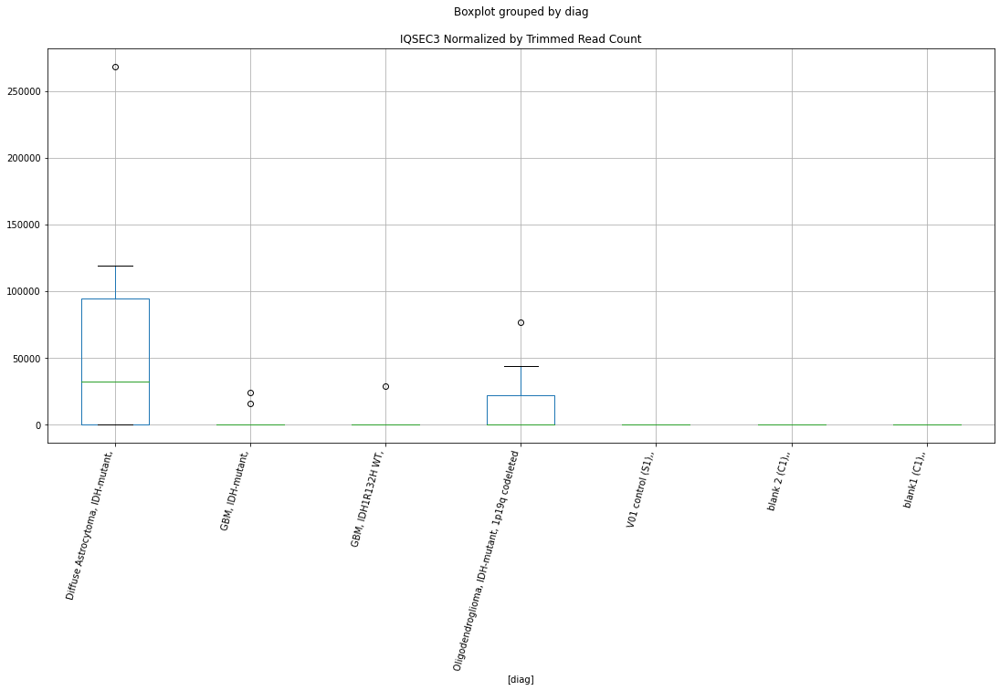

 p : 0.04372157262871283  ( t : 2.168996925607965 ) :  D-plex  :  cutadapt2  :  DNAH2
Control and blanks
76     0.0
340    0.0
Name: DNAH2, dtype: float64
208    12697.94
Name: DNAH2, dtype: float64
472    42768.73
Name: DNAH2, dtype: float64


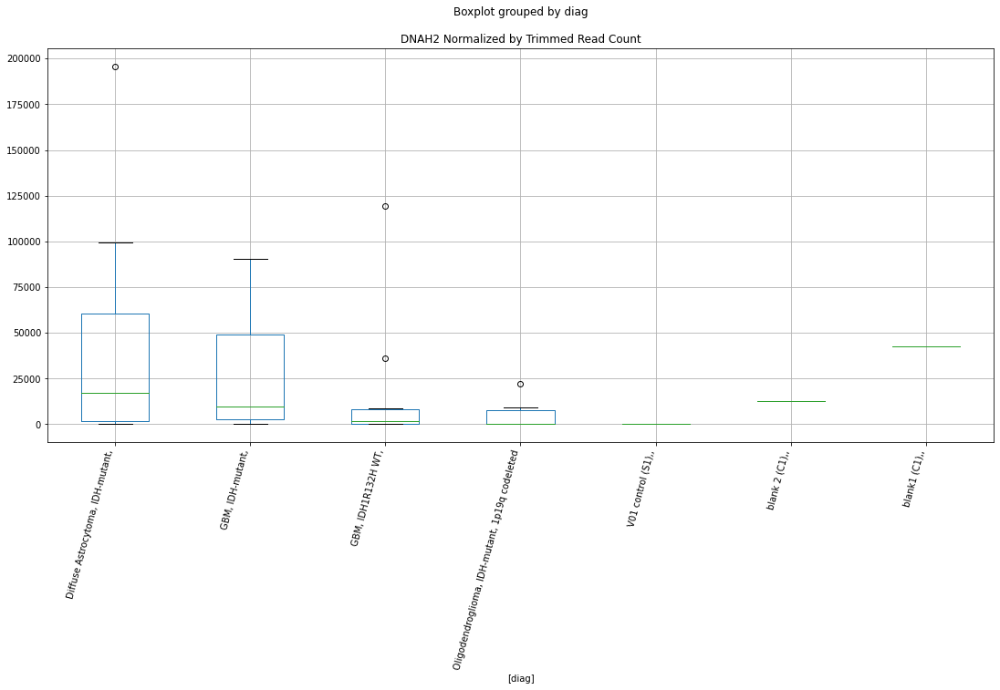

 p : 0.04374922181260718  ( t : 2.1686780445963714 ) :  D-plex  :  cutadapt2  :  DSC2
Control and blanks
76     2272.84
340       0.00
Name: DSC2, dtype: float64
208    3174.48
Name: DSC2, dtype: float64
472    2889.78
Name: DSC2, dtype: float64


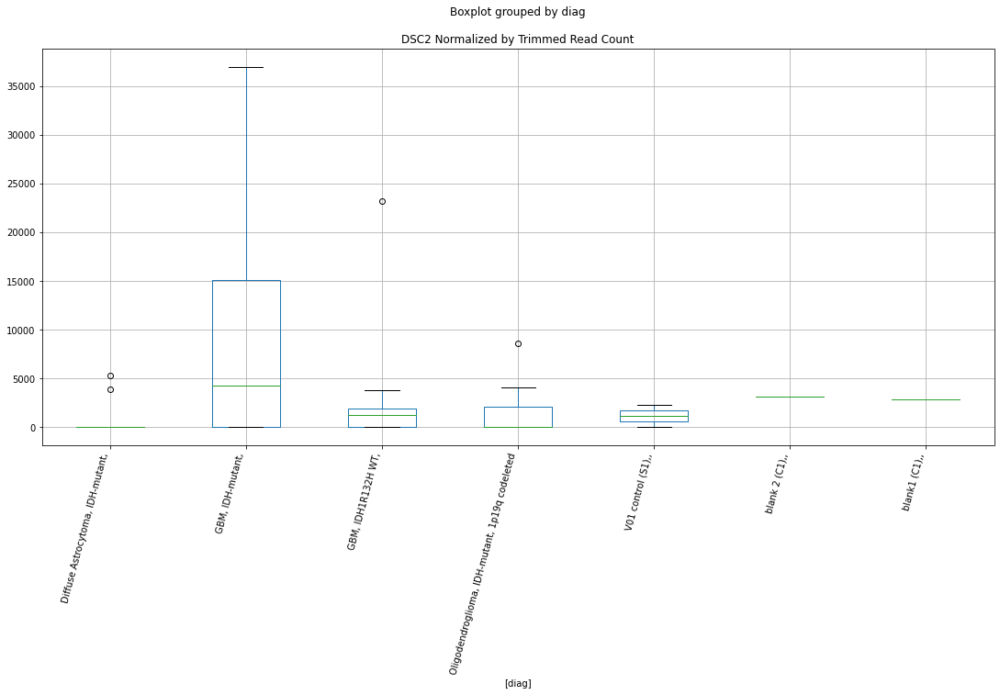

 p : 0.04375010115713798  ( t : 2.1686679060488374 ) :  D-plex  :  bbduk2  :  DPYSL3
Control and blanks
73     0.0
337    0.0
Name: DPYSL3, dtype: float64
205    895.45
Name: DPYSL3, dtype: float64
469    0.0
Name: DPYSL3, dtype: float64


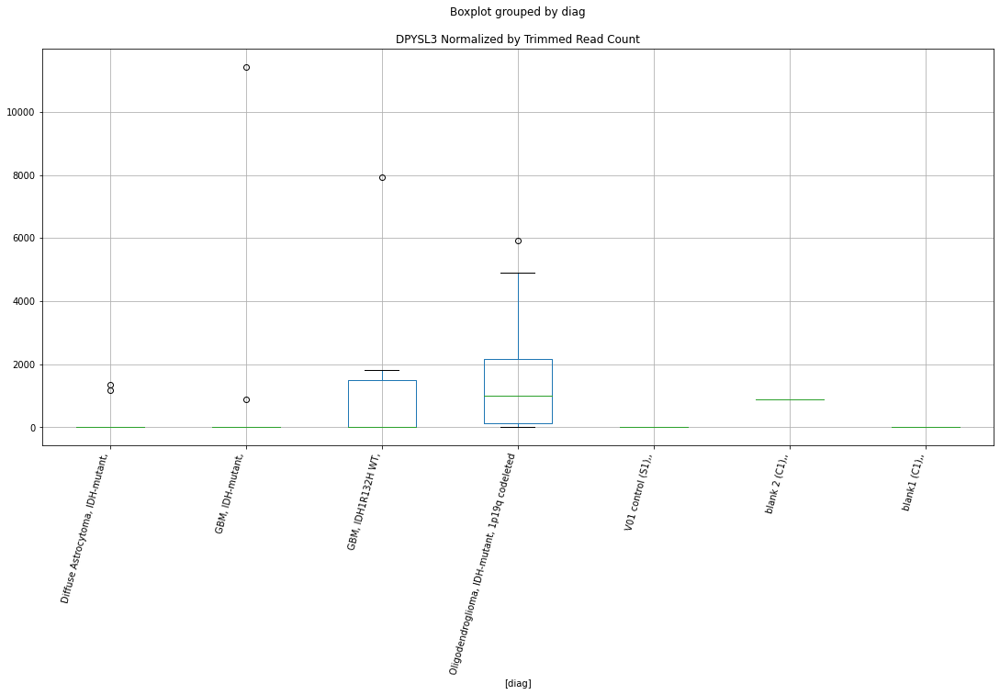

 p : 0.043796752737048014  ( t : 2.168130296279457 ) :  Lexogen  :  bbduk2  :  EPS8L2
Control and blanks
79     0.0
343    0.0
Name: EPS8L2, dtype: float64
211    0.0
Name: EPS8L2, dtype: float64
475    0.0
Name: EPS8L2, dtype: float64


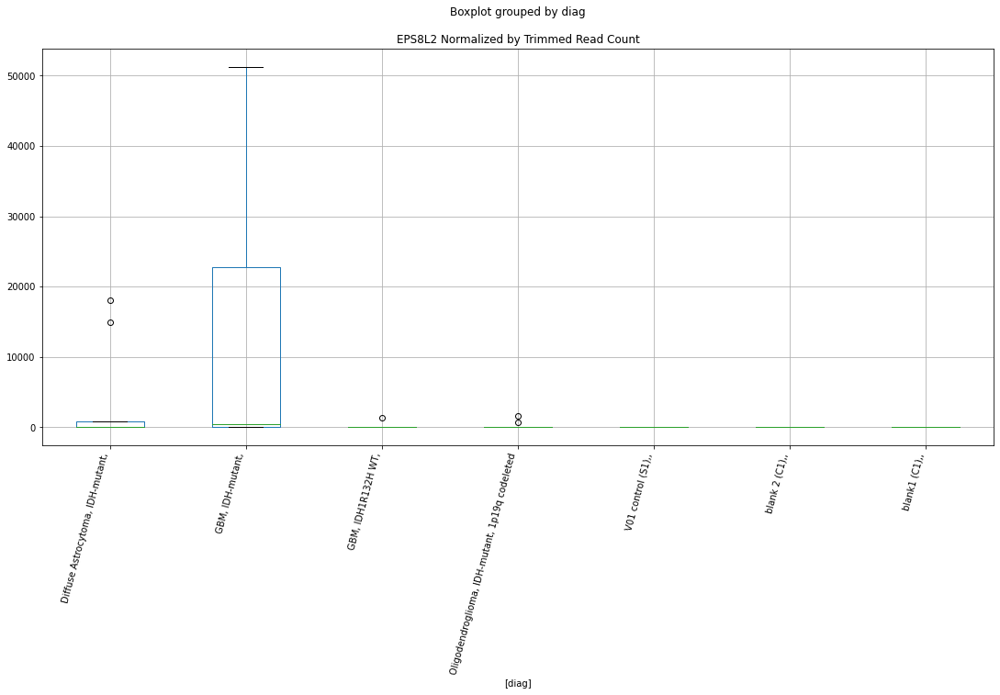

 p : 0.04379987961509701  ( t : 2.1680942810895583 ) :  D-plex  :  bbduk2  :  EOMES
Control and blanks
73     1.73e+06
337    3.36e+05
Name: EOMES, dtype: float64
205    1.98e+06
Name: EOMES, dtype: float64
469    5.77e+06
Name: EOMES, dtype: float64


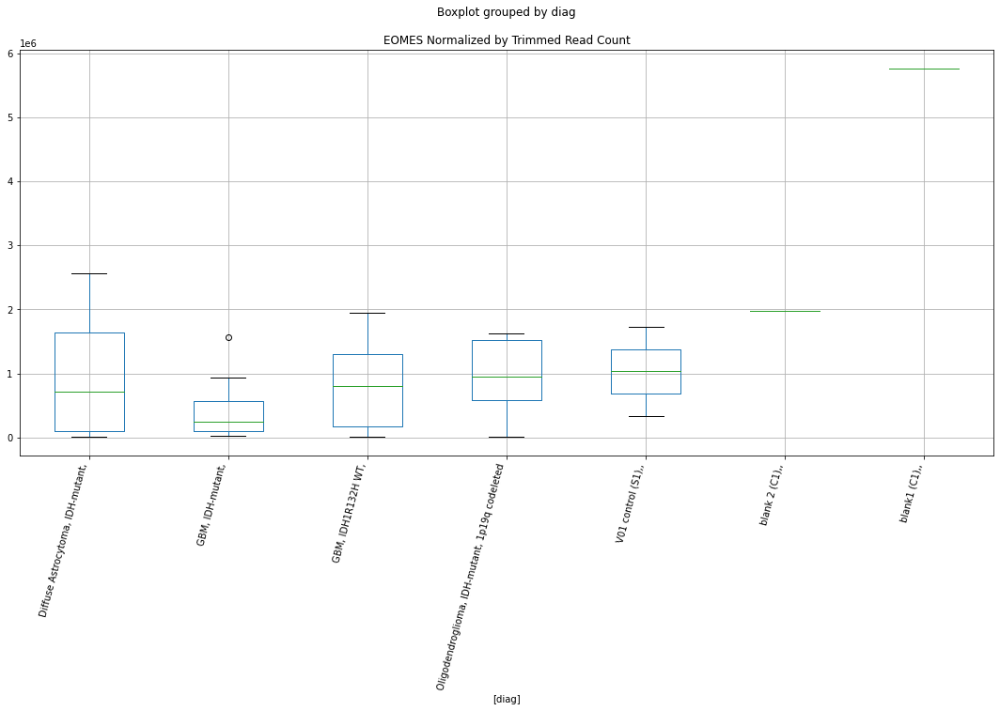

 p : 0.04381778491691027  ( t : 2.1678880942360137 ) :  Lexogen  :  bbduk2  :  GLI3
Control and blanks
79       0.00
343    212.31
Name: GLI3, dtype: float64
211    7379.27
Name: GLI3, dtype: float64
475    0.0
Name: GLI3, dtype: float64


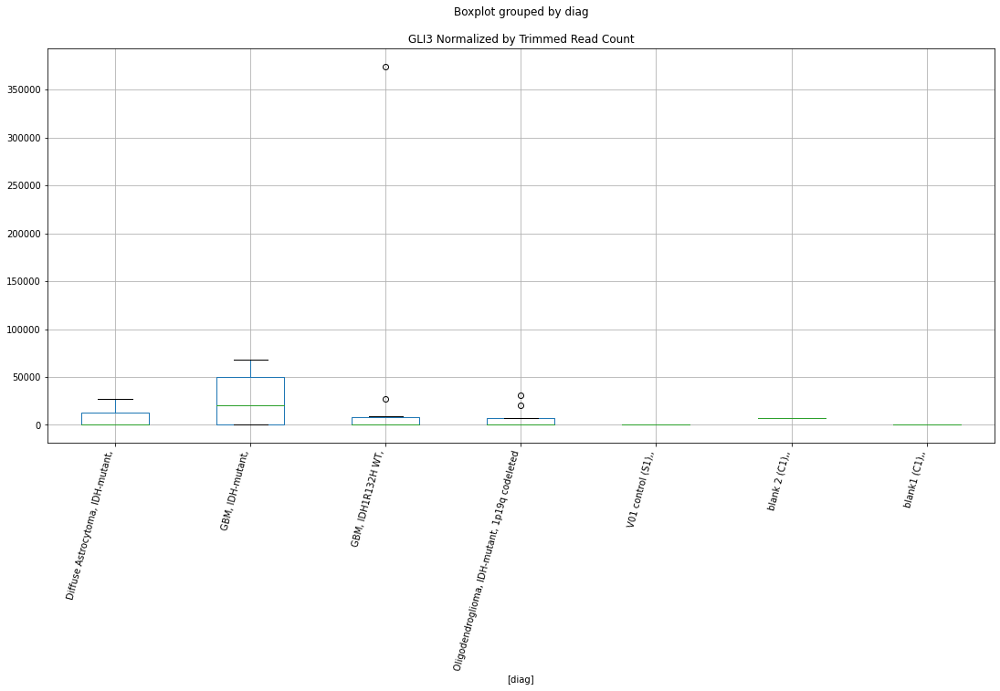

 p : 0.043858619063513016  ( t : 2.1674181607460166 ) :  D-plex  :  cutadapt2  :  KAT8
Control and blanks
76     0.0
340    0.0
Name: KAT8, dtype: float64
208    0.0
Name: KAT8, dtype: float64
472    1155.91
Name: KAT8, dtype: float64


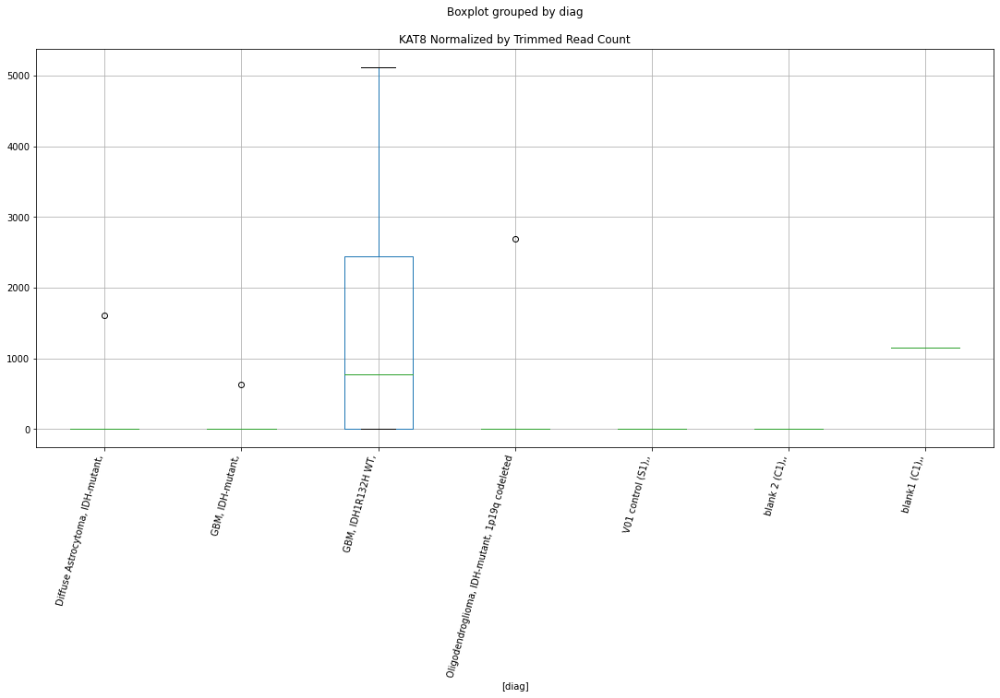

 p : 0.043879819191195386  ( t : 2.167174340260452 ) :  D-plex  :  bbduk2  :  EMILIN3
Control and blanks
73     0.0
337    0.0
Name: EMILIN3, dtype: float64
205    537.27
Name: EMILIN3, dtype: float64
469    591.53
Name: EMILIN3, dtype: float64


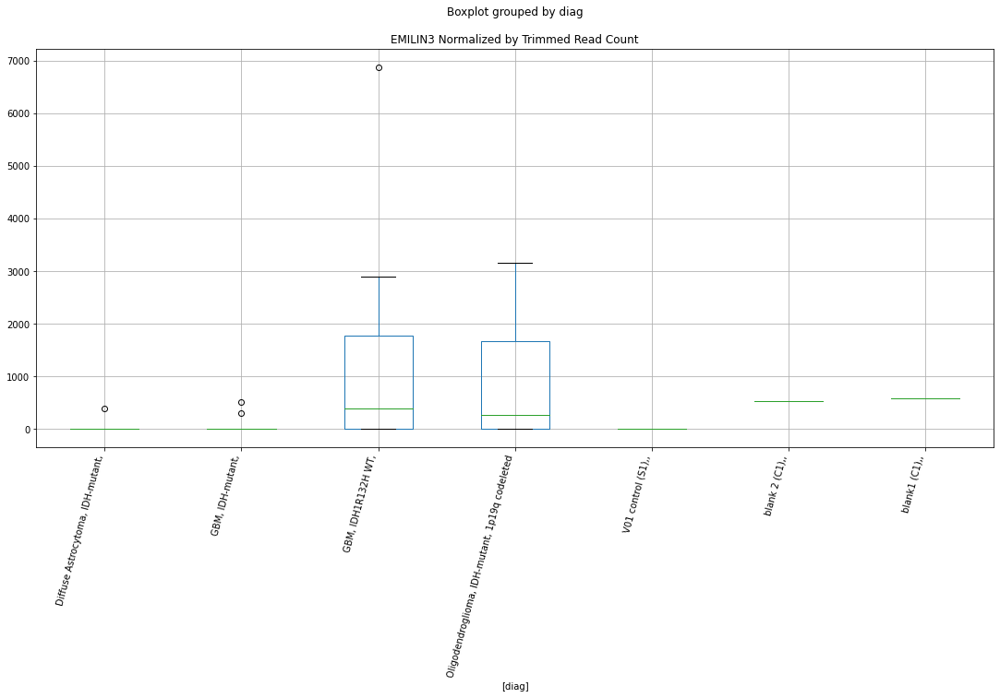

 p : 0.043955090595581614  ( t : 2.1663095217623765 ) :  D-plex  :  cutadapt2  :  KLF7
Control and blanks
76     0.0
340    0.0
Name: KLF7, dtype: float64
208    6172.61
Name: KLF7, dtype: float64
472    10981.16
Name: KLF7, dtype: float64


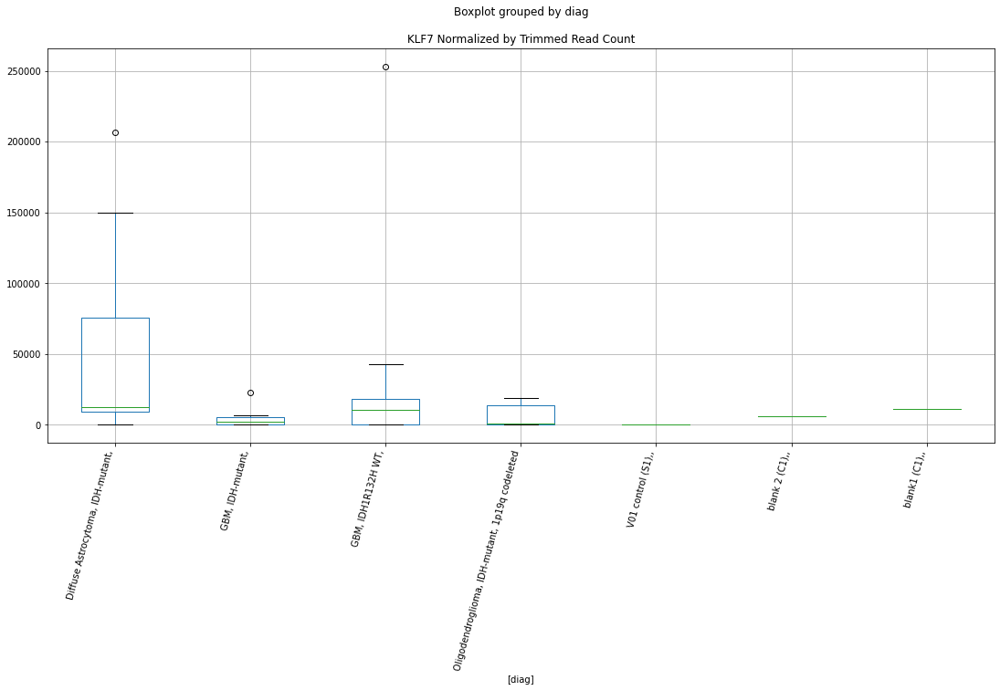

 p : 0.043986742838778604  ( t : 2.1659462632722417 ) :  Lexogen  :  cutadapt2  :  GPI
Control and blanks
82         0.00
346    16203.46
Name: GPI, dtype: float64
214    4339.62
Name: GPI, dtype: float64
478    474.92
Name: GPI, dtype: float64


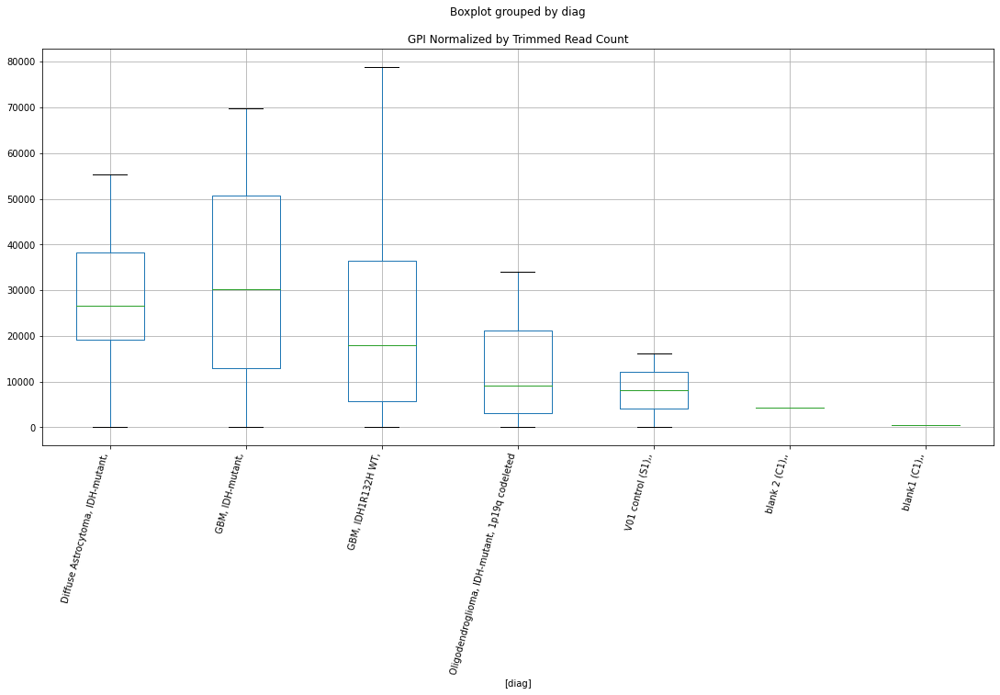

 p : 0.043989842796612534  ( t : 2.165910699321037 ) :  D-plex  :  bbduk2  :  IRF2BPL
Control and blanks
73     54883.60
337     1780.31
Name: IRF2BPL, dtype: float64
205    3940.0
Name: IRF2BPL, dtype: float64
469    4732.22
Name: IRF2BPL, dtype: float64


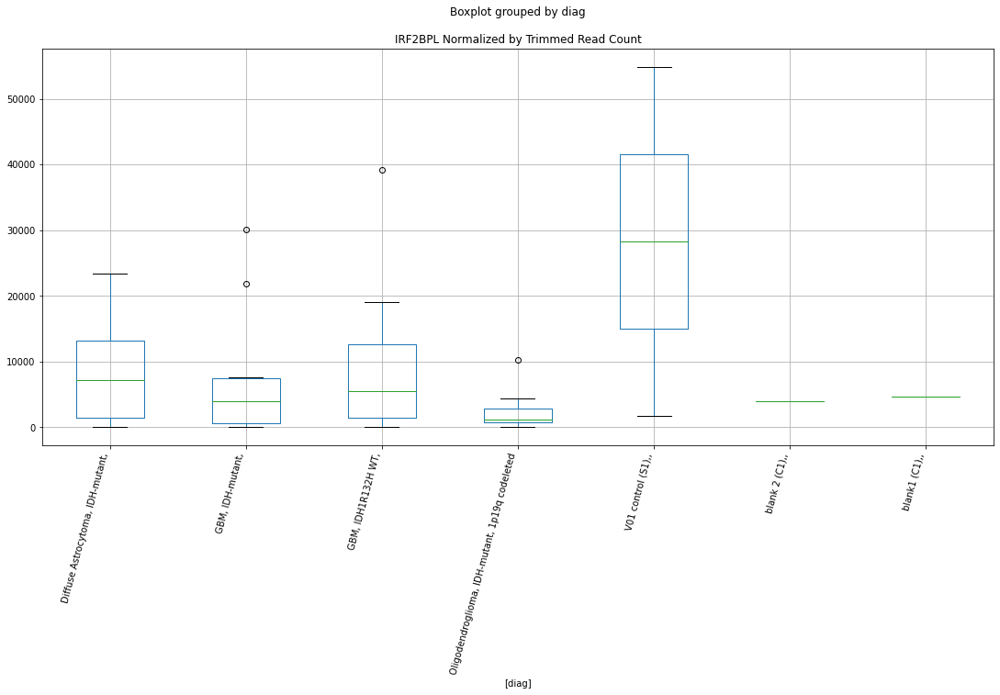

 p : 0.044034491554272734  ( t : 2.1653987252533446 ) :  Lexogen  :  cutadapt2  :  EPS8L2
Control and blanks
82     0.0
346    0.0
Name: EPS8L2, dtype: float64
214    0.0
Name: EPS8L2, dtype: float64
478    0.0
Name: EPS8L2, dtype: float64


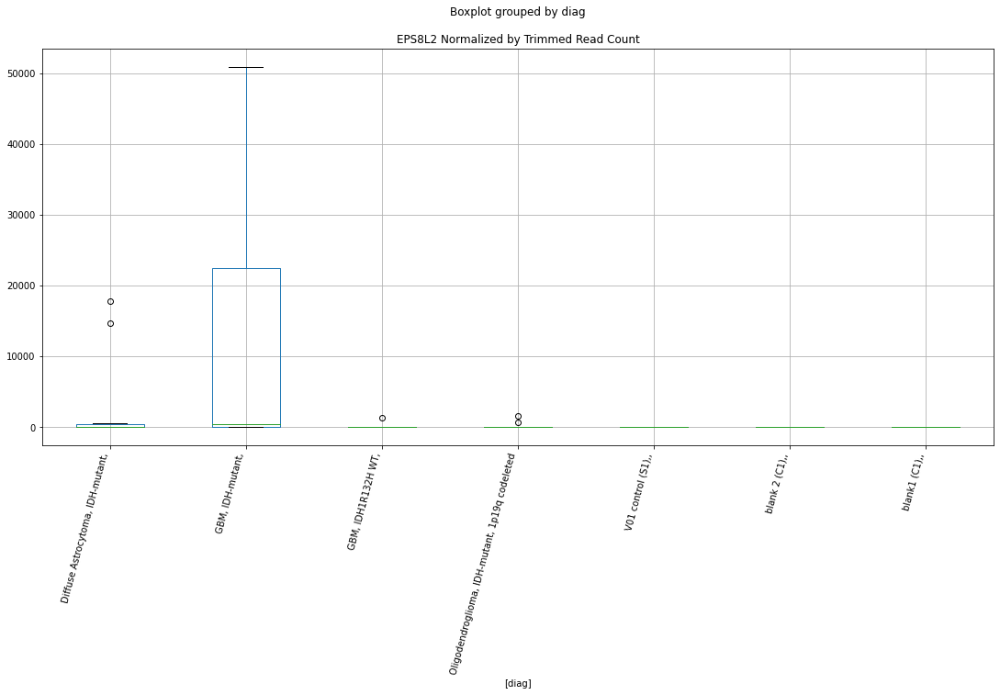

 p : 0.04407623615572698  ( t : 2.164920481840821 ) :  Lexogen  :  bbduk2  :  EIF4E
Control and blanks
79     0.0
343    0.0
Name: EIF4E, dtype: float64
211    819.92
Name: EIF4E, dtype: float64
475    0.0
Name: EIF4E, dtype: float64


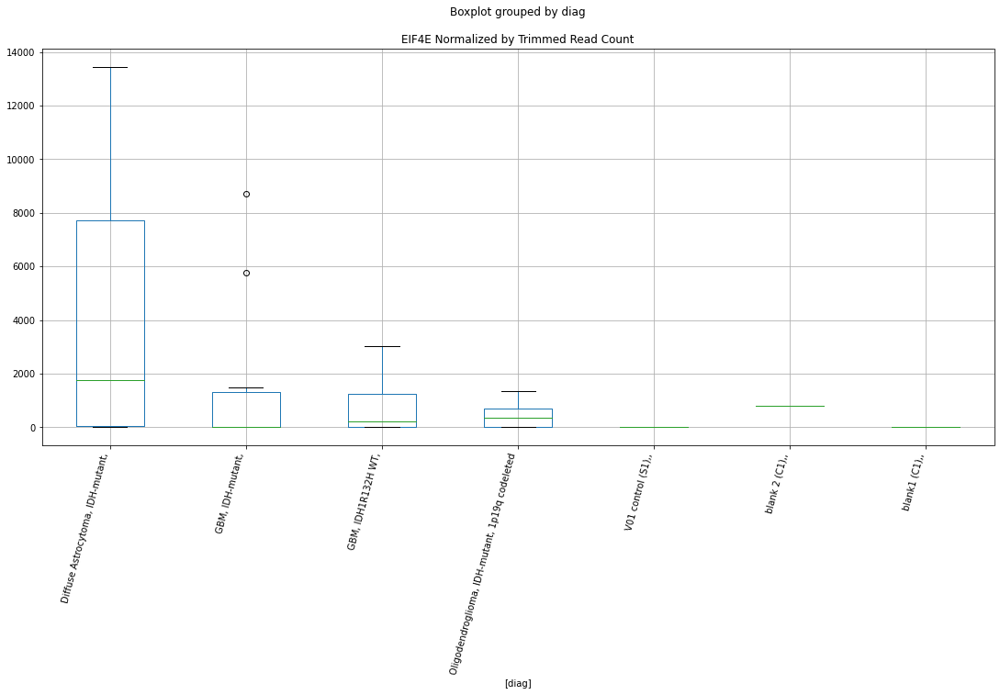

 p : 0.04408119740742601  ( t : 2.1648636712523244 ) :  D-plex  :  cutadapt2  :  HYAL2
Control and blanks
76     0.0
340    0.0
Name: HYAL2, dtype: float64
208    0.0
Name: HYAL2, dtype: float64
472    5779.56
Name: HYAL2, dtype: float64


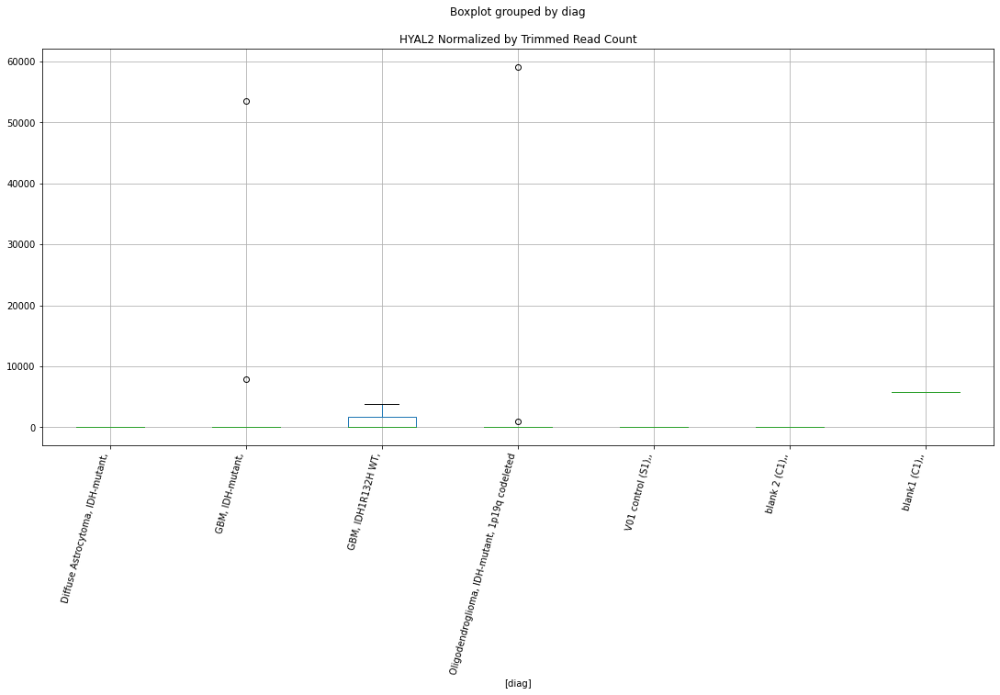

 p : 0.04417446944799574  ( t : 2.163796713930345 ) :  Lexogen  :  bbduk2  :  LARP4
Control and blanks
79     0.0
343    0.0
Name: LARP4, dtype: float64
211    0.0
Name: LARP4, dtype: float64
475    0.0
Name: LARP4, dtype: float64


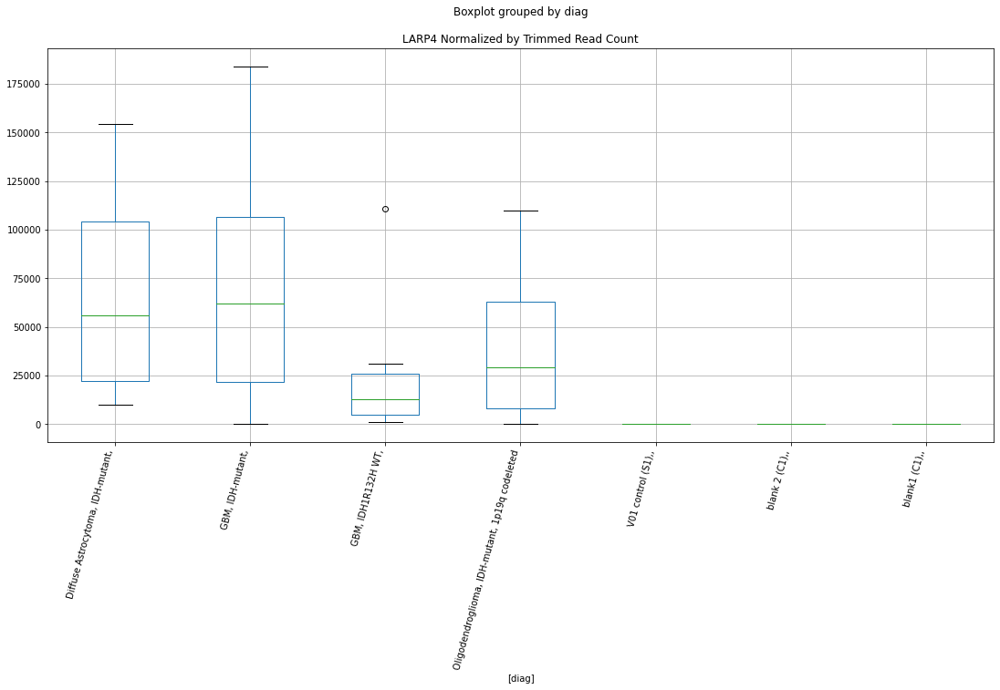

 p : 0.04428911686600776  ( t : 2.1624880599793 ) :  D-plex  :  bbduk2  :  FAM3C
Control and blanks
73     0.0
337    0.0
Name: FAM3C, dtype: float64
205    716.36
Name: FAM3C, dtype: float64
469    1774.58
Name: FAM3C, dtype: float64


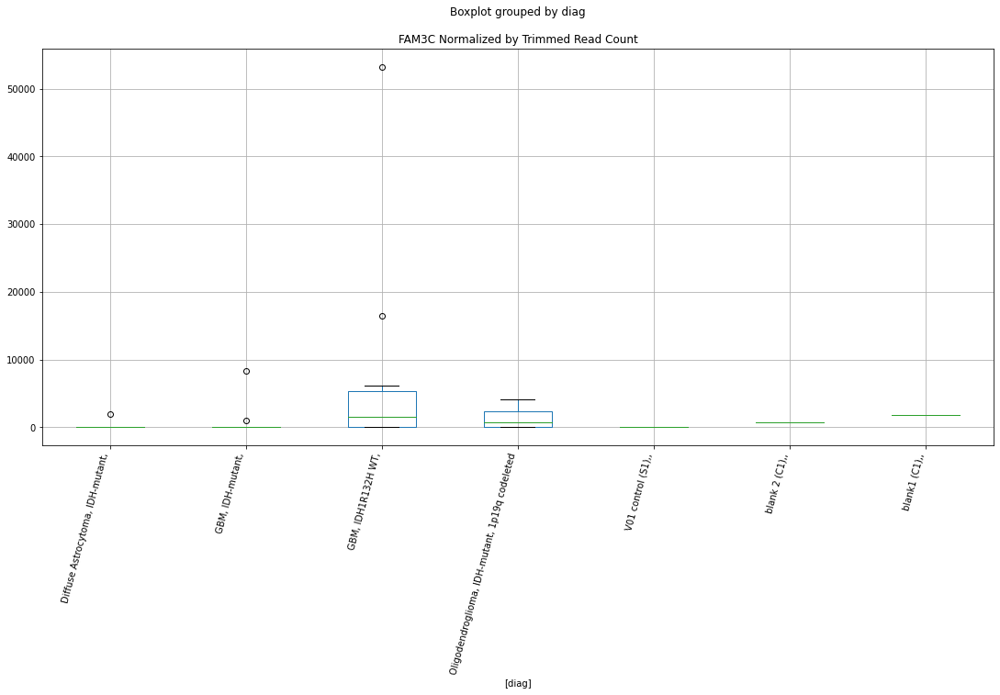

 p : 0.044305262407077  ( t : 2.1623040141904477 ) :  D-plex  :  cutadapt2  :  GVINP1
Control and blanks
76     757.61
340      0.00
Name: GVINP1, dtype: float64
208    352.72
Name: GVINP1, dtype: float64
472    2311.82
Name: GVINP1, dtype: float64


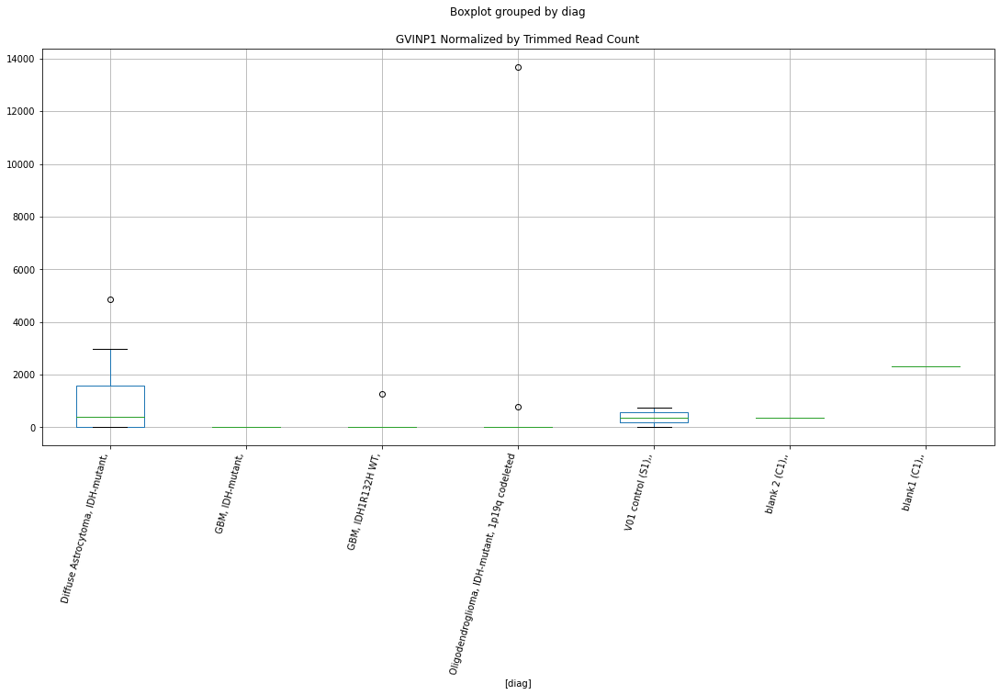

 p : 0.04432591902974766  ( t : 2.1620686352610816 ) :  D-plex  :  cutadapt2  :  GINS3
Control and blanks
76     0.0
340    0.0
Name: GINS3, dtype: float64
208    1058.16
Name: GINS3, dtype: float64
472    2311.82
Name: GINS3, dtype: float64


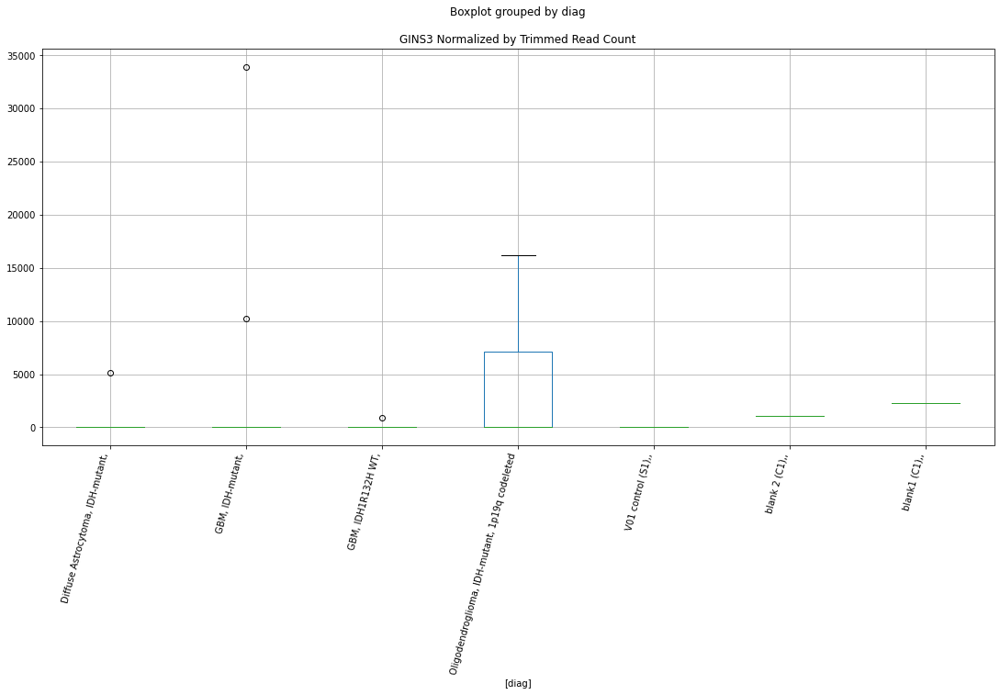

 p : 0.04437973827242787  ( t : 2.16145584455782 ) :  Lexogen  :  bbduk2  :  GTF3C5
Control and blanks
79     0.0
343    0.0
Name: GTF3C5, dtype: float64
211    0.0
Name: GTF3C5, dtype: float64
475    0.0
Name: GTF3C5, dtype: float64


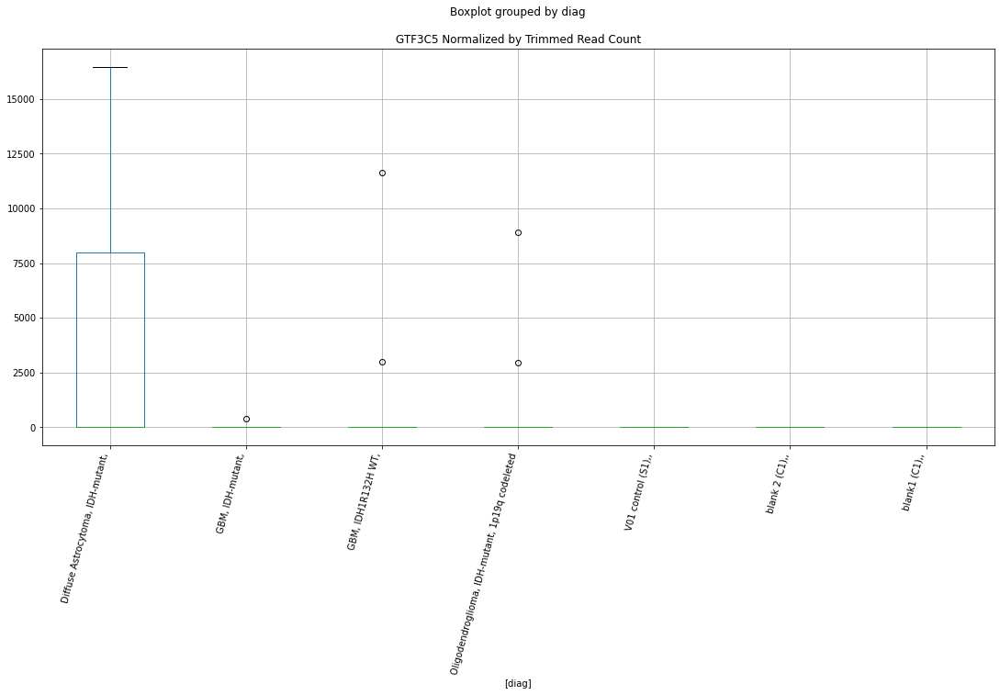

 p : 0.0444063069863785  ( t : 2.1611535814109626 ) :  D-plex  :  bbduk2  :  EEF1E1-BLOC1S5
Control and blanks
73     43288.47
337        0.00
Name: EEF1E1-BLOC1S5, dtype: float64
205    895.45
Name: EEF1E1-BLOC1S5, dtype: float64
469    1183.05
Name: EEF1E1-BLOC1S5, dtype: float64


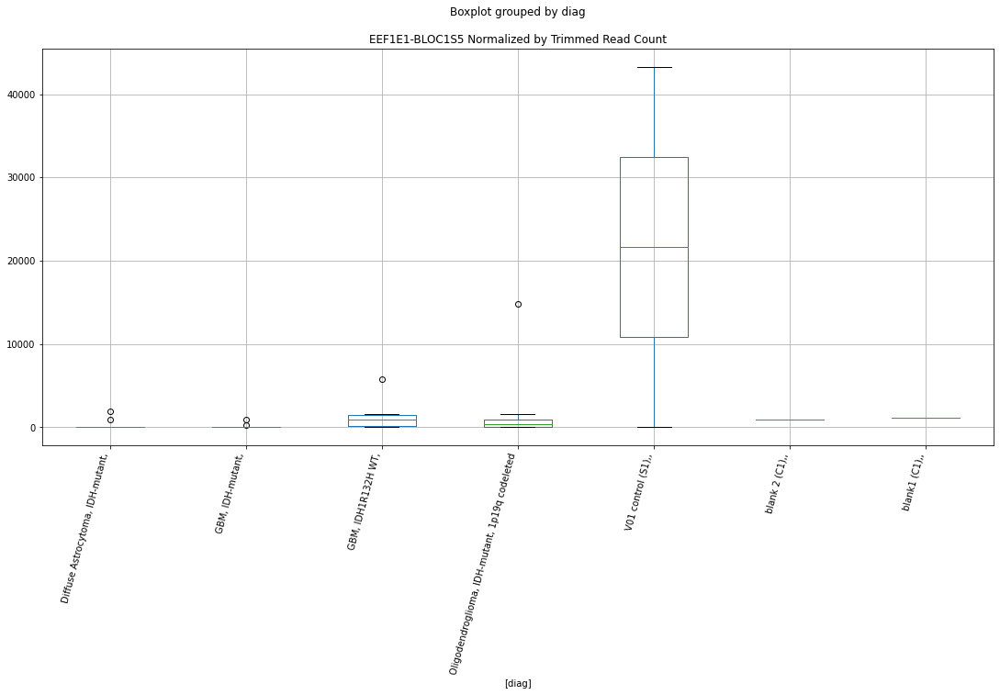

 p : 0.044489073873895585  ( t : 2.160213030161521 ) :  D-plex  :  cutadapt2  :  FAM3C
Control and blanks
76     0.0
340    0.0
Name: FAM3C, dtype: float64
208    0.0
Name: FAM3C, dtype: float64
472    1733.87
Name: FAM3C, dtype: float64


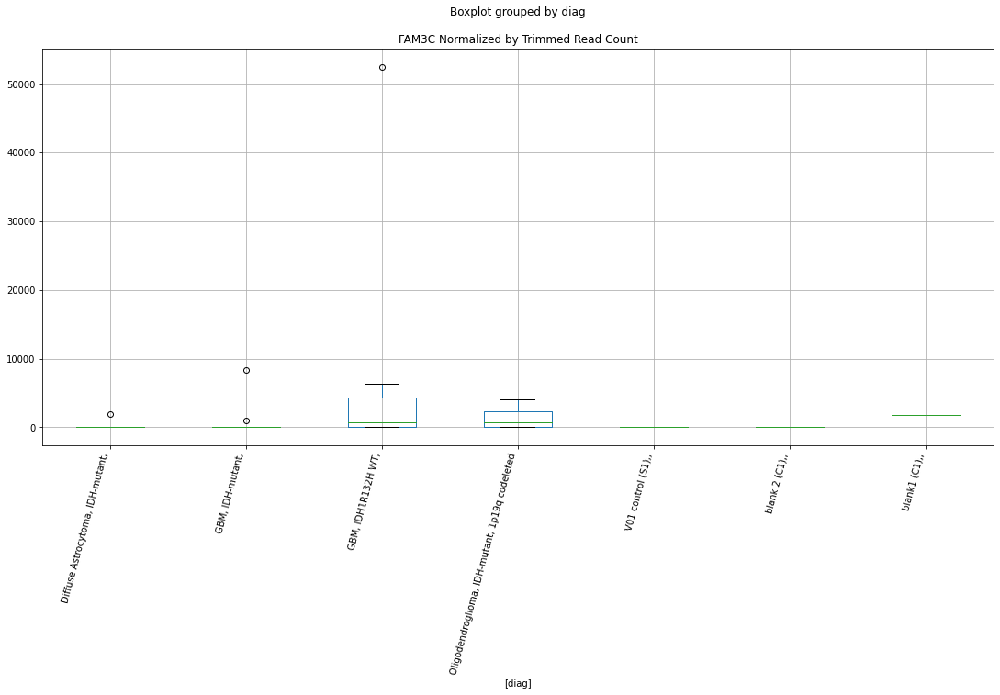

 p : 0.044493961394514864  ( t : 2.1601575391278125 ) :  Lexogen  :  bbduk2  :  GRIN2D
Control and blanks
79         0.00
343    25902.35
Name: GRIN2D, dtype: float64
211    0.0
Name: GRIN2D, dtype: float64
475    0.0
Name: GRIN2D, dtype: float64


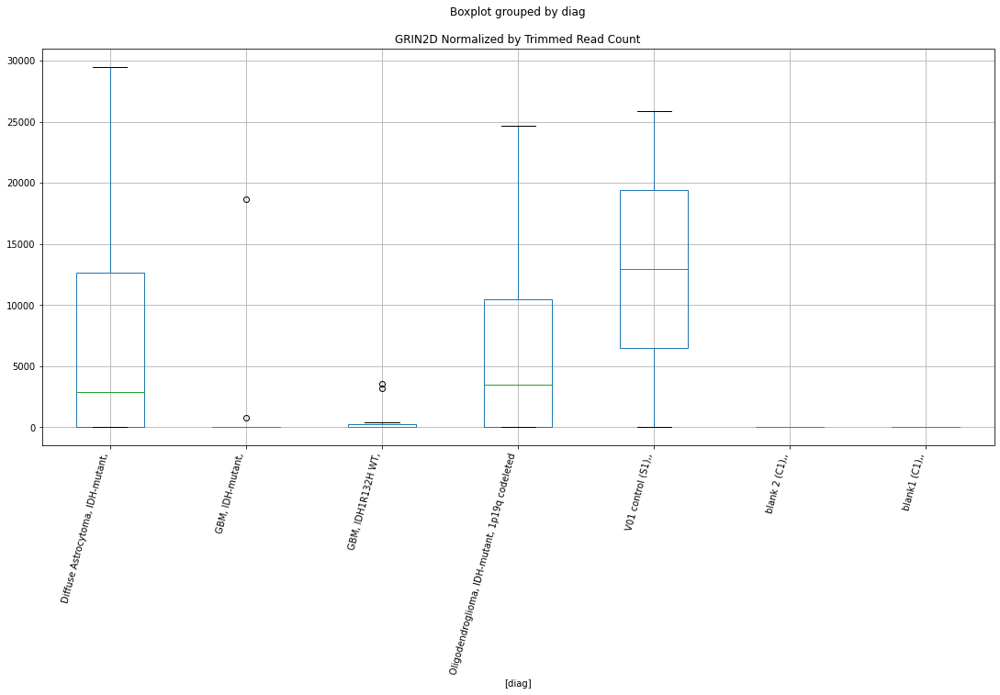

 p : 0.044521217327545715  ( t : 2.159848187925715 ) :  D-plex  :  bbduk2  :  FKBP11
Control and blanks
73     0.0
337    0.0
Name: FKBP11, dtype: float64
205    1074.55
Name: FKBP11, dtype: float64
469    1183.05
Name: FKBP11, dtype: float64


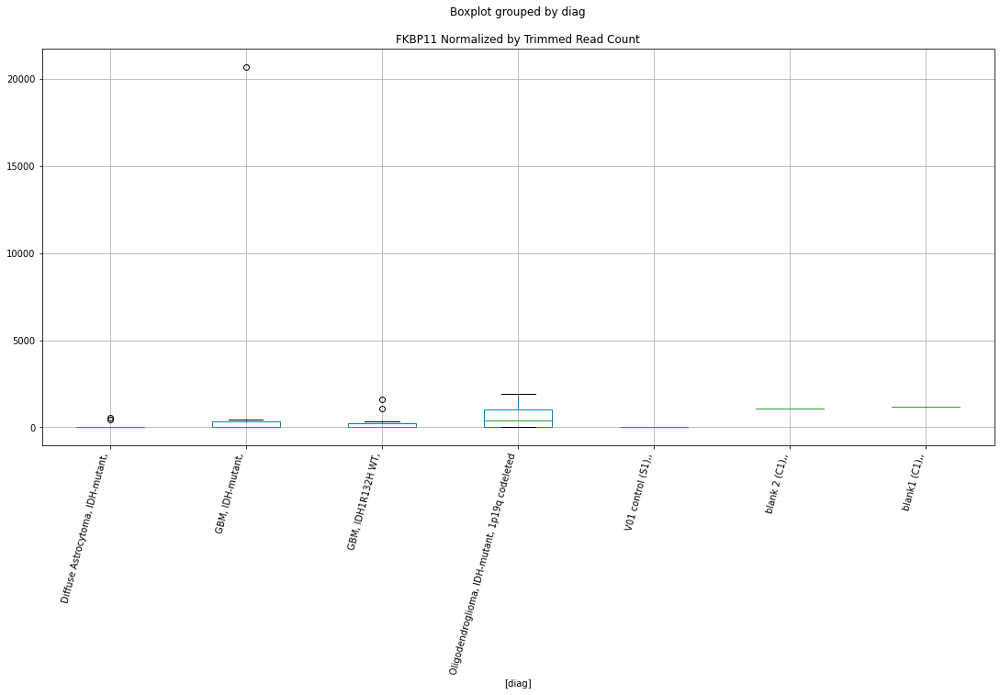

 p : 0.04454688825465184  ( t : 2.1595569846939973 ) :  Lexogen  :  cutadapt2  :  FAM205A
Control and blanks
82     0.0
346    0.0
Name: FAM205A, dtype: float64
214    0.0
Name: FAM205A, dtype: float64
478    0.0
Name: FAM205A, dtype: float64


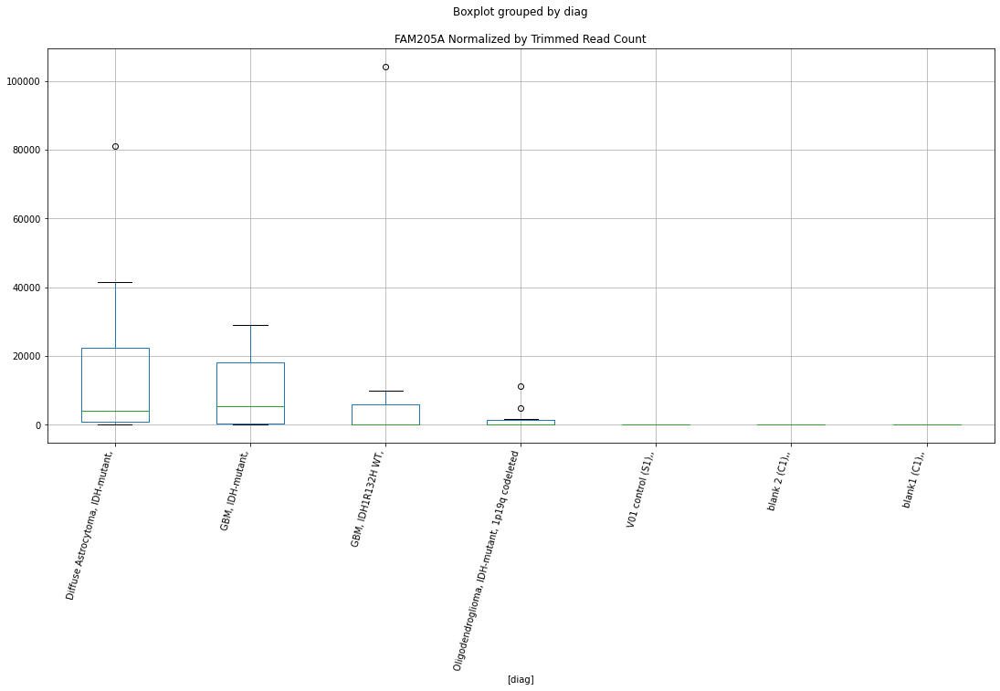

 p : 0.04466362927605312  ( t : 2.1582346428378636 ) :  D-plex  :  cutadapt2  :  FAM120A
Control and blanks
76     0.0
340    0.0
Name: FAM120A, dtype: float64
208    133328.32
Name: FAM120A, dtype: float64
472    16182.76
Name: FAM120A, dtype: float64


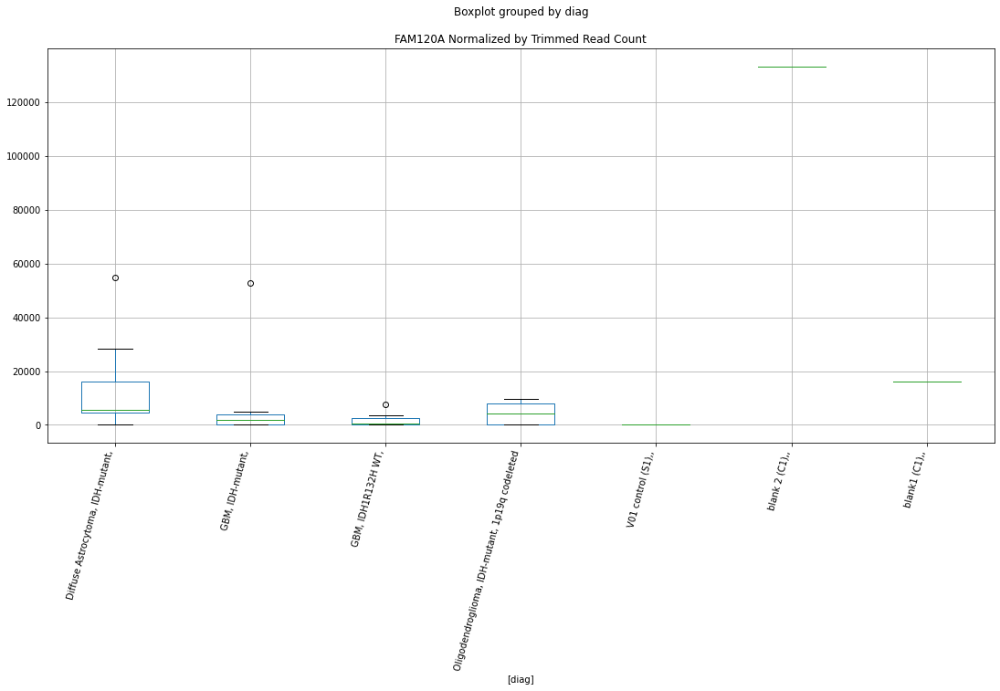

 p : 0.04467470952615614  ( t : 2.158109299594168 ) :  D-plex  :  bbduk2  :  FGFBP3
Control and blanks
73     0.0
337    0.0
Name: FGFBP3, dtype: float64
205    1253.64
Name: FGFBP3, dtype: float64
469    2366.11
Name: FGFBP3, dtype: float64


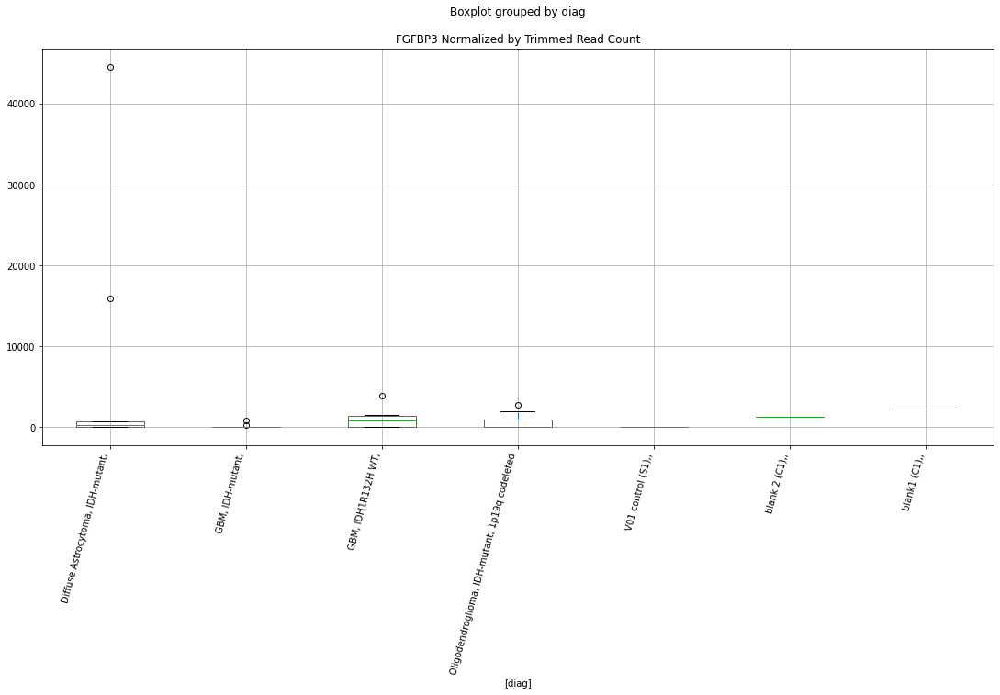

 p : 0.044735270817449095  ( t : 2.1574247133066864 ) :  D-plex  :  bbduk2  :  GSN
Control and blanks
73     0.0
337    0.0
Name: GSN, dtype: float64
205    9133.64
Name: GSN, dtype: float64
469    0.0
Name: GSN, dtype: float64


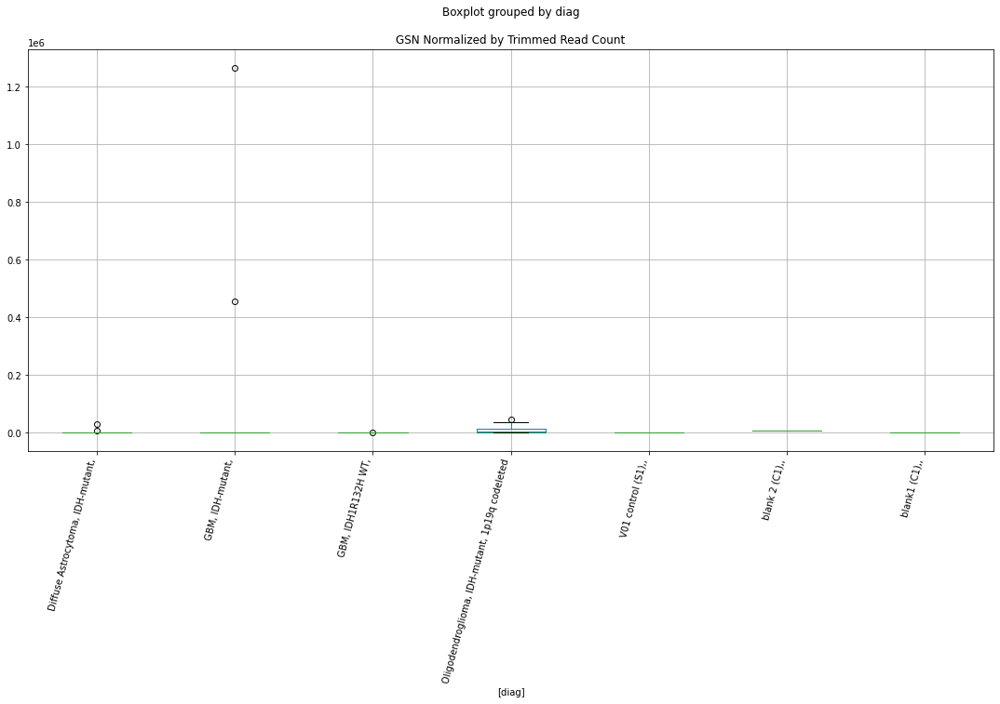

 p : 0.04477459868011568  ( t : 2.1569806039245223 ) :  D-plex  :  cutadapt2  :  EMILIN3
Control and blanks
76     0.0
340    0.0
Name: EMILIN3, dtype: float64
208    529.08
Name: EMILIN3, dtype: float64
472    0.0
Name: EMILIN3, dtype: float64


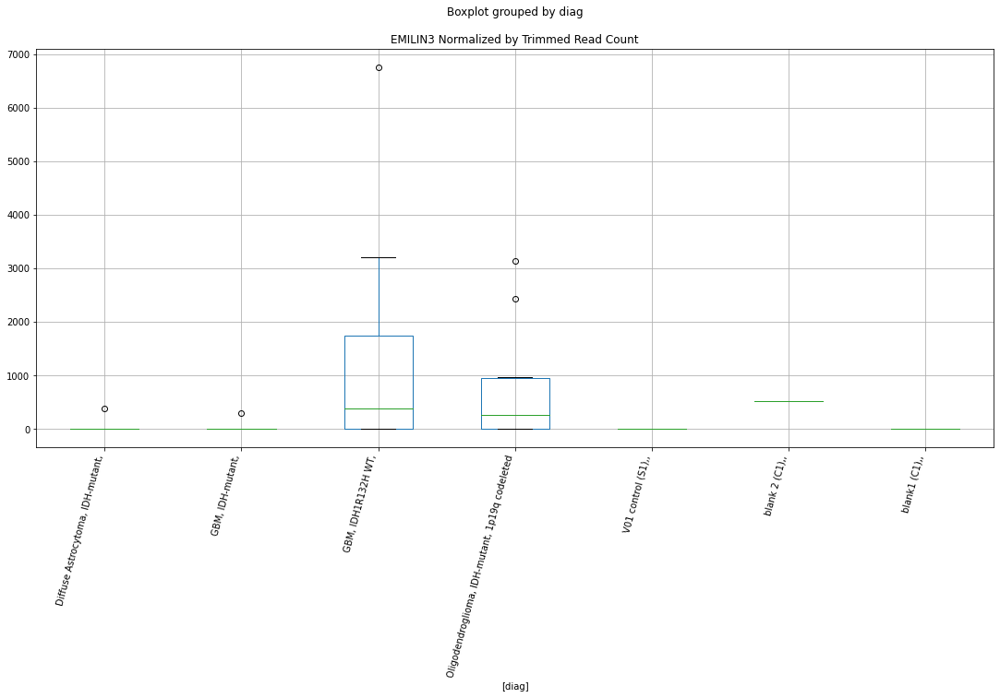

 p : 0.044865631465680046  ( t : 2.1559539841476894 ) :  D-plex  :  cutadapt2  :  EVI5
Control and blanks
76     0.0
340    0.0
Name: EVI5, dtype: float64
208    35272.04
Name: EVI5, dtype: float64
472    5779.56
Name: EVI5, dtype: float64


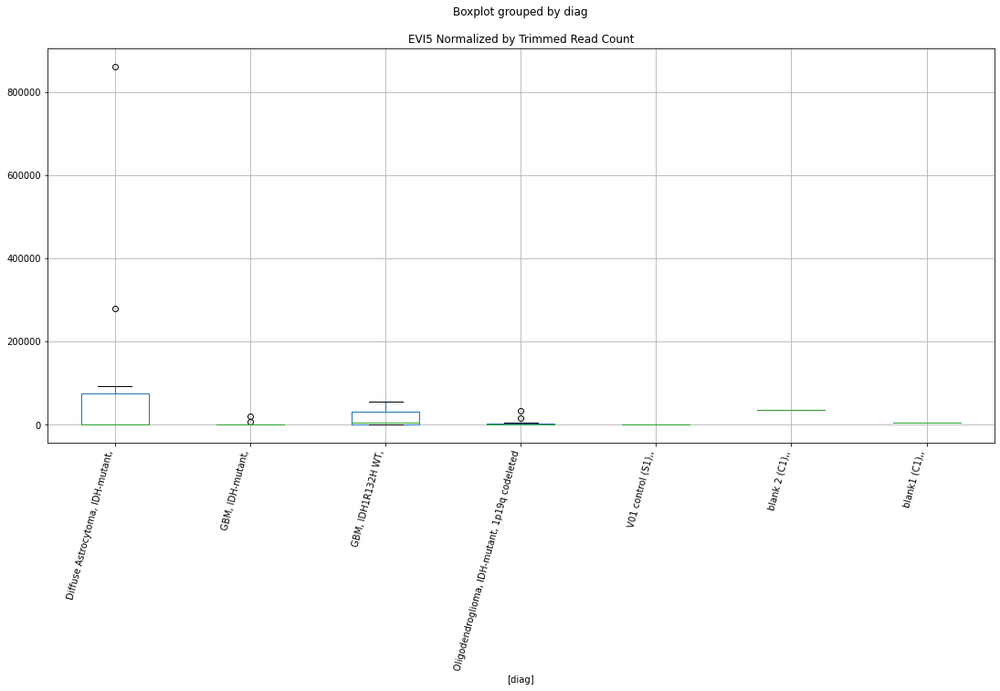

 p : 0.0448989182082189  ( t : 2.155579069281649 ) :  D-plex  :  cutadapt2  :  KCNG1
Control and blanks
76     0.0
340    0.0
Name: KCNG1, dtype: float64
208    4761.73
Name: KCNG1, dtype: float64
472    10403.21
Name: KCNG1, dtype: float64


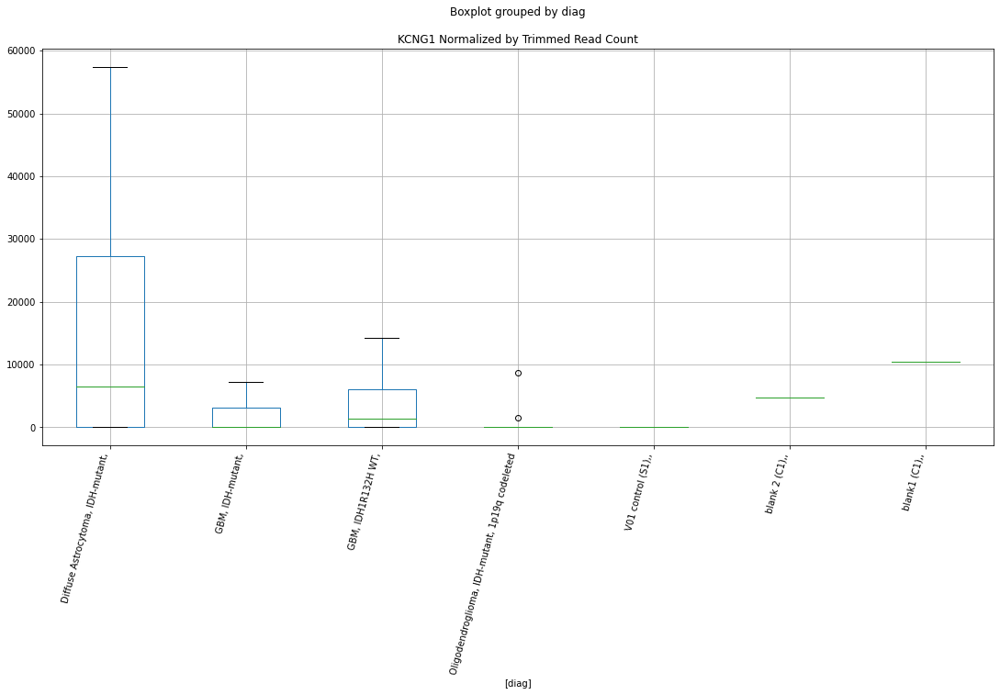

 p : 0.044899518126306305  ( t : 2.155572314622499 ) :  Lexogen  :  cutadapt2  :  IDH3G
Control and blanks
82     0.0
346    0.0
Name: IDH3G, dtype: float64
214    0.0
Name: IDH3G, dtype: float64
478    0.0
Name: IDH3G, dtype: float64


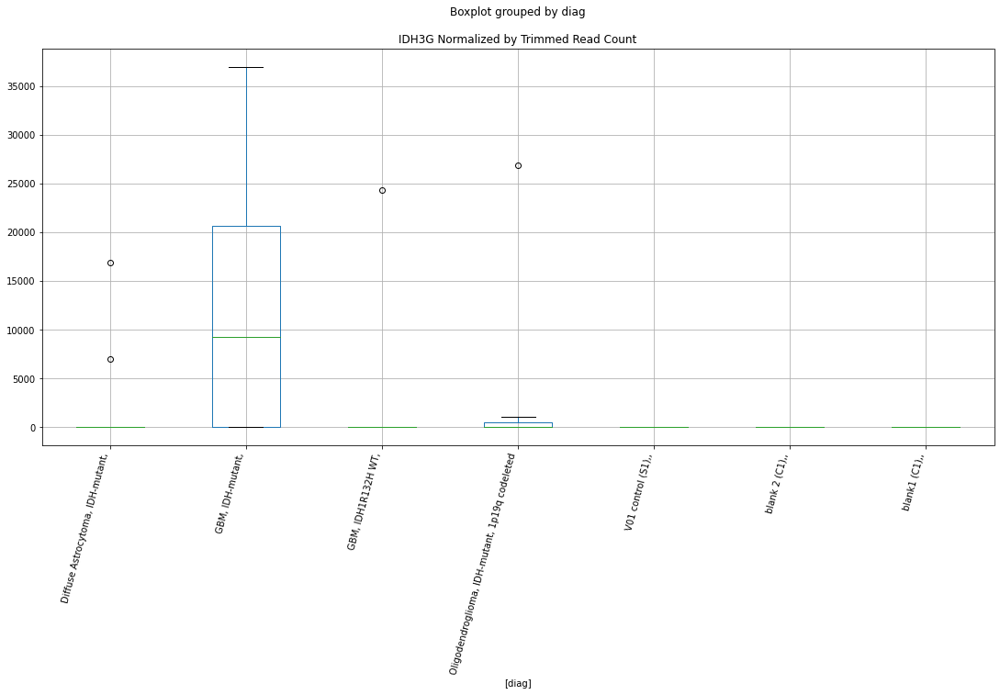

 p : 0.04491347116390175  ( t : 2.1554152364253034 ) :  D-plex  :  bbduk2  :  GINS3
Control and blanks
73     0.0
337    0.0
Name: GINS3, dtype: float64
205    1074.55
Name: GINS3, dtype: float64
469    2366.11
Name: GINS3, dtype: float64


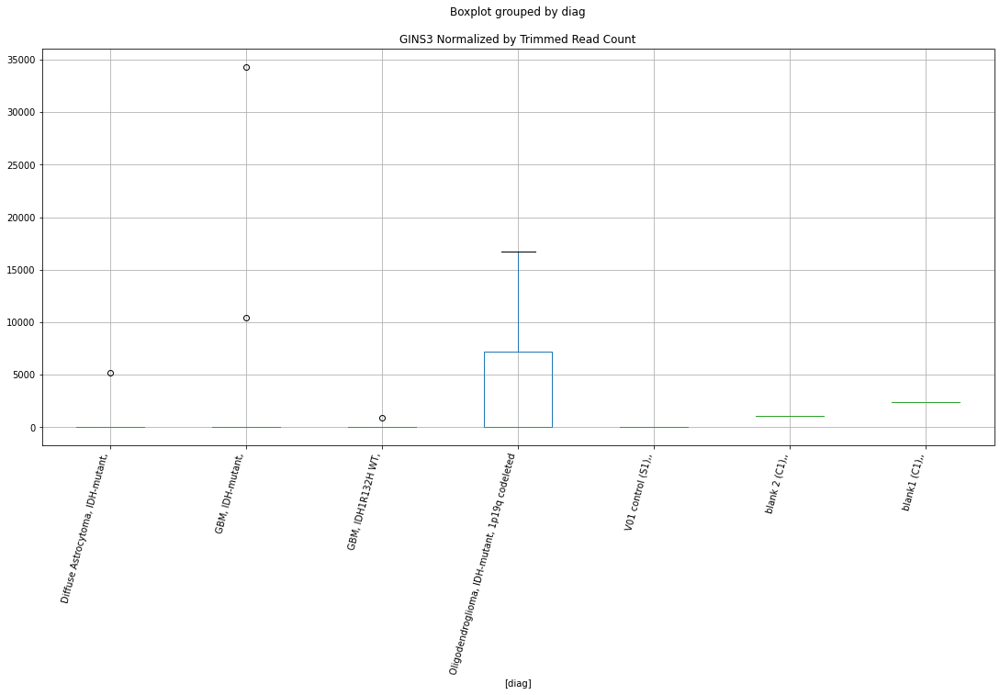

 p : 0.045003129719994796  ( t : 2.154406956233365 ) :  Lexogen  :  bbduk2  :  KIAA0895
Control and blanks
79     0.0
343    0.0
Name: KIAA0895, dtype: float64
211    0.0
Name: KIAA0895, dtype: float64
475    0.0
Name: KIAA0895, dtype: float64


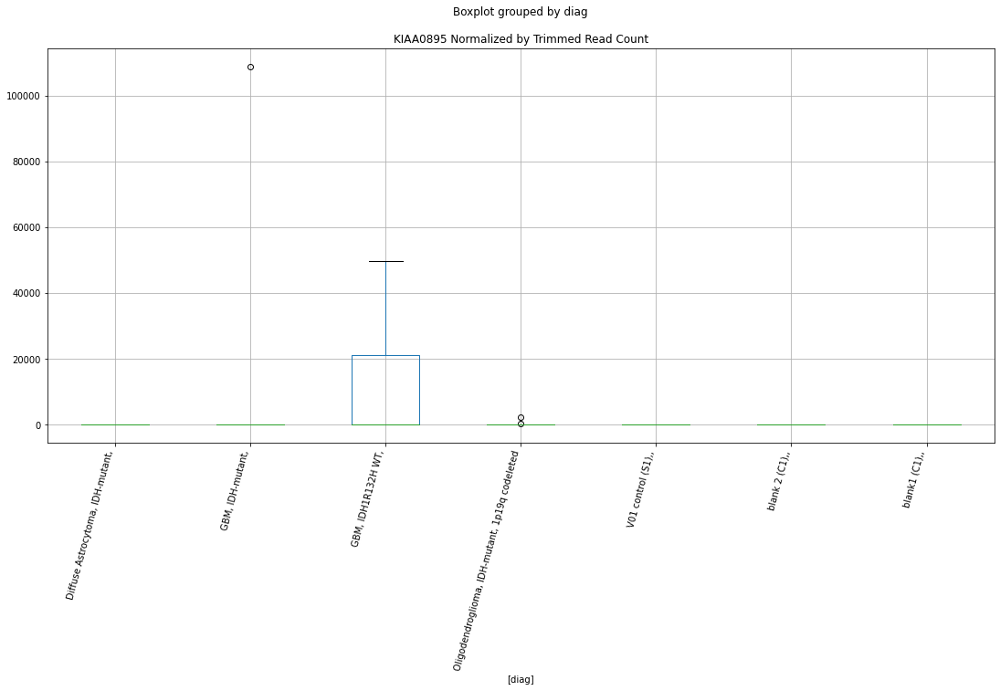

 p : 0.04502963482133054  ( t : 2.1541092374243074 ) :  D-plex  :  bbduk2  :  FBXL17
Control and blanks
73        0.00
337    2670.47
Name: FBXL17, dtype: float64
205    13431.82
Name: FBXL17, dtype: float64
469    10647.49
Name: FBXL17, dtype: float64


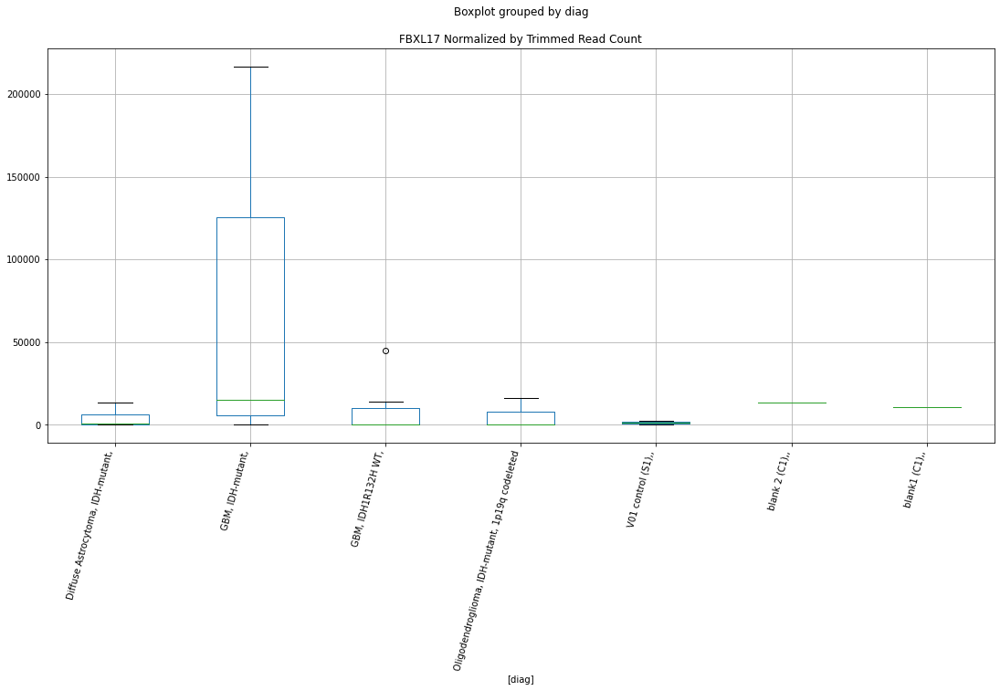

 p : 0.04503916268589553  ( t : 2.154002254733931 ) :  D-plex  :  bbduk2  :  ENAH
Control and blanks
73     8503.09
337       0.00
Name: ENAH, dtype: float64
205    32952.74
Name: ENAH, dtype: float64
469    27801.78
Name: ENAH, dtype: float64


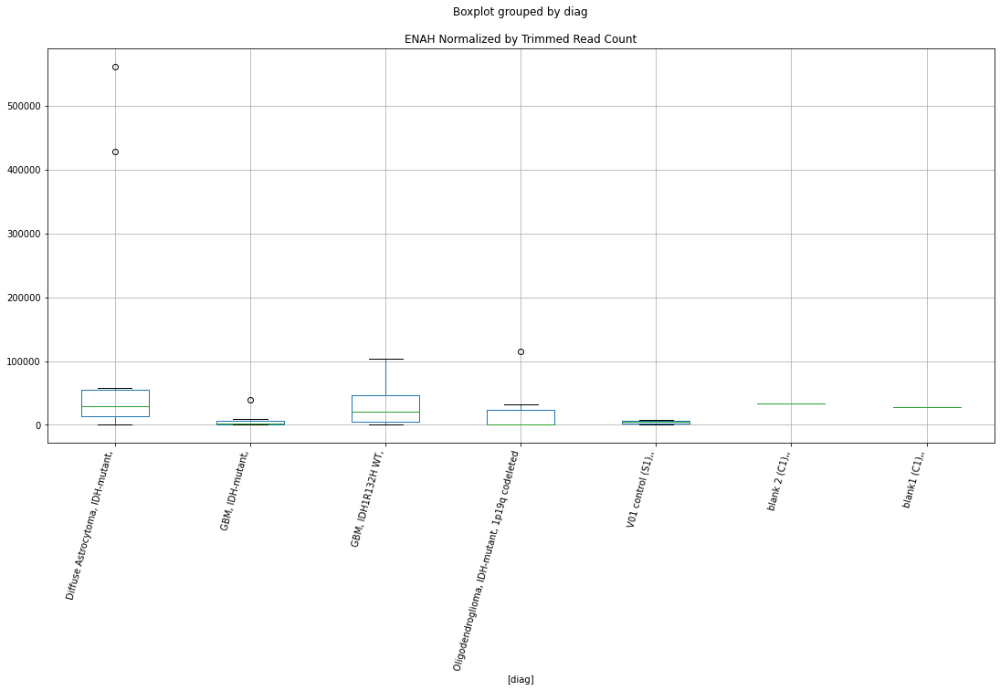

 p : 0.045111019540521866  ( t : 2.153196082791152 ) :  D-plex  :  cutadapt2  :  FRRS1
Control and blanks
76     83337.56
340        0.00
Name: FRRS1, dtype: float64
208    352.72
Name: FRRS1, dtype: float64
472    0.0
Name: FRRS1, dtype: float64


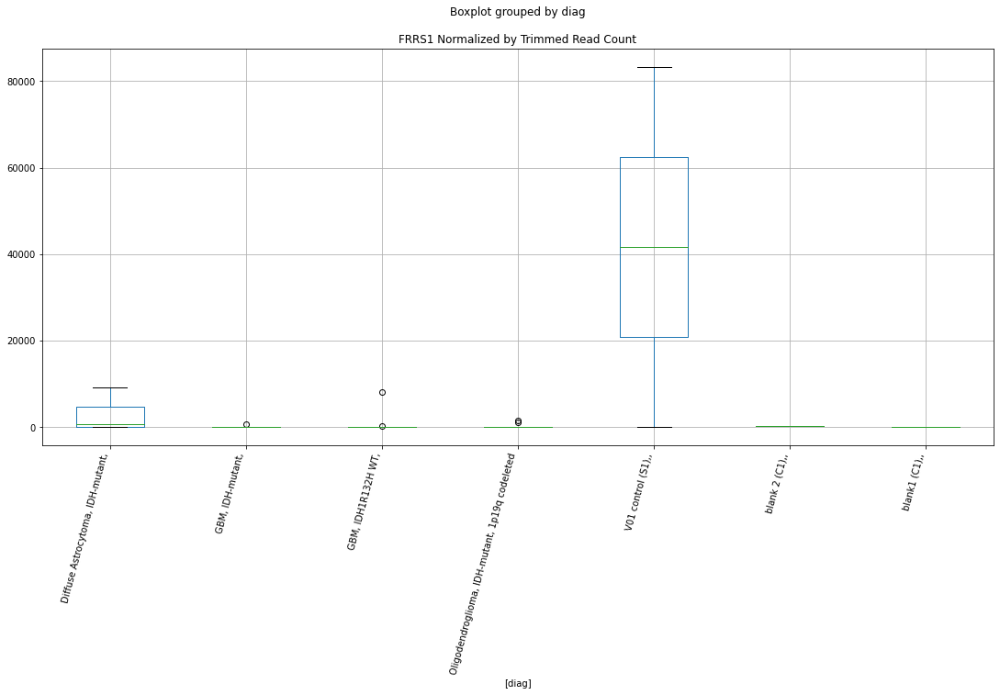

 p : 0.04511753951950018  ( t : 2.1531229923441075 ) :  Lexogen  :  cutadapt2  :  KMT5B
Control and blanks
82     0.0
346    0.0
Name: KMT5B, dtype: float64
214    0.0
Name: KMT5B, dtype: float64
478    237.46
Name: KMT5B, dtype: float64


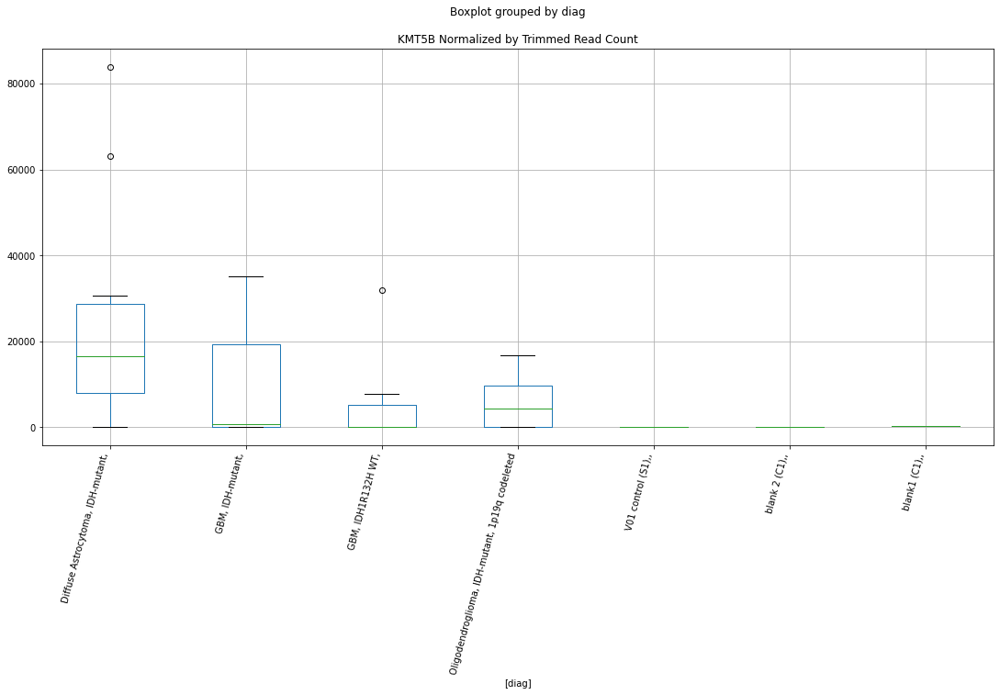

 p : 0.045119510138243175  ( t : 2.1531009031597823 ) :  D-plex  :  bbduk2  :  FAH
Control and blanks
73     0.0
337    0.0
Name: FAH, dtype: float64
205    1611.82
Name: FAH, dtype: float64
469    141966.56
Name: FAH, dtype: float64


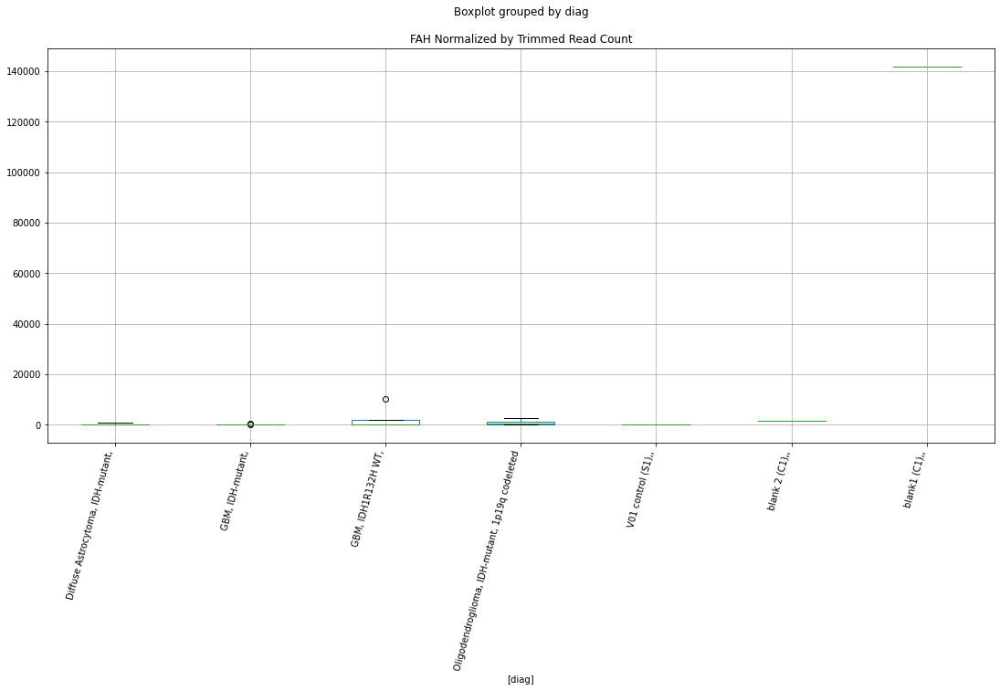

 p : 0.04516661519031247  ( t : 2.1525731525163008 ) :  D-plex  :  bbduk2  :  FAAP24
Control and blanks
73     0.0
337    0.0
Name: FAAP24, dtype: float64
205    0.0
Name: FAAP24, dtype: float64
469    0.0
Name: FAAP24, dtype: float64


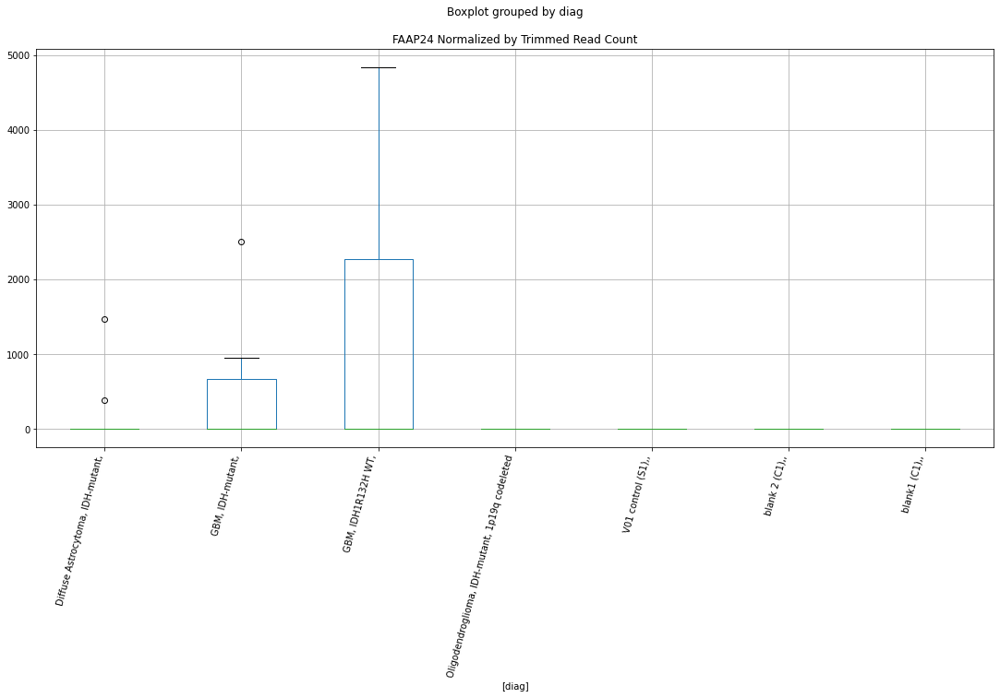

 p : 0.04516912708341854  ( t : 2.152545024161918 ) :  Lexogen  :  bbduk2  :  LAMA2
Control and blanks
79      10014.19
343    119108.33
Name: LAMA2, dtype: float64
211    3826.29
Name: LAMA2, dtype: float64
475    43831.38
Name: LAMA2, dtype: float64


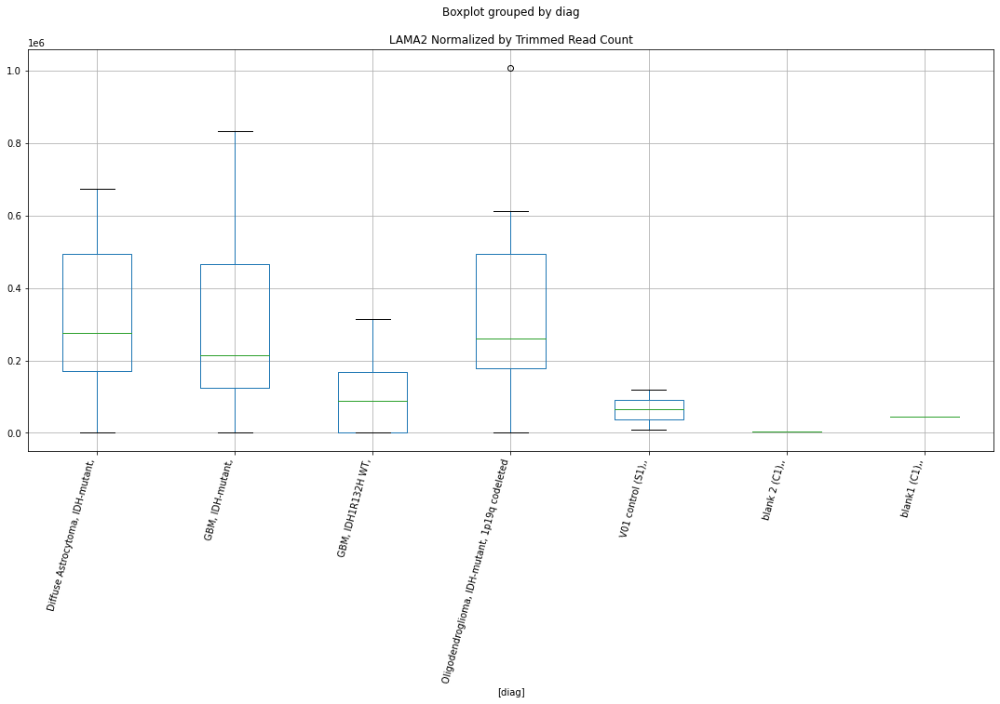

 p : 0.045183784385138794  ( t : 2.152380919178597 ) :  D-plex  :  bbduk2  :  HYAL3
Control and blanks
73     0.0
337    0.0
Name: HYAL3, dtype: float64
205    1253.64
Name: HYAL3, dtype: float64
469    0.0
Name: HYAL3, dtype: float64


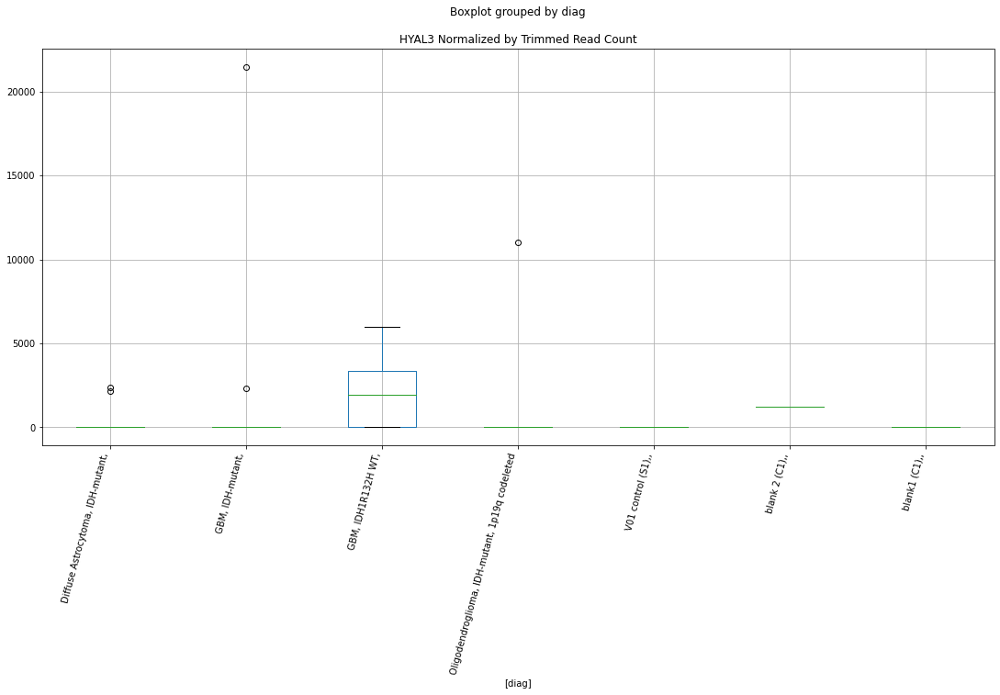

 p : 0.045222347868945  ( t : 2.1519493898745483 ) :  D-plex  :  bbduk2  :  GPR39
Control and blanks
73     0.0
337    0.0
Name: GPR39, dtype: float64
205    179.09
Name: GPR39, dtype: float64
469    0.0
Name: GPR39, dtype: float64


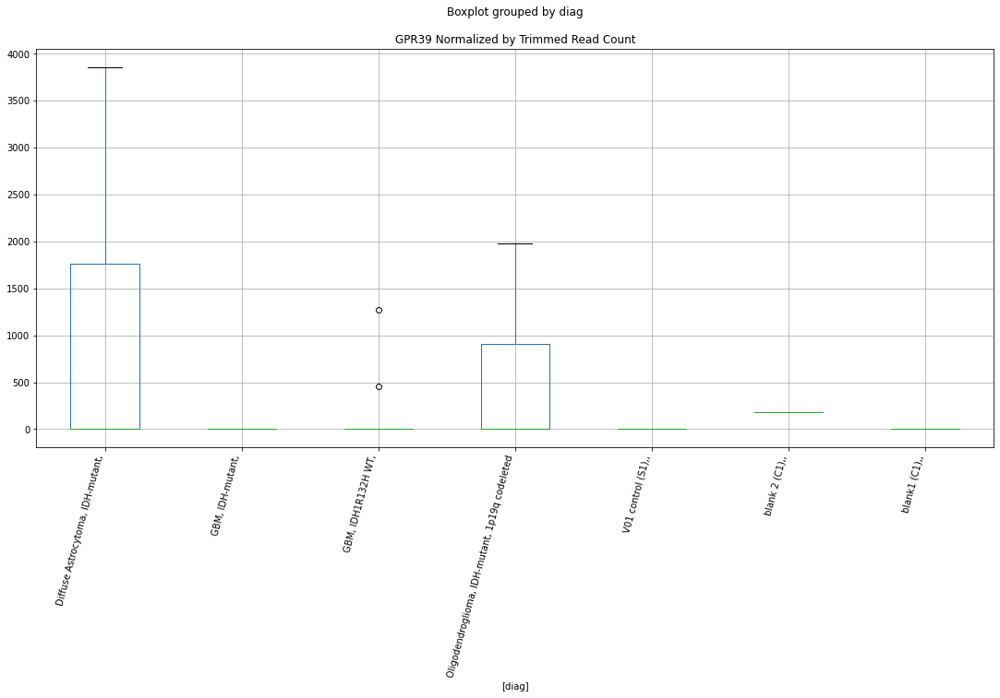

 p : 0.04523455583625245  ( t : 2.151812851562324 ) :  Lexogen  :  bbduk2  :  EPN1
Control and blanks
79     0.0
343    0.0
Name: EPN1, dtype: float64
211    0.0
Name: EPN1, dtype: float64
475    0.0
Name: EPN1, dtype: float64


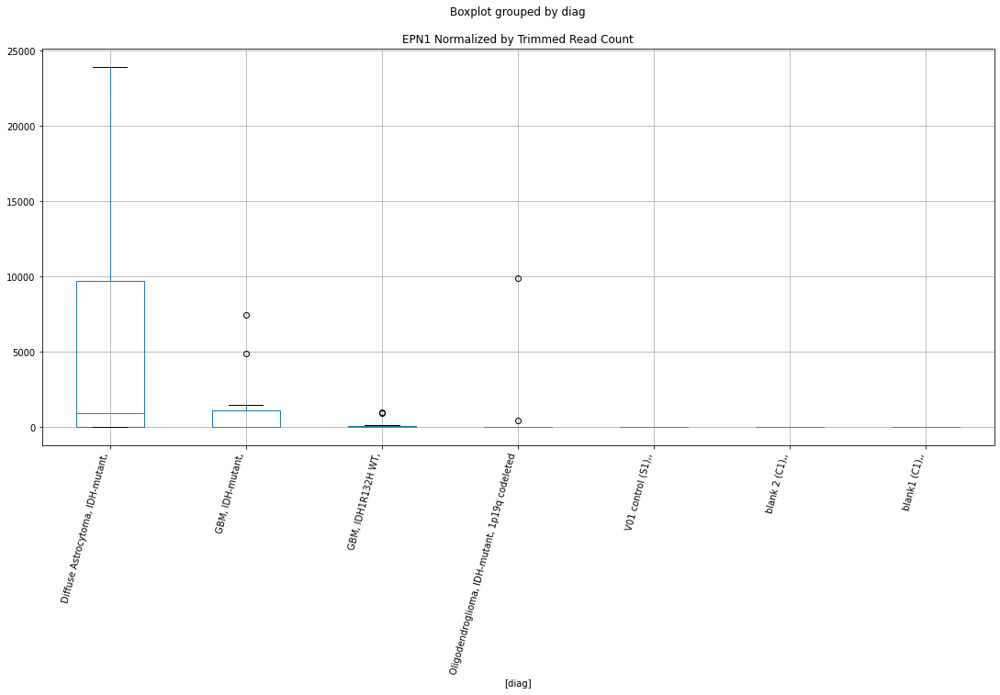

 p : 0.04524075261632362  ( t : 2.1517435574226598 ) :  Lexogen  :  cutadapt2  :  LAMA2
Control and blanks
82       9940.36
346    118053.77
Name: LAMA2, dtype: float64
214    3797.17
Name: LAMA2, dtype: float64
478    41555.58
Name: LAMA2, dtype: float64


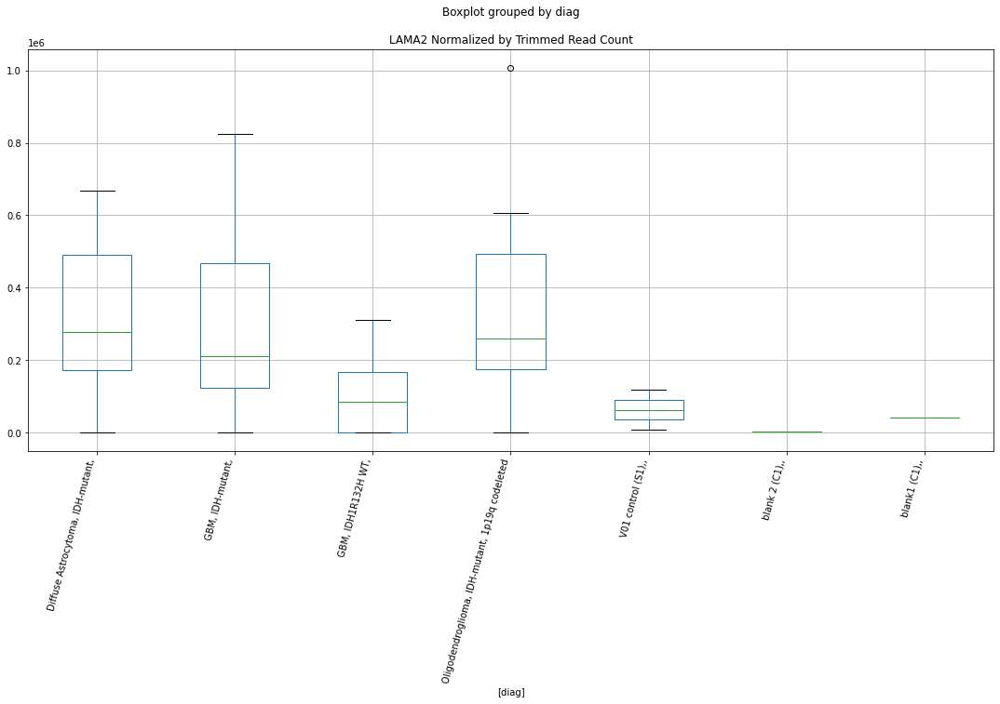

 p : 0.045307789811928685  ( t : 2.1509944825892835 ) :  D-plex  :  cutadapt2  :  FAH
Control and blanks
76     0.0
340    0.0
Name: FAH, dtype: float64
208    1587.24
Name: FAH, dtype: float64
472    139865.31
Name: FAH, dtype: float64


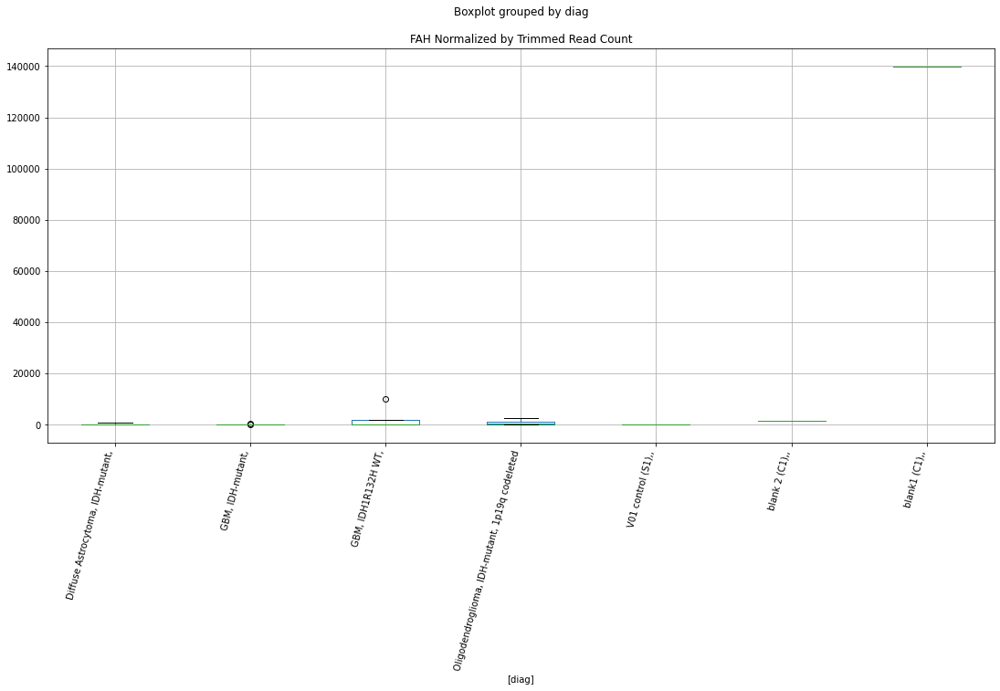

 p : 0.045332364331056745  ( t : 2.150720140142251 ) :  D-plex  :  cutadapt2  :  LAMC1
Control and blanks
76     0.0
340    0.0
Name: LAMC1, dtype: float64
208    1058.16
Name: LAMC1, dtype: float64
472    577.96
Name: LAMC1, dtype: float64


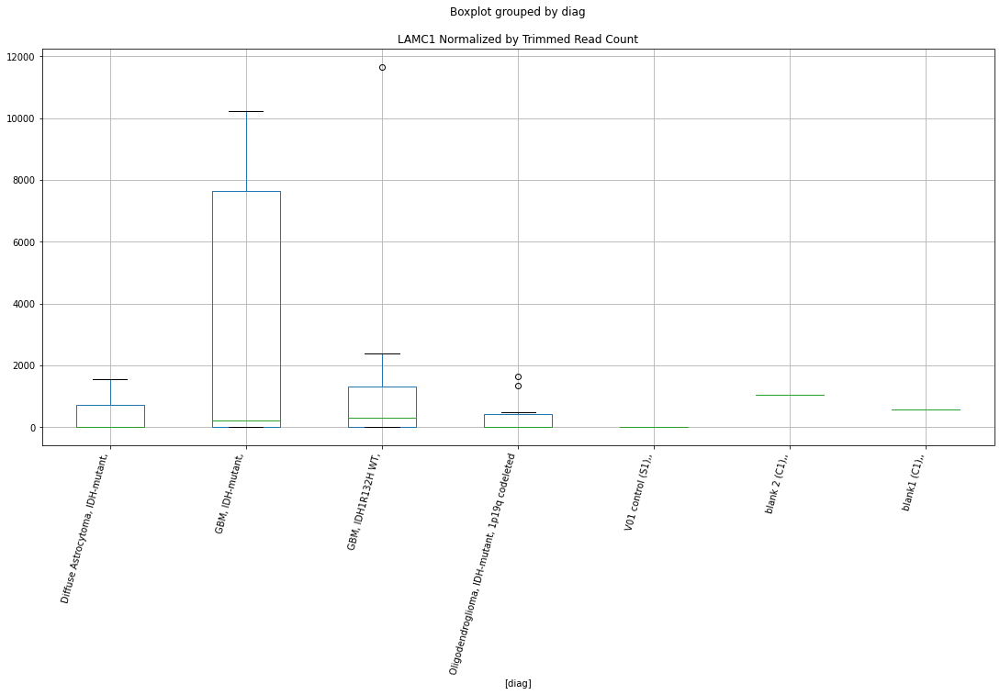

 p : 0.04536327784074556  ( t : 2.15037522407249 ) :  Lexogen  :  bbduk2  :  EGFR
Control and blanks
79     0.0
343    0.0
Name: EGFR, dtype: float64
211    0.0
Name: EGFR, dtype: float64
475    0.0
Name: EGFR, dtype: float64


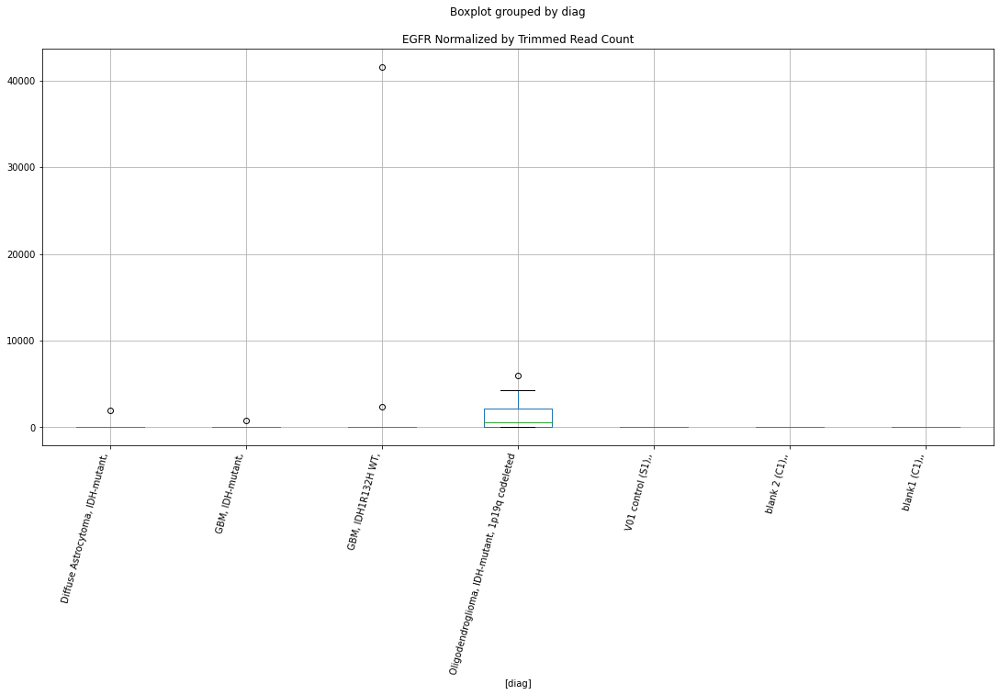

 p : 0.04537809668956392  ( t : 2.150209959594068 ) :  Lexogen  :  bbduk2  :  EPS8L2
Control and blanks
79     0.0
343    0.0
Name: EPS8L2, dtype: float64
211    0.0
Name: EPS8L2, dtype: float64
475    0.0
Name: EPS8L2, dtype: float64


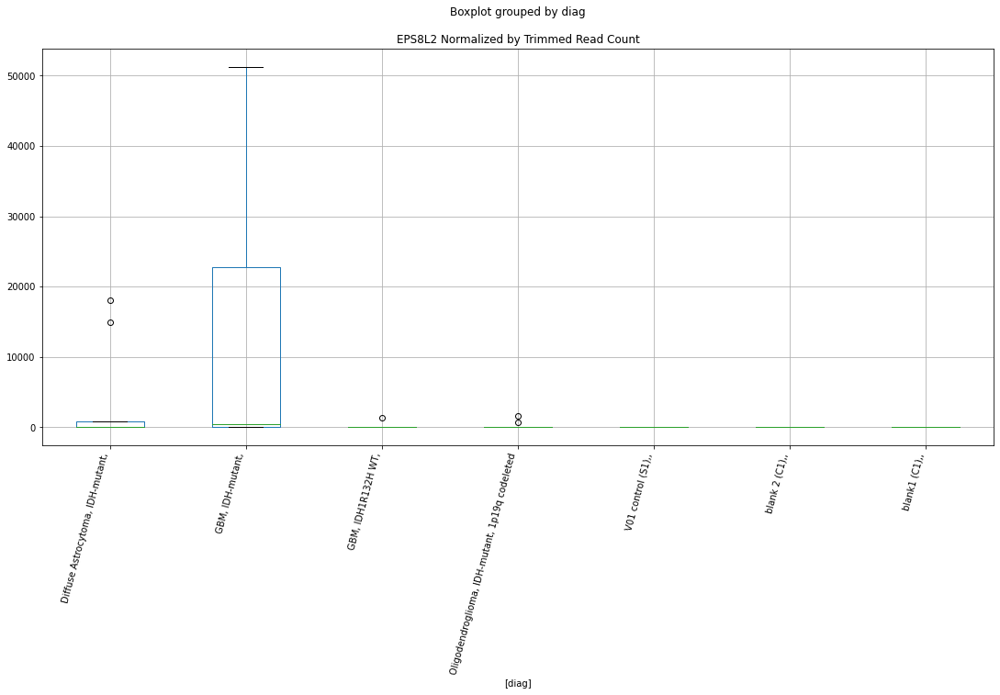

 p : 0.04545259712331047  ( t : 2.1493798536558795 ) :  D-plex  :  cutadapt2  :  FCRL1
Control and blanks
76     14394.67
340    33467.82
Name: FCRL1, dtype: float64
208    2.29e+06
Name: FCRL1, dtype: float64
472    86115.42
Name: FCRL1, dtype: float64


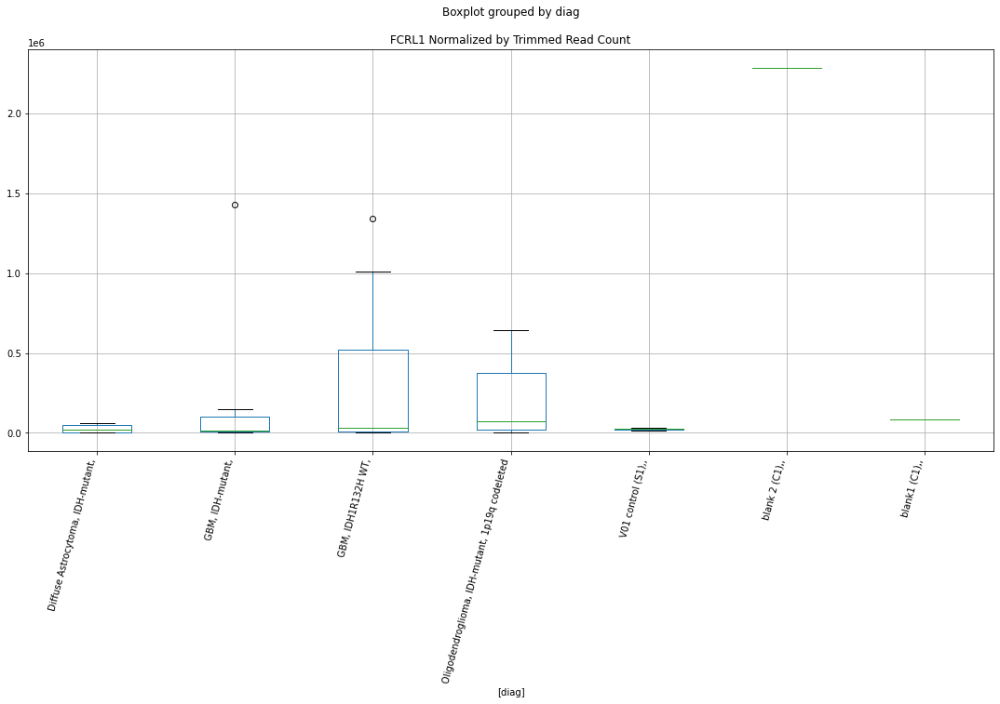

 p : 0.04548943511388379  ( t : 2.148969853057114 ) :  D-plex  :  bbduk2  :  LAPTM4B
Control and blanks
73       0.00
337    890.16
Name: LAPTM4B, dtype: float64
205    716.36
Name: LAPTM4B, dtype: float64
469    1183.05
Name: LAPTM4B, dtype: float64


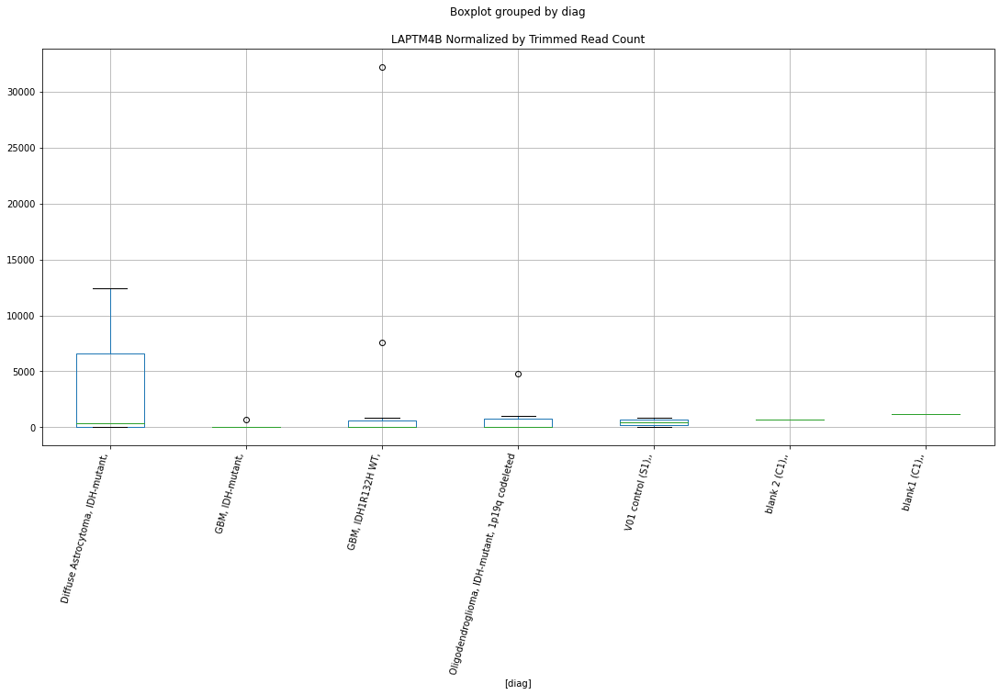

 p : 0.04550022231233923  ( t : 2.1488498507843876 ) :  Lexogen  :  cutadapt2  :  EHD2
Control and blanks
82       0.00
346    210.43
Name: EHD2, dtype: float64
214    542.45
Name: EHD2, dtype: float64
478    0.0
Name: EHD2, dtype: float64


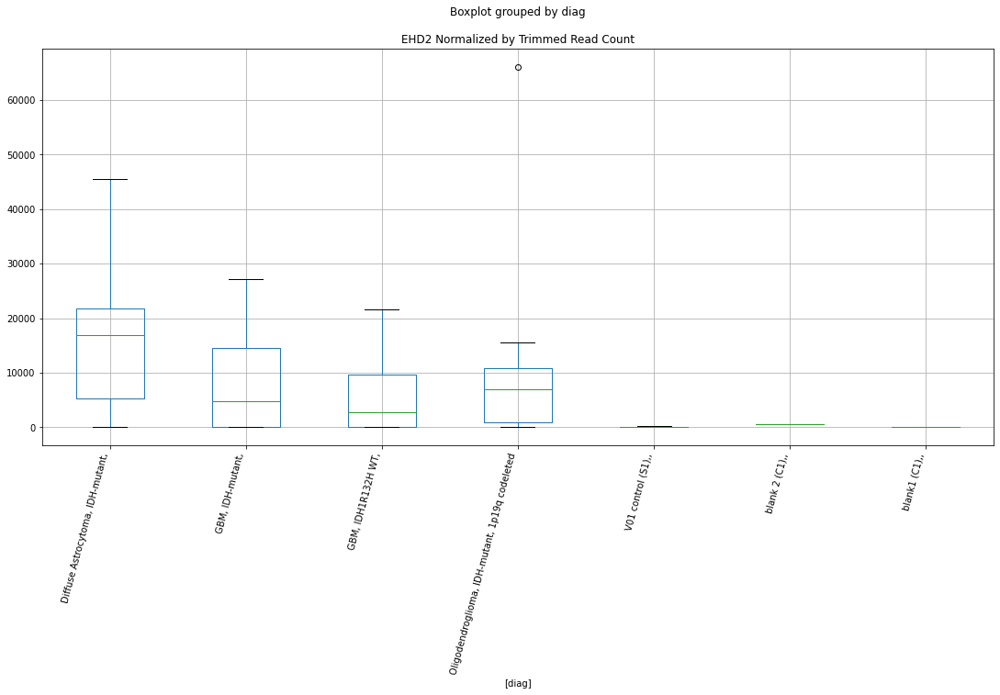

 p : 0.045526680674572786  ( t : 2.148555624553799 ) :  D-plex  :  cutadapt2  :  LAPTM4B
Control and blanks
76       0.00
340    880.73
Name: LAPTM4B, dtype: float64
208    705.44
Name: LAPTM4B, dtype: float64
472    1155.91
Name: LAPTM4B, dtype: float64


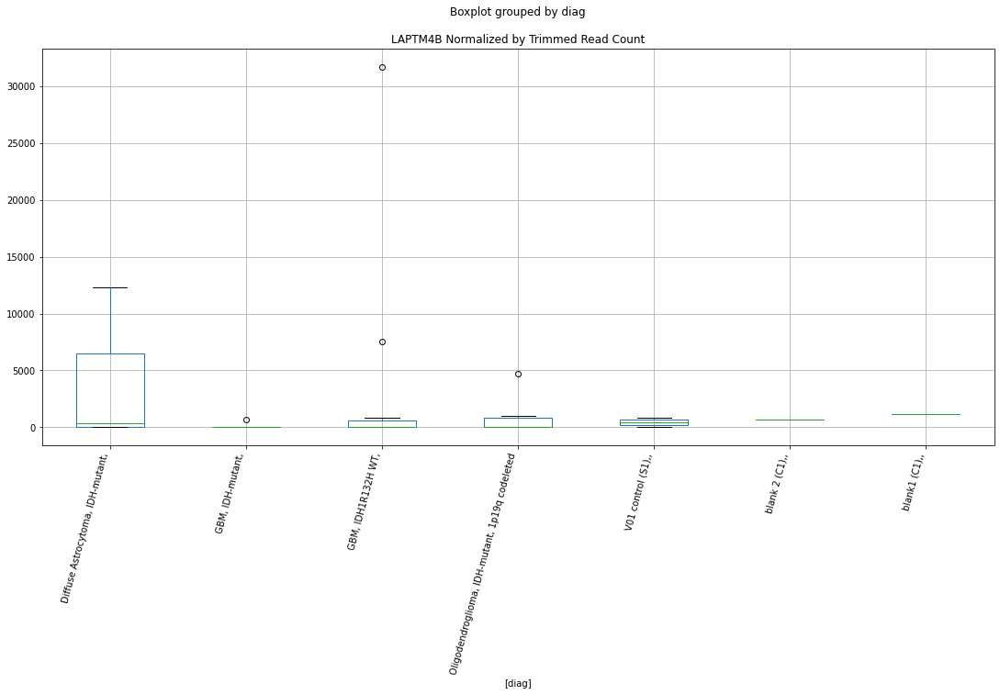

 p : 0.045538003052922556  ( t : 2.148429763477677 ) :  D-plex  :  bbduk2  :  LAMC1
Control and blanks
73     0.0
337    0.0
Name: LAMC1, dtype: float64
205    895.45
Name: LAMC1, dtype: float64
469    591.53
Name: LAMC1, dtype: float64


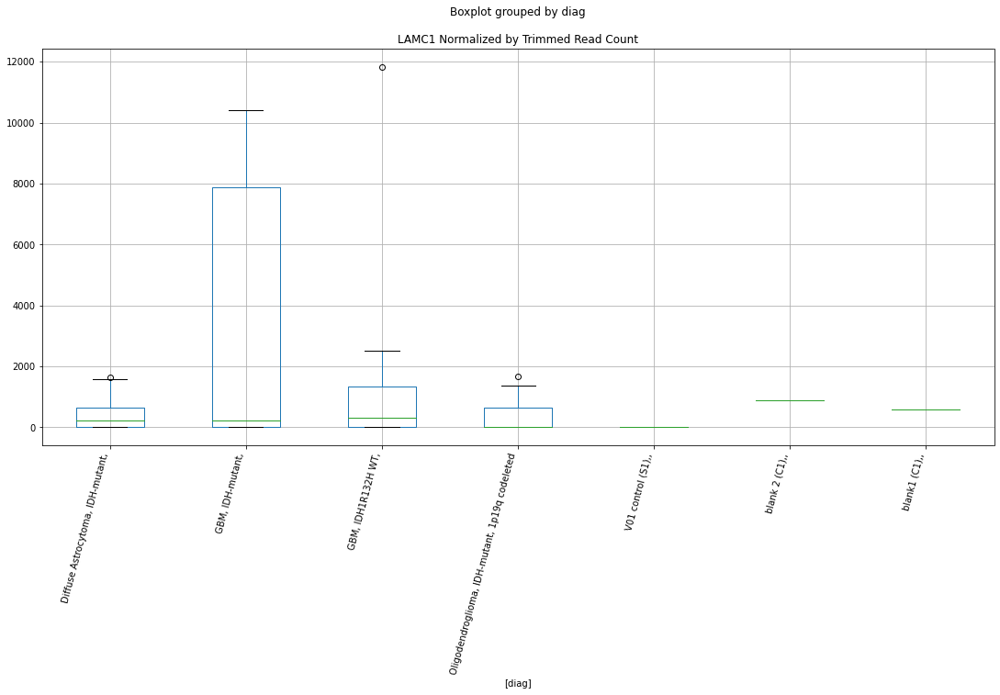

 p : 0.045618077709519915  ( t : 2.1475404580119077 ) :  D-plex  :  cutadapt2  :  IWS1
Control and blanks
76     0.0
340    0.0
Name: IWS1, dtype: float64
208    9347.09
Name: IWS1, dtype: float64
472    8091.38
Name: IWS1, dtype: float64


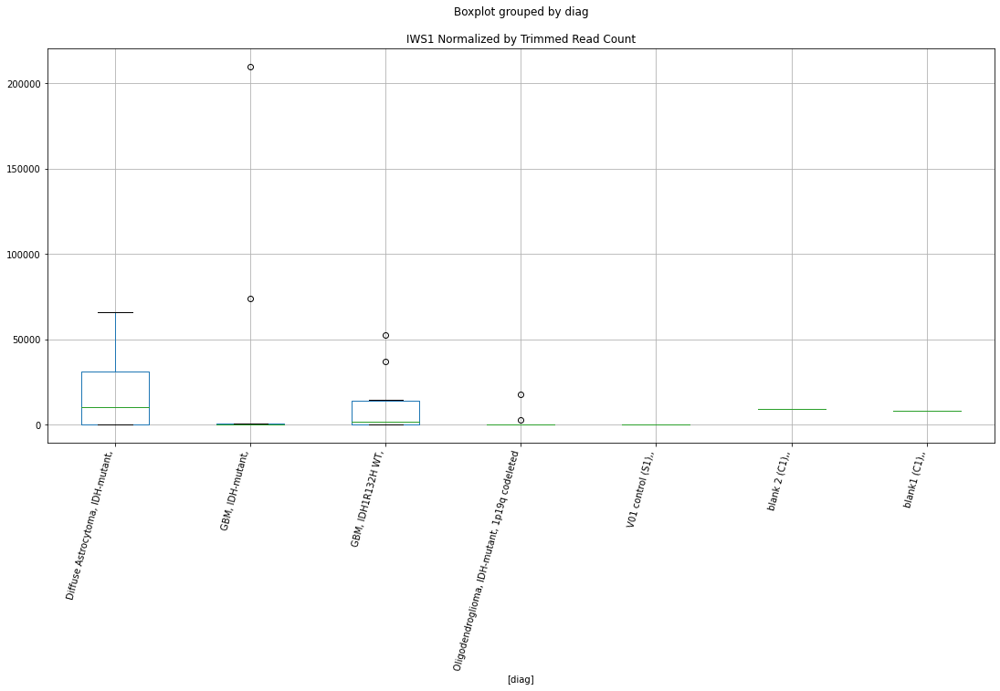

 p : 0.045620549922743954  ( t : 2.147513024424508 ) :  D-plex  :  bbduk2  :  FCRL1
Control and blanks
73     14687.16
337    33825.98
Name: FCRL1, dtype: float64
205    2.31e+06
Name: FCRL1, dtype: float64
469    88137.57
Name: FCRL1, dtype: float64


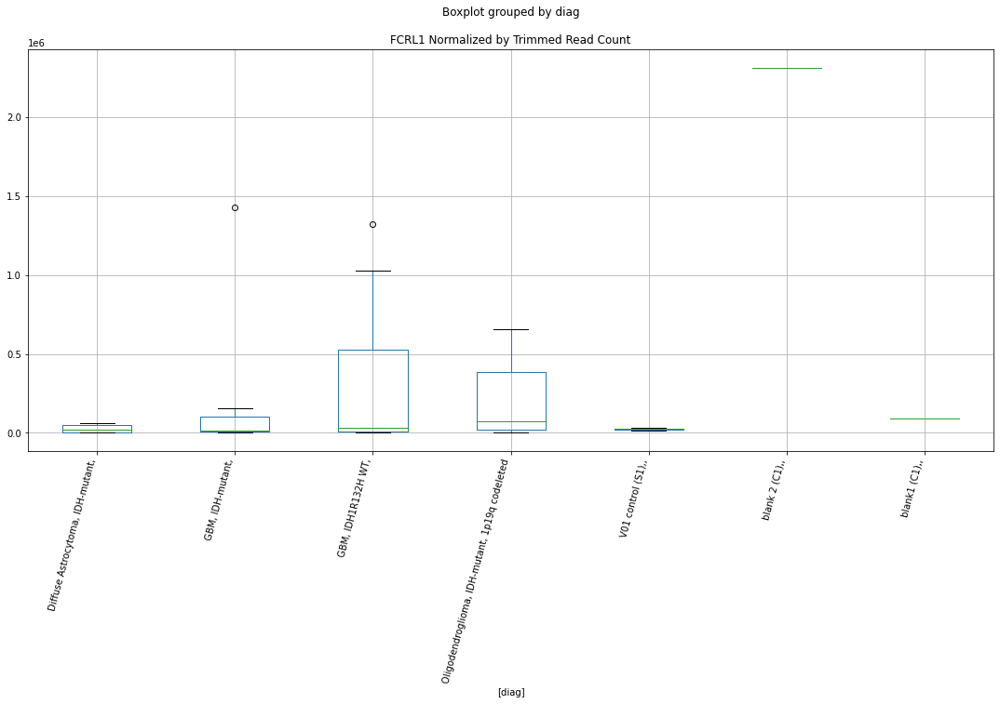

 p : 0.04562433511442779  ( t : 2.147471023645309 ) :  D-plex  :  cutadapt2  :  FAAP24
Control and blanks
76     0.0
340    0.0
Name: FAAP24, dtype: float64
208    0.0
Name: FAAP24, dtype: float64
472    0.0
Name: FAAP24, dtype: float64


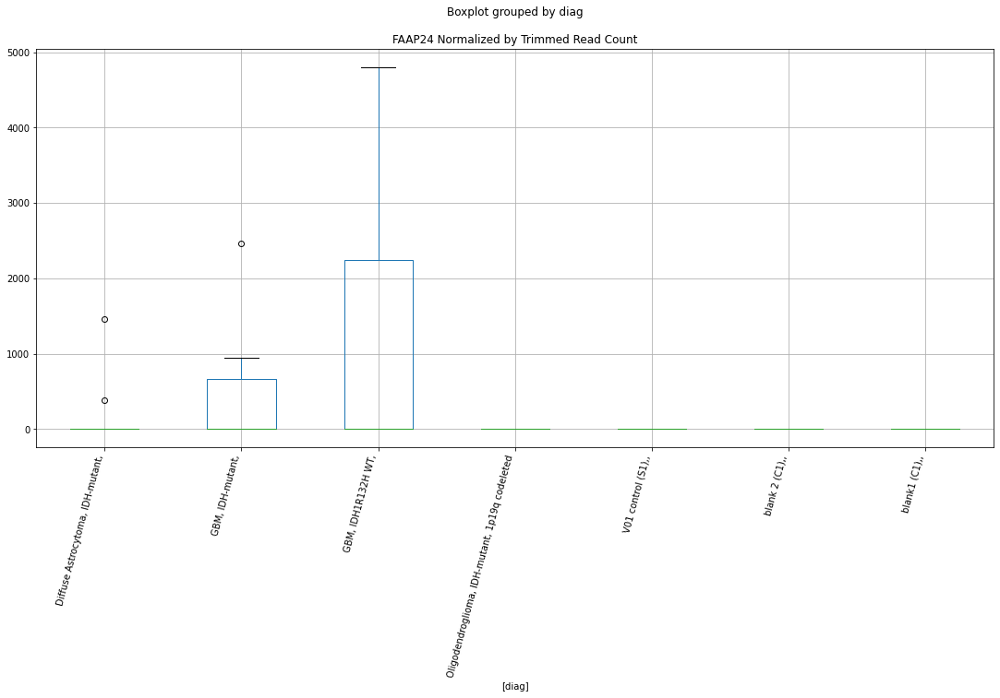

 p : 0.045626927293257624  ( t : 2.147442262465138 ) :  D-plex  :  bbduk2  :  KHDC1
Control and blanks
73     0.0
337    0.0
Name: KHDC1, dtype: float64
205    3581.82
Name: KHDC1, dtype: float64
469    5323.75
Name: KHDC1, dtype: float64


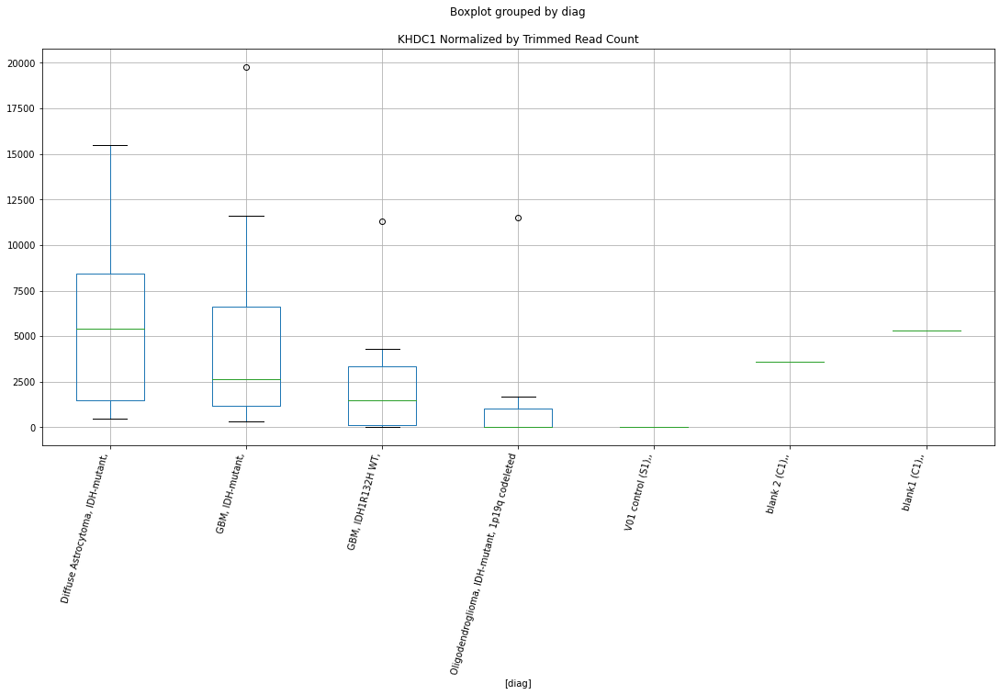

 p : 0.045631362276423136  ( t : 2.147393058152476 ) :  Lexogen  :  cutadapt2  :  EPS8L2
Control and blanks
82     0.0
346    0.0
Name: EPS8L2, dtype: float64
214    0.0
Name: EPS8L2, dtype: float64
478    0.0
Name: EPS8L2, dtype: float64


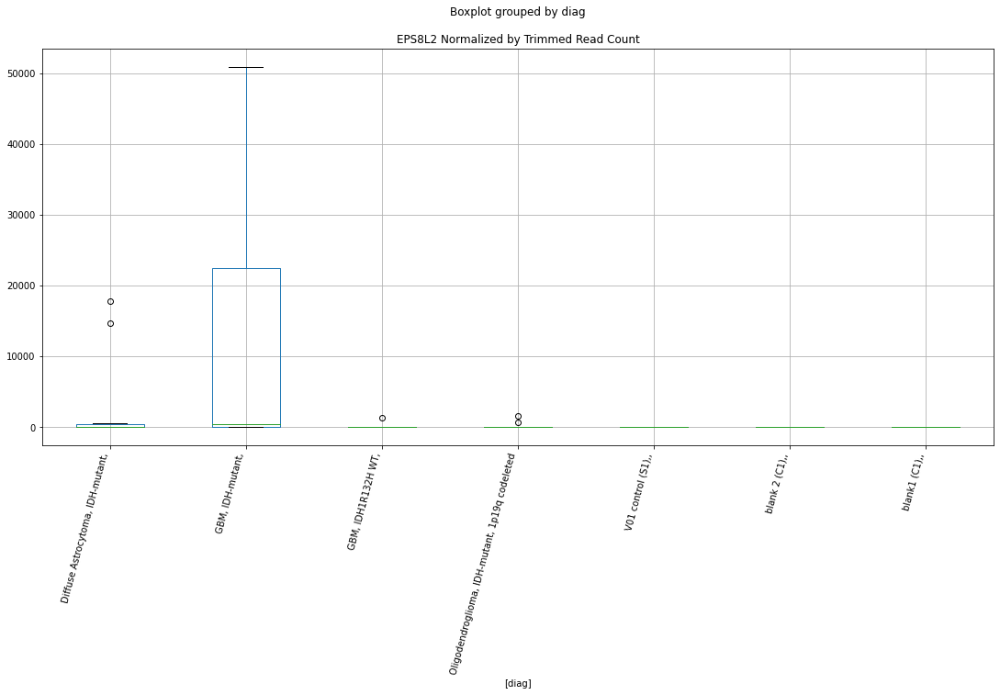

 p : 0.045670993460990406  ( t : 2.1469535603009002 ) :  Lexogen  :  cutadapt2  :  DUS3L
Control and blanks
82        0.00
346    2525.21
Name: DUS3L, dtype: float64
214    0.0
Name: DUS3L, dtype: float64
478    0.0
Name: DUS3L, dtype: float64


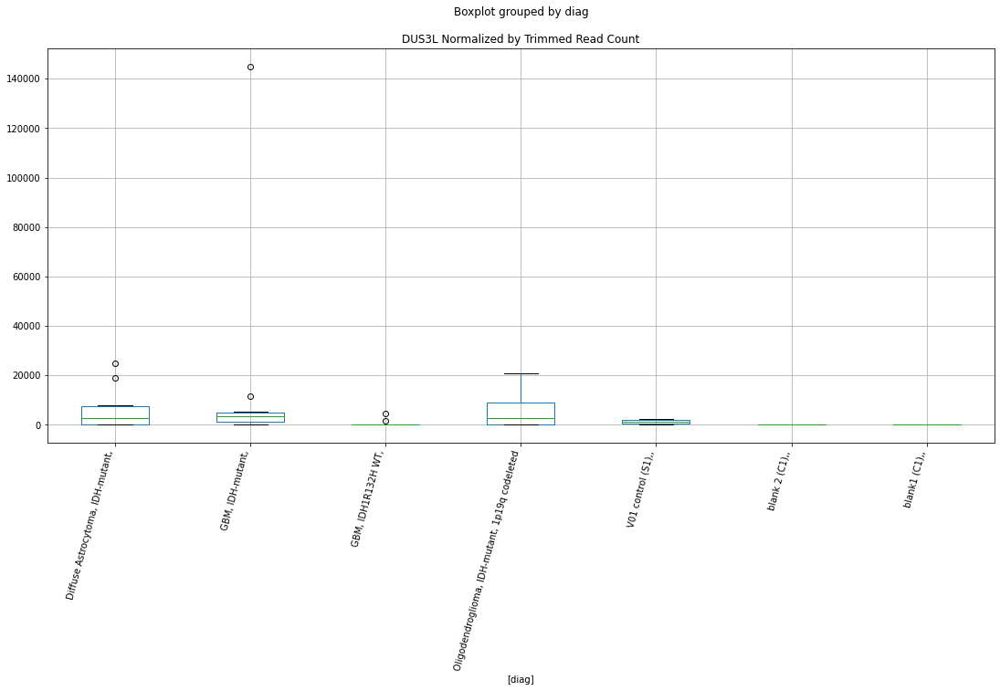

 p : 0.0456860463007123  ( t : 2.1467867201424875 ) :  D-plex  :  bbduk2  :  FEV
Control and blanks
73     773.01
337      0.00
Name: FEV, dtype: float64
205    537.27
Name: FEV, dtype: float64
469    3549.16
Name: FEV, dtype: float64


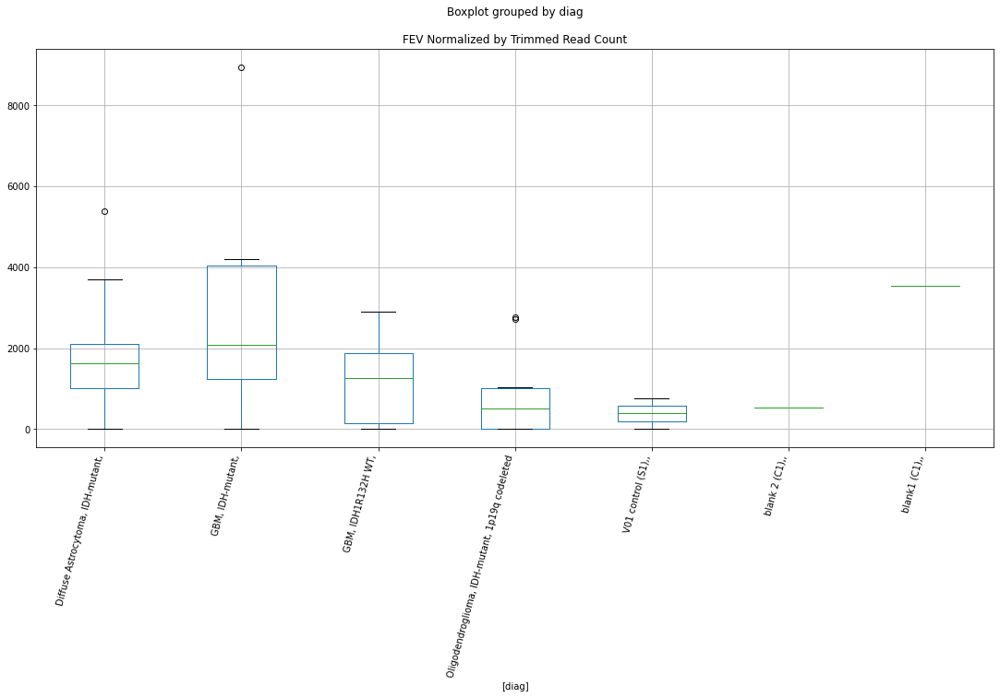

 p : 0.04574495728031616  ( t : 2.1461342548426705 ) :  D-plex  :  cutadapt2  :  EGLN1
Control and blanks
76     0.0
340    0.0
Name: EGLN1, dtype: float64
208    1587.24
Name: EGLN1, dtype: float64
472    2311.82
Name: EGLN1, dtype: float64


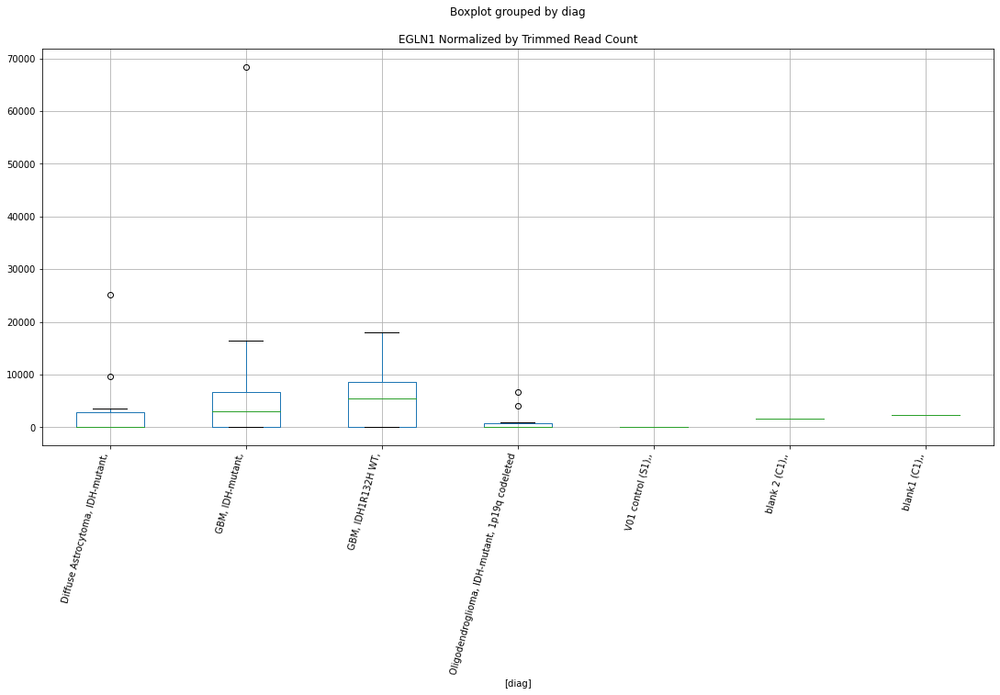

 p : 0.04575567274680141  ( t : 2.146015658785932 ) :  Lexogen  :  cutadapt2  :  GLI3
Control and blanks
82     0.0
346    0.0
Name: GLI3, dtype: float64
214    7323.11
Name: GLI3, dtype: float64
478    0.0
Name: GLI3, dtype: float64


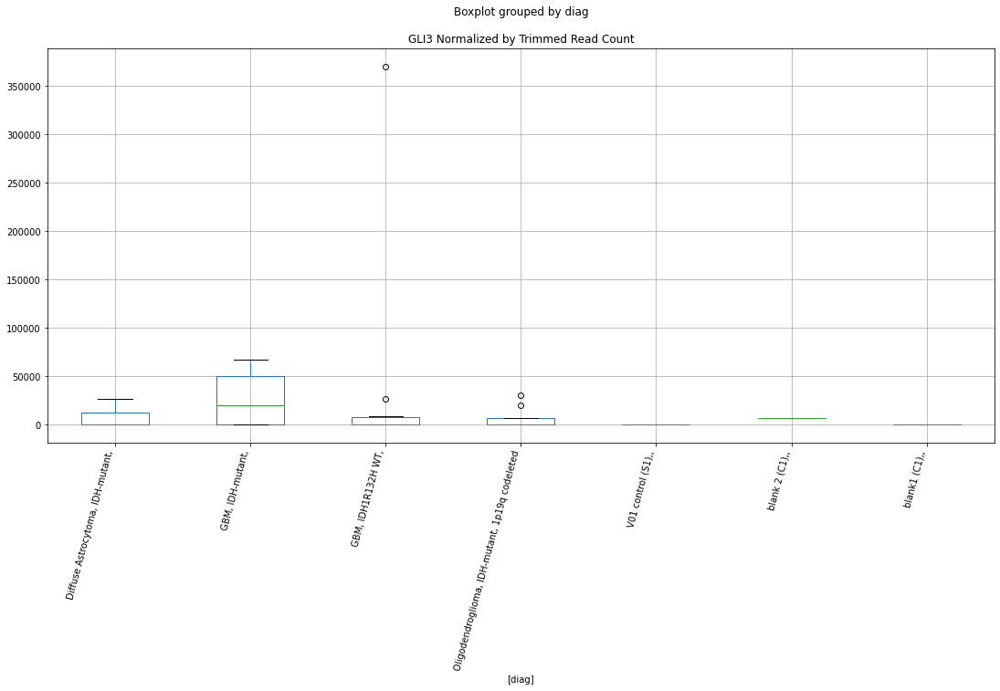

 p : 0.04576800896164582  ( t : 2.145879156107024 ) :  Lexogen  :  cutadapt2  :  IQSEC3
Control and blanks
82     0.0
346    0.0
Name: IQSEC3, dtype: float64
214    0.0
Name: IQSEC3, dtype: float64
478    0.0
Name: IQSEC3, dtype: float64


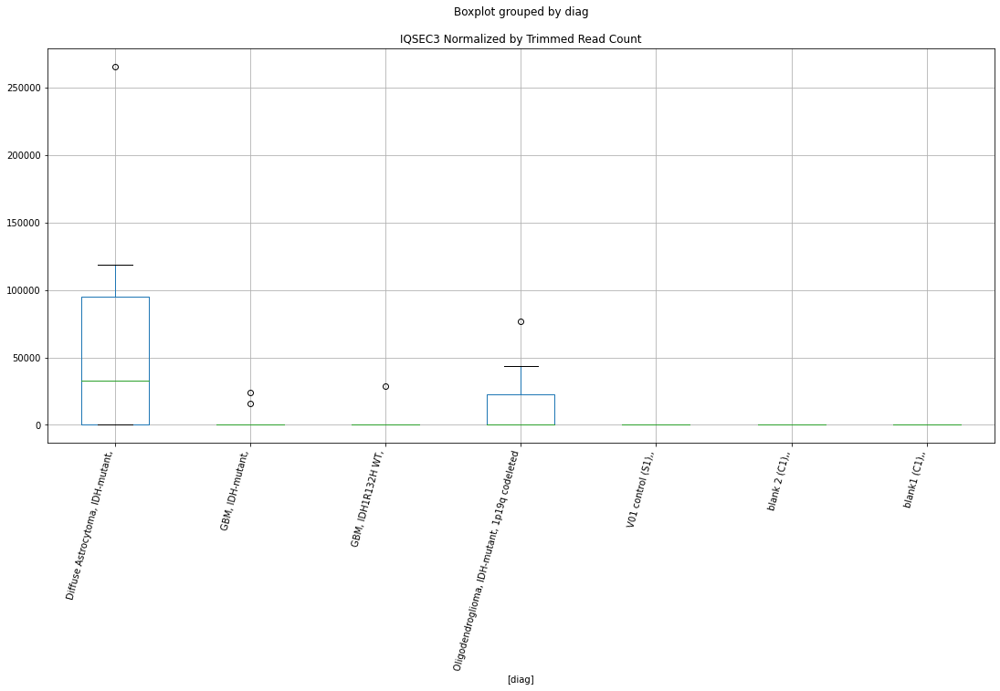

 p : 0.04580614756608106  ( t : 2.145457357270041 ) :  Lexogen  :  bbduk2  :  KIFC3
Control and blanks
79     0.0
343    0.0
Name: KIFC3, dtype: float64
211    0.0
Name: KIFC3, dtype: float64
475    0.0
Name: KIFC3, dtype: float64


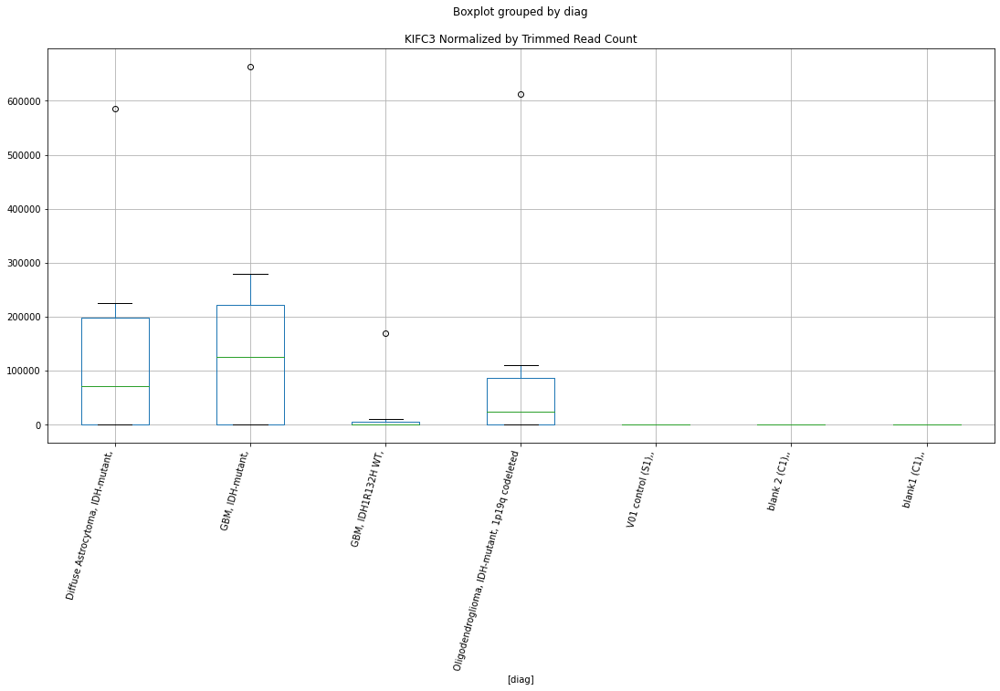

 p : 0.04588443483762756  ( t : 2.144592533015787 ) :  D-plex  :  bbduk2  :  KAT8
Control and blanks
73     0.0
337    0.0
Name: KAT8, dtype: float64
205    0.0
Name: KAT8, dtype: float64
469    1183.05
Name: KAT8, dtype: float64


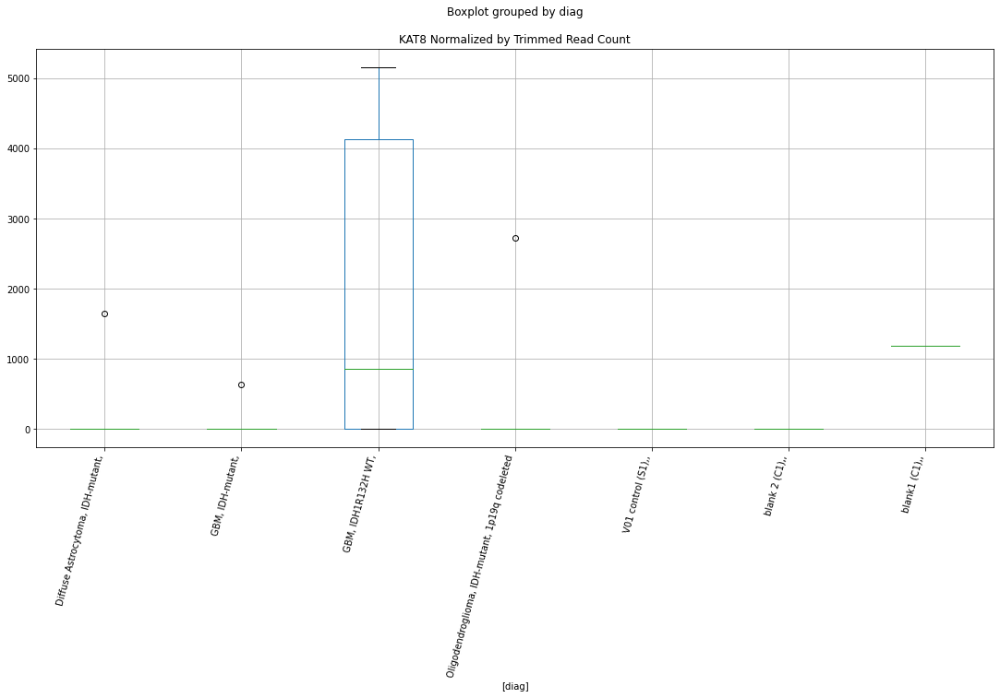

 p : 0.04591020434037331  ( t : 2.1443081570964386 ) :  D-plex  :  cutadapt2  :  GPR37L1
Control and blanks
76     0.0
340    0.0
Name: GPR37L1, dtype: float64
208    5290.81
Name: GPR37L1, dtype: float64
472    3467.74
Name: GPR37L1, dtype: float64


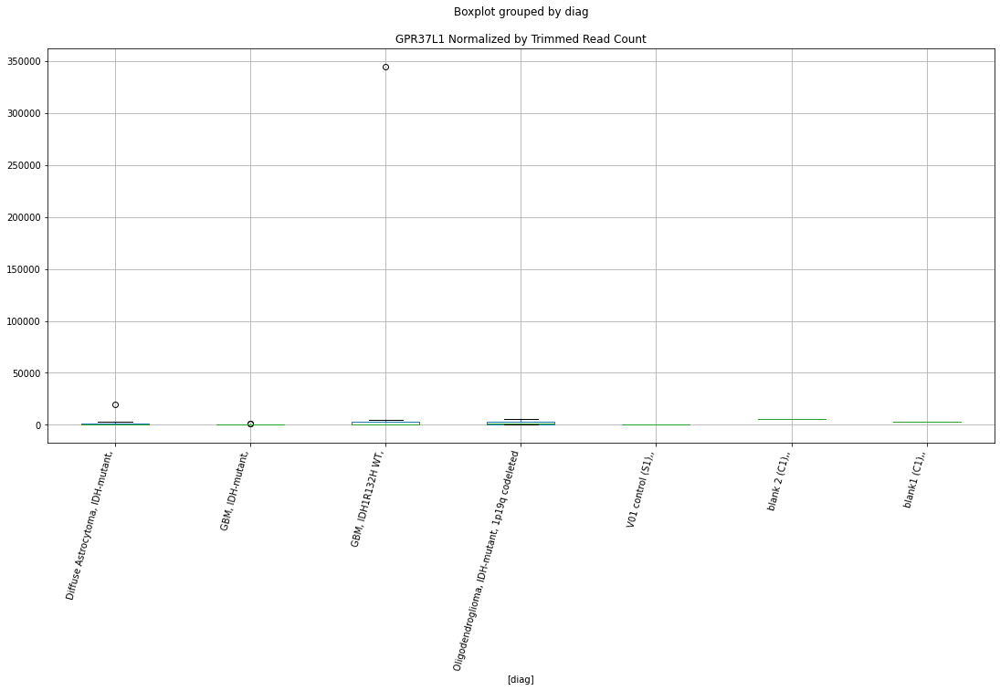

 p : 0.04593675512451472  ( t : 2.1440153118671423 ) :  D-plex  :  cutadapt2  :  IPO8
Control and blanks
76     0.0
340    0.0
Name: IPO8, dtype: float64
208    352.72
Name: IPO8, dtype: float64
472    3467.74
Name: IPO8, dtype: float64


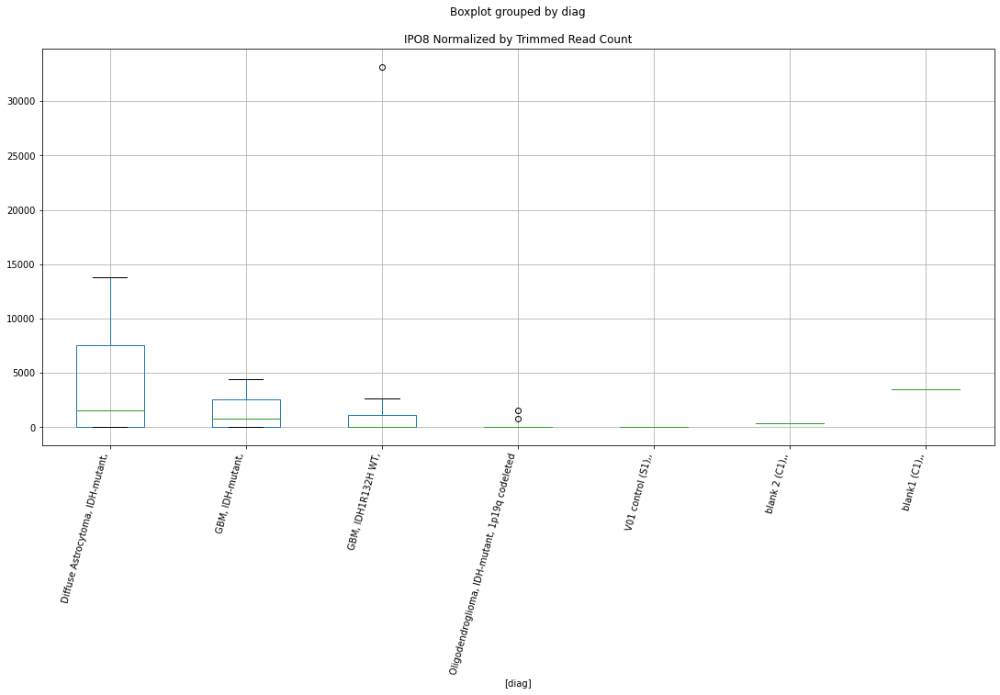

 p : 0.04596696926496241  ( t : 2.143682249146084 ) :  Lexogen  :  bbduk2  :  DUSP10
Control and blanks
79     4291.80
343    2760.09
Name: DUSP10, dtype: float64
211    4099.6
Name: DUSP10, dtype: float64
475    1916.13
Name: DUSP10, dtype: float64


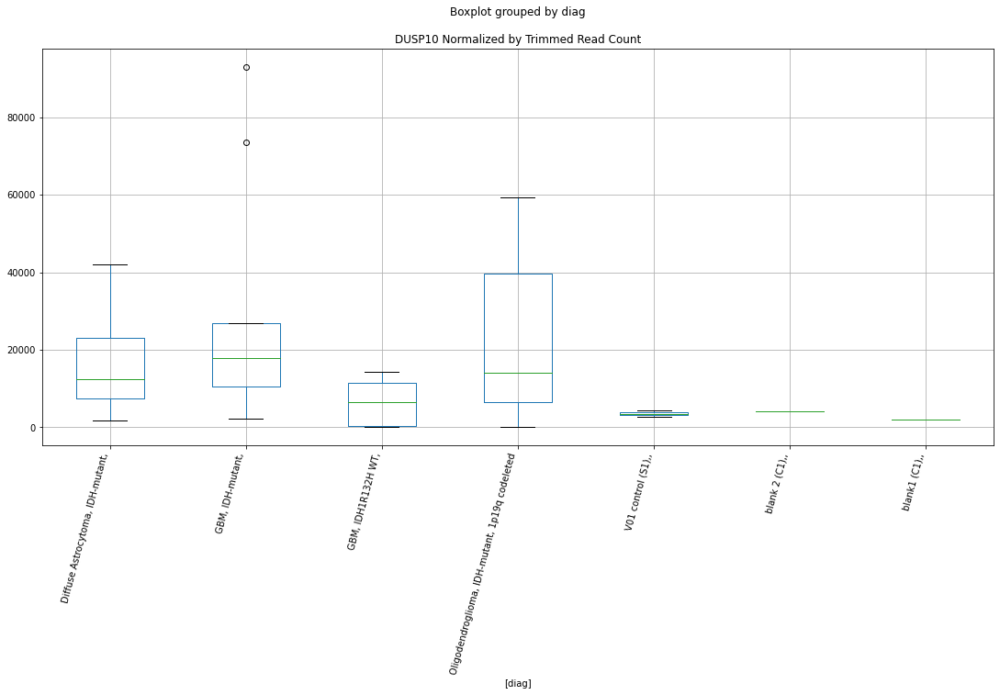

 p : 0.04606115152755964  ( t : 2.1426453210765843 ) :  Lexogen  :  cutadapt2  :  KIFC3
Control and blanks
82     0.0
346    0.0
Name: KIFC3, dtype: float64
214    0.0
Name: KIFC3, dtype: float64
478    0.0
Name: KIFC3, dtype: float64


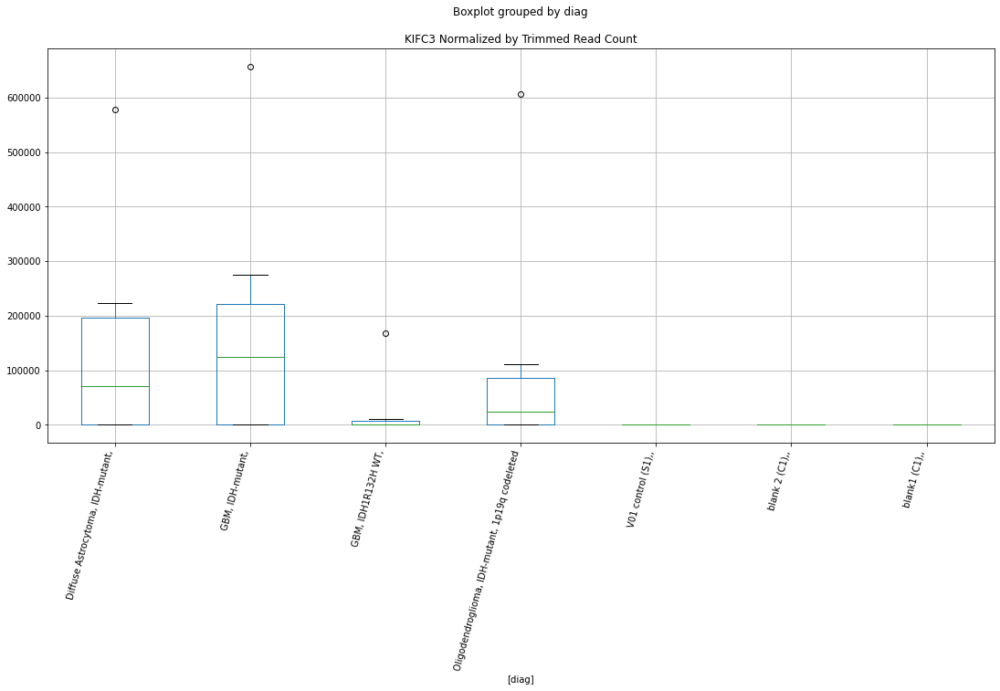

 p : 0.04606953476075157  ( t : 2.1425531171877266 ) :  Lexogen  :  bbduk2  :  DUS3L
Control and blanks
79        0.00
343    2547.77
Name: DUS3L, dtype: float64
211    0.0
Name: DUS3L, dtype: float64
475    0.0
Name: DUS3L, dtype: float64


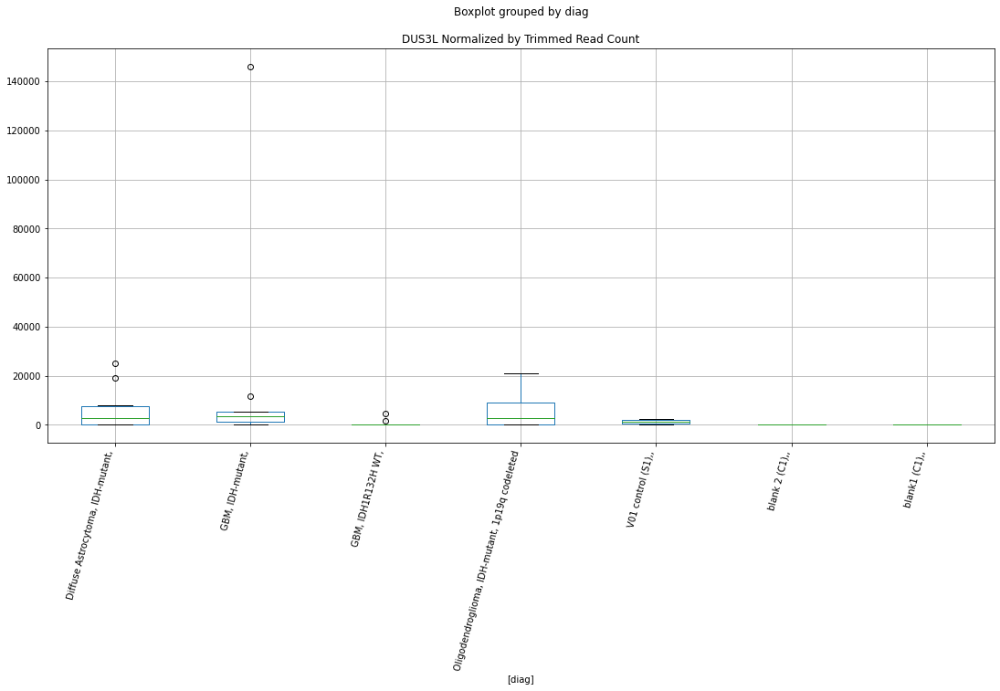

 p : 0.046088776017331134  ( t : 2.1423415480799703 ) :  Lexogen  :  bbduk2  :  FGFR3
Control and blanks
79         0.00
343    12951.17
Name: FGFR3, dtype: float64
211    3279.68
Name: FGFR3, dtype: float64
475    8622.57
Name: FGFR3, dtype: float64


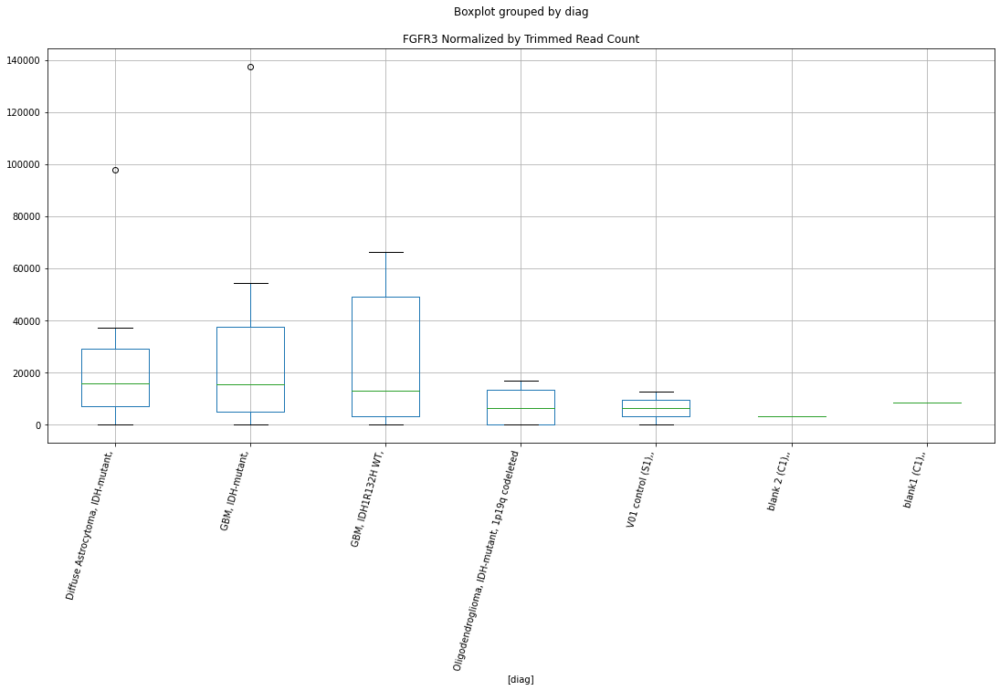

 p : 0.04610688354859095  ( t : 2.1421425185999485 ) :  D-plex  :  cutadapt2  :  GRM7
Control and blanks
76         0.0
340    73981.5
Name: GRM7, dtype: float64
208    8288.93
Name: GRM7, dtype: float64
472    0.0
Name: GRM7, dtype: float64


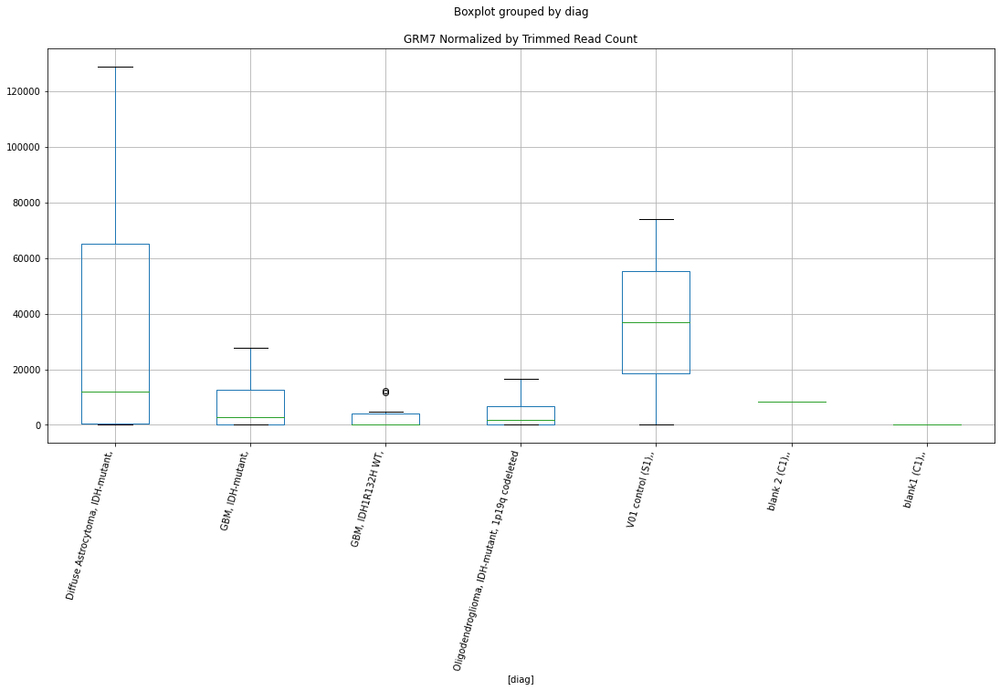

 p : 0.04621856983644314  ( t : 2.140916490504582 ) :  D-plex  :  bbduk2  :  GABRB3
Control and blanks
73     0.0
337    0.0
Name: GABRB3, dtype: float64
205    11820.0
Name: GABRB3, dtype: float64
469    8281.38
Name: GABRB3, dtype: float64


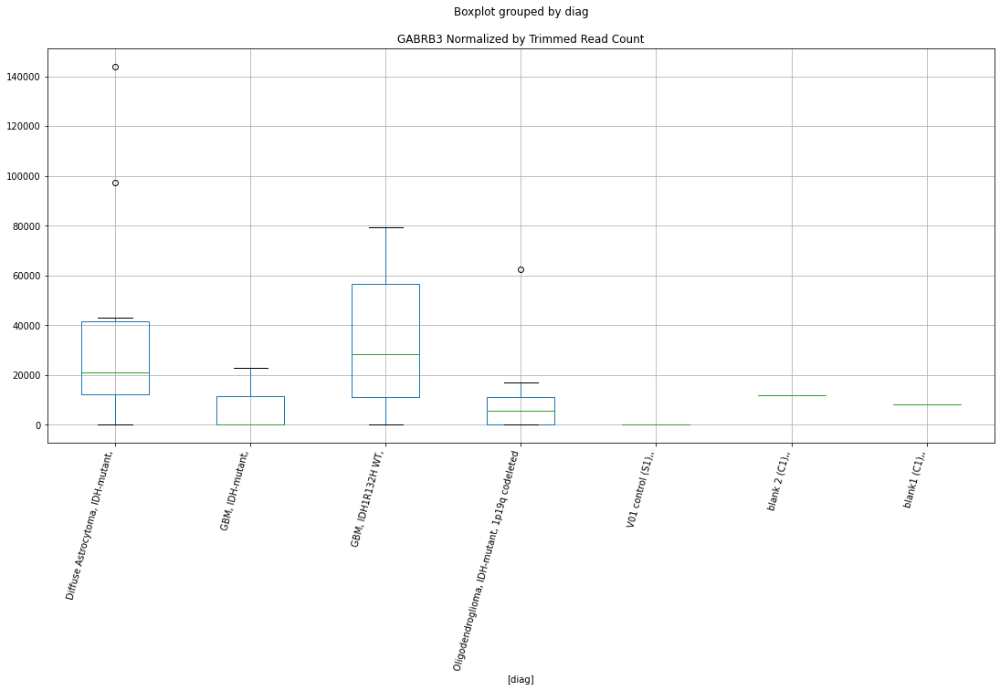

 p : 0.0462595799431967  ( t : 2.140466983823459 ) :  D-plex  :  cutadapt2  :  GREB1
Control and blanks
76     757.61
340      0.00
Name: GREB1, dtype: float64
208    13050.66
Name: GREB1, dtype: float64
472    9247.29
Name: GREB1, dtype: float64


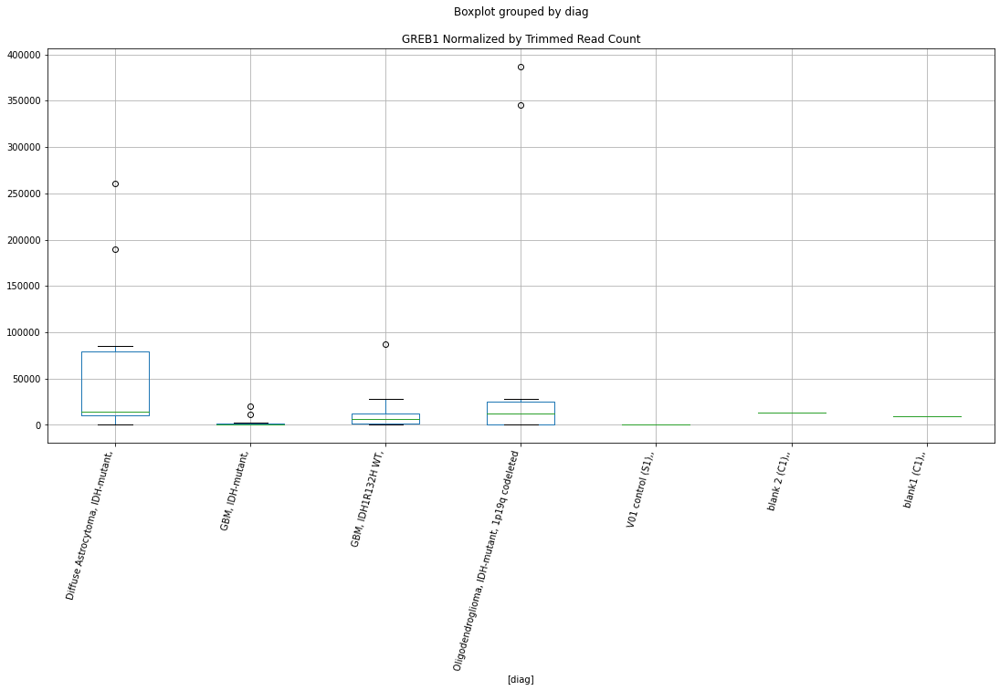

 p : 0.0462611054776357  ( t : 2.140450269648492 ) :  D-plex  :  bbduk2  :  FARP1
Control and blanks
73     0.0
337    0.0
Name: FARP1, dtype: float64
205    4835.46
Name: FARP1, dtype: float64
469    0.0
Name: FARP1, dtype: float64


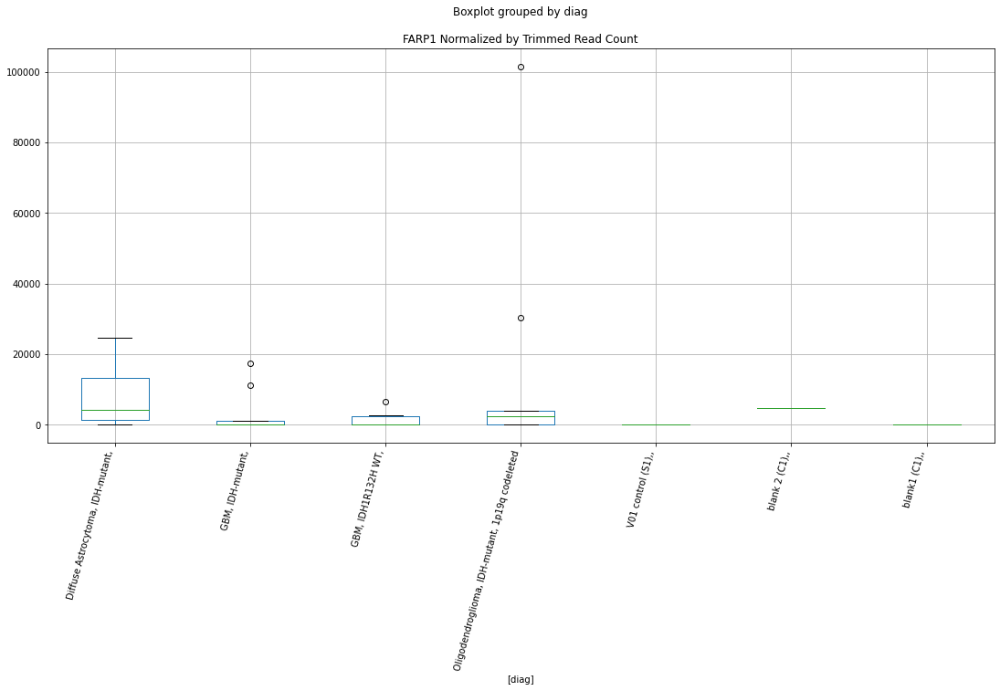

 p : 0.04637057173560104  ( t : 2.13925223849473 ) :  D-plex  :  cutadapt2  :  KIFAP3
Control and blanks
76       0.00
340    880.73
Name: KIFAP3, dtype: float64
208    705.44
Name: KIFAP3, dtype: float64
472    0.0
Name: KIFAP3, dtype: float64


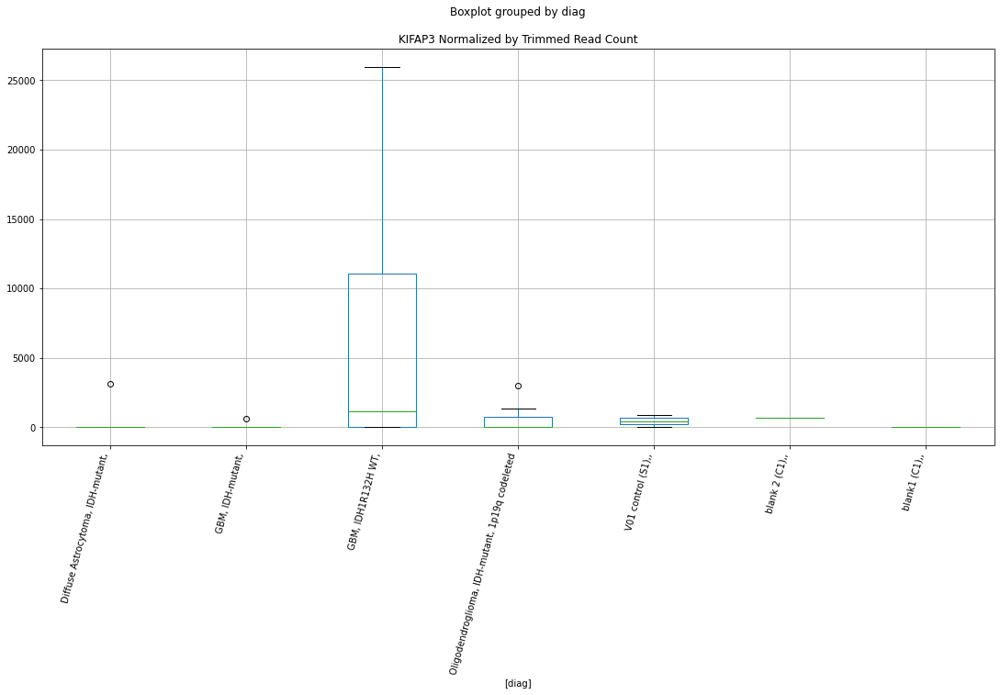

 p : 0.046387922145116604  ( t : 2.139062587513628 ) :  D-plex  :  bbduk2  :  DNAH17
Control and blanks
73         0.00
337    62311.01
Name: DNAH17, dtype: float64
205    138258.22
Name: DNAH17, dtype: float64
469    36083.17
Name: DNAH17, dtype: float64


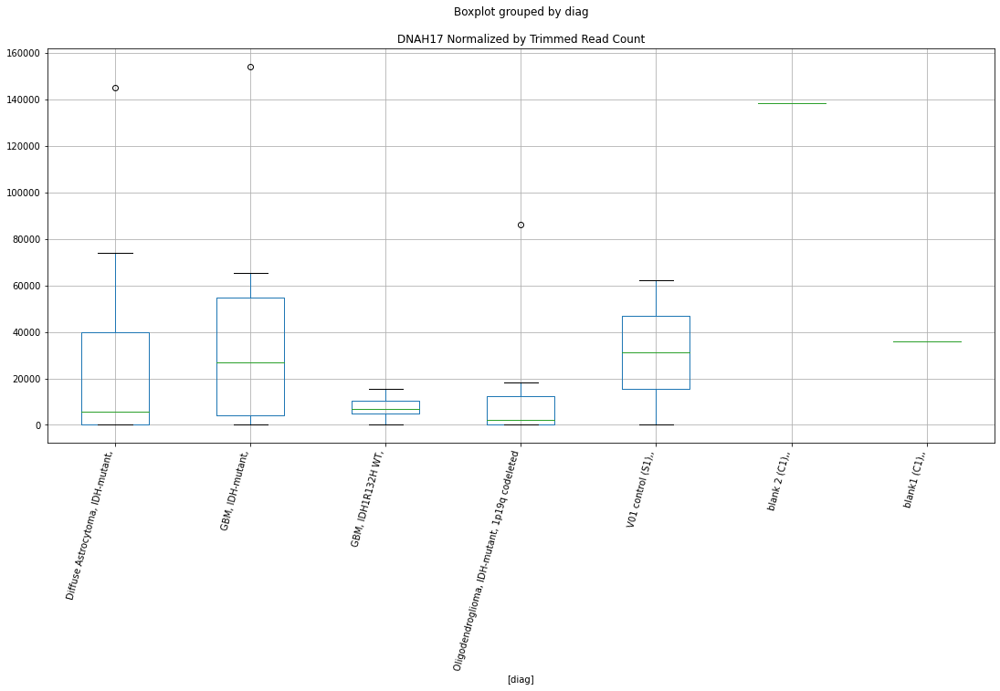

 p : 0.04639053412641661  ( t : 2.1390340425081886 ) :  Lexogen  :  bbduk2  :  HS3ST4
Control and blanks
79     0.0
343    0.0
Name: HS3ST4, dtype: float64
211    0.0
Name: HS3ST4, dtype: float64
475    0.0
Name: HS3ST4, dtype: float64


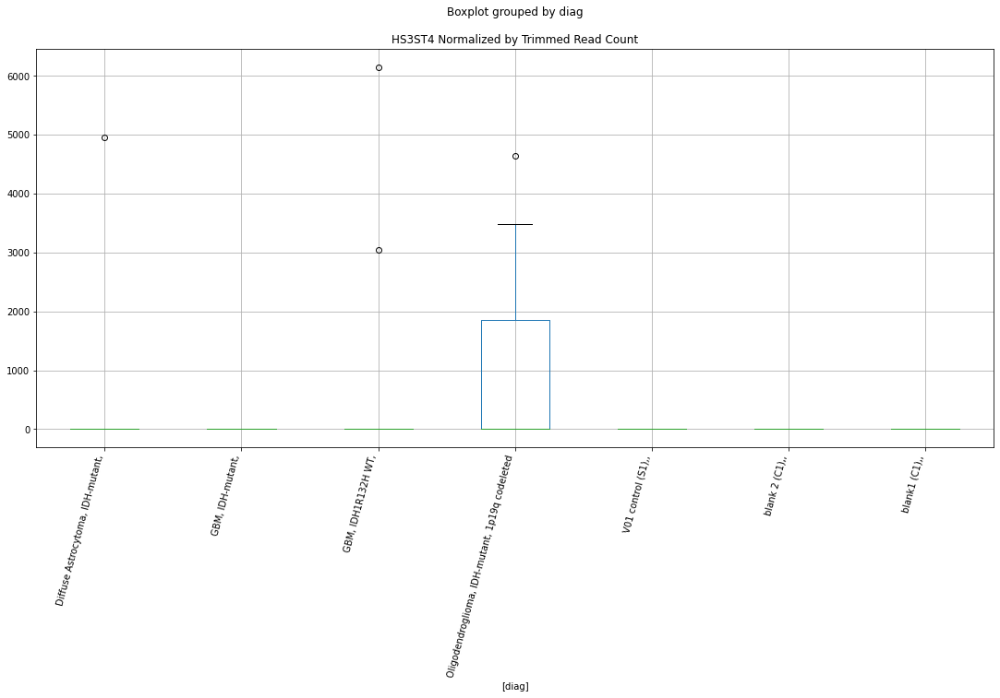

 p : 0.04639118974719979  ( t : 2.139026877794843 ) :  Lexogen  :  cutadapt2  :  EFNB3
Control and blanks
82       0.00
346    420.87
Name: EFNB3, dtype: float64
214    0.0
Name: EFNB3, dtype: float64
478    474.92
Name: EFNB3, dtype: float64


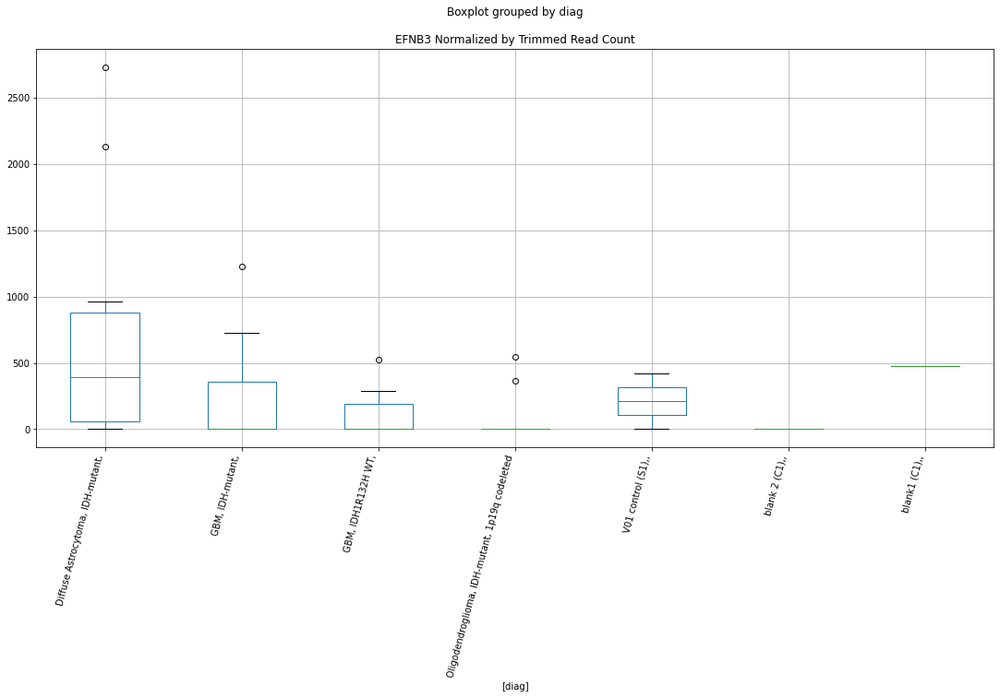

 p : 0.04645234334718637  ( t : 2.1383589888834056 ) :  Lexogen  :  bbduk2  :  GSK3B
Control and blanks
79        0.00
343    6581.74
Name: GSK3B, dtype: float64
211    10385.64
Name: GSK3B, dtype: float64
475    10059.66
Name: GSK3B, dtype: float64


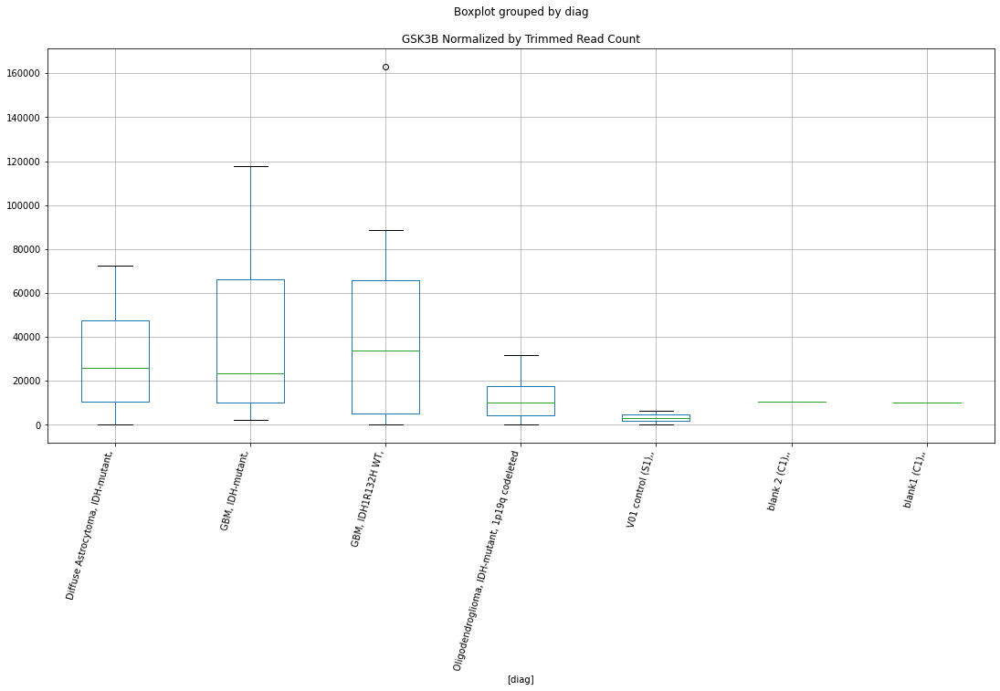

 p : 0.046466265735958884  ( t : 2.138207047686602 ) :  D-plex  :  bbduk2  :  FALEC
Control and blanks
73     0.0
337    0.0
Name: FALEC, dtype: float64
205    0.0
Name: FALEC, dtype: float64
469    0.0
Name: FALEC, dtype: float64


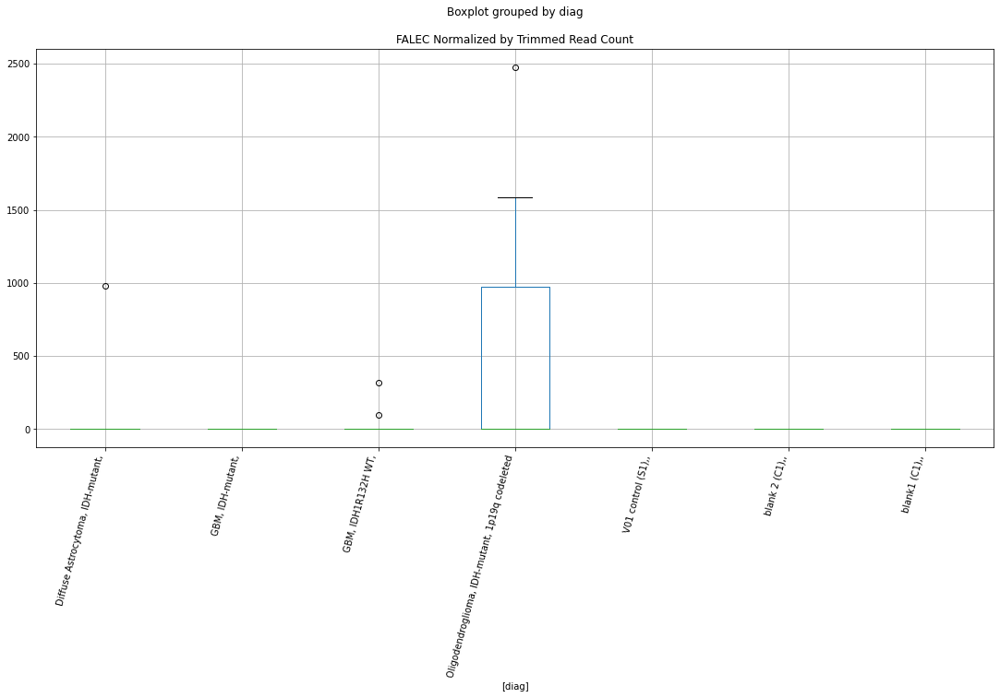

 p : 0.04649888704799753  ( t : 2.137851199507112 ) :  Lexogen  :  cutadapt2  :  HS3ST4
Control and blanks
82     0.0
346    0.0
Name: HS3ST4, dtype: float64
214    0.0
Name: HS3ST4, dtype: float64
478    0.0
Name: HS3ST4, dtype: float64


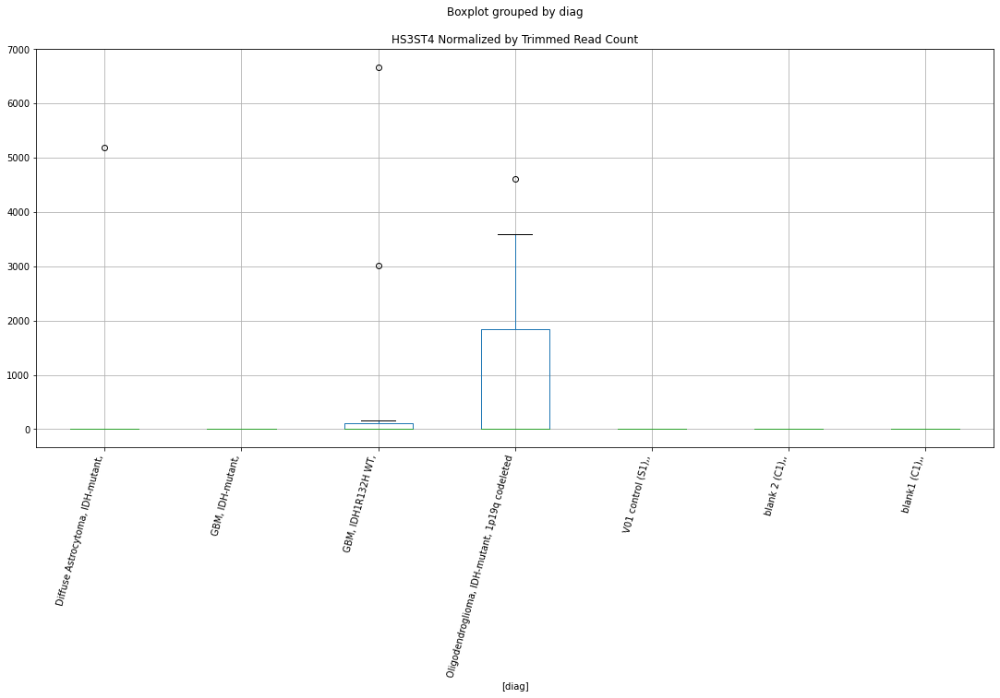

 p : 0.046550519003390585  ( t : 2.137288439913169 ) :  D-plex  :  bbduk2  :  KLF12
Control and blanks
73     0.0
337    0.0
Name: KLF12, dtype: float64
205    10566.37
Name: KLF12, dtype: float64
469    10647.49
Name: KLF12, dtype: float64


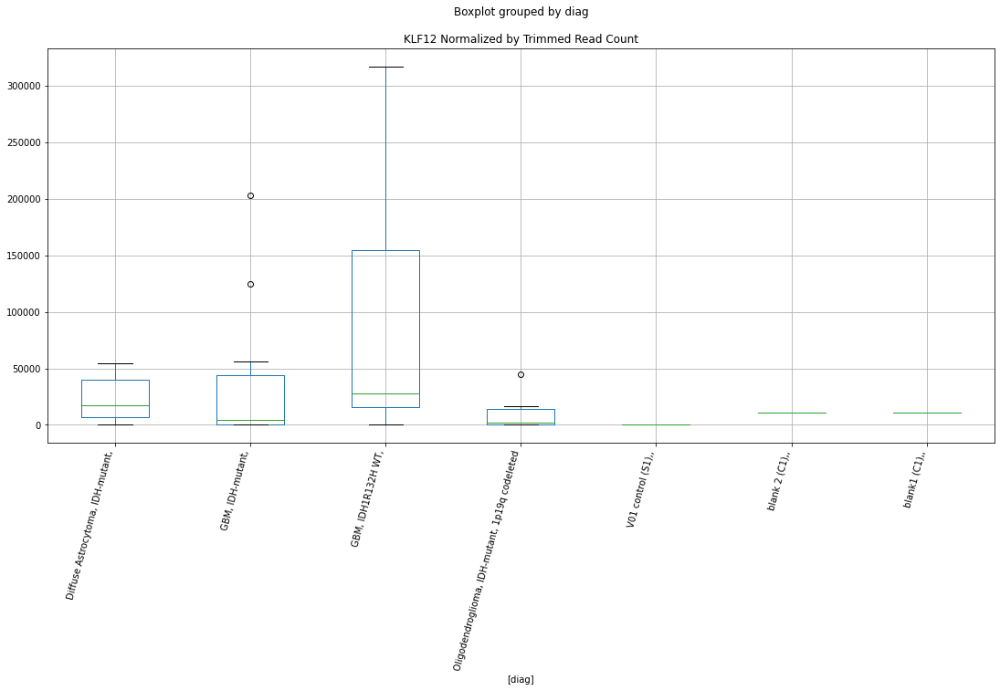

 p : 0.04655219361643577  ( t : 2.137270197100599 ) :  D-plex  :  cutadapt2  :  KLF12
Control and blanks
76     0.0
340    0.0
Name: KLF12, dtype: float64
208    11816.13
Name: KLF12, dtype: float64
472    5779.56
Name: KLF12, dtype: float64


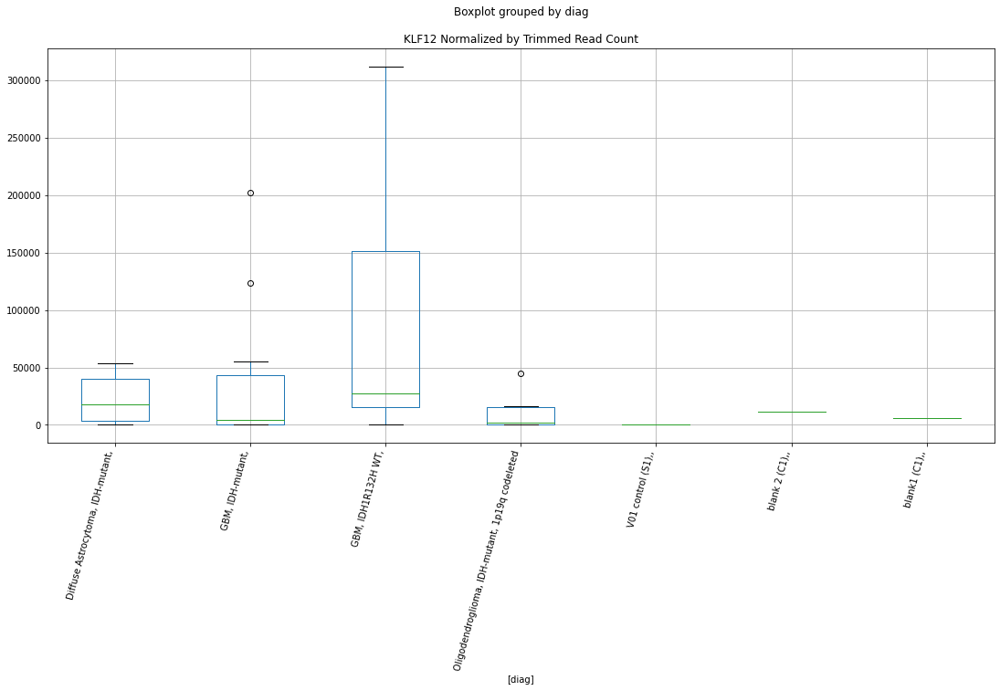

 p : 0.04655383047071148  ( t : 2.1372523662012606 ) :  D-plex  :  cutadapt2  :  HNRNPR
Control and blanks
76     0.0
340    0.0
Name: HNRNPR, dtype: float64
208    4938.09
Name: HNRNPR, dtype: float64
472    8091.38
Name: HNRNPR, dtype: float64


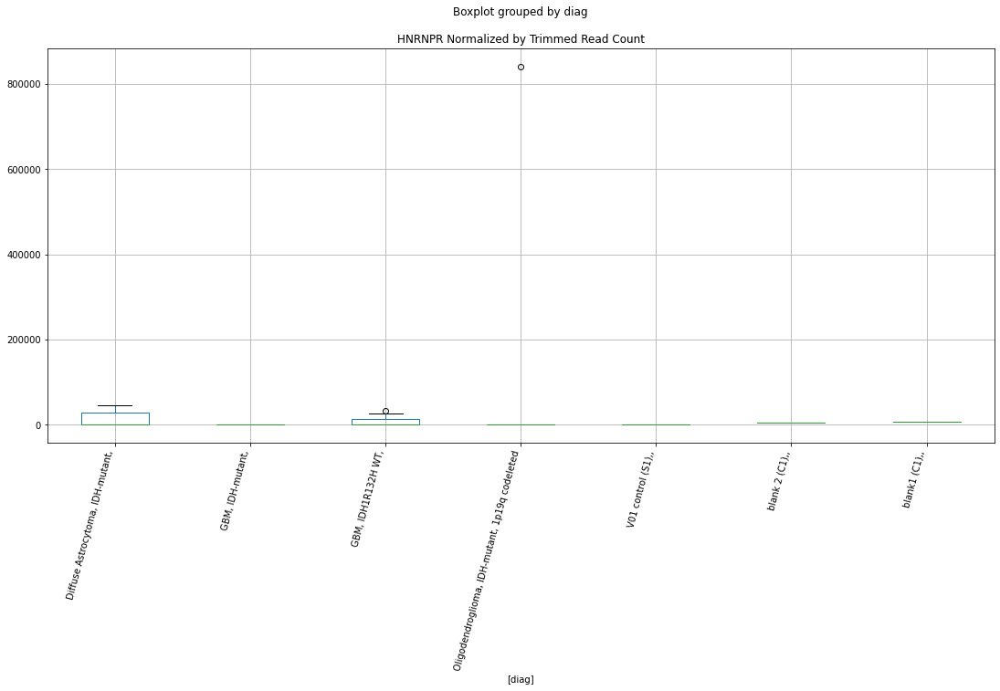

 p : 0.04665773405894408  ( t : 2.1361216724588092 ) :  D-plex  :  bbduk2  :  FECH
Control and blanks
73     0.0
337    0.0
Name: FECH, dtype: float64
205    3223.64
Name: FECH, dtype: float64
469    4732.22
Name: FECH, dtype: float64


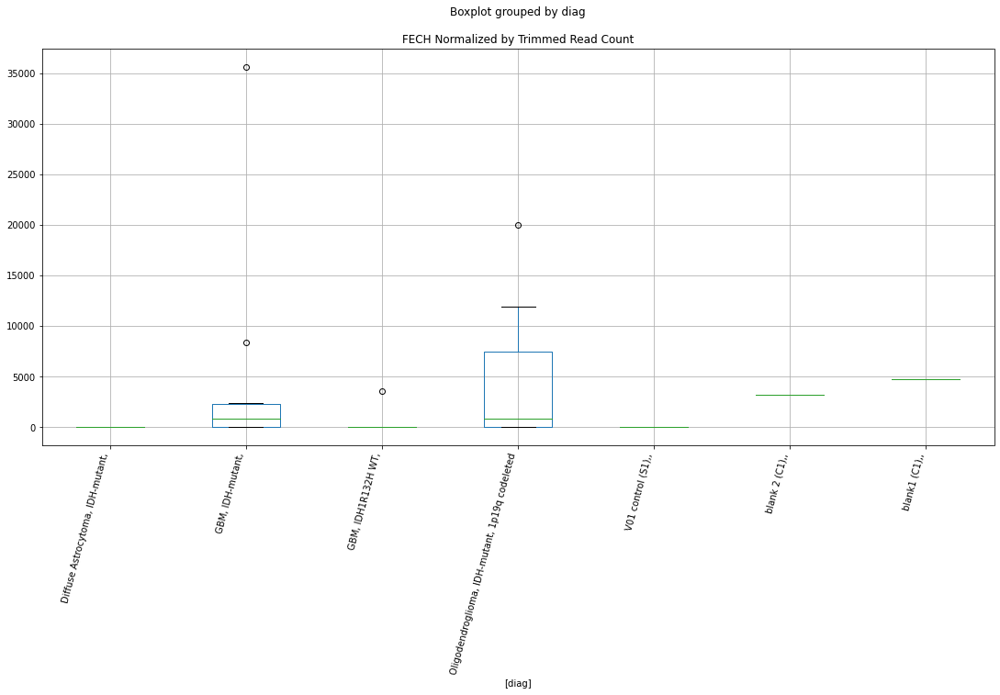

 p : 0.04666890888338876  ( t : 2.1360002032842678 ) :  D-plex  :  bbduk2  :  LDB3
Control and blanks
73     0.0
337    0.0
Name: LDB3, dtype: float64
205    6447.27
Name: LDB3, dtype: float64
469    7098.33
Name: LDB3, dtype: float64


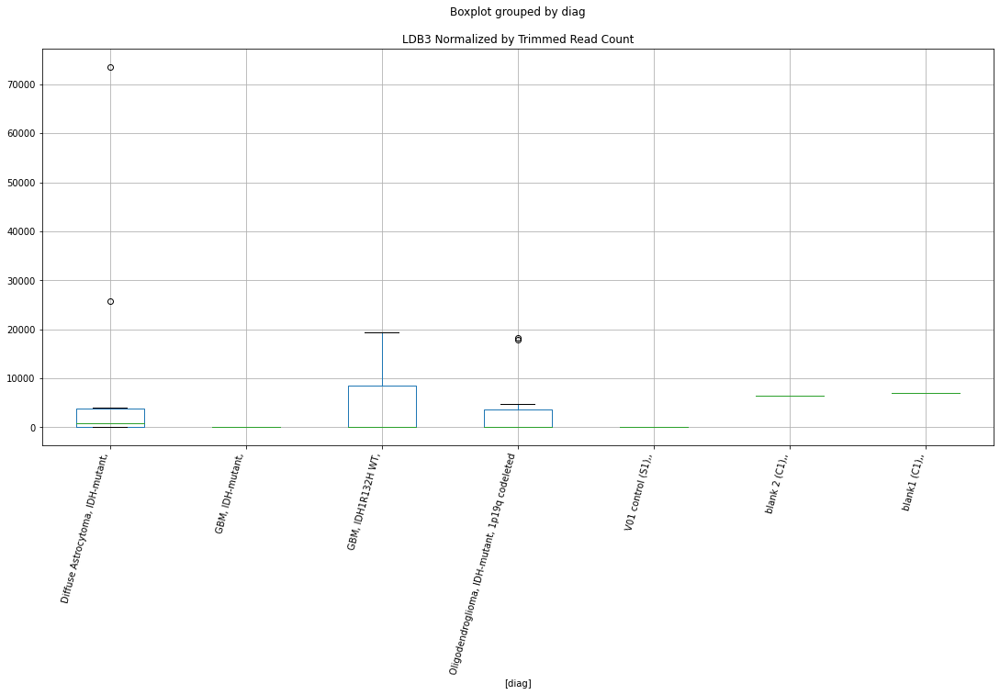

 p : 0.0466704743570014  ( t : 2.1359831888688343 ) :  D-plex  :  cutadapt2  :  ITGA2
Control and blanks
76     0.0
340    0.0
Name: ITGA2, dtype: float64
208    881.8
Name: ITGA2, dtype: float64
472    2889.78
Name: ITGA2, dtype: float64


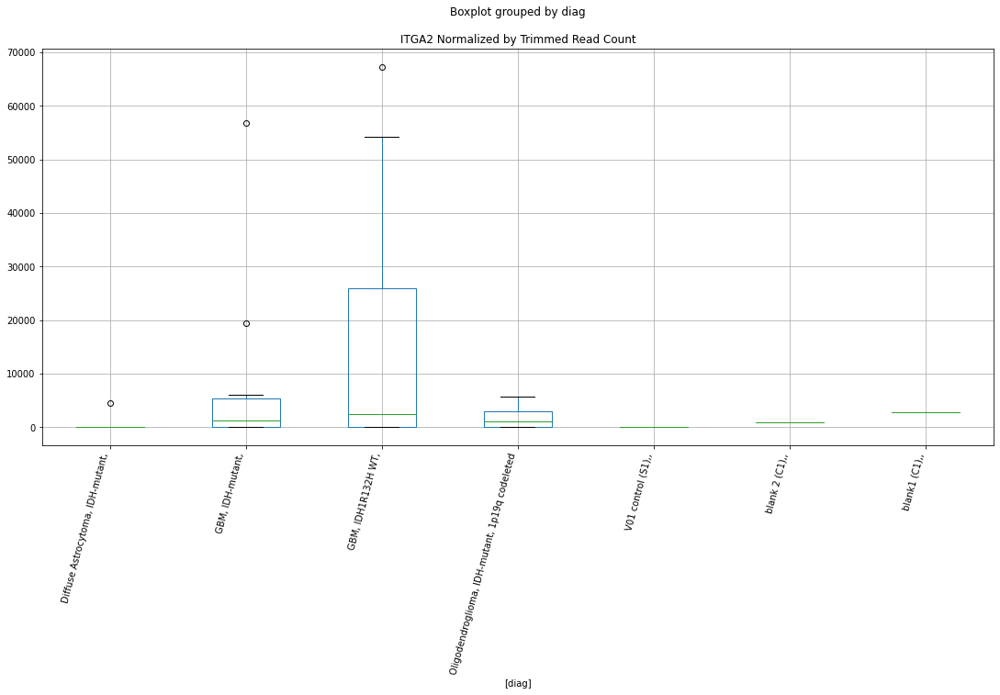

 p : 0.046680271512932185  ( t : 2.135876719894637 ) :  D-plex  :  bbduk2  :  HCN1
Control and blanks
73     1546.02
337       0.00
Name: HCN1, dtype: float64
205    26863.64
Name: HCN1, dtype: float64
469    591.53
Name: HCN1, dtype: float64


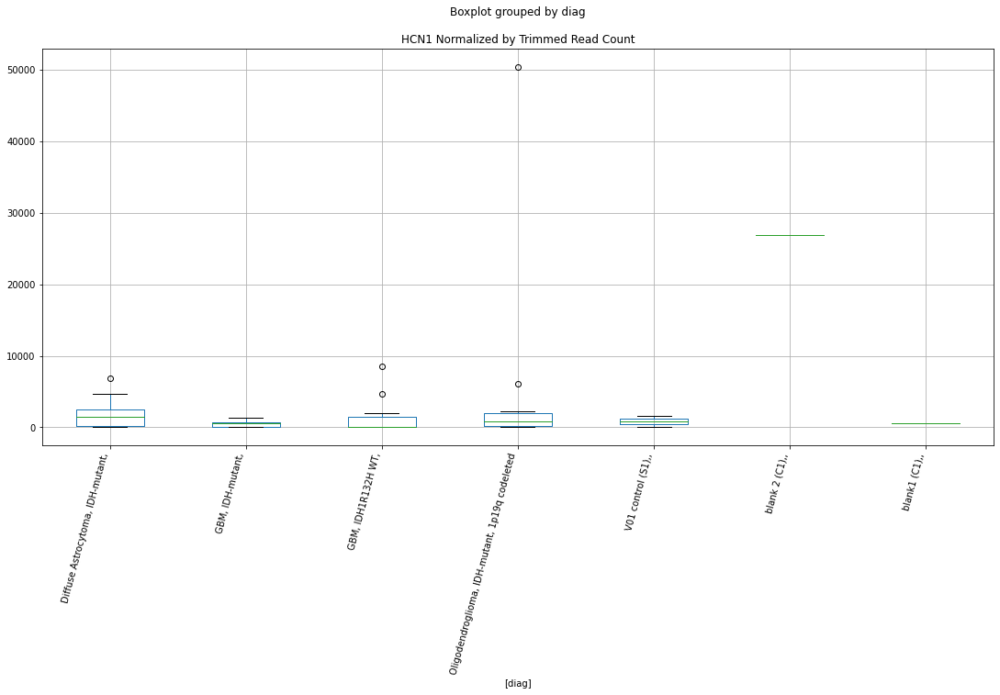

 p : 0.04670906194595882  ( t : 2.1355639625593743 ) :  D-plex  :  cutadapt2  :  EFNB2
Control and blanks
76     3788.07
340       0.00
Name: EFNB2, dtype: float64
208    6701.69
Name: EFNB2, dtype: float64
472    5201.6
Name: EFNB2, dtype: float64


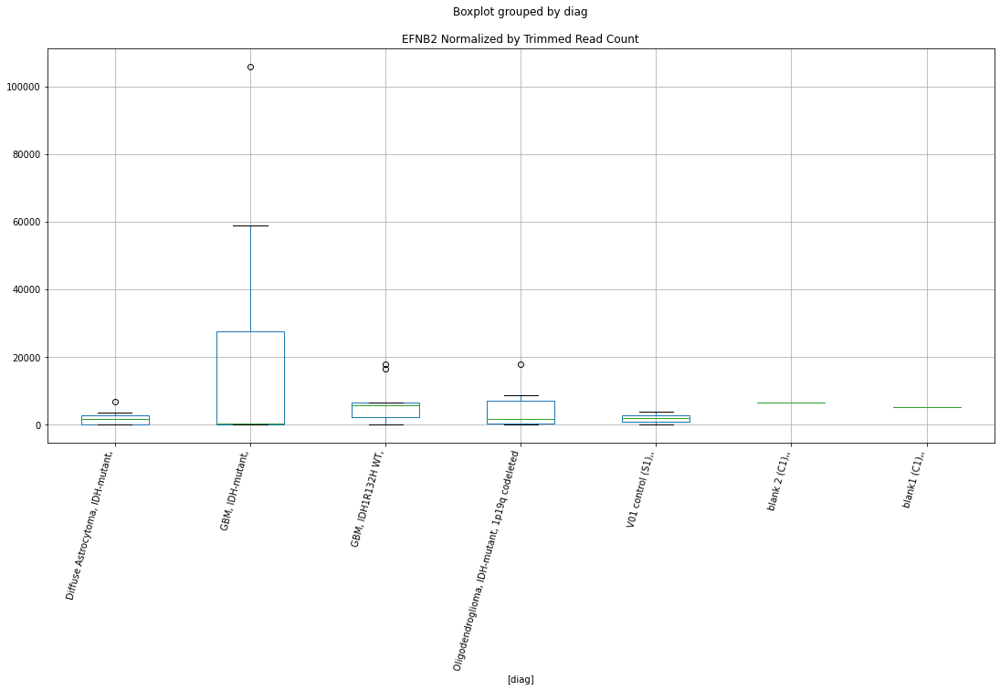

 p : 0.046819752728365506  ( t : 2.134363137851483 ) :  D-plex  :  bbduk2  :  DNAJC3
Control and blanks
73       3865.04
337    106818.87
Name: DNAJC3, dtype: float64
205    5910.0
Name: DNAJC3, dtype: float64
469    5915.27
Name: DNAJC3, dtype: float64


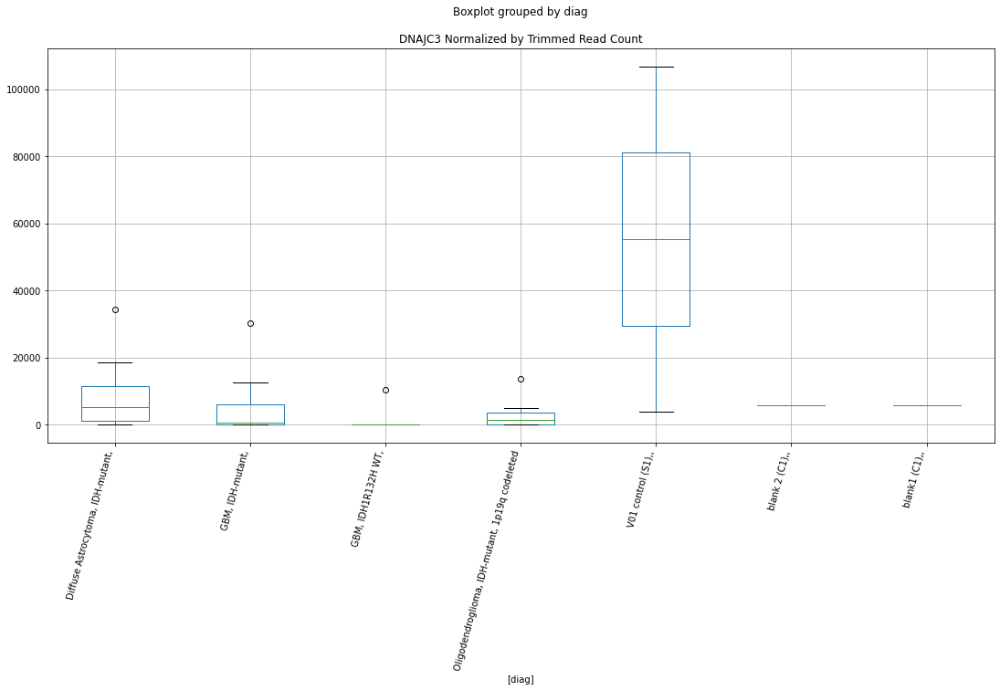

 p : 0.04682178904158637  ( t : 2.1343410712557347 ) :  D-plex  :  bbduk2  :  DUSP28
Control and blanks
73     3092.03
337       0.00
Name: DUSP28, dtype: float64
205    1074.55
Name: DUSP28, dtype: float64
469    0.0
Name: DUSP28, dtype: float64


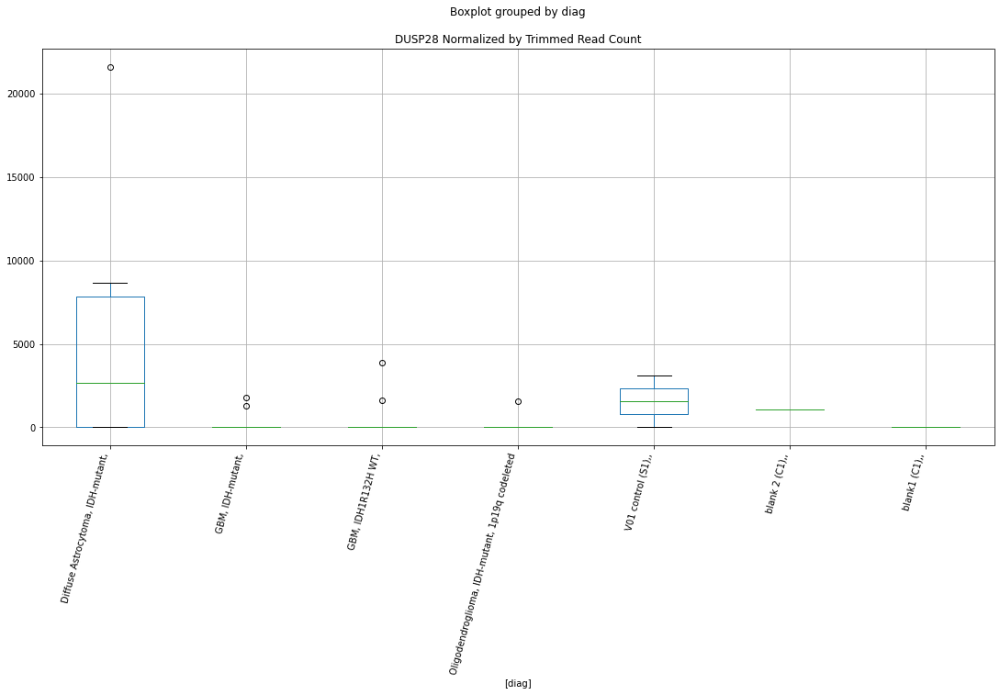

 p : 0.04686266923515068  ( t : 2.133898256379154 ) :  D-plex  :  cutadapt2  :  KCNH4
Control and blanks
76     109854.06
340      2642.20
Name: KCNH4, dtype: float64
208    30510.32
Name: KCNH4, dtype: float64
472    39878.95
Name: KCNH4, dtype: float64


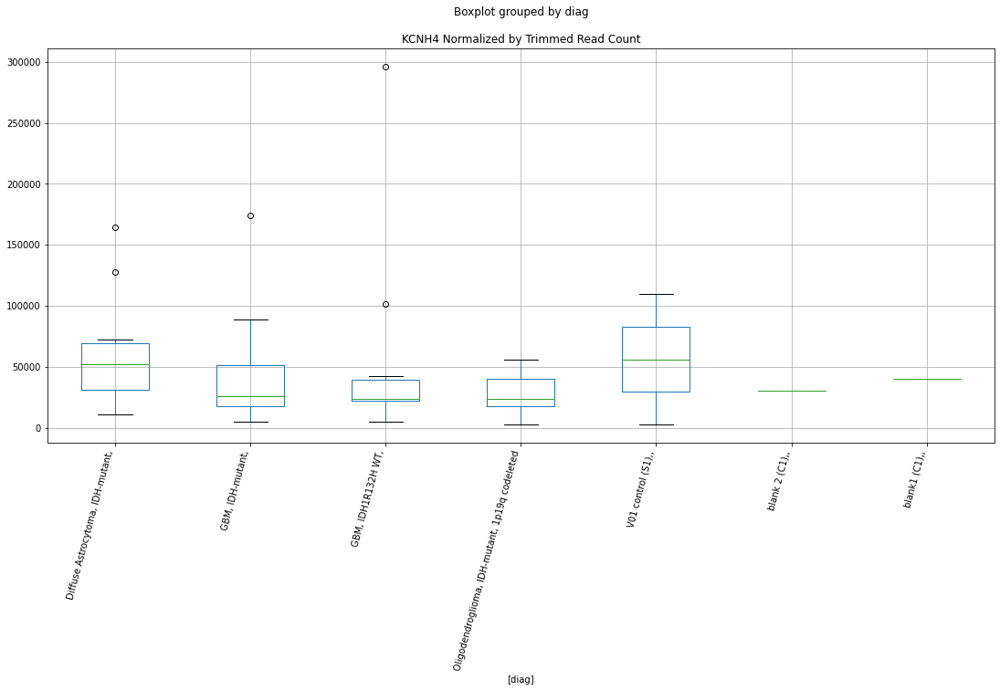

 p : 0.04687310132141445  ( t : 2.133785312295572 ) :  D-plex  :  cutadapt2  :  HCFC1R1
Control and blanks
76     252285.53
340         0.00
Name: HCFC1R1, dtype: float64
208    2645.4
Name: HCFC1R1, dtype: float64
472    8669.34
Name: HCFC1R1, dtype: float64


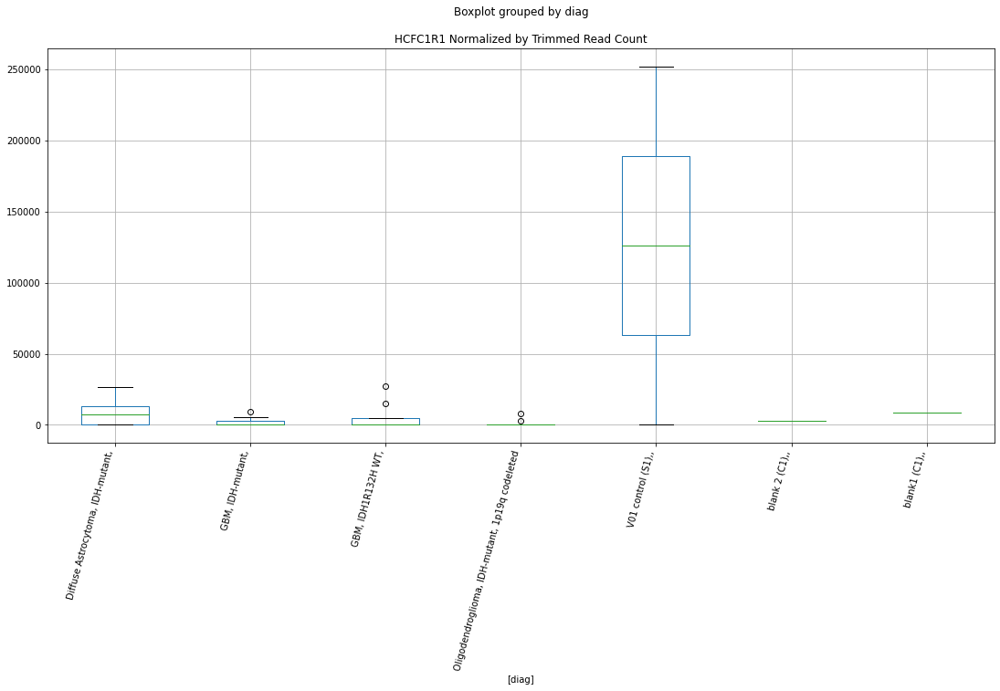

 p : 0.04687377932847475  ( t : 2.1337779725740895 ) :  D-plex  :  bbduk2  :  EPN1
Control and blanks
73     13141.14
337    17803.15
Name: EPN1, dtype: float64
205    194134.59
Name: EPN1, dtype: float64
469    42589.97
Name: EPN1, dtype: float64


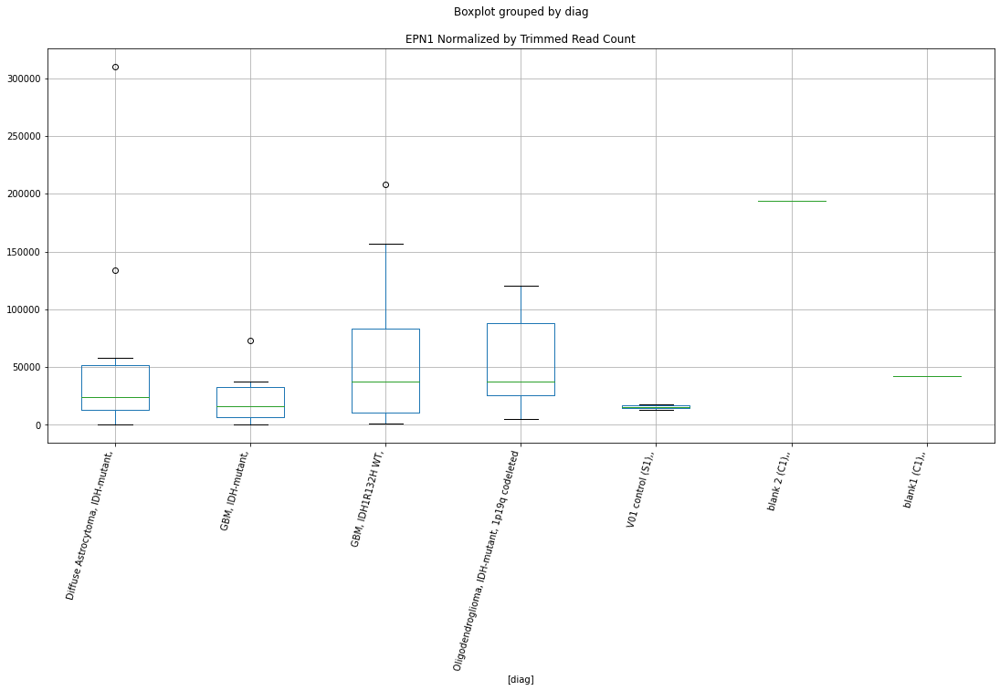

 p : 0.046878284028413764  ( t : 2.133729209695864 ) :  D-plex  :  cutadapt2  :  HLF
Control and blanks
76     93944.16
340    45798.07
Name: HLF, dtype: float64
208    8641.65
Name: HLF, dtype: float64
472    16760.72
Name: HLF, dtype: float64


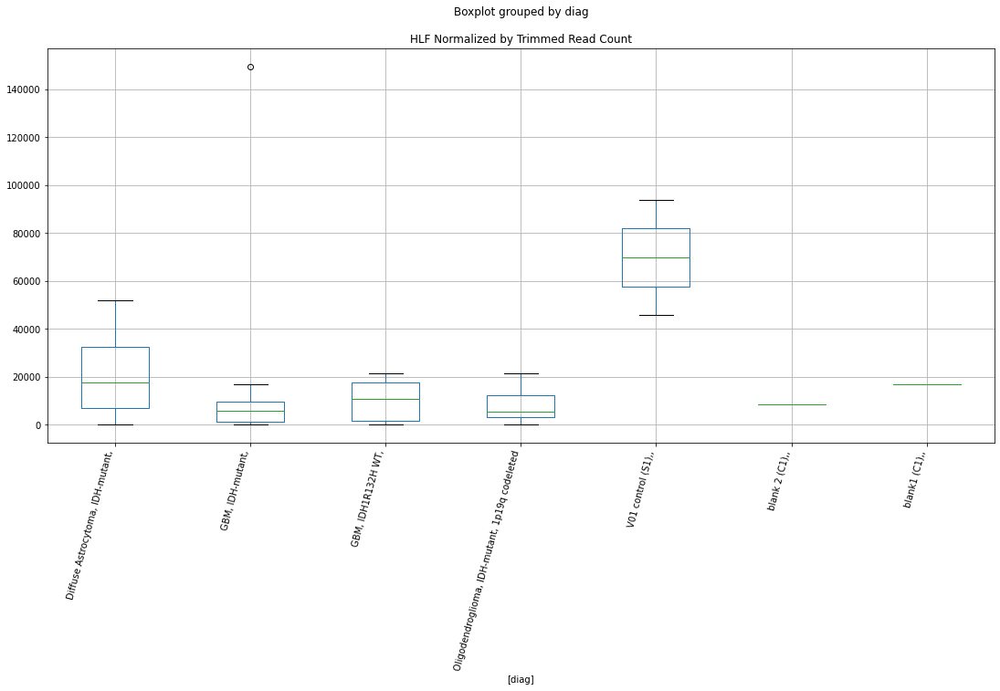

 p : 0.04688893797727832  ( t : 2.133613898884778 ) :  D-plex  :  cutadapt2  :  FAM178B
Control and blanks
76     0.0
340    0.0
Name: FAM178B, dtype: float64
208    4232.65
Name: FAM178B, dtype: float64
472    0.0
Name: FAM178B, dtype: float64


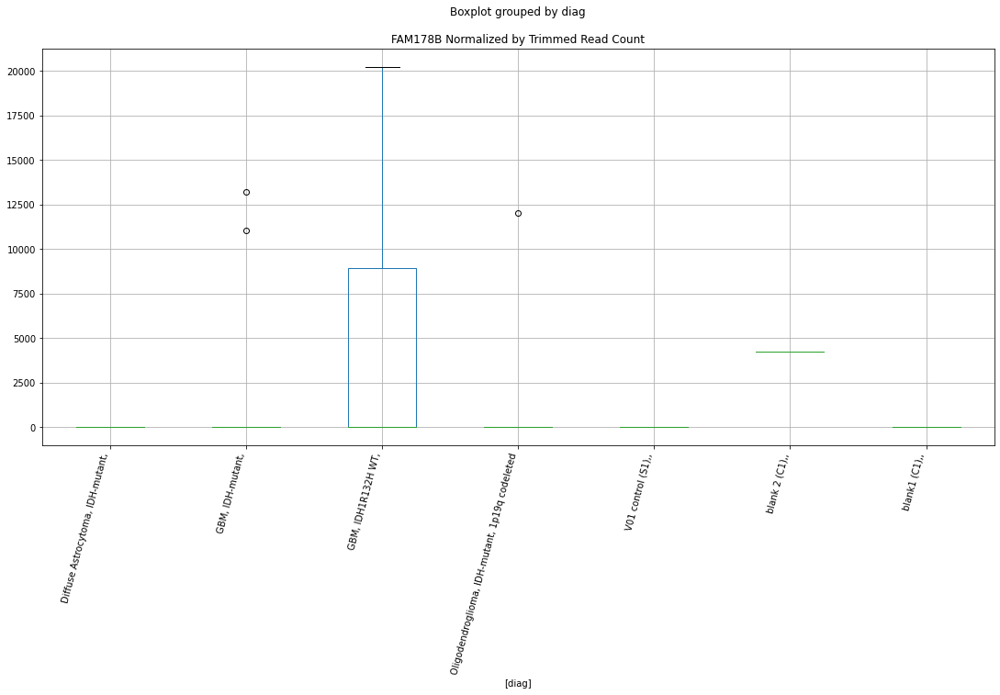

 p : 0.04691114422275365  ( t : 2.1333736309801004 ) :  D-plex  :  bbduk2  :  ITGA2
Control and blanks
73     0.0
337    0.0
Name: ITGA2, dtype: float64
205    1970.0
Name: ITGA2, dtype: float64
469    2957.64
Name: ITGA2, dtype: float64


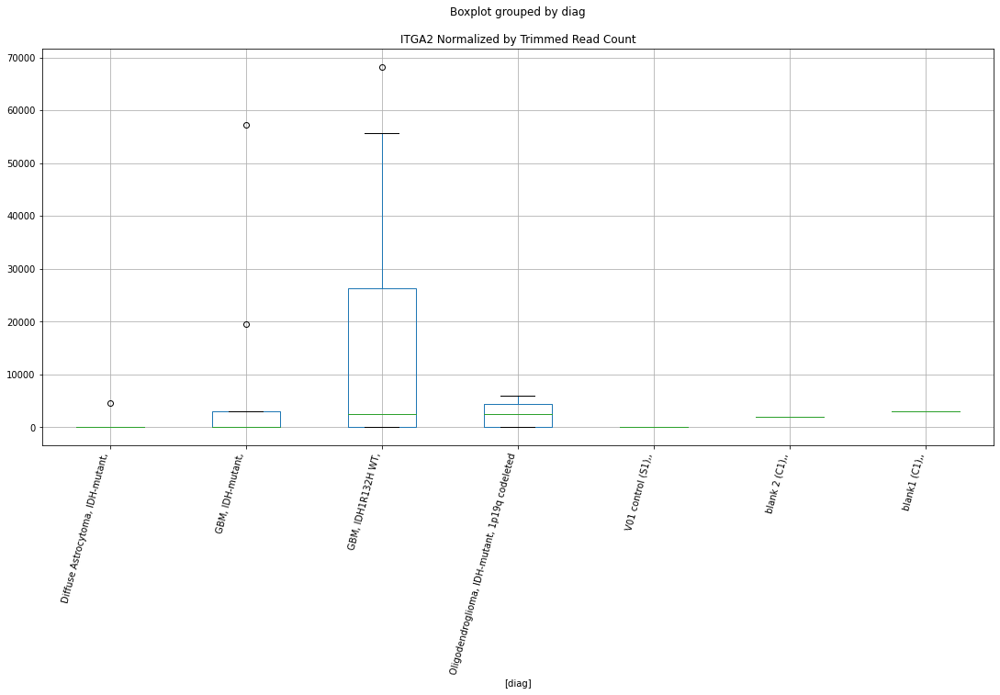

 p : 0.04691694284811677  ( t : 2.133310907894063 ) :  Lexogen  :  cutadapt2  :  KIAA0895
Control and blanks
82     0.0
346    0.0
Name: KIAA0895, dtype: float64
214    0.0
Name: KIAA0895, dtype: float64
478    0.0
Name: KIAA0895, dtype: float64


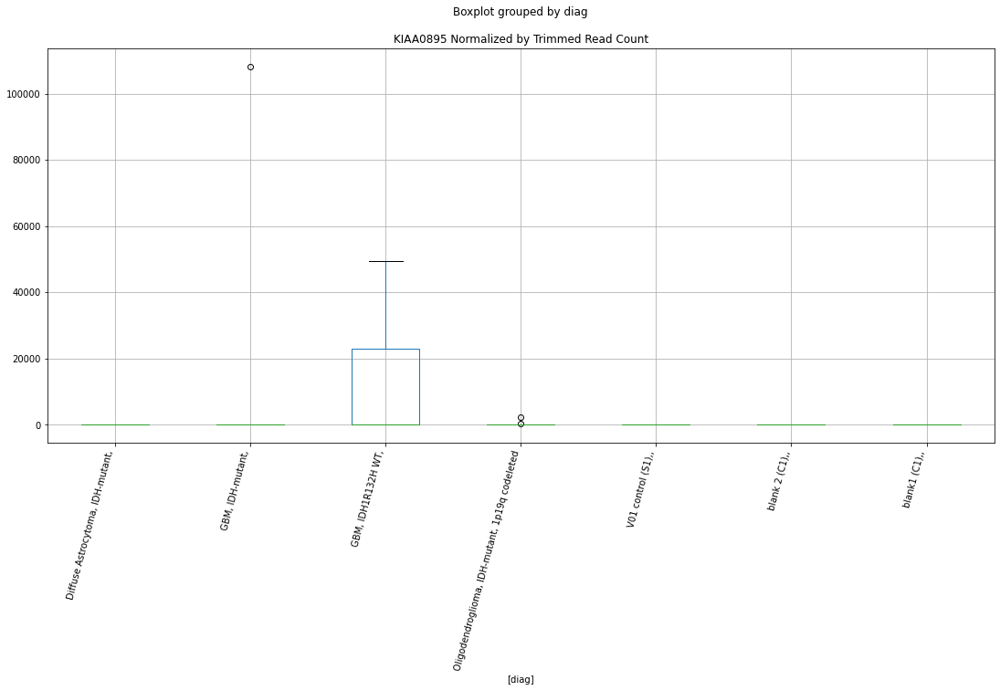

 p : 0.04702853966243578  ( t : 2.132105152958393 ) :  Lexogen  :  bbduk2  :  EHD2
Control and blanks
79       0.00
343    212.31
Name: EHD2, dtype: float64
211    546.61
Name: EHD2, dtype: float64
475    0.0
Name: EHD2, dtype: float64


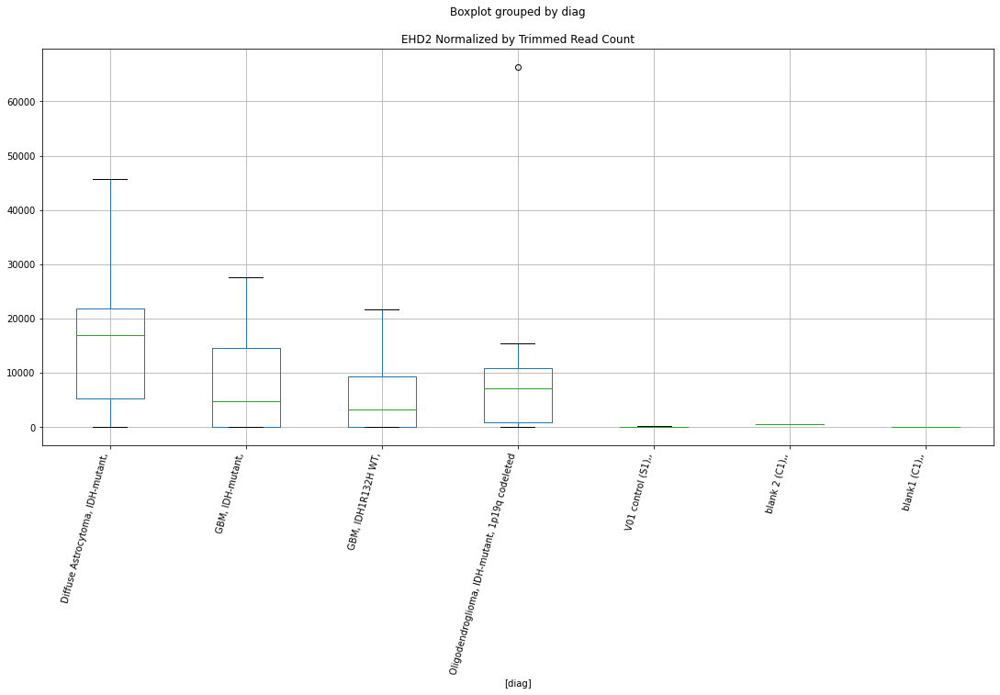

 p : 0.04705865992053259  ( t : 2.1317801639105807 ) :  D-plex  :  cutadapt2  :  DNAH17
Control and blanks
76        0.00
340    8807.32
Name: DNAH17, dtype: float64
208    136150.09
Name: DNAH17, dtype: float64
472    34677.35
Name: DNAH17, dtype: float64


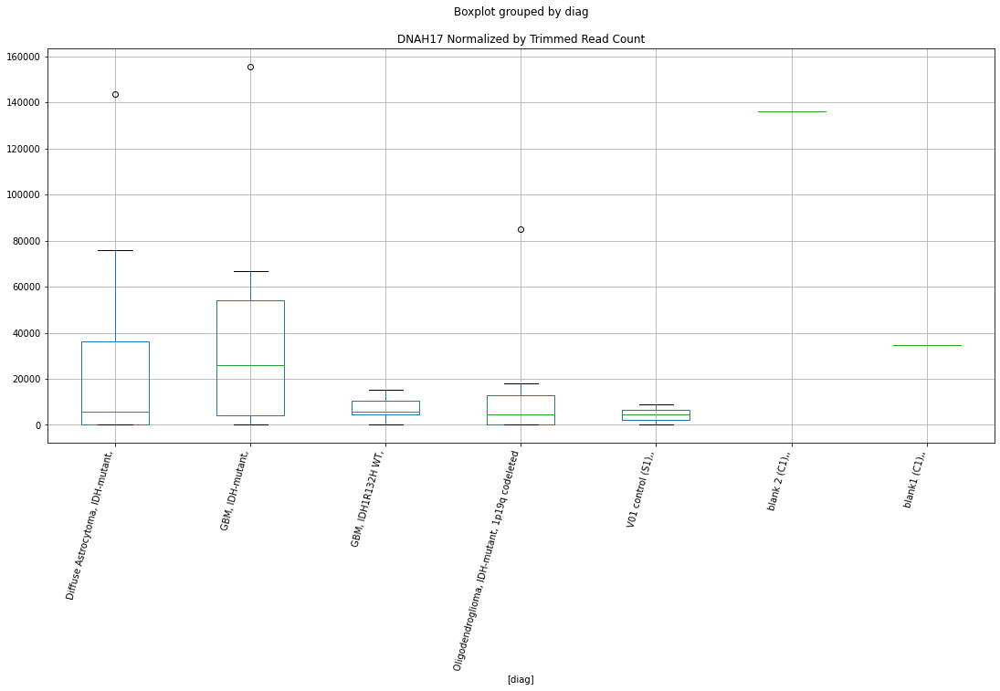

 p : 0.047073312031673274  ( t : 2.1316221403640294 ) :  D-plex  :  cutadapt2  :  GABRB3
Control and blanks
76     0.0
340    0.0
Name: GABRB3, dtype: float64
208    11639.77
Name: GABRB3, dtype: float64
472    7513.43
Name: GABRB3, dtype: float64


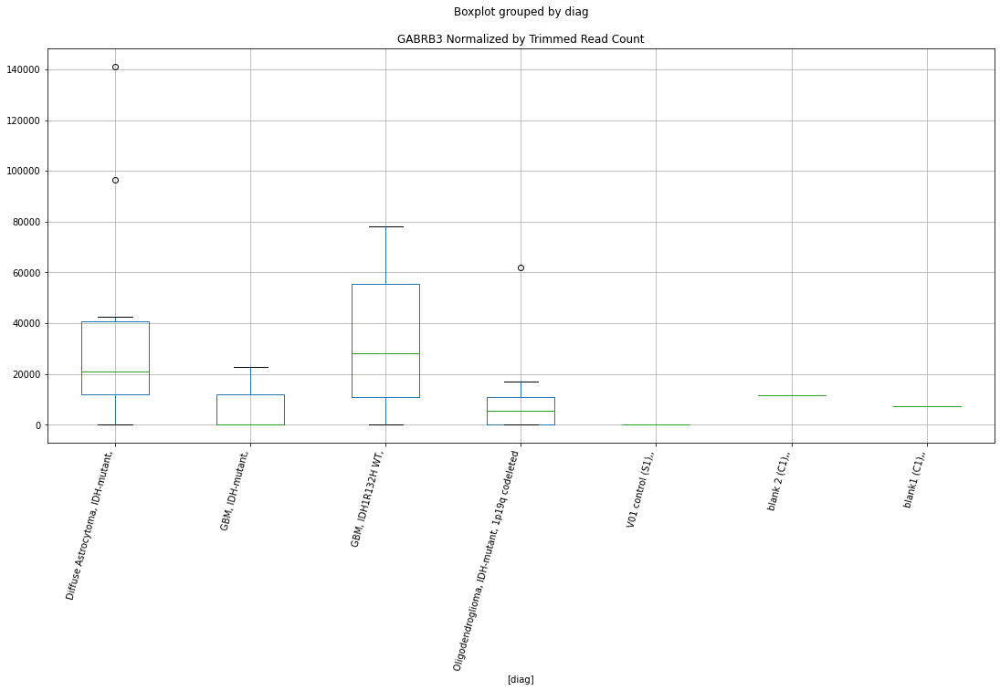

 p : 0.04718061123570267  ( t : 2.1304662796365945 ) :  Lexogen  :  cutadapt2  :  FAM199X
Control and blanks
82     0.0
346    0.0
Name: FAM199X, dtype: float64
214    0.0
Name: FAM199X, dtype: float64
478    0.0
Name: FAM199X, dtype: float64


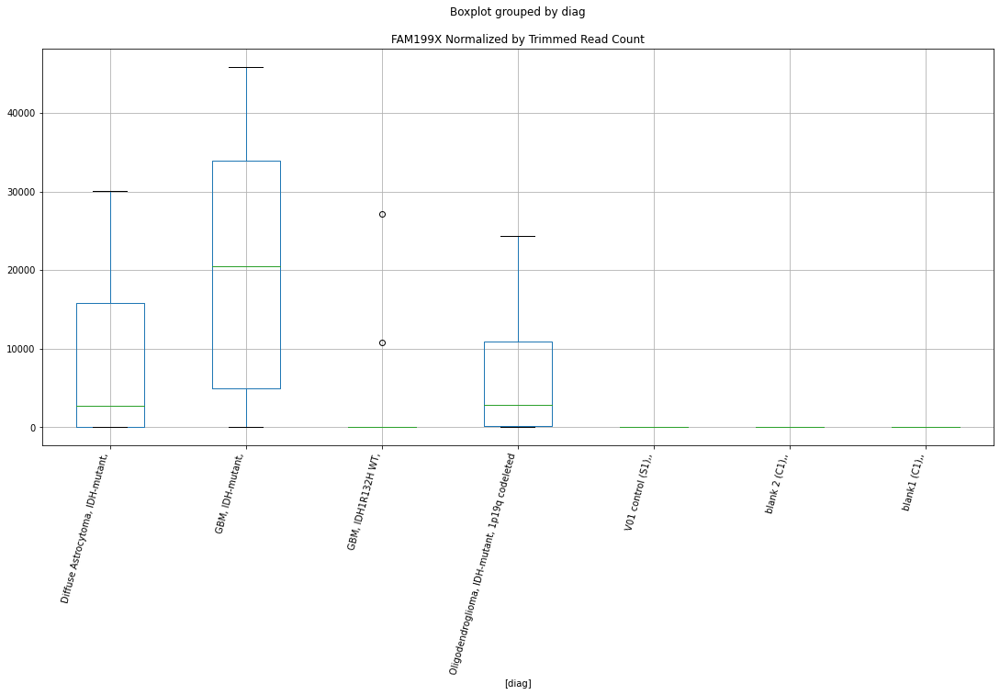

 p : 0.047189242399553966  ( t : 2.1303734062231072 ) :  Lexogen  :  bbduk2  :  FAM205A
Control and blanks
79     0.0
343    0.0
Name: FAM205A, dtype: float64
211    0.0
Name: FAM205A, dtype: float64
475    0.0
Name: FAM205A, dtype: float64


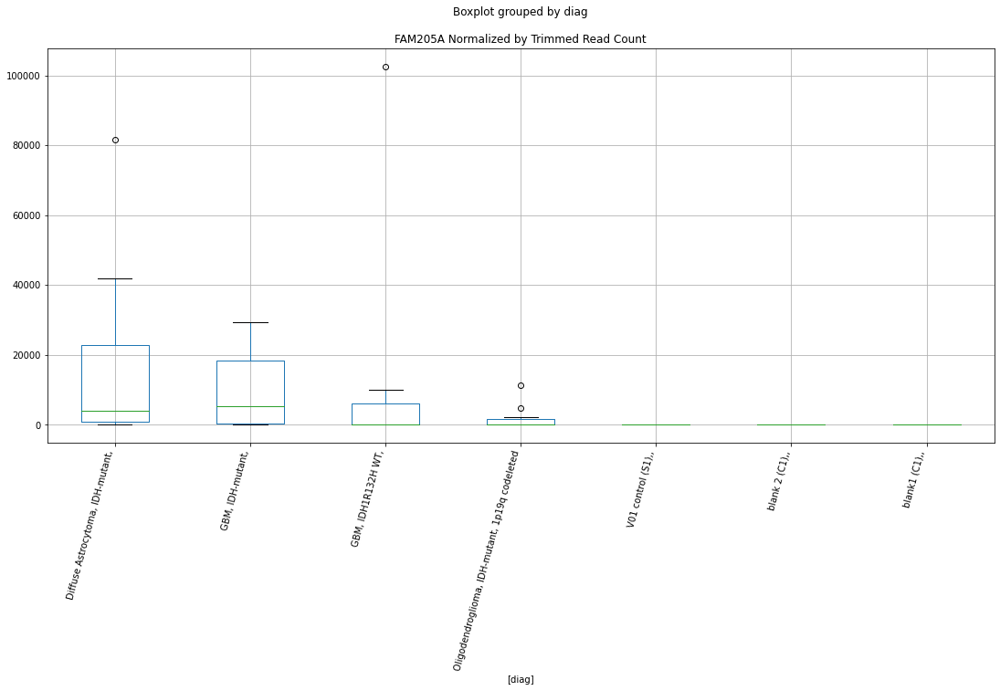

 p : 0.04723927413919972  ( t : 2.129835357506842 ) :  Lexogen  :  bbduk2  :  IRF7
Control and blanks
79     0.0
343    0.0
Name: IRF7, dtype: float64
211    0.0
Name: IRF7, dtype: float64
475    0.0
Name: IRF7, dtype: float64


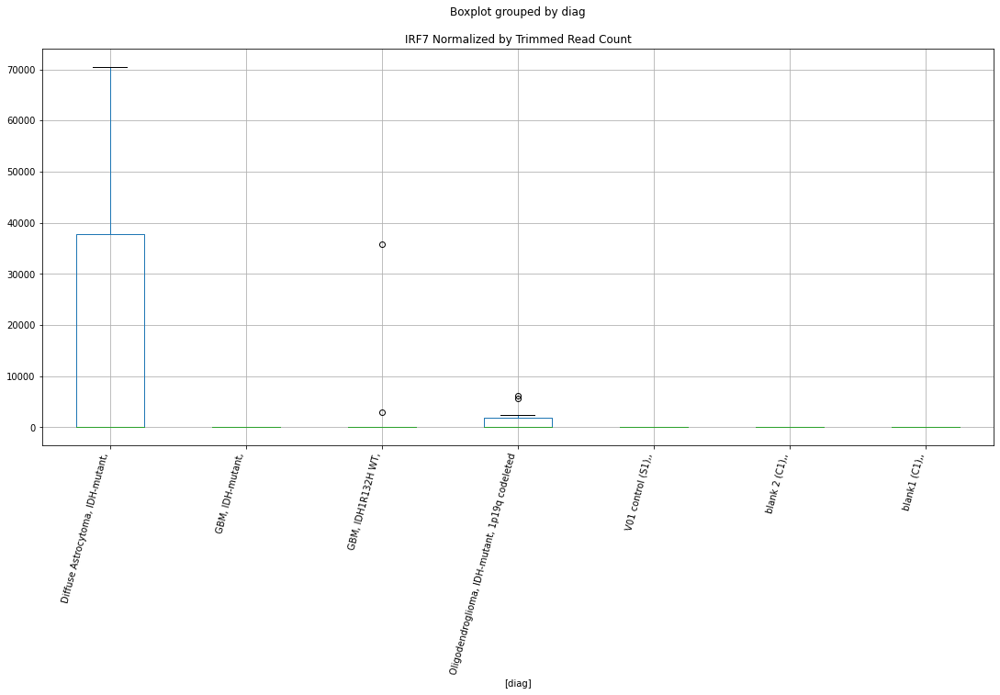

 p : 0.04724182476128671  ( t : 2.12980794166202 ) :  Lexogen  :  bbduk2  :  IQSEC3
Control and blanks
79     0.0
343    0.0
Name: IQSEC3, dtype: float64
211    0.0
Name: IQSEC3, dtype: float64
475    0.0
Name: IQSEC3, dtype: float64


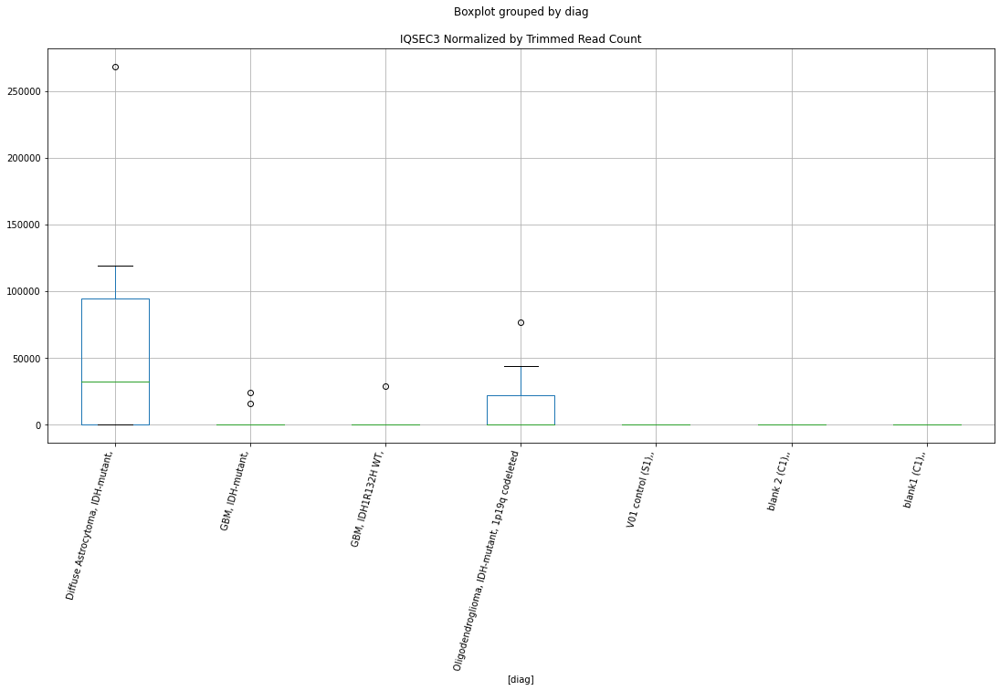

 p : 0.04725316784683865  ( t : 2.1296860347020563 ) :  D-plex  :  cutadapt2  :  FRRS1L
Control and blanks
76     757.61
340      0.00
Name: FRRS1L, dtype: float64
208    0.0
Name: FRRS1L, dtype: float64
472    577.96
Name: FRRS1L, dtype: float64


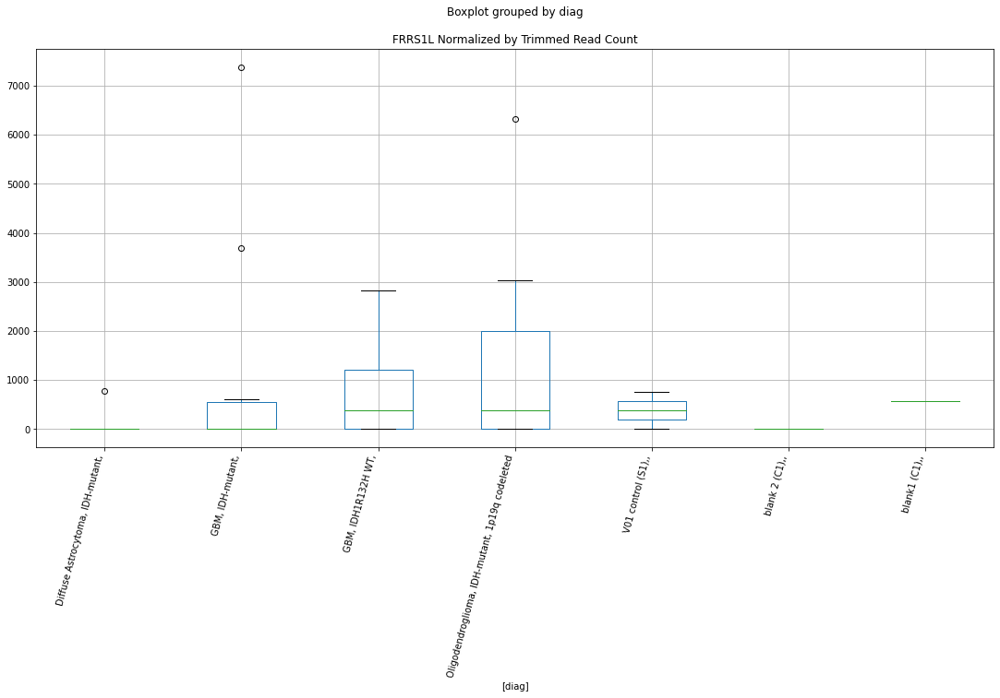

 p : 0.047253524560224275  ( t : 2.1296822014473804 ) :  Lexogen  :  cutadapt2  :  IRF7
Control and blanks
82     0.0
346    0.0
Name: IRF7, dtype: float64
214    0.0
Name: IRF7, dtype: float64
478    0.0
Name: IRF7, dtype: float64


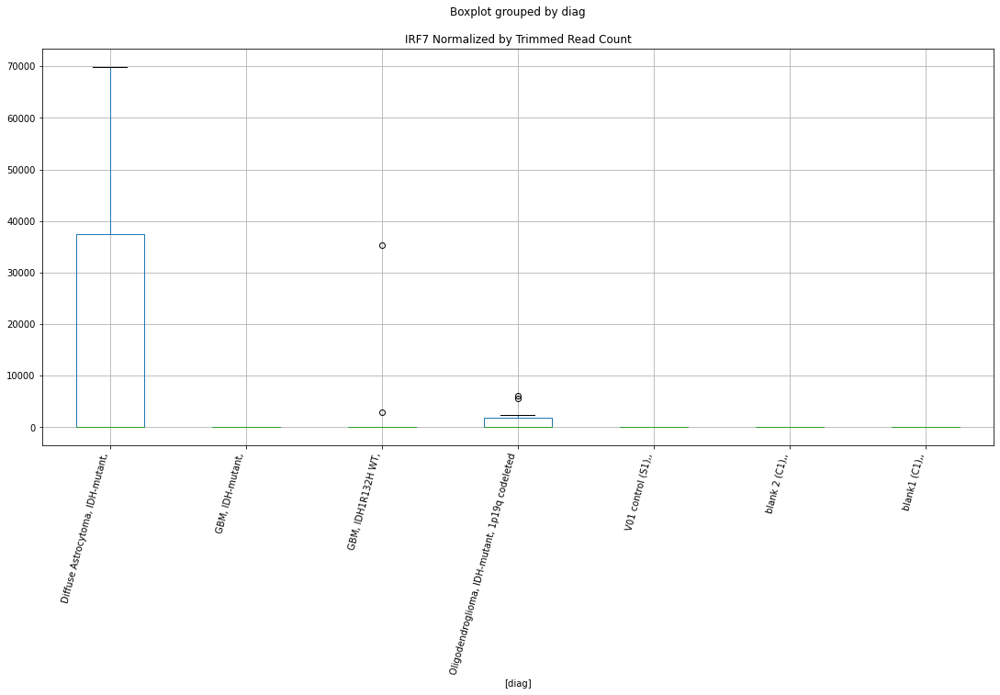

 p : 0.04728305859558589  ( t : 2.129364919141907 ) :  Lexogen  :  cutadapt2  :  KCNH4
Control and blanks
82     0.0
346    0.0
Name: KCNH4, dtype: float64
214    0.0
Name: KCNH4, dtype: float64
478    0.0
Name: KCNH4, dtype: float64


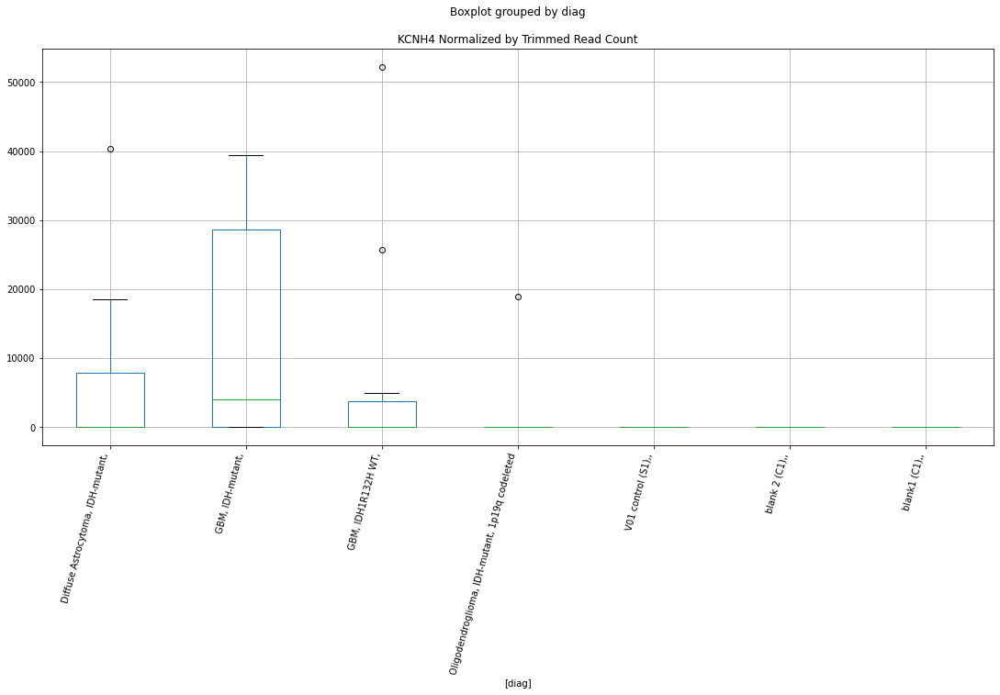

 p : 0.04730317695637522  ( t : 2.129148892290382 ) :  D-plex  :  cutadapt2  :  ERCC3
Control and blanks
76     0.0
340    0.0
Name: ERCC3, dtype: float64
208    1058.16
Name: ERCC3, dtype: float64
472    4045.69
Name: ERCC3, dtype: float64


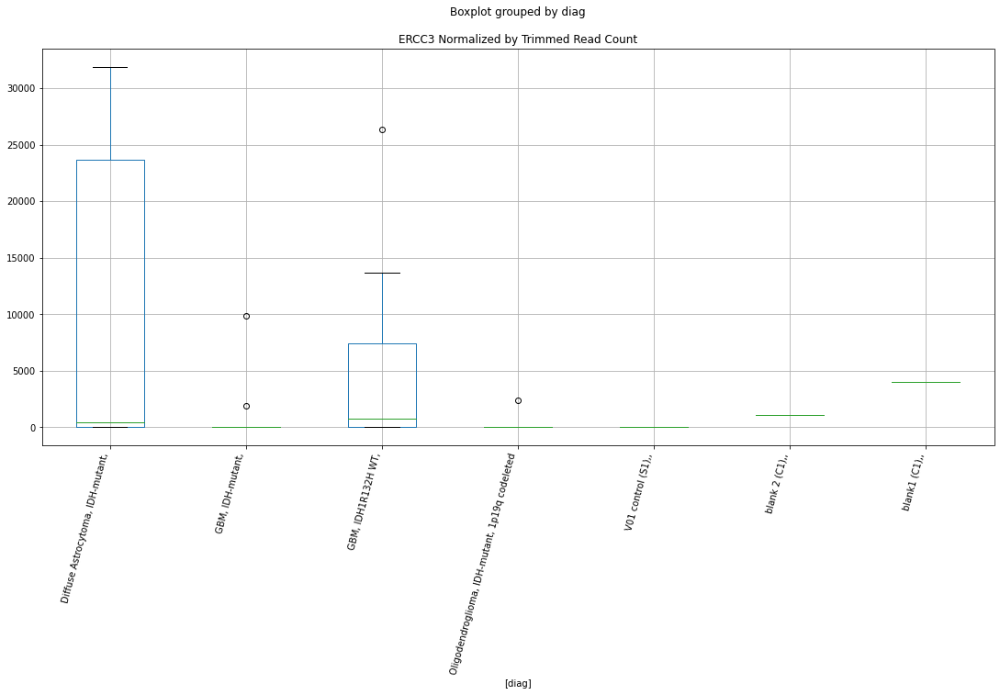

 p : 0.04732320186057161  ( t : 2.1289339521236523 ) :  Lexogen  :  bbduk2  :  GEMIN7
Control and blanks
79     31473.17
343        0.00
Name: GEMIN7, dtype: float64
211    0.0
Name: GEMIN7, dtype: float64
475    0.0
Name: GEMIN7, dtype: float64


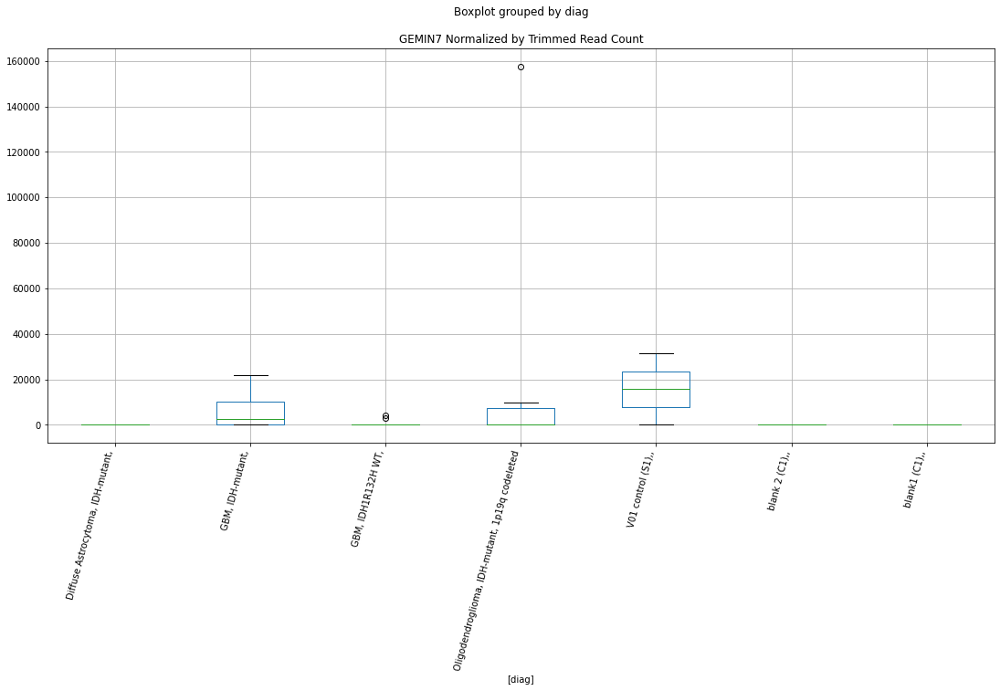

 p : 0.0473297016305939  ( t : 2.12886420373984 ) :  Lexogen  :  cutadapt2  :  GEMIN7
Control and blanks
82     31241.12
346        0.00
Name: GEMIN7, dtype: float64
214    0.0
Name: GEMIN7, dtype: float64
478    0.0
Name: GEMIN7, dtype: float64


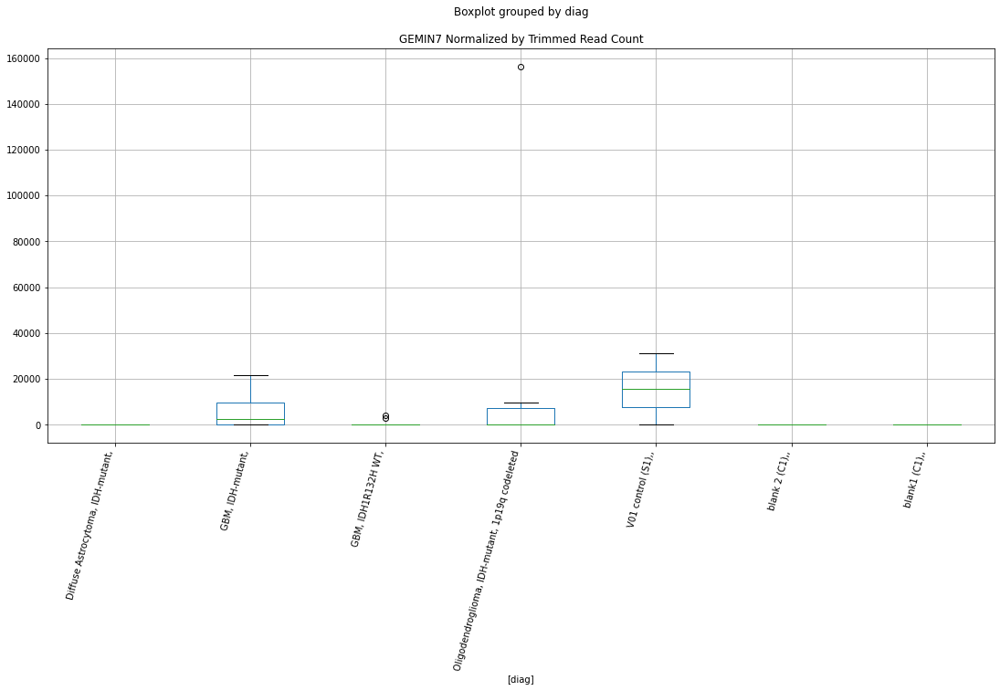

 p : 0.04735695469383187  ( t : 2.128571848872757 ) :  D-plex  :  cutadapt2  :  GDPD5
Control and blanks
76     0.0
340    0.0
Name: GDPD5, dtype: float64
208    12345.22
Name: GDPD5, dtype: float64
472    14448.9
Name: GDPD5, dtype: float64


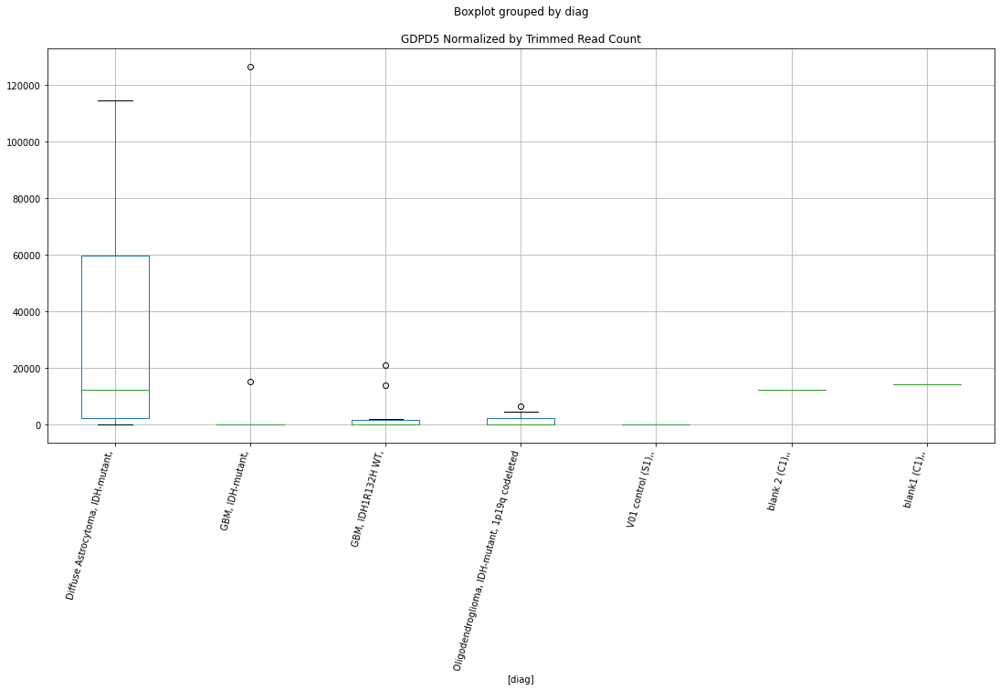

 p : 0.047509022401550575  ( t : 2.126943365816915 ) :  Lexogen  :  bbduk2  :  KCNH4
Control and blanks
79     0.0
343    0.0
Name: KCNH4, dtype: float64
211    1366.53
Name: KCNH4, dtype: float64
475    0.0
Name: KCNH4, dtype: float64


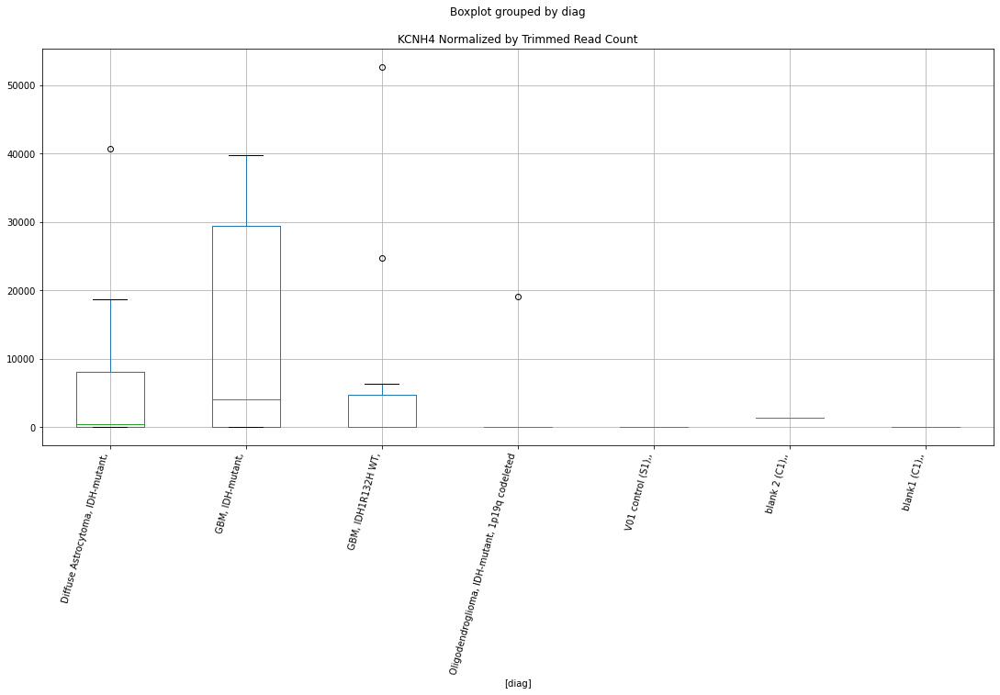

 p : 0.04762747771976622  ( t : 2.1256781243051686 ) :  D-plex  :  cutadapt2  :  EMILIN3
Control and blanks
76     0.0
340    0.0
Name: EMILIN3, dtype: float64
208    529.08
Name: EMILIN3, dtype: float64
472    0.0
Name: EMILIN3, dtype: float64


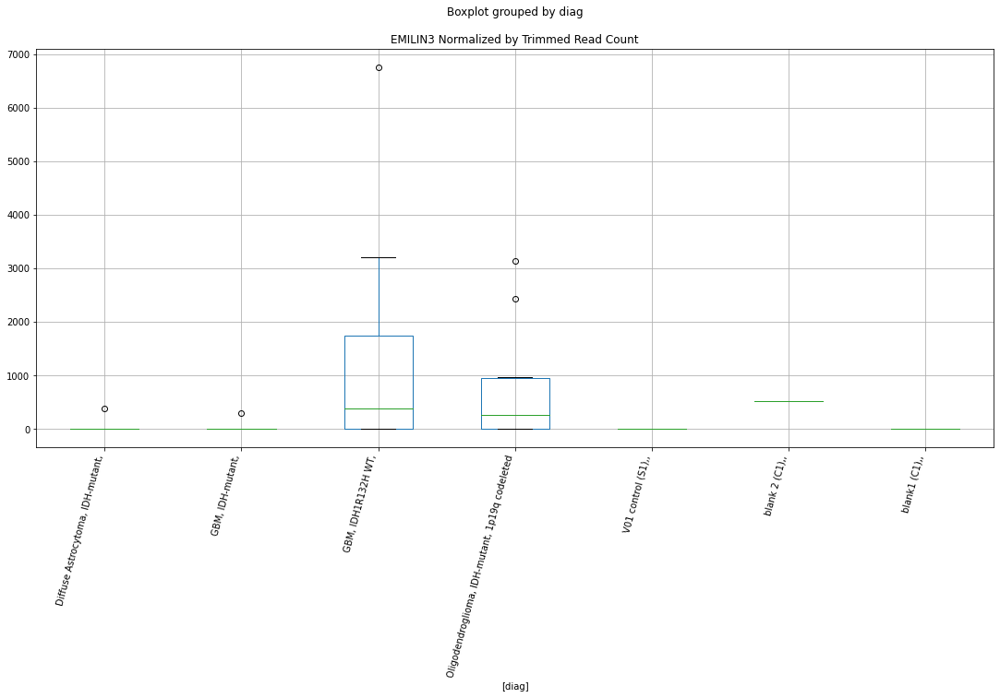

 p : 0.04763195563482675  ( t : 2.1256303512094656 ) :  D-plex  :  bbduk2  :  KRT6B
Control and blanks
73     0.0
337    0.0
Name: KRT6B, dtype: float64
205    179.09
Name: KRT6B, dtype: float64
469    591.53
Name: KRT6B, dtype: float64


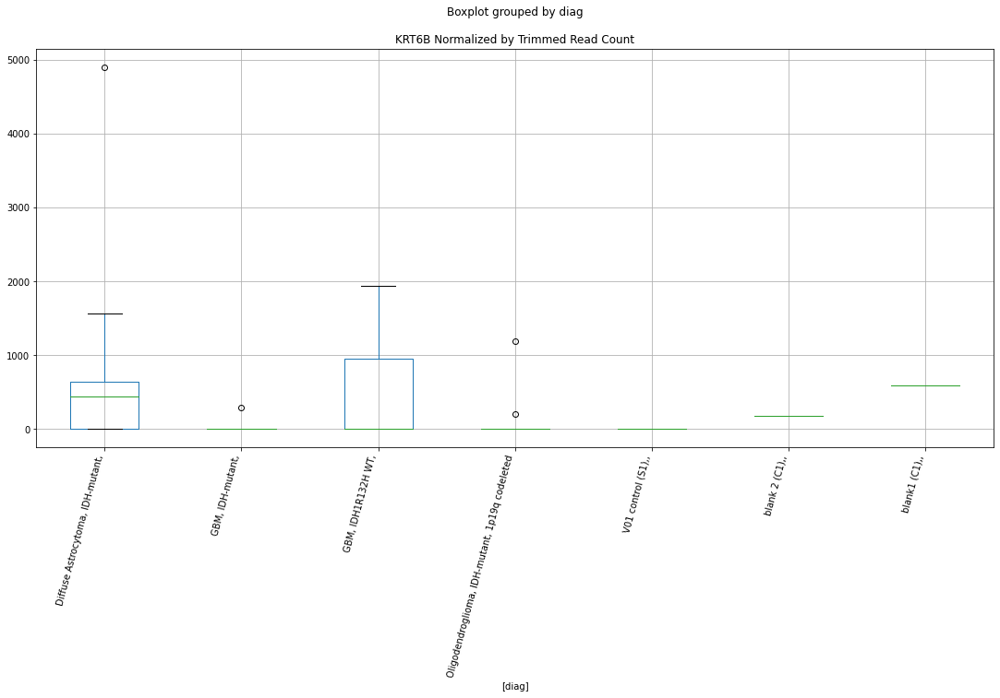

 p : 0.04767345176043873  ( t : 2.12518784014541 ) :  Lexogen  :  bbduk2  :  JMJD1C-AS1
Control and blanks
79     0.0
343    0.0
Name: JMJD1C-AS1, dtype: float64
211    1913.14
Name: JMJD1C-AS1, dtype: float64
475    0.0
Name: JMJD1C-AS1, dtype: float64


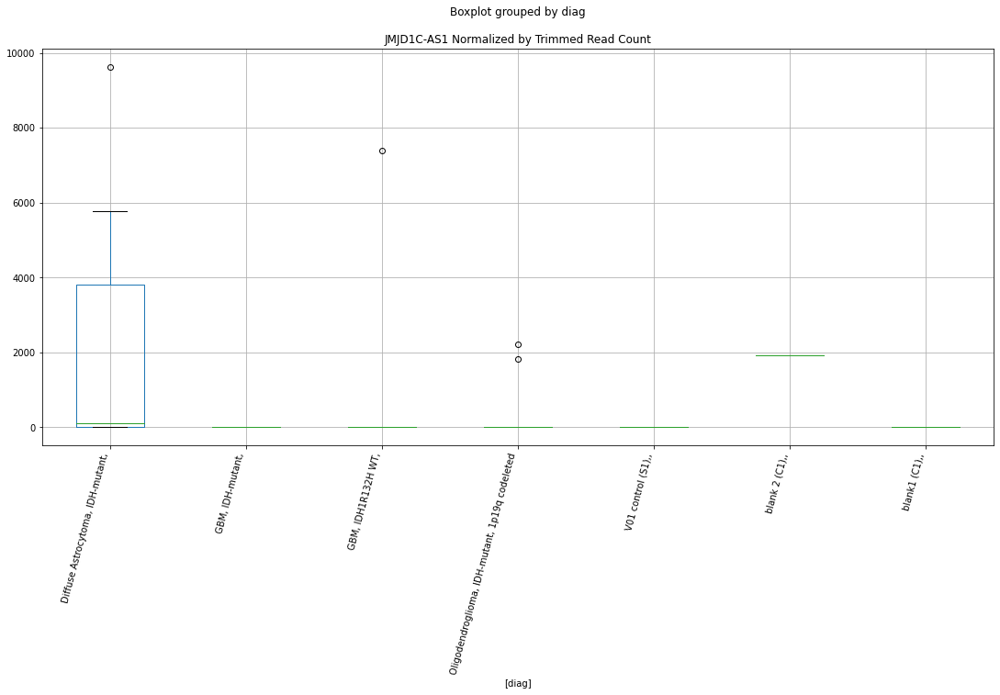

 p : 0.04771399260645934  ( t : 2.124755854958067 ) :  Lexogen  :  cutadapt2  :  JMJD1C-AS1
Control and blanks
82     0.0
346    0.0
Name: JMJD1C-AS1, dtype: float64
214    1898.59
Name: JMJD1C-AS1, dtype: float64
478    0.0
Name: JMJD1C-AS1, dtype: float64


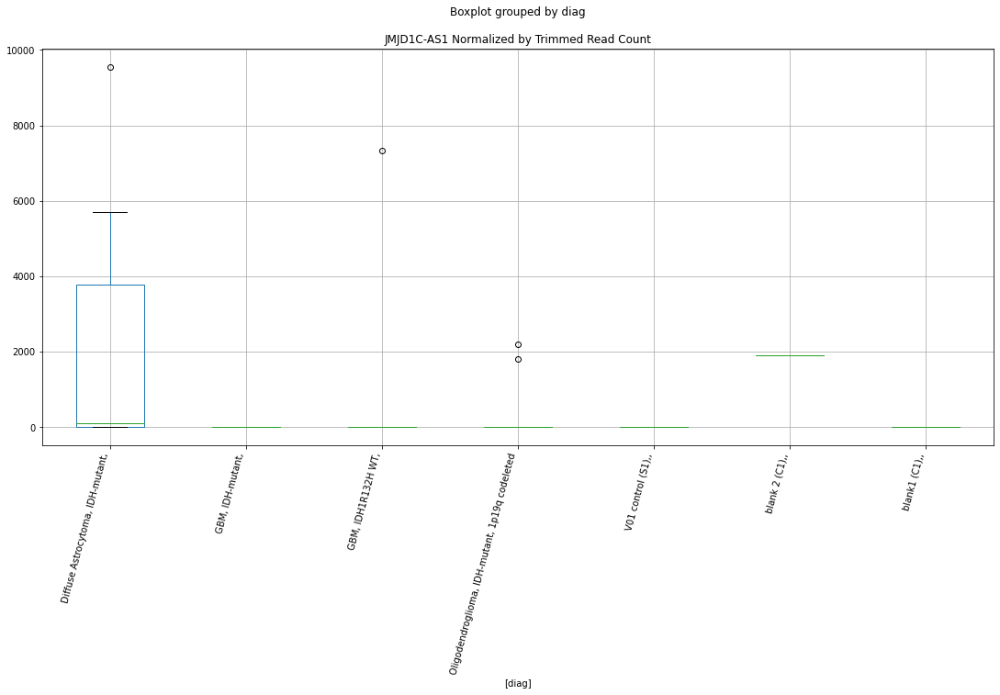

 p : 0.047716575364165584  ( t : 2.124728345577695 ) :  D-plex  :  cutadapt2  :  FBXL15
Control and blanks
76     0.0
340    0.0
Name: FBXL15, dtype: float64
208    3350.84
Name: FBXL15, dtype: float64
472    8669.34
Name: FBXL15, dtype: float64


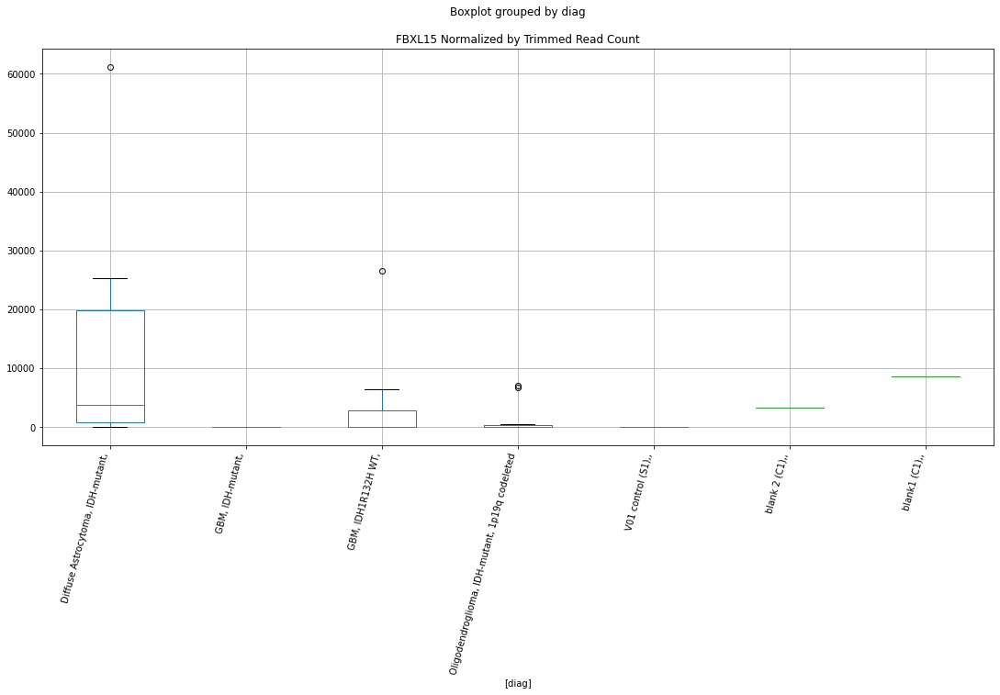

 p : 0.04771829582435033  ( t : 2.124710021424109 ) :  D-plex  :  bbduk2  :  GALNT13
Control and blanks
73     0.0
337    0.0
Name: GALNT13, dtype: float64
205    1970.0
Name: GALNT13, dtype: float64
469    6506.8
Name: GALNT13, dtype: float64


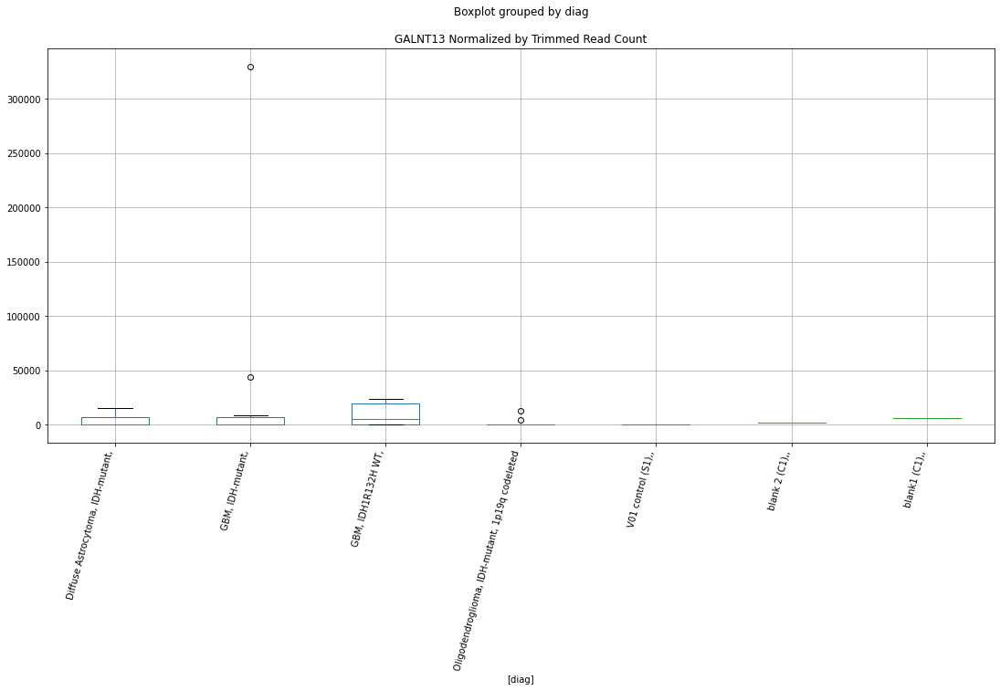

 p : 0.04774156284951376  ( t : 2.124462269773531 ) :  D-plex  :  cutadapt2  :  GIPC1
Control and blanks
76     307591.37
340         0.00
Name: GIPC1, dtype: float64
208    31215.76
Name: GIPC1, dtype: float64
472    14448.9
Name: GIPC1, dtype: float64


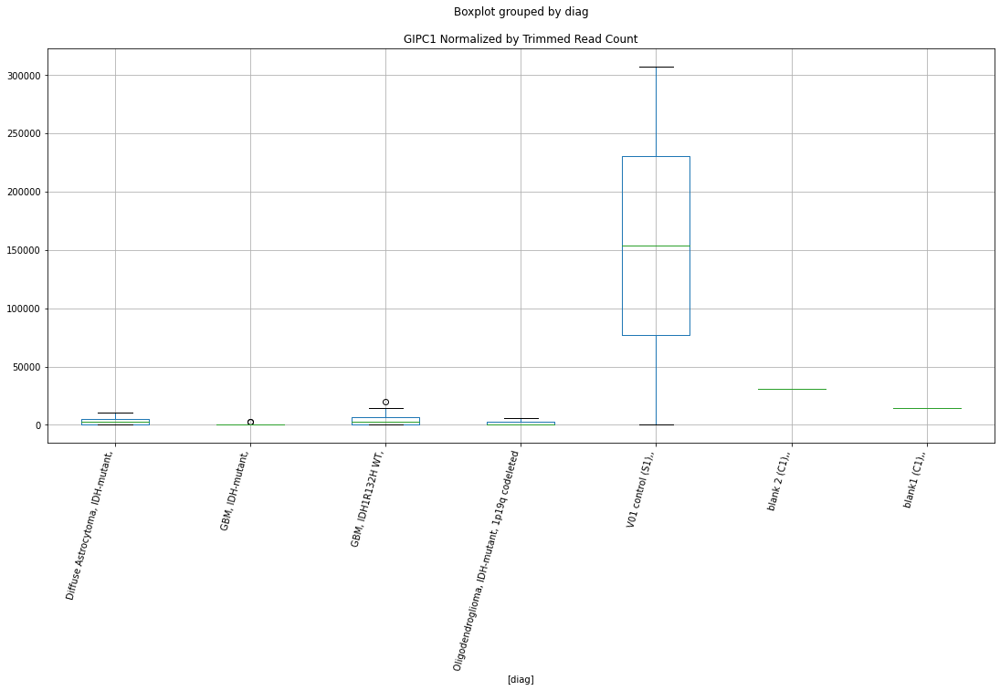

 p : 0.04779004999431155  ( t : 2.1239463229137474 ) :  D-plex  :  bbduk2  :  IRS4
Control and blanks
73     0.0
337    0.0
Name: IRS4, dtype: float64
205    3581.82
Name: IRS4, dtype: float64
469    6506.8
Name: IRS4, dtype: float64


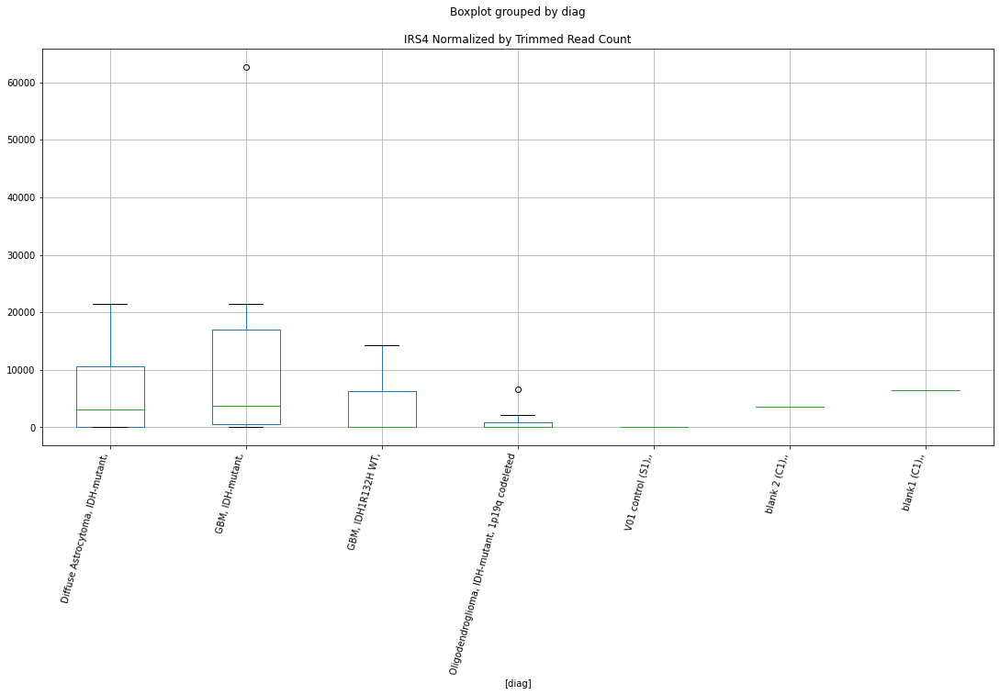

 p : 0.047795025685374505  ( t : 2.1238934040717905 ) :  D-plex  :  bbduk2  :  HNRNPC
Control and blanks
73     0.0
337    0.0
Name: HNRNPC, dtype: float64
205    23819.1
Name: HNRNPC, dtype: float64
469    0.0
Name: HNRNPC, dtype: float64


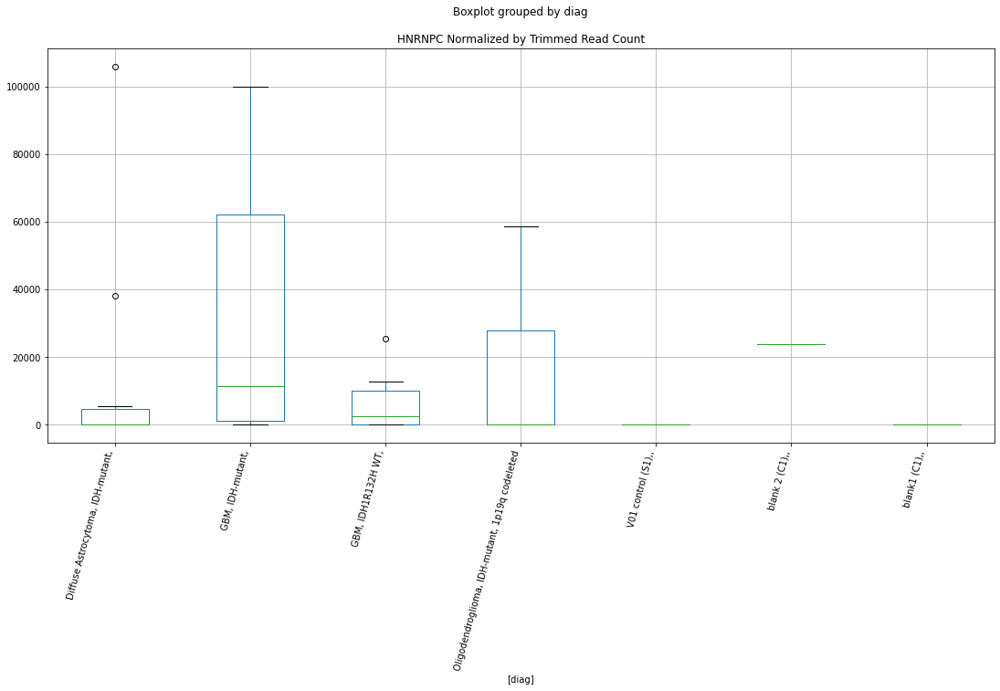

 p : 0.047844566497521564  ( t : 2.1233667875910522 ) :  D-plex  :  cutadapt2  :  HSPA2
Control and blanks
76     757.61
340    880.73
Name: HSPA2, dtype: float64
208    352.72
Name: HSPA2, dtype: float64
472    577.96
Name: HSPA2, dtype: float64


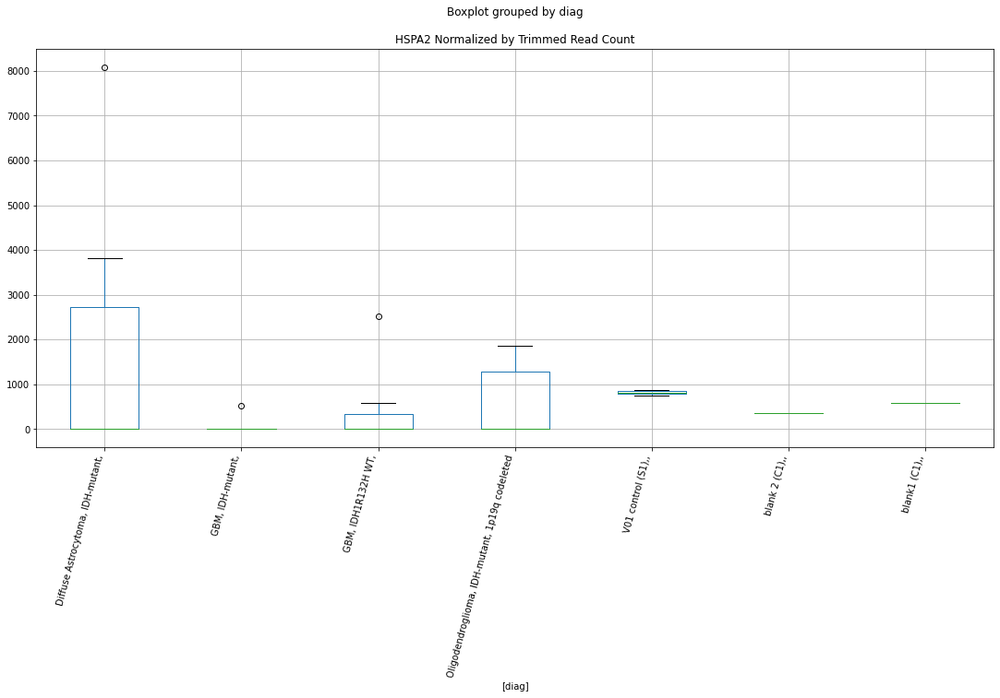

 p : 0.04786215264113422  ( t : 2.123179967203291 ) :  D-plex  :  cutadapt2  :  IQCE
Control and blanks
76     7576.14
340       0.00
Name: IQCE, dtype: float64
208    36859.29
Name: IQCE, dtype: float64
472    53749.89
Name: IQCE, dtype: float64


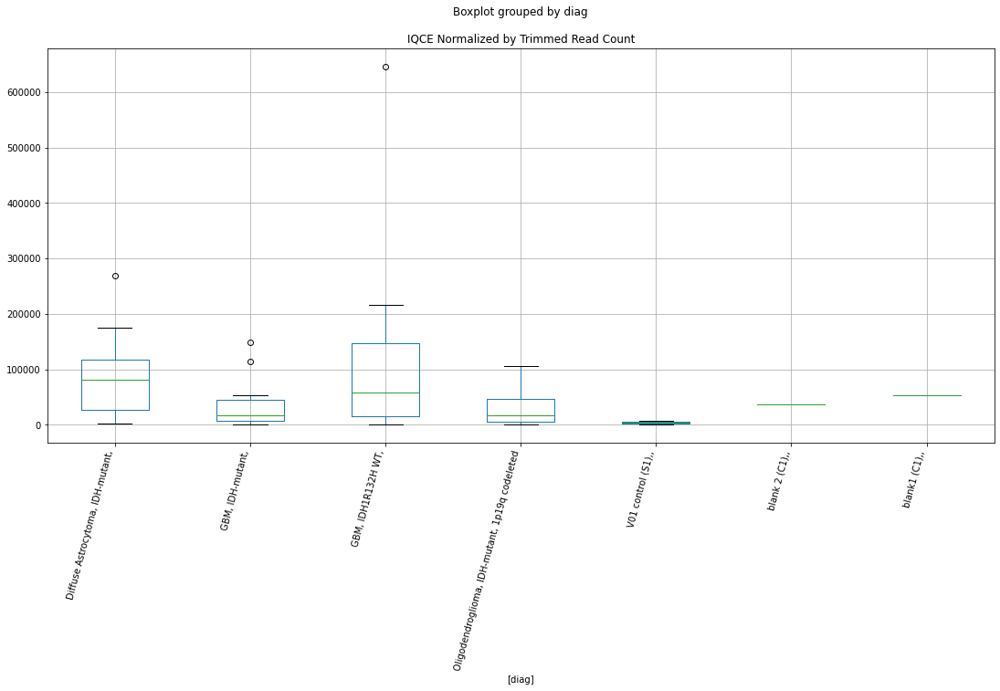

 p : 0.04789579518752162  ( t : 2.1228227513052755 ) :  D-plex  :  bbduk2  :  FXYD3
Control and blanks
73     0.0
337    0.0
Name: FXYD3, dtype: float64
205    14864.55
Name: FXYD3, dtype: float64
469    2.19e+06
Name: FXYD3, dtype: float64


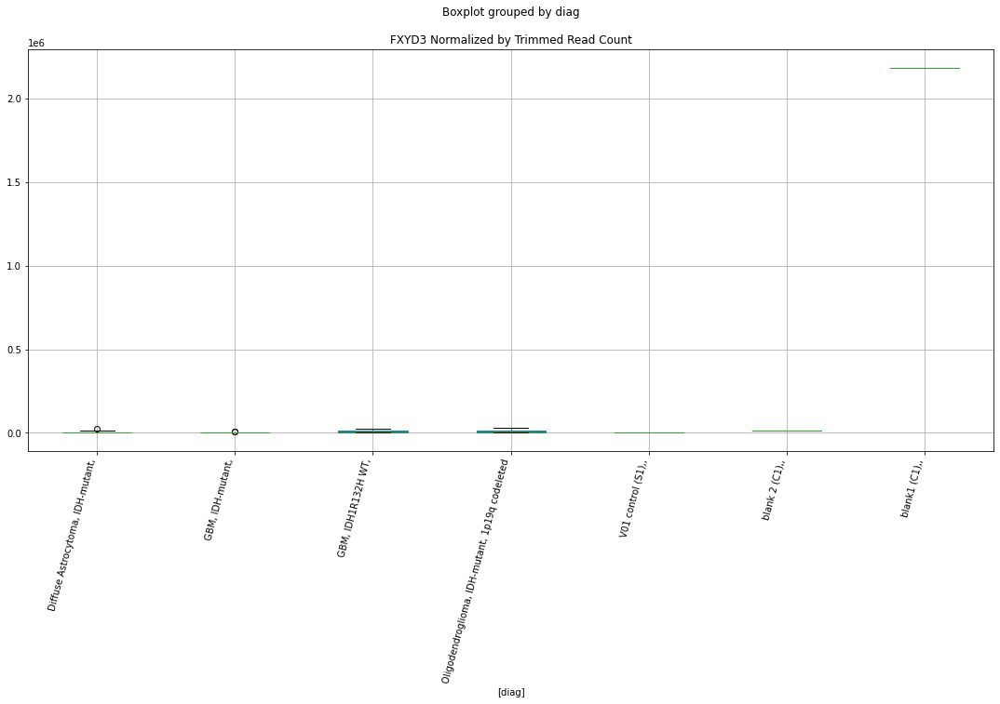

 p : 0.04791909370000735  ( t : 2.122575502109571 ) :  Lexogen  :  cutadapt2  :  HMGN5
Control and blanks
82     0.0
346    0.0
Name: HMGN5, dtype: float64
214    0.0
Name: HMGN5, dtype: float64
478    0.0
Name: HMGN5, dtype: float64


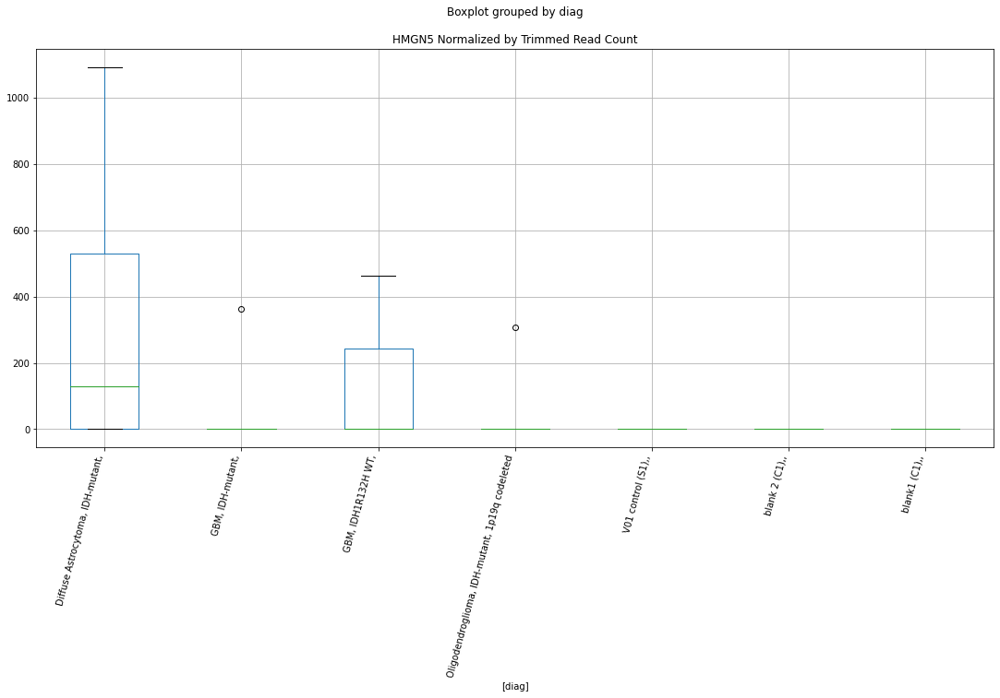

 p : 0.04796773877448808  ( t : 2.1220596222041777 ) :  Lexogen  :  cutadapt2  :  FAIM2
Control and blanks
82       0.00
346    420.87
Name: FAIM2, dtype: float64
214    2169.81
Name: FAIM2, dtype: float64
478    0.0
Name: FAIM2, dtype: float64


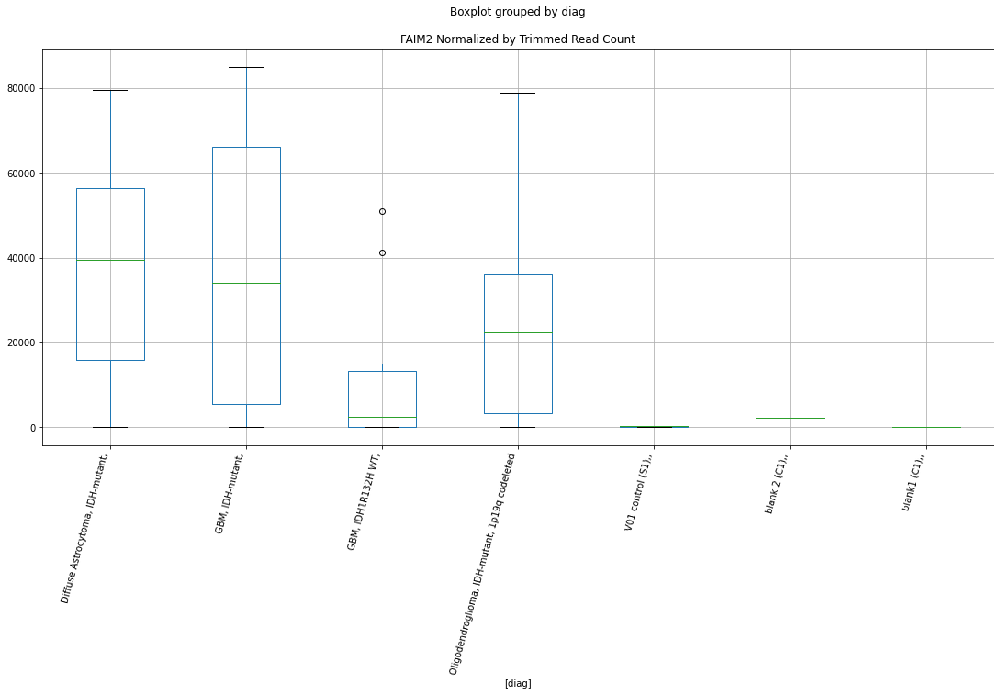

 p : 0.04799677408744155  ( t : 2.1217519304690966 ) :  D-plex  :  bbduk2  :  DNAH3
Control and blanks
73         0.00
337    11572.04
Name: DNAH3, dtype: float64
205    15401.82
Name: DNAH3, dtype: float64
469    48505.24
Name: DNAH3, dtype: float64


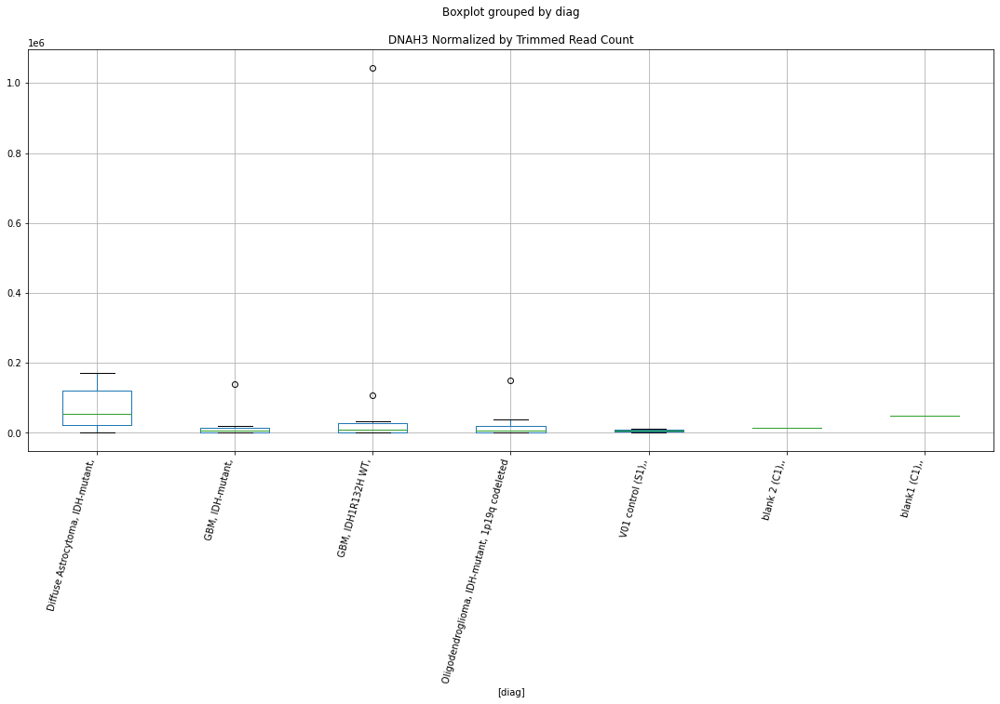

 p : 0.048257103287980566  ( t : 2.119000731248113 ) :  D-plex  :  bbduk2  :  GXYLT2
Control and blanks
73        0.00
337    1780.31
Name: GXYLT2, dtype: float64
205    2507.27
Name: GXYLT2, dtype: float64
469    0.0
Name: GXYLT2, dtype: float64


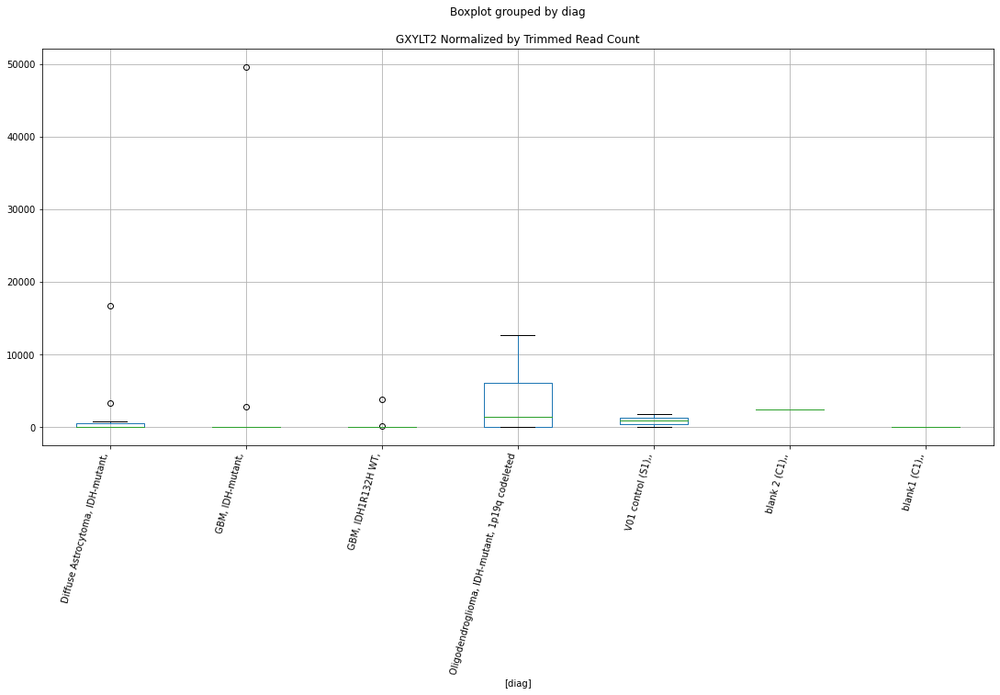

 p : 0.04827300370670062  ( t : 2.1188331315404723 ) :  D-plex  :  cutadapt2  :  GNA15
Control and blanks
76     757.61
340      0.00
Name: GNA15, dtype: float64
208    529.08
Name: GNA15, dtype: float64
472    1733.87
Name: GNA15, dtype: float64


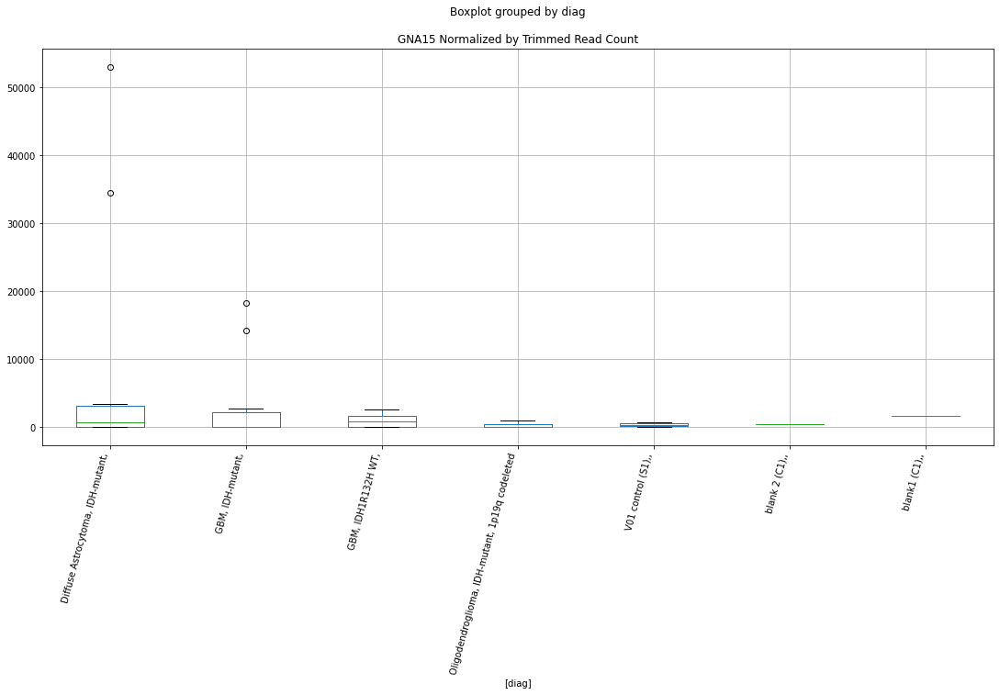

 p : 0.04827999344167603  ( t : 2.118759471555617 ) :  D-plex  :  cutadapt2  :  FAM27E2
Control and blanks
76     757.61
340    880.73
Name: FAM27E2, dtype: float64
208    8112.57
Name: FAM27E2, dtype: float64
472    10403.21
Name: FAM27E2, dtype: float64


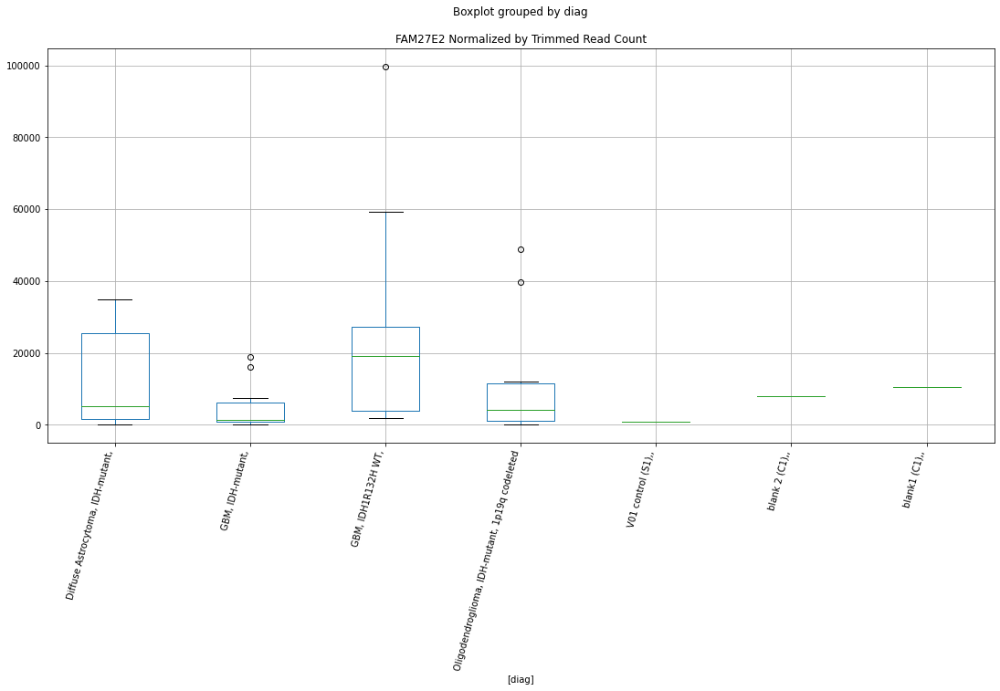

 p : 0.04838453110297664  ( t : 2.1176589785800606 ) :  D-plex  :  bbduk2  :  HSPBAP1
Control and blanks
73     0.0
337    0.0
Name: HSPBAP1, dtype: float64
205    358.18
Name: HSPBAP1, dtype: float64
469    591.53
Name: HSPBAP1, dtype: float64


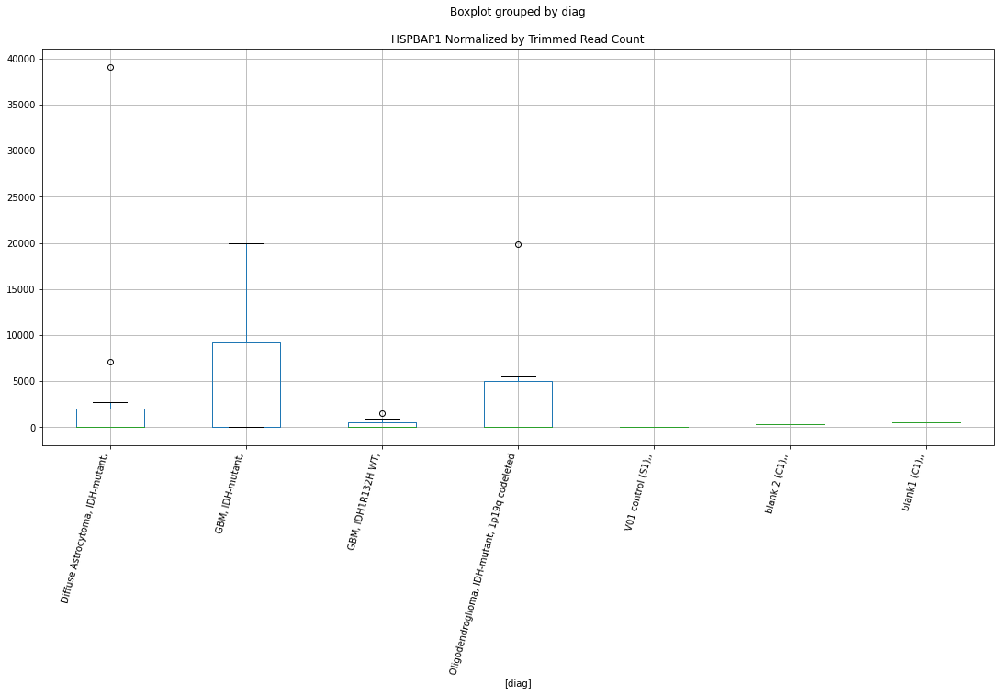

 p : 0.04841896987439382  ( t : 2.117296907494883 ) :  D-plex  :  cutadapt2  :  DNAH3
Control and blanks
76     0.0
340    0.0
Name: DNAH3, dtype: float64
208    15166.98
Name: DNAH3, dtype: float64
472    40456.91
Name: DNAH3, dtype: float64


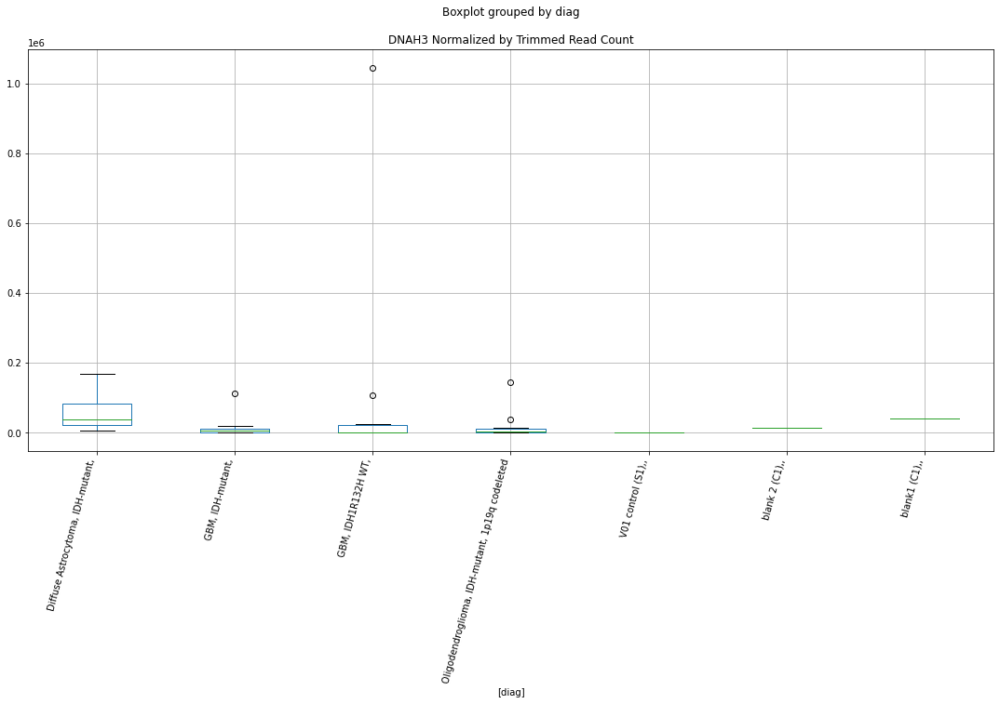

 p : 0.04851927582894433  ( t : 2.116243678063417 ) :  D-plex  :  bbduk2  :  HERC2
Control and blanks
73     57202.62
337    80114.15
Name: HERC2, dtype: float64
205    91336.39
Name: HERC2, dtype: float64
469    63884.95
Name: HERC2, dtype: float64


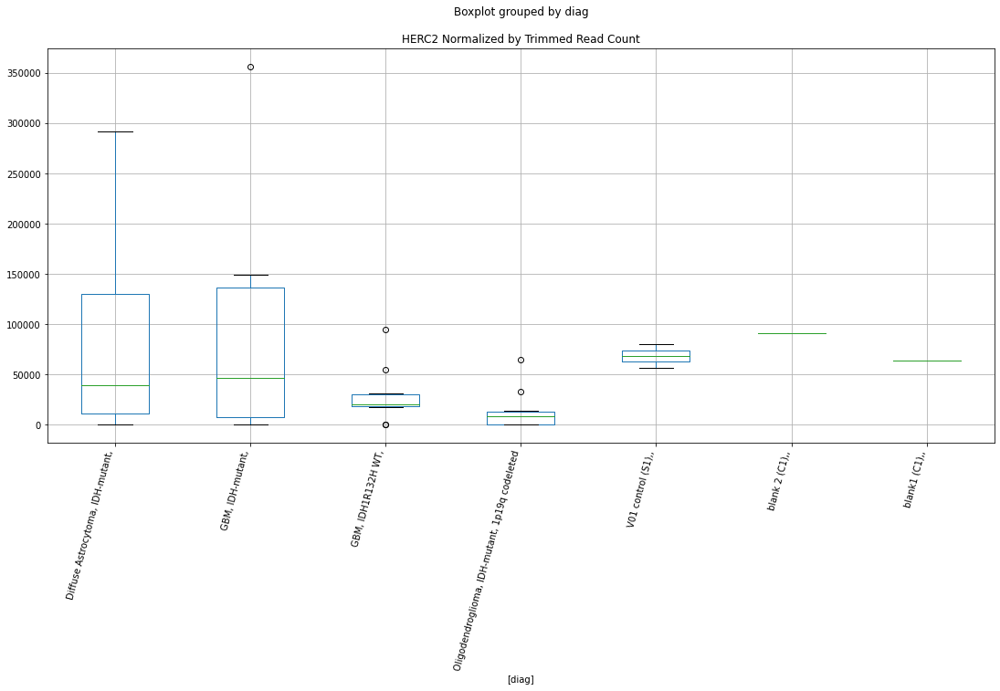

 p : 0.048546449984501444  ( t : 2.115958686140006 ) :  D-plex  :  bbduk2  :  IL21-AS1
Control and blanks
73     0.0
337    0.0
Name: IL21-AS1, dtype: float64
205    716.36
Name: IL21-AS1, dtype: float64
469    1183.05
Name: IL21-AS1, dtype: float64


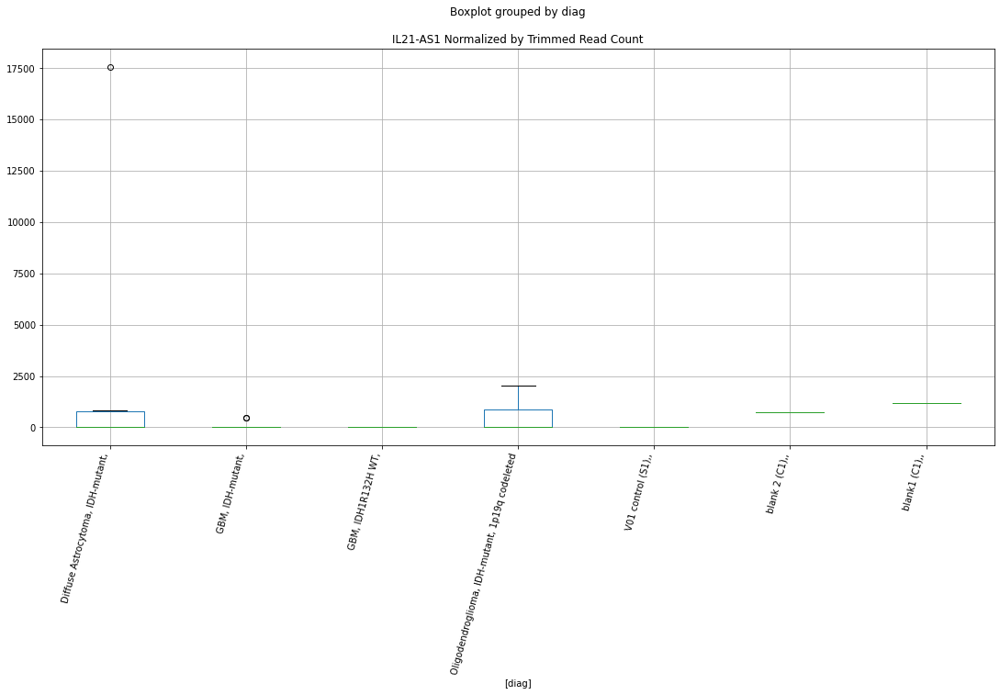

 p : 0.04866738166306346  ( t : 2.114692160617937 ) :  D-plex  :  bbduk2  :  DOK1
Control and blanks
73     36331.39
337        0.00
Name: DOK1, dtype: float64
205    10745.46
Name: DOK1, dtype: float64
469    1183.05
Name: DOK1, dtype: float64


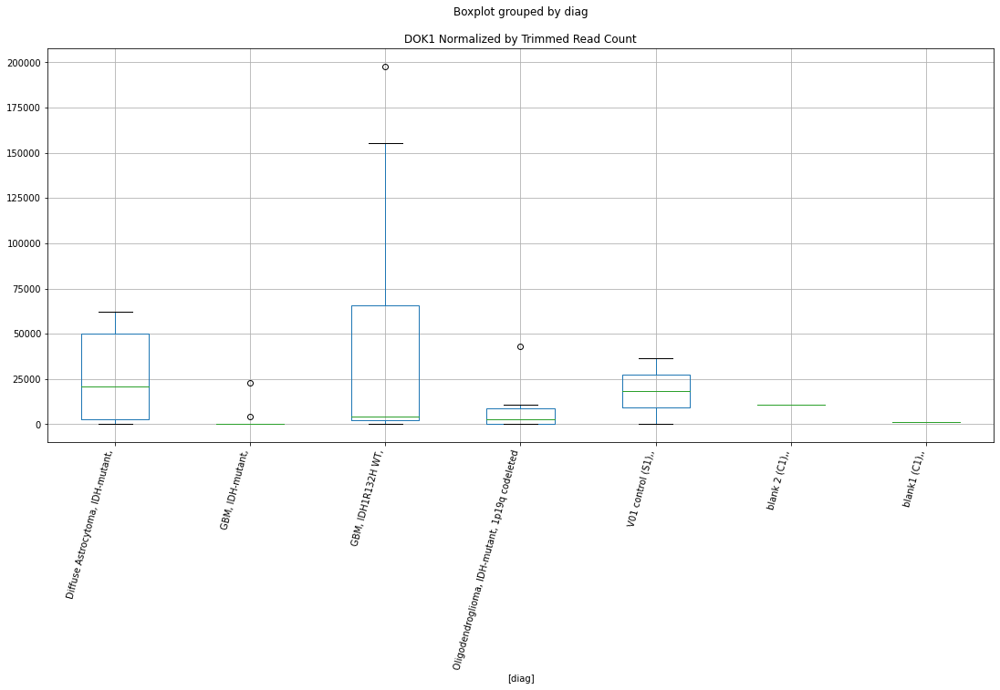

 p : 0.048743622042893814  ( t : 2.1138951616356016 ) :  D-plex  :  bbduk2  :  GP1BA
Control and blanks
73     0.0
337    0.0
Name: GP1BA, dtype: float64
205    716.36
Name: GP1BA, dtype: float64
469    591.53
Name: GP1BA, dtype: float64


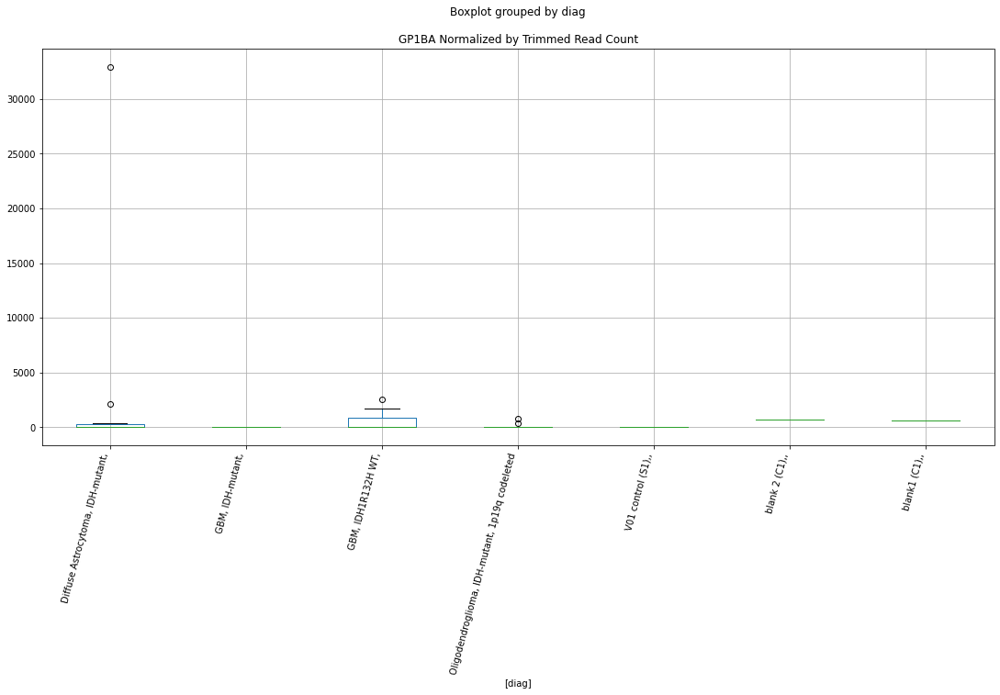

 p : 0.04874571781208393  ( t : 2.1138732689865396 ) :  D-plex  :  cutadapt2  :  IFFO2
Control and blanks
76     0.0
340    0.0
Name: IFFO2, dtype: float64
208    1410.88
Name: IFFO2, dtype: float64
472    4623.65
Name: IFFO2, dtype: float64


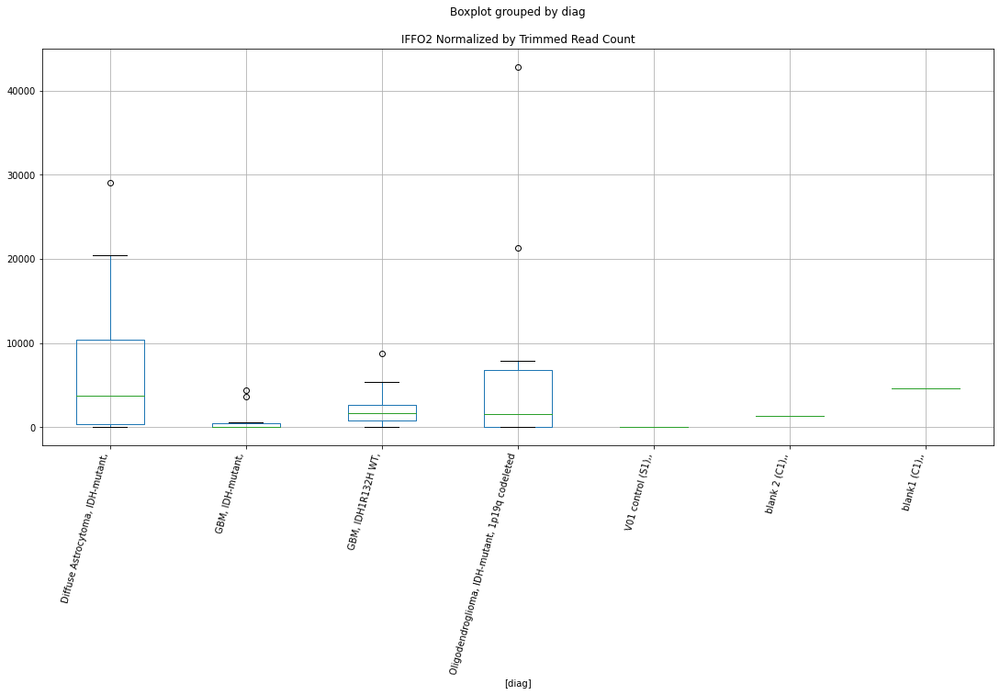

 p : 0.04876293086909168  ( t : 2.113693491795825 ) :  D-plex  :  bbduk2  :  FBXO33
Control and blanks
73     0.0
337    0.0
Name: FBXO33, dtype: float64
205    0.0
Name: FBXO33, dtype: float64
469    0.0
Name: FBXO33, dtype: float64


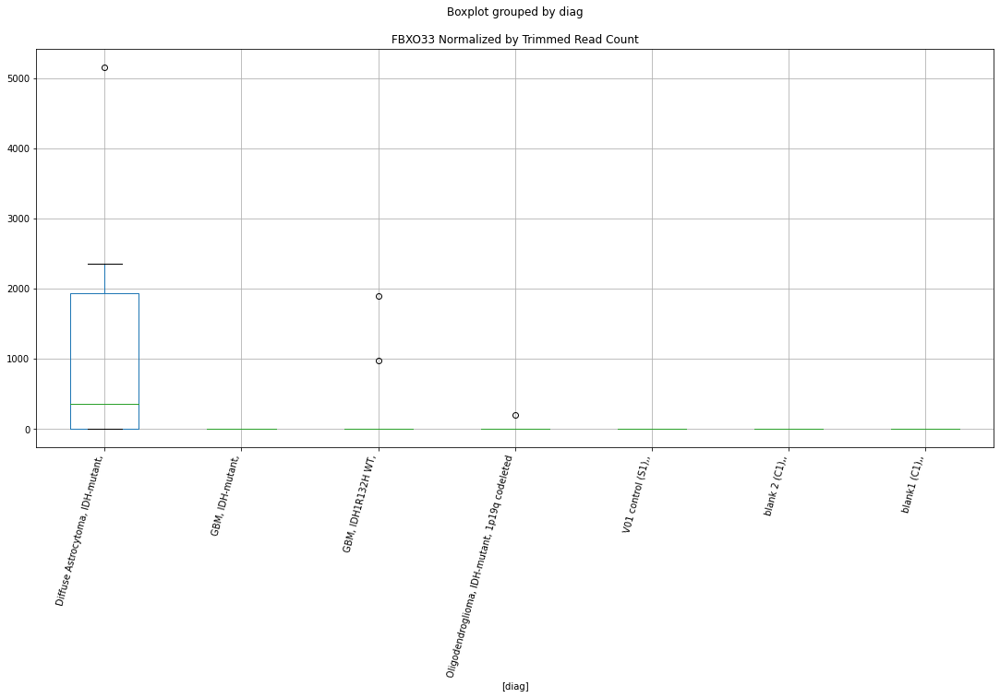

 p : 0.04880351587064773  ( t : 2.1132698410938424 ) :  D-plex  :  cutadapt2  :  FBXO33
Control and blanks
76     0.0
340    0.0
Name: FBXO33, dtype: float64
208    352.72
Name: FBXO33, dtype: float64
472    0.0
Name: FBXO33, dtype: float64


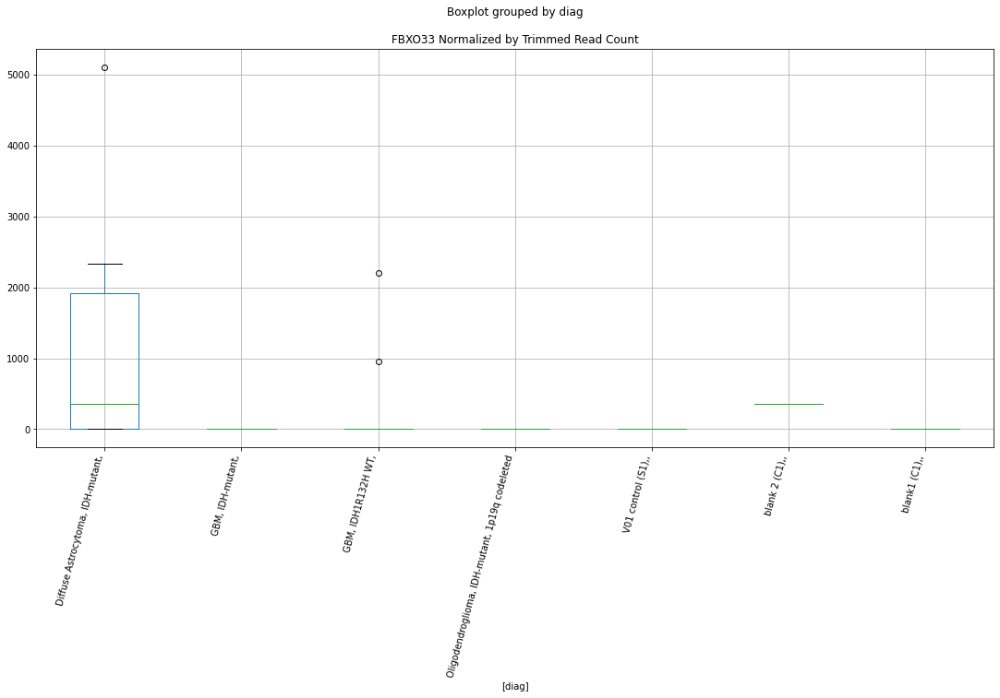

 p : 0.048812206834610954  ( t : 2.113179161261885 ) :  D-plex  :  bbduk2  :  GIPC1
Control and blanks
73     313841.41
337         0.00
Name: GIPC1, dtype: float64
205    30266.37
Name: GIPC1, dtype: float64
469    14788.18
Name: GIPC1, dtype: float64


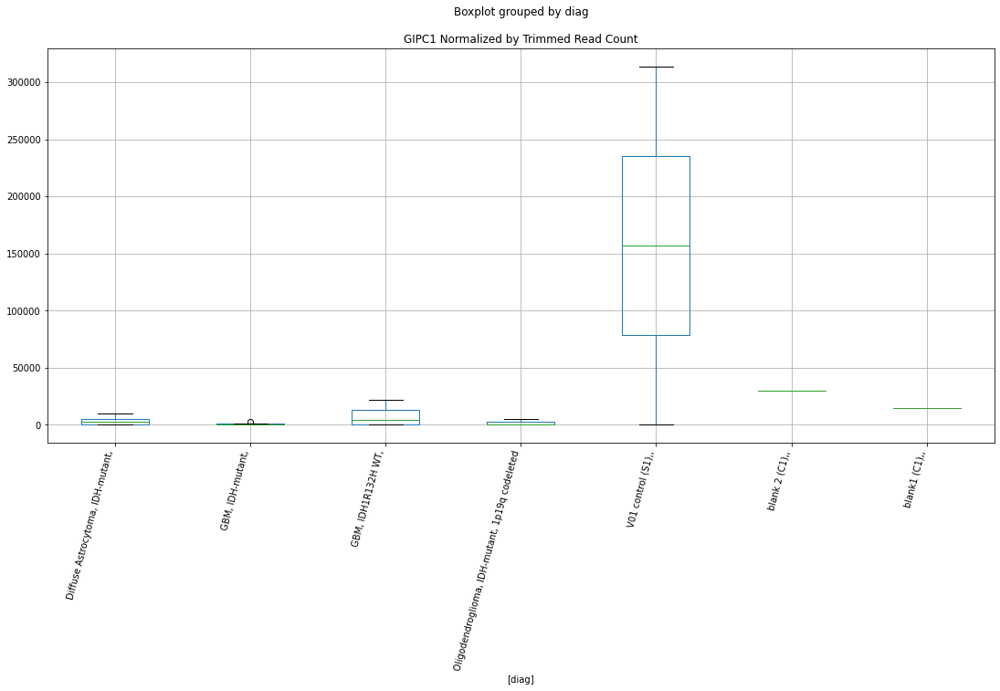

 p : 0.04881765335286989  ( t : 2.1131223408367563 ) :  Lexogen  :  cutadapt2  :  EFNA5
Control and blanks
82     0.0
346    0.0
Name: EFNA5, dtype: float64
214    0.0
Name: EFNA5, dtype: float64
478    0.0
Name: EFNA5, dtype: float64


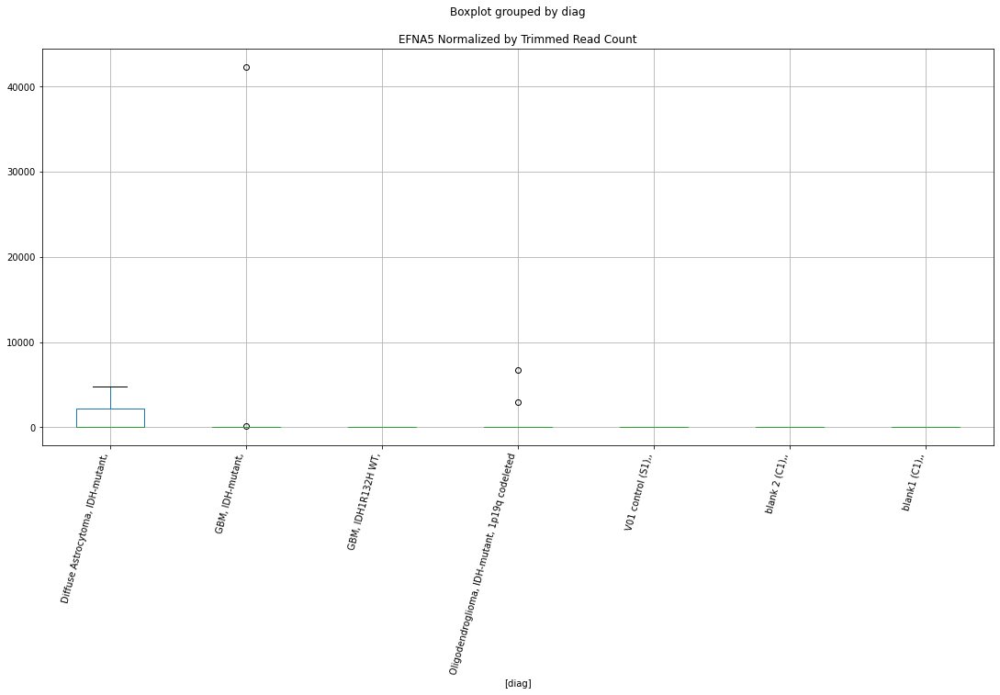

 p : 0.04883270394411573  ( t : 2.112965356579597 ) :  D-plex  :  bbduk2  :  FBXL20
Control and blanks
73     1546.02
337       0.00
Name: FBXL20, dtype: float64
205    5014.55
Name: FBXL20, dtype: float64
469    8281.38
Name: FBXL20, dtype: float64


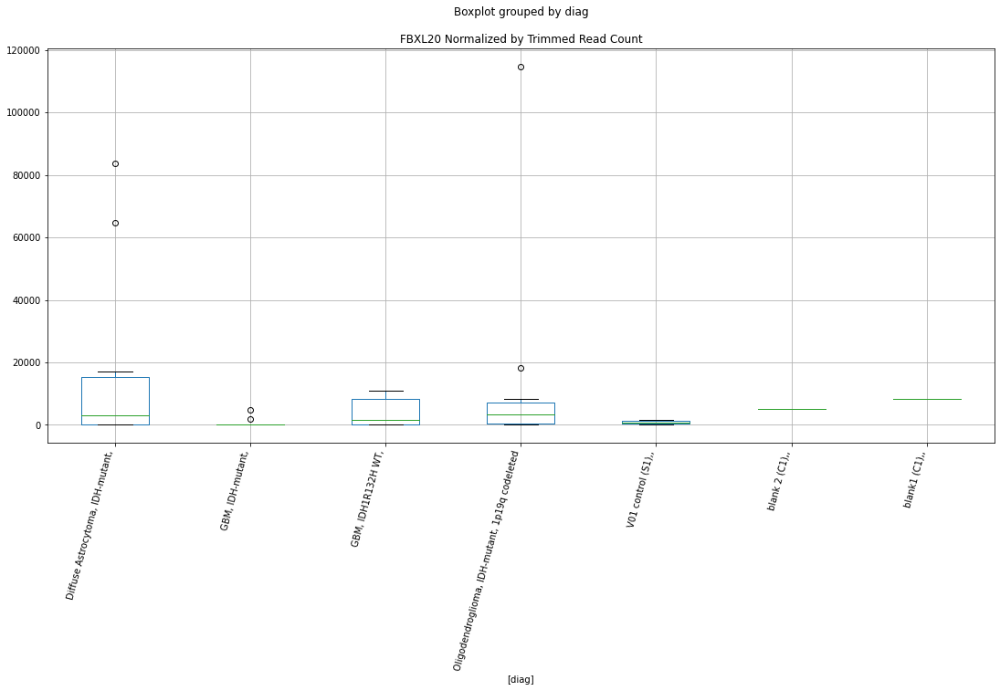

 p : 0.04898964438910985  ( t : 2.111331017291051 ) :  D-plex  :  cutadapt2  :  GP1BA
Control and blanks
76     0.0
340    0.0
Name: GP1BA, dtype: float64
208    705.44
Name: GP1BA, dtype: float64
472    0.0
Name: GP1BA, dtype: float64


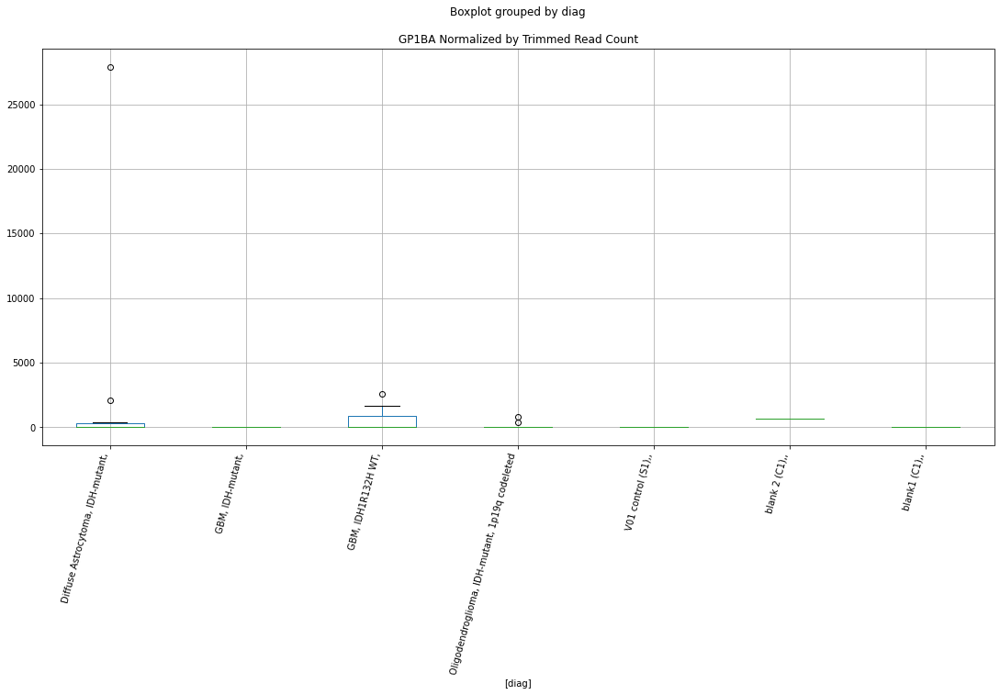

 p : 0.04899803288363332  ( t : 2.1112437957689427 ) :  Lexogen  :  bbduk2  :  FEZF1-AS1
Control and blanks
79       0.00
343    212.31
Name: FEZF1-AS1, dtype: float64
211    0.0
Name: FEZF1-AS1, dtype: float64
475    0.0
Name: FEZF1-AS1, dtype: float64


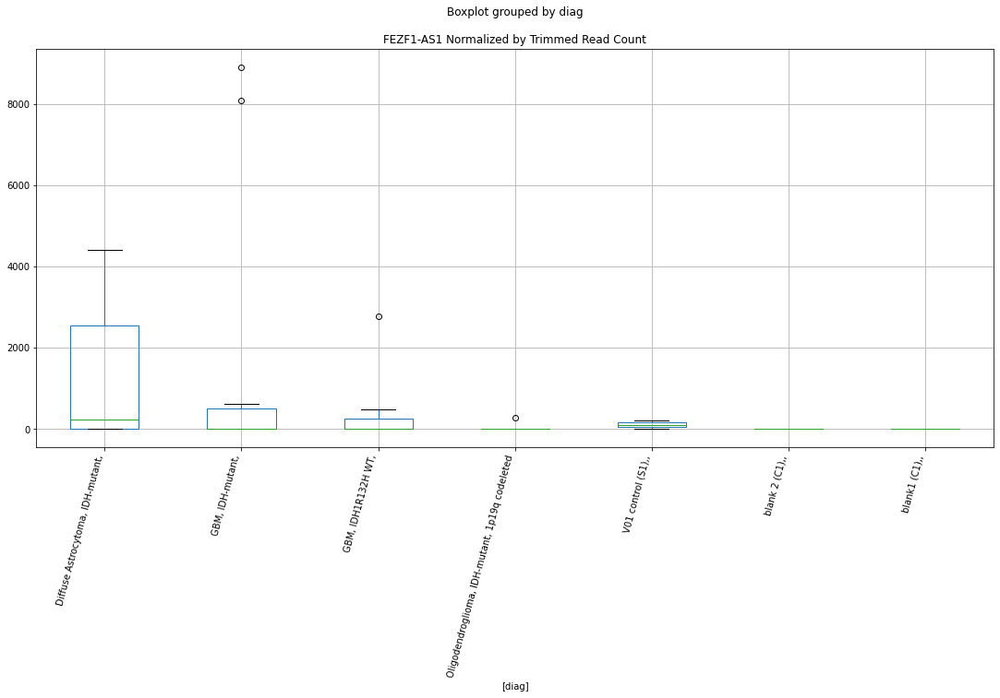

 p : 0.04904519603499904  ( t : 2.110753657620255 ) :  D-plex  :  bbduk2  :  FNBP4
Control and blanks
73     12368.13
337     2670.47
Name: FNBP4, dtype: float64
205    3402.73
Name: FNBP4, dtype: float64
469    4732.22
Name: FNBP4, dtype: float64


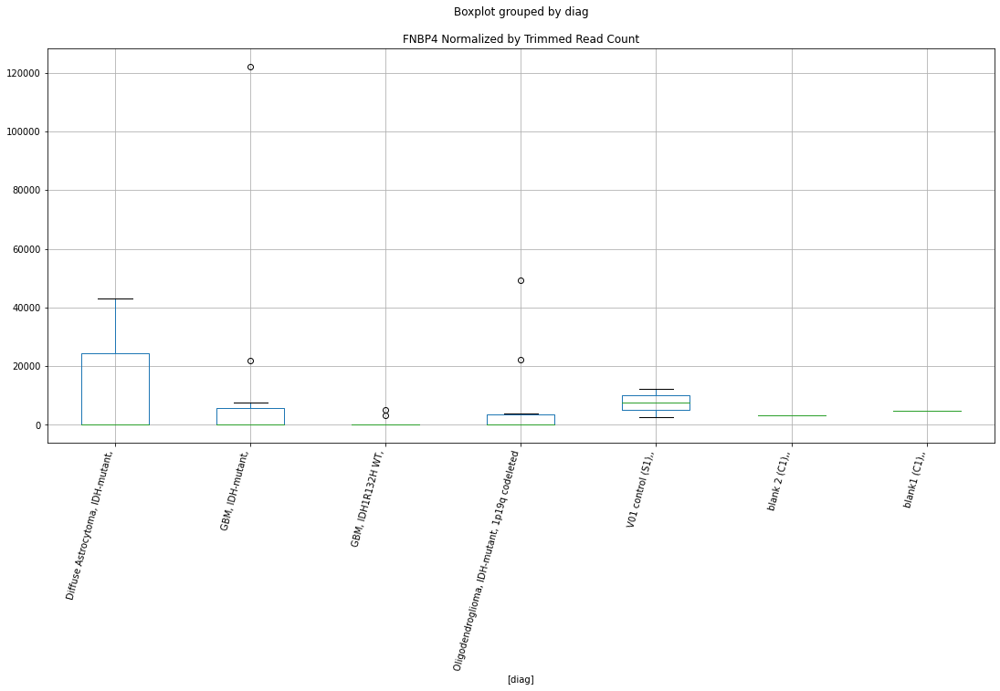

 p : 0.04906859029007408  ( t : 2.1105106943608214 ) :  D-plex  :  bbduk2  :  FAM120C
Control and blanks
73     0.0
337    0.0
Name: FAM120C, dtype: float64
205    4656.36
Name: FAM120C, dtype: float64
469    1774.58
Name: FAM120C, dtype: float64


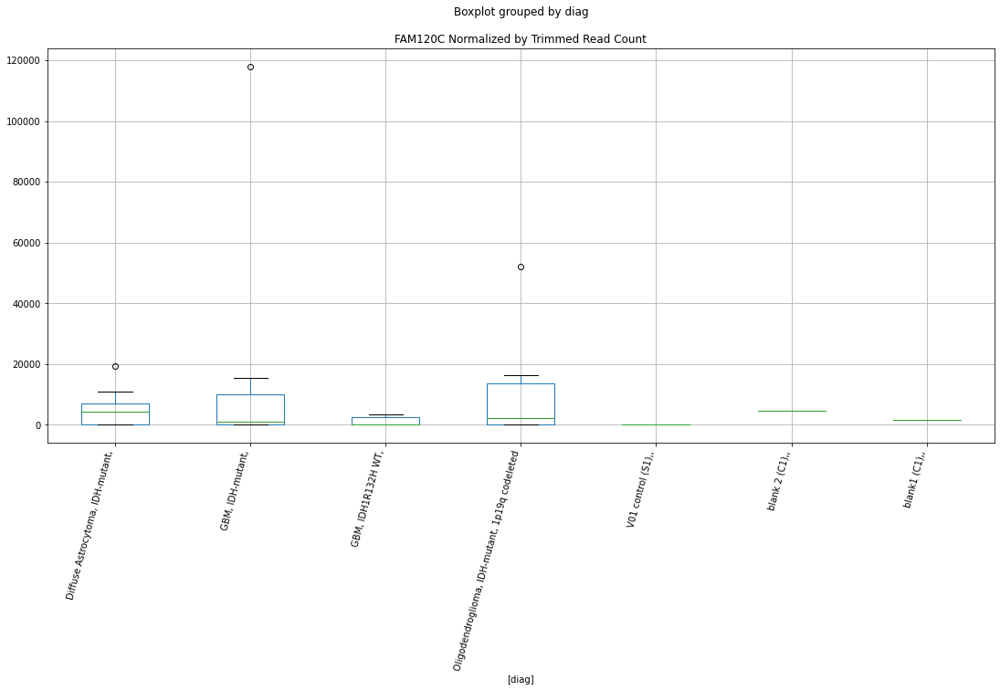

 p : 0.049076491698267145  ( t : 2.1104286573454223 ) :  D-plex  :  cutadapt2  :  LAMC1
Control and blanks
76     0.0
340    0.0
Name: LAMC1, dtype: float64
208    1058.16
Name: LAMC1, dtype: float64
472    577.96
Name: LAMC1, dtype: float64


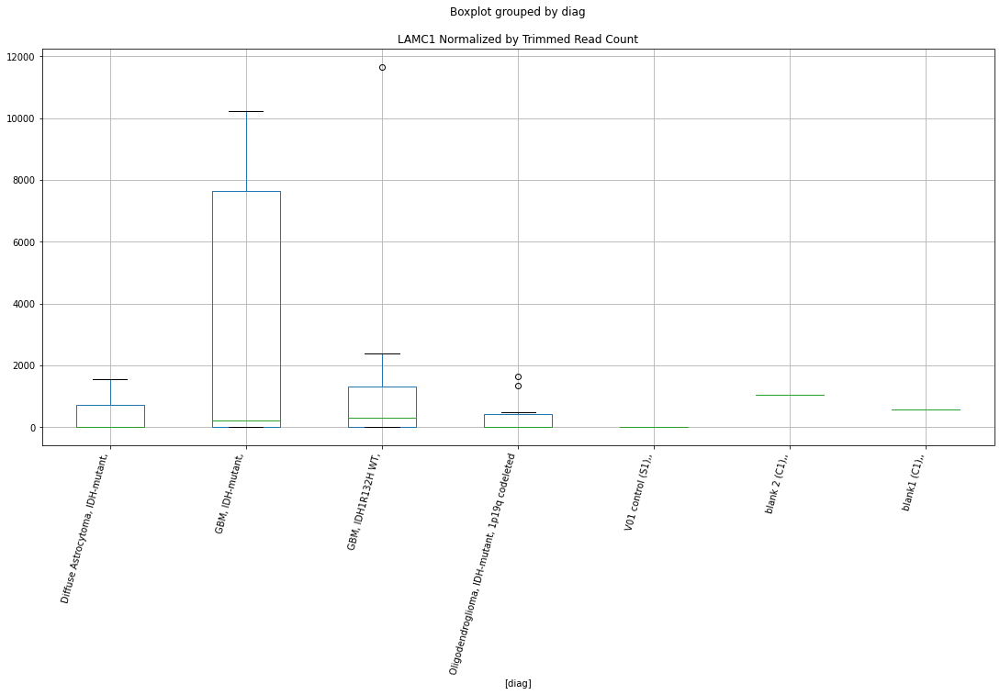

 p : 0.04914893671714158  ( t : 2.1096770507186053 ) :  D-plex  :  bbduk2  :  FHOD3
Control and blanks
73          0.00
337    541215.62
Name: FHOD3, dtype: float64
205    30982.73
Name: FHOD3, dtype: float64
469    12422.07
Name: FHOD3, dtype: float64


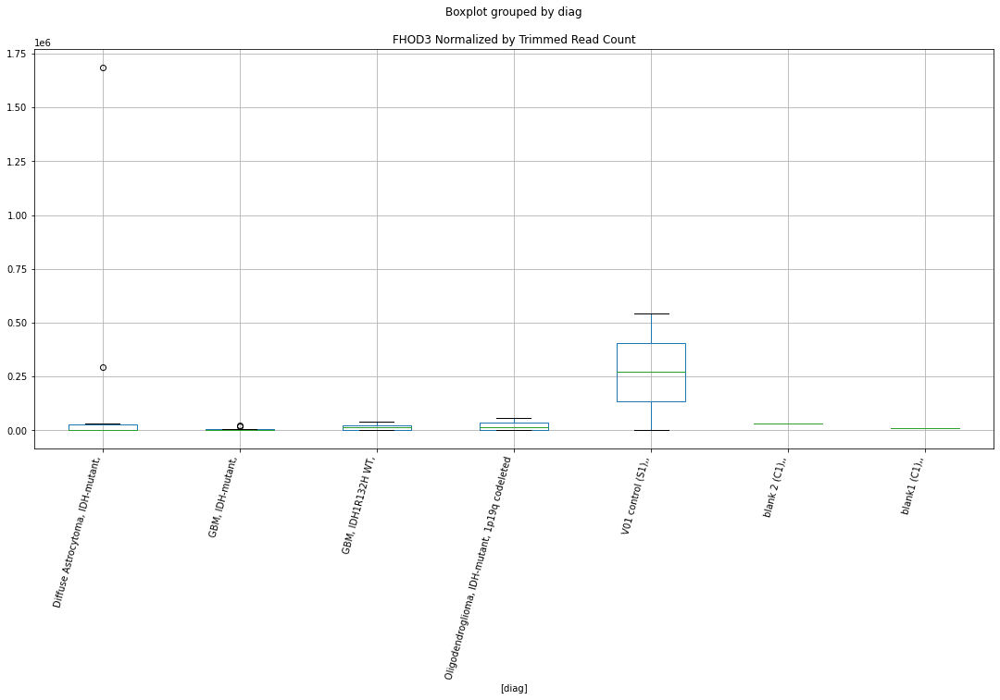

 p : 0.04915716018486128  ( t : 2.1095917971385516 ) :  D-plex  :  cutadapt2  :  GFER
Control and blanks
76     0.0
340    0.0
Name: GFER, dtype: float64
208    1763.6
Name: GFER, dtype: float64
472    1155.91
Name: GFER, dtype: float64


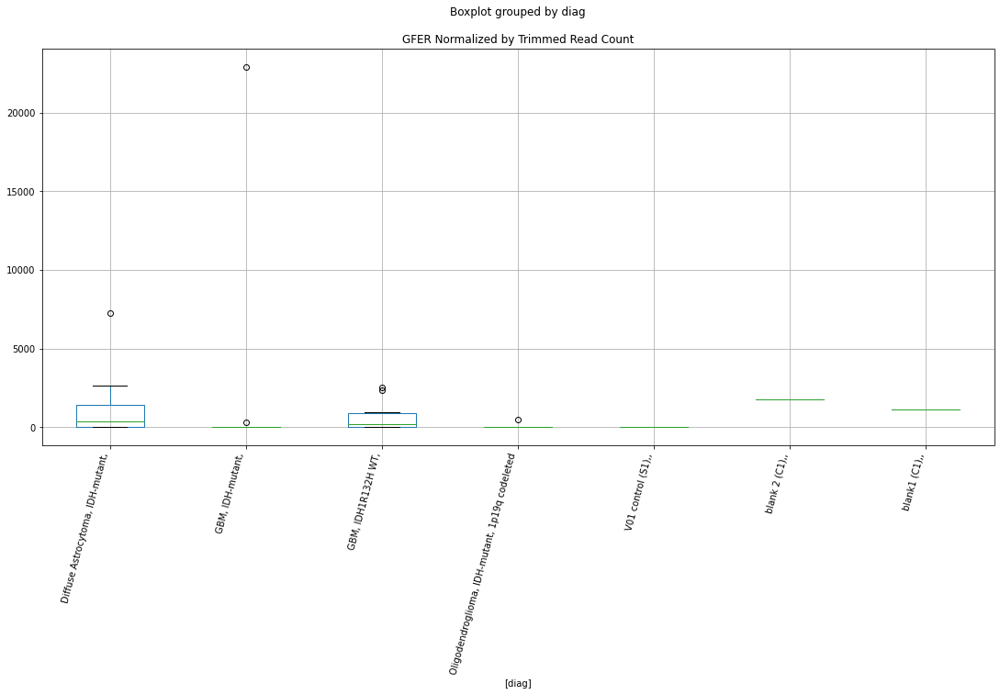

 p : 0.049291420275729254  ( t : 2.1082017402644078 ) :  Lexogen  :  bbduk2  :  KIAA0895
Control and blanks
79     0.0
343    0.0
Name: KIAA0895, dtype: float64
211    0.0
Name: KIAA0895, dtype: float64
475    0.0
Name: KIAA0895, dtype: float64


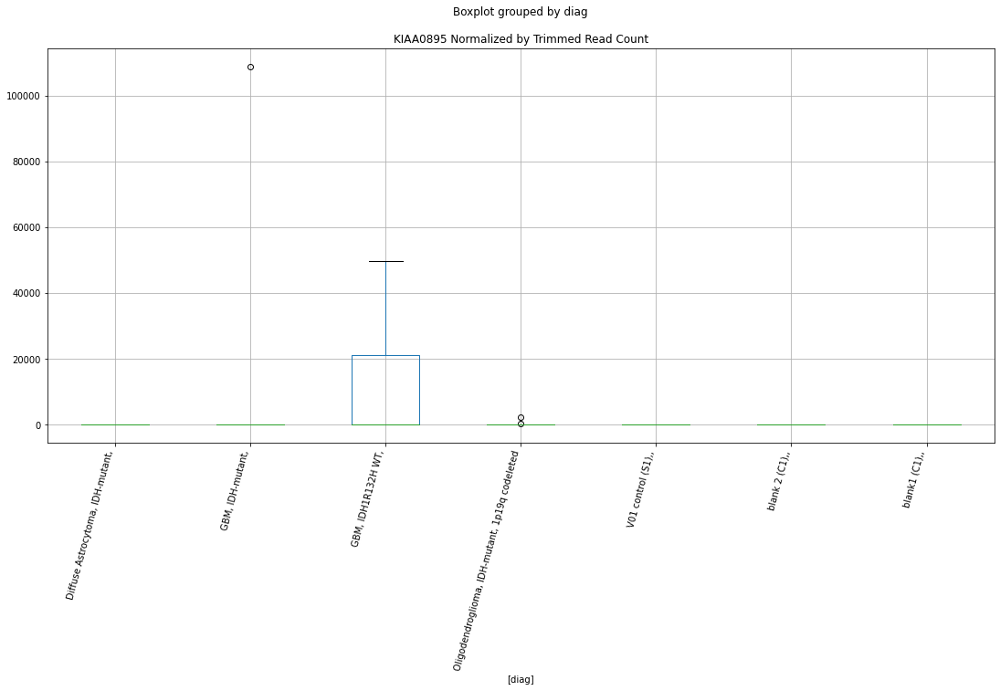

 p : 0.049294812460826995  ( t : 2.10816666403295 ) :  Lexogen  :  cutadapt2  :  GDPD5
Control and blanks
82     0.0
346    0.0
Name: GDPD5, dtype: float64
214    0.0
Name: GDPD5, dtype: float64
478    0.0
Name: GDPD5, dtype: float64


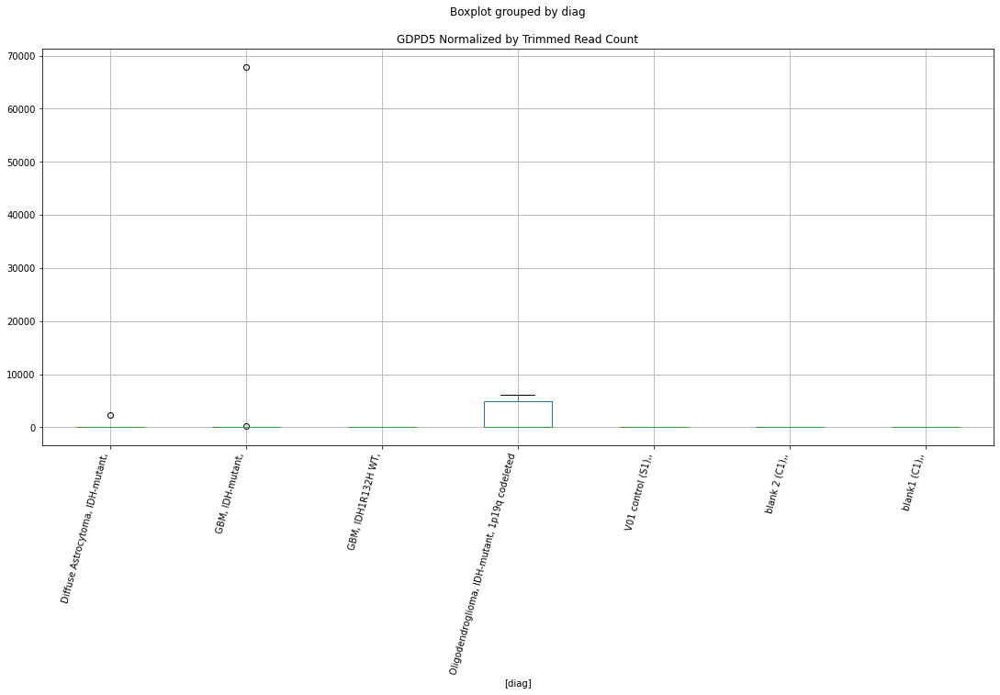

 p : 0.049308697943110505  ( t : 2.10802310678383 ) :  Lexogen  :  bbduk2  :  KMT5B
Control and blanks
79     0.0
343    0.0
Name: KMT5B, dtype: float64
211    0.0
Name: KMT5B, dtype: float64
475    239.52
Name: KMT5B, dtype: float64


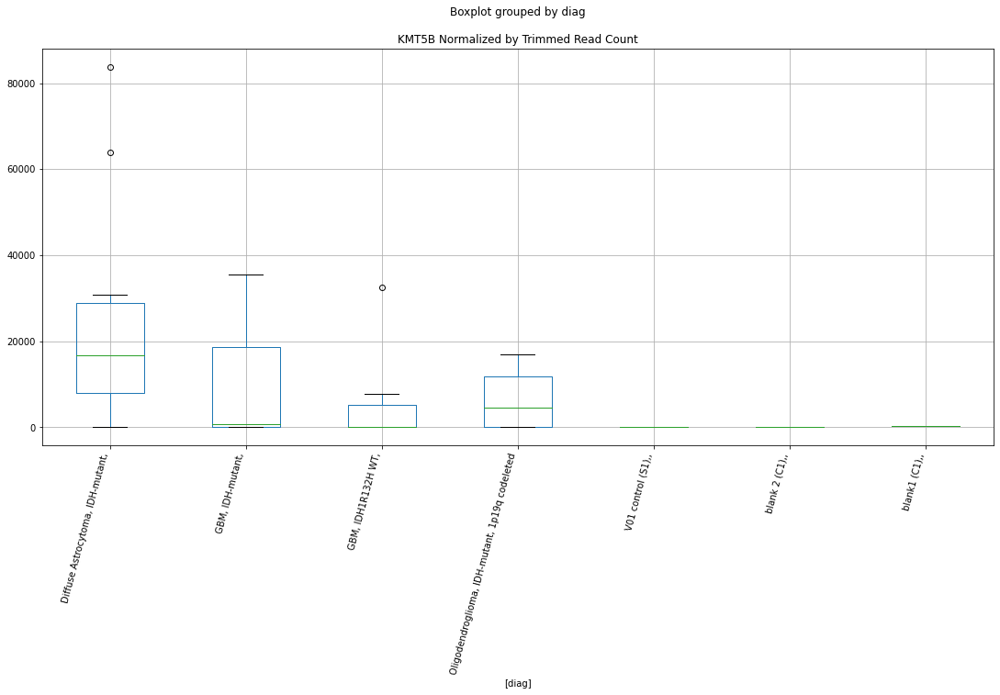

 p : 0.04934672690348386  ( t : 2.1076301265621535 ) :  D-plex  :  bbduk2  :  GDPD5
Control and blanks
73     0.0
337    0.0
Name: GDPD5, dtype: float64
205    12536.37
Name: GDPD5, dtype: float64
469    14788.18
Name: GDPD5, dtype: float64


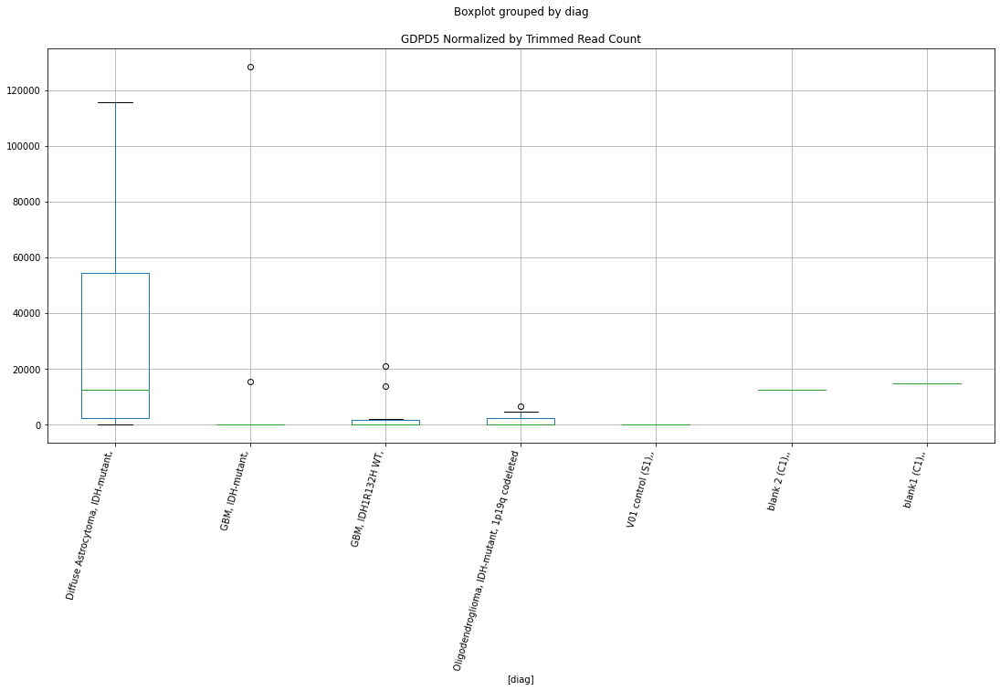

 p : 0.049417156201562756  ( t : 2.106903057597973 ) :  Lexogen  :  bbduk2  :  GNB1L
Control and blanks
79       0.00
343    424.63
Name: GNB1L, dtype: float64
211    0.0
Name: GNB1L, dtype: float64
475    0.0
Name: GNB1L, dtype: float64


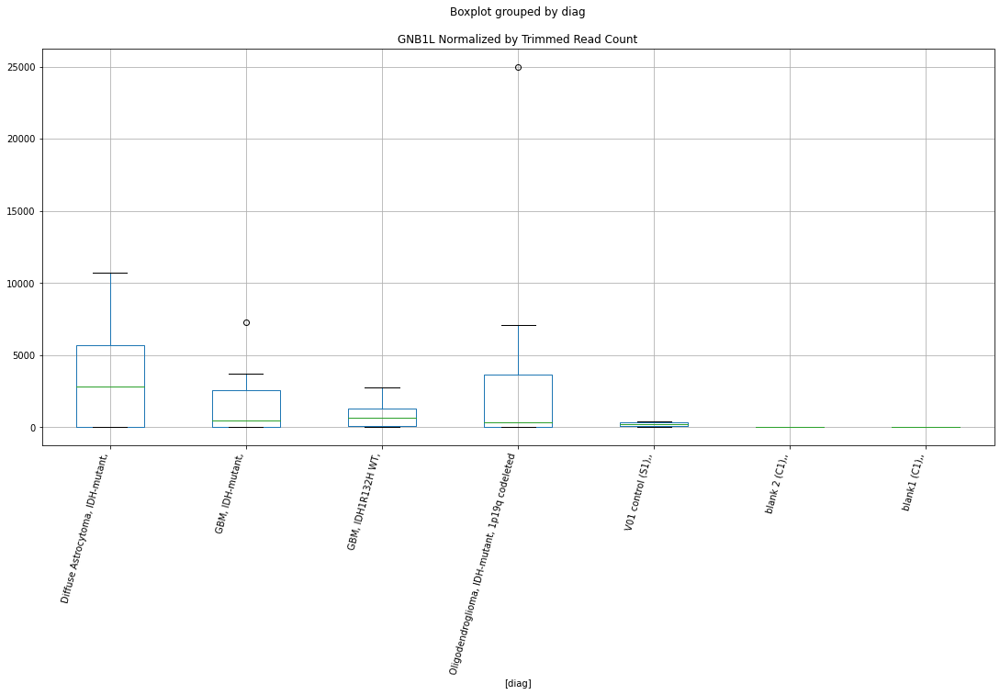

 p : 0.04941973725514761  ( t : 2.10687643028738 ) :  D-plex  :  cutadapt2  :  GTF2H1
Control and blanks
76     0.0
340    0.0
Name: GTF2H1, dtype: float64
208    16754.22
Name: GTF2H1, dtype: float64
472    5779.56
Name: GTF2H1, dtype: float64


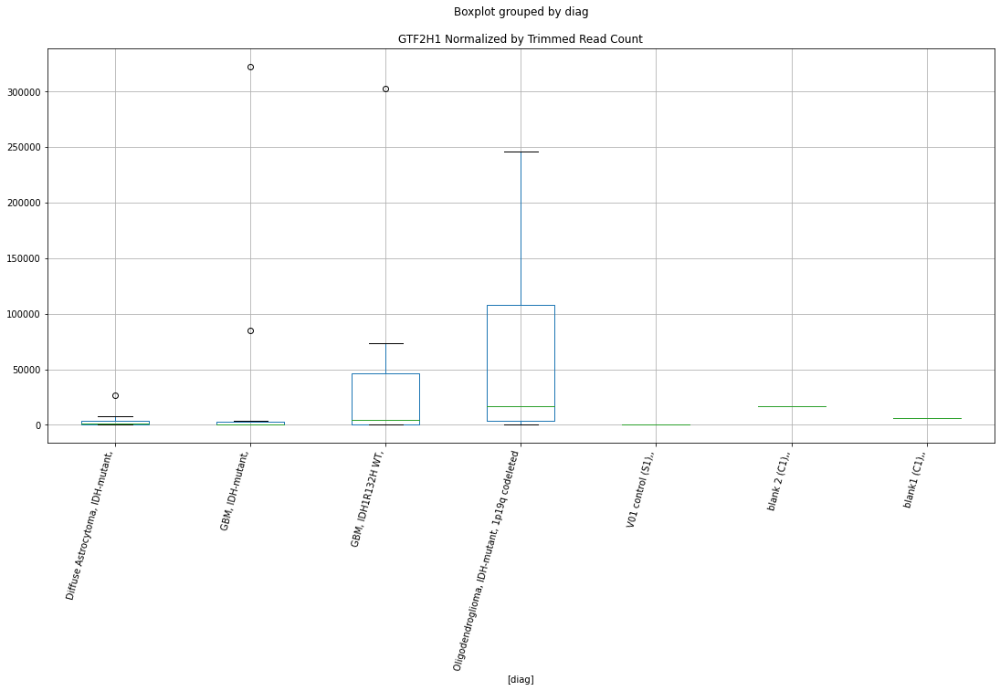

 p : 0.04945955201533801  ( t : 2.1064658434591235 ) :  D-plex  :  bbduk2  :  GTF2H1
Control and blanks
73     0.0
337    0.0
Name: GTF2H1, dtype: float64
205    16118.19
Name: GTF2H1, dtype: float64
469    5915.27
Name: GTF2H1, dtype: float64


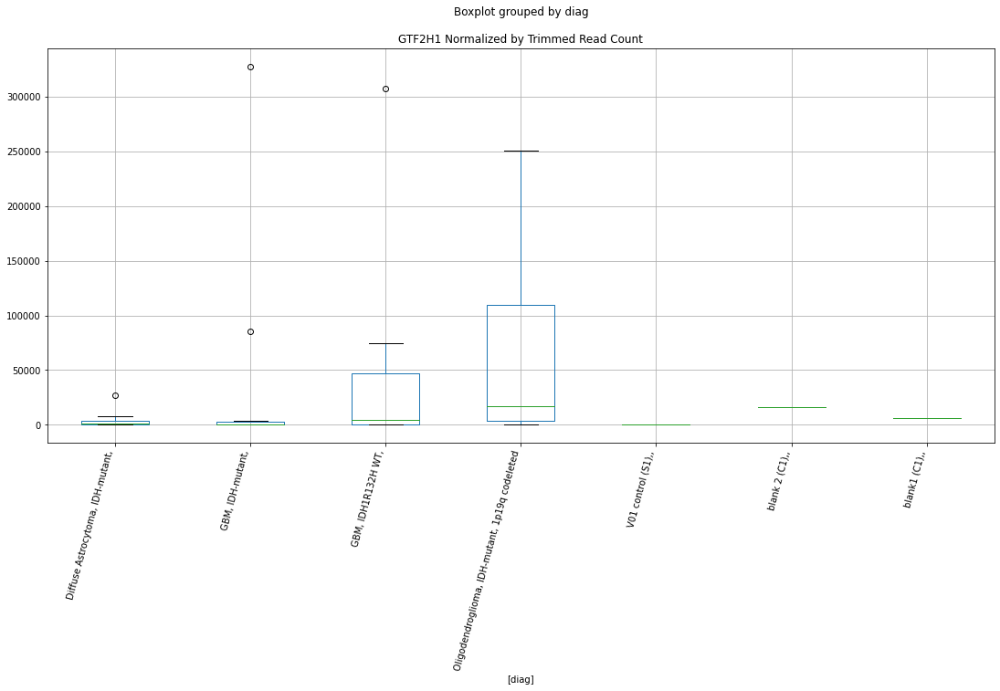

 p : 0.04952934865748832  ( t : 2.1057467954683493 ) :  Lexogen  :  bbduk2  :  KIAA2012
Control and blanks
79     0.0
343    0.0
Name: KIAA2012, dtype: float64
211    0.0
Name: KIAA2012, dtype: float64
475    0.0
Name: KIAA2012, dtype: float64


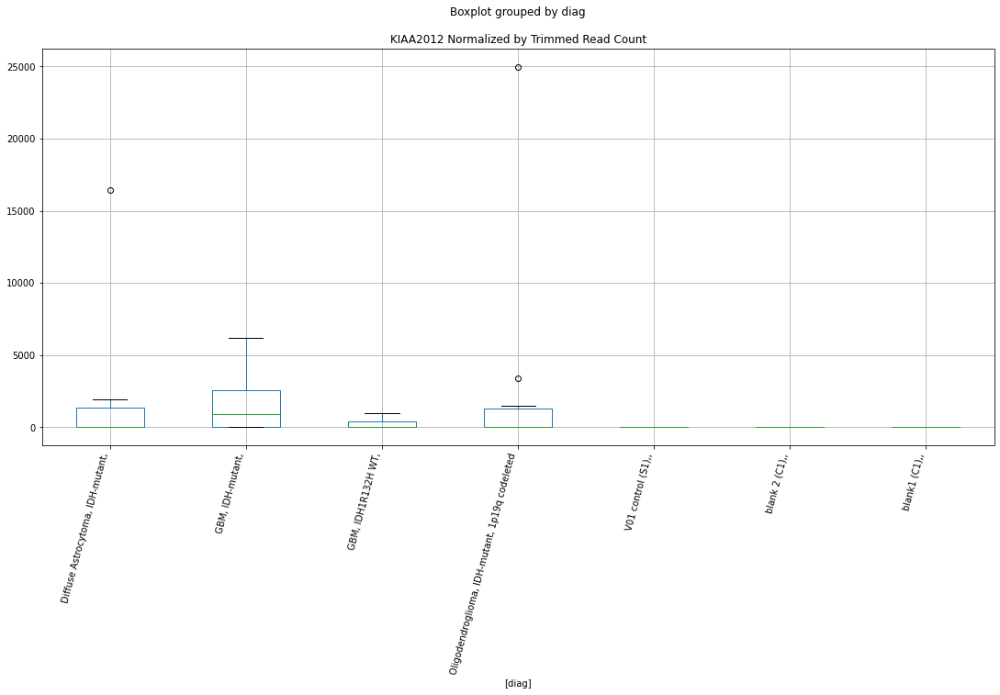

 p : 0.04957315790880677  ( t : 2.1052959412604224 ) :  D-plex  :  bbduk2  :  IGF1R
Control and blanks
73     24736.27
337     7121.26
Name: IGF1R, dtype: float64
205    206491.87
Name: IGF1R, dtype: float64
469    35491.64
Name: IGF1R, dtype: float64


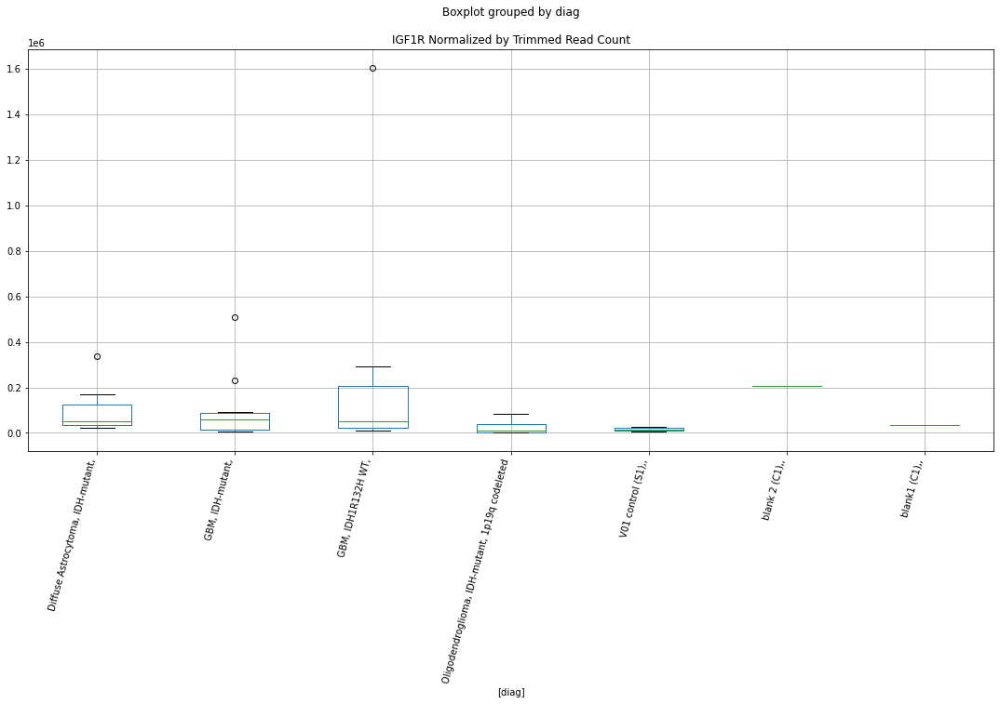

 p : 0.049604893465807244  ( t : 2.104969567322309 ) :  Lexogen  :  bbduk2  :  IMPA2
Control and blanks
79     0.0
343    0.0
Name: IMPA2, dtype: float64
211    16398.38
Name: IMPA2, dtype: float64
475    0.0
Name: IMPA2, dtype: float64


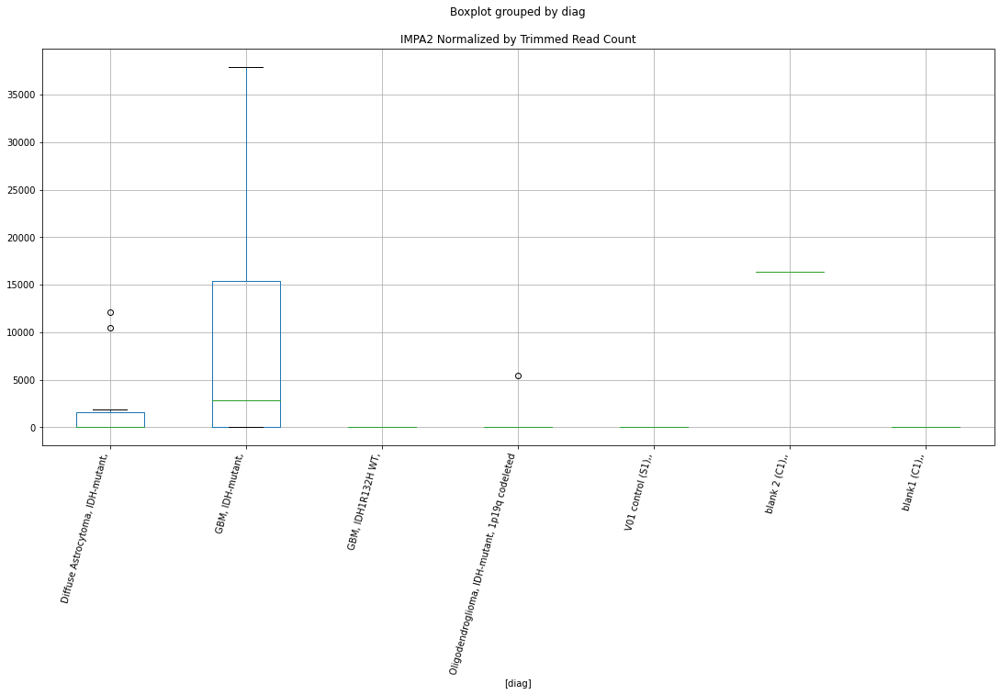

 p : 0.049646573242308714  ( t : 2.10454121362972 ) :  Lexogen  :  bbduk2  :  ETFB
Control and blanks
79       0.00
343    212.31
Name: ETFB, dtype: float64
211    1639.84
Name: ETFB, dtype: float64
475    0.0
Name: ETFB, dtype: float64


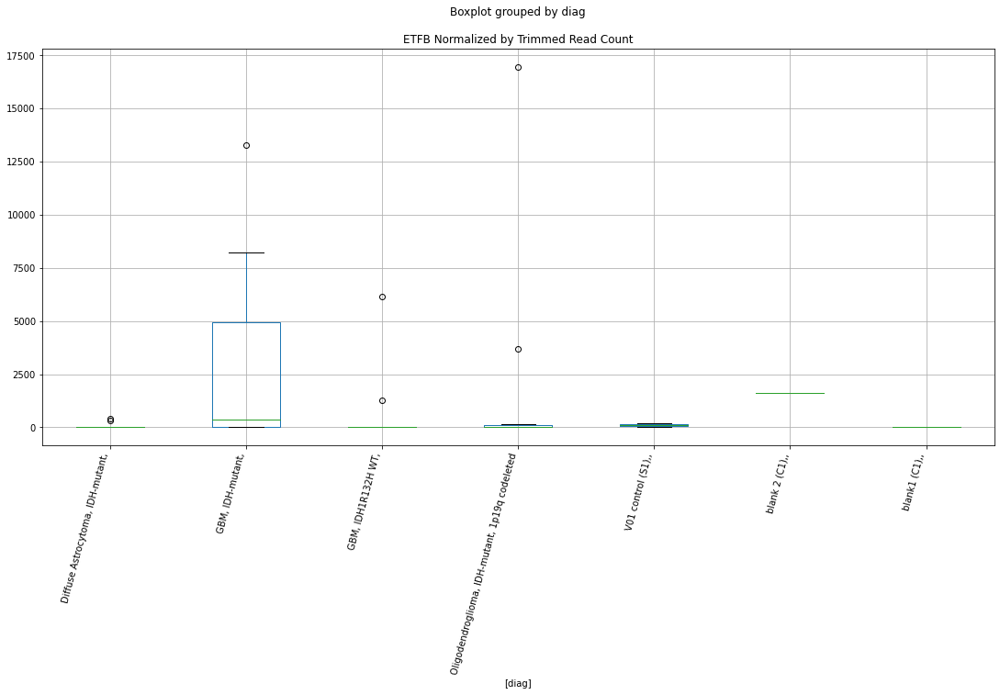

 p : 0.049656866106541776  ( t : 2.104435481587114 ) :  Lexogen  :  cutadapt2  :  GSK3B
Control and blanks
82        0.00
346    6313.04
Name: GSK3B, dtype: float64
214    9221.7
Name: GSK3B, dtype: float64
478    9973.34
Name: GSK3B, dtype: float64


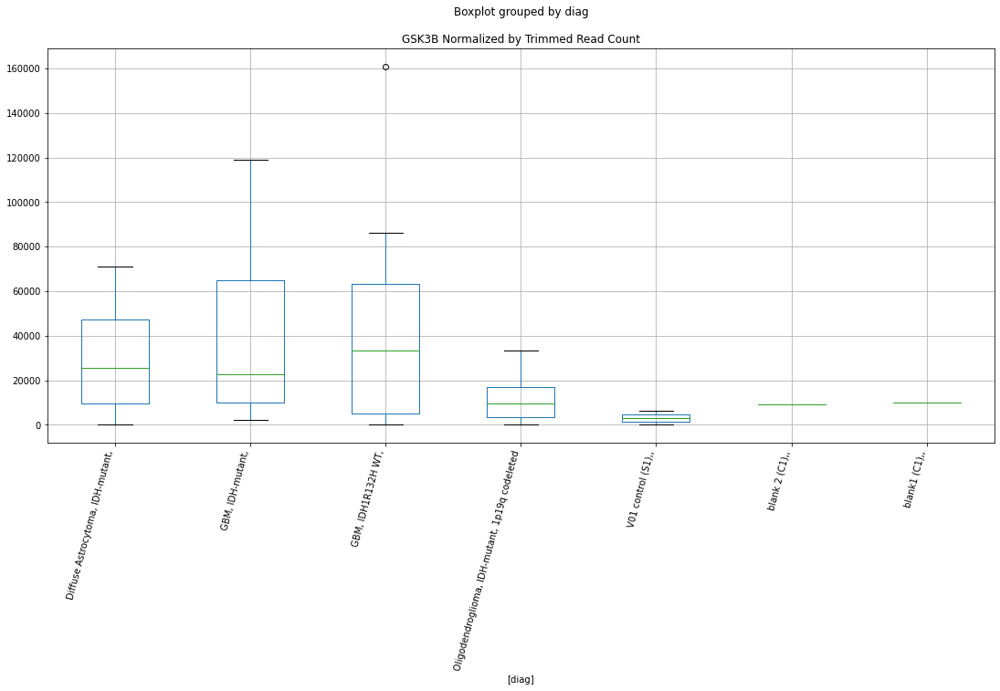

 p : 0.04968015947691998  ( t : 2.1041962771787457 ) :  D-plex  :  bbduk2  :  FBXL15
Control and blanks
73     0.0
337    0.0
Name: FBXL15, dtype: float64
205    3402.73
Name: FBXL15, dtype: float64
469    8872.91
Name: FBXL15, dtype: float64


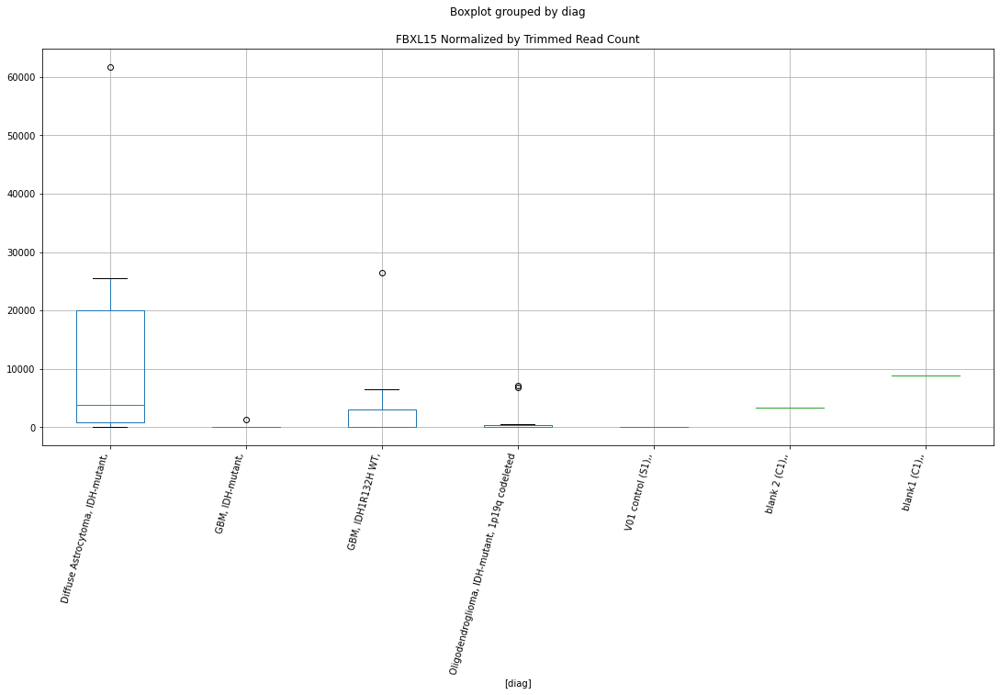

 p : 0.049700983307591894  ( t : 2.103982519298468 ) :  D-plex  :  cutadapt2  :  GDF1
Control and blanks
76     0.0
340    0.0
Name: GDF1, dtype: float64
208    176.36
Name: GDF1, dtype: float64
472    0.0
Name: GDF1, dtype: float64


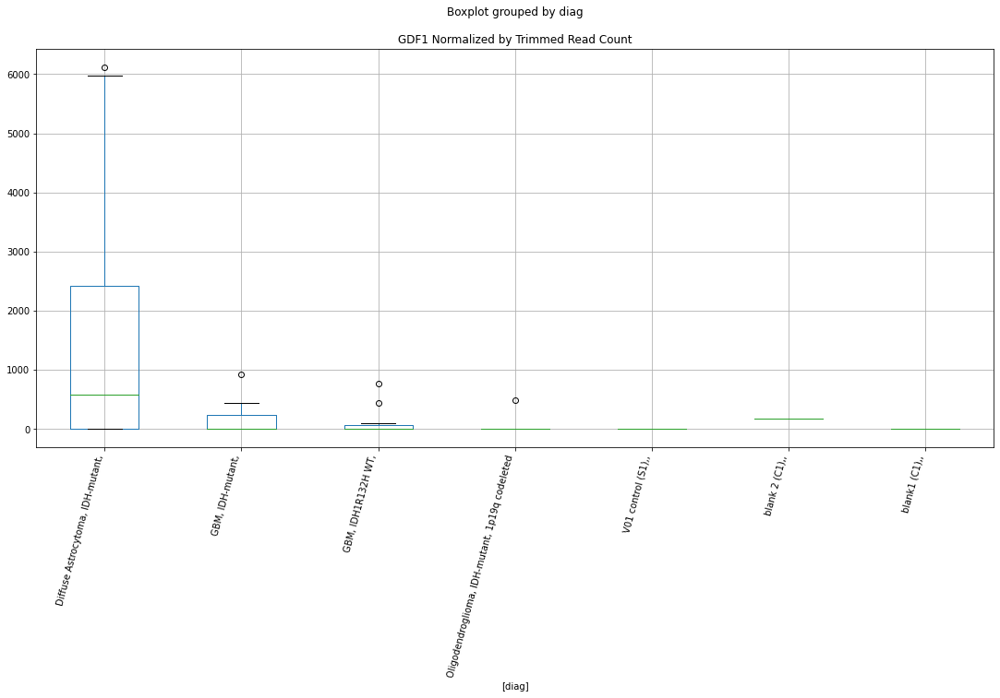

 p : 0.04974359980614569  ( t : 2.1035453120976313 ) :  Lexogen  :  cutadapt2  :  GRIN2D
Control and blanks
82         0.00
346    25673.01
Name: GRIN2D, dtype: float64
214    0.0
Name: GRIN2D, dtype: float64
478    0.0
Name: GRIN2D, dtype: float64


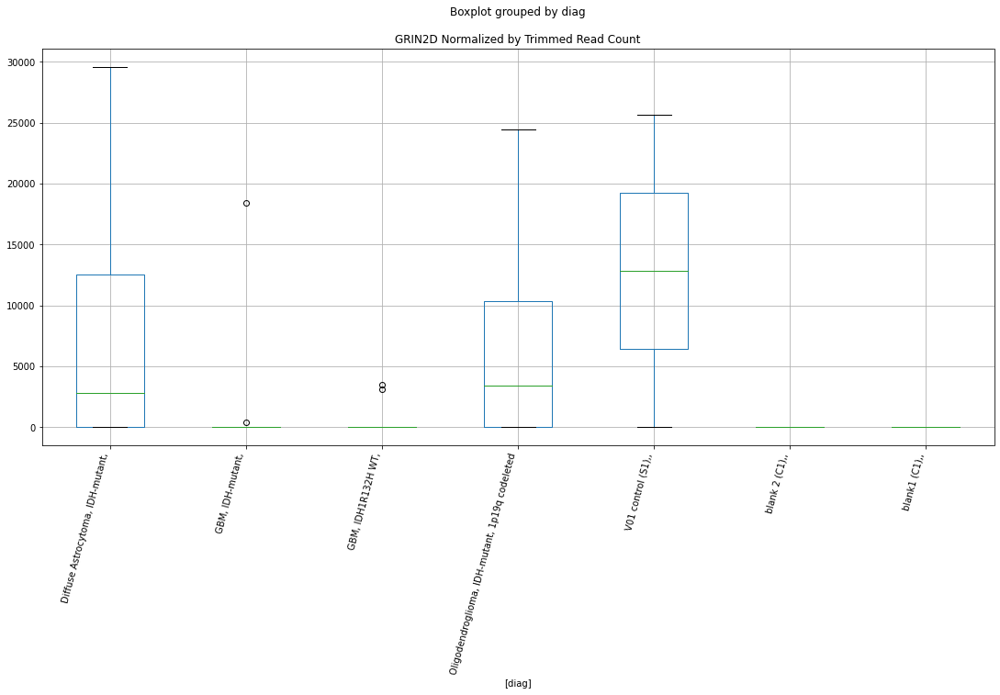

 p : 0.049817480004750454  ( t : 2.1027881735511547 ) :  Lexogen  :  bbduk2  :  FMO4
Control and blanks
79     0.0
343    0.0
Name: FMO4, dtype: float64
211    0.0
Name: FMO4, dtype: float64
475    0.0
Name: FMO4, dtype: float64


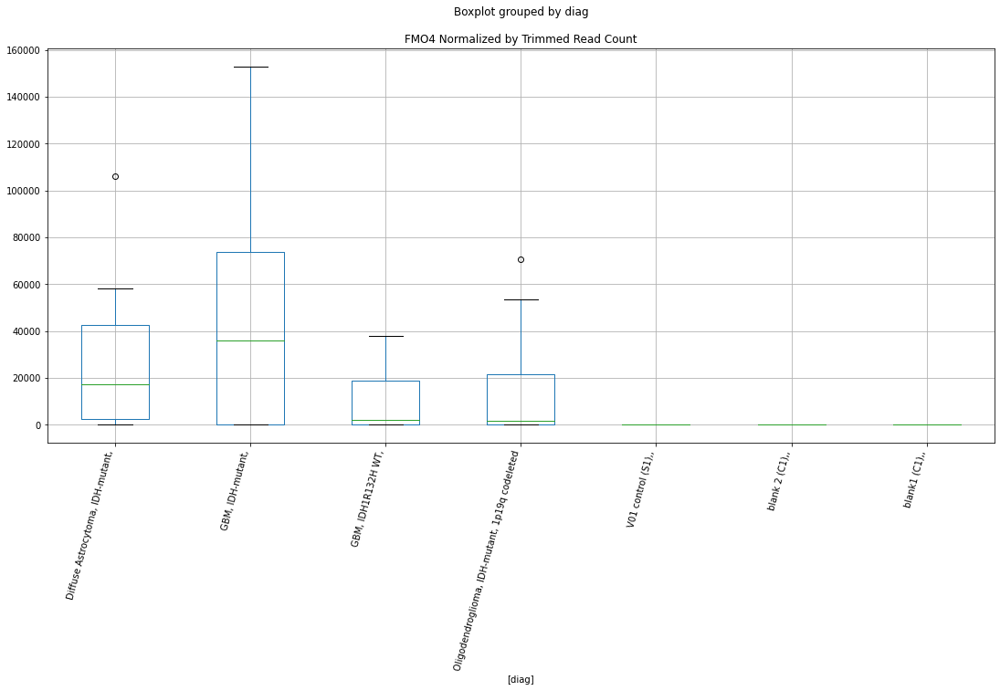

 p : 0.04984581533859616  ( t : 2.102498058386372 ) :  Lexogen  :  bbduk2  :  FAIM2
Control and blanks
79       0.00
343    424.63
Name: FAIM2, dtype: float64
211    2186.45
Name: FAIM2, dtype: float64
475    0.0
Name: FAIM2, dtype: float64


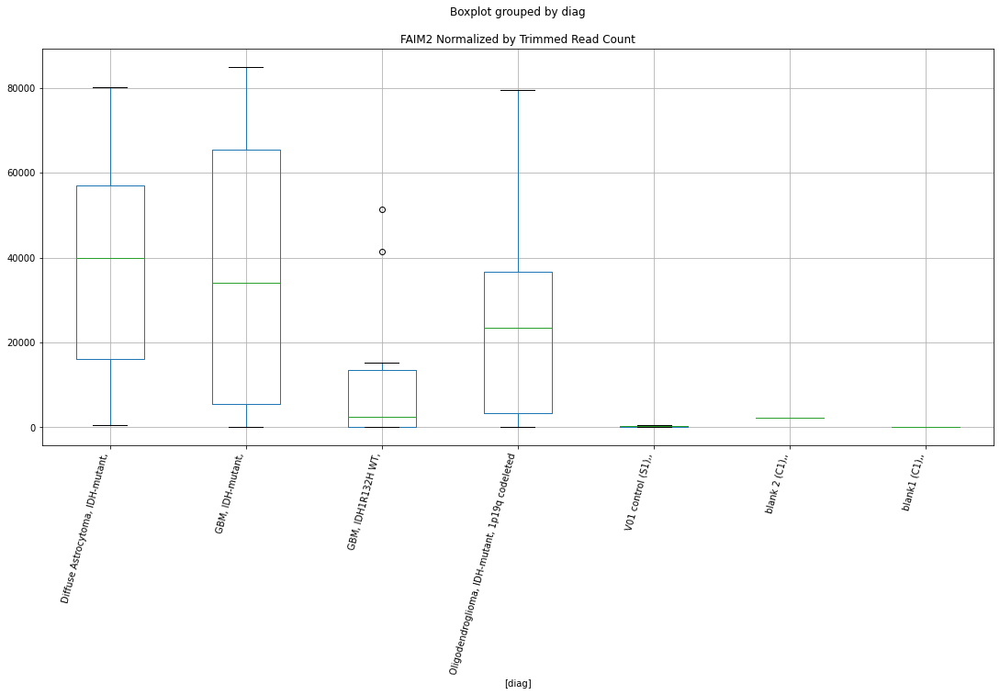

 p : 0.04984611935374461  ( t : 2.102494946498978 ) :  D-plex  :  bbduk2  :  GUCY1A2
Control and blanks
73         0.00
337    56970.06
Name: GUCY1A2, dtype: float64
205    2865.46
Name: GUCY1A2, dtype: float64
469    3549.16
Name: GUCY1A2, dtype: float64


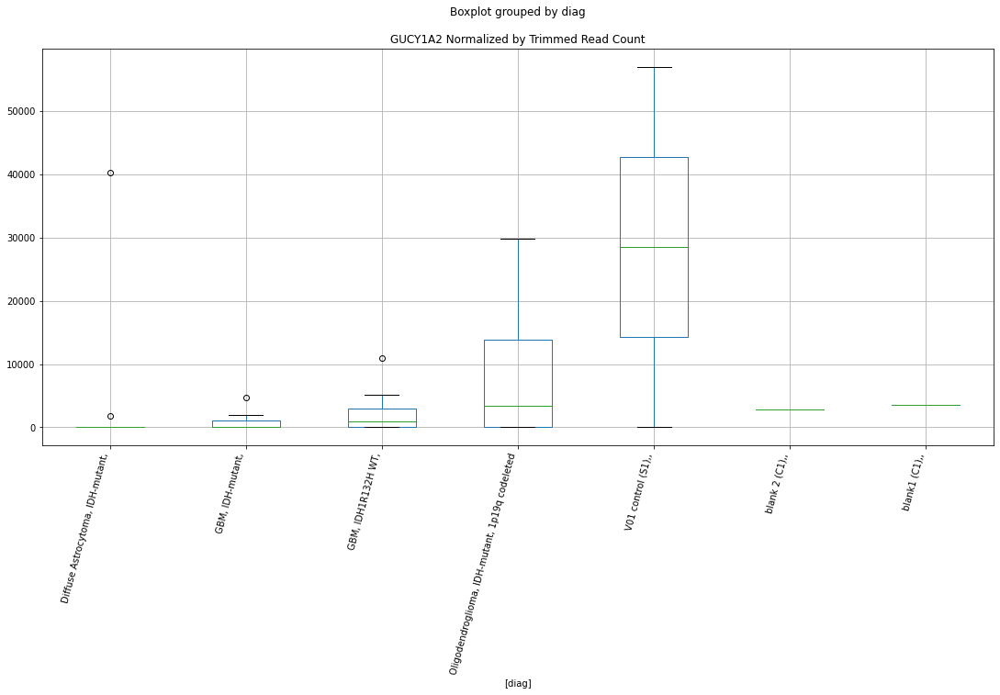

 p : 0.049909073081921364  ( t : 2.1018509259568177 ) :  D-plex  :  cutadapt2  :  HSPG2
Control and blanks
76     4545.69
340       0.00
Name: HSPG2, dtype: float64
208    111106.94
Name: HSPG2, dtype: float64
472    31209.62
Name: HSPG2, dtype: float64


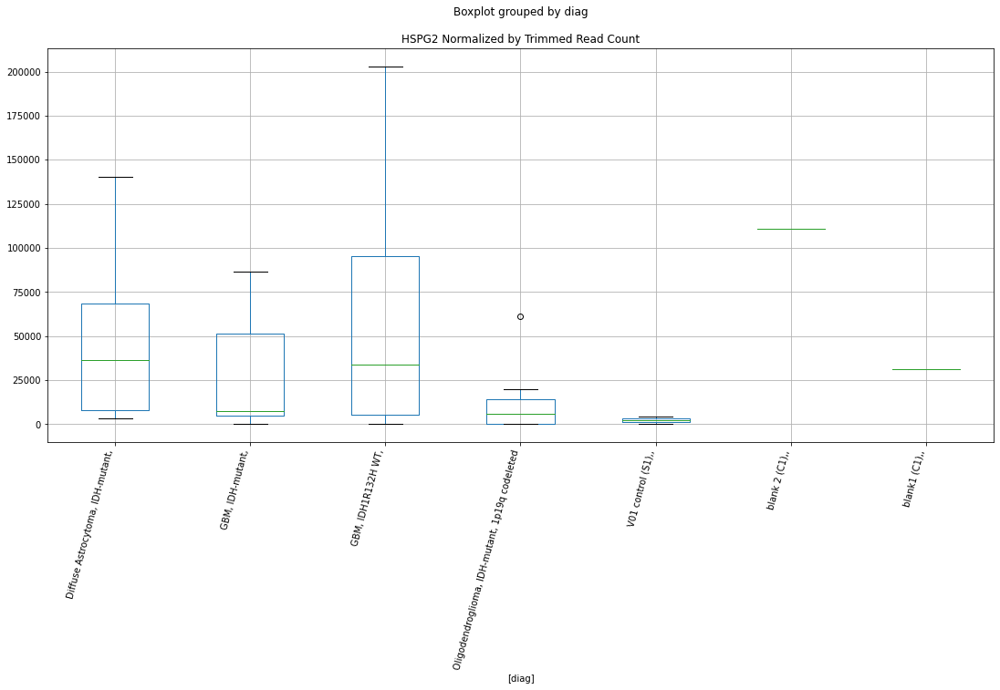

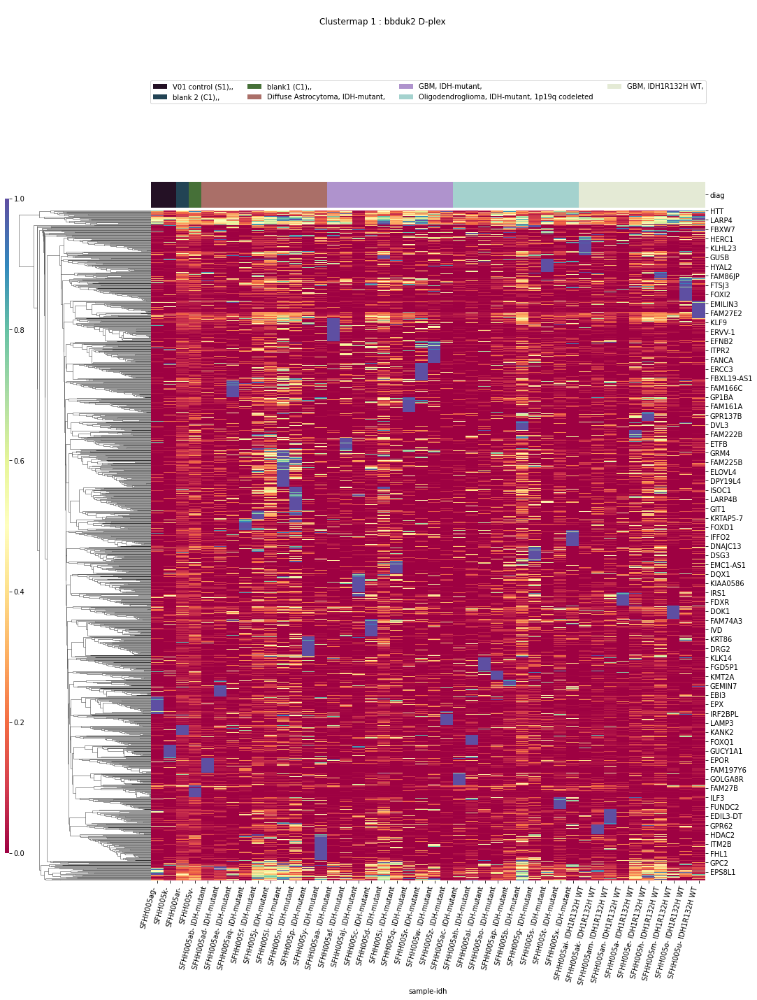

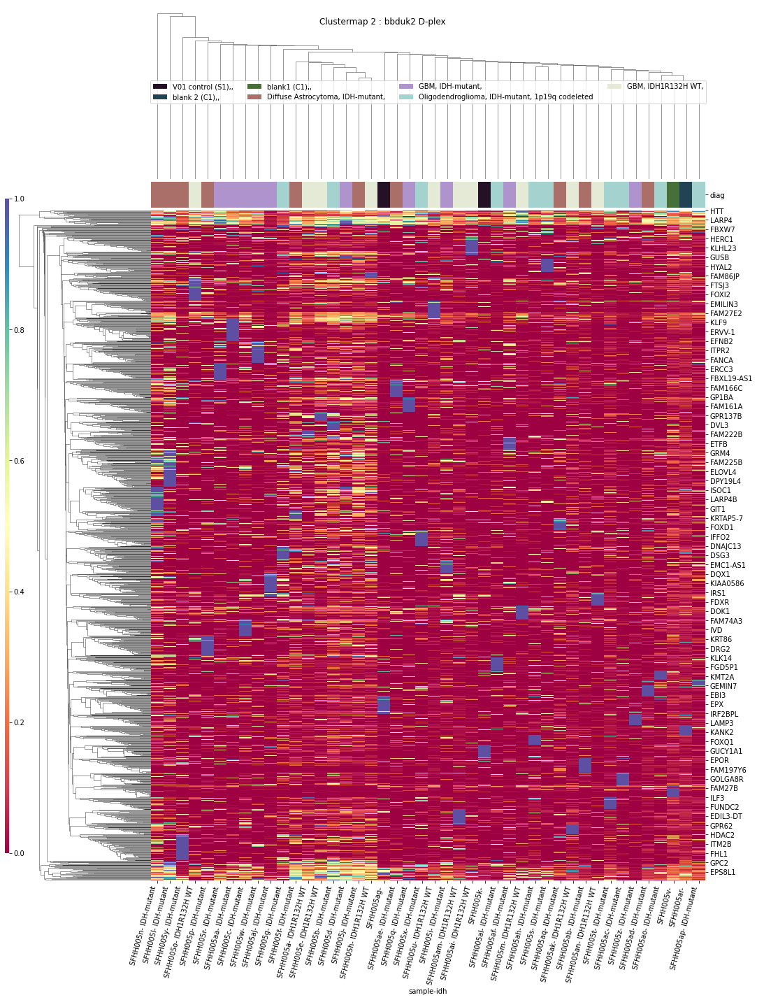

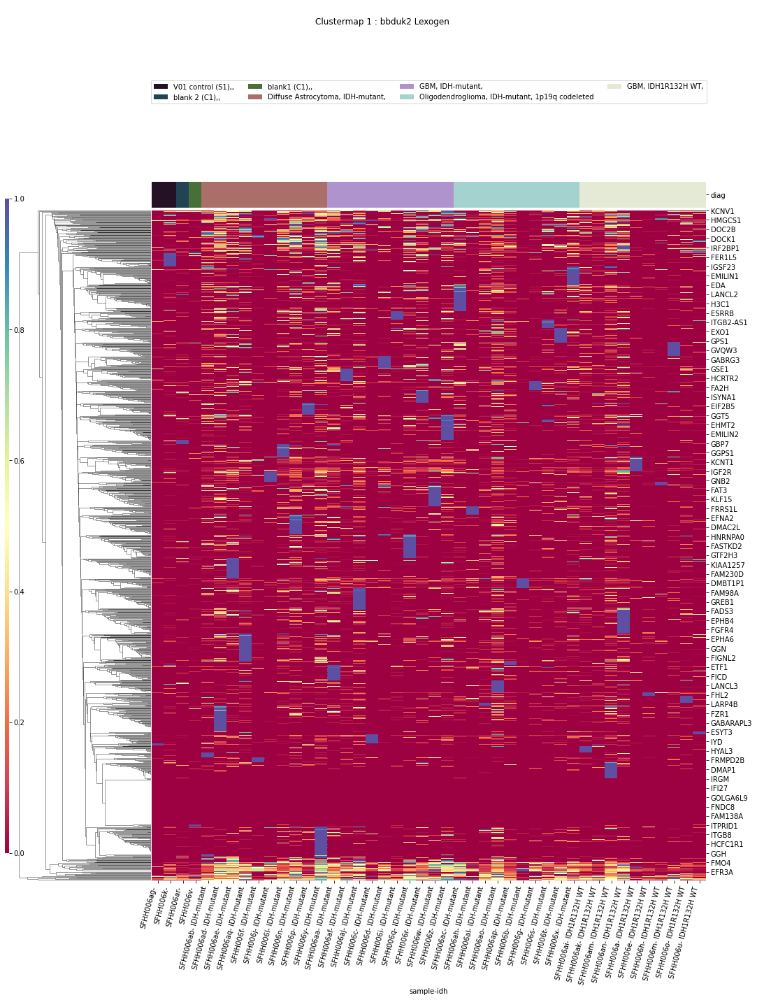

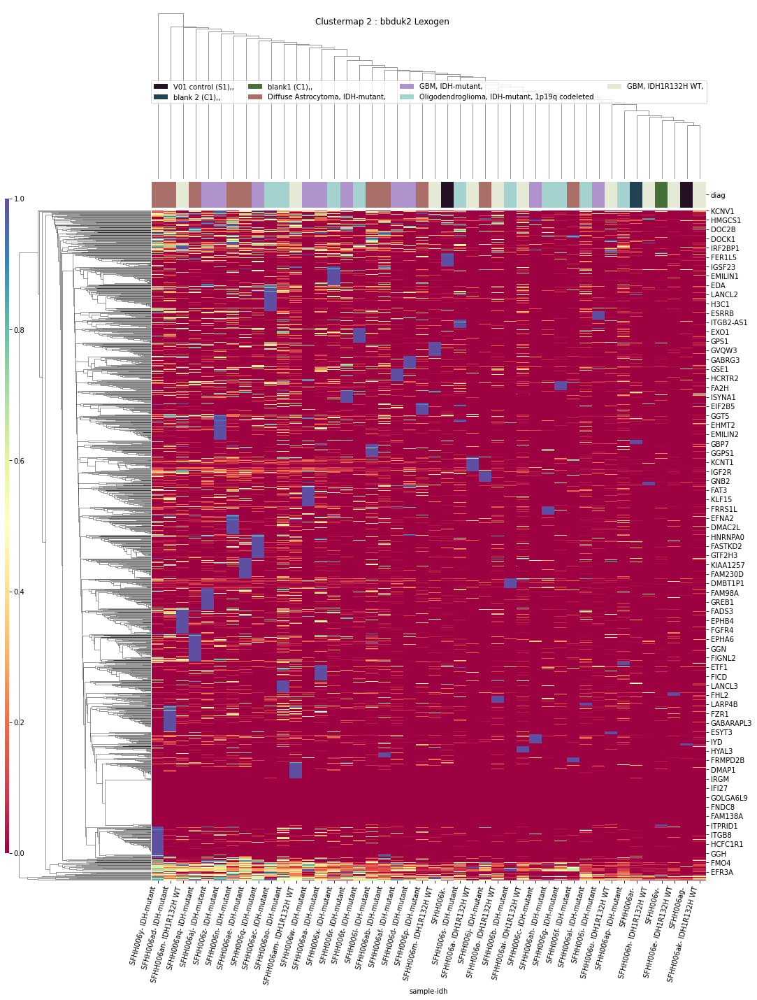

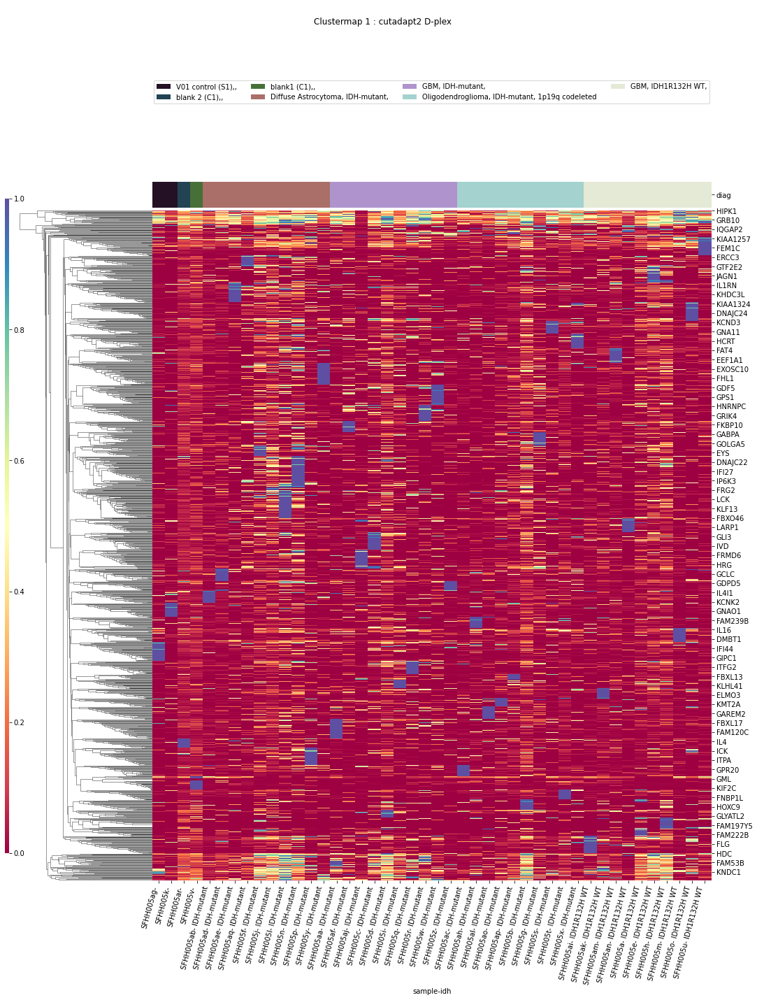

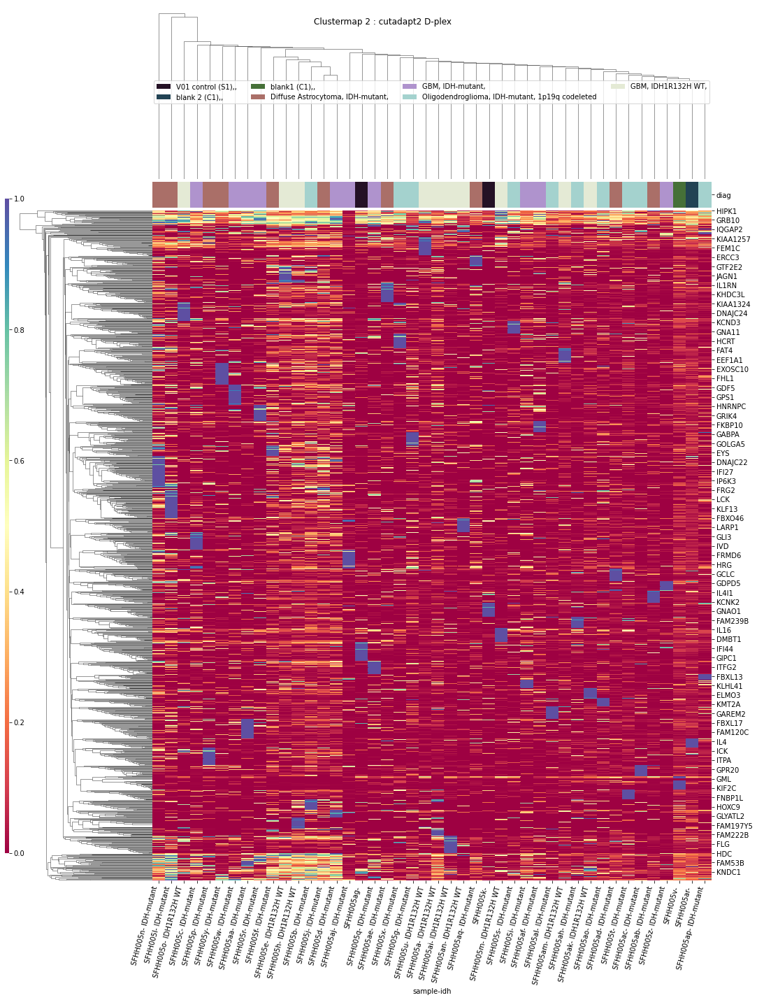

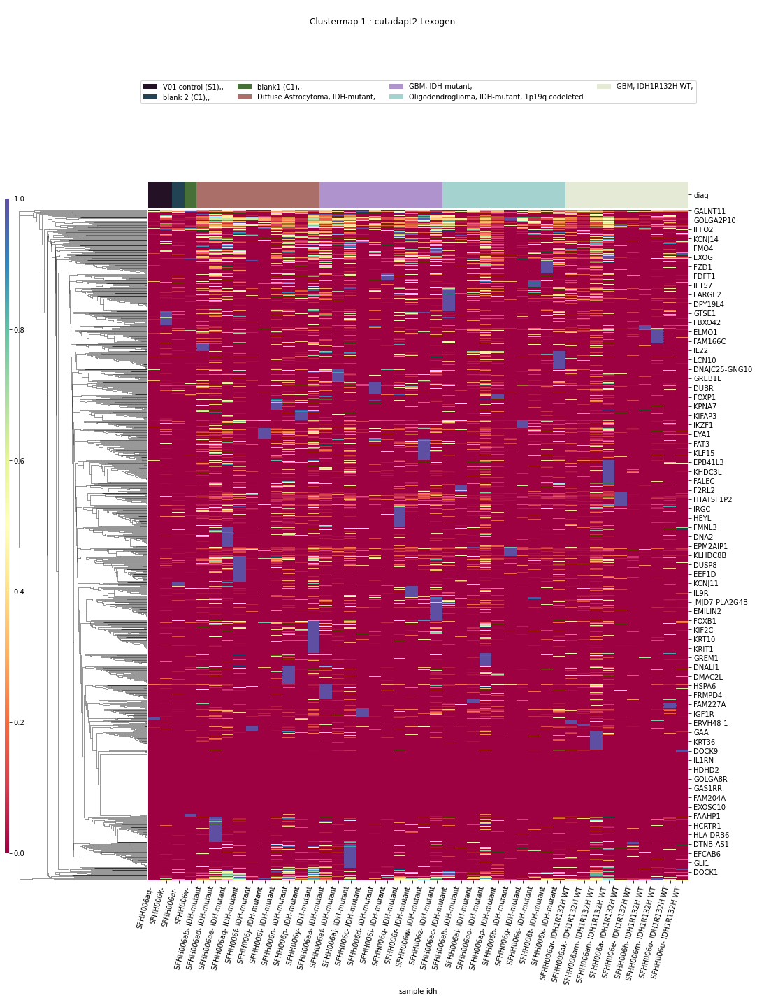

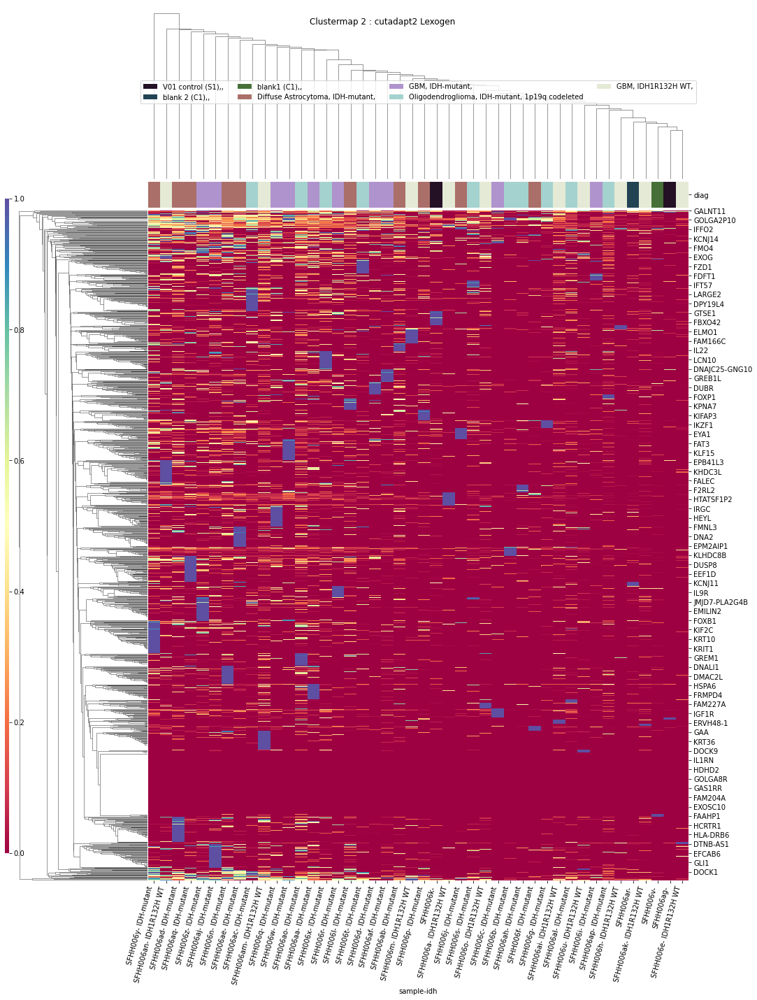

In [67]:
ttests_boxplots_and_heatmaps(dfn,elements,heat_p=0.1)

In [68]:
datetime.now().strftime("%H:%M:%S")

'11:44:47'

In [69]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [70]:
pd.set_option('display.max_columns', default_max_columns)

In [71]:
pd.set_option('display.max_rows',default_max_rows)

In [72]:
pd.set_option('display.precision', default_precision)